# Packages and Functions

In [1]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import datetime 
import os
# from pylab import mpl
%matplotlib inline
from IPython.display import display, HTML
display(HTML("<style>.output_scroll{height: auto; max_height: none;}</style>"))


In [2]:
# Directory containing the CSV files
directory = r'D:\CTA\k线数据\data5m'
# list to store data
data_list = []
# Read each CSV file
file_list = os.listdir(directory)
for filename in sorted(file_list, key=lambda x :(x[2], x in file_list)):
    if filename.endswith('.csv'):
        file_path = os.path.join(directory, filename)
        print(filename)
        df = pd.read_csv(file_path) 
        data_list.append(df)
        
        


F1-2y.csv
F2-2y.csv
F3-2y.csv
F4-2y.csv
F5-2y.csv
F6-2y.csv
F7-2y.csv
F8-2y.csv
F9-2y.csv
F10-2y.csv
F11-2y.csv
F12-2y.csv
F13-2y.csv
F14-2y.csv
F15-2y.csv
F16-2y.csv
F17-2y.csv
F18-2y.csv


## Drafts：
## Check time difference is 5 mins.

In [157]:
df = data_list[-1]
df['ot']= pd.to_datetime(df['open_time'],unit='ms')
df.head()
df.drop_duplicates(subset=['ot'], keep='first', inplace=True, ignore_index=True)  # remove duplicates
df['time_diff'] = df['ot'].diff()
df.loc[0,'time_diff'] = pd.Timedelta(minutes=5)  # add the first row
df = df[df['time_diff'] == pd.Timedelta(minutes=5)].copy()  # keep only the rows with 5 minutes interval


In [160]:
df['future_ret'] = df['close'].pct_change()
df['abs_ret'] = df['future_ret'].abs()
df['signal'] = (df['future_ret'] < 0) & (df['future_ret'] < -df['abs_ret'].rolling(10000).quantile(0.999))


In [161]:
df['trade'] = df['signal'].shift(1)
df['trade'] = df['trade'].fillna(False)  # fill NaN with False

In [162]:
df

,open_time,open,high,low,close,volume,close_time,quote_volume,count,taker_buy_volume,taker_buy_quote_volume,ignore,ot,time_diff,future_ret,abs_ret,signal,trade
0,1.601510e+12,0.01954,0.01975,0.01953,0.01967,4543755,1.601511e+12,8.929585e+04,612,3172506,6.236679e+04,0,2020-10-01 00:00:00,0 days 00:05:00,NaN,NaN,False,False
1,1.601511e+12,0.01967,0.01973,0.01954,0.01958,4669871,1.601511e+12,9.161707e+04,511,1027782,2.020143e+04,0,2020-10-01 00:05:00,0 days 00:05:00,-0.004575,0.004575,False,False
2,1.601511e+12,0.01958,0.01964,0.01954,0.01961,1012100,1.601511e+12,1.981433e+04,176,549443,1.076341e+04,0,2020-10-01 00:10:00,0 days 00:05:00,0.001532,0.001532,False,False
3,1.601511e+12,0.01961,0.01970,0.01959,0.01965,1789854,1.601512e+12,3.514714e+04,224,846050,1.662844e+04,0,2020-10-01 00:15:00,0 days 00:05:00,0.002040,0.002040,False,False
4,1.601512e+12,0.01965,0.01970,0.01960,0.01967,2284136,1.601512e+12,4.486235e+04,217,510675,1.004443e+04,0,2020-10-01 00:20:00,0 days 00:05:00,0.001018,0.001018,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183739,1.656632e+12,0.03745,0.03754,0.03732,0.03739,4645623,1.656632e+12,1.738544e+05,865,1911685,7.151817e+04,0,2022-06-30 23:35:00,0 days 00:05:00,-0.001602,0.001602,False,False
183740,1.656632e+12,0.03738,0.03774,0.03737,0.03764,7325825,1.656633e+12,2.755593e+05,1152,3410991,1.282693e+05,0,2022-06-30 23:40:00,0 days 00:05:00,0.006686,0.006686,False,False
183741,1.656633e+12,0.03763,0.03828,0.03760,0.03827,13782485,1.656633e+12,5.231300e+05,2303,7943224,3.014890e+05,0,2022-06-30 23:45:00,0 days 00:05:00,0.016738,0.016738,False,False
183742,1.656633e+12,0.03827,0.03886,0.03826,0.03877,49741342,1.656633e+12,1.919015e+06,4852,28314859,1.092358e+06,0,2022-06-30 23:50:00,0 days 00:05:00,0.013065,0.013065,False,False


In [163]:
df[df['trade']].index

Index([ 10887,  13442,  13891,  13892,  13893,  13934,  14889,  15424,  15625,
        15626,  15633,  15887,  15942,  16166,  16168,  16170,  16171,  16231,
        17717,  24172,  27449,  29420,  29547,  38167,  38168,  39484,  39485,
        41643,  41868,  41870,  50380,  52225,  57353,  57355,  57896,  58774,
        58780,  58781,  58843,  62719,  63887,  63889,  64490,  64513,  66393,
        66394,  66395,  66397,  66398,  66406,  66409,  87081,  91416,  92165,
        98065,  98325,  98382,  98386,  98388,  98390, 100105, 112705, 112706,
       113120, 113810, 113865, 113918, 113950, 116897, 118490, 123611, 123613,
       123617, 137396, 137635, 137638, 137650, 137786, 139047, 141571, 143299,
       151365, 156022, 156061, 156098, 157053, 157417, 169207, 169208, 169210,
       169223, 169307, 177847, 180083],
      dtype='int64')

In [164]:
(df[df['trade']].index.diff()<=24).sum()

32

In [165]:
df['isactive']  = df['signal']
df['avg_price'] = (df['open'] + df['high'] + df['low'] + df['close']) / 4.0
df.loc[df['trade'], 'buy_price'] = df.loc[df['trade'],'avg_price']
df.loc[df['trade'],'sell_price'] = (df['avg_price'].shift(24)).loc[df['trade']]
df.loc[df['trade'],'EntryTime'] = df['ot']
df.loc[df['trade'], 'ExitTime'] = df['ot'] + pd.Timedelta(minutes=120)  # exit after 5 minutes

In [166]:
df.loc[df['trade'],:]

,open_time,open,high,low,close,volume,close_time,quote_volume,count,taker_buy_volume,...,future_ret,abs_ret,signal,trade,isactive,avg_price,buy_price,sell_price,EntryTime,ExitTime
10887,1.604776e+12,0.01806,0.01808,0.01788,0.01794,6001520,1.604777e+12,1.078626e+05,557,3119948,...,-0.006094,0.006094,False,True,False,0.017990,0.017990,0.019150,2020-11-07 19:15:00,2020-11-07 21:15:00
13442,1.605543e+12,0.02101,0.02112,0.02100,0.02106,4060241,1.605543e+12,8.549546e+04,276,2946255,...,0.002380,0.002380,False,True,False,0.021048,0.021048,0.021492,2020-11-16 16:10:00,2020-11-16 18:10:00
13891,1.605678e+12,0.02238,0.02240,0.02179,0.02189,21168057,1.605678e+12,4.688324e+05,2002,8189072,...,-0.022768,0.022768,True,True,True,0.022115,0.022115,0.022550,2020-11-18 05:35:00,2020-11-18 07:35:00
13892,1.605678e+12,0.02189,0.02190,0.02124,0.02139,25636525,1.605678e+12,5.512181e+05,2507,9305691,...,-0.022841,0.022841,True,True,True,0.021605,0.021605,0.022550,2020-11-18 05:40:00,2020-11-18 07:40:00
13893,1.605678e+12,0.02140,0.02140,0.02059,0.02129,36694075,1.605679e+12,7.693394e+05,3539,17326244,...,-0.004675,0.004675,False,True,False,0.021170,0.021170,0.022507,2020-11-18 05:45:00,2020-11-18 07:45:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
169210,1.652273e+12,0.05390,0.05652,0.05177,0.05452,193843590,1.652274e+12,1.048239e+07,24640,99594881,...,0.011503,0.011503,False,True,False,0.054178,0.054178,0.065555,2022-05-11 12:50:00,2022-05-11 14:50:00
169223,1.652277e+12,0.06076,0.06076,0.05909,0.06020,88688477,1.652278e+12,5.315177e+06,12170,43875054,...,-0.008237,0.008237,False,True,False,0.060202,0.060202,0.060425,2022-05-11 13:55:00,2022-05-11 15:55:00
169307,1.652302e+12,0.04959,0.05006,0.04915,0.04942,67523864,1.652303e+12,3.339356e+06,8652,32882529,...,-0.003227,0.003227,False,True,False,0.049555,0.049555,0.052898,2022-05-11 20:55:00,2022-05-11 22:55:00
177847,1.654864e+12,0.04586,0.04666,0.04582,0.04639,69252169,1.654865e+12,3.205380e+06,7121,40105718,...,0.011336,0.011336,False,True,False,0.046183,0.046183,0.047697,2022-06-10 12:35:00,2022-06-10 14:35:00


In [167]:
anchor_idx = df['trade'].where(df['trade']).first_valid_index()  # get the index of the first trade
anchor_time = df.loc[df['trade'],:].iloc[0]['ot']  # get the time of the first trade
prev_idx = df.loc[df['trade'],:].index[0]  # get the index of the first trade
prev_time = df.loc[df['trade'],:].iloc[0]['ot']  # get the time of the first trade
prev_time
for idx, row in df.loc[df['trade'],:].iterrows():
    if idx == anchor_idx:
        continue
    
    if (row['ot'] - prev_time > pd.Timedelta(minutes=120) ) and (idx - prev_idx > 24):
        anchor_idx = idx
        anchor_time = row['ot']
        prev_idx = idx
        prev_time = row['ot']
        continue

    else:
        df.loc[idx, 'trade'] = False
        df.loc[idx, 'buy_price'] = np.nan
        df.loc[idx, 'EntryTime'] = np.nan
        df.loc[anchor_idx, 'sell_price'] = row['sell_price']
        df.loc[idx, 'sell_price'] = np.nan
        df.loc[idx, 'isactive'] = False
        df.loc[anchor_idx, 'ExitTime'] = row['ExitTime']
        df.loc[idx, 'ExitTime'] = np.nan
        prev_idx = idx
        prev_time = row['ot']

In [169]:
mask = df.trade
ret = (df.loc[mask, 'sell_price']- df.loc[mask, 'buy_price'])/df.loc[mask, 'buy_price'] 
df.loc[mask, 'ret'] = ret - 0.003
df.ret = df.ret.fillna(0)
df['strategy_value'] = (1+df.ret).cumprod()


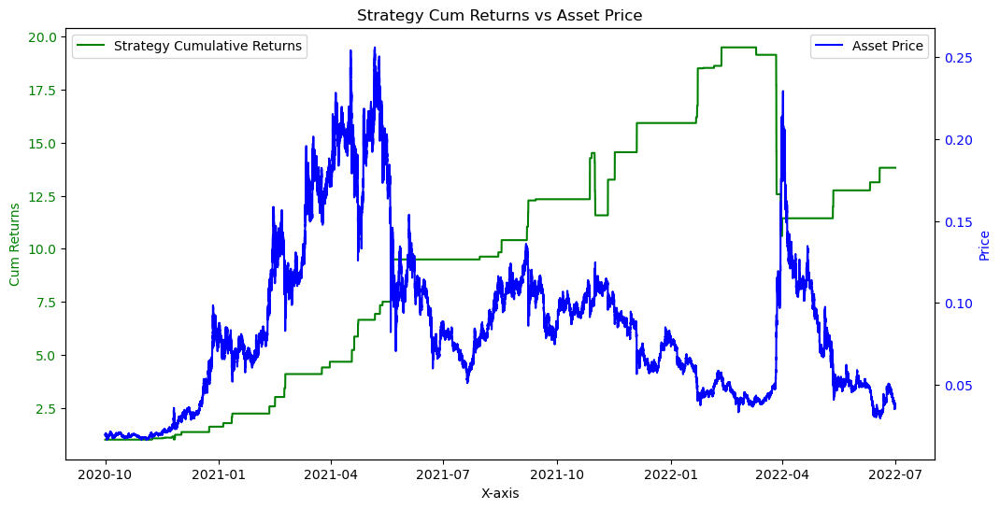

In [173]:
# Create a new figure and primary y-axis
fig, ax1 = plt.subplots(figsize=(12,6))

# Plot the first line on the primary y-axis (left y-axis)
ax1.plot(df['ot'], df['strategy_value'], 'g-', label='Strategy Cumulative Returns')
ax1.set_xlabel('X-axis')
ax1.set_ylabel('Cum Returns', color='g')
ax1.tick_params(axis='y', labelcolor='g')

# Create a second y-axis
ax2 = ax1.twinx()

# Plot the second line on the secondary y-axis (right y-axis)
ax2.plot(df['ot'], df['close'], 'b-', label='Asset Price')
ax2.set_ylabel('Price', color='b')
ax2.tick_params(axis='y', labelcolor='b')

# Add legends to each y-axis
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

# Show the plot
plt.title('Strategy Cum Returns vs Asset Price')
plt.show()

In [202]:
trades = df.trade.astype(int).to_numpy()
trades

array([0, 0, 0, ..., 0, 0, 0])

In [205]:
np.where(trades==1)[0]

array([ 10887,  13442,  13891,  13934,  14889,  15424,  15625,  15887,
        15942,  16166,  16231,  17717,  24172,  27449,  29420,  29547,
        38167,  39484,  41643,  41868,  50380,  52225,  57353,  57896,
        58774,  58843,  62719,  63887,  64490,  66393,  87081,  91416,
        92165,  98065,  98325,  98382, 100105, 112705, 113120, 113810,
       113865, 113918, 113950, 116897, 118490, 123611, 137396, 137635,
       137786, 139047, 141571, 143299, 151365, 156022, 156061, 156098,
       157053, 157417, 169207, 169307, 177847, 180083], dtype=int64)

# Create a CTAStrategy Class for Backtesting

In [384]:
class CTAStrategy():
    def __init__(self, data, ot='open_time', sig_col='signal', clo_col='close', hold_peri=120, time_diff=5, asset_name='Asset'):
        '''
        '''
        self.data = data.copy()
        self.open_time = ot  # time column
        self.signal_column = sig_col 
        self.close_column = clo_col  
        self.hold_period = hold_peri # default hold period is 120 mins
        self.interval = time_diff
        self.shift_periods = hold_peri // time_diff # number of periods to shift when generating signals, default 24
        self.asset  = asset_name
        # initialize the performance metrics 
        self.num_trades = np.nan
        self.win_prob = np.nan
        self.avg_win_return = np.nan
        self.avg_loss_return = np.nan
        self.pnl_ratio = np.nan
        self.maximum_single_loss = np.nan
        self.maximum_drawdown = np.nan  # compounded
        self.annualized_ret = np.nan
        self.annualized_vol = np.nan
        self.sharpe = np.nan
        self.data['ret'] = pd.Series(np.nan, index=self.data.index)
        # self.data['futures_ret'] = pd.Series(np.nan, index=self.data.index)
        self.data['strategy_ret'] = pd.Series(np.nan, index=self.data.index)
        
    
    def data_preprocess(self):
        self.data[self.open_time] = pd.to_datetime(self.data[self.open_time], unit='ms')
        # Check whether there are duplicated rows, and only keep those without duplication
        # self.data = self.data[~self.data[self.open_time].duplicated(keep='first')].copy()
        self.data.drop_duplicates(subset=[self.open_time], keep = 'first', inplace=True, ignore_index =True)  # remove duplicates
        self.data['time_diff'] = self.data[self.open_time].diff()
        self.data.loc[0,'time_diff'] = pd.Timedelta(minutes=self.interval) # add the first row 
        self.data = self.data[self.data['time_diff']== pd.Timedelta(minutes=self.interval)] # filter the rows with time difference 5

        self.data['avg_price'] = (self.data['open'] + self.data['high'] + self.data['low'] + self.data[self.close_column]) / 4.0

        # create a new column called average price
        # self.data['avg_price'] =  (self.data['open']+self.data['high']+self.data['low']+self.data[self.close_column])/4
        print(f'After preprocess the data has {len(self.data)} columns.')
        print('Preprocess finished')
        return None

    
    def find_signal_8_1(self, window, threshold, trade_time):
        '''
        trading strategy 8.1
        window: the rolling window size for quantile
        threshold: the quantile threshold for the rolling window, in percentage
        trade_time: the time to trade after the signal is generated (in 5 minutes)

        '''
        self.data['ret'] = self.data[self.close_column].pct_change() 
        self.data['abs_ret'] = self.data['ret'].abs()
        self.data[self.signal_column] = (self.data['ret'] <0) & (self.data['ret'] < -self.data['abs_ret'].rolling(window).quantile(1-threshold*0.01)) # boolen
        # trade in the next 5 min
        self.data['trade'] = self.data[self.signal_column].shift(trade_time) # boolen
        self.data['trade'] = self.data['trade'].fillna(False) # fill the first NaN 

        self.data.loc[self.data['trade'], 'EntryPrice'] = self.data['avg_price'] 
        self.data.loc[self.data['trade'], 'ExitPrice'] = self.data['avg_price'].shift(-self.shift_periods)
        self.data.loc[self.data['trade'], 'EntryTime'] = self.data[self.open_time]
        self.data.loc[self.data['trade'], 'ExitTime'] = self.data[self.open_time].shift(-self.shift_periods) # self.data[self.open_time] + pd.Timedelta(minutes=self.hold_period)
        print(self.data.trade.sum())
        anchor_idx = self.data['trade'].where(self.data['trade']).first_valid_index()
        prev_idx = anchor_idx
        prev_time =  self.data.at[prev_idx, self.open_time]
        for idx, row in self.data.loc[self.data['trade'],:].iterrows():
            if idx == anchor_idx:
                continue
            
            if (row[self.open_time] - prev_time) > pd.Timedelta(minutes=120) and (idx - prev_idx > 24):
                anchor_idx = idx
                prev_idx = idx
                prev_time = row[self.open_time] 
                continue

            else:
                self.data.loc[idx, 'trade'] = False
                self.data.loc[idx, 'EntryPrice'] = np.nan
                self.data.loc[idx, 'EntryTime'] =  np.nan
                self.data.loc[anchor_idx, 'ExitPrice'] = row['ExitPrice']
                self.data.loc[idx, 'ExitPrice'] = np.nan
                self.data.loc[anchor_idx, 'ExitTime'] = row['ExitTime']
                self.data.loc[idx, 'ExitTime'] = np.nan
                prev_idx = idx
                prev_time = row[self.open_time]
        print(self.data.trade.sum())

        
        print('8.1 Trading signal finished')
        return None
        

    def find_signal_8_2(self, window, threshold,trade_time):
        '''
        trading strategy 8.2
        
        self.data['ret'] = self.data[self.close_column].pct_change()
        self.data['abs_ret'] = self.data['ret'].abs()
        self.data[self.signal_column] = (self.data['ret'] <0) & (self.data['ret'] < -self.data['abs_ret'].rolling(window).quantile(1-threshold*0.01))
        self.data[self.signal_column] = self.data[self.signal_column].rolling(self.shift_periods).sum() * self.data[self.signal_column]
        # trade in the next 5 min
        self.data['trade'] = self.data[self.signal_column].shift(trade_time)
        print('8.2 Trading signal finished')
        return None
        '''
        self.data['ret'] = self.data[self.close_column].pct_change()
        self.data['abs_ret'] = self.data['ret'].abs()
        self.data[self.signal_column] = (self.data['ret'] <0) & (self.data['ret'] < -self.data['abs_ret'].rolling(window).quantile(1-threshold*0.01))
        # trade in the next 5 min
        self.data['trade'] = self.data[self.signal_column].shift(trade_time)
        self.data['trade'] = self.data['trade'].fillna(False) # fill the first NaN 

        mask = self.data['trade']  
        self.data['EntryPrice'] = np.where(mask, self.data['avg_price'], np.nan)
        self.data['ExitPrice']  = np.where(mask, self.data['avg_price'].shift(-self.shift_periods), np.nan) 
        self.data['EntryTime']  = np.where(mask, self.data[self.open_time], np.datetime64('NaT'))
        self.data['ExitTime']   = np.where(mask, self.data[self.open_time].shift(-self.shift_periods), np.datetime64('NaT'))
        print('8.2 Trading signal finished')
        return None
    
    def find_signal_8_2_improved(self, window, threshold,trade_time):
        '''
        trading strategy 8.2 adding ma condition and asset ret < -0.05
        
        '''
        self.data['ret'] = self.data[self.close_column].pct_change()
        self.data['abs_ret'] = self.data['ret'].abs()
        self.data['ma_'+str(window)] = self.data[self.close_column].rolling(window).mean()
        self.data['ma_'+str(window)+'_std'] = self.data[self.close_column].rolling(window).std()
        self.data[self.signal_column] = (self.data['ret'] <0) & (self.data['ret'] < -self.data['abs_ret'].rolling(window).quantile(1-threshold*0.01))
        self.data[self.signal_column] = self.data[self.signal_column] & (self.data['ret']<-0.05) \
                                        &(self.data['ret'] < self.data['ma_'+str(window)] + 5 * self.data['ma_'+str(window)+'_std'])
        # trade in the next 5 min
        self.data['trade'] = self.data[self.signal_column].shift(trade_time)
        self.data['trade'] = self.data['trade'].fillna(False) # fill the first NaN 

        mask = self.data['trade']  
        self.data['EntryPrice'] = np.where(mask, self.data['avg_price'], np.nan)
        self.data['ExitPrice']  = np.where(mask, self.data['avg_price'].shift(-self.shift_periods), np.nan) 
        self.data['EntryTime']  = np.where(mask, self.data[self.open_time], np.datetime64('NaT'))
        self.data['ExitTime']   = np.where(mask, self.data[self.open_time].shift(-self.shift_periods), np.datetime64('NaT'))
        print('8.2 Trading signal finished')
        return None
        
    def find_signal_8_2_addition(self, fee = 1/1000, rule = [1/3, 2/3]):
        self.data['tbv0_33'] = self.data[self.signal_column] & (self.data['tbv/tv'] <= rule[0])
        self.data['trade0_33'] = self.data['tbv0_33'].shift(1).fillna(False)
        self.data['tbv33_66'] = self.data[self.signal_column] & (self.data['tbv/tv']> rule[0]) & (self.data['tbv/tv'] < rule[1])
        self.data['trade33_66'] = self.data['tbv33_66'].shift(1).fillna(False)
        self.data['tbv66_100'] = self.data[self.signal_column] & (self.data['tbv/tv'] >= (rule[1]))
        self.data['trade66_100'] = self.data['tbv66_100'].shift(1).fillna(False)

        # calculate 3 different return values
        self.data['ret0_33'] = self.data['trade0_33'].astype(int) * (self.data['strategy_ret'] )
        self.data['value0_33'] = 1+self.data['ret0_33'].cumsum()
        self.data['ret33_66'] = self.data['trade33_66'].astype(int) * (self.data['strategy_ret'] )
        self.data['value33_66'] = 1+self.data['ret33_66'].cumsum()
        self.data['ret66_100'] = self.data['trade66_100'].astype(int) * (self.data['strategy_ret'])
        self.data['value66_100'] = 1+self.data['ret66_100'].cumsum()

         # Create a new figure and primary y-axis
        fig, ax1 = plt.subplots(figsize=(12,6))
        # Plot the first line on the primary y-axis (left y-axis)
        ax1.plot(self.data[self.open_time], self.data['value0_33'], 'g-', label='value 0-'+str(round(rule[0]*100,2)))
        ax1.plot(self.data[self.open_time], self.data['value33_66'], 'r-', label='value '+str(round(rule[0]*100,2))+'-'+str(round(rule[1]*100,2)))
        ax1.plot(self.data[self.open_time], self.data['value66_100'], 'y-', label='value '+str(round(rule[1]*100,2))+'-100')
        ax1.set_xlabel('Date')
        ax1.set_ylabel('Addidtive Value', color='g')
        ax1.tick_params(axis='y', labelcolor='g')
        # Create a second y-axis
        ax2 = ax1.twinx()
        # Plot the second line on the secondary y-axis (right y-axis)
        ax2.plot(self.data[self.open_time], self.data[self.close_column], 'b-', label='Asset Price')
        ax2.set_ylabel('Price', color='b')
        ax2.tick_params(axis='y', labelcolor='b')
        # Add legends to each y-axis
        ax1.legend(loc='upper left')
        ax2.legend(loc='upper right')
        # Show the plot
        plt.title('Strategy Additive Value vs Asset Price on '+self.asset)
        plt.show()

        # describe
        des0 = self.data[['ret0_33']][self.data['trade0_33']>0].astype('float').describe()
        des0.columns = [self.asset]
        des1 = self.data[['ret33_66']][self.data['trade33_66']>0].astype('float').describe()
        des1.columns = [self.asset]
        des2 = self.data[['ret66_100']][self.data['trade66_100']>0].astype('float').describe()
        des2.columns = [self.asset]
        return des0,des1,des2

    def find_signal_8_2_addition_ma(self, fee = 1/1000, cate = [2.3, 3.5, 4.8]):
        cate1, cate2, cate3 = cate
        col1 = 'blw0_'+str(cate1)
        col2 = 'blw'+str(cate1)+'_'+str(cate2)
        col3 = 'blw'+str(cate2)+'_'+str(cate3)
        col4 = 'blw'+str(cate3)

        #self.data['ma_above1'] = self.data[self.signal_column] * self.data['above1'] 
        #self.data['trade_above1'] = self.data['ma_above1'].shift(1)
        #self.data['ma_above0_1'] = self.data[self.signal_column] * self.data['above0_1'] 
        #self.data['trade_above0_1'] = self.data['ma_above0_1'].shift(1)
        self.data['ma_above'] = self.data[self.signal_column] & self.data['above'] 
        self.data['trade_above'] = self.data['ma_above'].shift(1).fillna(False)
        self.data['ma_'+col1] = self.data[self.signal_column] & self.data[col1] 
        self.data['trade_'+col1] = self.data['ma_'+col1].shift(1).fillna(False)
        self.data['ma_'+col2] = self.data[self.signal_column] & self.data[col2] 
        self.data['trade_'+col2] = self.data['ma_'+col2].shift(1).fillna(False)
        self.data['ma_'+col3] = self.data[self.signal_column] & self.data[col3] 
        self.data['trade_'+col3] = self.data['ma_'+col3].shift(1).fillna(False)
        self.data['ma_'+col4] = self.data[self.signal_column] * self.data[col4] 
        self.data['trade_'+col4] = self.data['ma_'+col4].shift(1).fillna(False)
        
        # calculate 4 different categories return
        #self.data['ret_above1'] = self.data['trade_above1'] * (self.data['future_ret'] - fee)
        #self.data['ret_above0_1'] = self.data['trade_above0_1'] * (self.data['future_ret'] - fee)
        self.data['ret_above'] = self.data['trade_above'].astype(int) * (self.data['strategy_ret'] )
        self.data['ret_'+col1] = self.data['trade_'+col1].astype(int) * (self.data['strategy_ret'] )
        self.data['ret_'+col2] = self.data['trade_'+col2].astype(int) * (self.data['strategy_ret'] )
        self.data['ret_'+col3] = self.data['trade_'+col3].astype(int) * (self.data['strategy_ret'] )
        self.data['ret_'+col4] = self.data['trade_'+col4].astype(int) * (self.data['strategy_ret'] )


        # Create a new figure and primary y-axis
        fig, ax1 = plt.subplots(figsize=(12,6))
        # Plot the first line on the primary y-axis (left y-axis)
        #ax1.plot(self.data[self.open_time], self.data['ret_above1'].cumsum(), 'g-', label='return ma above1')
        #ax1.plot(self.data[self.open_time], self.data['ret_above0_1'].cumsum(), 'm-', label='return ma above0-1')
        ax1.plot(self.data[self.open_time], 1+self.data['ret_above'].cumsum(), 'g-', label='return ma above')
        ax1.plot(self.data[self.open_time], 1+self.data['ret_'+col1].cumsum(), 'r-', label='return ma '+col1)
        ax1.plot(self.data[self.open_time], 1+self.data['ret_'+col2].cumsum(), 'y-', label='return ma '+col2)
        ax1.plot(self.data[self.open_time], 1+self.data['ret_'+col3].cumsum(), 'c-', label='return ma '+col3)
        ax1.plot(self.data[self.open_time], 1+self.data['ret_'+col4].cumsum(), 'k-', label='return ma '+col4)

        ax1.set_xlabel('Date')
        ax1.set_ylabel('Additive Value', color='g')
        ax1.tick_params(axis='y', labelcolor='g')
        ax2 = ax1.twinx()
        ax2.plot(self.data[self.open_time], self.data[self.close_column], 'b-', label='Asset Price')
        ax2.set_ylabel('Price', color='b')
        ax2.tick_params(axis='y', labelcolor='b')
        ax1.legend(loc='upper left')
        ax2.legend(loc='upper right')
        # Show the plot
        plt.title('Strategy Additive Value vs Asset Price on '+self.asset)
        plt.show()

        # describe
        ##des00 = self.data[['ret_above1']][self.data['trade_above1']>0].astype('float').describe()
        #des00.columns = [self.asset]
        #des0 = self.data[['ret_above0_1']][self.data['trade_above0_1']>0].astype('float').describe()
        #des0.columns = [self.asset]
        des0 = self.data[['ret_above']][self.data['trade_above']>0].astype('float').describe()
        des0.columns = [self.asset]
        des1 = self.data[['ret_'+col1]][self.data['trade_'+col1]>0].astype('float').describe()
        des1.columns = [self.asset]
        des2 = self.data[['ret_'+col2]][self.data['trade_'+col2]>0].astype('float').describe()
        des2.columns = [self.asset]
        des3 = self.data[['ret_'+col3]][self.data['trade_'+col3]>0].astype('float').describe()
        des3.columns = [self.asset]
        des4 = self.data[['ret_'+col4]][self.data['trade_'+col4]>0].astype('float').describe()
        des4.columns = [self.asset]
        return  des0, des1 ,des2 ,des3, des4 #des00

    def find_signal_8_2_addition_tbv_rank(self, fee = 1/1000, rule =[0.2,0.4]):
        self.data['tbv_rank0_33'] = self.data[self.signal_column] & (self.data['tbv_pct_rank'] <= rule[0])
        self.data['trade_rank0_33'] = self.data['tbv_rank0_33'].shift(1).fillna(False)
        self.data['tbv_rank33_66'] = self.data[self.signal_column] & (self.data['tbv_pct_rank']> rule[0]) & (self.data['tbv_pct_rank'] < rule[1])
        self.data['trade_rank33_66'] = self.data['tbv_rank33_66'].shift(1).fillna(False)
        self.data['tbv_rank66_100'] = self.data[self.signal_column] & (self.data['tbv_pct_rank'] >= (rule[1]))
        self.data['trade_rank66_100'] = self.data['tbv_rank66_100'].shift(1).fillna(False)

        # calculate 4 different categories return
        self.data['ret_rank0_33'] = self.data['trade_rank0_33'].astype(int) * (self.data['strategy_ret'] )
        self.data['ret_rank33_66'] = self.data['trade_rank33_66'].astype(int) * (self.data['strategy_ret'] )
        self.data['ret_rank66_100'] = self.data['trade_rank66_100'].astype(int) * (self.data['strategy_ret'] )

        # describe
        des0 = self.data[['ret_rank0_33']][self.data['trade_rank0_33']>0].astype('float').describe()
        des0.columns = [self.asset]
        des1 = self.data[['ret_rank33_66']][self.data['trade_rank33_66']>0].astype('float').describe()
        des1.columns = [self.asset]
        des2 = self.data[['ret_rank66_100']][self.data['trade_rank66_100']>0].astype('float').describe()
        des2.columns = [self.asset]
        return des0,des1,des2

    
    def find_signal_8_3(self, window, threshold,trade_time):
        '''
        trading strategy 8.3
        '''
        self.data['ret'] = self.data[self.close_column].pct_change()
        self.data['abs_ret'] = self.data['ret'].abs()
        self.data[self.signal_column] = (self.data['ret'] <0) & (self.data['ret'] < -self.data['abs_ret'].rolling(window).quantile(1-threshold*0.01)) \
         & (self.data['ret'].abs() > self.data['abs_ret'].shift(1).rolling(self.shift_periods).max())
        # self.data[self.signal_column] = self.data[self.signal_column].rolling(self.shift_periods).sum() * self.data[self.signal_column]
        # trade in the next 5 min
        self.data['trade'] = self.data[self.signal_column].shift(trade_time)
        self.data['trade'] = self.data['trade'].fillna(False) # fill the first NaN 

        mask = self.data['trade']  
        self.data['EntryPrice'] = np.where(mask, self.data['avg_price'], np.nan)
        self.data['ExitPrice']  = np.where(mask, self.data['avg_price'].shift(-self.shift_periods), np.nan) 
        self.data['EntryTime']  = np.where(mask, self.data[self.open_time], np.datetime64('NaT'))
        self.data['ExitTime']   = np.where(mask, self.data[self.open_time].shift(-self.shift_periods), np.datetime64('NaT'))
        print('8.3 Trading signal finished')
        return None


    def find_signal_8_4(self, window, threshold,trade_time):
        '''
        trading strategy 8.4
        '''
        self.data['ret'] = self.data[self.close_column].pct_change()
        self.data['abs_ret'] = self.data['ret'].abs()
        self.data[self.signal_column] = (self.data['ret'] <0) & (self.data['ret'] < -self.data['abs_ret'].rolling(window).quantile(1-threshold*0.01)) \
         & (self.data['ret'] < (-self.data['ret']).shift(1).rolling(self.shift_periods).min())
        # self.data[self.signal_column] = self.data[self.signal_column].rolling(self.shift_periods).sum() * self.data[self.signal_column]
        # trade in the next 5 min
        self.data['trade'] = self.data[self.signal_column].shift(trade_time)
        self.data['trade'] = self.data['trade'].fillna(False) # fill the first NaN 

        mask = self.data['trade']  
        self.data['EntryPrice'] = np.where(mask, self.data['avg_price'], np.nan)
        self.data['ExitPrice']  = np.where(mask, self.data['avg_price'].shift(-self.shift_periods), np.nan) 
        self.data['EntryTime']  = np.where(mask, self.data[self.open_time], np.datetime64('NaT'))
        self.data['ExitTime']   = np.where(mask, self.data[self.open_time].shift(-self.shift_periods), np.datetime64('NaT'))
        print('8.4 Trading signal finished')
        return None
         
    
    def get_strategy_returns(self,fee = 1/1000):
        '''
        calculate strategy returns
        fee: transction fee 
        '''
        '''
        if 'avg_price' not in self.data: # create a new column called average price
            self.data['avg_price'] =  (self.data['open']+self.data['high']+self.data['low']+self.data[self.close_column])/4
        '''
        mask = self.data.trade
        ret = (self.data.loc[mask, 'ExitPrice']-self.data.loc[mask, 'EntryPrice'])/self.data.loc[mask, 'EntryPrice']
        self.data.loc[mask,'strategy_ret'] = self.data.loc[mask, 'trade'].astype(int) * (ret- fee)
        self.data.strategy_ret = self.data.strategy_ret.fillna(0)
        self.data['strategy_value_add'] = 1+self.data['strategy_ret'].cumsum()
        self.data['strategy_value_comp'] = (1+self.data['strategy_ret']).cumprod()
        return None # self.data
        
    
    def plot_hist_seires(self,fs=(10,5),abs_range=0.2):
        plt.figure(figsize=fs)
        plt.hist(self.data.loc[self.data['strategy_ret']!=0,'strategy_ret'].to_list(), bins=40, range=(-abs_range,abs_range))
        plt.title('Histogram of Strategy Return on '+self.asset)
        plt.xlabel('Return')
        plt.ylabel('Frequency')
        plt.show()

        plt.figure(figsize=fs)
        plt.plot(self.data[self.open_time], self.data['strategy_ret'], label= 'strategy return')
        plt.legend()
        plt.ylabel('Return')
        plt.xlabel('Time')
        plt.title('Strategy Return Series on '+self.asset)
        plt.show()
        return None

    
    def plot_cumsum_profits(self,fs=(10,5)):
        # cumsum profit 
        """
        """
        # Create a new figure and primary y-axis
        fig, ax1 = plt.subplots(figsize=fs)
        
        # Plot the first line on the primary y-axis (left y-axis)
        ax1.plot(self.data[self.open_time], self.data['strategy_value_add'], 'g-', label='Strategy Value Additive')
        ax1.set_xlabel('Date')
        ax1.set_ylabel('Strategy Net Value Additive', color='g')
        ax1.tick_params(axis='y', labelcolor='g')
        
        # Create a second y-axis
        ax2 = ax1.twinx()
        
        # Plot the second line on the secondary y-axis (right y-axis)
        ax2.plot(self.data[self.open_time], self.data[self.close_column], 'b-', label='Asset Price')
        ax2.set_ylabel('Price', color='b')
        ax2.tick_params(axis='y', labelcolor='b')
        
        # Plot trades
        c = self.data[self.close_column].to_numpy()
        trades = self.data['trade'].astype(int).to_numpy() 
        entry_idx = np.where(trades==1)[0]
        ax2.scatter(self.data[self.open_time].iloc[entry_idx], c[entry_idx], marker='^', s=70, color='green',
                   edgecolors='black', linewidths=0.5, label='Entry')
        
        
        # Add legends to each y-axis
        ax1.legend(loc='upper left')
        ax2.legend(loc='upper right')
        
        # Show the plot
        plt.title('Strategy Value Additive vs Asset Price on '+self.asset)
        plt.show()
        return None

    
    def plot_cumprod_value(self,fs=(10,5)):
        plt.figure(figsize=fs)
        plt.plot(self.data[self.open_time],self.data['strategy_value_comp'] , label= 'Strategy Value Compound')
        plt.legend()
        plt.ylabel('Net Value')
        plt.xlabel('Time')
        plt.title('Strategy Net Value Compound')
        plt.show()

        # annual_ret = self.data.loc[~self.data['cumprod_value'].isna(),'cumprod_value'].iloc[-1]  ** (12/21) -1
        cagr = self.data['strategy_value_comp'].iloc[-1] **(12/21) -1
        annualized_return =  self.data['strategy_ret'].mean()* 252*24*12
        annualized_vol = self.data['strategy_ret'].fillna(0).std()*np.sqrt(252*24*12)
        sharpe = (annualized_return-0.03)/annualized_vol
        self.cagr = cagr
        print(f"CAGR: {cagr:.2%}")
        print(f"Annual Return: {annualized_return:.2%}")
        print(f"Annual Volatility: {annualized_vol:.2%}")
        print(f"Sharpe: {sharpe: .4}")
        return None
        

    def get_win_prob(self):
        number_of_signal =(self.data[self.signal_column].dropna()!=0).sum()
        number_of_trades = (self.data['trade'].dropna()!=0).sum()
        self.num_trades = number_of_trades
        self.win_prob = (self.data['strategy_ret']>0).sum() / number_of_trades
    
        print(f"Win Prob: {self.win_prob:.2%}")
        print('Number of Trades: ', number_of_trades, number_of_signal)
        return None
        

    def get_avg_win_return(self):
        self.avg_win_return = np.mean(self.data.loc[self.data['strategy_ret']>0,'strategy_ret'])
        self.avg_loss_return = np.mean(self.data.loc[self.data['strategy_ret']<0,'strategy_ret'])
        self.maximum_single_loss = np.min(self.data['strategy_ret'])
        self.pnl_ratio = self.avg_win_return/-self.avg_loss_return
        print(f"Average Win Return:  {self.avg_win_return: .4}")
        print(f"Average Loss Return: {self.avg_loss_return:.4}")
        print(f"P&L Ratio: {(self.pnl_ratio):.2}")
        print(f"Maximum Loss of a single trade: {self.maximum_single_loss:.4}")

        des = self.data[['strategy_ret']][self.data['trade']>0].astype('float').describe()
        des.columns = [self.asset]
        return des 
        

    def get_maximum_drawdown(self):
        self.maximum_drawdown = np.min((self.data['strategy_value_comp'] -self.data['strategy_value_comp'].cummax())/self.data['strategy_value_comp'].cummax())
        print(f"Maximum Drawdown: {self.maximum_drawdown:.2%}")
        return None


    def get_sharpe(self, rf = 0.03):
        self.annualized_ret = self.data['strategy_ret'].mean()*(60/self.interval)*24*252
        self.annualized_vol = self.data['strategy_ret'].std()*np.sqrt((60/self.interval)*24*252)
        # annual_vol = self.data['strategy_ret'].std()*np.sqrt((60/self.interval)*24*252)
        self.sharpe = (self.annualized_ret-rf)/self.annualized_vol
        
        print(f"Annualized Return: {self.annualized_ret:.2%}")
        print(f"Annualized Volatility: {self.annualized_vol:.2%}")
        print(f"Sharpe: {self.sharpe: .4}")


    def taker_buy_volume_stats(self, window=10000):
        # calculate the rank of the taker buy volume 
        self.data['tbv_rank'] = self.data['taker_buy_volume'].rolling(window).rank(pct=True)  # 主动买入过去window分位
        self.data['tbv/tv'] = self.data['taker_buy_volume']/self.data['volume']  # 主动买入占总量的比例
        self.data['tbv_pct_rank'] = self.data['tbv/tv'].rolling(window).rank(pct=True)  # 主动买入占总量比例的过去window分位

        vol_des = self.data[['tbv_rank']][self.data[self.signal_column]>0].astype('float').describe()
        vol_des.columns = [self.asset]
        vol_pct_des = self.data[['tbv/tv']][self.data[self.signal_column]>0].astype('float').describe()
        vol_pct_des.columns = [self.asset]
        vol_pctrank_des = self.data[['tbv_pct_rank']][self.data[self.signal_column]>0].astype('float').describe()
        vol_pctrank_des.columns = [self.asset]
        return vol_des, vol_pct_des, vol_pctrank_des

    
    def moving_average_stats(self, window=300, cate=[2.3, 3.5, 4.8]):
        # calculate the moving average close price and a std column
        self.data['ma_'+str(window)] = self.data[self.close_column].rolling(window).mean()
        self.data['ma_'+str(window)+'_std'] = self.data[self.close_column].rolling(window).std()
        # 4 categories
        cate1, cate2, cate3 = cate
        #self.data['above1'] = self.data[self.close_column] > (self.data['ma_'+str(window)]+ self.data['ma_'+str(window)+'_std'])
        #self.data['above0_1'] = (self.data[self.close_column] > self.data['ma_'+str(window)])&(self.data[self.close_column] <=self.data['ma_'+str(window)] + self.data['ma_'+str(window)+'_std'])
        self.data['above'] = (self.data[self.close_column] > self.data['ma_'+str(window)])
        self.data['blw0_'+str(cate1)] = (self.data[self.close_column] <= self.data['ma_'+str(window)]) & (self.data[self.close_column] > self.data['ma_'+str(window)]-cate1*self.data['ma_'+str(window)+'_std'])
        self.data['blw'+str(cate1)+'_'+str(cate2)] = (self.data[self.close_column] <= self.data['ma_'+str(window)] -cate1*self.data['ma_'+str(window)+'_std']) & (self.data[self.close_column] > self.data['ma_'+str(window)]-cate2*self.data['ma_'+str(window)+'_std'])
        self.data['blw'+str(cate2)+'_'+str(cate3)] = (self.data[self.close_column] <= self.data['ma_'+str(window)] -cate2*self.data['ma_'+str(window)+'_std']) & (self.data[self.close_column] > self.data['ma_'+str(window)]-cate3*self.data['ma_'+str(window)+'_std'])
        self.data['blw'+str(cate3)] =  self.data[self.close_column] <= self.data['ma_'+str(window)] - cate3*self.data['ma_'+str(window)+'_std']

        # describe
        #des =  self.data[['above1','above0_1','blw0_'+str(cate1),'blw'+str(cate1)+'_'+str(cate2),'blw'+str(cate2)+'_'+str(cate3),'blw'+str(cate3)]][self.data[self.signal_column]>0].sum().to_frame()
        des =  self.data[['above','blw0_'+str(cate1),'blw'+str(cate1)+'_'+str(cate2),'blw'+str(cate2)+'_'+str(cate3),'blw'+str(cate3)]][self.data[self.signal_column]>0].sum().to_frame()
        des.columns = [self.asset+'_count']
        des[self.asset+'_pecentage'] = des[self.asset+'_count']/des[self.asset+'_count'].sum()
        
        return des


# Test Example

## Test 8.1

After preprocess the data has 183744 columns.
Preprocess finished
94
62
8.1 Trading signal finished


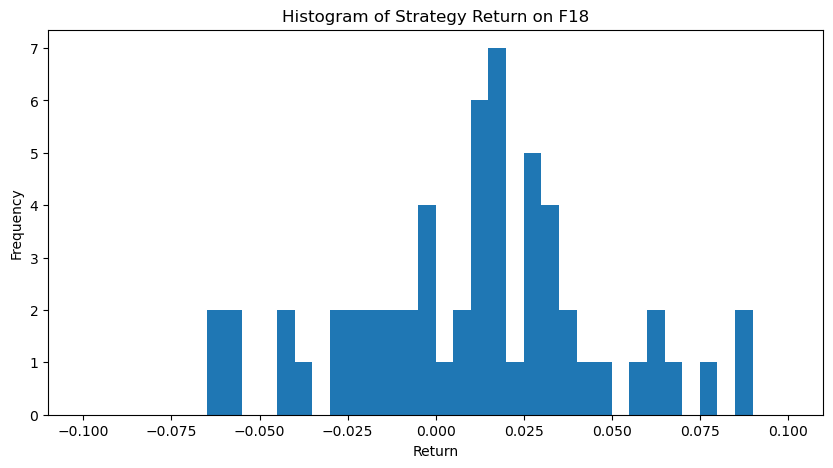

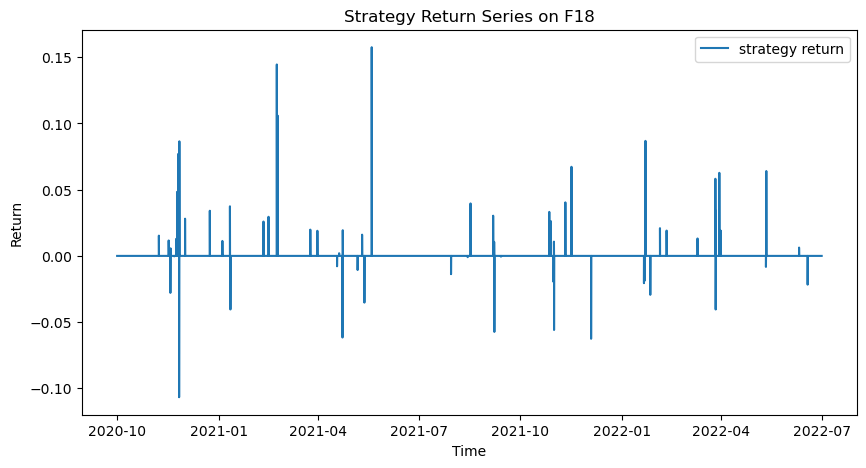

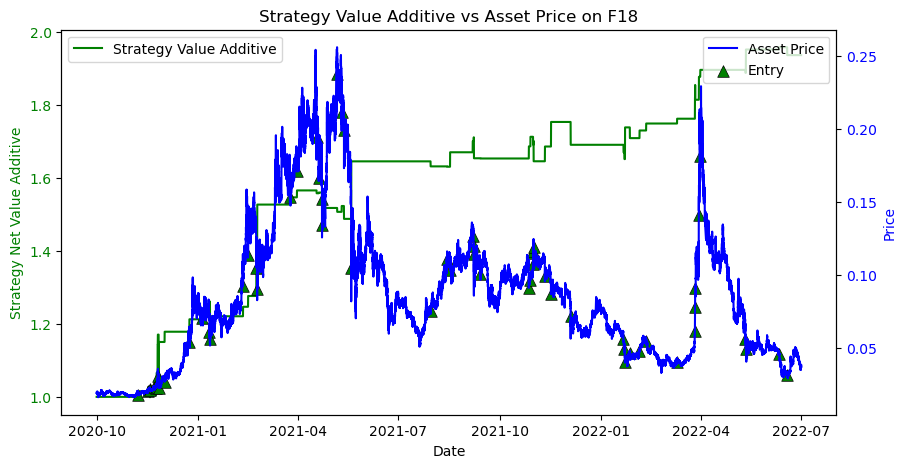

Win Prob: 64.52%
Number of Trades:  62 94
Average Win Return:   0.03947
Average Loss Return: -0.02922
P&L Ratio: 1.4
Maximum Loss of a single trade: -0.1067
Maximum Drawdown: -10.67%
Annualized Return: 36.97%
Annualized Volatility: 24.04%
Sharpe:  1.413


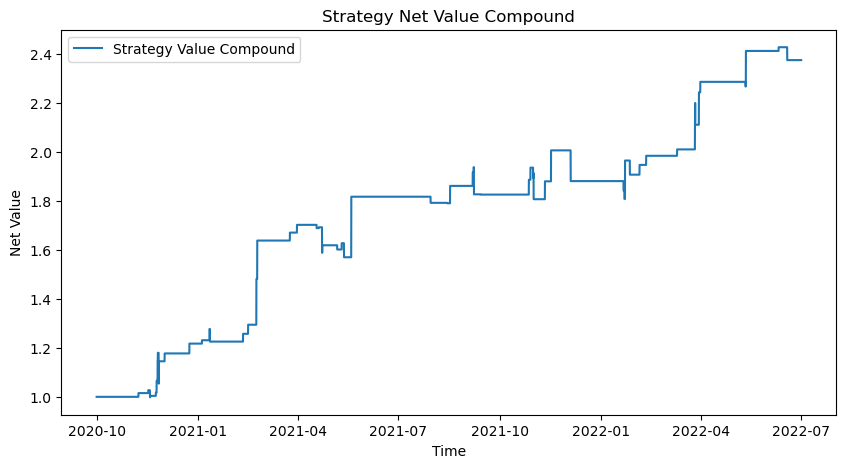

CAGR: 63.98%
Annual Return: 36.97%
Annual Volatility: 24.04%
Sharpe:  1.413


In [285]:
# strategy 8.1 
stra8_1 = CTAStrategy(data_list[-1],'open_time','signal','close',120,5,'F18')
stra8_1.data_preprocess()
stra8_1.find_signal_8_1(10000,0.1,1)
stra8_1.get_strategy_returns(0)
stra8_1.plot_hist_seires(abs_range=0.1)
stra8_1.plot_cumsum_profits()
stra8_1.get_win_prob()
profit_des = stra8_1.get_avg_win_return()
stra8_1.get_maximum_drawdown()
stra8_1.get_sharpe()
stra8_1.plot_cumprod_value()
tbv,tbv_vol,tbv_vol_rank = stra8_1.taker_buy_volume_stats()
ma_des = stra8_1.moving_average_stats()

In [286]:
temp = stra8_1.data.loc[stra8_1.data.trade, ['open_time', 'EntryPrice','EntryTime', 'ExitPrice', 'ExitTime']]

In [287]:
temp['EntryPrice'].isna().any()
temp['ExitPrice'].isna().any()

False

In [288]:
temp

,open_time,EntryPrice,EntryTime,ExitPrice,ExitTime
10887,2020-11-07 19:15:00,0.017990,2020-11-07 19:15:00,0.018265,2020-11-07 21:15:00
13442,2020-11-16 16:10:00,0.021048,2020-11-16 16:10:00,0.021292,2020-11-16 18:10:00
13891,2020-11-18 05:35:00,0.022115,2020-11-18 05:35:00,0.021497,2020-11-18 07:45:00
13934,2020-11-18 09:10:00,0.021440,2020-11-18 09:10:00,0.021562,2020-11-18 11:10:00
14889,2020-11-21 16:45:00,0.023522,2020-11-21 16:45:00,0.023515,2020-11-21 18:45:00
...,...,...,...,...,...
157417,2022-03-31 14:05:00,0.178600,2022-03-31 14:05:00,0.182007,2022-03-31 16:05:00
169207,2022-05-11 12:35:00,0.057517,2022-05-11 12:35:00,0.057040,2022-05-11 15:55:00
169307,2022-05-11 20:55:00,0.049555,2022-05-11 20:55:00,0.052730,2022-05-11 22:55:00
177847,2022-06-10 12:35:00,0.046183,2022-06-10 12:35:00,0.046472,2022-06-10 14:35:00


## Test 8.2

After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


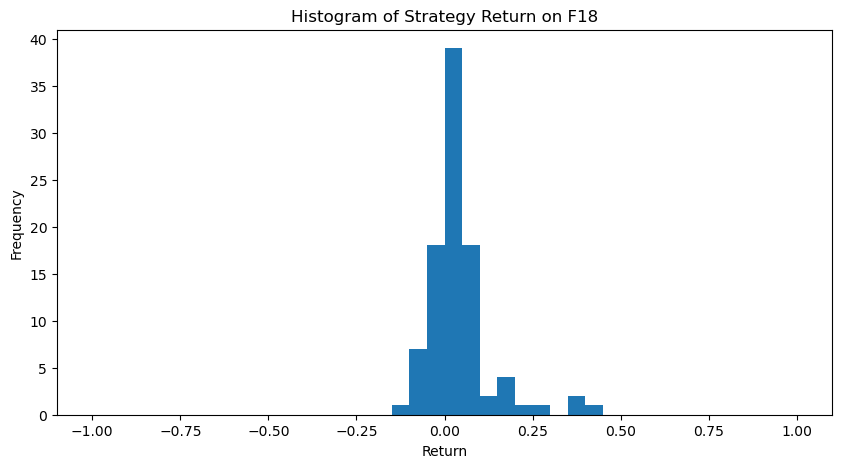

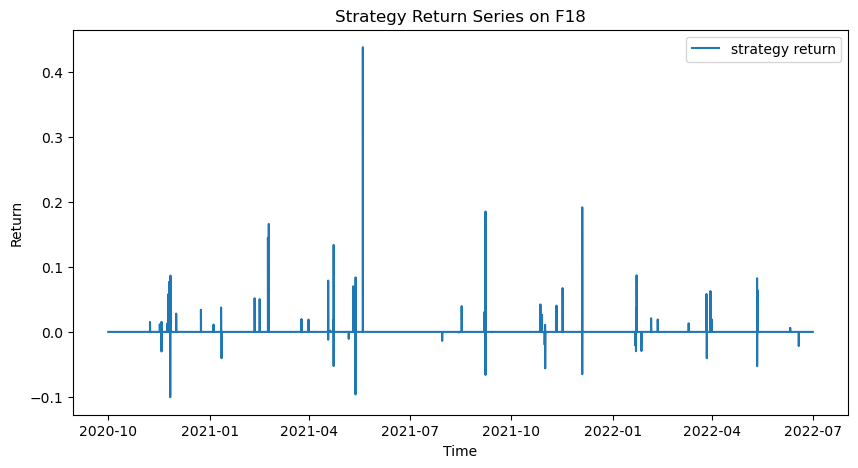

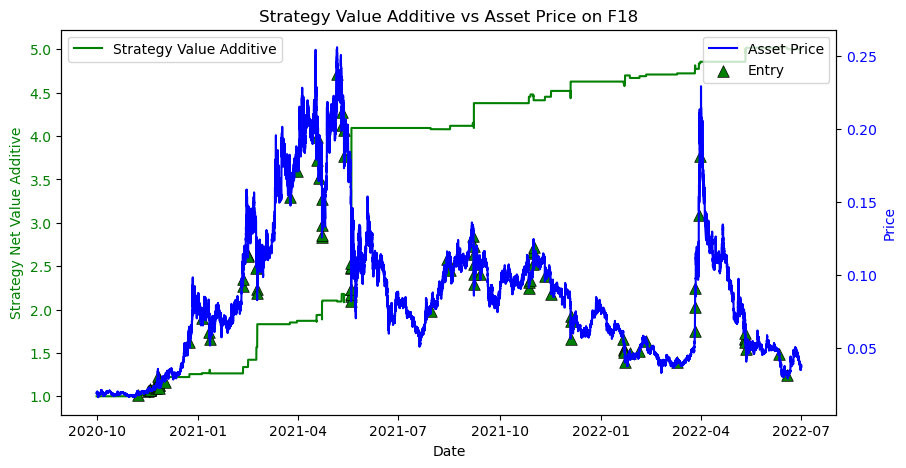

Win Prob: 72.34%
Number of Trades:  94 94
Average Win Return:   0.07135
Average Loss Return: -0.03263
P&L Ratio: 2.2
Maximum Loss of a single trade: -0.1004
Maximum Drawdown: -15.38%
Annualized Return: 158.12%
Annualized Volatility: 60.68%
Sharpe:  2.556


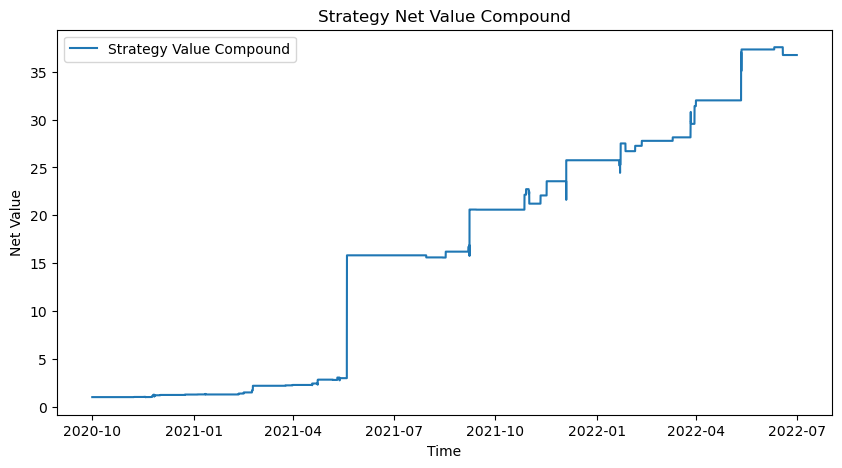

CAGR: 684.08%
Annual Return: 158.12%
Annual Volatility: 60.68%
Sharpe:  2.556


In [289]:
# strategy 8.2 
stra8_2 = CTAStrategy(data_list[-1],'open_time','signal','close',120,5,'F18')
stra8_2.data_preprocess()
stra8_2.find_signal_8_2(10000,0.1,1)
stra8_2.get_strategy_returns(0)
stra8_2.plot_hist_seires(abs_range=1)
stra8_2.plot_cumsum_profits()
stra8_2.get_win_prob()
stra8_2.get_avg_win_return()
stra8_2.get_maximum_drawdown()
stra8_2.get_sharpe()
stra8_2.plot_cumprod_value()

In [291]:
temp = stra8_2.data.loc[stra8_2.data.trade, ['open_time', 'EntryPrice','EntryTime', 'ExitPrice', 'ExitTime']]
temp['EntryPrice'].isna().any(),temp['ExitPrice'].isna().any()

(False, False)

In [292]:
temp

,open_time,EntryPrice,EntryTime,ExitPrice,ExitTime
10887,2020-11-07 19:15:00,0.017990,2020-11-07 19:15:00,0.018265,2020-11-07 21:15:00
13442,2020-11-16 16:10:00,0.021048,2020-11-16 16:10:00,0.021292,2020-11-16 18:10:00
13891,2020-11-18 05:35:00,0.022115,2020-11-18 05:35:00,0.021450,2020-11-18 07:35:00
13892,2020-11-18 05:40:00,0.021605,2020-11-18 05:40:00,0.021438,2020-11-18 07:40:00
13893,2020-11-18 05:45:00,0.021170,2020-11-18 05:45:00,0.021497,2020-11-18 07:45:00
...,...,...,...,...,...
169210,2022-05-11 12:50:00,0.054178,2022-05-11 12:50:00,0.058640,2022-05-11 14:50:00
169223,2022-05-11 13:55:00,0.060202,2022-05-11 13:55:00,0.057040,2022-05-11 15:55:00
169307,2022-05-11 20:55:00,0.049555,2022-05-11 20:55:00,0.052730,2022-05-11 22:55:00
177847,2022-06-10 12:35:00,0.046183,2022-06-10 12:35:00,0.046472,2022-06-10 14:35:00


## Test 8.3

After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


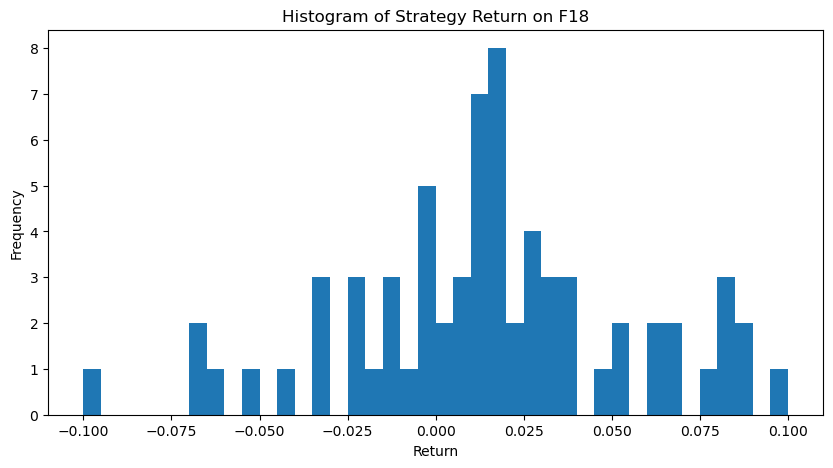

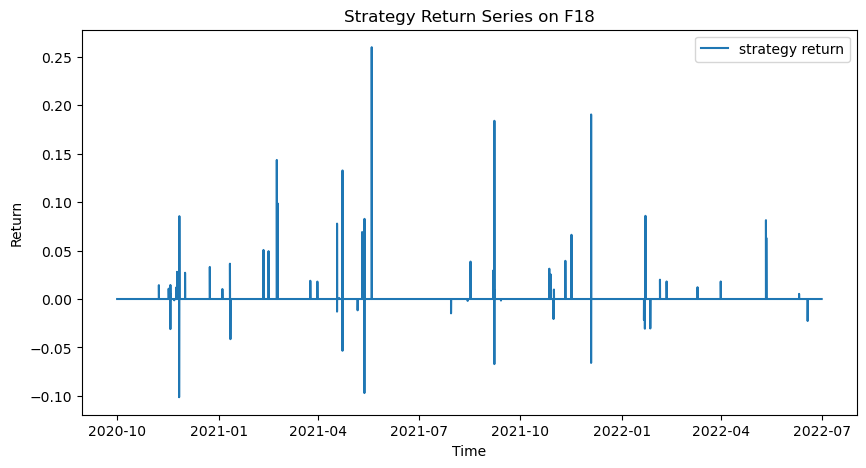

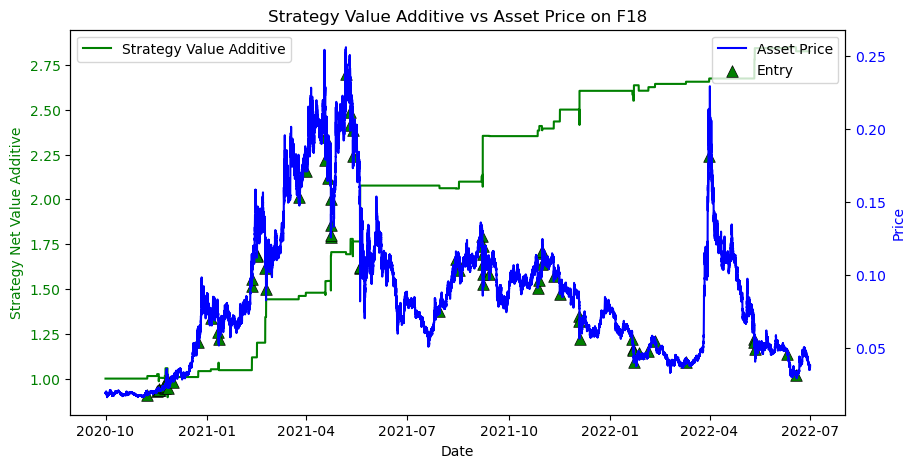

Win Prob: 68.92%
Number of Trades:  74 74
Average Win Return:   0.04998
Average Loss Return: -0.03141
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.1014
Maximum Drawdown: -15.57%
Annualized Return: 72.14%
Annualized Volatility: 34.92%
Sharpe:  1.98


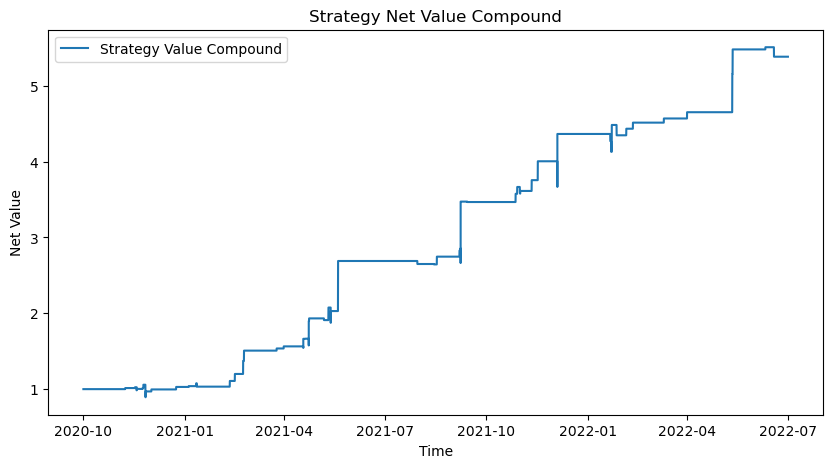

CAGR: 161.65%
Annual Return: 72.14%
Annual Volatility: 34.92%
Sharpe:  1.98


In [293]:
# strategy 8.3
stra8_3 = CTAStrategy(data_list[-1],'open_time','signal','close',120,5,'F18')
stra8_3.data_preprocess()
stra8_3.find_signal_8_3(10000,0.1,1)
stra8_3.get_strategy_returns(0.001)
stra8_3.plot_hist_seires(abs_range=0.1)
stra8_3.plot_cumsum_profits()
stra8_3.get_win_prob()
stra8_3.get_avg_win_return()
stra8_3.get_maximum_drawdown()
stra8_3.get_sharpe()
stra8_3.plot_cumprod_value()

## Test 8.4

After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


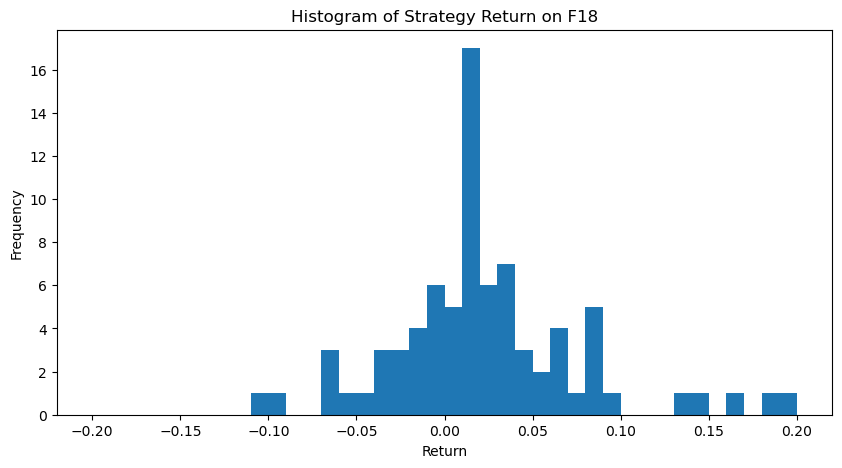

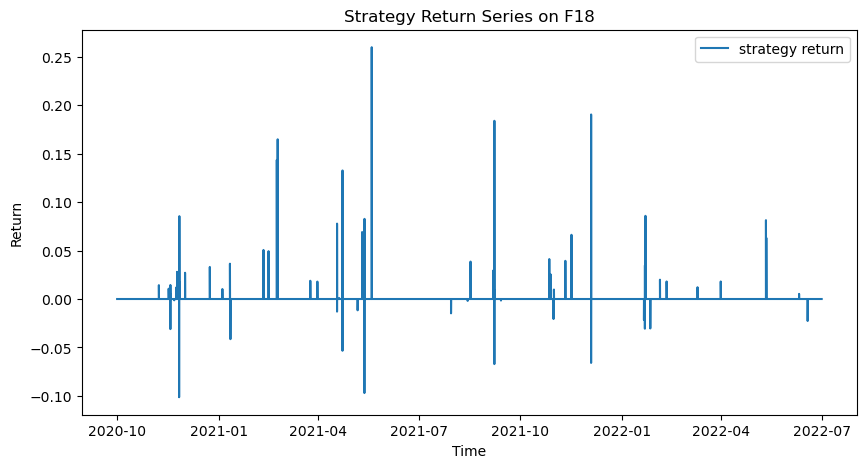

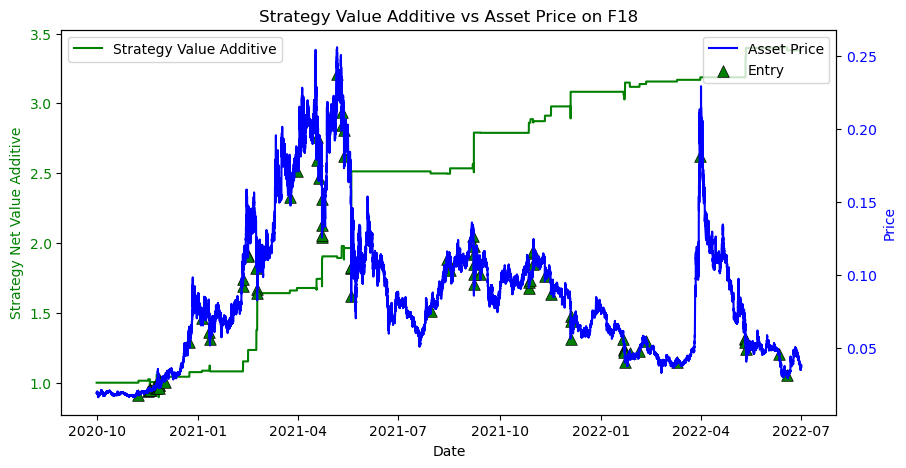

Win Prob: 71.60%
Number of Trades:  81 81
Average Win Return:   0.05348
Average Loss Return: -0.03141
P&L Ratio: 1.7
Maximum Loss of a single trade: -0.1014
Maximum Drawdown: -15.57%
Annualized Return: 93.98%
Annualized Volatility: 39.61%
Sharpe:  2.297


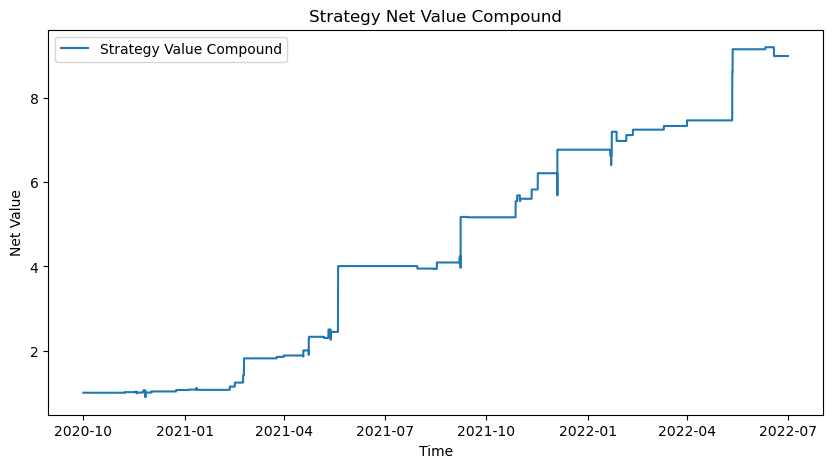

CAGR: 250.94%
Annual Return: 93.98%
Annual Volatility: 39.61%
Sharpe:  2.297


In [294]:
# strategy 8.4
stra8_4 = CTAStrategy(data_list[-1],'open_time','signal','close',120,5,'F18')
stra8_4.data_preprocess()
stra8_4.find_signal_8_4(10000,0.1,1)
stra8_4.get_strategy_returns(0.001)
stra8_4.plot_hist_seires(abs_range=0.2)
stra8_4.plot_cumsum_profits()
stra8_4.get_win_prob()
stra8_4.get_avg_win_return()
stra8_4.get_maximum_drawdown()
stra8_4.get_sharpe()
stra8_4.plot_cumprod_value()

In [304]:
stra8_3.win_prob , stra8_4.win_prob

(0.6891891891891891, 0.7160493827160493)

# Strategy 8.1

After preprocess the data has 183744 columns.
Preprocess finished
113
72
8.1 Trading signal finished


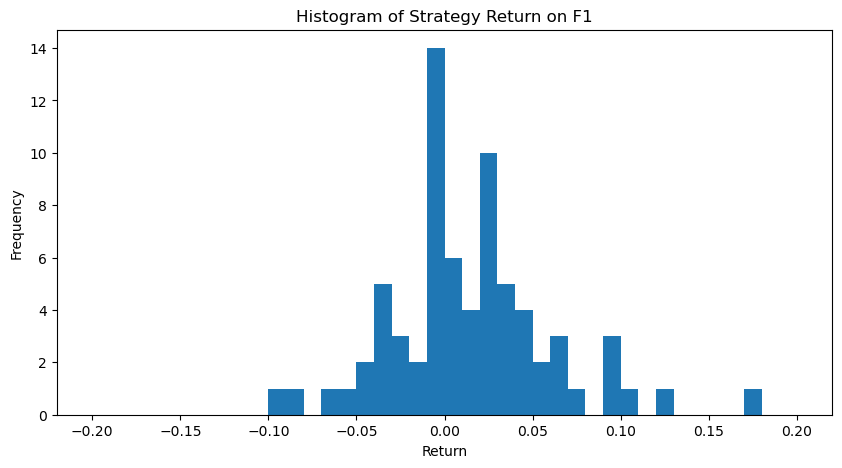

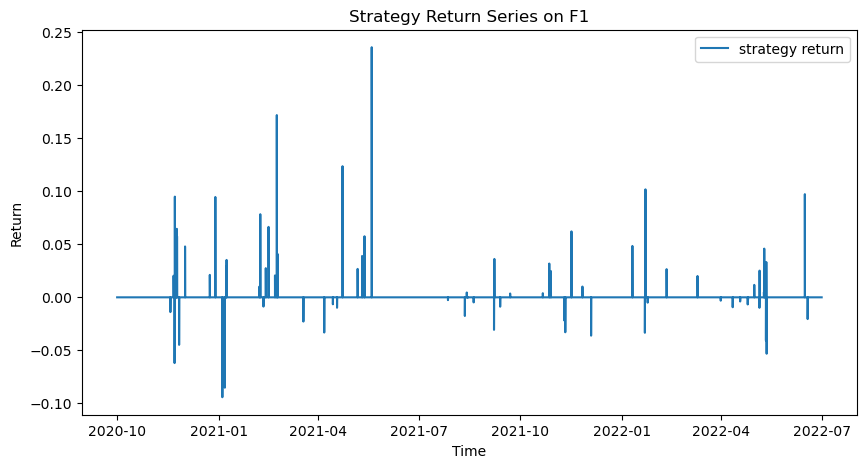

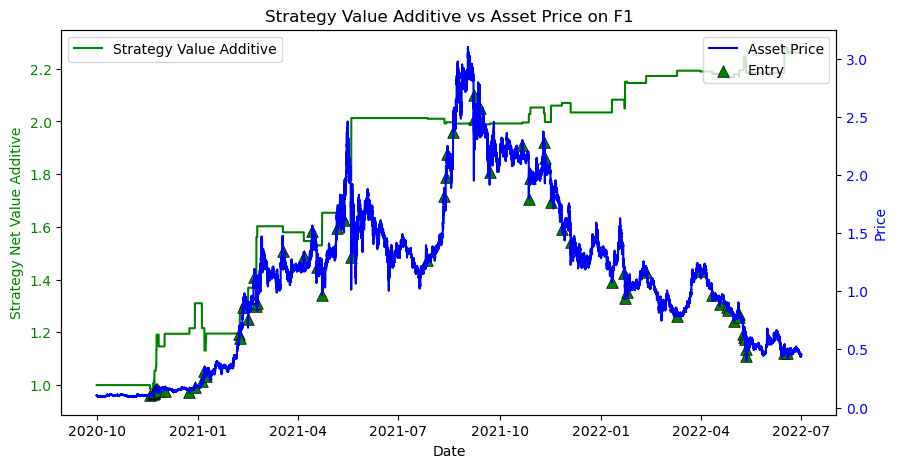

Win Prob: 58.33%
Number of Trades:  72 113
Average Win Return:   0.0473
Average Loss Return: -0.02418
P&L Ratio: 2.0
Maximum Loss of a single trade: -0.0942
Maximum Drawdown: -17.14%
Annualized Return: 49.81%
Annualized Volatility: 29.44%
Sharpe:  1.59


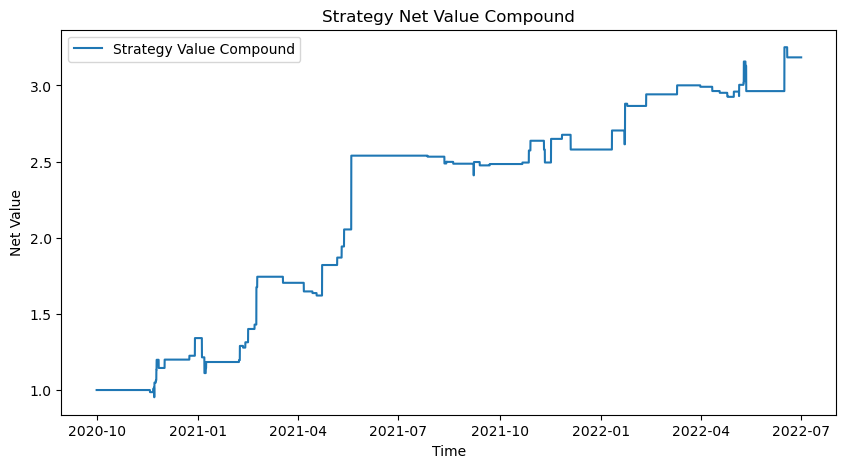

CAGR: 93.84%
Annual Return: 49.81%
Annual Volatility: 29.44%
Sharpe:  1.59


After preprocess the data has 192671 columns.
Preprocess finished
106
78
8.1 Trading signal finished


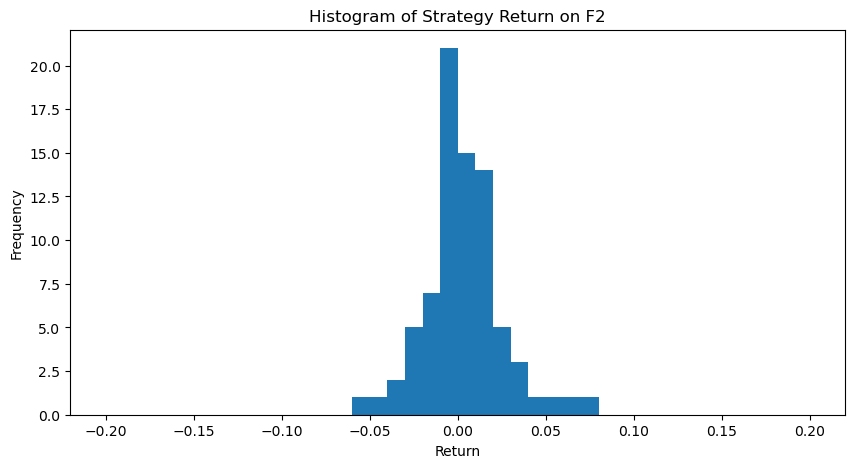

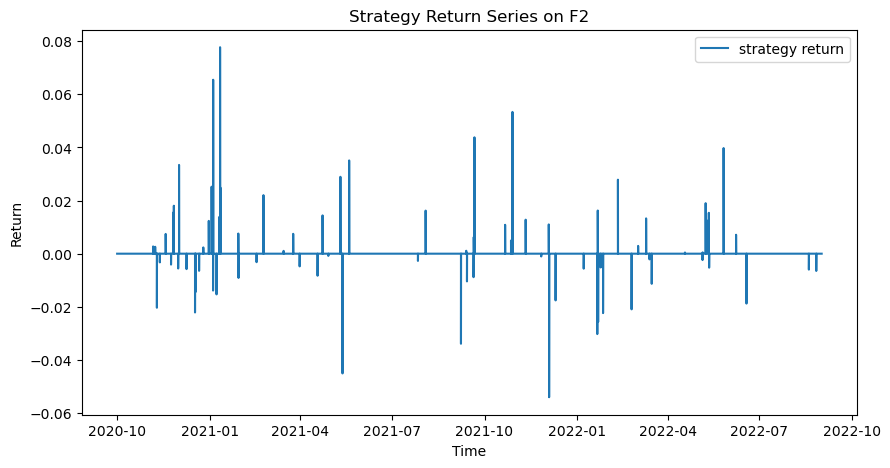

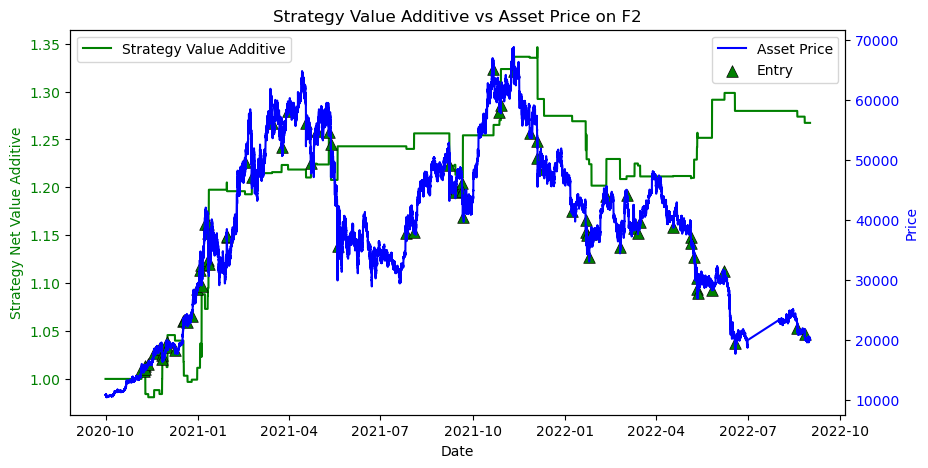

Win Prob: 52.56%
Number of Trades:  78 106
Average Win Return:   0.0181
Average Loss Return: -0.01283
P&L Ratio: 1.4
Maximum Loss of a single trade: -0.05404
Maximum Drawdown: -13.71%
Annualized Return: 10.07%
Annualized Volatility: 11.87%
Sharpe:  0.5958


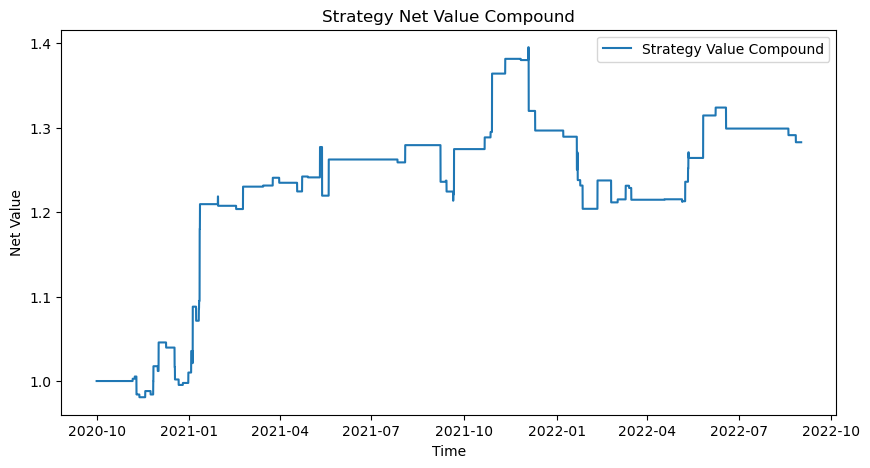

CAGR: 15.29%
Annual Return: 10.07%
Annual Volatility: 11.87%
Sharpe:  0.5958


After preprocess the data has 183744 columns.
Preprocess finished
109
75
8.1 Trading signal finished


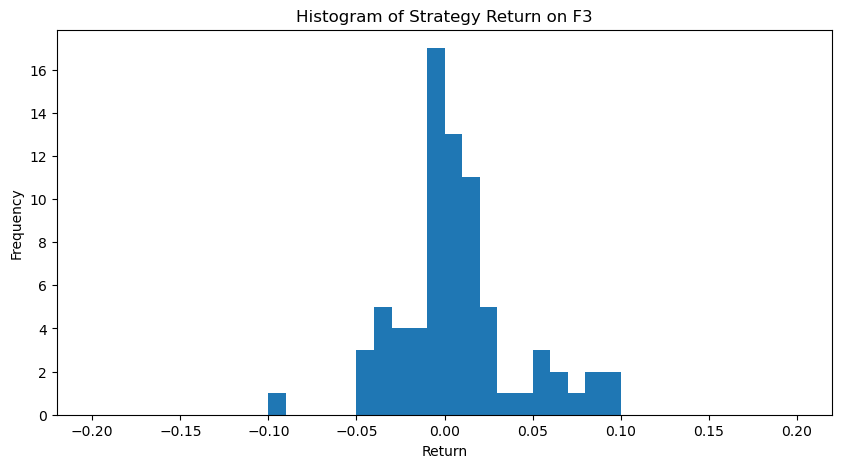

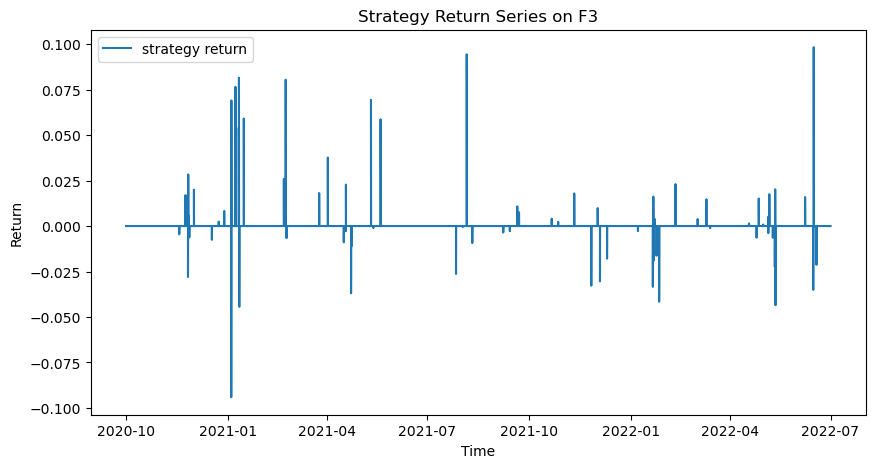

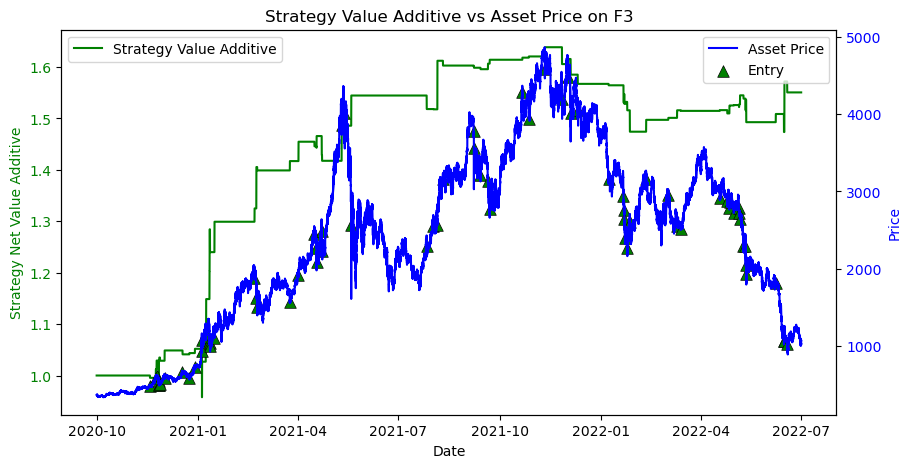

Win Prob: 54.67%
Number of Trades:  75 109
Average Win Return:   0.02881
Average Loss Return: -0.01854
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.09416
Maximum Drawdown: -15.72%
Annualized Return: 21.75%
Annualized Volatility: 18.96%
Sharpe:  0.9891


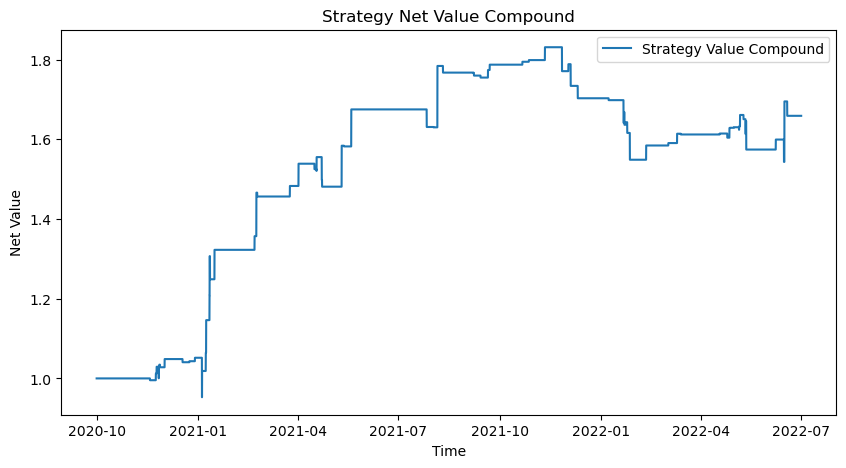

CAGR: 33.54%
Annual Return: 21.75%
Annual Volatility: 18.96%
Sharpe:  0.9891


After preprocess the data has 183744 columns.
Preprocess finished
99
69
8.1 Trading signal finished


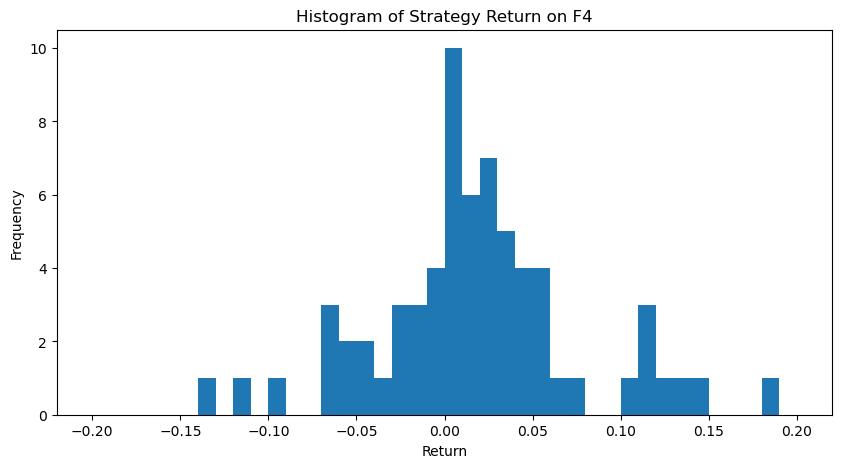

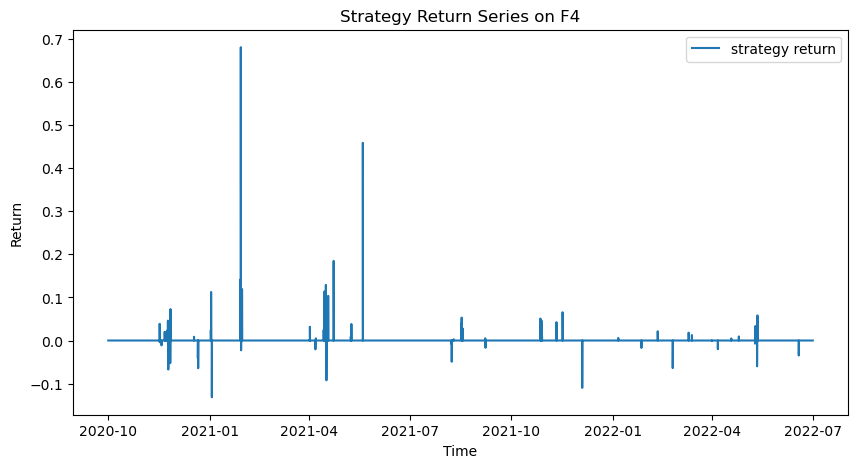

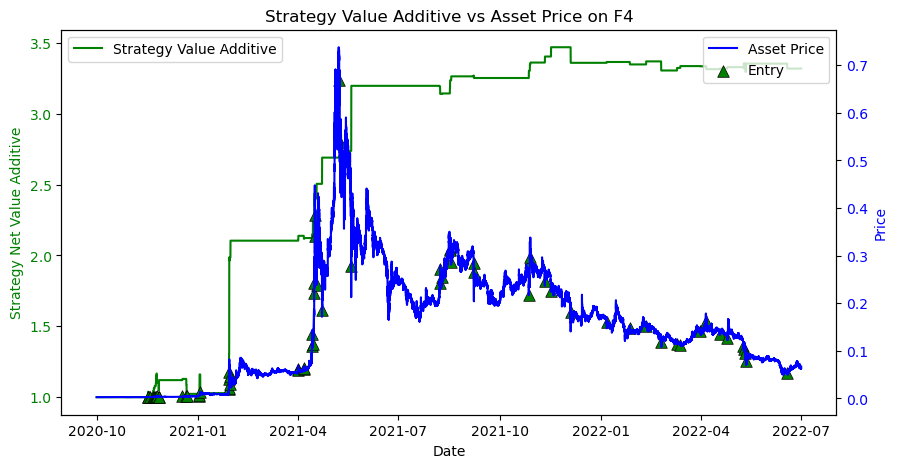

Win Prob: 69.57%
Number of Trades:  69 99
Average Win Return:   0.06696
Average Loss Return: -0.04269
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.1317
Maximum Drawdown: -16.97%
Annualized Return: 91.54%
Annualized Volatility: 60.32%
Sharpe:  1.468


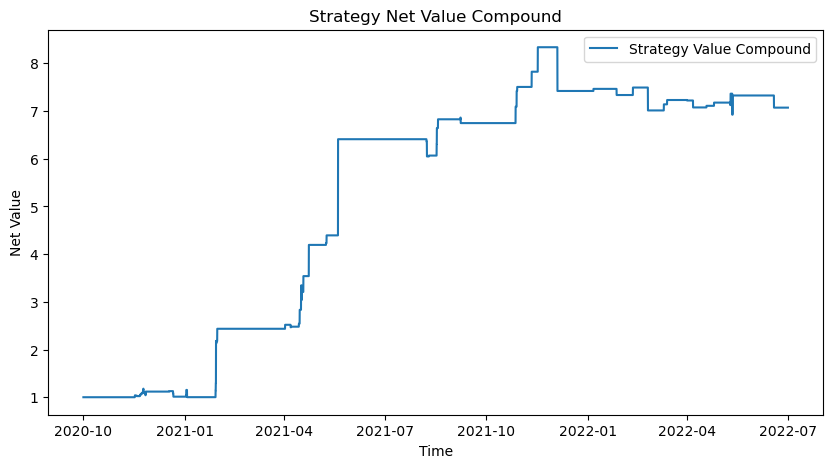

CAGR: 205.76%
Annual Return: 91.54%
Annual Volatility: 60.32%
Sharpe:  1.468


After preprocess the data has 183744 columns.
Preprocess finished
120
76
8.1 Trading signal finished


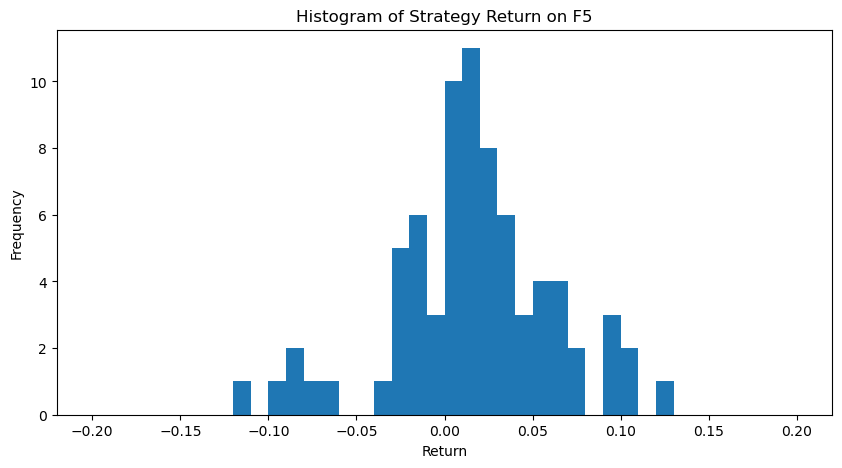

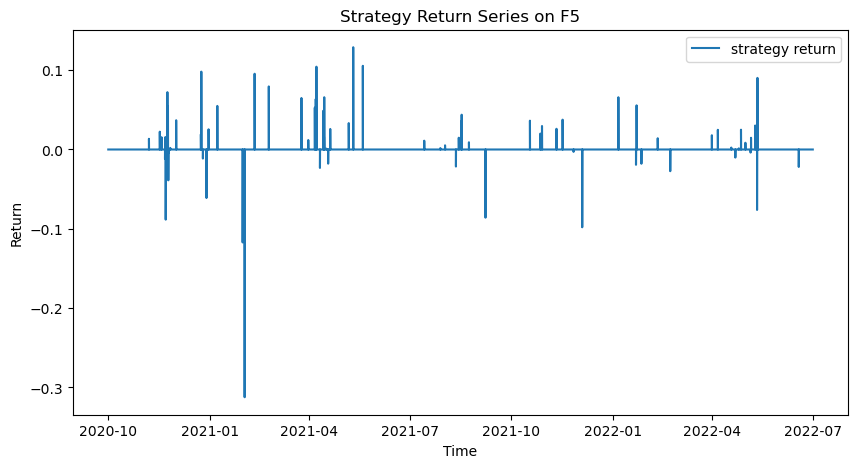

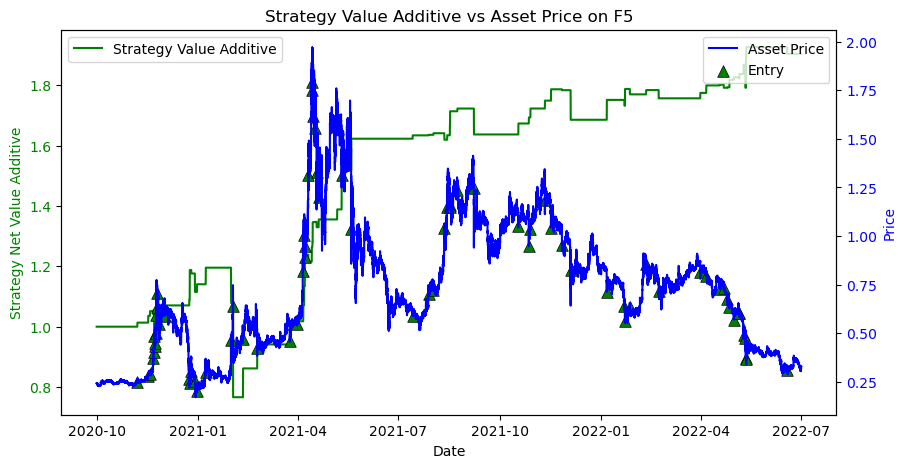

Win Prob: 71.05%
Number of Trades:  76 120
Average Win Return:   0.0371
Average Loss Return: -0.04994
P&L Ratio: 0.74
Maximum Loss of a single trade: -0.3123
Maximum Drawdown: -39.28%
Annualized Return: 35.72%
Annualized Volatility: 33.19%
Sharpe:  0.9861


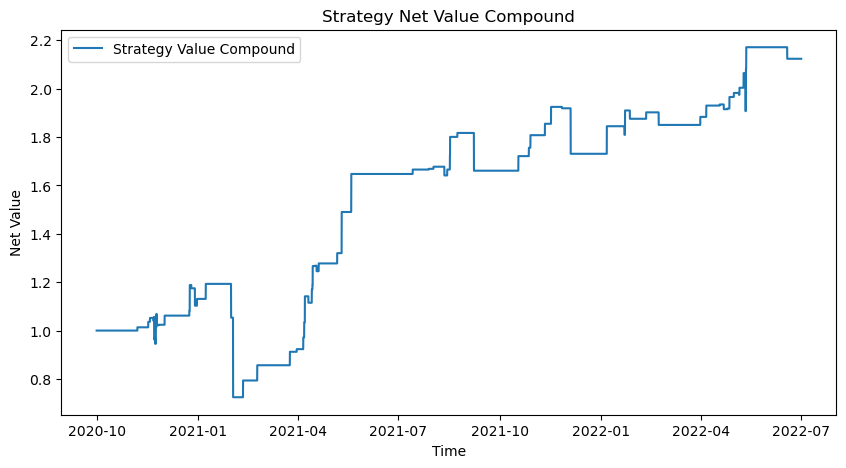

CAGR: 53.79%
Annual Return: 35.72%
Annual Volatility: 33.19%
Sharpe:  0.9861


After preprocess the data has 183744 columns.
Preprocess finished
120
83
8.1 Trading signal finished


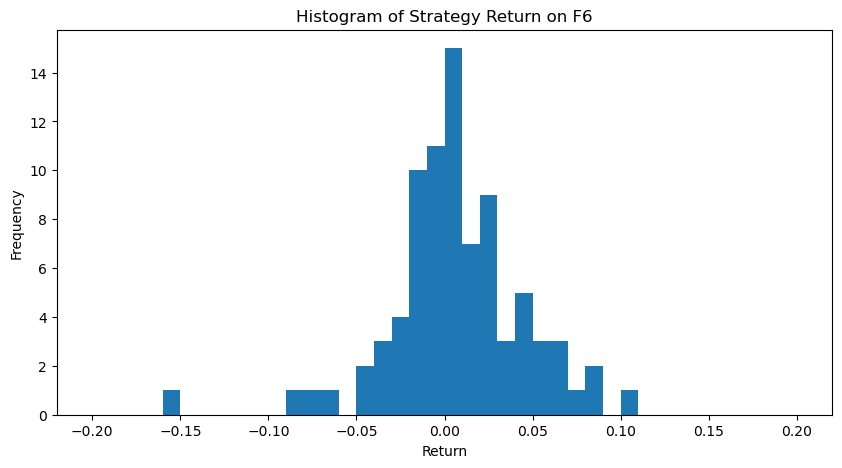

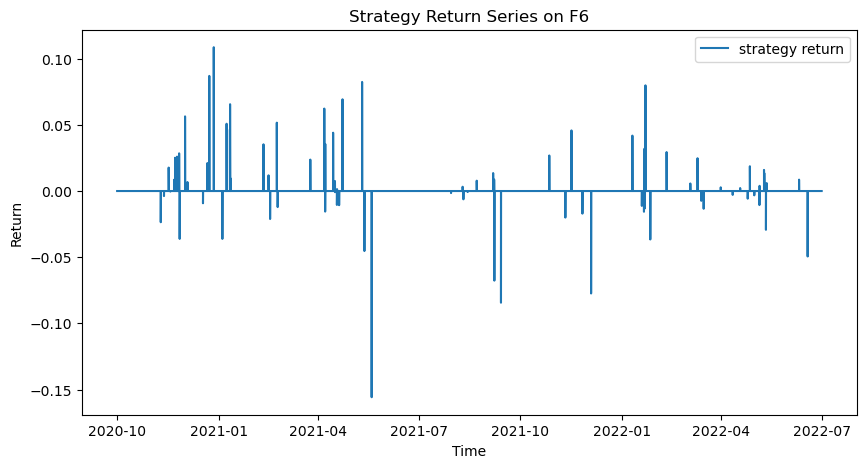

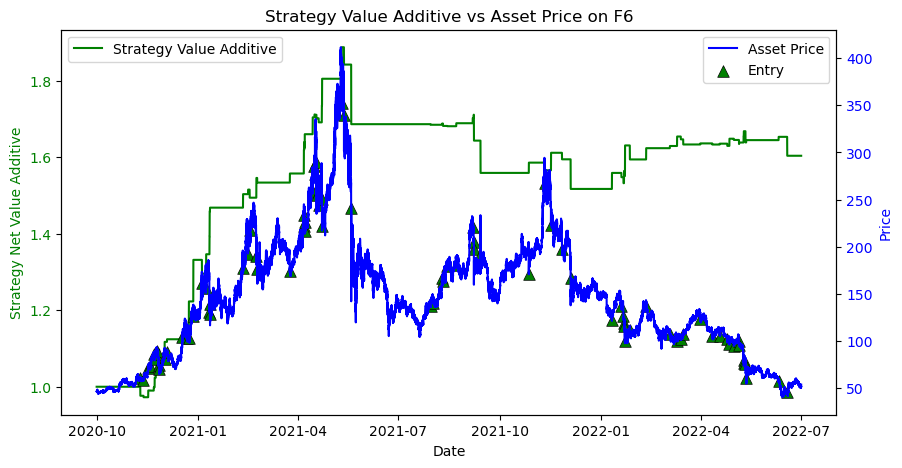

Win Prob: 59.04%
Number of Trades:  83 120
Average Win Return:   0.02978
Average Loss Return: -0.02516
P&L Ratio: 1.2
Maximum Loss of a single trade: -0.1558
Maximum Drawdown: -32.72%
Annualized Return: 23.85%
Annualized Volatility: 22.68%
Sharpe:  0.9191


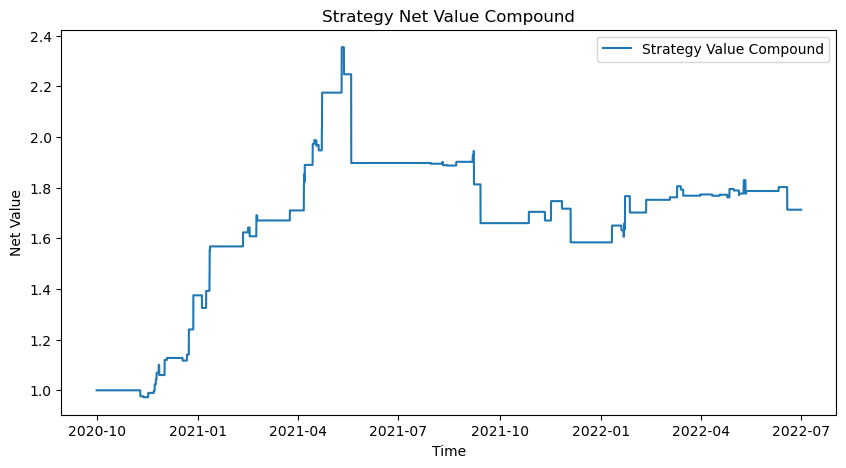

CAGR: 36.00%
Annual Return: 23.85%
Annual Volatility: 22.68%
Sharpe:  0.9191


After preprocess the data has 192671 columns.
Preprocess finished
111
78
8.1 Trading signal finished


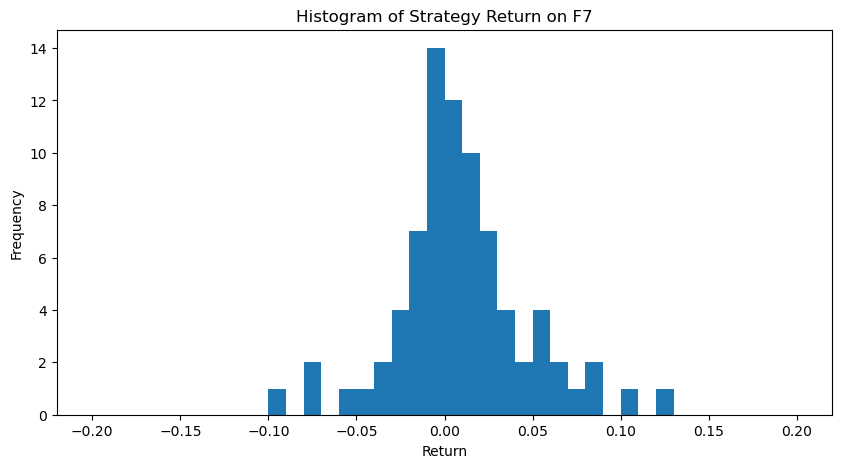

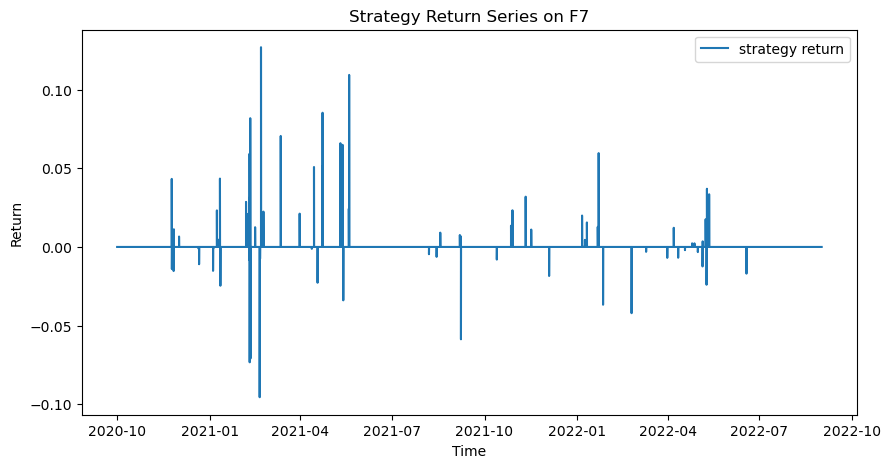

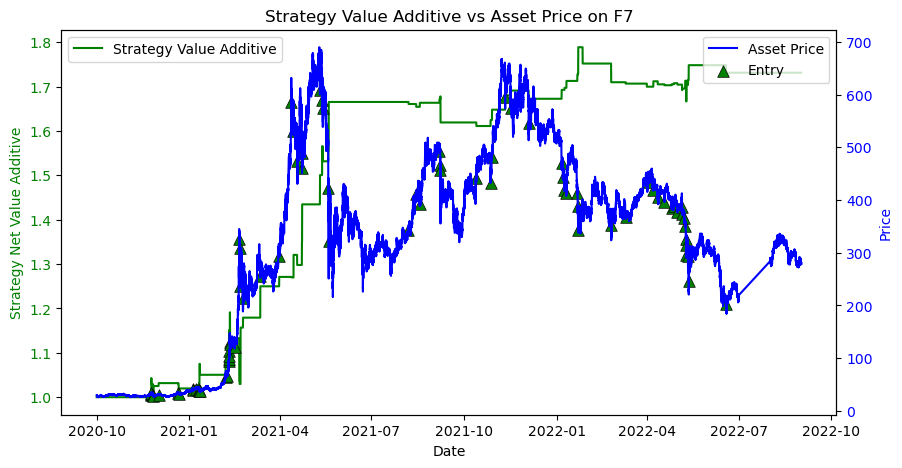

Win Prob: 58.97%
Number of Trades:  78 111
Average Win Return:   0.03045
Average Loss Return: -0.02092
P&L Ratio: 1.5
Maximum Loss of a single trade: -0.0956
Maximum Drawdown: -15.56%
Annualized Return: 27.54%
Annualized Volatility: 20.71%
Sharpe:  1.185


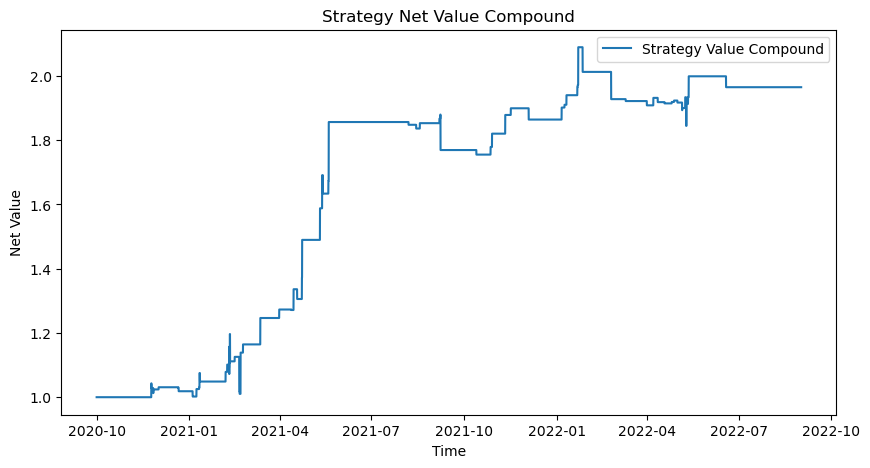

CAGR: 47.11%
Annual Return: 27.54%
Annual Volatility: 20.71%
Sharpe:  1.185


After preprocess the data has 183744 columns.
Preprocess finished
104
62
8.1 Trading signal finished


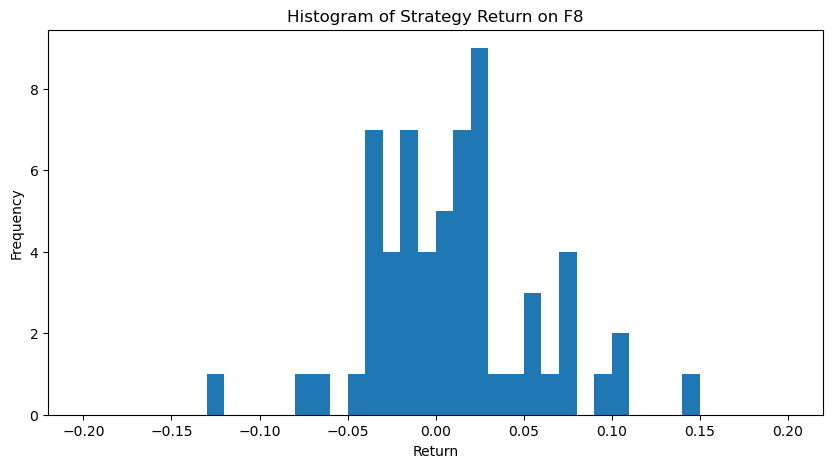

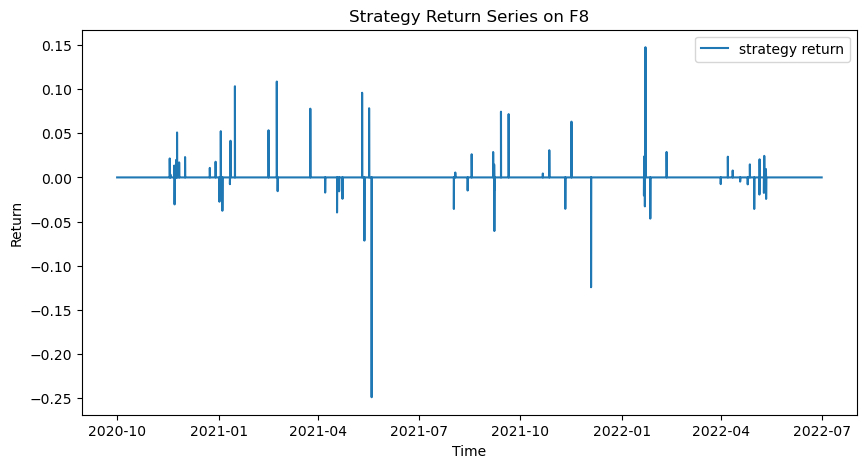

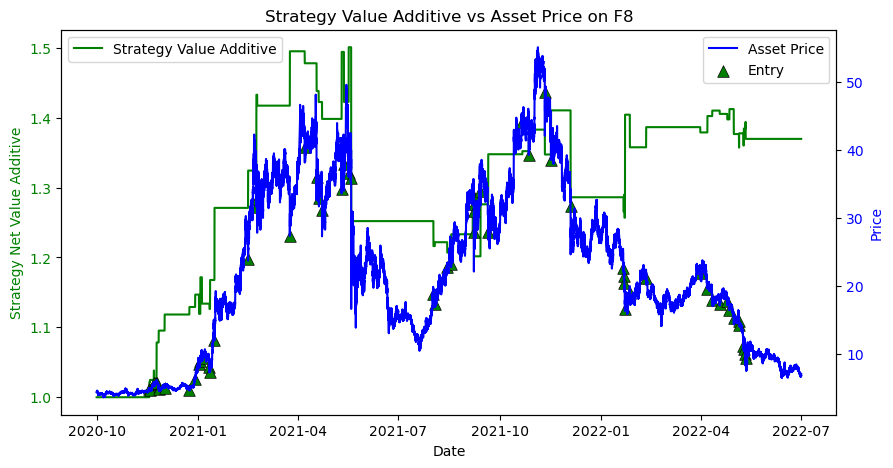

Win Prob: 56.45%
Number of Trades:  62 104
Average Win Return:   0.04022
Average Loss Return: -0.03846
P&L Ratio: 1.0
Maximum Loss of a single trade: -0.2488
Maximum Drawdown: -29.21%
Annualized Return: 14.60%
Annualized Volatility: 28.10%
Sharpe:  0.4127


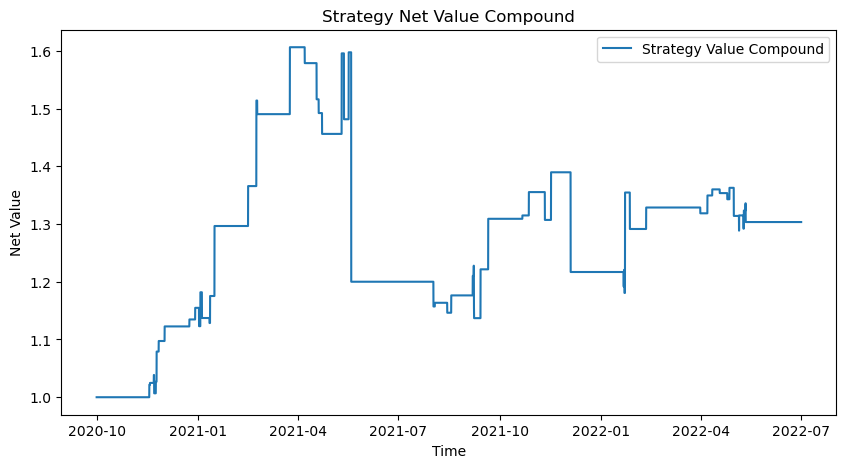

CAGR: 16.35%
Annual Return: 14.60%
Annual Volatility: 28.10%
Sharpe:  0.4127


After preprocess the data has 175103 columns.
Preprocess finished
59
38
8.1 Trading signal finished


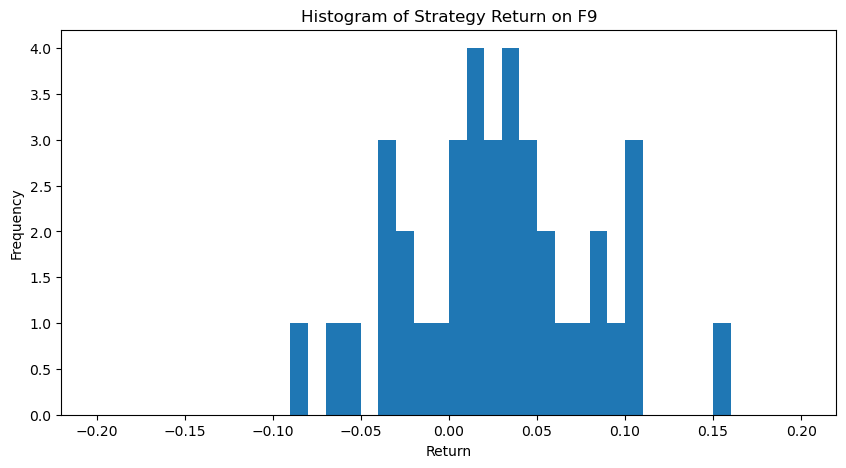

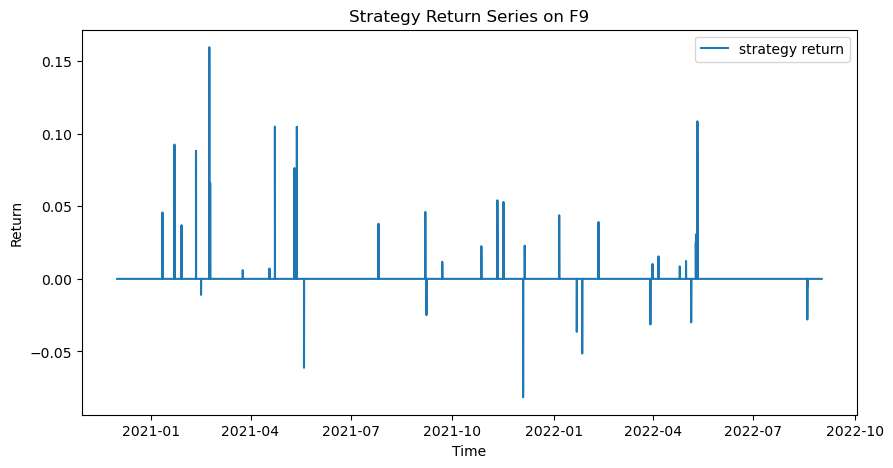

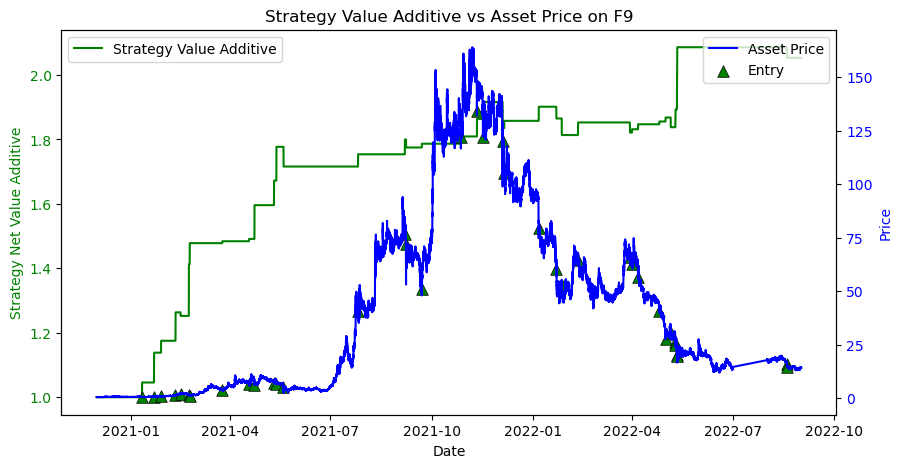

Win Prob: 73.68%
Number of Trades:  38 59
Average Win Return:   0.05052
Average Loss Return: -0.03609
P&L Ratio: 1.4
Maximum Loss of a single trade: -0.08154
Maximum Drawdown: -10.37%
Annualized Return: 43.67%
Annualized Volatility: 23.24%
Sharpe:  1.75


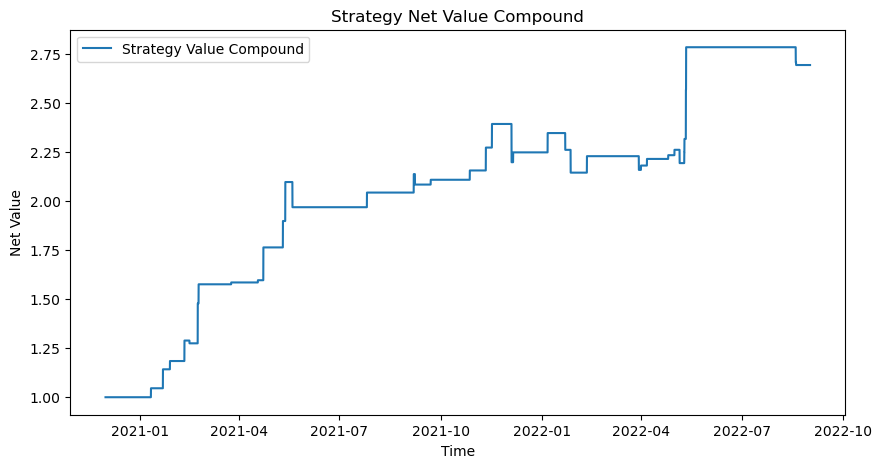

CAGR: 76.23%
Annual Return: 43.67%
Annual Volatility: 23.24%
Sharpe:  1.75


After preprocess the data has 183744 columns.
Preprocess finished
103
71
8.1 Trading signal finished


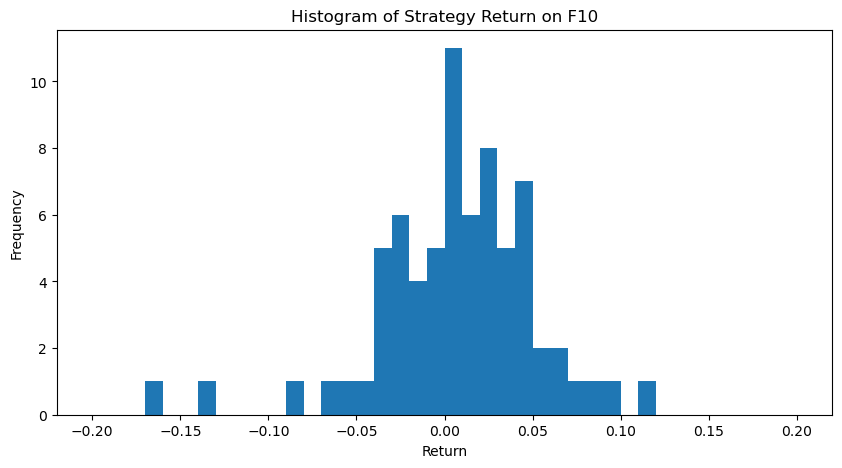

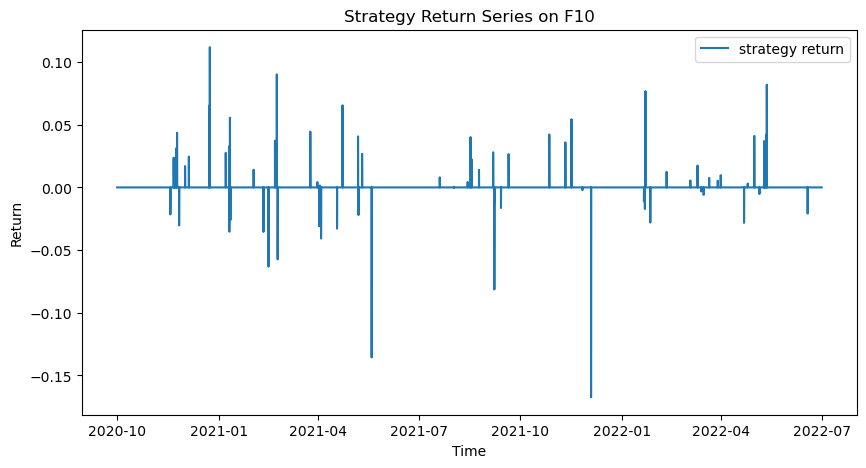

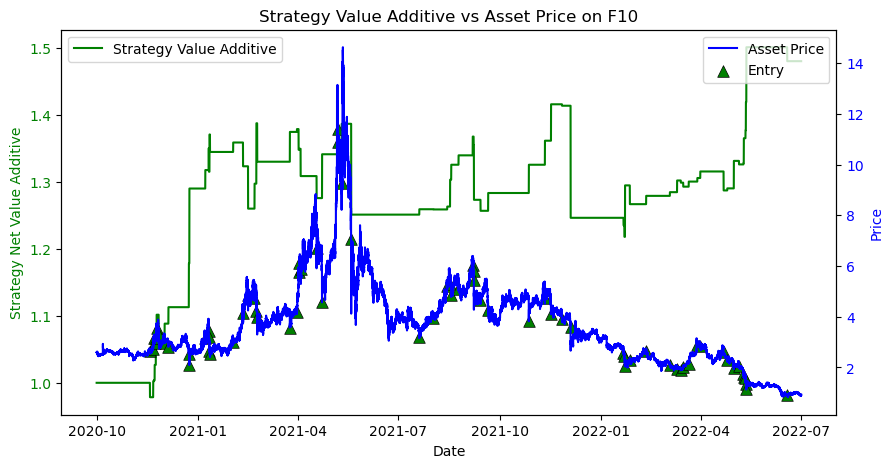

Win Prob: 63.38%
Number of Trades:  71 103
Average Win Return:   0.0314
Average Loss Return: -0.03587
P&L Ratio: 0.88
Maximum Loss of a single trade: -0.1674
Maximum Drawdown: -19.26%
Annualized Return: 18.97%
Annualized Volatility: 23.95%
Sharpe:  0.6669


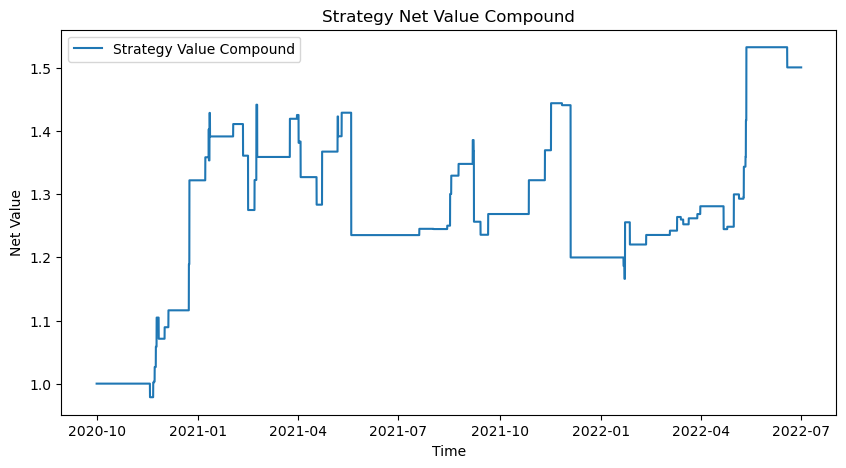

CAGR: 26.12%
Annual Return: 18.97%
Annual Volatility: 23.95%
Sharpe:  0.6669


After preprocess the data has 183744 columns.
Preprocess finished
107
65
8.1 Trading signal finished


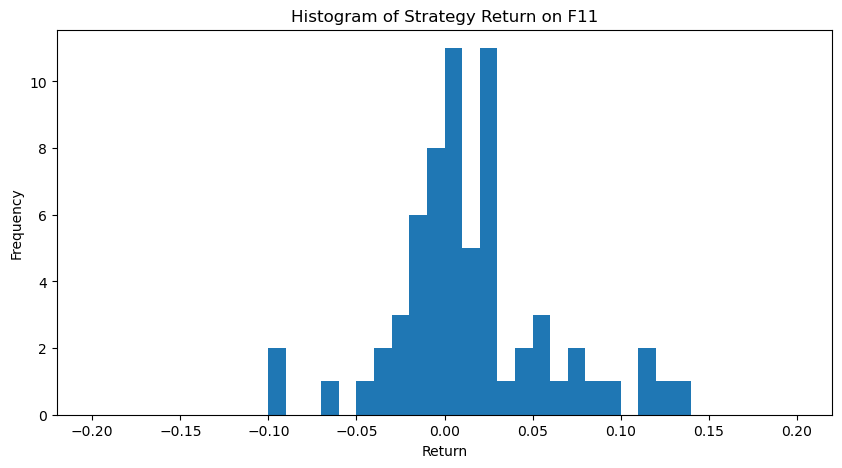

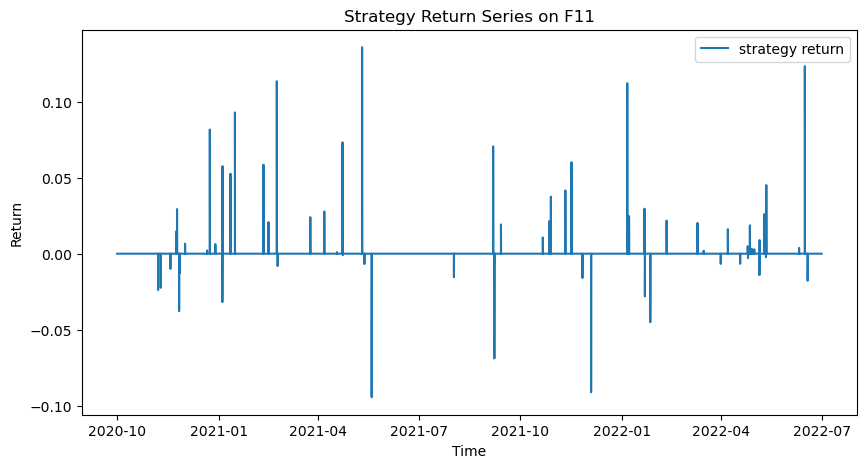

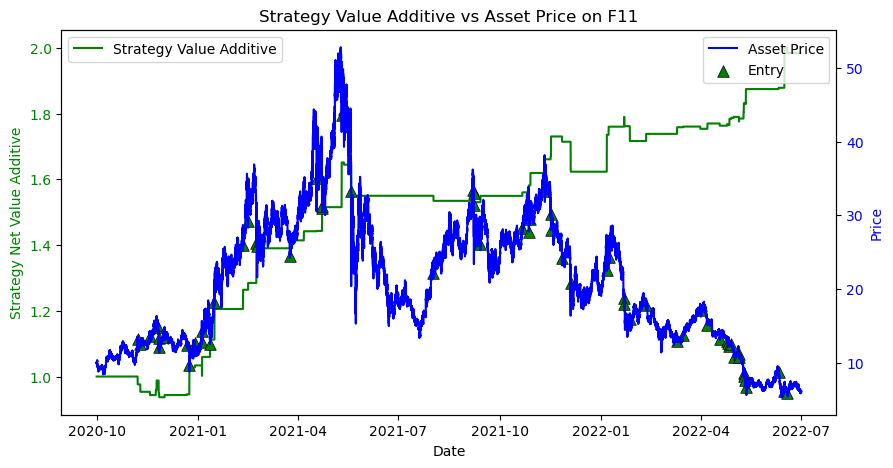

Win Prob: 64.62%
Number of Trades:  65 107
Average Win Return:   0.03702
Average Loss Return: -0.02481
P&L Ratio: 1.5
Maximum Loss of a single trade: -0.09452
Maximum Drawdown: -12.25%
Annualized Return: 38.87%
Annualized Volatility: 23.63%
Sharpe:  1.518


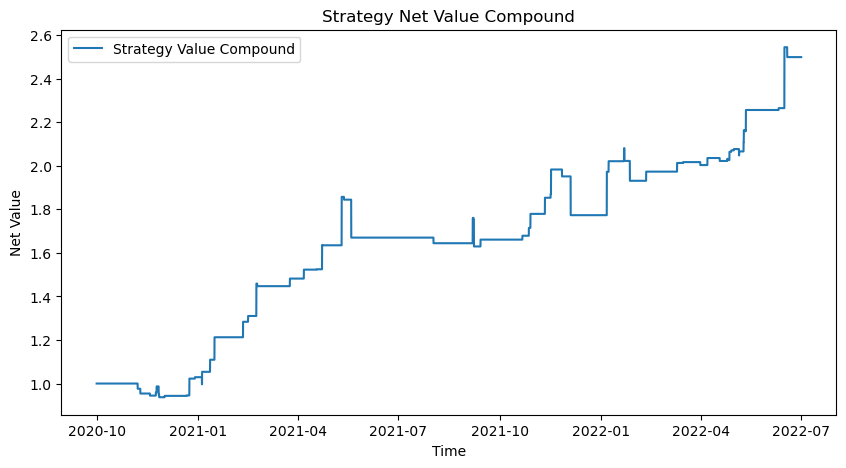

CAGR: 68.77%
Annual Return: 38.87%
Annual Volatility: 23.63%
Sharpe:  1.518


After preprocess the data has 183744 columns.
Preprocess finished
81
50
8.1 Trading signal finished


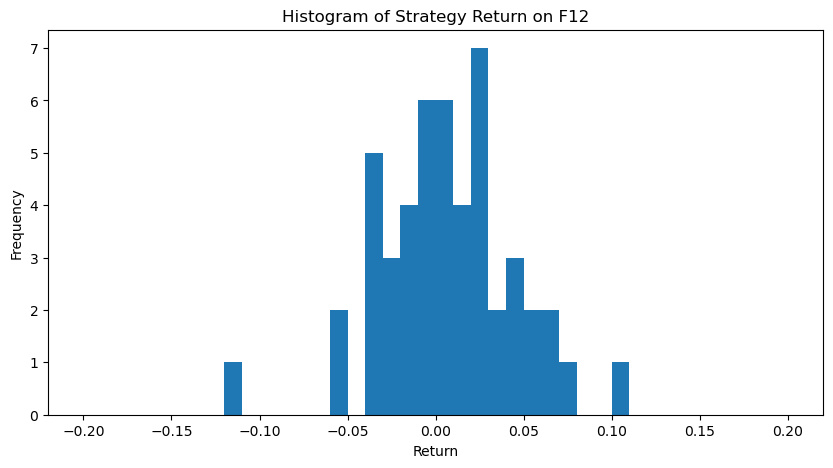

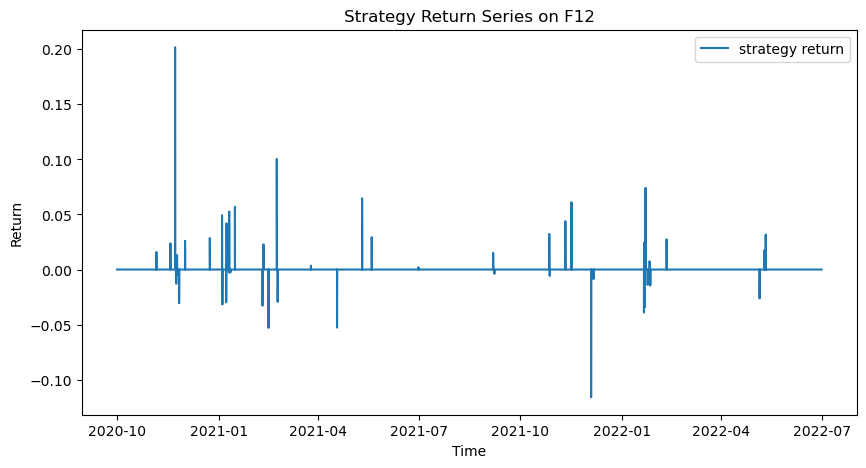

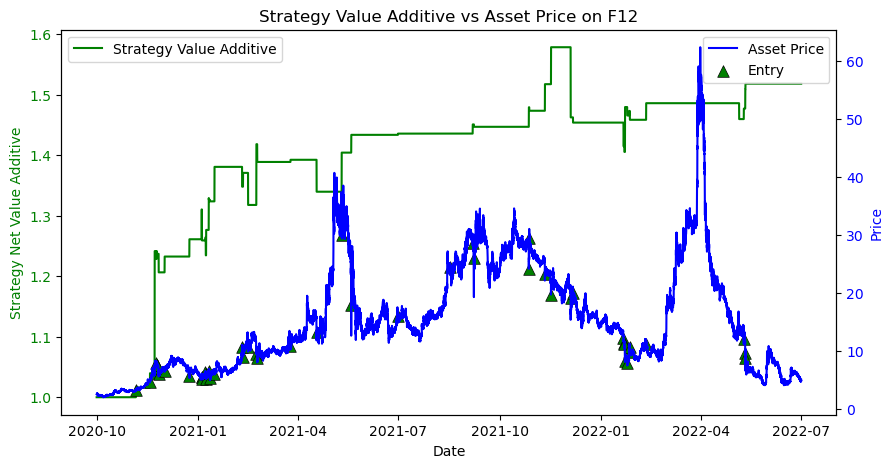

Win Prob: 58.00%
Number of Trades:  50 81
Average Win Return:   0.03735
Average Loss Return: -0.02691
P&L Ratio: 1.4
Maximum Loss of a single trade: -0.1159
Maximum Drawdown: -16.64%
Annualized Return: 20.47%
Annualized Volatility: 21.10%
Sharpe:  0.8278


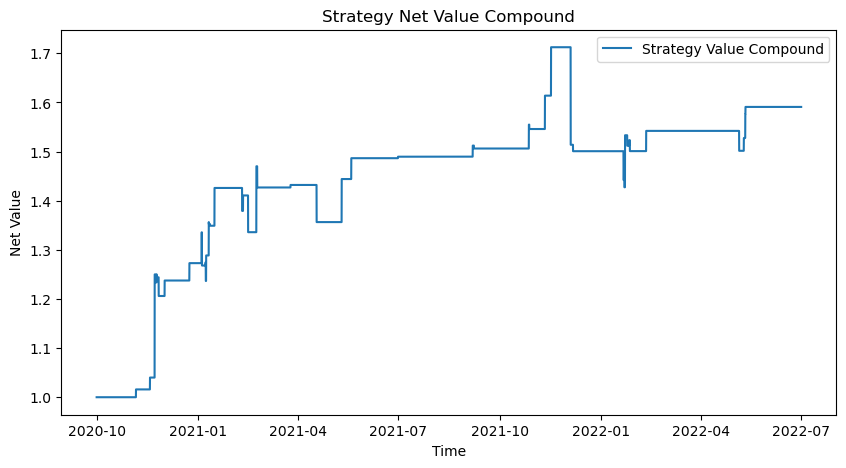

CAGR: 30.38%
Annual Return: 20.47%
Annual Volatility: 21.10%
Sharpe:  0.8278


After preprocess the data has 183744 columns.
Preprocess finished
94
60
8.1 Trading signal finished


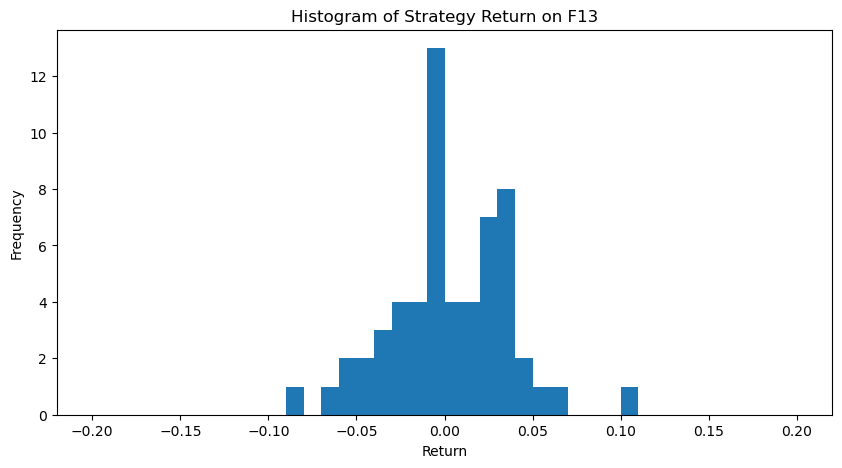

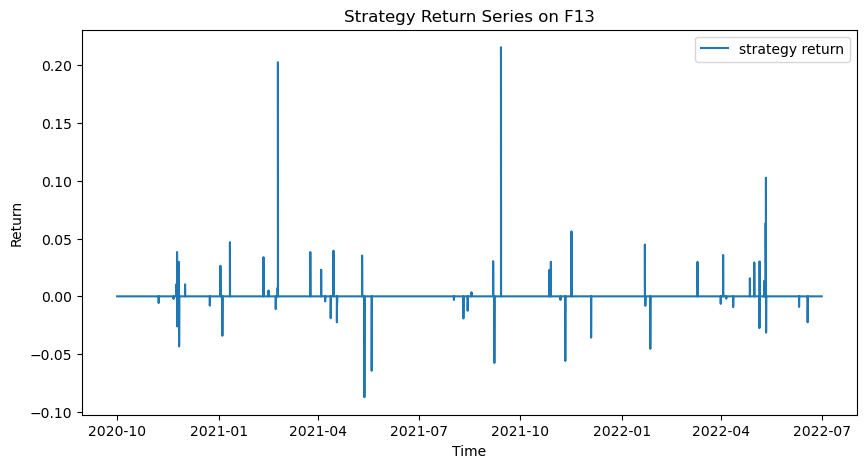

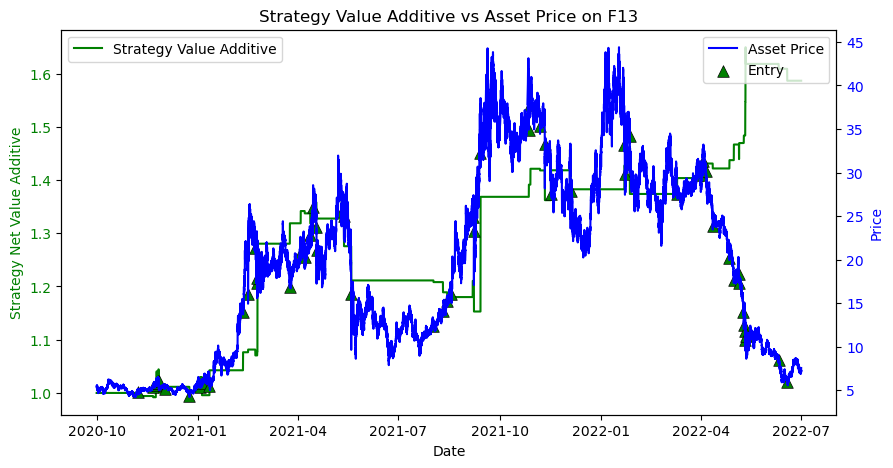

Win Prob: 50.00%
Number of Trades:  60 94
Average Win Return:   0.04237
Average Loss Return: -0.02281
P&L Ratio: 1.9
Maximum Loss of a single trade: -0.08724
Maximum Drawdown: -19.64%
Annualized Return: 23.17%
Annualized Volatility: 24.73%
Sharpe:  0.8157


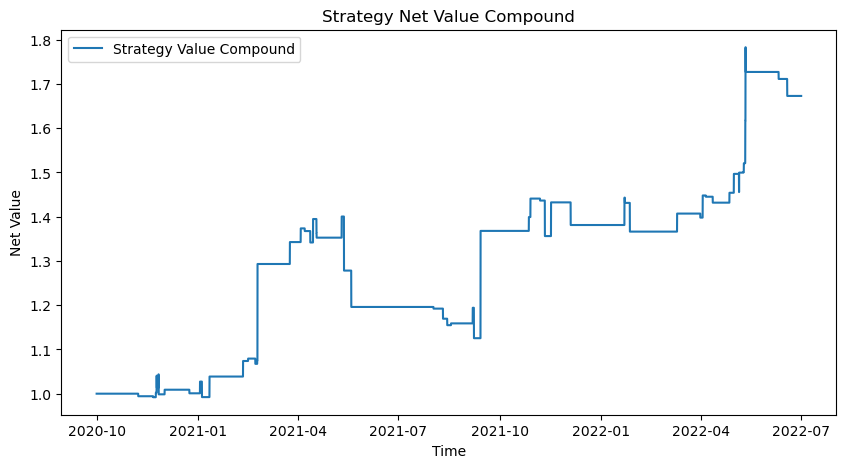

CAGR: 34.18%
Annual Return: 23.17%
Annual Volatility: 24.73%
Sharpe:  0.8157


After preprocess the data has 183744 columns.
Preprocess finished
115
76
8.1 Trading signal finished


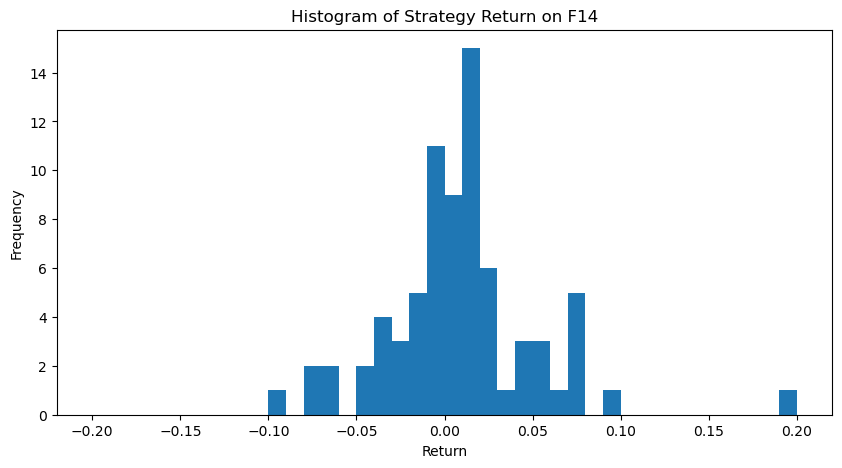

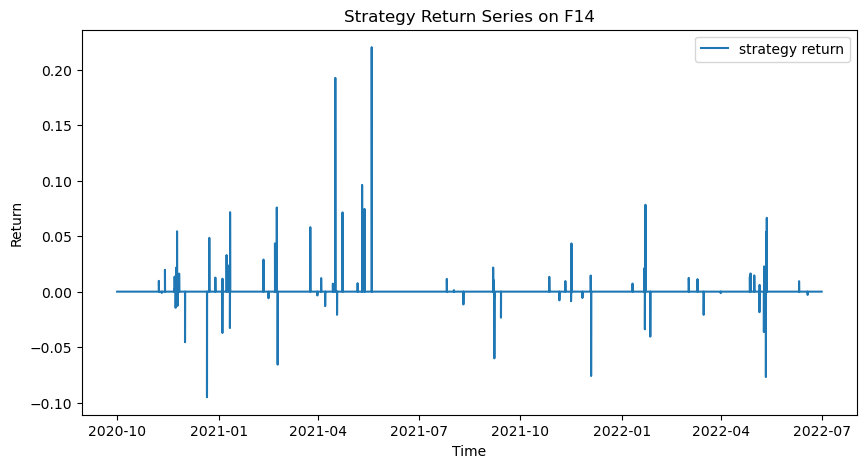

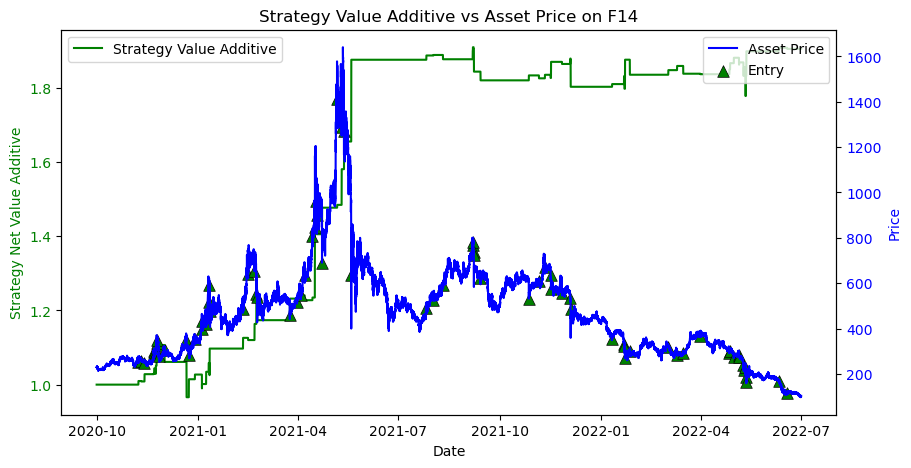

Win Prob: 60.53%
Number of Trades:  76 115
Average Win Return:   0.03667
Average Loss Return: -0.02607
P&L Ratio: 1.4
Maximum Loss of a single trade: -0.09518
Maximum Drawdown: -13.71%
Annualized Return: 35.74%
Annualized Volatility: 27.41%
Sharpe:  1.194


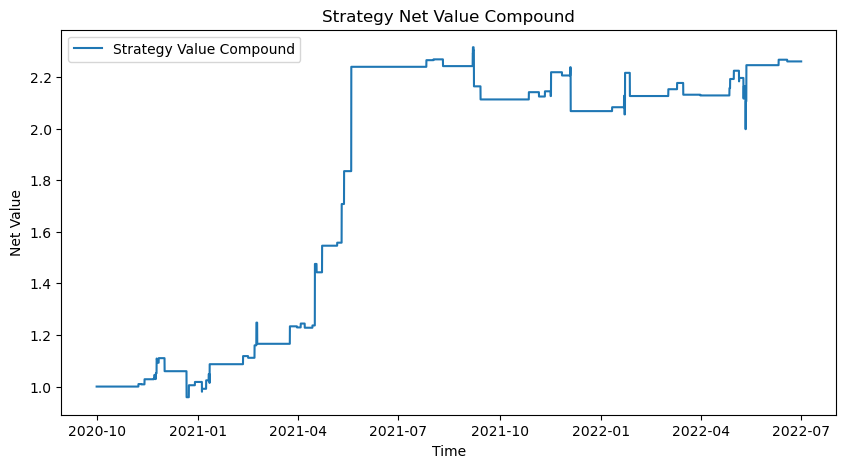

CAGR: 59.35%
Annual Return: 35.74%
Annual Volatility: 27.41%
Sharpe:  1.194


After preprocess the data has 183744 columns.
Preprocess finished
114
75
8.1 Trading signal finished


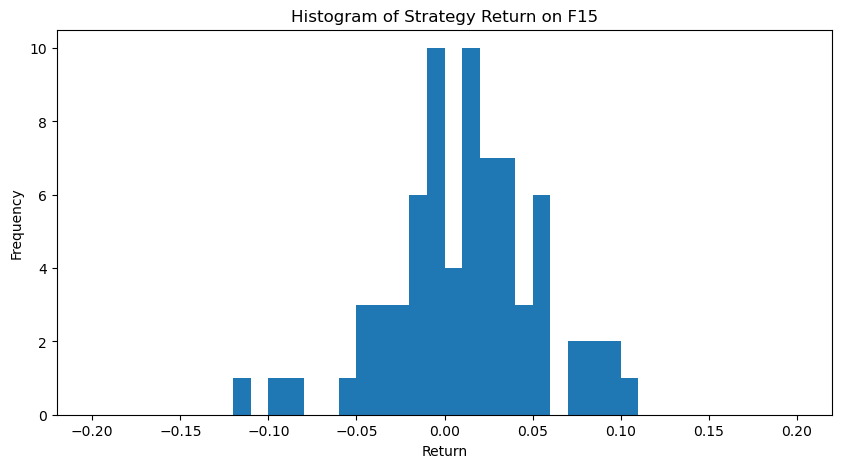

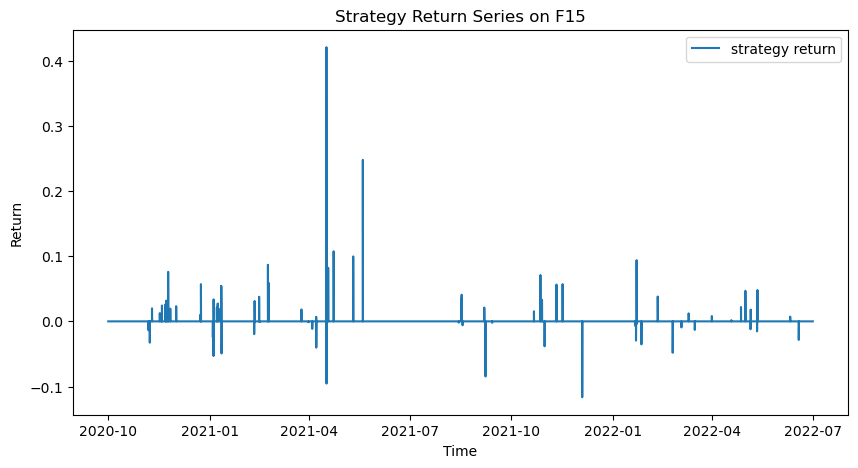

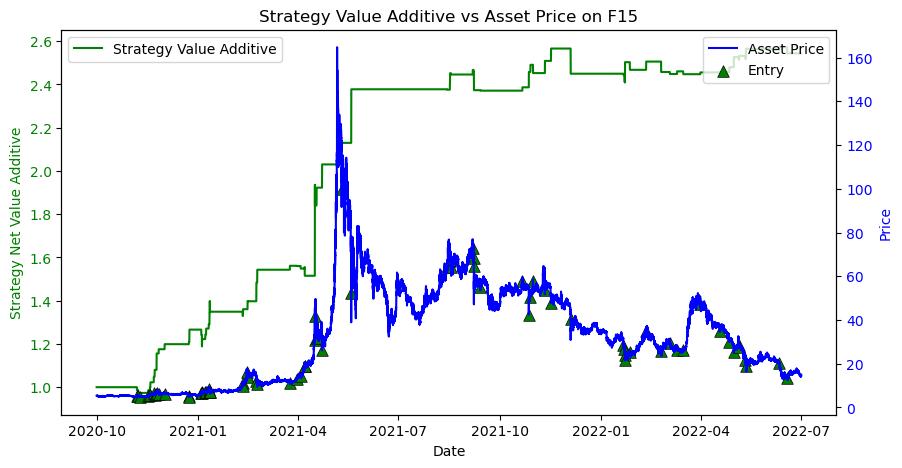

Win Prob: 61.33%
Number of Trades:  75 114
Average Win Return:   0.05101
Average Loss Return: -0.02769
P&L Ratio: 1.8
Maximum Loss of a single trade: -0.1164
Maximum Drawdown: -15.19%
Annualized Return: 60.96%
Annualized Volatility: 38.77%
Sharpe:  1.495


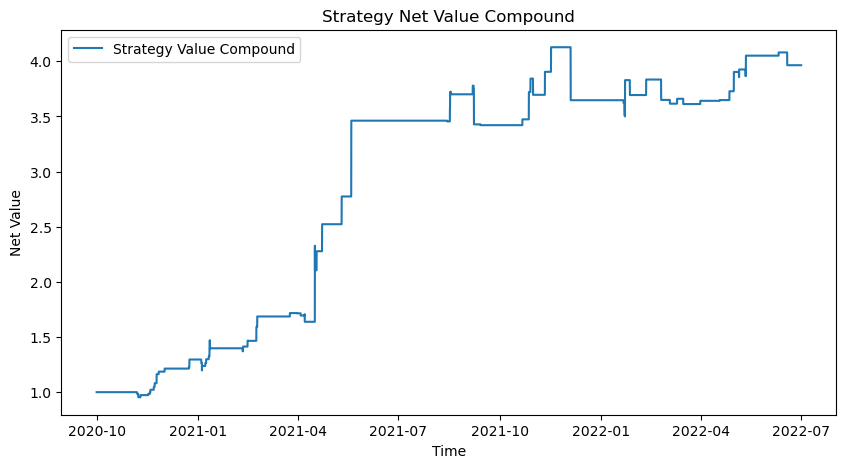

CAGR: 119.68%
Annual Return: 60.96%
Annual Volatility: 38.77%
Sharpe:  1.495


After preprocess the data has 183744 columns.
Preprocess finished
87
61
8.1 Trading signal finished


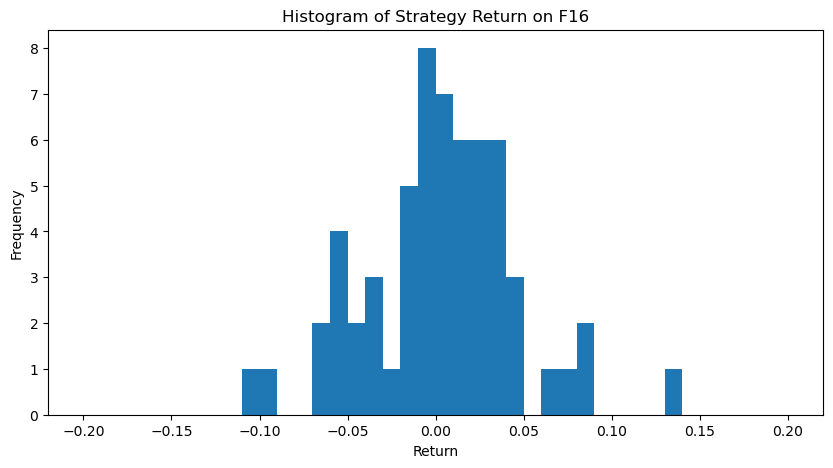

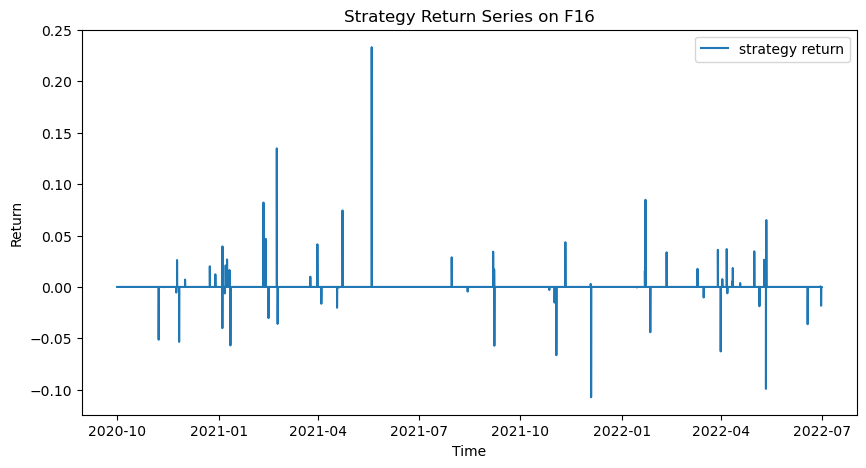

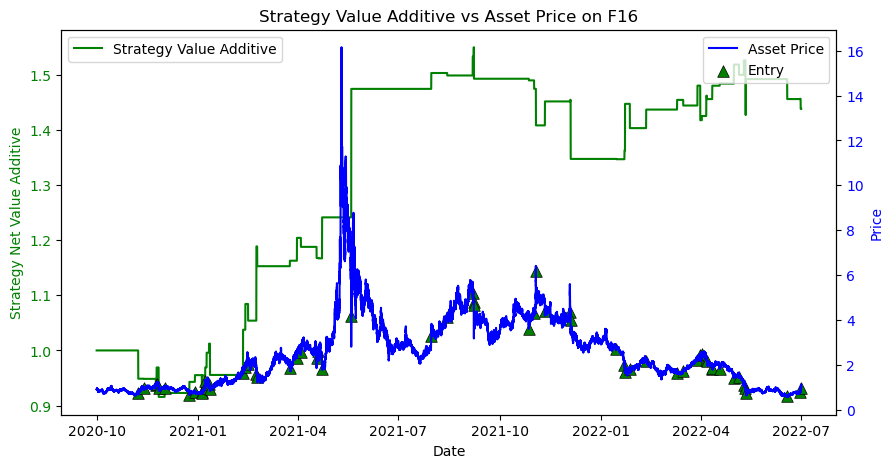

Win Prob: 55.74%
Number of Trades:  61 87
Average Win Return:   0.03837
Average Loss Return: -0.03209
P&L Ratio: 1.2
Maximum Loss of a single trade: -0.1072
Maximum Drawdown: -19.30%
Annualized Return: 17.31%
Annualized Volatility: 25.59%
Sharpe:  0.5591


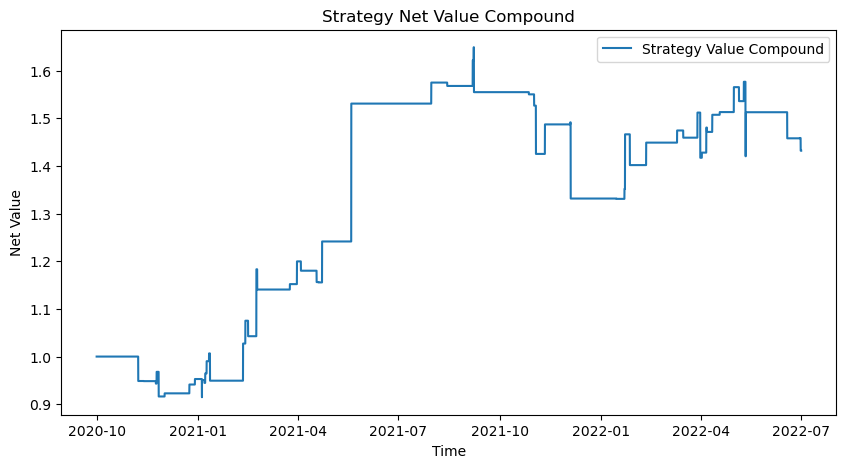

CAGR: 22.78%
Annual Return: 17.31%
Annual Volatility: 25.59%
Sharpe:  0.5591


After preprocess the data has 183744 columns.
Preprocess finished
107
69
8.1 Trading signal finished


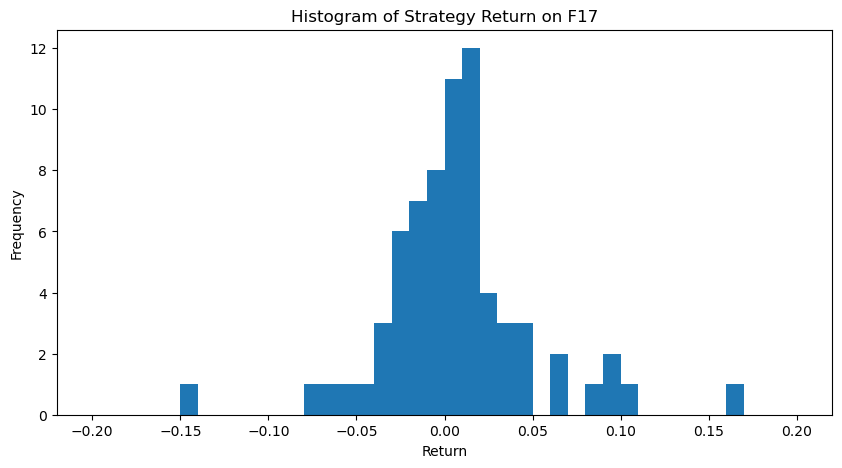

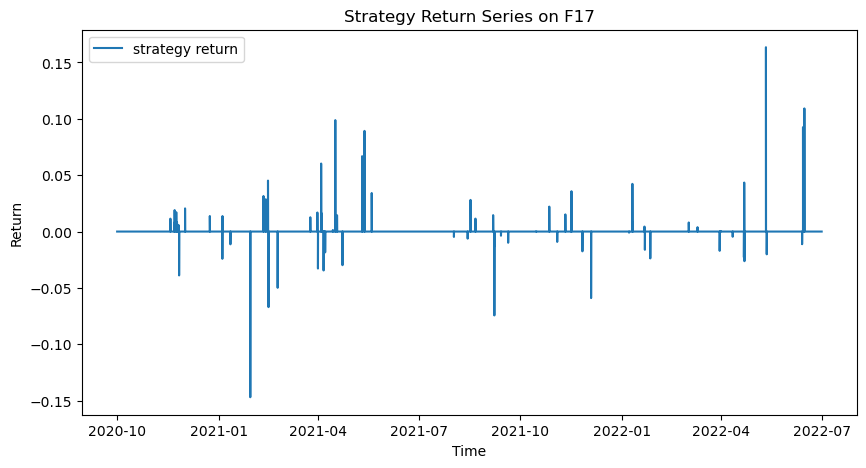

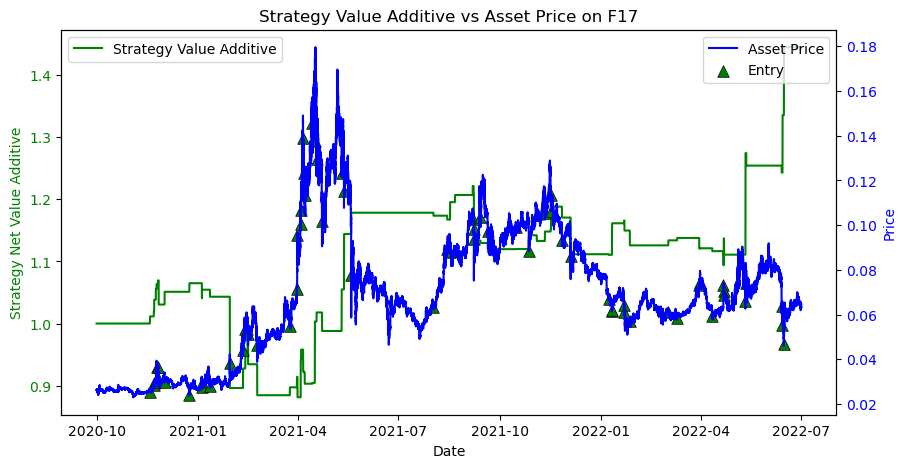

Win Prob: 57.97%
Number of Trades:  69 107
Average Win Return:   0.03106
Average Loss Return: -0.0275
P&L Ratio: 1.1
Maximum Loss of a single trade: -0.147
Maximum Drawdown: -18.77%
Annualized Return: 17.57%
Annualized Volatility: 23.07%
Sharpe:  0.6314


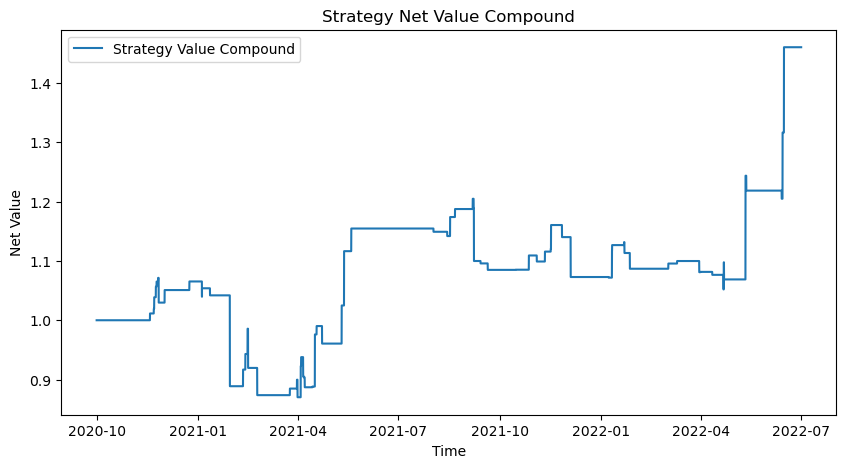

CAGR: 24.15%
Annual Return: 17.57%
Annual Volatility: 23.07%
Sharpe:  0.6314


After preprocess the data has 183744 columns.
Preprocess finished
94
62
8.1 Trading signal finished


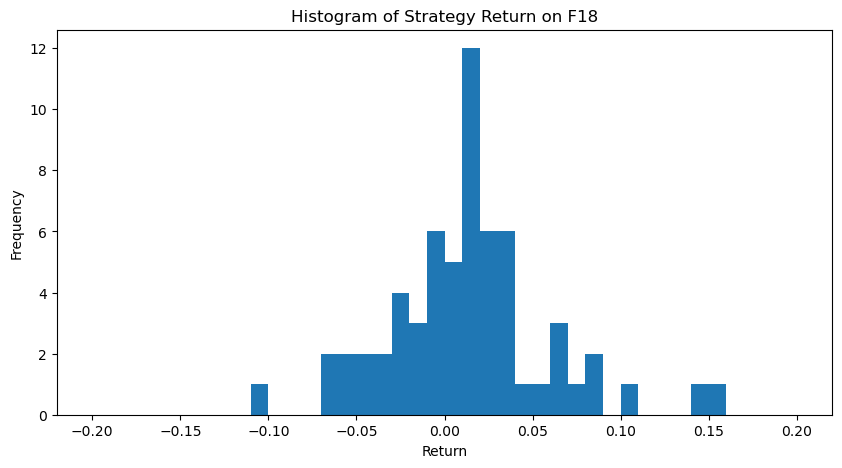

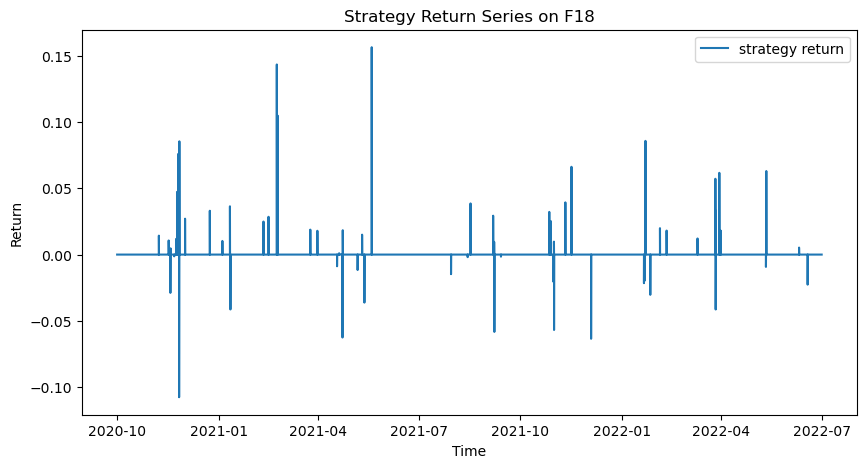

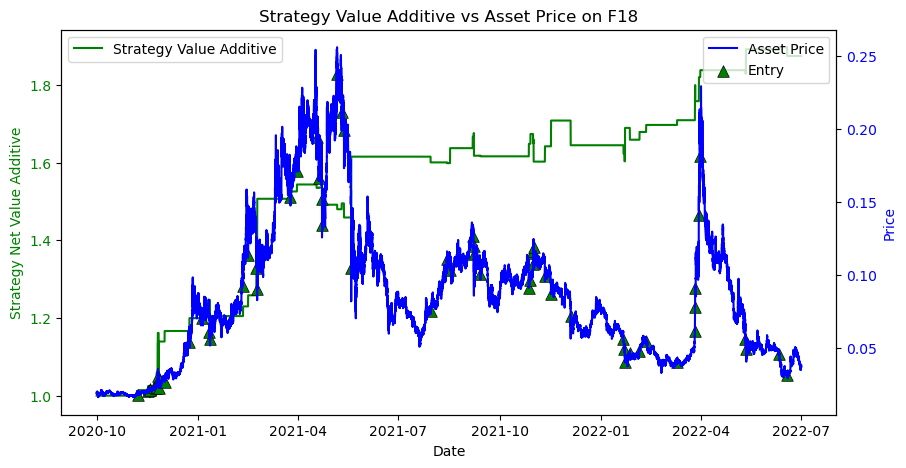

Win Prob: 64.52%
Number of Trades:  62 94
Average Win Return:   0.03847
Average Loss Return: -0.03022
P&L Ratio: 1.3
Maximum Loss of a single trade: -0.1077
Maximum Drawdown: -10.77%
Annualized Return: 34.52%
Annualized Volatility: 23.89%
Sharpe:  1.319


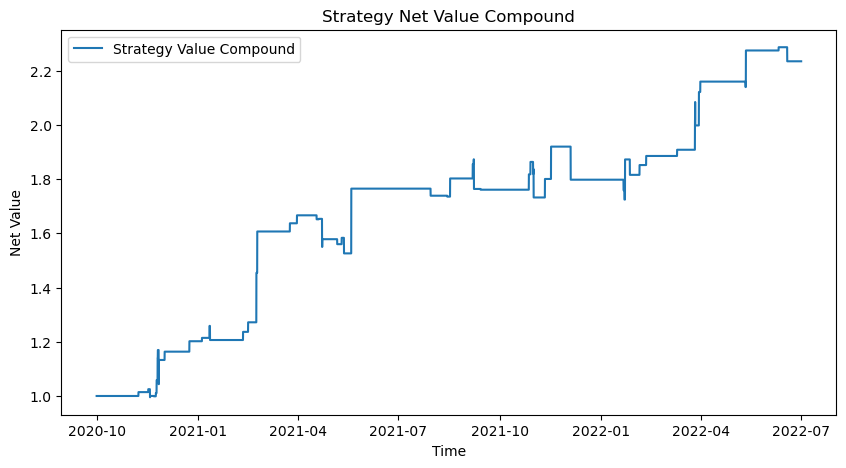

CAGR: 58.34%
Annual Return: 34.52%
Annual Volatility: 23.89%
Sharpe:  1.319




In [305]:
# strategy 8.1 use avg price as buy and sell price
strategy8_1_list = []
profit_des_8_1 = pd.DataFrame()
tbv_des_8_1 = pd.DataFrame()
tbv_tv_des_8_1 = pd.DataFrame()
tbv_pct_des_8_1 = pd.DataFrame()
ma_des_8_1 = pd.DataFrame()

for idx in range(len(data_list)):
    name = 'F'+str(idx+1)
    stra8_1 = CTAStrategy(data_list[idx],'open_time','signal','close',120,5,name)
    stra8_1.data_preprocess()
    stra8_1.find_signal_8_1(10000,0.1,1)
    stra8_1.get_strategy_returns(1/1000)
    stra8_1.plot_hist_seires()
    stra8_1.plot_cumsum_profits()
    stra8_1.get_win_prob()
    profit_des = stra8_1.get_avg_win_return()
    stra8_1.get_maximum_drawdown()
    stra8_1.get_sharpe()
    stra8_1.plot_cumprod_value()
    tbv_des, tbv_tv_des, tbv_pct_des = stra8_1.taker_buy_volume_stats()
    ma_des = stra8_1.moving_average_stats()
    strategy8_1_list.append(stra8_1)
    
    if (profit_des_8_1.empty):
        profit_des_8_1 = profit_des
        tbv_des_8_1 = tbv_des
        tbv_tv_des_8_1 = tbv_tv_des
        tbv_pct_des_8_1 = tbv_pct_des
        ma_des_8_1 = ma_des
    else:
        profit_des_8_1 = profit_des_8_1.join(profit_des)
        tbv_des_8_1 = tbv_des_8_1.join(tbv_des)
        tbv_tv_des_8_1 =tbv_tv_des_8_1.join(tbv_tv_des)
        tbv_pct_des_8_1 = tbv_pct_des_8_1.join(tbv_pct_des)
        ma_des_8_1 = ma_des_8_1.join(ma_des)
    print('\n')


## Overall Statistics

In [309]:
# calculate average win rate, average profit loss ratio, average sharpe
win_rate = []
pnl_ratio = []
sharpe = []
for ele in strategy8_1_list:
    win_rate.append(ele.win_prob)
    pnl_ratio.append(ele.pnl_ratio)
    sharpe.append(ele.sharpe)
print(f"Average Win Rate: {np.mean(win_rate):.2f}")
print(f"Average P&L Ratio: {np.mean(pnl_ratio):.2f}")
print(f"Average Sharpe: {np.mean(sharpe):.2f}")

Average Win Rate: 0.61
Average P&L Ratio: 1.38
Average Sharpe: 1.05


In [310]:
profit_des_8_1  # profit 
tbv_des_8_1  # taker buy volume quantile
tbv_tv_des_8_1  # taker buy volume/ volume 
tbv_pct_des_8_1 # taker buy volume/ volume quantile
ma_des_8_1

,F1_count,F1_pecentage,F2_count,F2_pecentage,F3_count,F3_pecentage,F4_count,F4_pecentage,F5_count,F5_pecentage,...,F14_count,F14_pecentage,F15_count,F15_pecentage,F16_count,F16_pecentage,F17_count,F17_pecentage,F18_count,F18_pecentage
above,32,0.283186,22,0.207547,10,0.091743,53,0.535354,39,0.325000,...,19,0.165217,28,0.245614,16,0.183908,31,0.289720,20,0.212766
blw0_2.3,18,0.159292,16,0.150943,29,0.266055,10,0.101010,16,0.133333,...,21,0.182609,23,0.201754,21,0.241379,16,0.149533,21,0.223404
blw2.3_3.5,17,0.150442,25,0.235849,30,0.275229,9,0.090909,20,0.166667,...,31,0.269565,19,0.166667,23,0.264368,19,0.177570,17,0.180851
blw3.5_4.8,26,0.230088,20,0.188679,24,0.220183,10,0.101010,17,0.141667,...,18,0.156522,19,0.166667,14,0.160920,25,0.233645,23,0.244681
blw4.8,20,0.176991,23,0.216981,16,0.146789,17,0.171717,28,0.233333,...,26,0.226087,25,0.219298,13,0.149425,16,0.149533,13,0.138298


## Below are old version

Preprocess finished
8.1 Trading signal finished


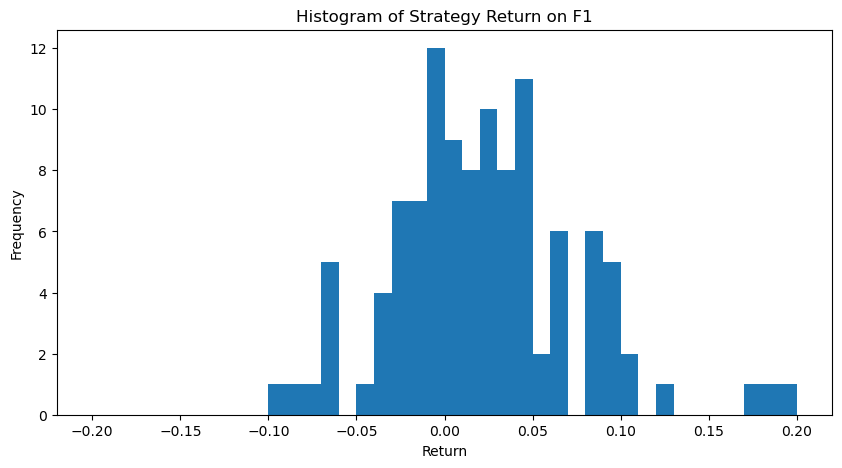

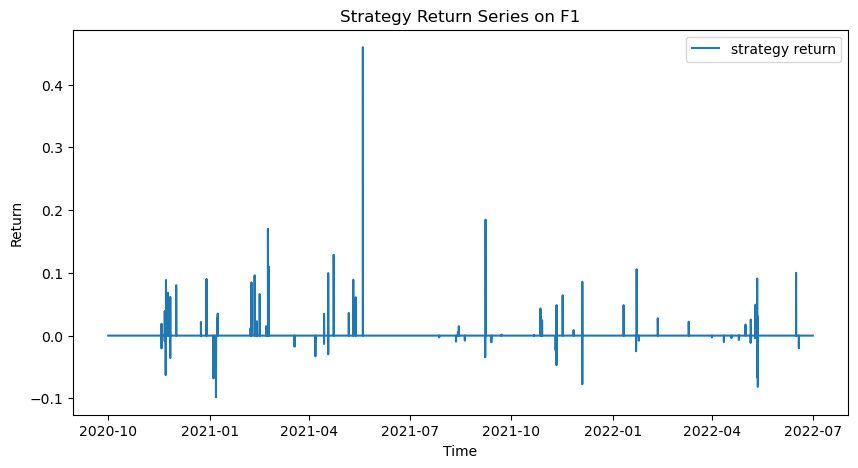

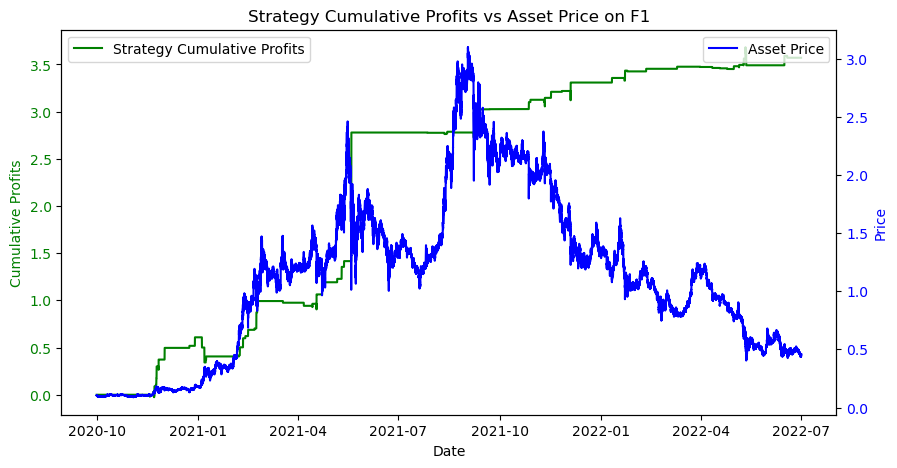

Win Prob: 65.49%
Number of Trades:  113 113
Average Win Return:   0.06303
Average Loss Return: -0.02804
P&L Ratio: 2.2
Maximum Loss of a single trade: -0.09818
Maximum Drawdown: -16.57%
Annual Return: 141.05%
Annual Volatility: 55.42%
Sharpe:  2.545


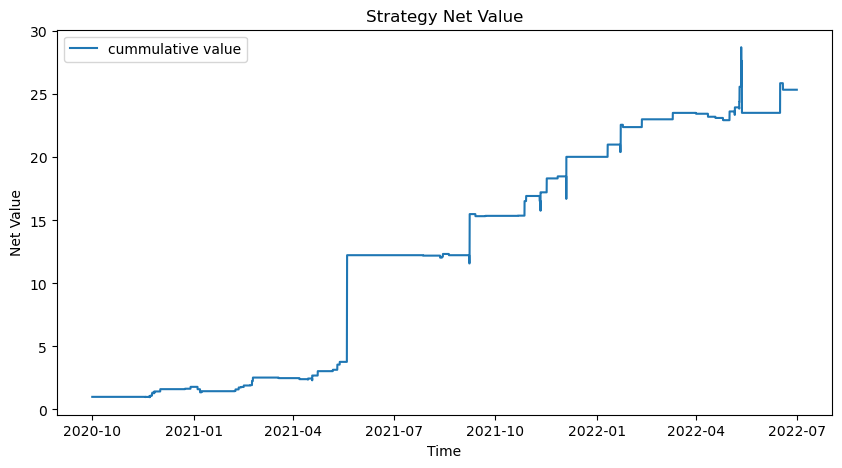

Annual Return: 534.53%
Annual Volatility: 55.42%
Sharpe:  9.646


Preprocess finished
8.1 Trading signal finished


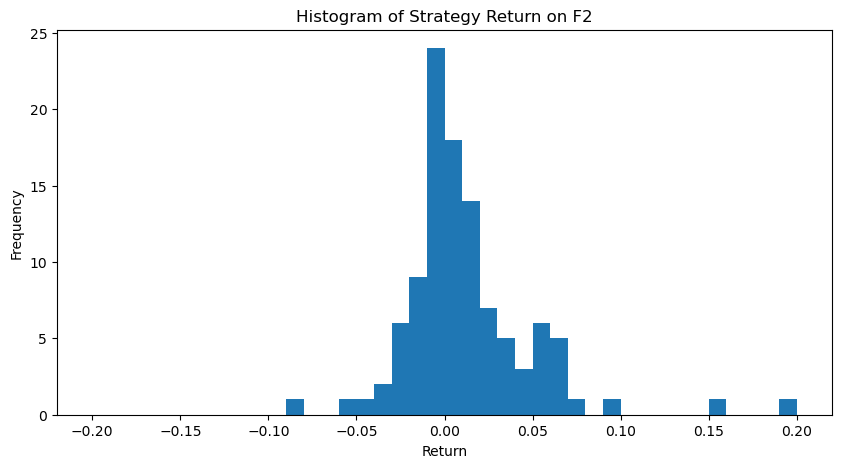

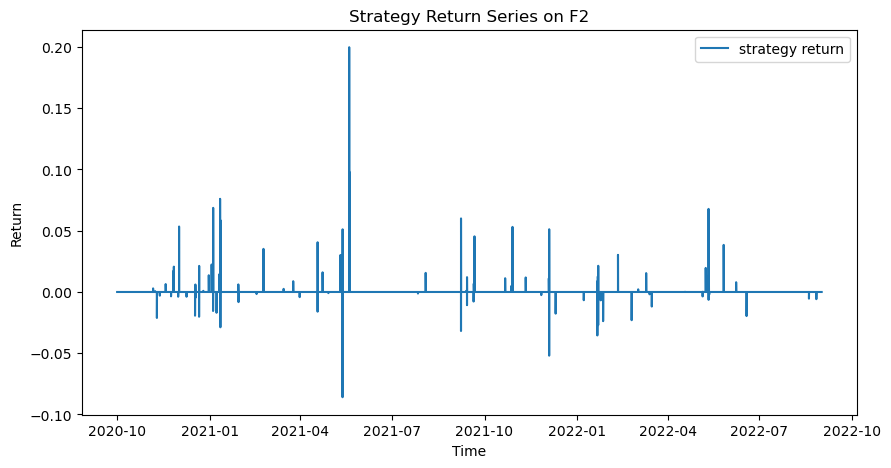

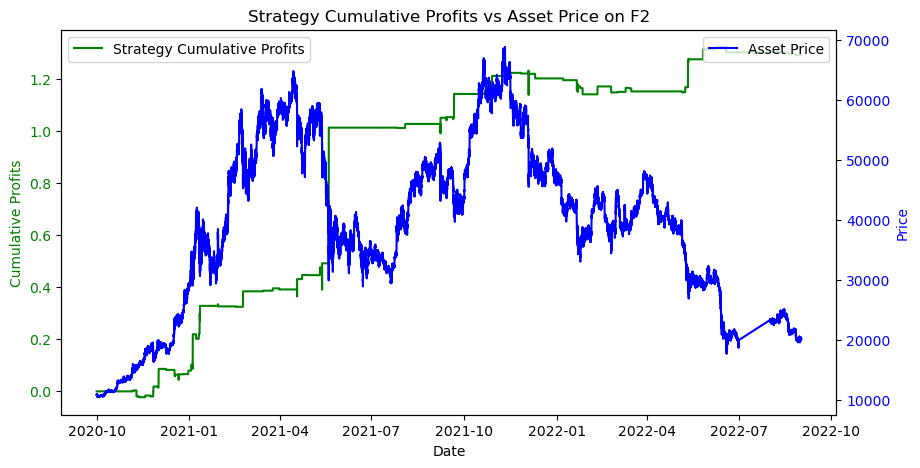

Win Prob: 58.49%
Number of Trades:  106 106
Average Win Return:   0.03089
Average Loss Return: -0.0142
P&L Ratio: 2.2
Maximum Loss of a single trade: -0.08591
Maximum Drawdown: -5.82%
Annual Return: 48.63%
Annual Volatility: 24.32%
Sharpe:  1.999


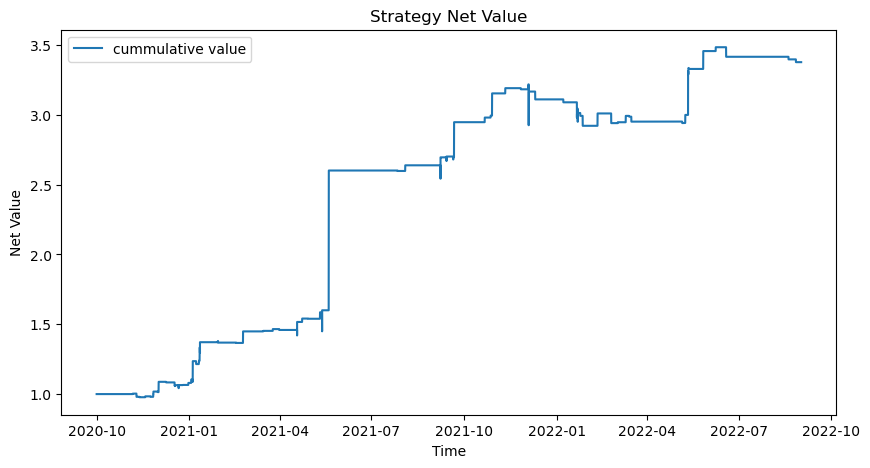

Annual Return: 100.42%
Annual Volatility: 24.32%
Sharpe:  4.129


Preprocess finished
8.1 Trading signal finished


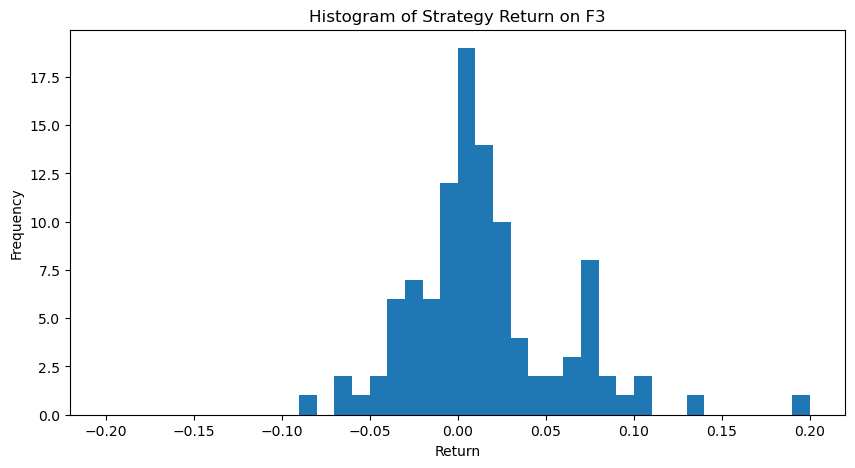

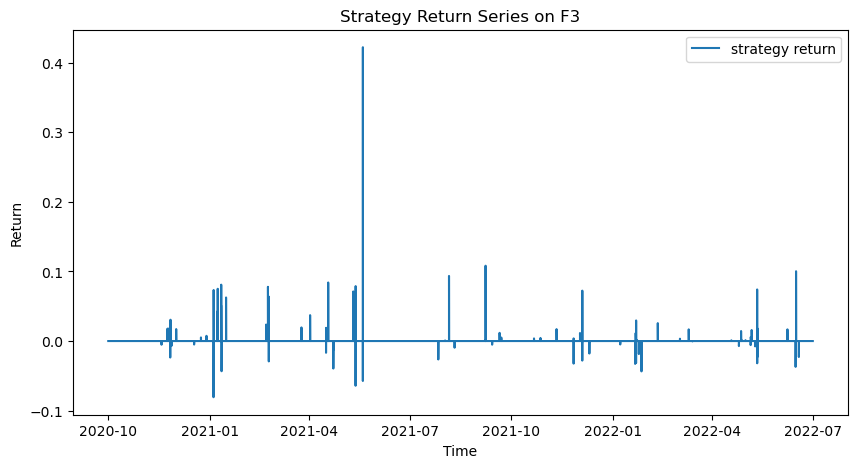

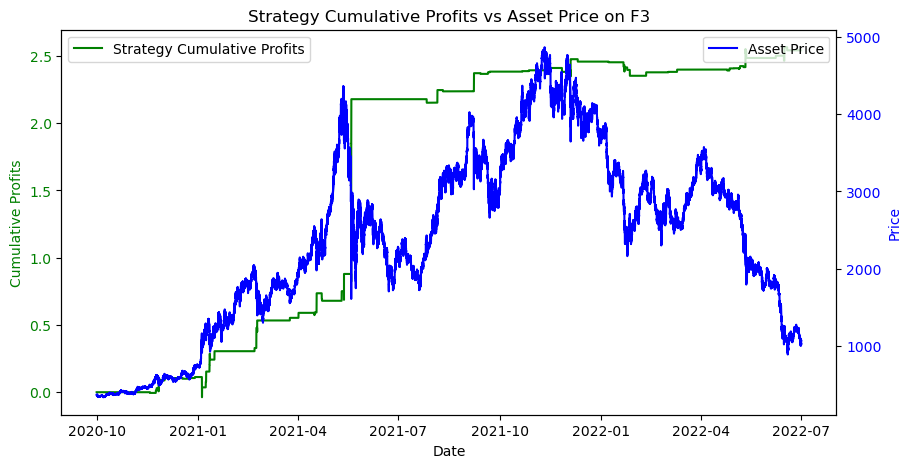

Win Prob: 66.06%
Number of Trades:  109 109
Average Win Return:   0.04793
Average Loss Return: -0.02455
P&L Ratio: 2.0
Maximum Loss of a single trade: -0.0807
Maximum Drawdown: -13.49%
Annual Return: 100.44%
Annual Volatility: 47.91%
Sharpe:  2.096


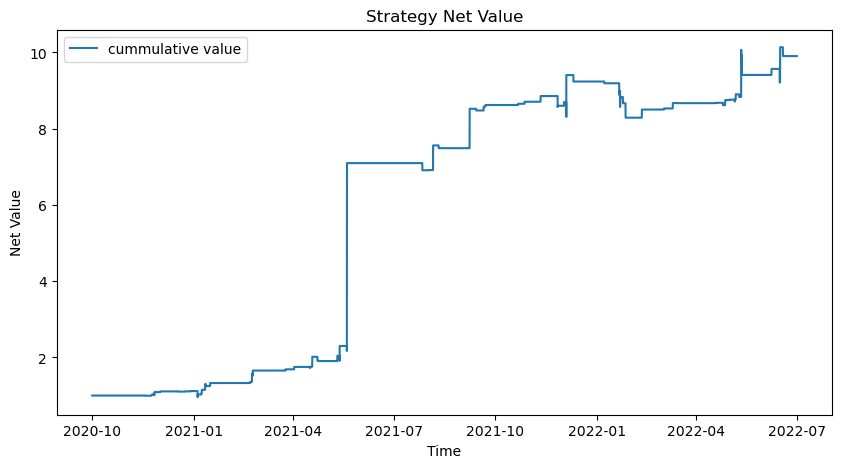

Annual Return: 270.69%
Annual Volatility: 47.90%
Sharpe:  5.651


Preprocess finished
8.1 Trading signal finished


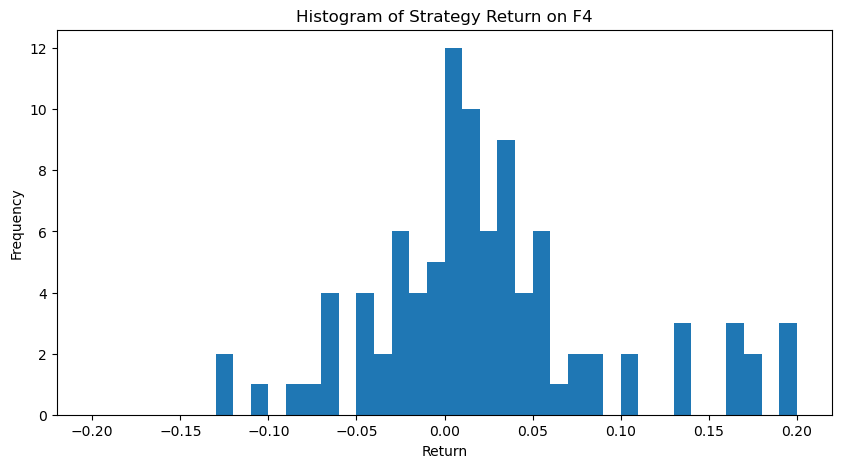

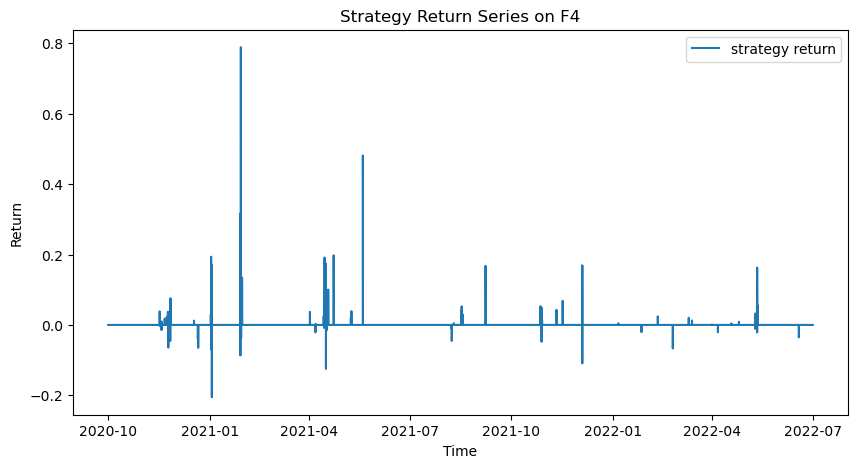

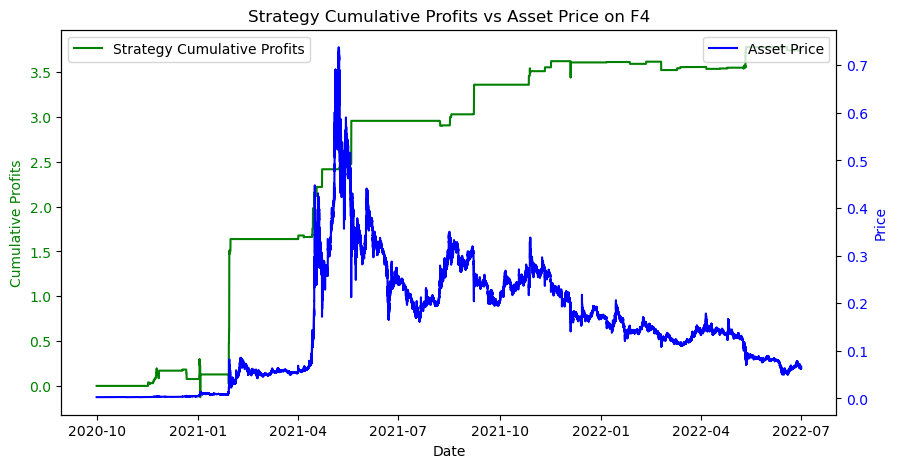

Win Prob: 68.69%
Number of Trades:  99 99
Average Win Return:   0.07672
Average Loss Return: -0.0475
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.2054
Maximum Drawdown: -32.81%
Annual Return: 147.91%
Annual Volatility: 76.83%
Sharpe:  1.925


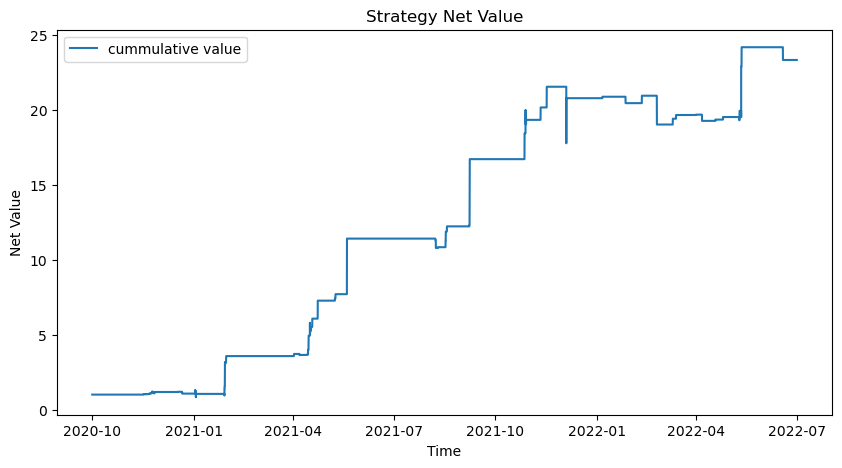

Annual Return: 504.53%
Annual Volatility: 76.82%
Sharpe:  6.568


Preprocess finished
8.1 Trading signal finished


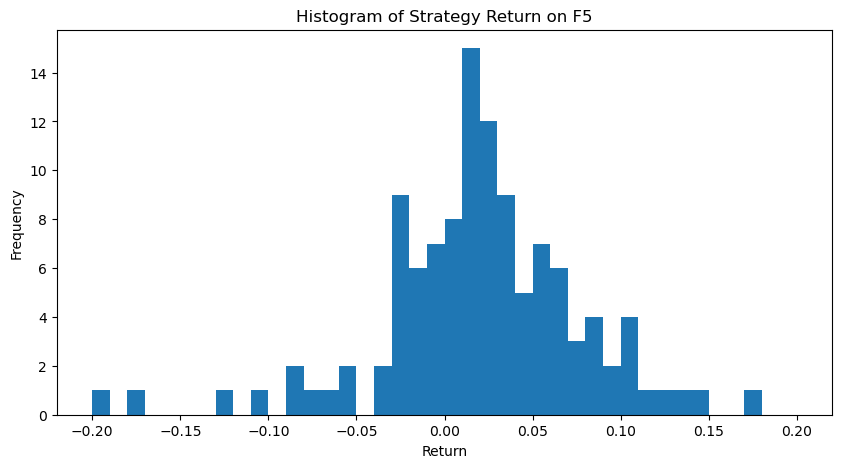

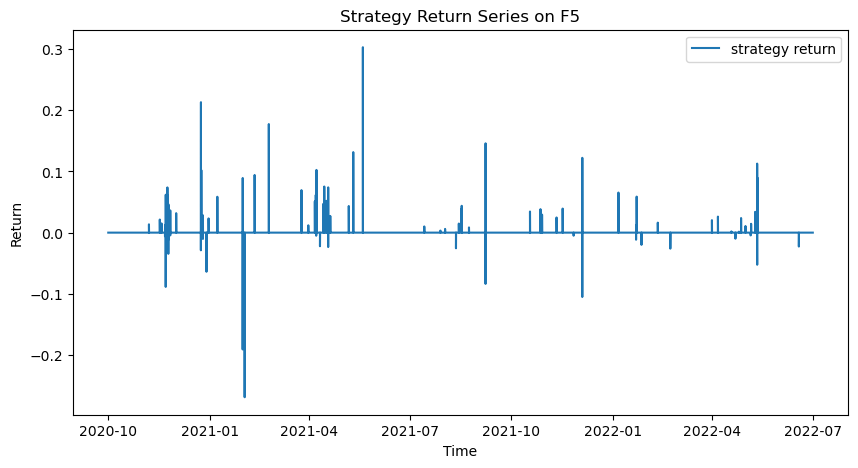

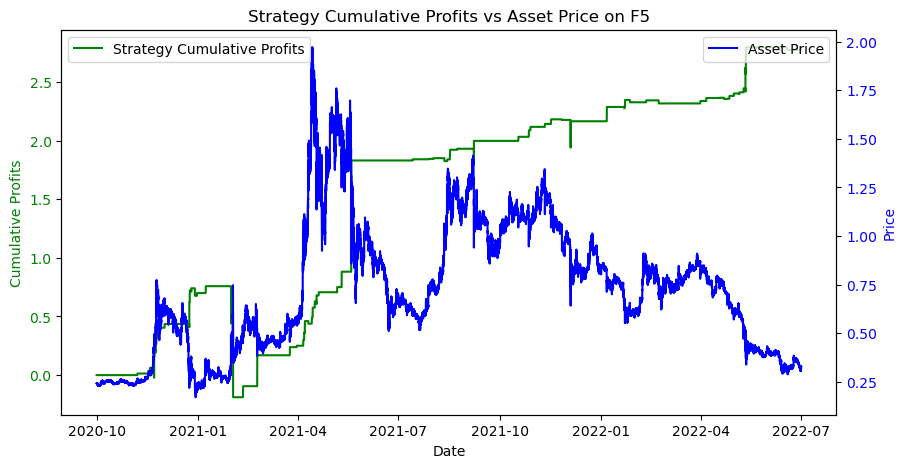

Win Prob: 70.00%
Number of Trades:  120 120
Average Win Return:   0.05626
Average Loss Return: -0.05424
P&L Ratio: 1.0
Maximum Loss of a single trade: -0.2688
Maximum Drawdown: -53.85%
Annual Return: 109.54%
Annual Volatility: 56.52%
Sharpe:  1.938


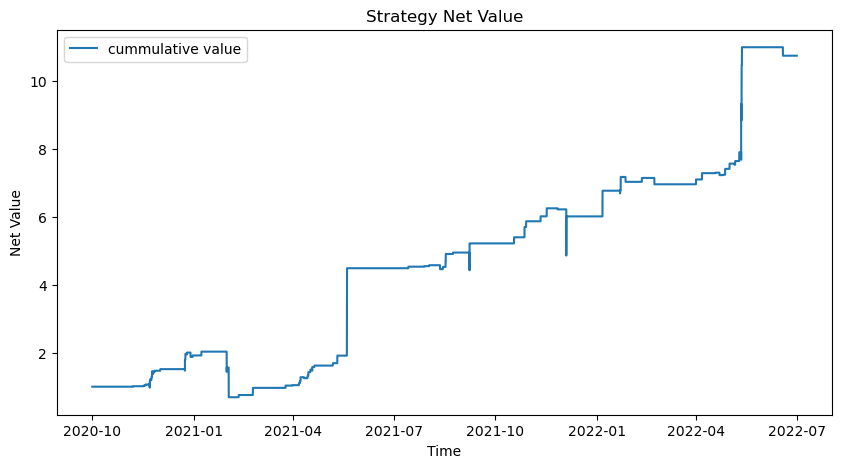

Annual Return: 288.37%
Annual Volatility: 56.51%
Sharpe:  5.103


Preprocess finished
8.1 Trading signal finished


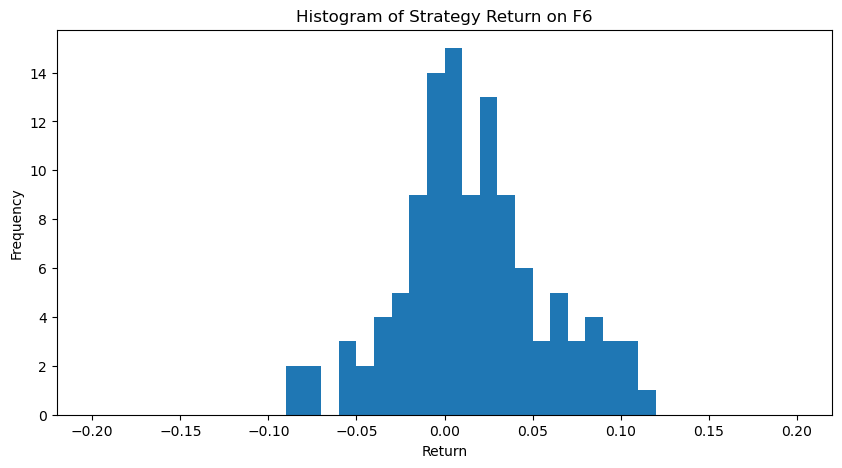

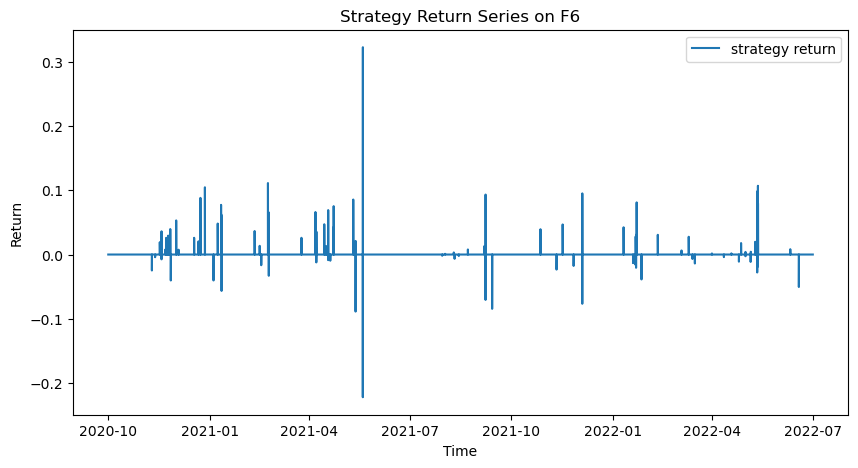

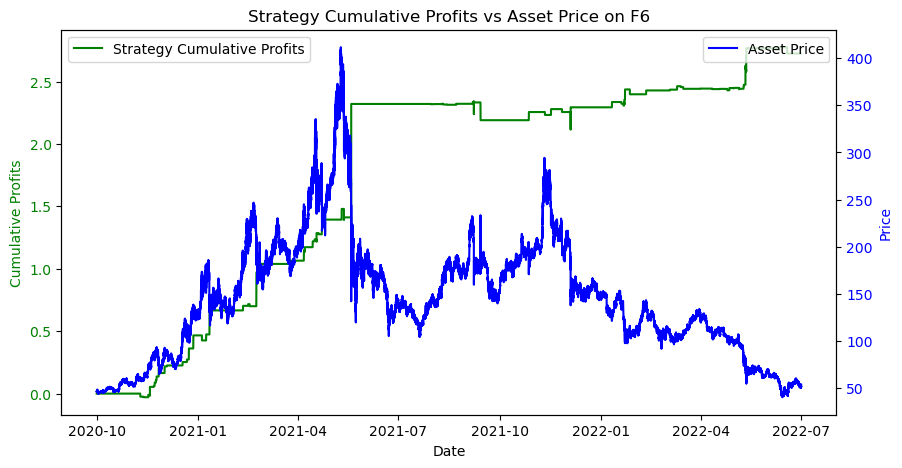

Win Prob: 65.00%
Number of Trades:  120 120
Average Win Return:   0.05103
Average Loss Return: -0.02991
P&L Ratio: 1.7
Maximum Loss of a single trade: -0.2222
Maximum Drawdown: -11.70%
Annual Return: 107.62%
Annual Volatility: 47.62%
Sharpe:  2.26


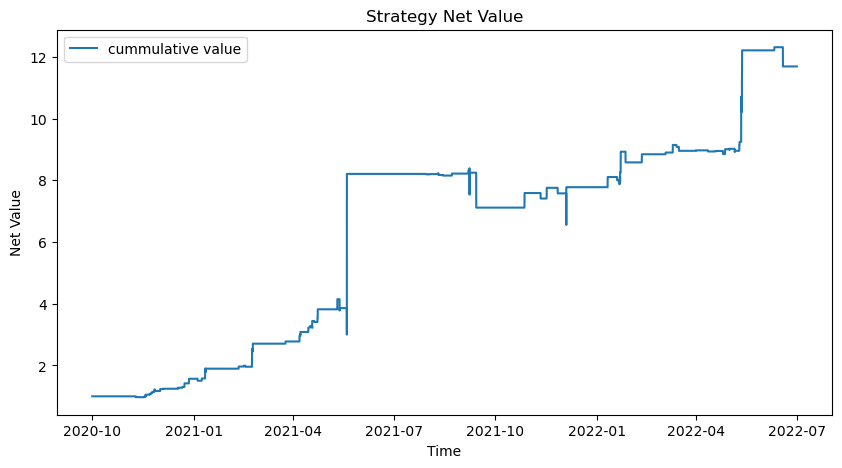

Annual Return: 307.50%
Annual Volatility: 47.61%
Sharpe:  6.458


Preprocess finished
8.1 Trading signal finished


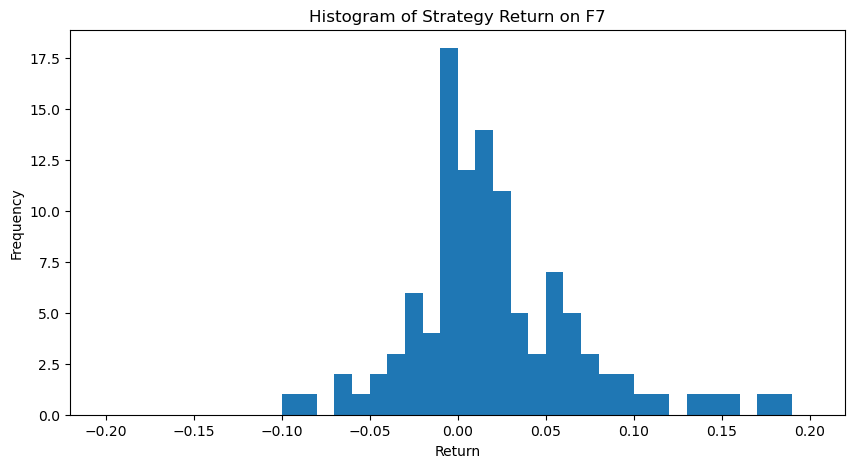

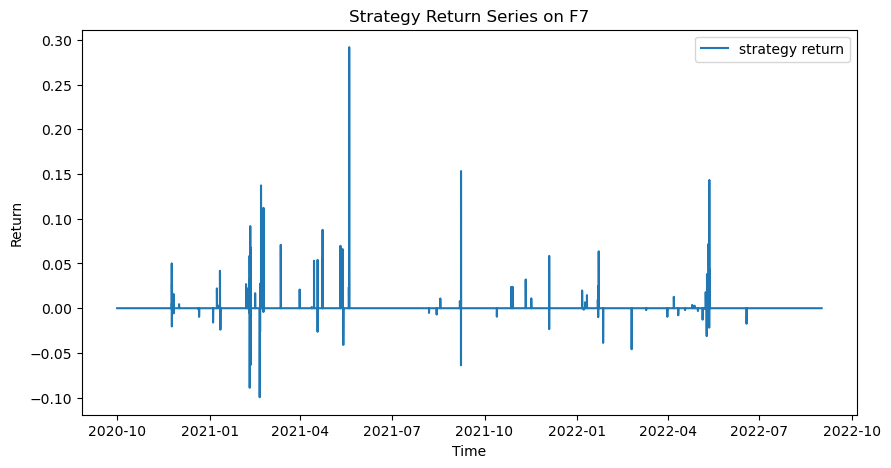

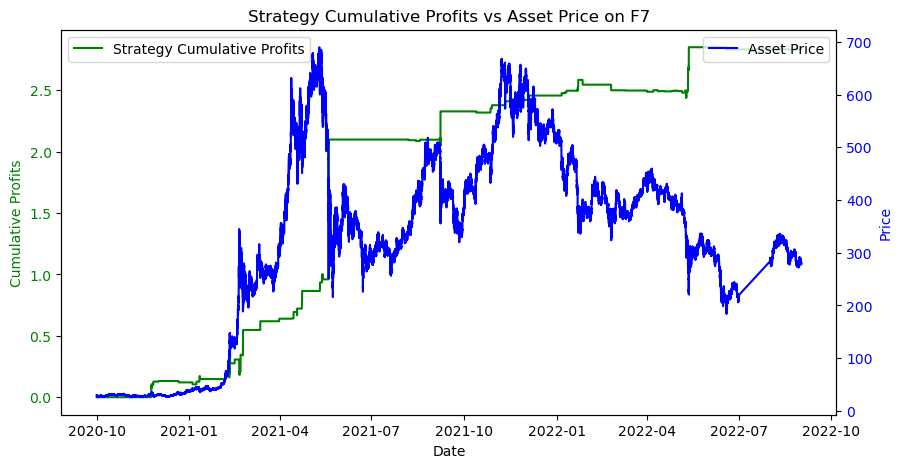

Win Prob: 65.77%
Number of Trades:  111 111
Average Win Return:   0.05018
Average Loss Return: -0.02184
P&L Ratio: 2.3
Maximum Loss of a single trade: -0.0995
Maximum Drawdown: -15.13%
Annual Return: 106.74%
Annual Volatility: 41.17%
Sharpe:  2.593


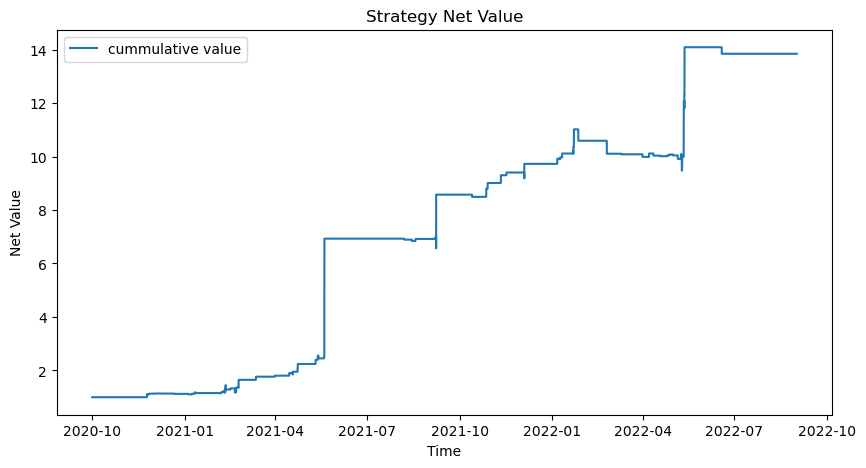

Annual Return: 348.85%
Annual Volatility: 41.17%
Sharpe:  8.474


Preprocess finished
8.1 Trading signal finished


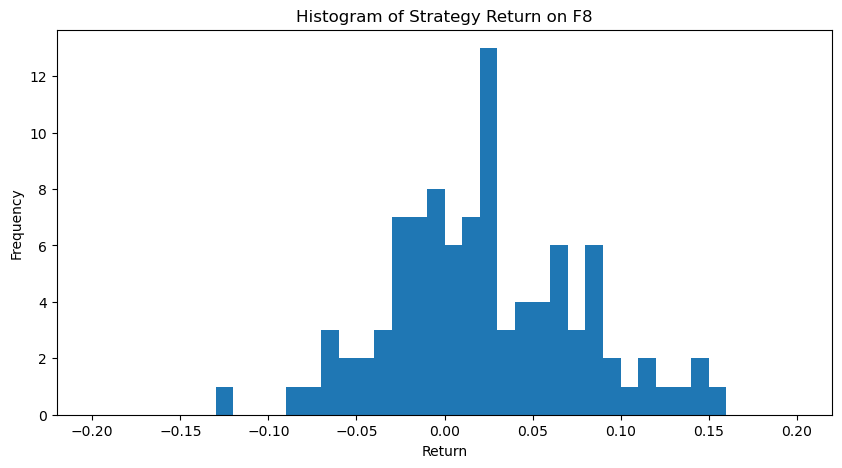

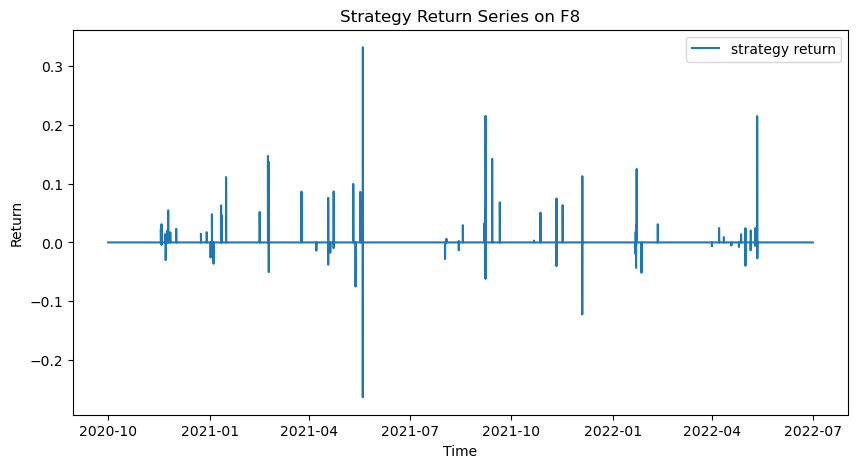

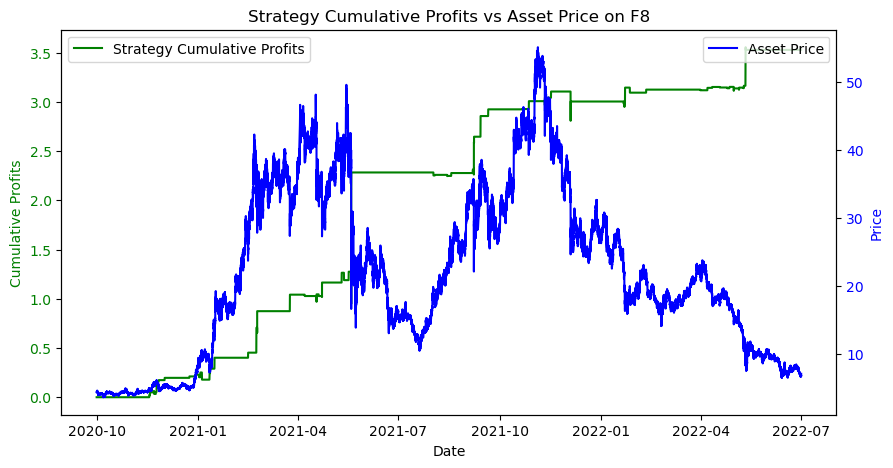

Win Prob: 65.38%
Number of Trades:  104 104
Average Win Return:   0.07196
Average Loss Return: -0.03789
P&L Ratio: 1.9
Maximum Loss of a single trade: -0.2632
Maximum Drawdown: -14.42%
Annual Return: 139.42%
Annual Volatility: 57.62%
Sharpe:  2.42


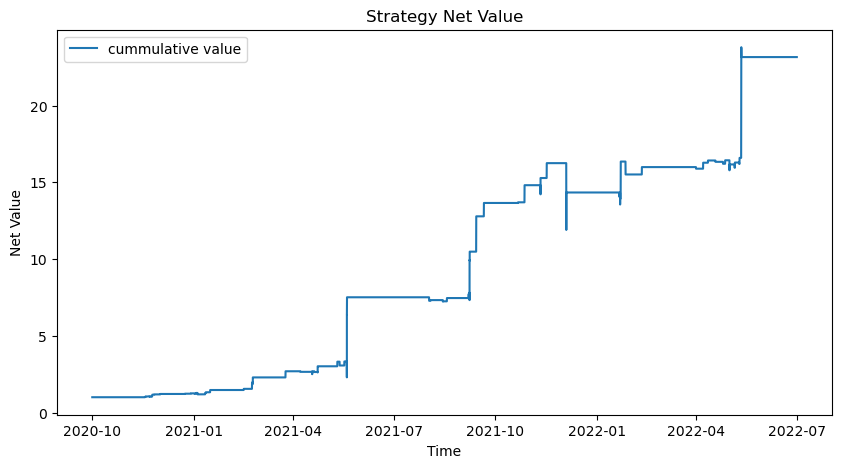

Annual Return: 502.39%
Annual Volatility: 57.61%
Sharpe:  8.72


Preprocess finished
8.1 Trading signal finished


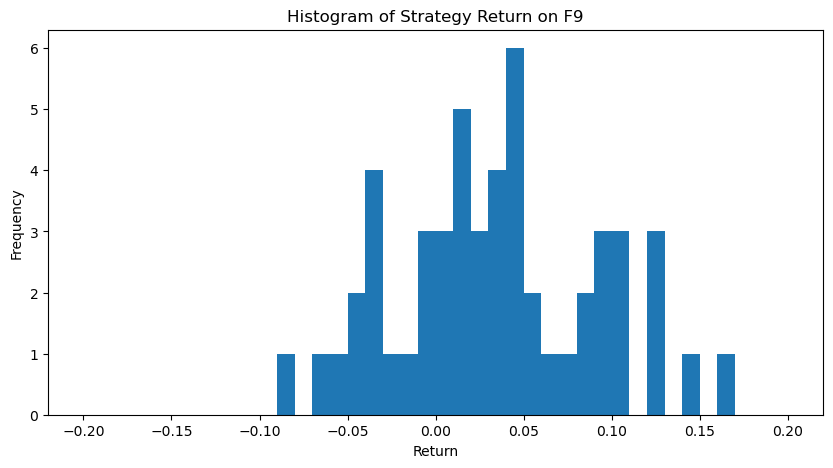

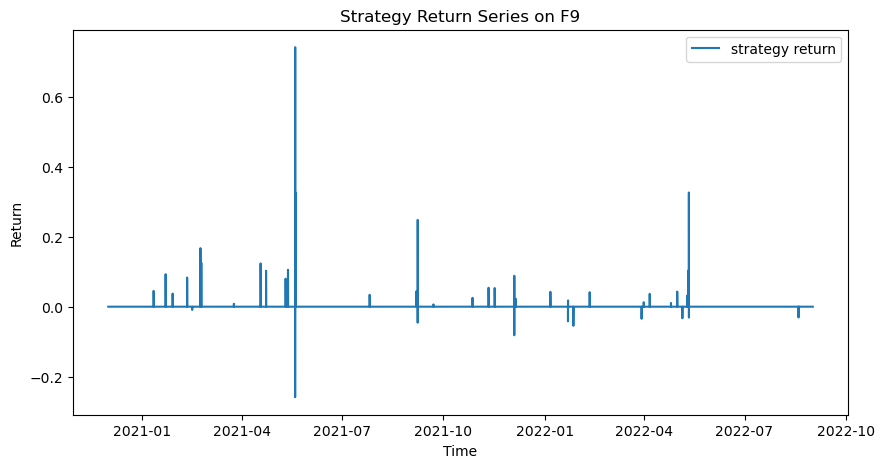

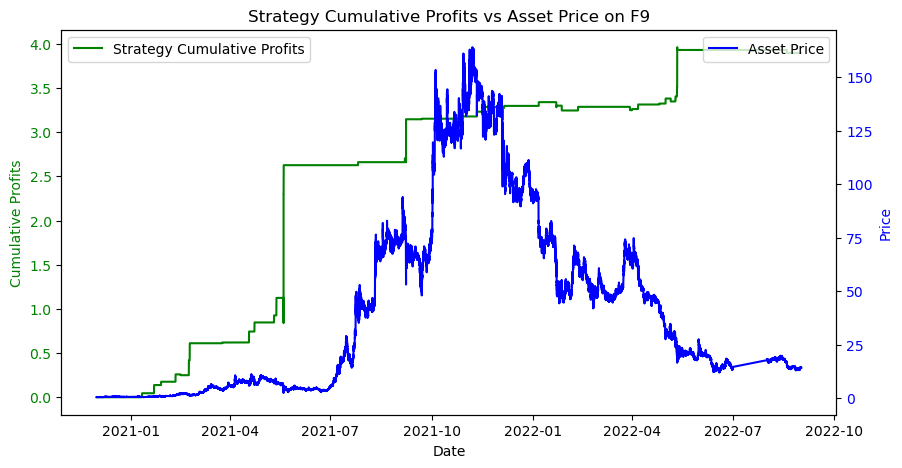

Win Prob: 74.58%
Number of Trades:  59 59
Average Win Return:   0.1052
Average Loss Return: -0.04894
P&L Ratio: 2.2
Maximum Loss of a single trade: -0.2586
Maximum Drawdown: -13.42%
Annual Return: 161.52%
Annual Volatility: 75.59%
Sharpe:  2.137


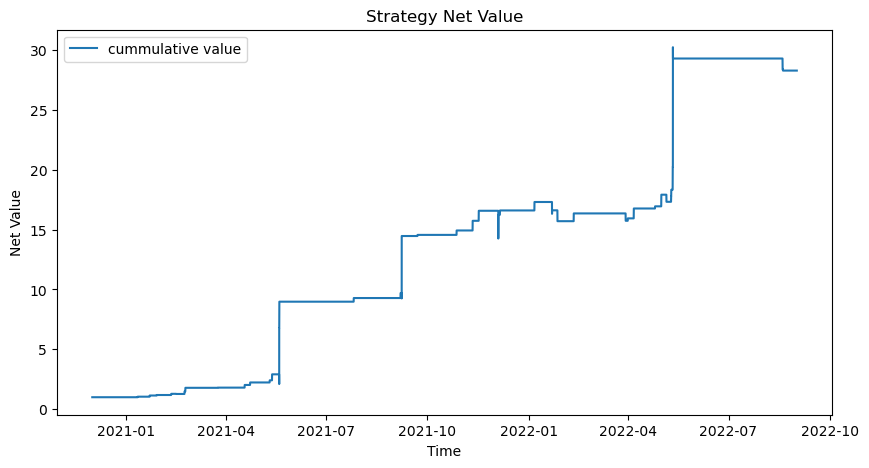

Annual Return: 575.14%
Annual Volatility: 75.58%
Sharpe:  7.609


Preprocess finished
8.1 Trading signal finished


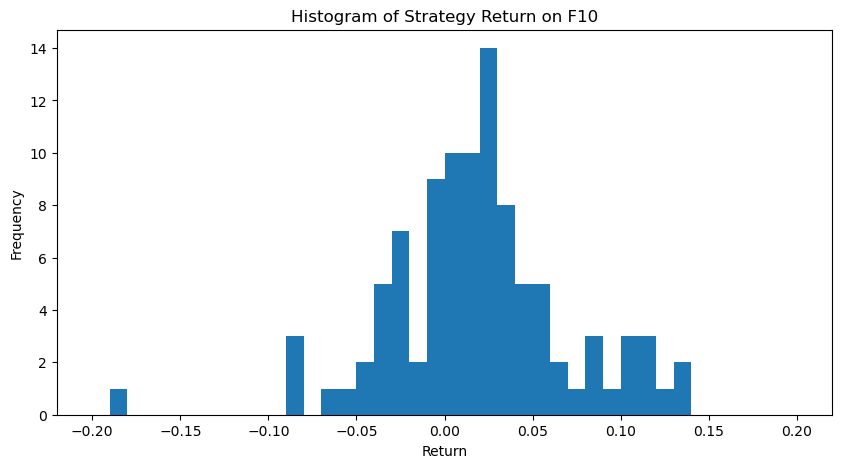

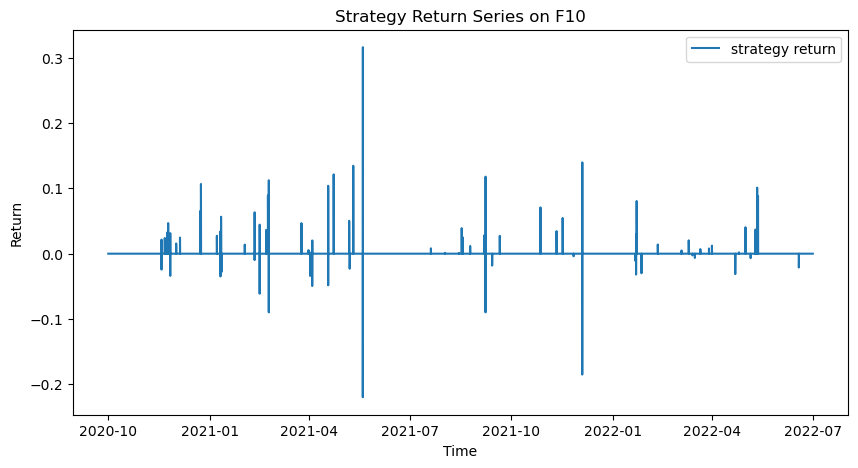

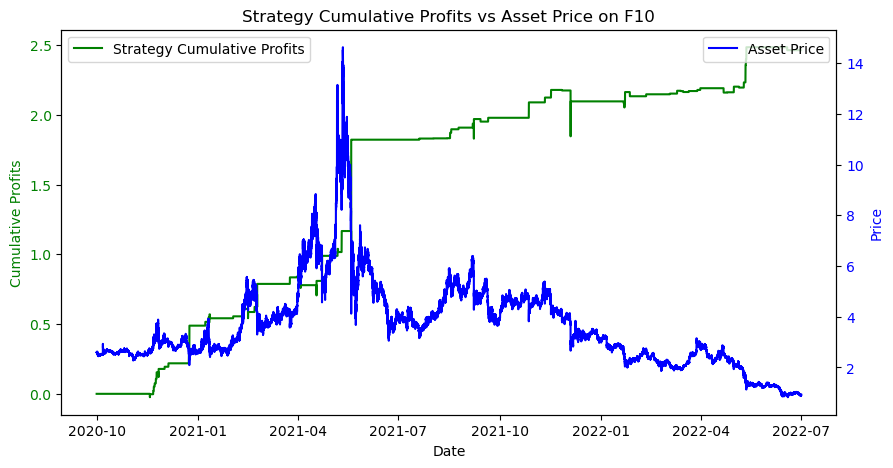

Win Prob: 68.93%
Number of Trades:  103 103
Average Win Return:   0.05303
Average Loss Return: -0.04066
P&L Ratio: 1.3
Maximum Loss of a single trade: -0.2198
Maximum Drawdown: -10.46%
Annual Return: 97.32%
Annual Volatility: 48.34%
Sharpe:  2.013


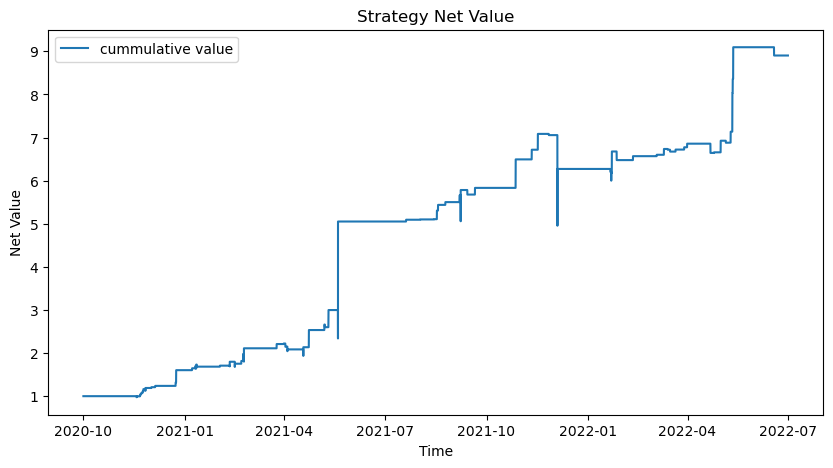

Annual Return: 248.81%
Annual Volatility: 48.33%
Sharpe:  5.148


Preprocess finished
8.1 Trading signal finished


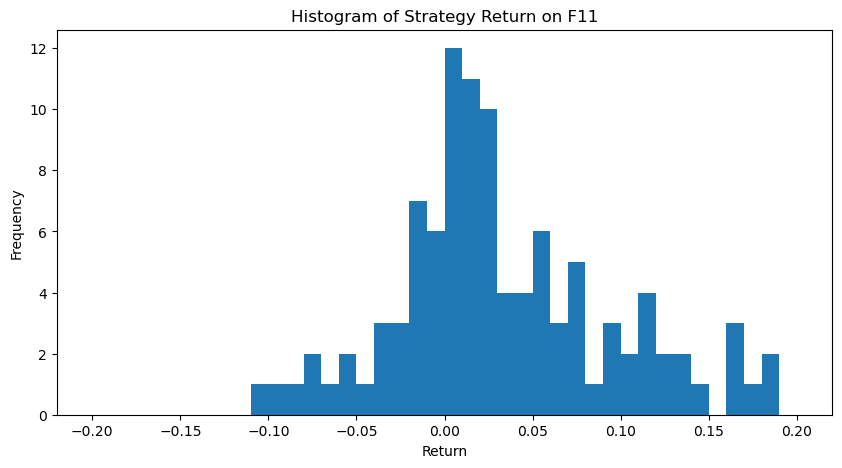

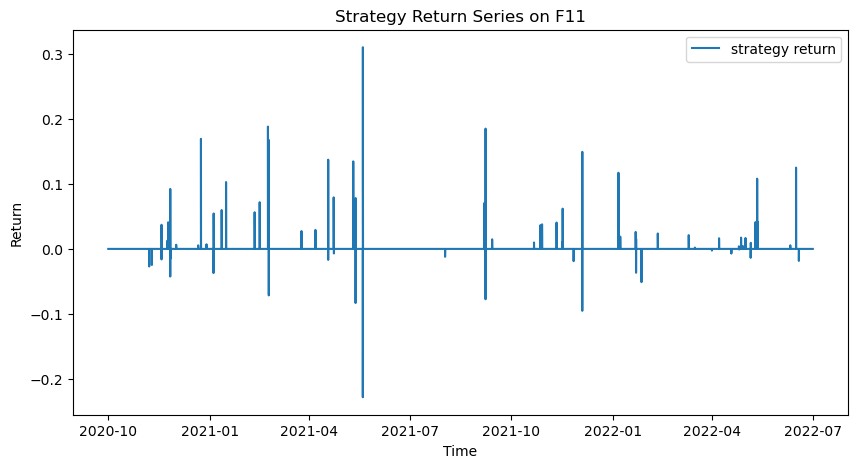

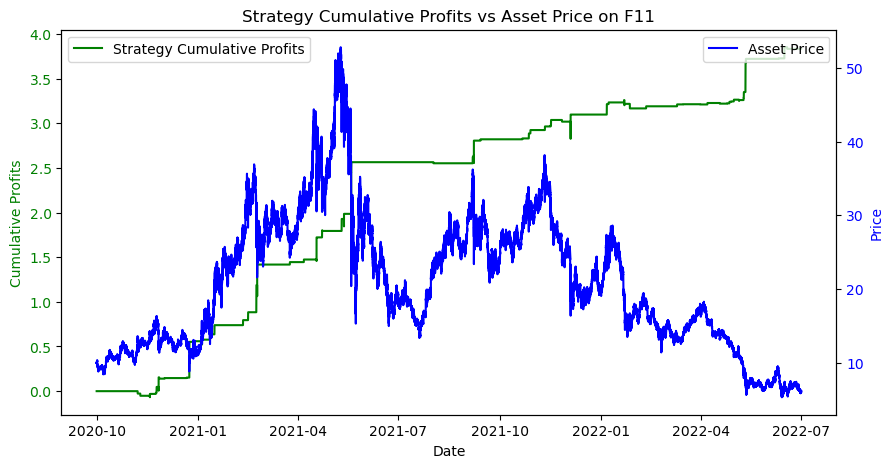

Win Prob: 72.90%
Number of Trades:  107 107
Average Win Return:   0.06436
Average Loss Return: -0.04098
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.2277
Maximum Drawdown: -11.08%
Annual Return: 151.37%
Annual Volatility: 53.81%
Sharpe:  2.813


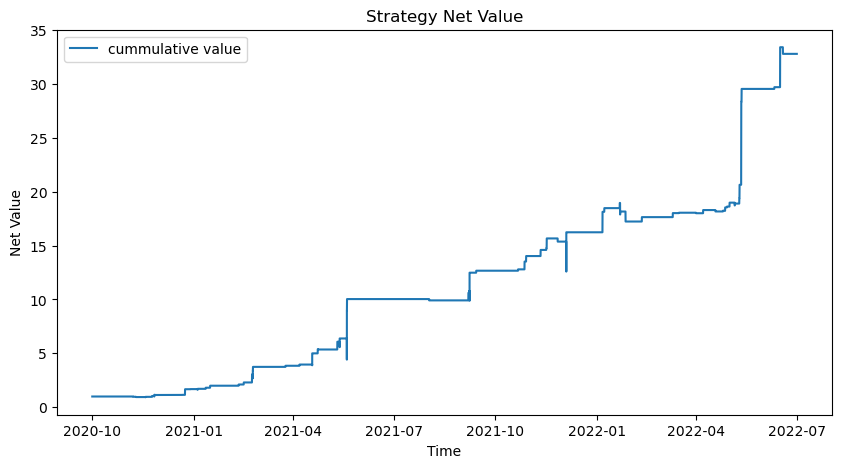

Annual Return: 634.67%
Annual Volatility: 53.81%
Sharpe:  11.79


Preprocess finished
8.1 Trading signal finished


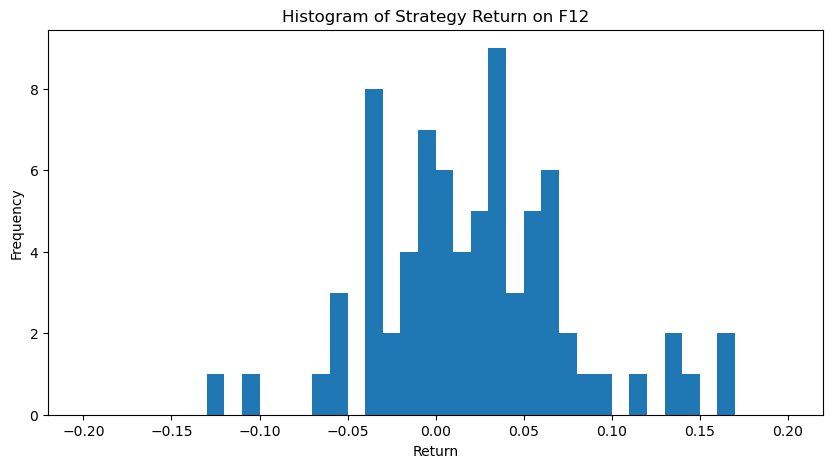

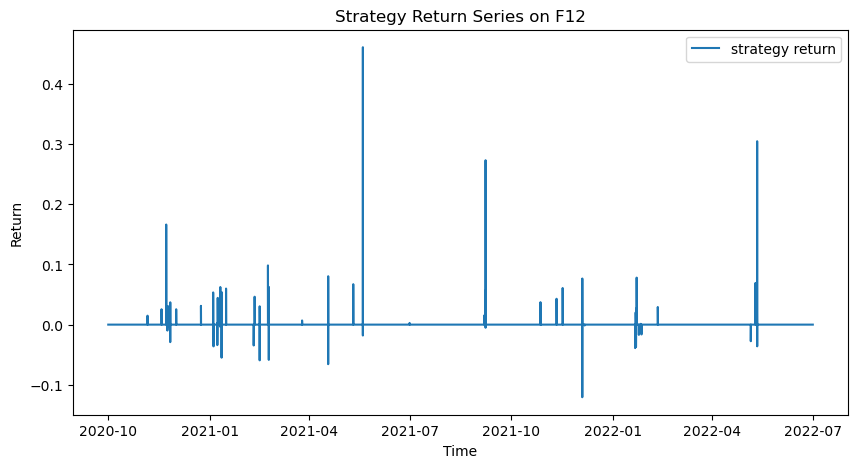

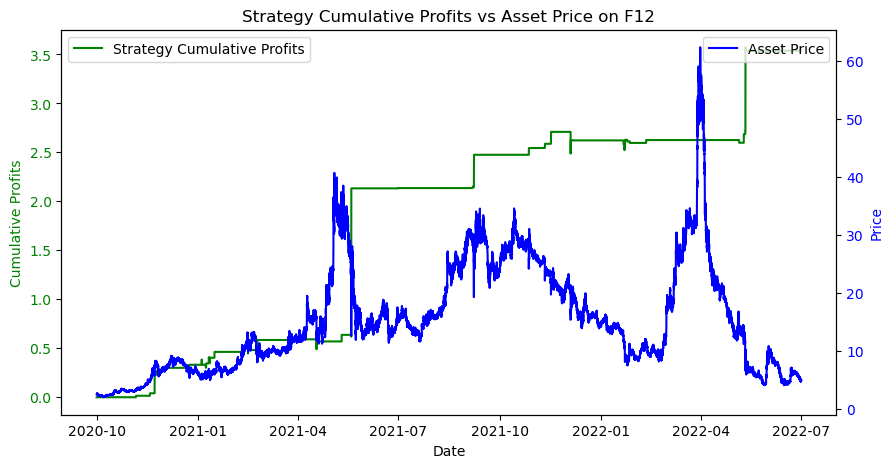

Win Prob: 66.67%
Number of Trades:  81 81
Average Win Return:   0.08227
Average Loss Return: -0.03353
P&L Ratio: 2.5
Maximum Loss of a single trade: -0.1206
Maximum Drawdown: -6.41%
Annual Return: 139.75%
Annual Volatility: 60.64%
Sharpe:  2.305


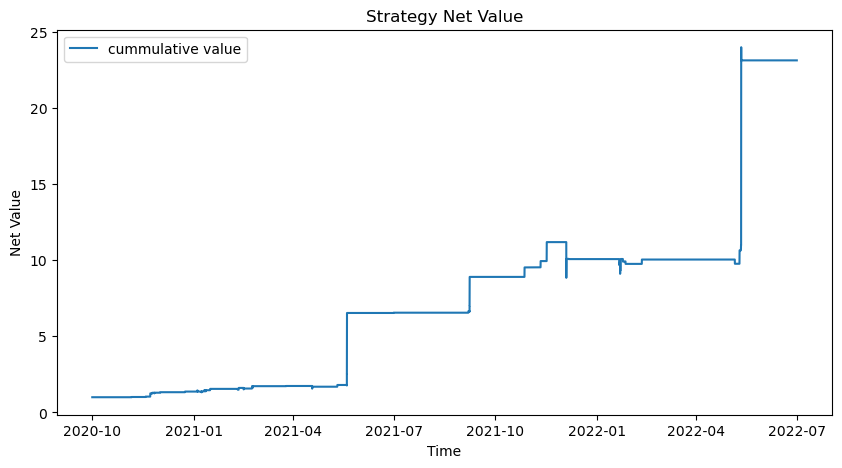

Annual Return: 501.63%
Annual Volatility: 60.63%
Sharpe:  8.273


Preprocess finished
8.1 Trading signal finished


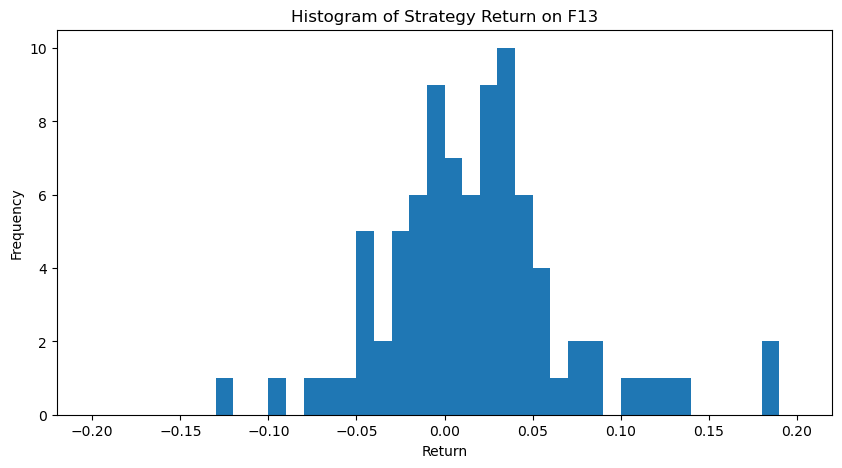

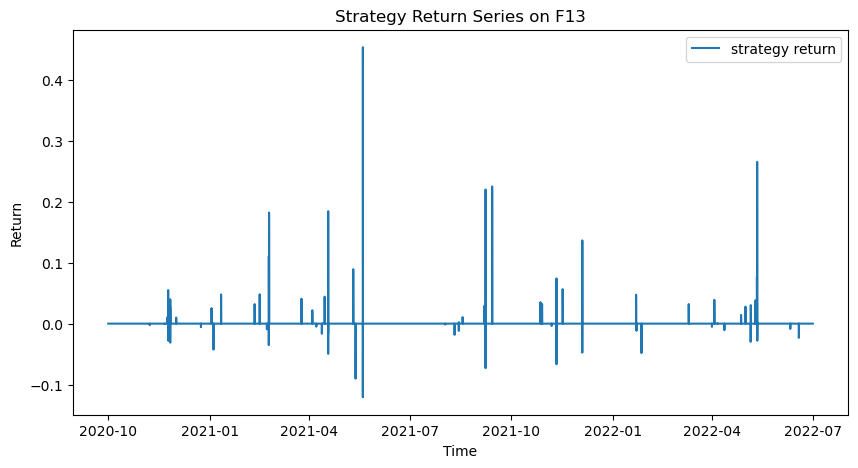

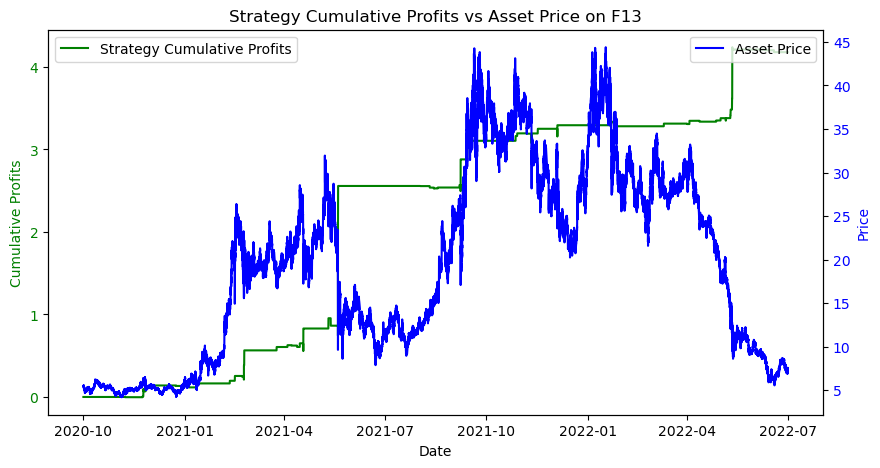

Win Prob: 65.96%
Number of Trades:  94 94
Average Win Return:   0.08302
Average Loss Return: -0.03024
P&L Ratio: 2.7
Maximum Loss of a single trade: -0.1209
Maximum Drawdown: -10.81%
Annual Return: 165.11%
Annual Volatility: 67.36%
Sharpe:  2.451


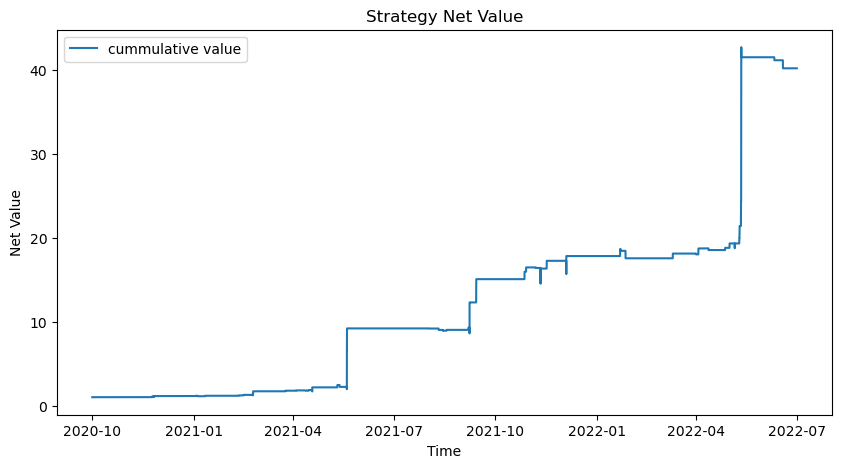

Annual Return: 725.17%
Annual Volatility: 67.35%
Sharpe:  10.77


Preprocess finished
8.1 Trading signal finished


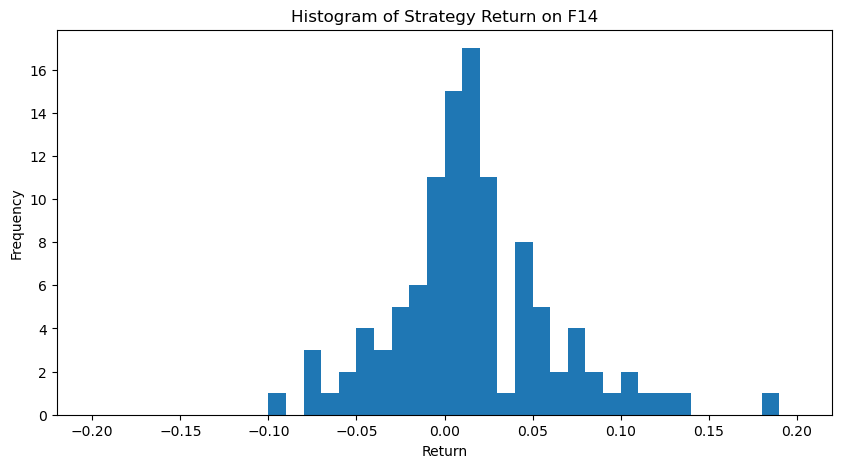

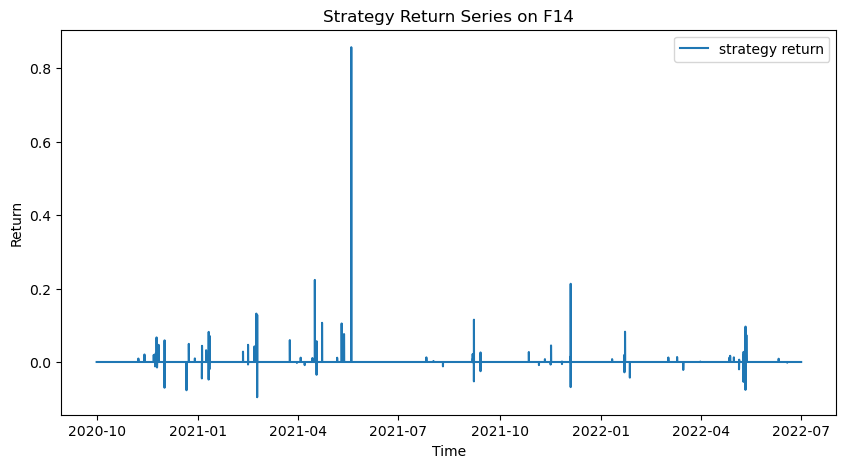

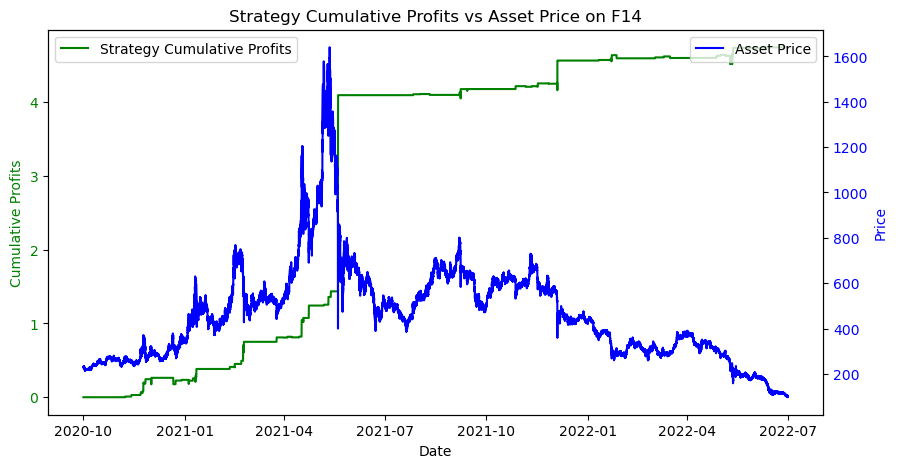

Win Prob: 68.70%
Number of Trades:  115 115
Average Win Return:   0.07335
Average Loss Return: -0.02926
P&L Ratio: 2.5
Maximum Loss of a single trade: -0.09598
Maximum Drawdown: -6.86%
Annual Return: 187.29%
Annual Volatility: 87.17%
Sharpe:  2.148


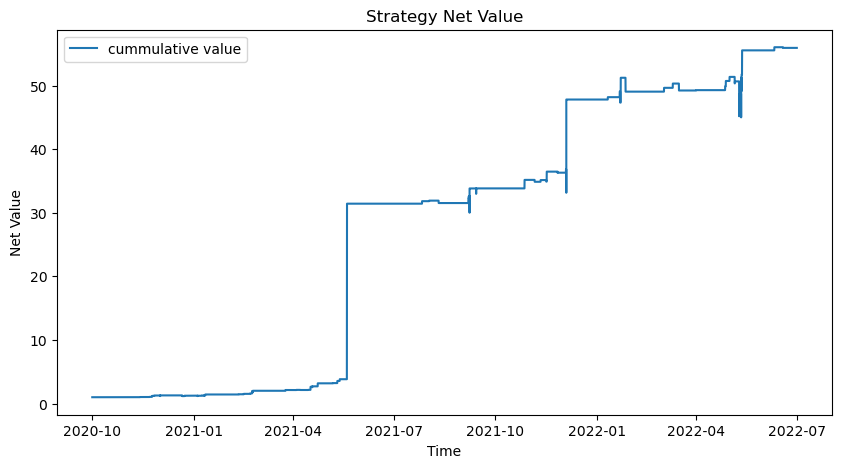

Annual Return: 896.81%
Annual Volatility: 87.17%
Sharpe:  10.29


Preprocess finished
8.1 Trading signal finished


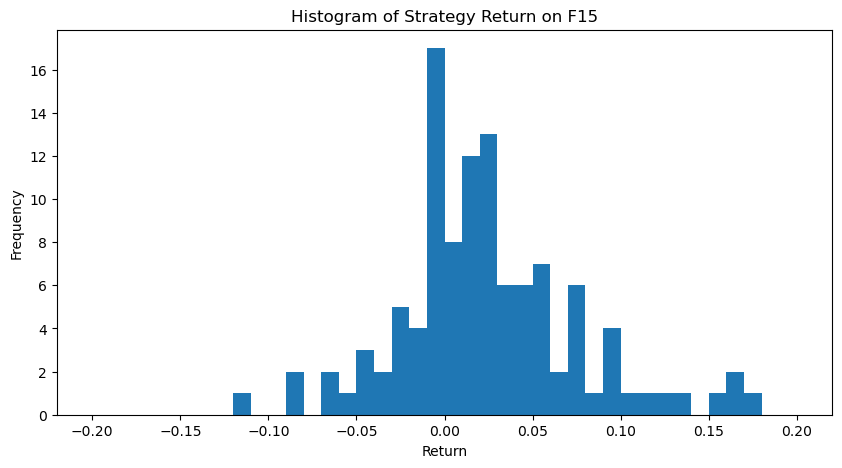

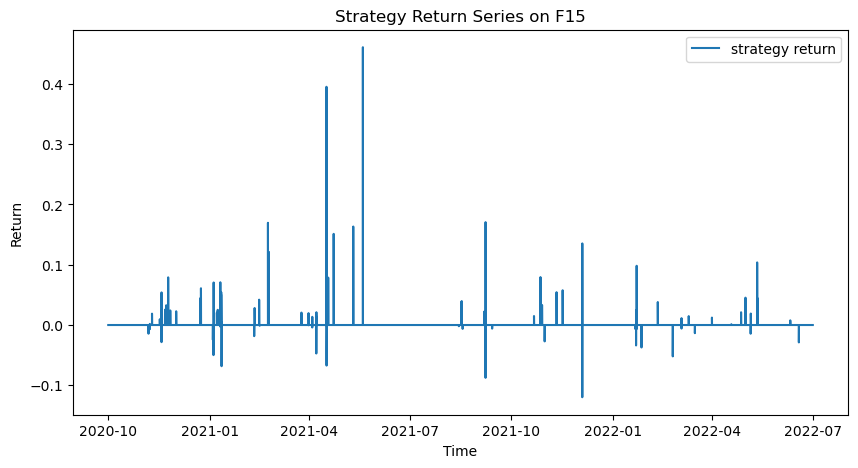

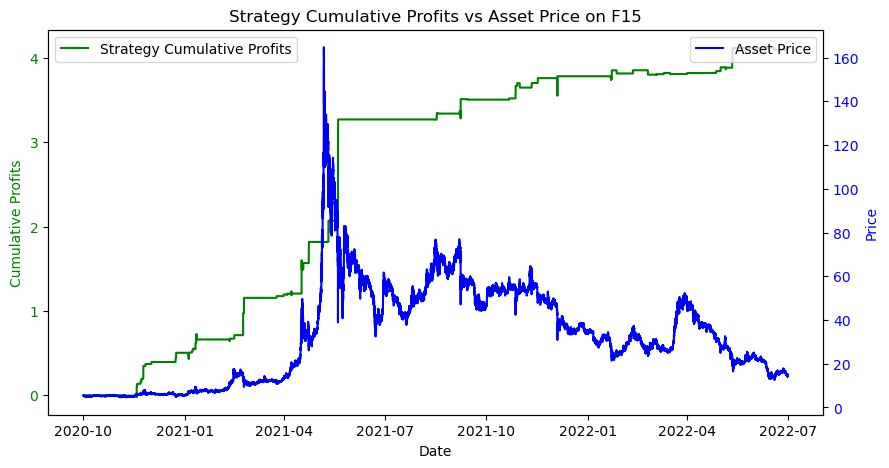

Win Prob: 67.54%
Number of Trades:  114 114
Average Win Return:   0.06576
Average Loss Return: -0.0261
P&L Ratio: 2.5
Maximum Loss of a single trade: -0.1198
Maximum Drawdown: -4.96%
Annual Return: 161.88%
Annual Volatility: 61.21%
Sharpe:  2.644


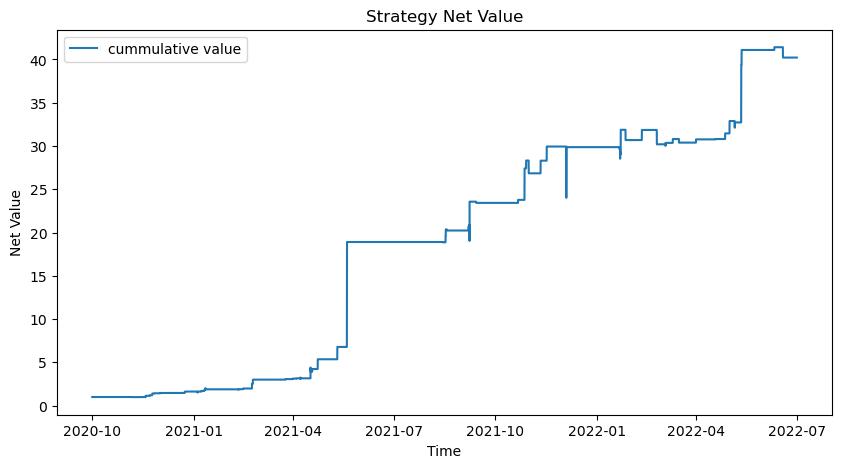

Annual Return: 725.67%
Annual Volatility: 61.21%
Sharpe:  11.86


Preprocess finished
8.1 Trading signal finished


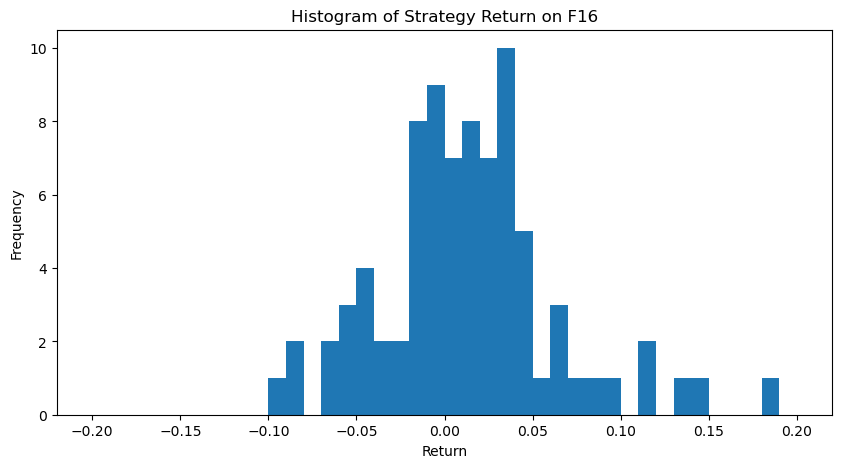

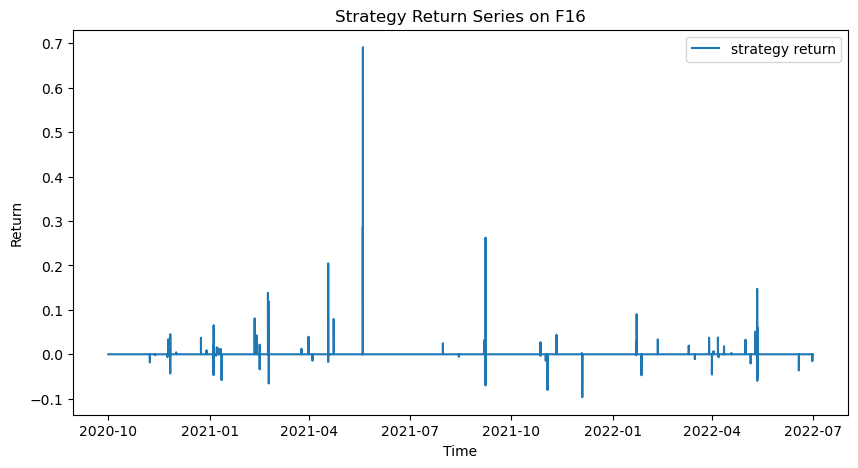

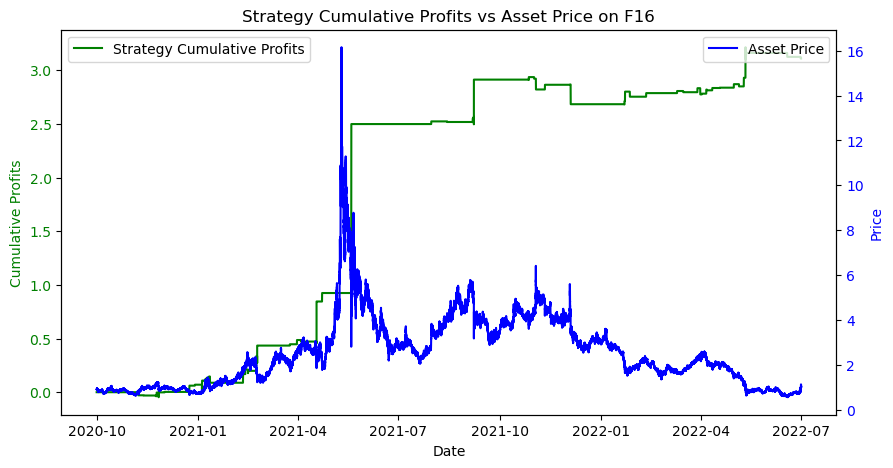

Win Prob: 62.07%
Number of Trades:  87 87
Average Win Return:   0.07632
Average Loss Return: -0.03065
P&L Ratio: 2.5
Maximum Loss of a single trade: -0.09661
Maximum Drawdown: -6.47%
Annual Return: 122.84%
Annual Volatility: 69.72%
Sharpe:  1.762


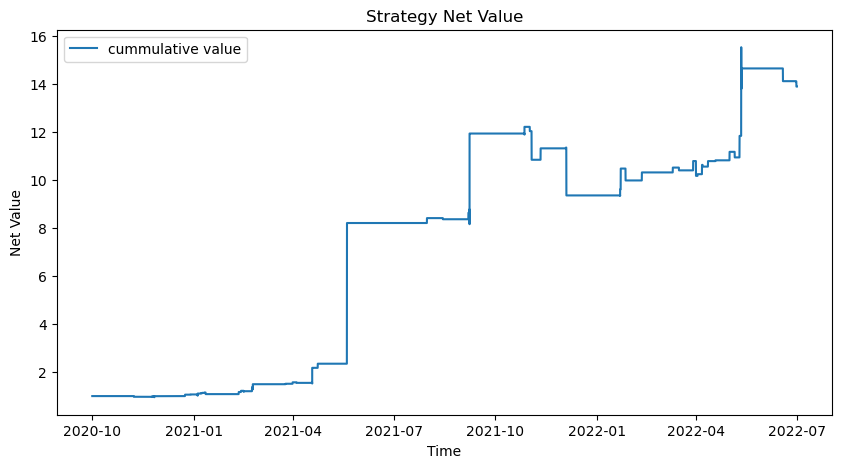

Annual Return: 349.86%
Annual Volatility: 69.72%
Sharpe:  5.018


Preprocess finished
8.1 Trading signal finished


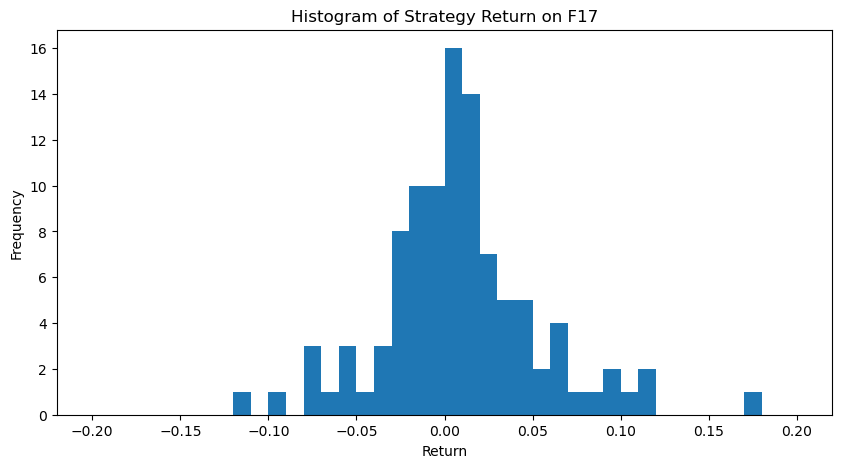

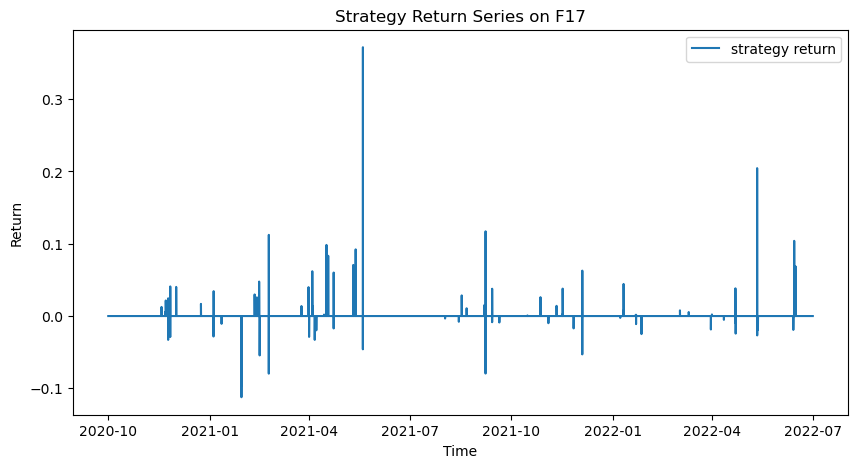

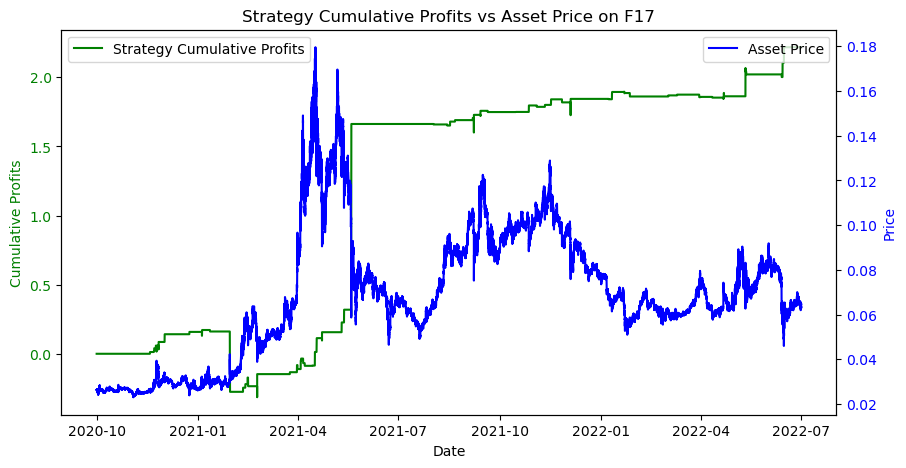

Win Prob: 61.68%
Number of Trades:  107 107
Average Win Return:   0.05272
Average Loss Return: -0.03078
P&L Ratio: 1.7
Maximum Loss of a single trade: -0.1123
Maximum Drawdown: -41.50%
Annual Return: 87.62%
Annual Volatility: 50.35%
Sharpe:  1.74


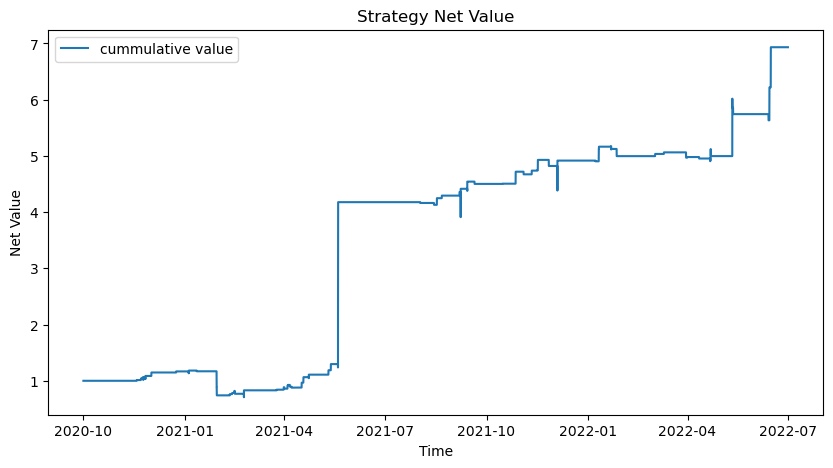

Annual Return: 202.35%
Annual Volatility: 50.35%
Sharpe:  4.019


Preprocess finished
8.1 Trading signal finished


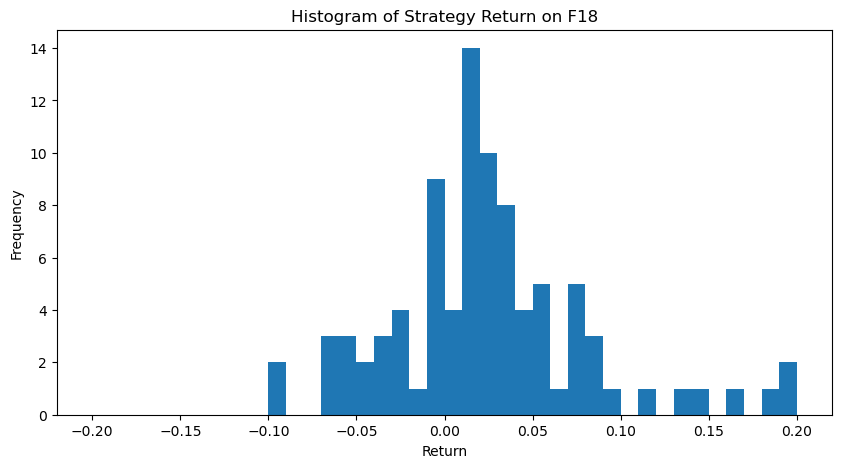

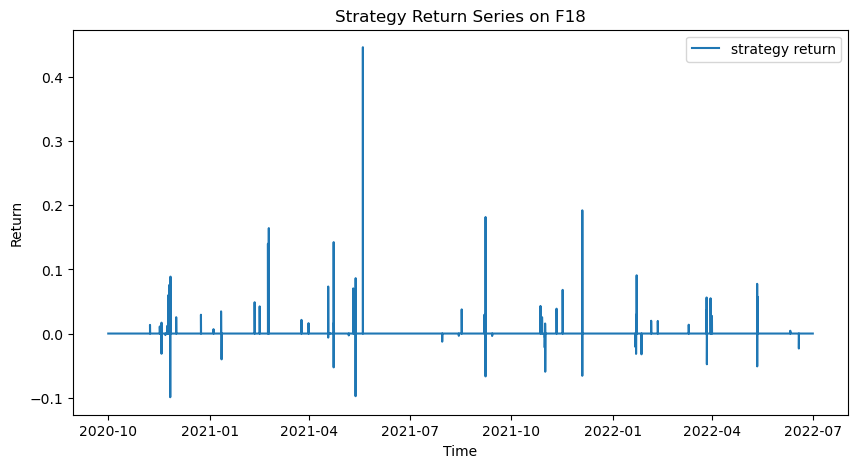

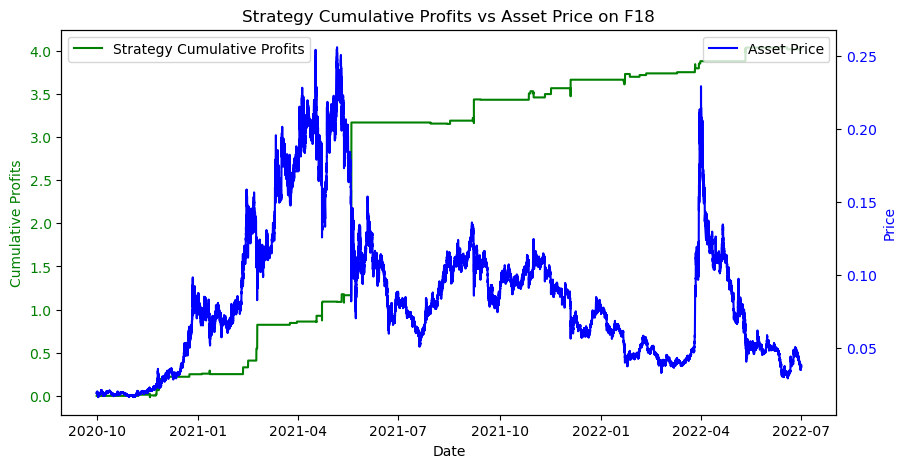

Win Prob: 71.28%
Number of Trades:  94 94
Average Win Return:   0.07314
Average Loss Return: -0.03271
P&L Ratio: 2.2
Maximum Loss of a single trade: -0.09929
Maximum Drawdown: -13.29%
Annual Return: 158.71%
Annual Volatility: 61.79%
Sharpe:  2.569


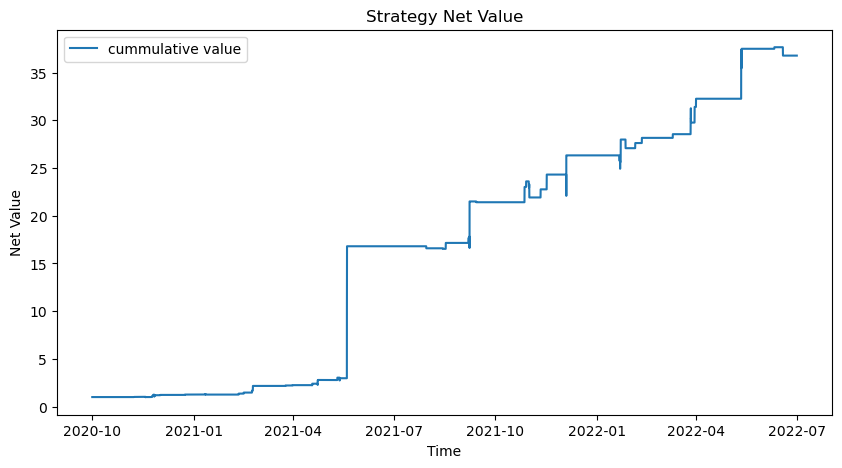

Annual Return: 684.52%
Annual Volatility: 61.78%
Sharpe:  11.08




In [433]:
# strategy 8.1 use avg_price as buy price
strategy8_1_list = []
for idx in range(len(data_list)):
    name = 'F'+str(idx+1)
    stra8_1 = CTAStrategy(data_list[idx],'open_time','signal','close',120,5,name)
    stra8_1.data_preprocess()
    stra8_1.find_signal_8_1(10000,0.1,1)
    stra8_1.get_strategy_returns(1/1000,'avg_price')
    stra8_1.plot_hist_seires()
    stra8_1.plot_cumsum_profits()
    stra8_1.get_win_prob()
    stra8_1.get_avg_win_return()
    stra8_1.get_maximum_drawdown()
    stra8_1.get_sharpe()
    stra8_1.plot_cumprod_value()
    strategy8_1_list.append(stra8_1)
    print('\n')

# Strategy 8.2

## Strategy 8.2 Basic Analysis

After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


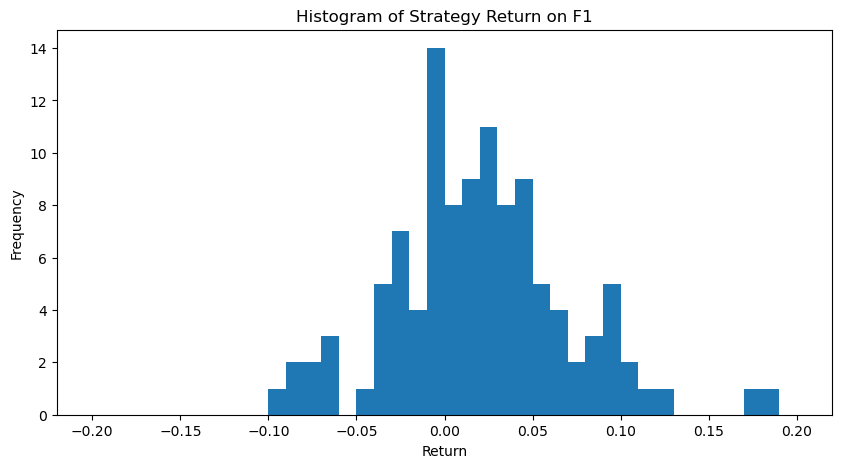

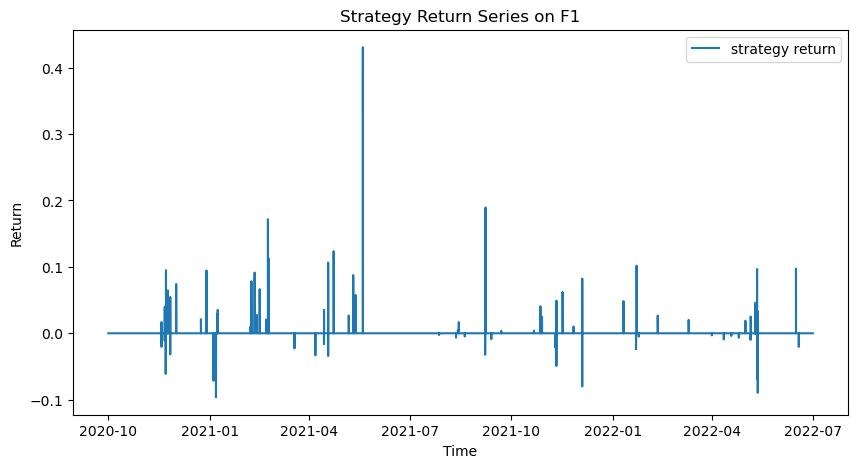

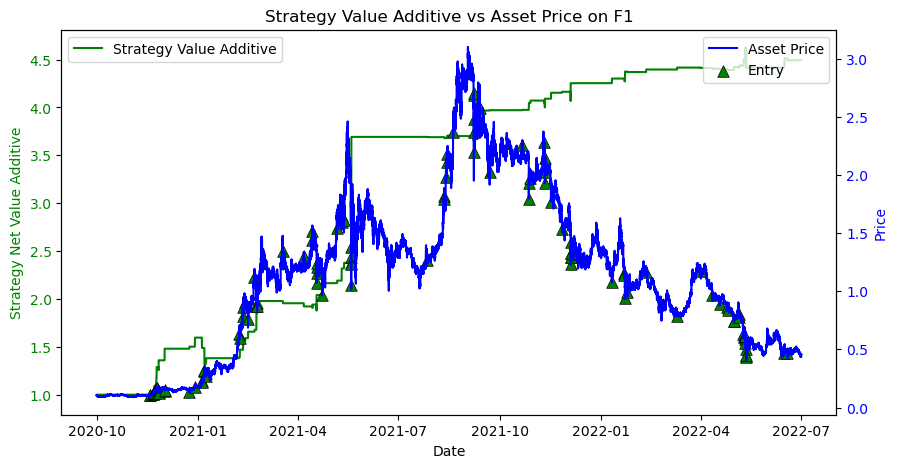

Win Prob: 65.49%
Number of Trades:  113 113
Average Win Return:   0.06233
Average Loss Return: -0.0287
P&L Ratio: 2.2
Maximum Loss of a single trade: -0.09629
Maximum Drawdown: -25.23%
Annualized Return: 137.97%
Annualized Volatility: 54.05%
Sharpe:  2.497


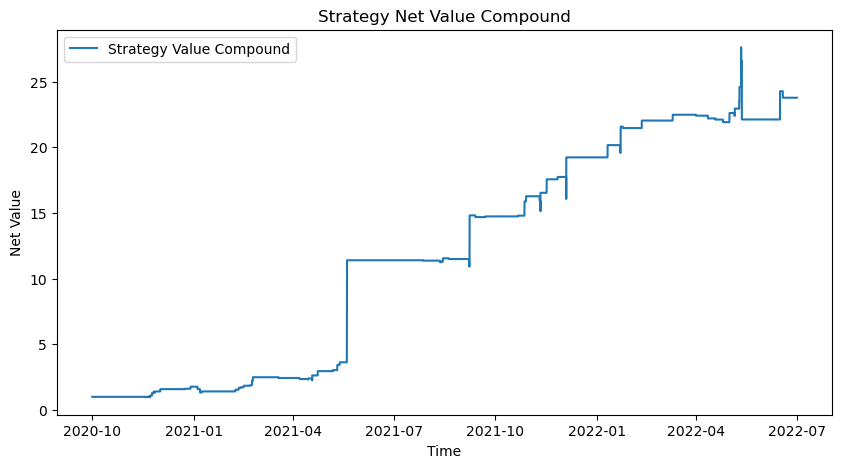

CAGR: 511.39%
Annual Return: 137.97%
Annual Volatility: 54.05%
Sharpe:  2.497


After preprocess the data has 192671 columns.
Preprocess finished
8.2 Trading signal finished


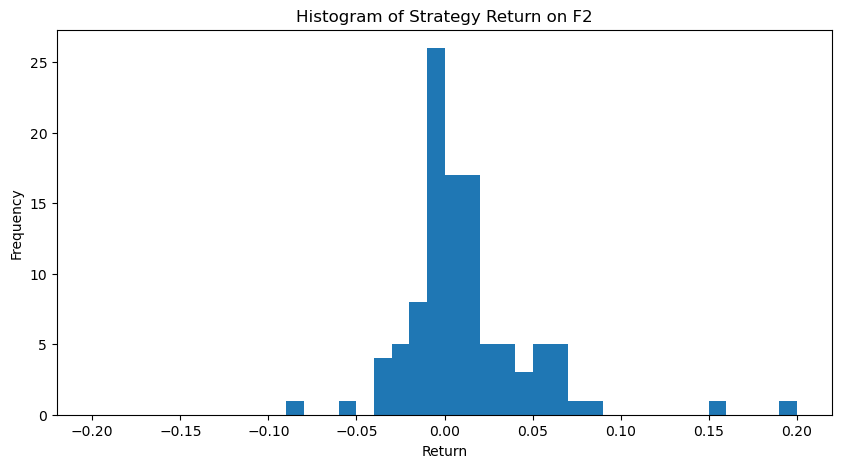

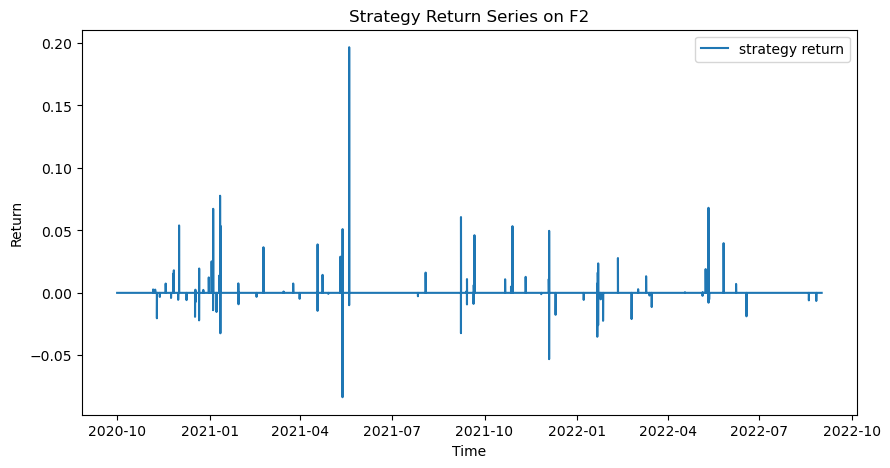

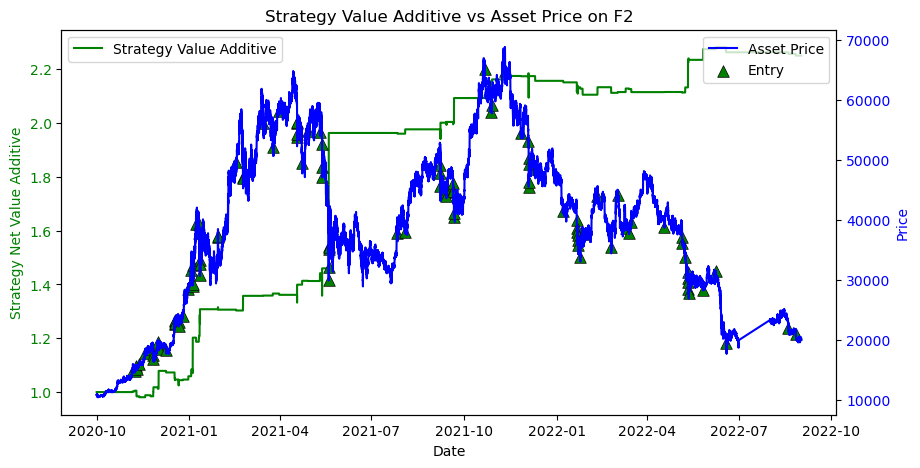

Win Prob: 57.55%
Number of Trades:  106 106
Average Win Return:   0.03097
Average Loss Return: -0.0142
P&L Ratio: 2.2
Maximum Loss of a single trade: -0.08355
Maximum Drawdown: -8.87%
Annualized Return: 47.09%
Annualized Volatility: 24.08%
Sharpe:  1.831


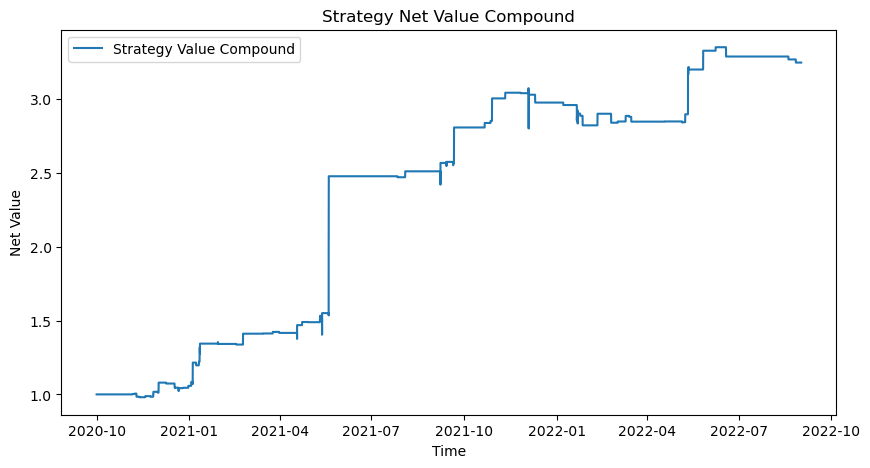

CAGR: 95.98%
Annual Return: 47.09%
Annual Volatility: 24.08%
Sharpe:  1.831


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


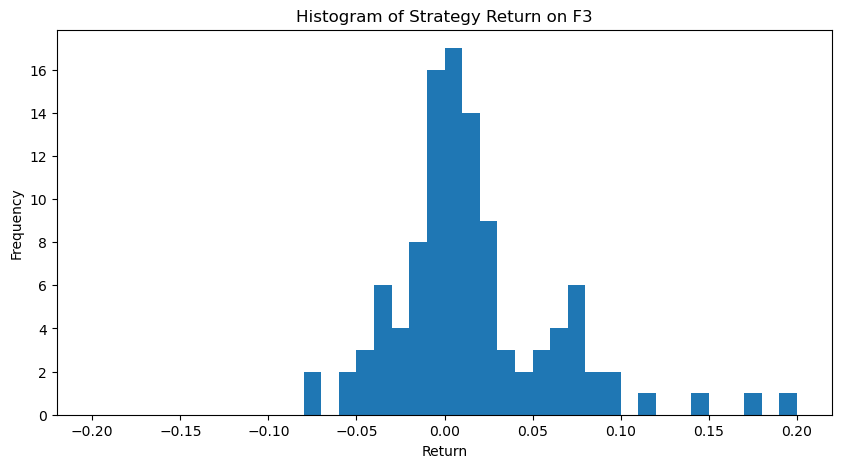

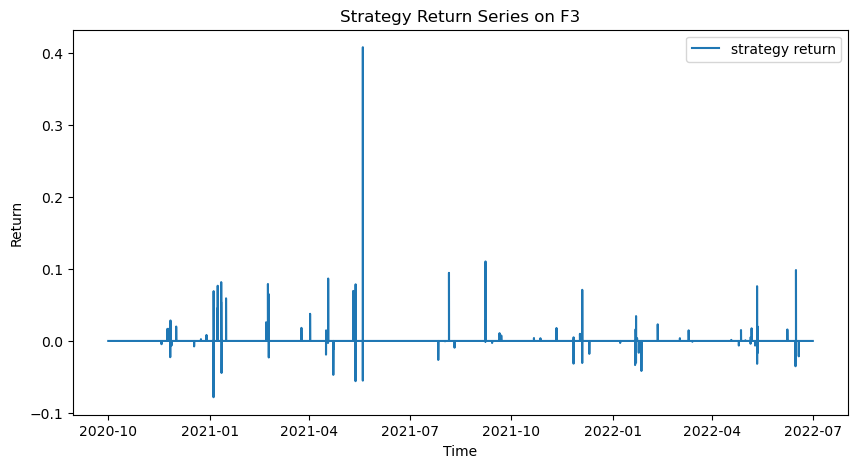

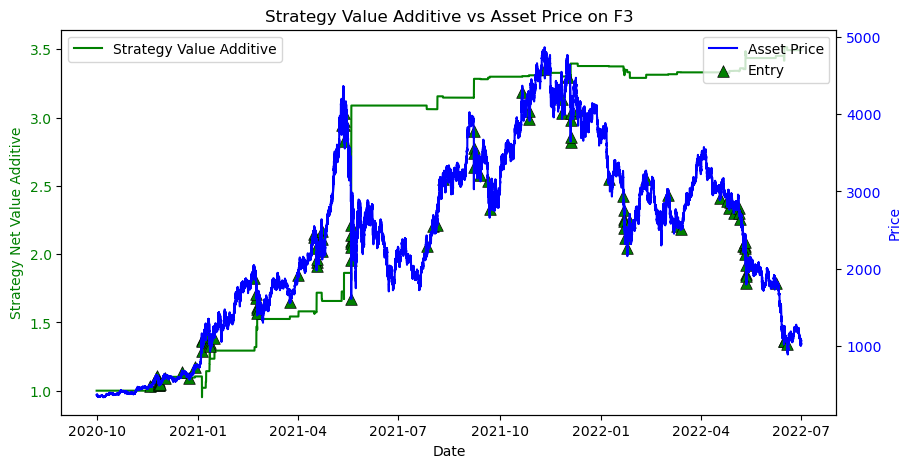

Win Prob: 62.39%
Number of Trades:  109 109
Average Win Return:   0.04952
Average Loss Return: -0.02129
P&L Ratio: 2.3
Maximum Loss of a single trade: -0.07807
Maximum Drawdown: -14.66%
Annualized Return: 98.51%
Annualized Volatility: 46.28%
Sharpe:  2.064


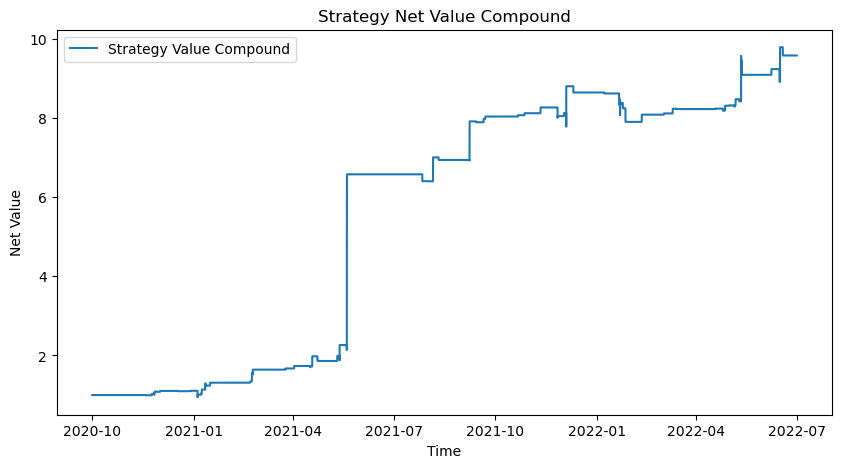

CAGR: 263.65%
Annual Return: 98.51%
Annual Volatility: 46.28%
Sharpe:  2.064


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


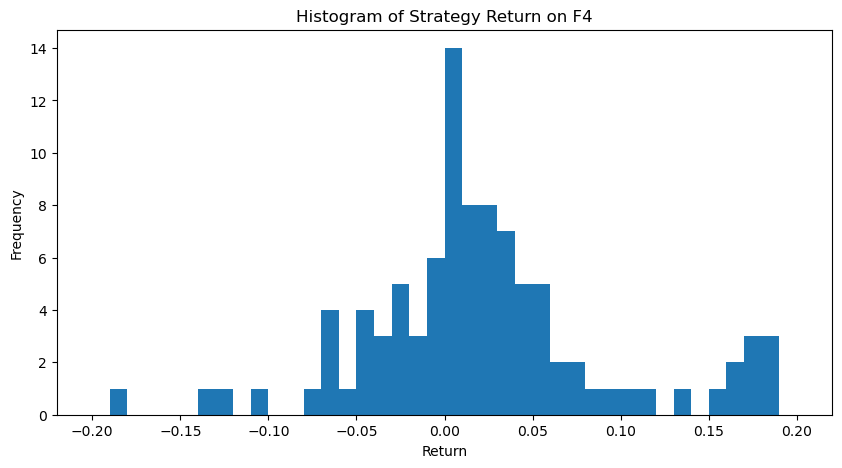

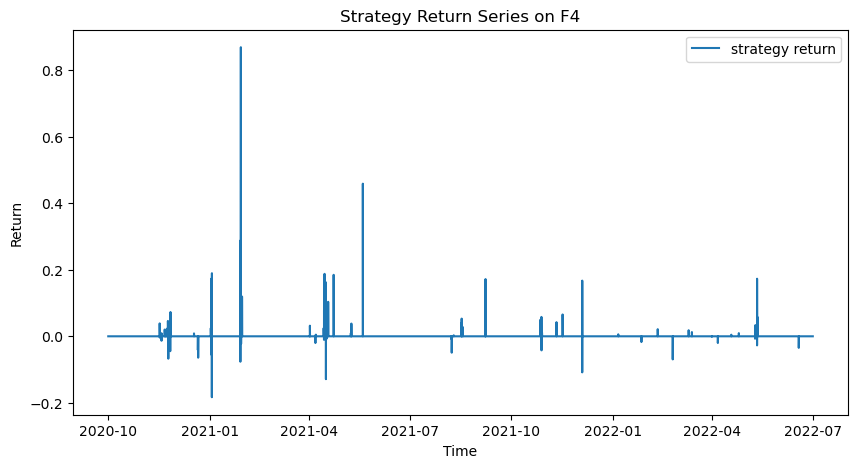

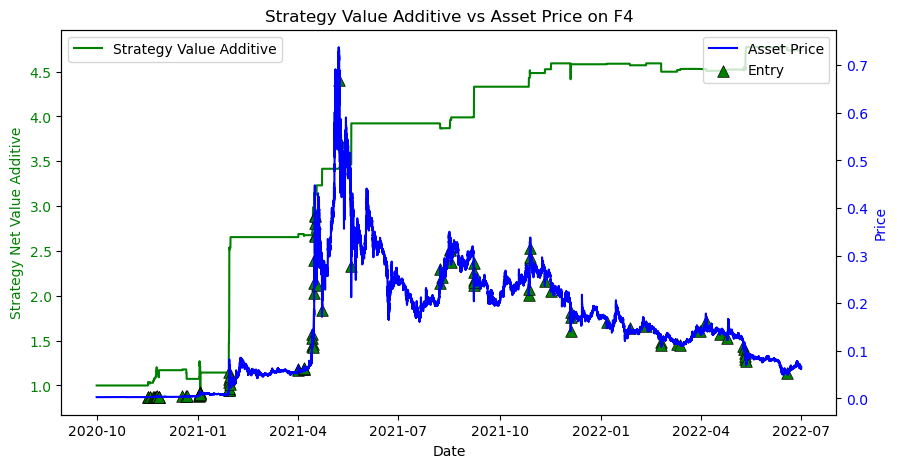

Win Prob: 68.69%
Number of Trades:  99 99
Average Win Return:   0.0758
Average Loss Return: -0.04573
P&L Ratio: 1.7
Maximum Loss of a single trade: -0.1832
Maximum Drawdown: -35.11%
Annualized Return: 147.60%
Annualized Volatility: 78.60%
Sharpe:  1.84


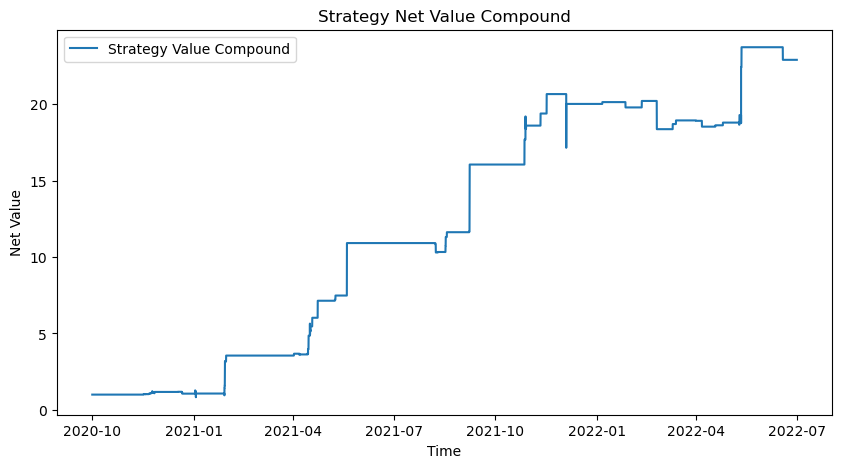

CAGR: 498.60%
Annual Return: 147.60%
Annual Volatility: 78.60%
Sharpe:  1.84


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


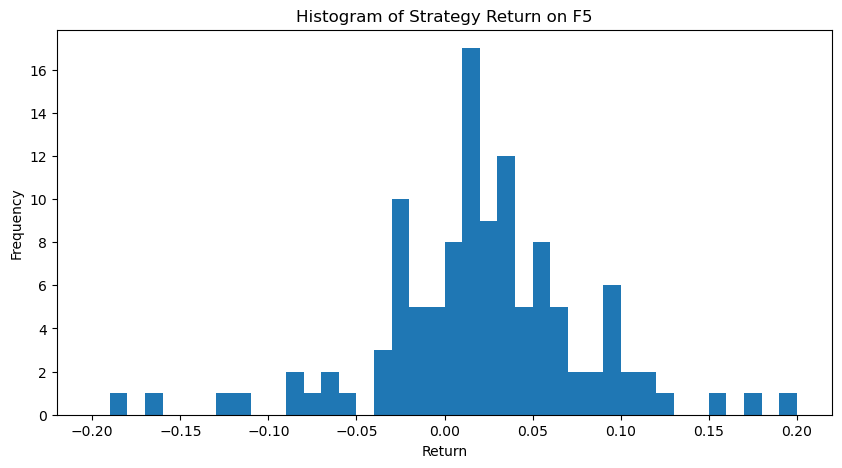

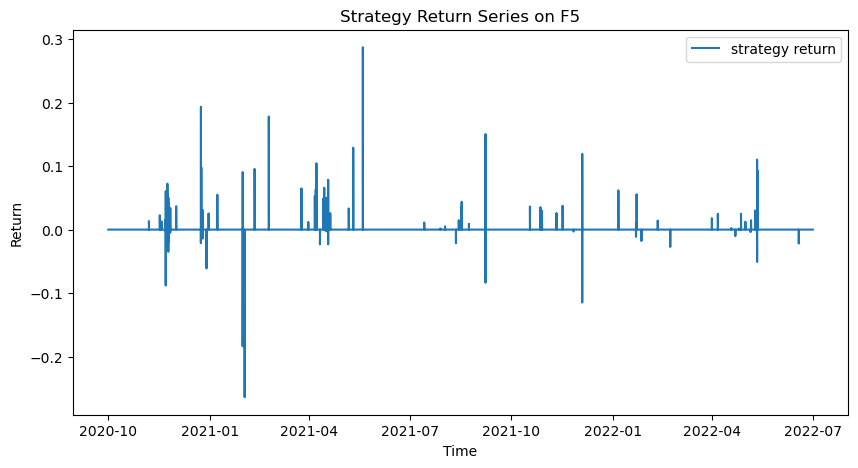

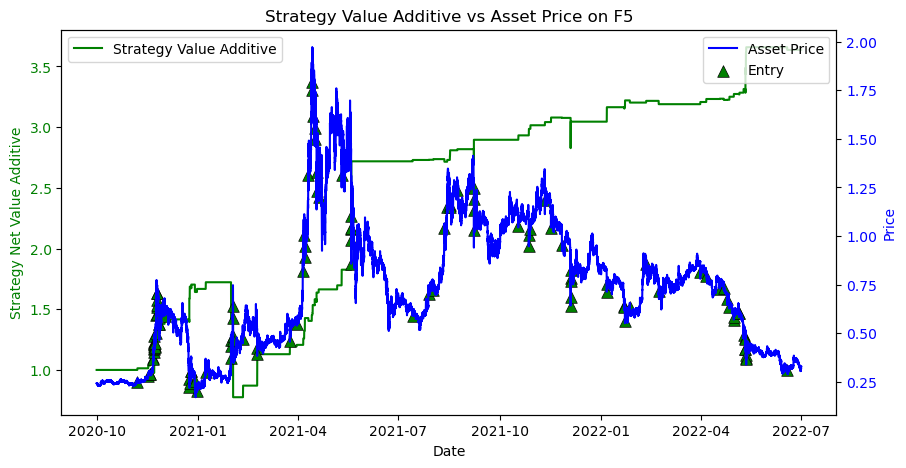

Win Prob: 70.83%
Number of Trades:  120 120
Average Win Return:   0.0541
Average Loss Return: -0.05606
P&L Ratio: 0.96
Maximum Loss of a single trade: -0.264
Maximum Drawdown: -66.02%
Annualized Return: 104.12%
Annualized Volatility: 55.06%
Sharpe:  1.837


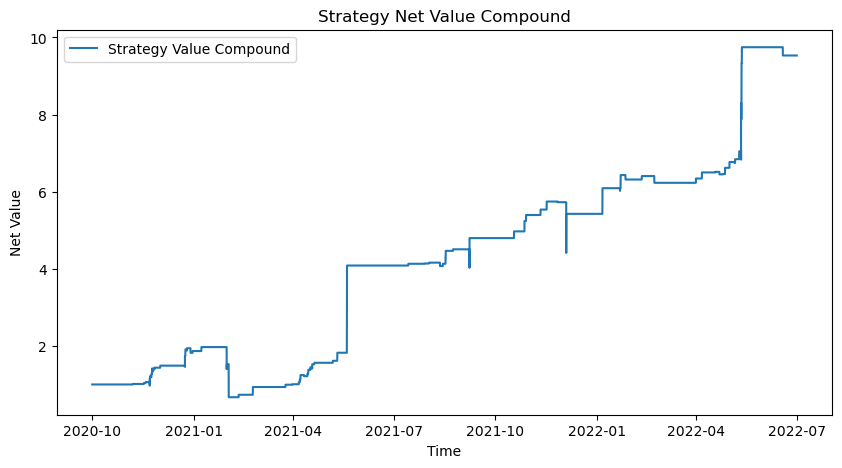

CAGR: 262.66%
Annual Return: 104.12%
Annual Volatility: 55.06%
Sharpe:  1.837


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


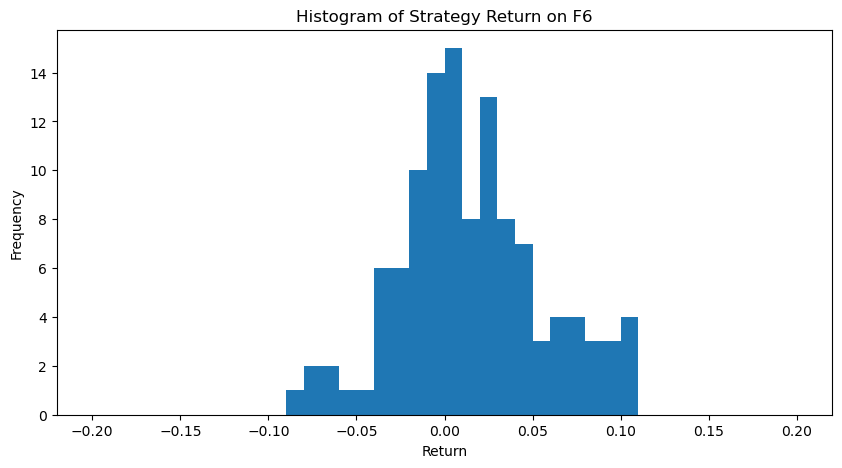

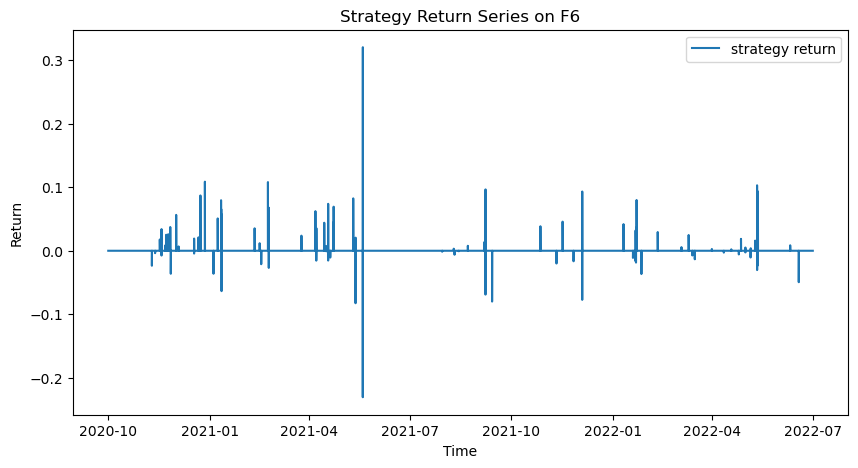

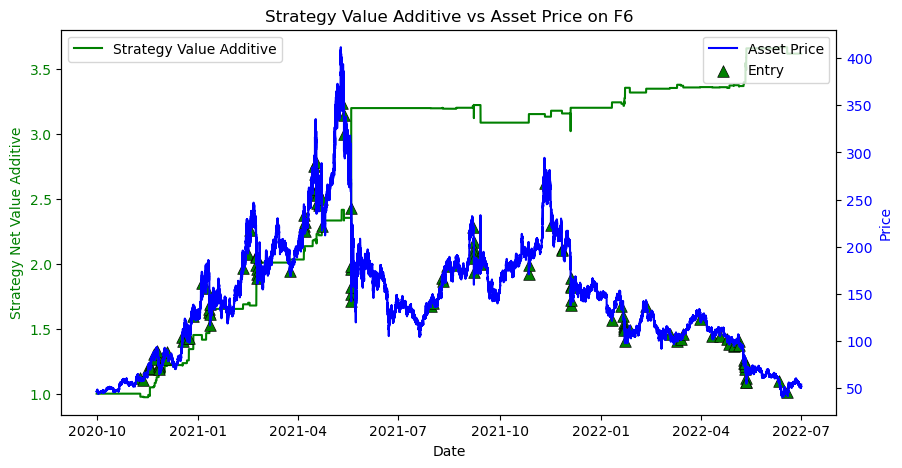

Win Prob: 63.33%
Number of Trades:  120 120
Average Win Return:   0.05083
Average Loss Return: -0.0283
P&L Ratio: 1.8
Maximum Loss of a single trade: -0.2304
Maximum Drawdown: -27.94%
Annualized Return: 103.41%
Annualized Volatility: 46.55%
Sharpe:  2.157


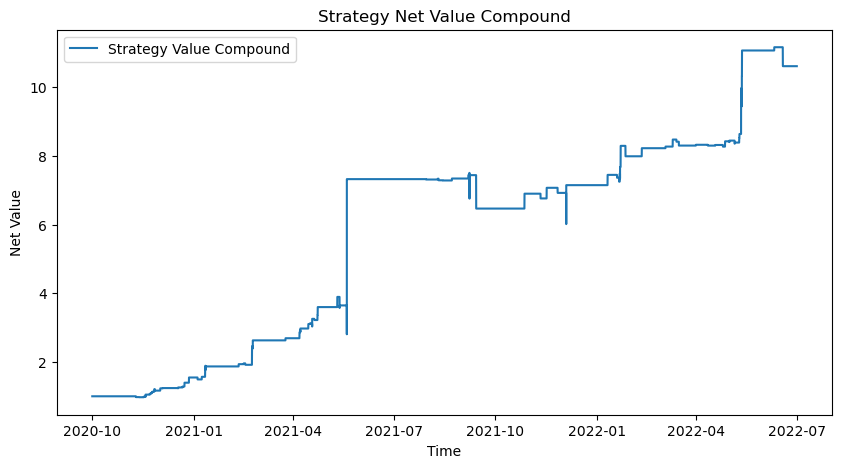

CAGR: 285.72%
Annual Return: 103.41%
Annual Volatility: 46.55%
Sharpe:  2.157


After preprocess the data has 192671 columns.
Preprocess finished
8.2 Trading signal finished


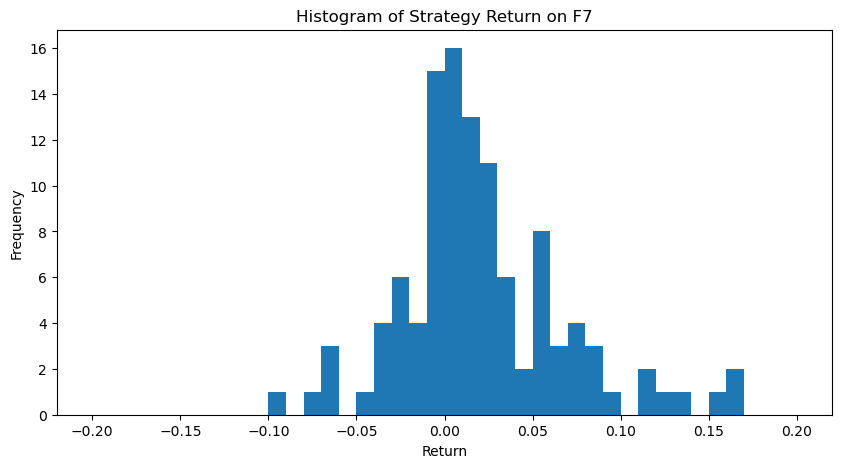

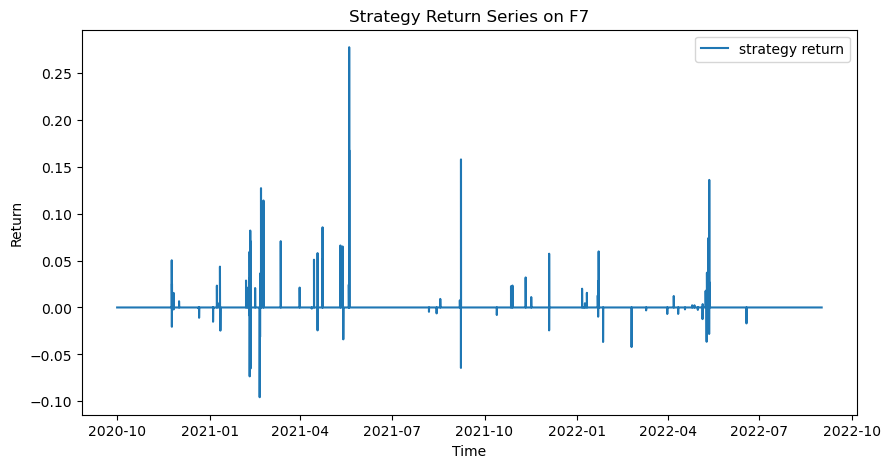

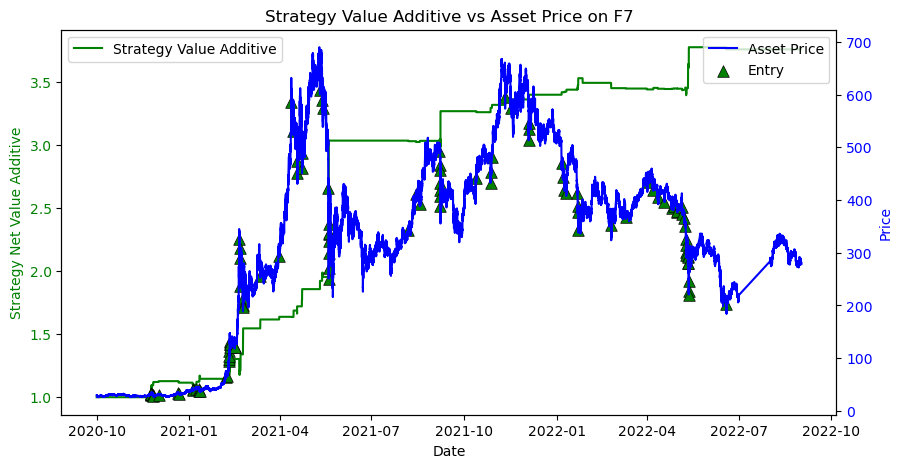

Win Prob: 68.47%
Number of Trades:  111 111
Average Win Return:   0.04698
Average Loss Return: -0.02311
P&L Ratio: 2.0
Maximum Loss of a single trade: -0.0956
Maximum Drawdown: -20.48%
Annualized Return: 104.03%
Annualized Volatility: 39.73%
Sharpe:  2.543


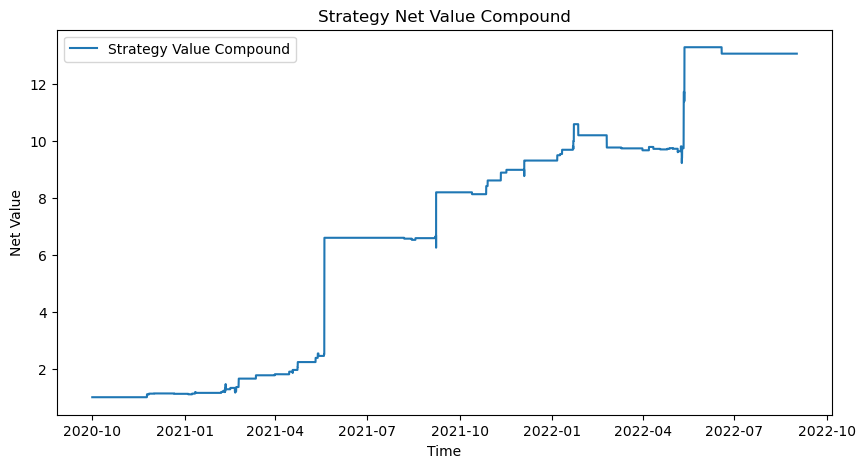

CAGR: 334.12%
Annual Return: 104.03%
Annual Volatility: 39.73%
Sharpe:  2.543


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


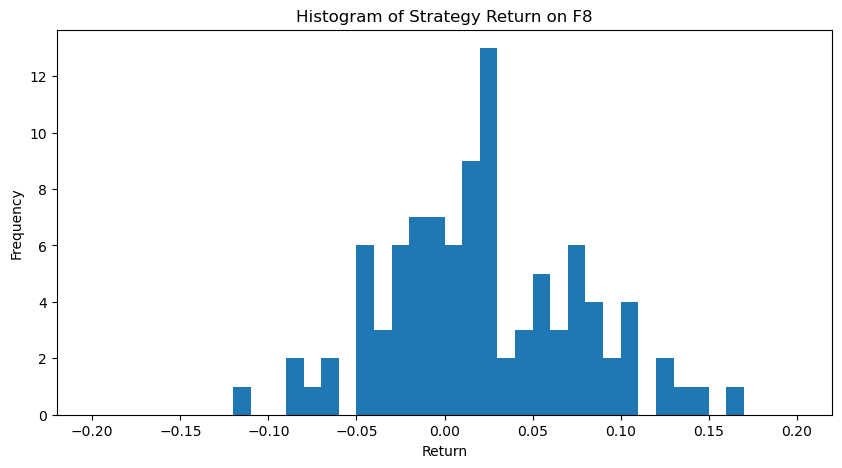

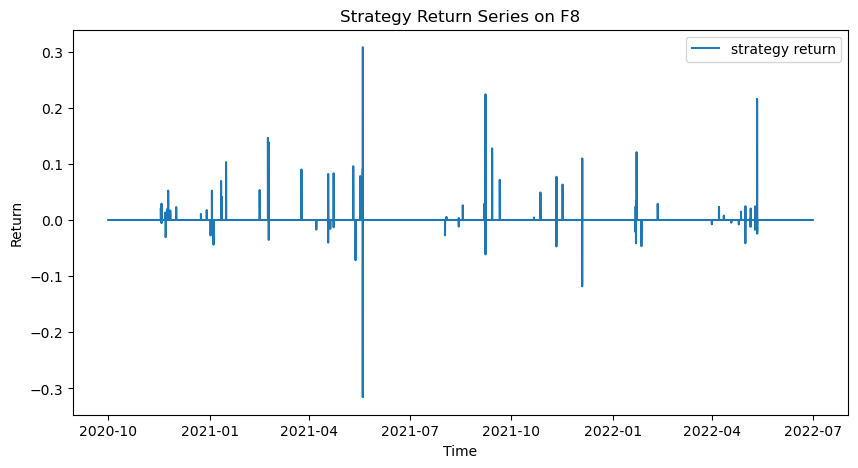

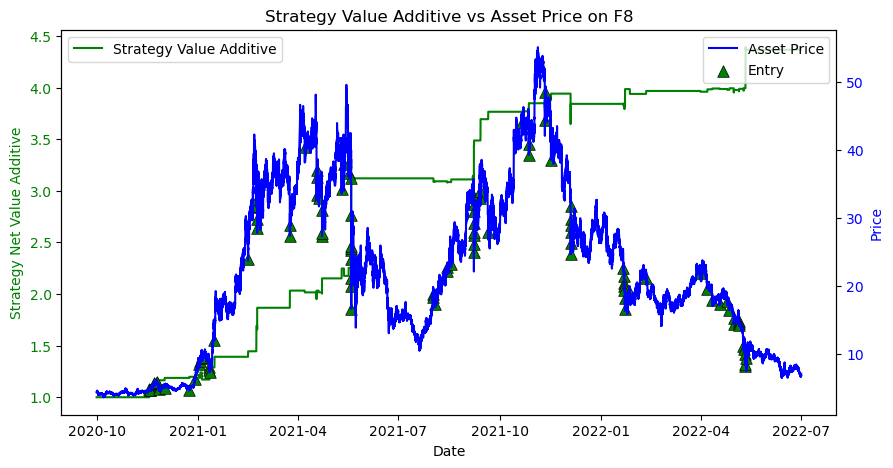

Win Prob: 65.38%
Number of Trades:  104 104
Average Win Return:   0.07062
Average Loss Return: -0.0399
P&L Ratio: 1.8
Maximum Loss of a single trade: -0.3157
Maximum Drawdown: -37.13%
Annualized Return: 132.95%
Annualized Volatility: 57.23%
Sharpe:  2.271


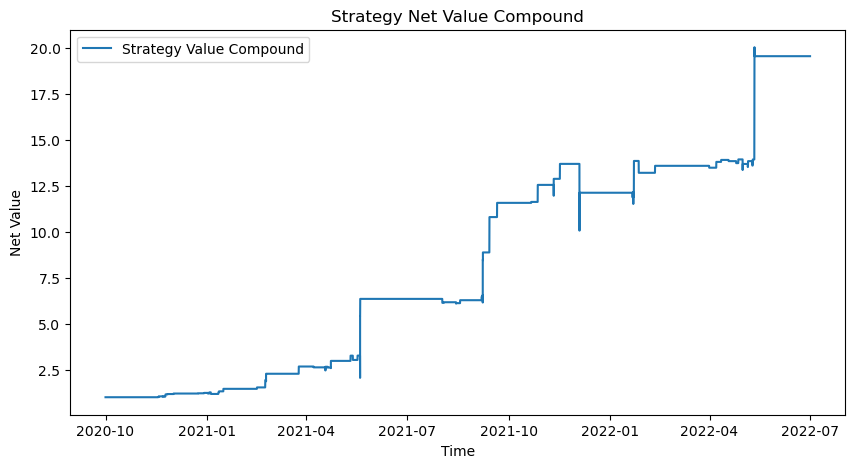

CAGR: 447.15%
Annual Return: 132.95%
Annual Volatility: 57.23%
Sharpe:  2.271


After preprocess the data has 175103 columns.
Preprocess finished
8.2 Trading signal finished


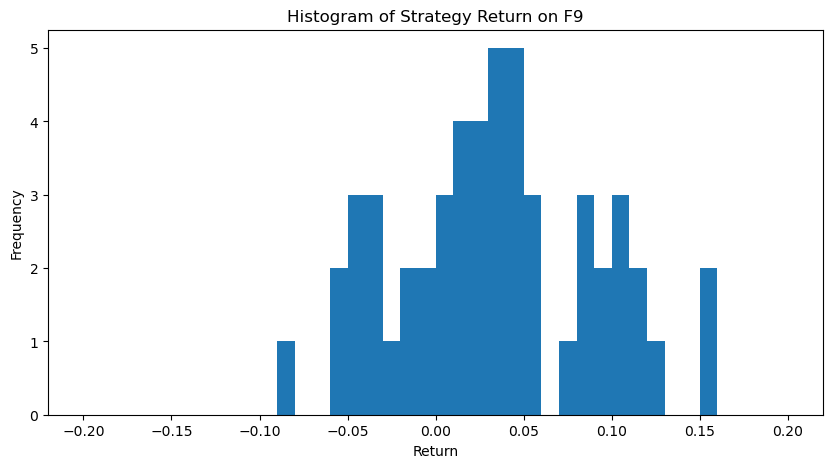

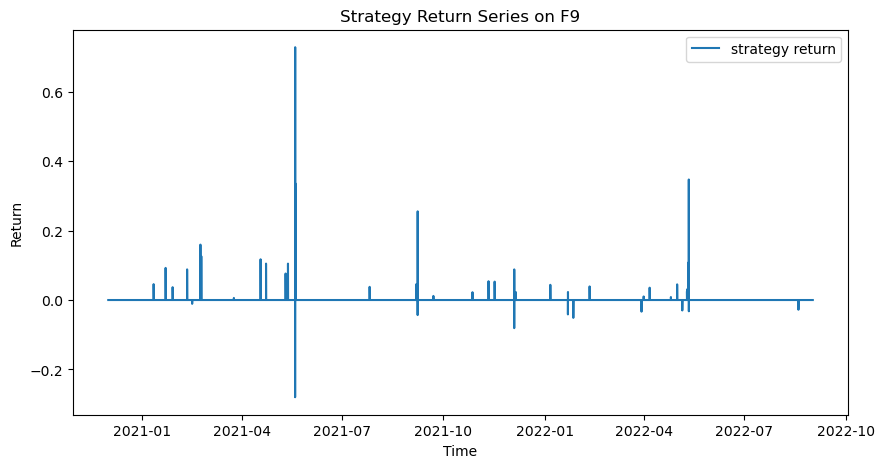

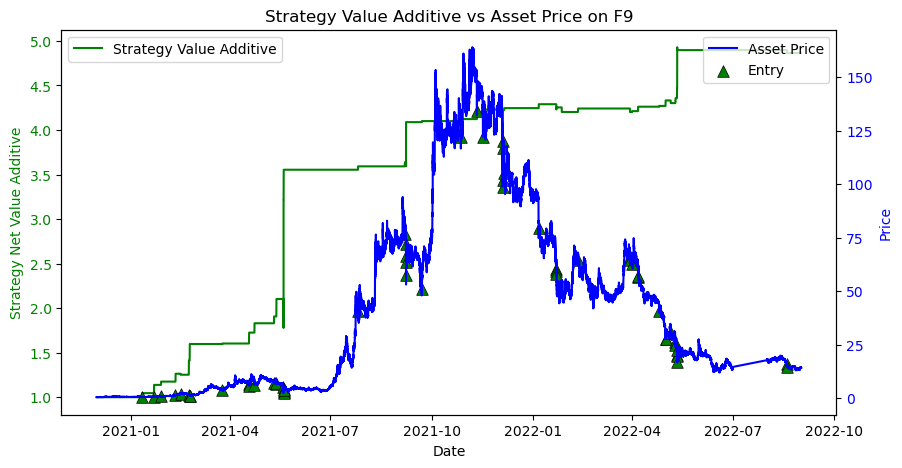

Win Prob: 74.58%
Number of Trades:  59 59
Average Win Return:   0.1052
Average Loss Return: -0.05091
P&L Ratio: 2.1
Maximum Loss of a single trade: -0.28
Maximum Drawdown: -31.26%
Annualized Return: 160.14%
Annualized Volatility: 75.73%
Sharpe:  2.075


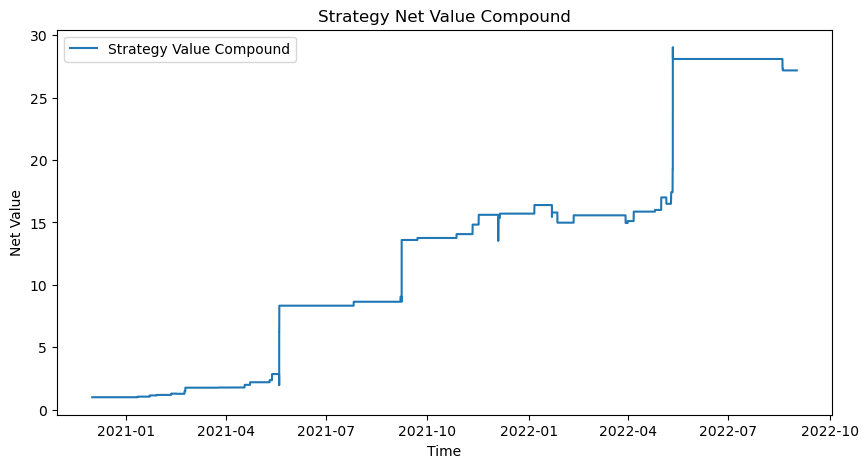

CAGR: 560.07%
Annual Return: 160.14%
Annual Volatility: 75.73%
Sharpe:  2.075


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


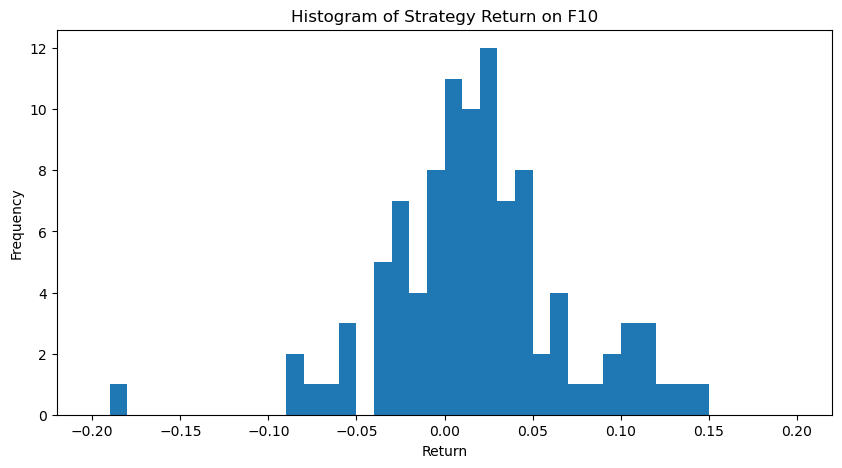

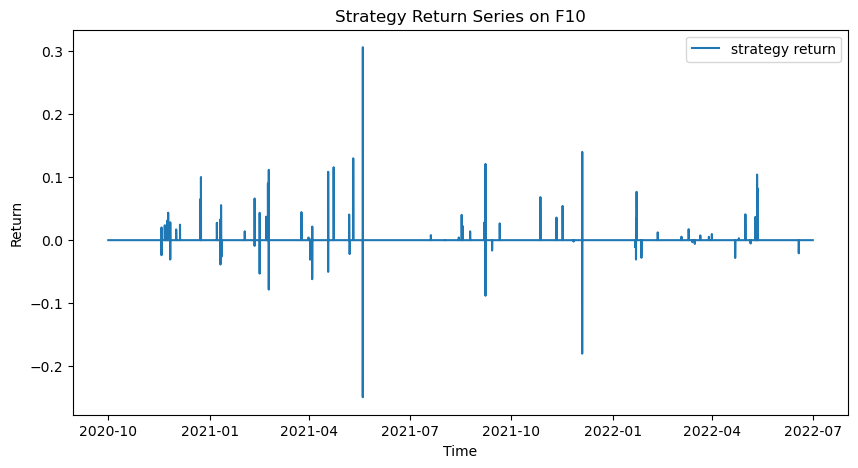

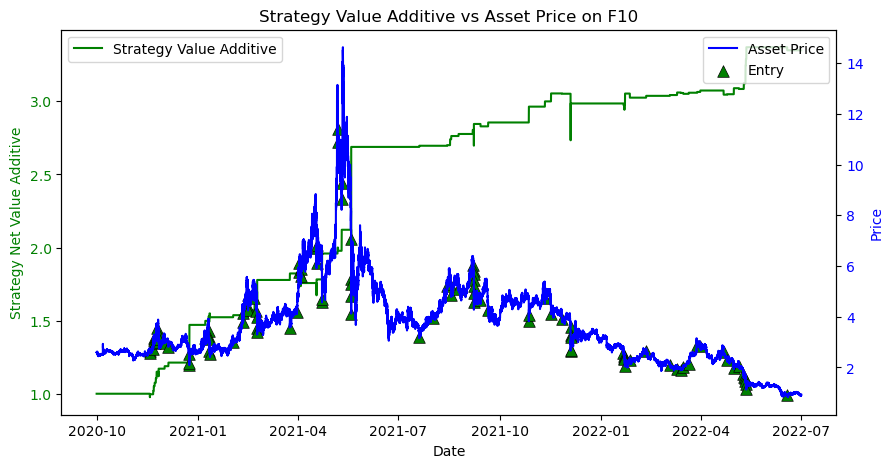

Win Prob: 67.96%
Number of Trades:  103 103
Average Win Return:   0.05239
Average Loss Return: -0.03995
P&L Ratio: 1.3
Maximum Loss of a single trade: -0.2495
Maximum Drawdown: -29.12%
Annualized Return: 92.79%
Annualized Volatility: 47.62%
Sharpe:  1.886


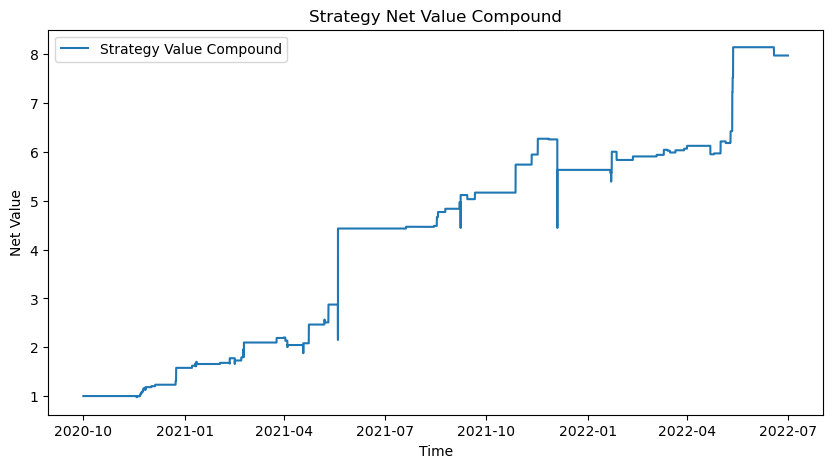

CAGR: 227.52%
Annual Return: 92.79%
Annual Volatility: 47.62%
Sharpe:  1.886


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


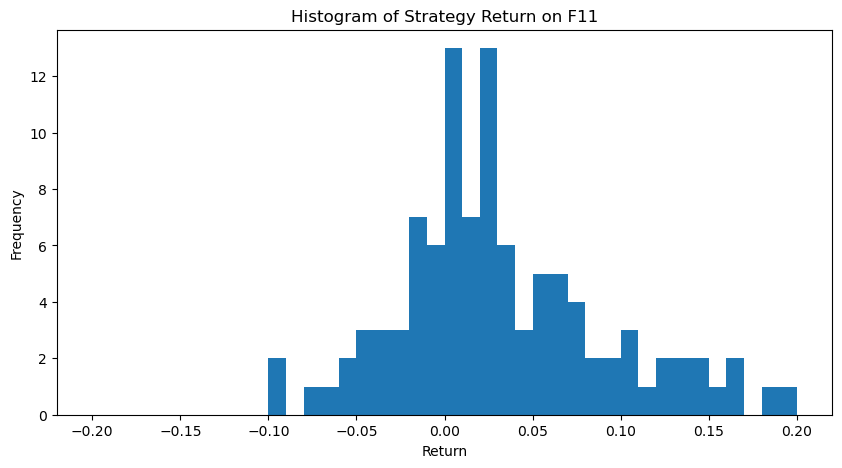

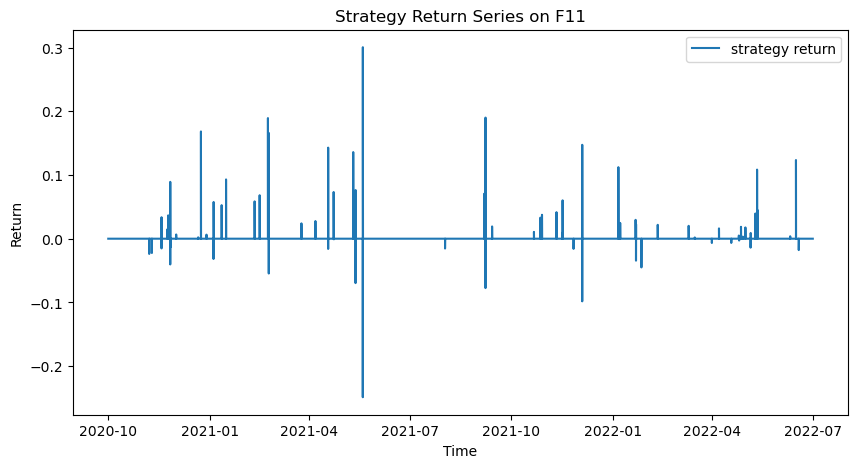

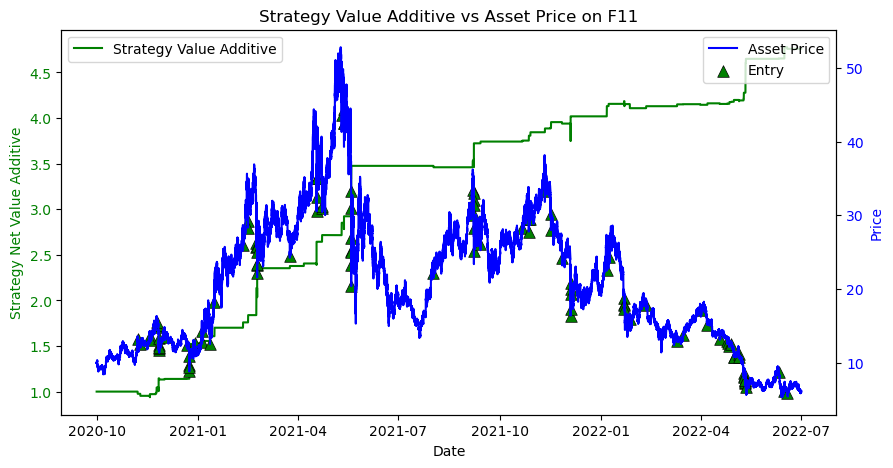

Win Prob: 72.90%
Number of Trades:  107 107
Average Win Return:   0.06286
Average Loss Return: -0.03947
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.2489
Maximum Drawdown: -32.19%
Annualized Return: 148.46%
Annualized Volatility: 52.93%
Sharpe:  2.748


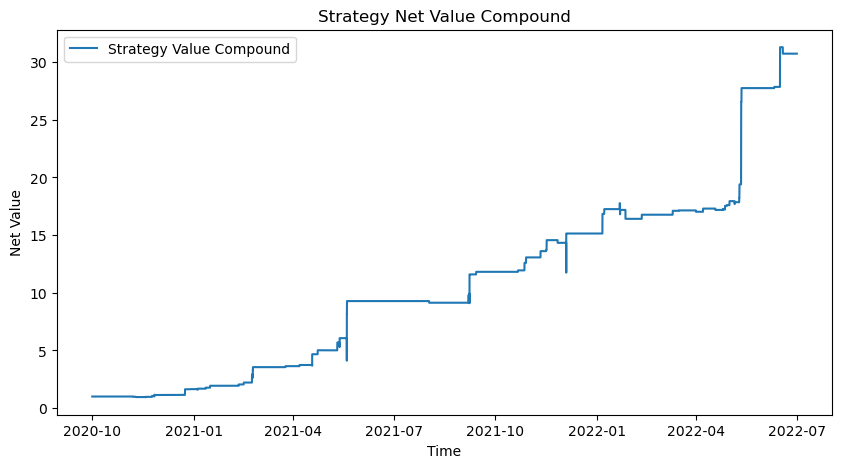

CAGR: 608.02%
Annual Return: 148.46%
Annual Volatility: 52.93%
Sharpe:  2.748


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


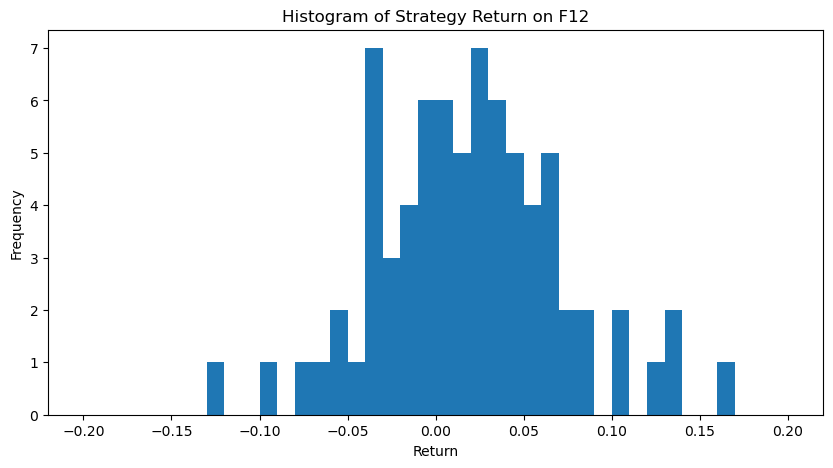

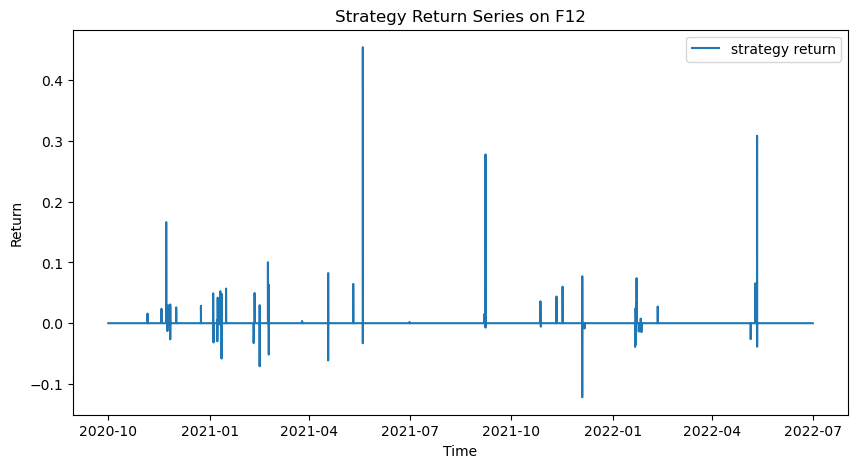

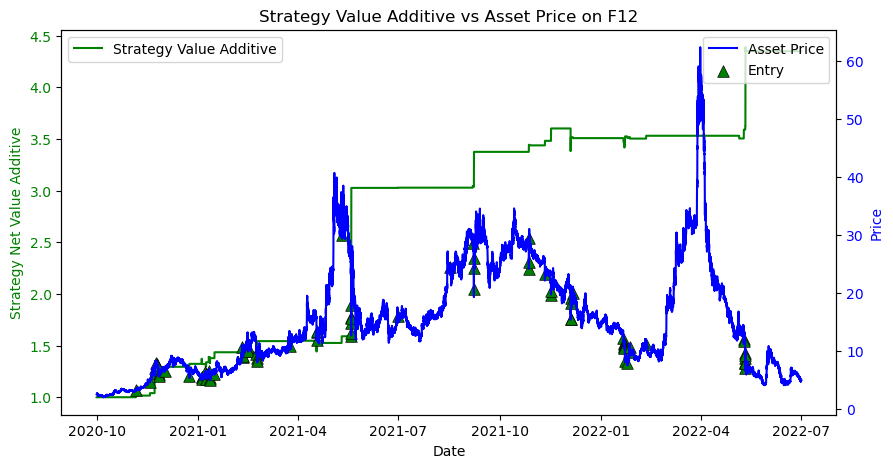

Win Prob: 66.67%
Number of Trades:  81 81
Average Win Return:   0.0792
Average Loss Return: -0.0344
P&L Ratio: 2.3
Maximum Loss of a single trade: -0.1219
Maximum Drawdown: -20.72%
Annualized Return: 132.24%
Annualized Volatility: 59.14%
Sharpe:  2.186


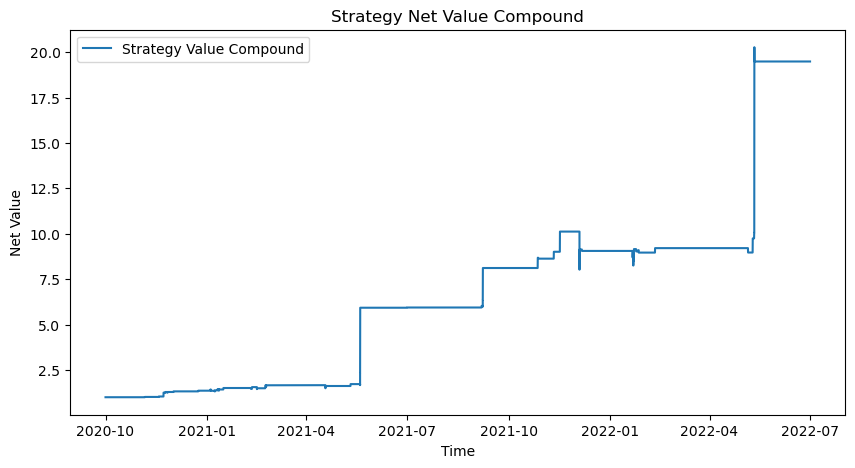

CAGR: 445.76%
Annual Return: 132.24%
Annual Volatility: 59.14%
Sharpe:  2.186


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


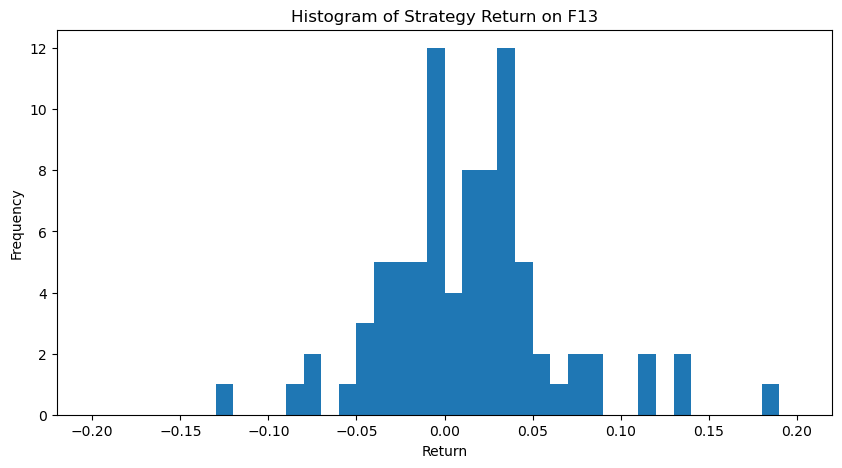

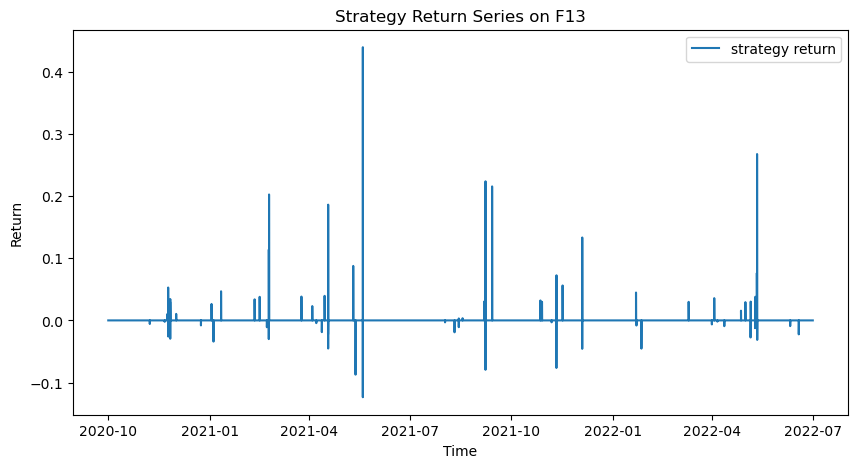

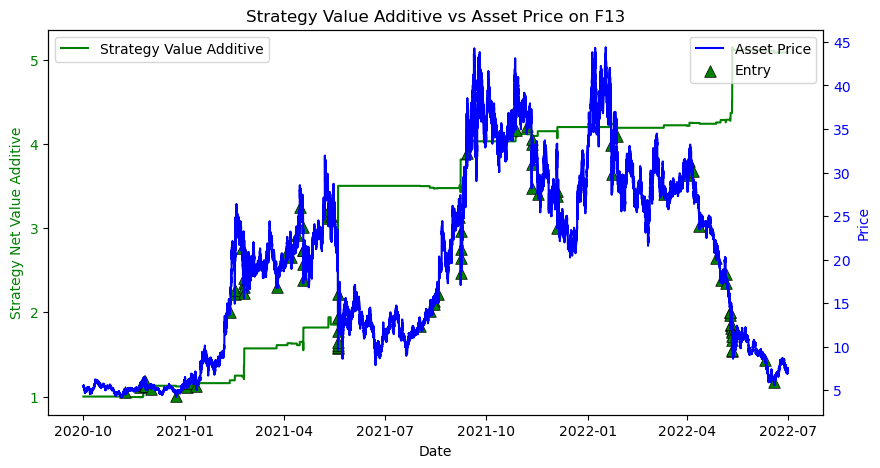

Win Prob: 62.77%
Number of Trades:  94 94
Average Win Return:   0.08606
Average Loss Return: -0.02831
P&L Ratio: 3.0
Maximum Loss of a single trade: -0.1235
Maximum Drawdown: -20.00%
Annualized Return: 161.43%
Annualized Volatility: 66.88%
Sharpe:  2.369


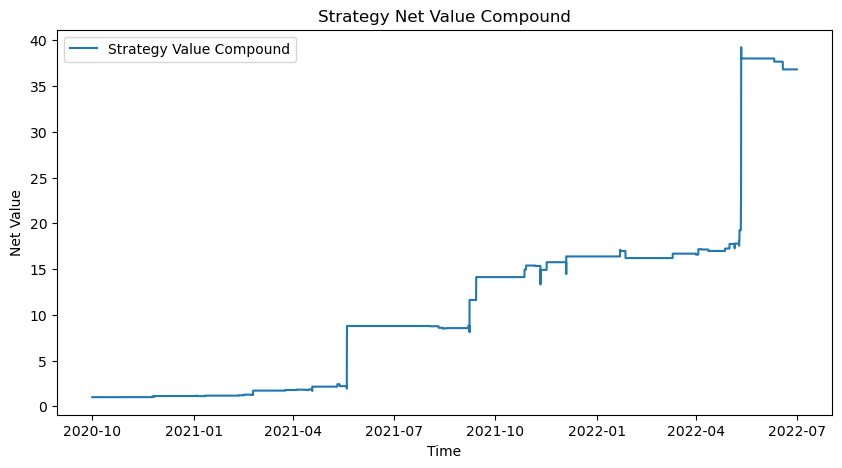

CAGR: 685.07%
Annual Return: 161.43%
Annual Volatility: 66.88%
Sharpe:  2.369


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


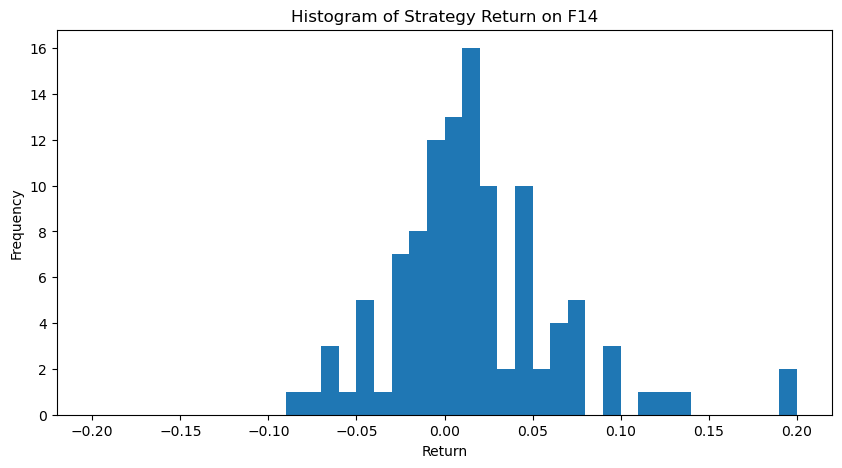

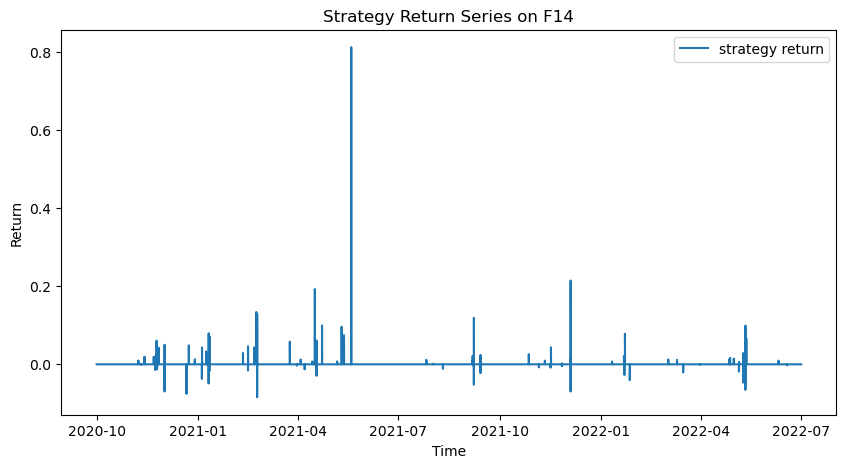

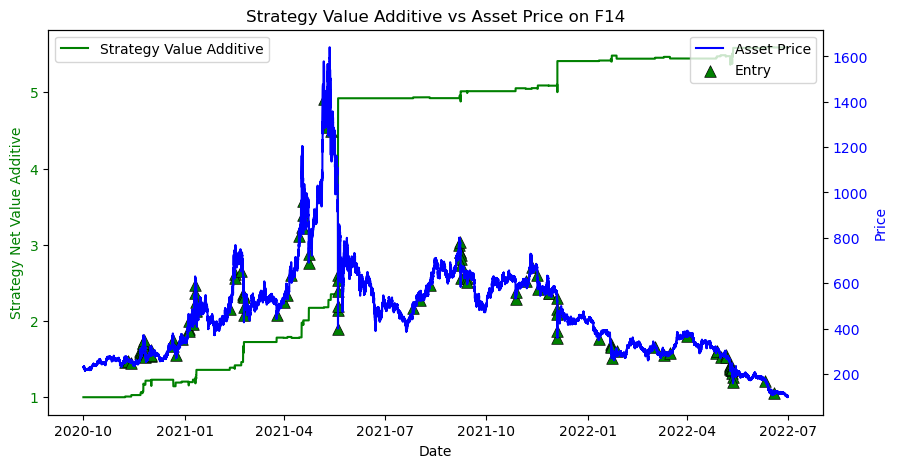

Win Prob: 66.09%
Number of Trades:  115 115
Average Win Return:   0.07395
Average Loss Return: -0.02642
P&L Ratio: 2.8
Maximum Loss of a single trade: -0.0843
Maximum Drawdown: -11.94%
Annualized Return: 181.29%
Annualized Volatility: 84.63%
Sharpe:  2.107


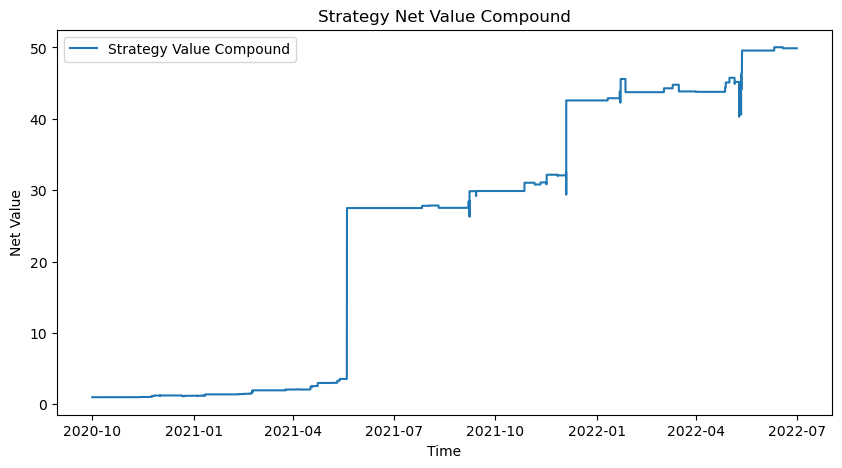

CAGR: 833.83%
Annual Return: 181.29%
Annual Volatility: 84.63%
Sharpe:  2.107


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


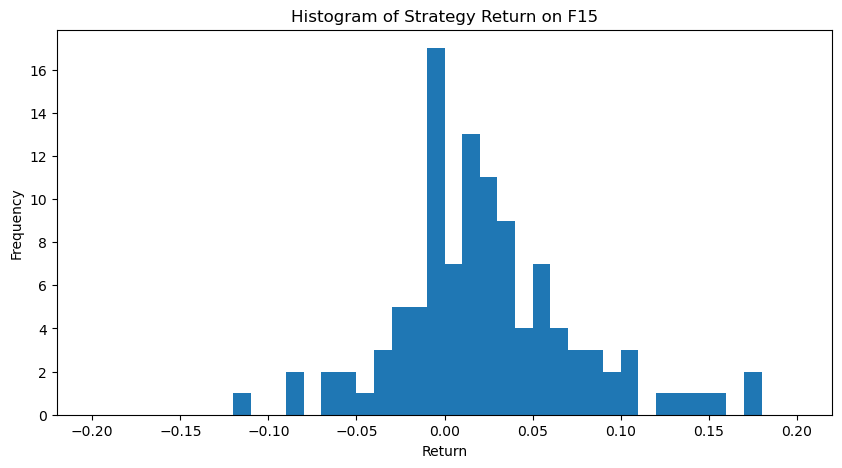

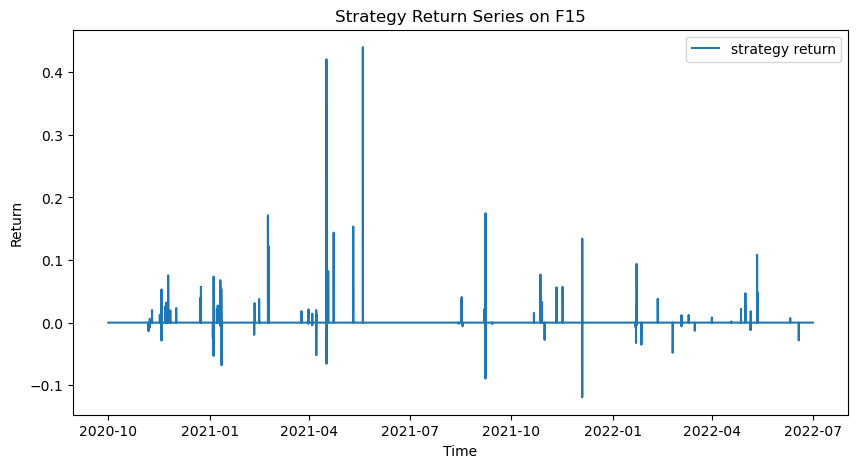

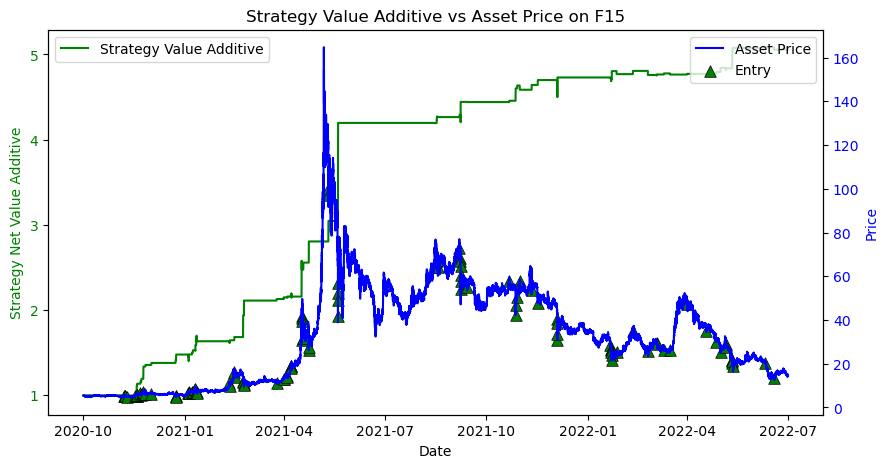

Win Prob: 66.67%
Number of Trades:  114 114
Average Win Return:   0.06586
Average Loss Return: -0.02497
P&L Ratio: 2.6
Maximum Loss of a single trade: -0.1192
Maximum Drawdown: -19.05%
Annualized Return: 160.21%
Annualized Volatility: 60.31%
Sharpe:  2.607


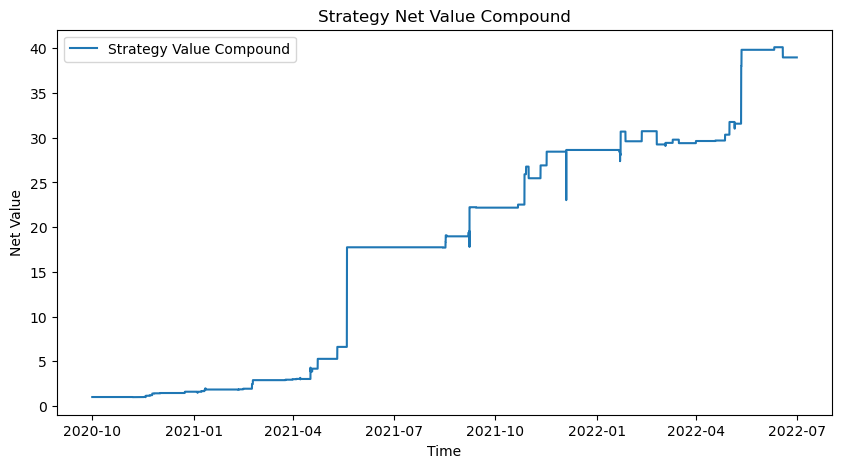

CAGR: 711.15%
Annual Return: 160.21%
Annual Volatility: 60.31%
Sharpe:  2.607


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


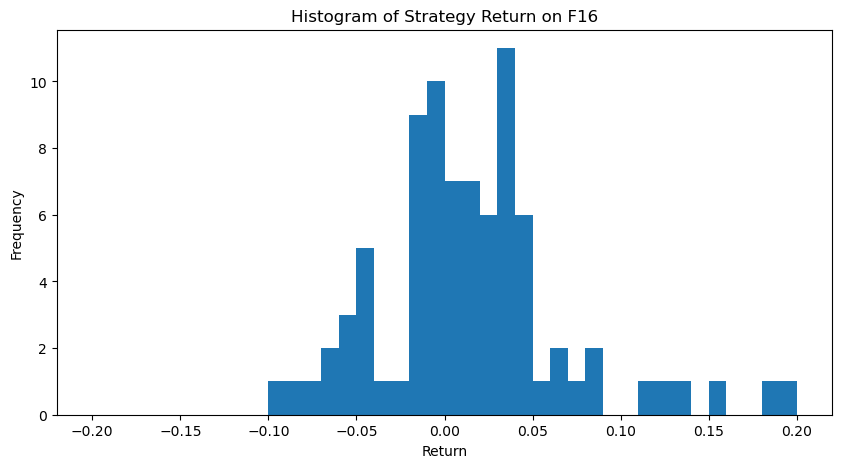

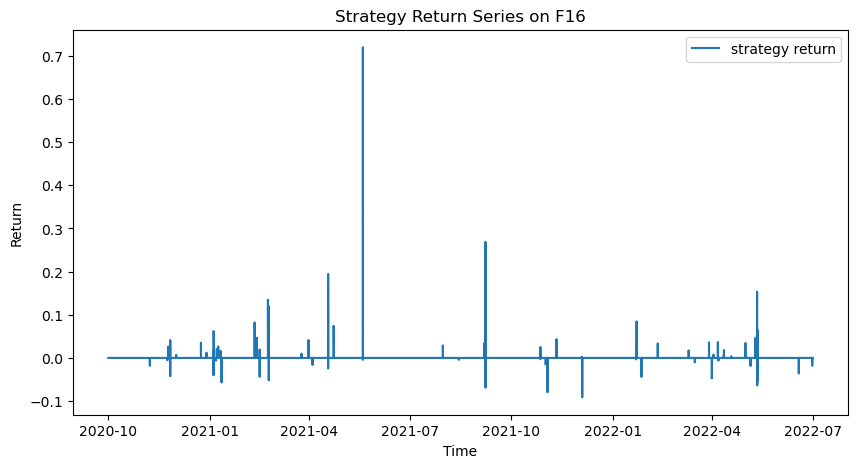

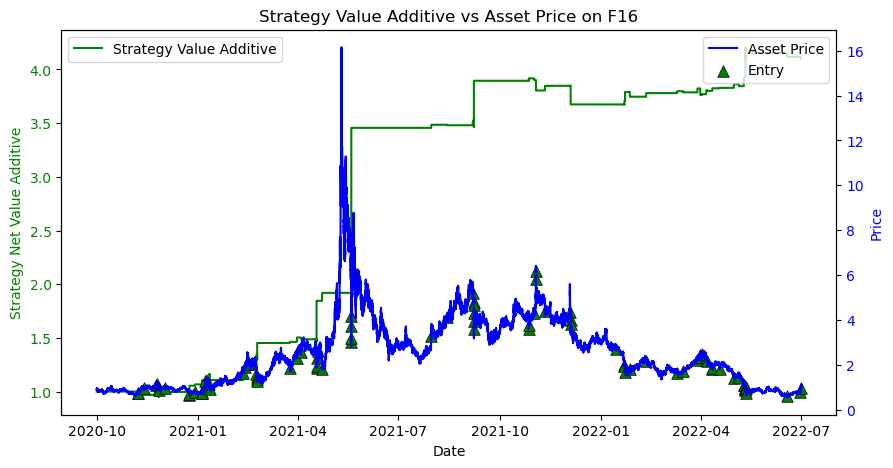

Win Prob: 60.92%
Number of Trades:  87 87
Average Win Return:   0.07746
Average Loss Return: -0.02959
P&L Ratio: 2.6
Maximum Loss of a single trade: -0.09105
Maximum Drawdown: -22.83%
Annualized Return: 122.41%
Annualized Volatility: 69.82%
Sharpe:  1.71


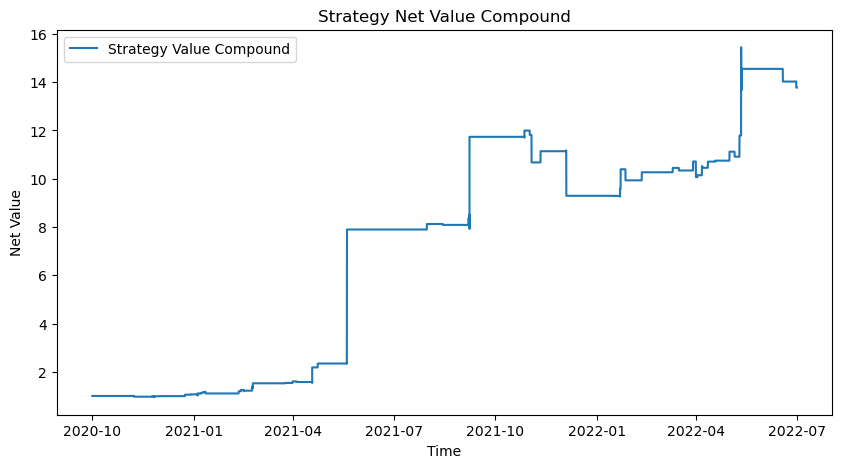

CAGR: 347.57%
Annual Return: 122.41%
Annual Volatility: 69.82%
Sharpe:  1.71


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


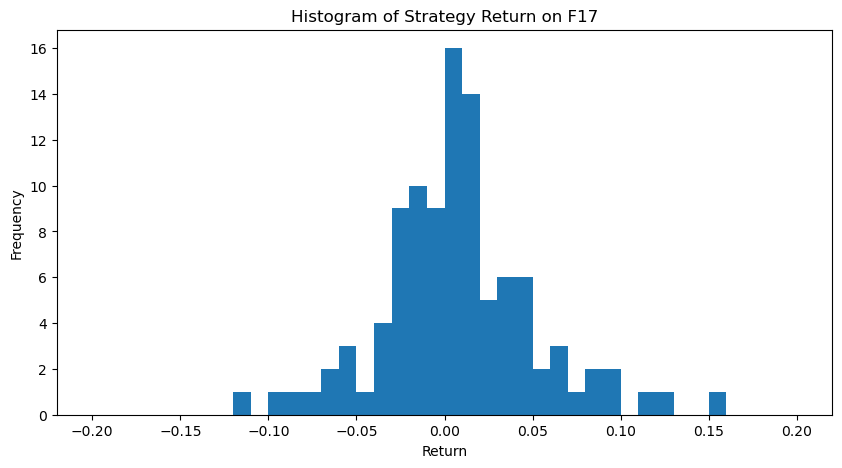

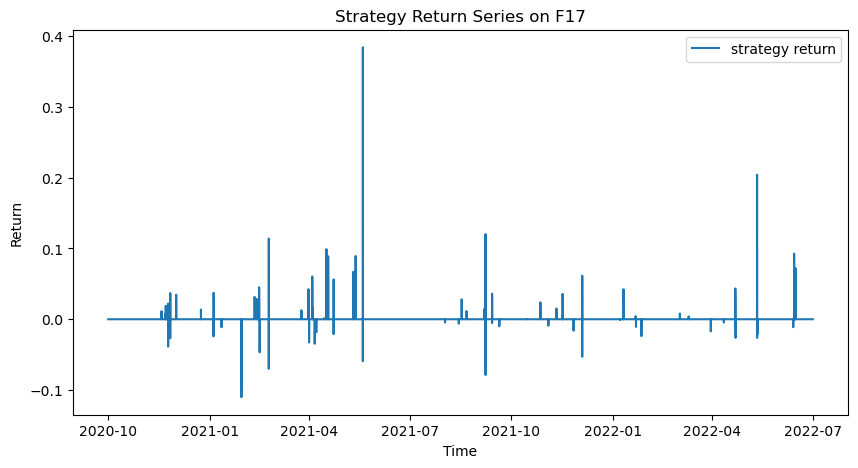

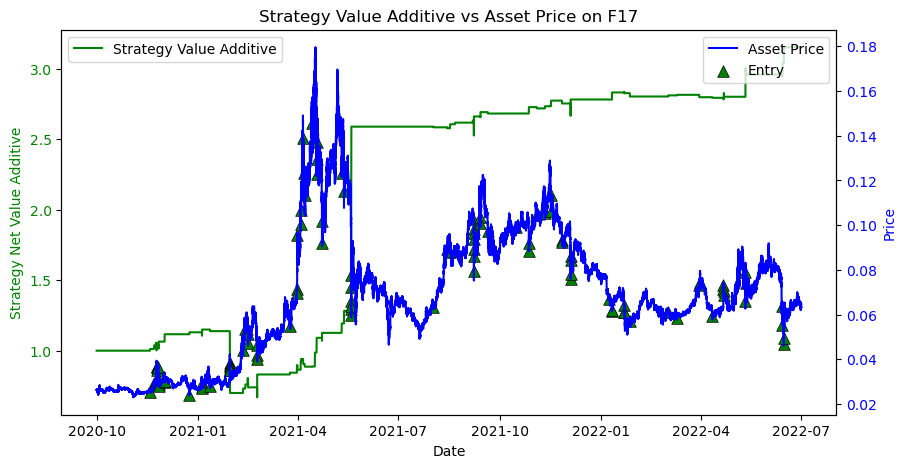

Win Prob: 60.75%
Number of Trades:  107 107
Average Win Return:   0.05258
Average Loss Return: -0.03014
P&L Ratio: 1.7
Maximum Loss of a single trade: -0.1101
Maximum Drawdown: -39.65%
Annualized Return: 85.00%
Annualized Volatility: 49.82%
Sharpe:  1.646


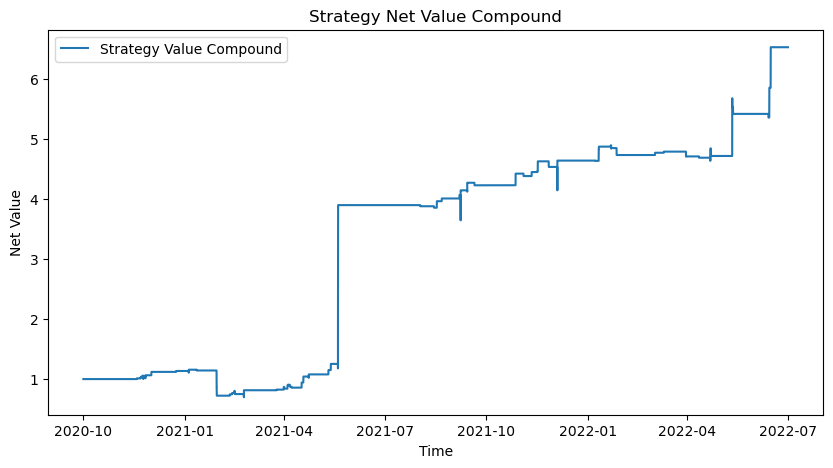

CAGR: 192.16%
Annual Return: 85.00%
Annual Volatility: 49.82%
Sharpe:  1.646


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


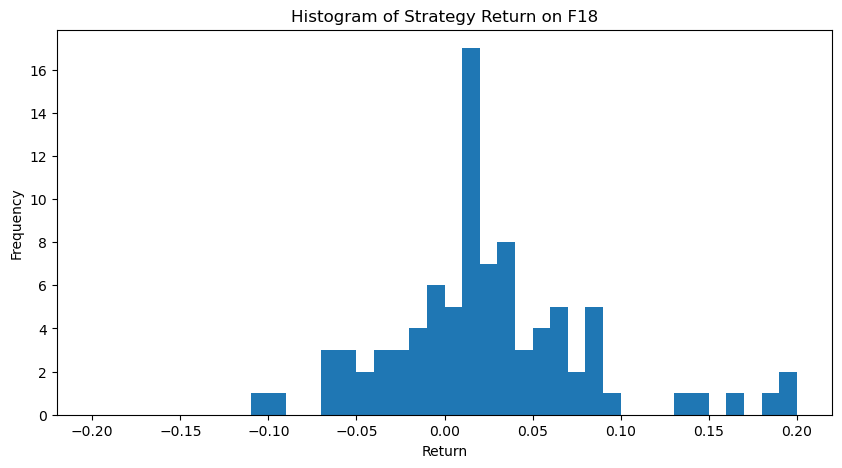

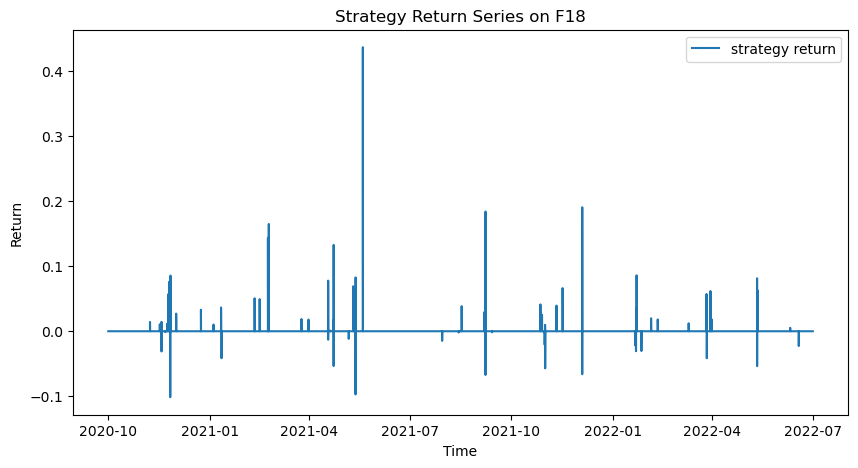

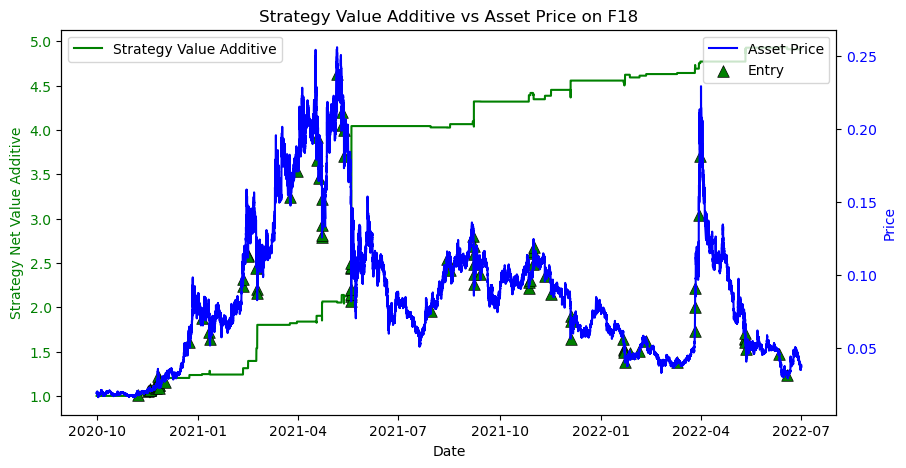

Win Prob: 72.34%
Number of Trades:  94 94
Average Win Return:   0.07035
Average Loss Return: -0.03363
P&L Ratio: 2.1
Maximum Loss of a single trade: -0.1014
Maximum Drawdown: -15.57%
Annualized Return: 154.40%
Annualized Volatility: 60.42%
Sharpe:  2.506


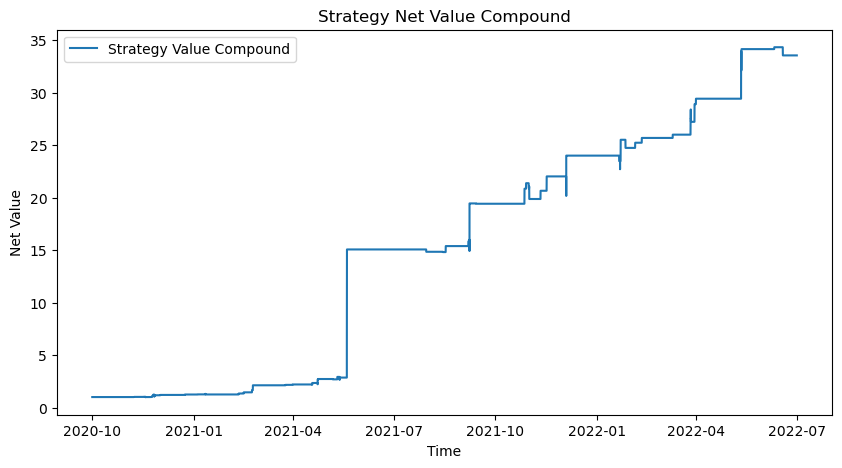

CAGR: 644.44%
Annual Return: 154.40%
Annual Volatility: 60.42%
Sharpe:  2.506




In [346]:
# strategy 8.2 use avg price as buy and sell price
strategy8_2_list = []
profit_des_8_2 = pd.DataFrame()
tbv_des_8_2 = pd.DataFrame()
tbv_tv_des_8_2 = pd.DataFrame()
tbv_pct_des_8_2 = pd.DataFrame()
ma_des_8_2 = pd.DataFrame()
for idx in range(len(data_list)):
    name = 'F'+str(idx+1)
    stra8_2 = CTAStrategy(data_list[idx],'open_time','signal','close',120,5,name)
    stra8_2.data_preprocess()
    stra8_2.find_signal_8_2(10000,0.1,1)
    stra8_2.get_strategy_returns(1/1000)
    stra8_2.plot_hist_seires()
    stra8_2.plot_cumsum_profits()
    stra8_2.get_win_prob()
    profit_des = stra8_2.get_avg_win_return()
    stra8_2.get_maximum_drawdown()
    stra8_2.get_sharpe()
    stra8_2.plot_cumprod_value()
    tbv_des, tbv_tv_des, tbv_pct_des = stra8_2.taker_buy_volume_stats()
    ma_des = stra8_2.moving_average_stats()
    strategy8_2_list.append(stra8_2)
    if (profit_des_8_2.empty):
        profit_des_8_2 = profit_des
        tbv_des_8_2 = tbv_des
        tbv_tv_des_8_2 = tbv_tv_des
        tbv_pct_des_8_2 = tbv_pct_des
        ma_des_8_2 = ma_des
    else:
        profit_des_8_2 = profit_des_8_2.join(profit_des)
        tbv_des_8_2 = tbv_des_8_2.join(tbv_des)
        tbv_tv_des_8_2 =tbv_tv_des_8_2.join(tbv_tv_des)
        tbv_pct_des_8_2 = tbv_pct_des_8_2.join(tbv_pct_des)
        ma_des_8_2 = ma_des_8_2.join(ma_des)
    print('\n')

## Overall Statistics

In [347]:
# calculate average win rate, average profit loss ratio, average sharpe
win_rate2 = []
pnl_ratio2 = []
sharpe2 = []
for ele in strategy8_2_list:
    win_rate2.append(ele.win_prob)
    pnl_ratio2.append(ele.pnl_ratio)
    sharpe2.append(ele.sharpe)
print(f"Average Win Rate: {np.mean(win_rate2):.2f}")
print(f"Average P&L Ratio: {np.mean(pnl_ratio2):.2f}")
print(f"Average Sharpe: {np.mean(sharpe2):.2f}")

Average Win Rate: 0.66
Average P&L Ratio: 2.06
Average Sharpe: 2.16


## Strategy 8.2 Additional Analysis

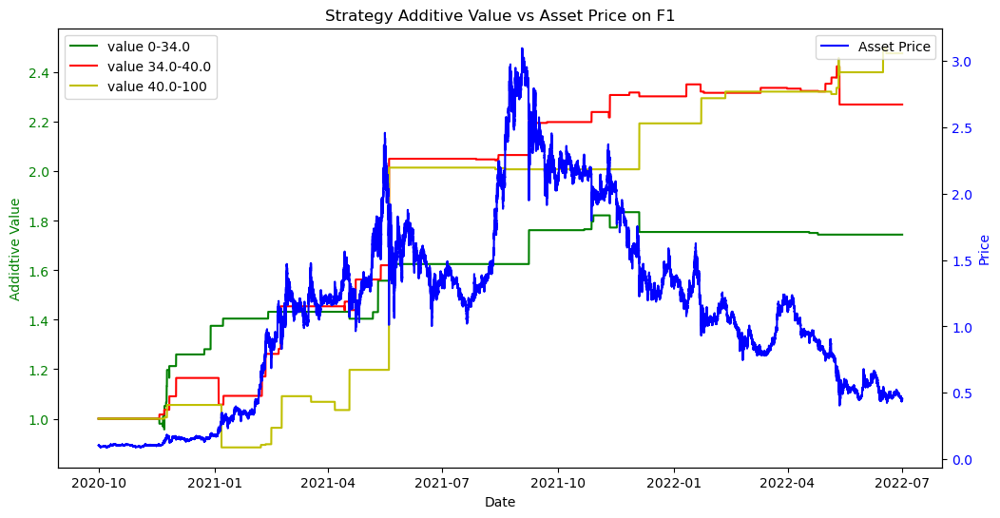

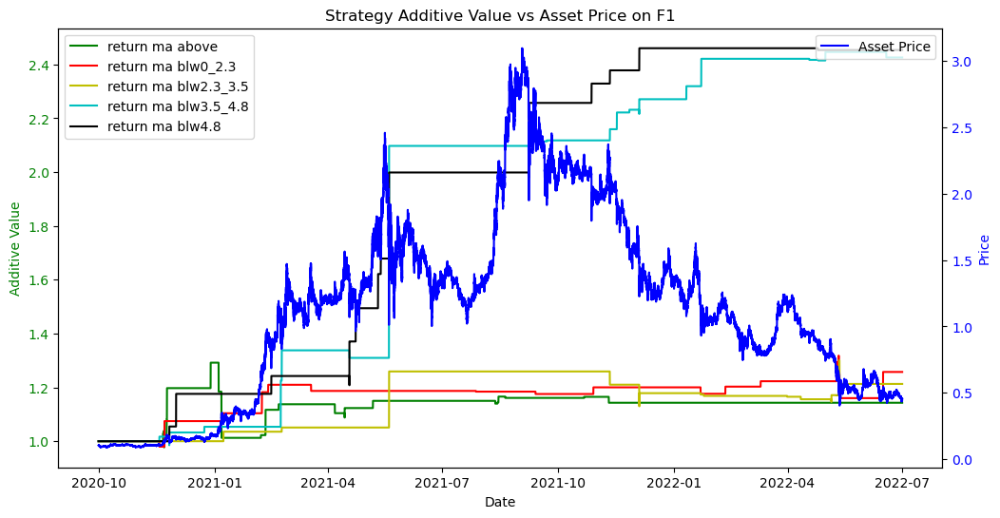

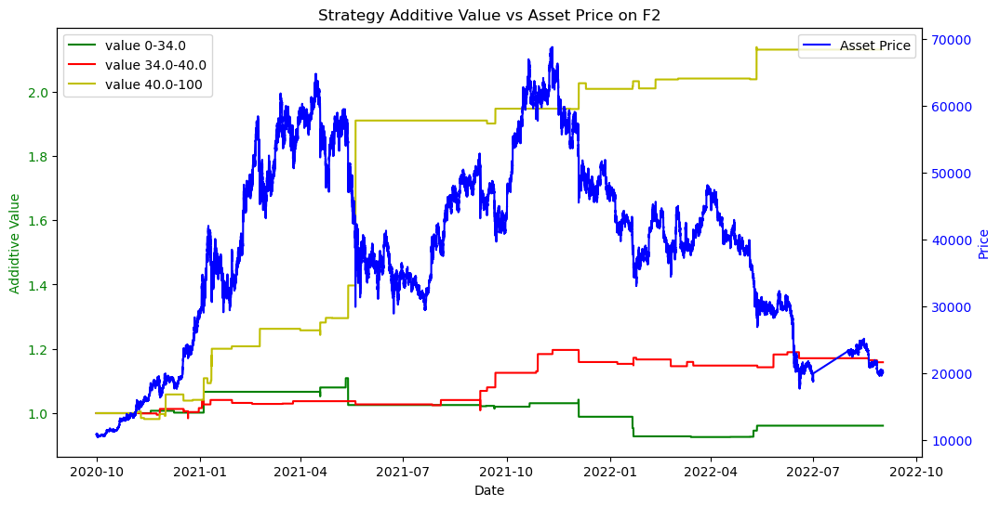

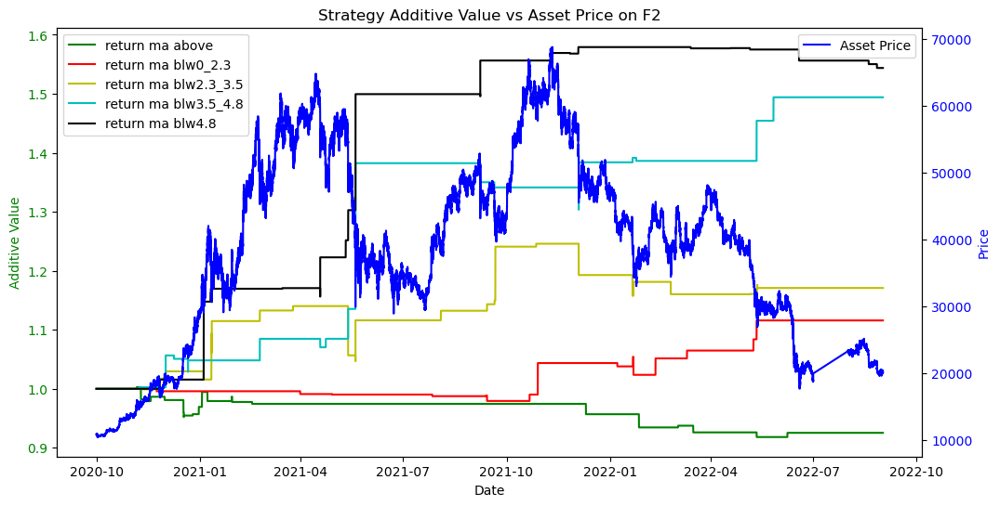

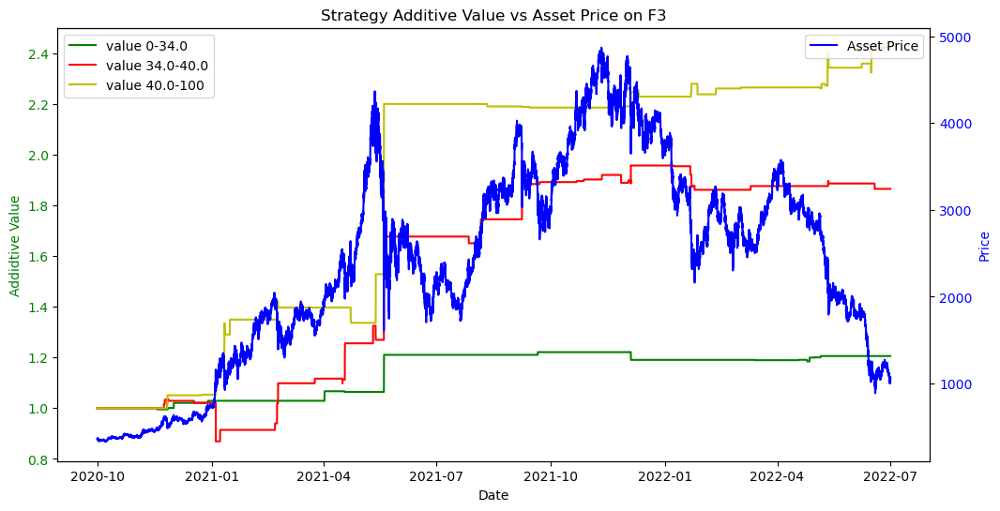

...

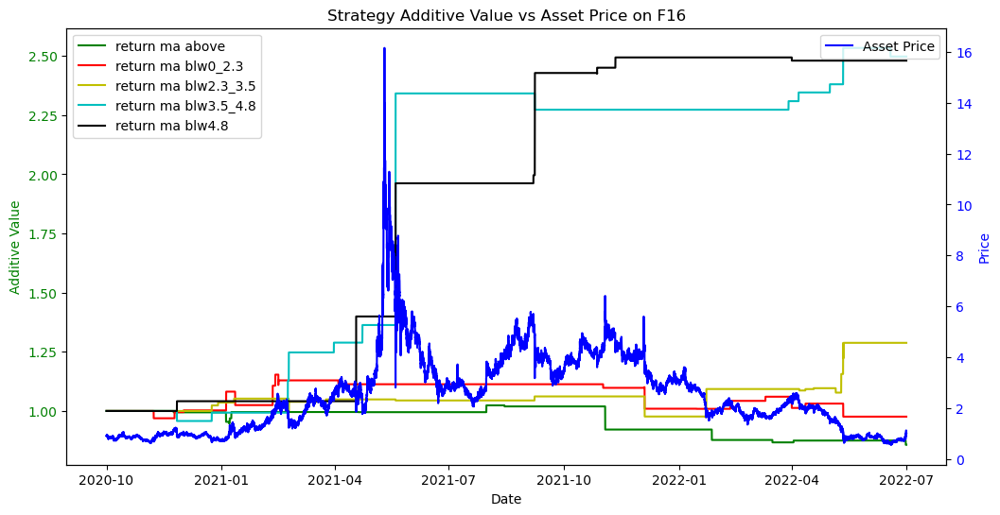

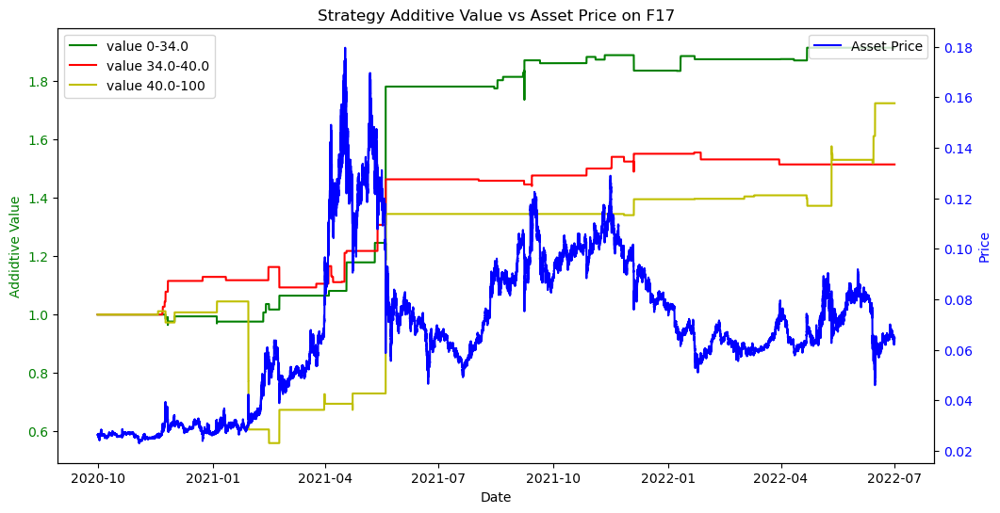

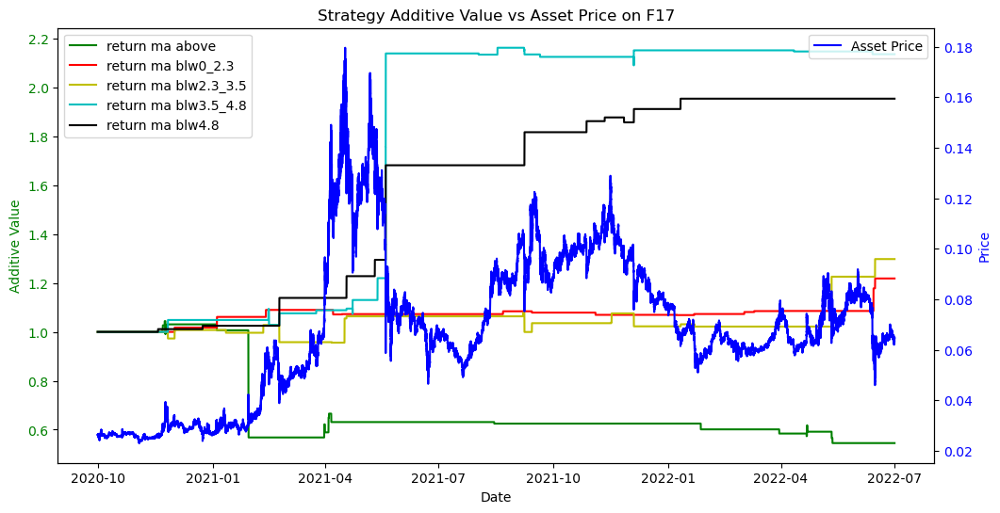

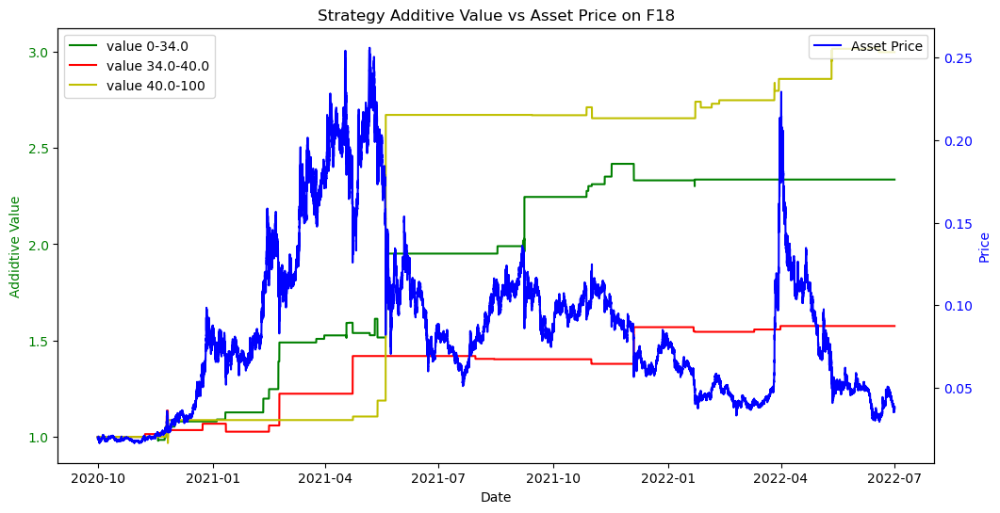

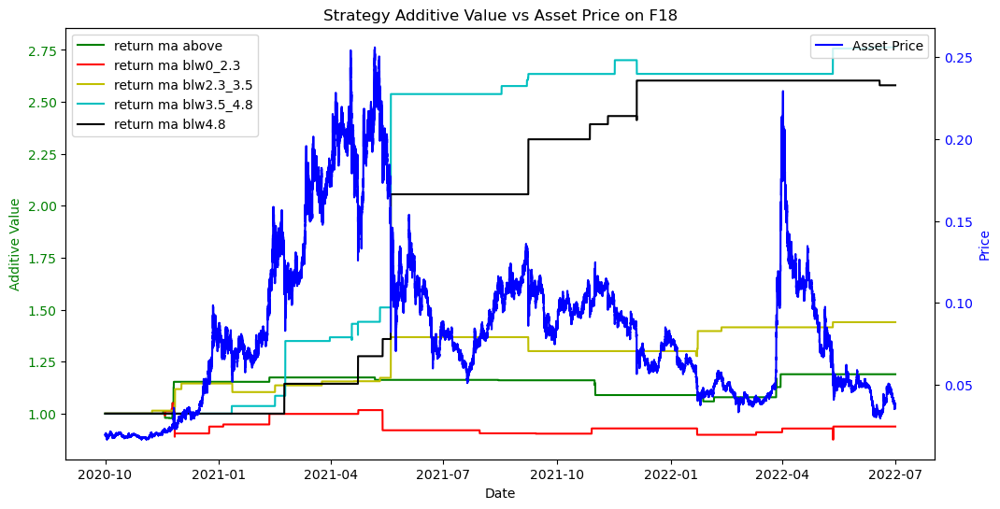

In [348]:
return_df0 = pd.DataFrame()
return_df1 = pd.DataFrame()
return_df2 = pd.DataFrame()
# ret_ma_df00 = pd.DataFrame() # no extreme analysis
ret_ma_df0 = pd.DataFrame()
ret_ma_df1 = pd.DataFrame()
ret_ma_df2 = pd.DataFrame()
ret_ma_df3 = pd.DataFrame()
ret_ma_df4 = pd.DataFrame()
ret_rank_df0 = pd.DataFrame()
ret_rank_df1 = pd.DataFrame()
ret_rank_df2 = pd.DataFrame()
for ele in strategy8_2_list:
    des0,des1,des2 =  ele.find_signal_8_2_addition(fee=1/1000, rule = [0.34,0.40])
    des_ma0, des_ma1, des_ma2,des_ma3, des_ma4 = ele.find_signal_8_2_addition_ma(fee = 1/1000) # des_ma00, no extreme analysis
    des_rank0, des_rank1, des_rank2 = ele.find_signal_8_2_addition_tbv_rank(1/1000, [0.1,0.2])
    if return_df0.empty:
        return_df0 = des0
        return_df1 = des1 
        return_df2 = des2
        #ret_ma_df00 = des_ma00
        ret_ma_df0 = des_ma0
        ret_ma_df1 = des_ma1
        ret_ma_df2 = des_ma2
        ret_ma_df3 = des_ma3 
        ret_ma_df4 = des_ma4 
        ret_rank_df0 = des_rank0
        ret_rank_df1 = des_rank1
        ret_rank_df2 = des_rank2
    else:
        return_df0 = return_df0.join(des0)
        return_df1 = return_df1.join(des1) 
        return_df2 = return_df2.join(des2)
        #ret_ma_df00 = ret_ma_df00.join(des_ma00)
        ret_ma_df0 = ret_ma_df0.join(des_ma0)
        ret_ma_df1 = ret_ma_df1.join(des_ma1)
        ret_ma_df2 = ret_ma_df2.join(des_ma2)
        ret_ma_df3 = ret_ma_df3.join(des_ma3)
        ret_ma_df4 = ret_ma_df4.join(des_ma4)
        ret_rank_df0 = ret_rank_df0.join(des_rank0)
        ret_rank_df1 = ret_rank_df1.join(des_rank1)
        ret_rank_df2 = ret_rank_df2.join(des_rank2)
    print('\n')

## 3D plot

In [349]:
import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = 'browser'


no clear pattern in tbv/tv

In [364]:
X = []
Y = []
Z = []
for ele in strategy8_2_list:
    ele.data['ma_pos'] = (ele.data['close'] - ele.data['ma_300'])/ele.data['ma_300_std']
    x = ele.data['ma_pos'][ele.data['signal']>0]
    y = ele.data['tbv/tv'][ele.data['signal']>0]
    z = ele.data['strategy_ret'][ele.data['trade']>0]
    X = X+x.to_list()
    Y = Y +y.to_list()
    # Z.append(z.to_list())
    Z += z.to_list()

fig1 = go.Figure(data = [go.Scatter3d(z=Z, x=X, y=Y, mode='markers',
    marker=dict(
        size=3,
        color=Z,  # set color to the return values
        colorscale='Viridis',
        opacity=0.8
    ))])
fig1.update_layout(
    title = 'MA and TBV/TV vs Return',
    scene=dict(
        xaxis_title = 'MA position',
        yaxis_title = 'TBV/TV',
        zaxis_title = 'Return'
    )
)
fig1.show()
plot_df1 = pd.DataFrame(np.array([X,Y,Z]).T, columns =['相对均线位置', '主动买入占比', '交易未来收益'])


In [354]:
strategy8_2_list[0].data.columns

Index(['open_time', 'open', 'high', 'low', 'close', 'volume', 'close_time',
       'quote_volume', 'count', 'taker_buy_volume', 'taker_buy_quote_volume',
       'ignore', 'ret', 'strategy_ret', 'time_diff', 'avg_price', 'abs_ret',
       'signal', 'trade', 'EntryPrice', 'ExitPrice', 'EntryTime', 'ExitTime',
       'strategy_value_add', 'strategy_value_comp', 'tbv_rank', 'tbv/tv',
       'tbv_pct_rank', 'ma_300', 'ma_300_std', 'above', 'blw0_2.3',
       'blw2.3_3.5', 'blw3.5_4.8', 'blw4.8', 'tbv0_33', 'trade0_33',
       'tbv33_66', 'trade33_66', 'tbv66_100', 'trade66_100', 'ret0_33',
       'value0_33', 'ret33_66', 'value33_66', 'ret66_100', 'value66_100',
       'ma_above', 'trade_above', 'ma_blw0_2.3', 'trade_blw0_2.3',
       'ma_blw2.3_3.5', 'trade_blw2.3_3.5', 'ma_blw3.5_4.8',
       'trade_blw3.5_4.8', 'ma_blw4.8', 'trade_blw4.8', 'ret_above',
       'ret_blw0_2.3', 'ret_blw2.3_3.5', 'ret_blw3.5_4.8', 'ret_blw4.8',
       'tbv_rank0_33', 'trade_rank0_33', 'tbv_rank33_66', 'trade

The signal tends to appear when TBV_rank is high.

In [365]:
# taker buy volume rank
X = []
Y = []
Z = []
for ele in strategy8_2_list:
    ele.data['ma_pos'] = (ele.data['close'] - ele.data['ma_300'])/ele.data['ma_300_std']
    x = ele.data['ma_pos'][ele.data['signal']>0]
    y = ele.data['tbv_rank'][ele.data['signal']>0]
    z = ele.data['strategy_ret'][ele.data['trade']>0]
    X = X+x.to_list()
    Y = Y +y.to_list()
    # Z.append(z.to_list())
    Z += z.to_list()

fig2 = go.Figure(data = [go.Scatter3d(z=Z, x=X, y=Y, mode='markers',
    marker=dict(
        size=3,
        color=Z,  # set color to the return values
        colorscale='Viridis',
        opacity=0.8
    ))])
fig2.update_layout(
    title = 'MA and TBV Rank vs Return',
    scene=dict(
        xaxis_title = 'MA position',
        yaxis_title = 'TBV rank',
        zaxis_title = 'Return'
    )
)
fig2.show()
plot_df2 = pd.DataFrame(np.array([X,Y,Z]).T, columns =['相对均线位置', '主动买入分位数', '交易未来收益'])



The signal tends to appear when tbv/tv's rank is low. 

In [366]:
# taker buy volume pct rank
X = []
Y = []
Z = []
for ele in strategy8_2_list:
    ele.data['ma_pos'] = (ele.data['close'] - ele.data['ma_300'])/ele.data['ma_300_std']
    x = ele.data['ma_pos'][ele.data['signal']>0]
    y = ele.data['tbv_pct_rank'][ele.data['signal']>0]
    z = ele.data['strategy_ret'][ele.data['trade']>0]
    X = X+x.to_list()
    Y = Y +y.to_list()
    # Z.append(z.to_list())
    Z += z.to_list()

fig3 = go.Figure(data = [go.Scatter3d(z=Z, x=X, y=Y, mode='markers',
    marker=dict(
        size=3,
        color=Z,  # set color to the return values
        colorscale='Viridis',
        opacity=0.8
    ))])
fig3.update_layout(
    title = 'MA and TBV/TV Rank vs Return',
    scene=dict(
        xaxis_title = 'MA position',
        yaxis_title = 'TBV_pct rank',
        zaxis_title = 'Return'
    )
)
fig3.show()
plot_df3 = pd.DataFrame(np.array([X,Y,Z]).T, columns =['相对均线位置', '主动买入占比分位数', '交易未来收益'])



In [390]:
fig1.write_html(r"D:\Projects\MeanReversionStra\3d_scatter_tbvpct_ma.html")
fig2.write_html(r"D:\Projects\MeanReversionStra\3d_scatter_tbvrank_ma.html")
fig3.write_html(r"D:\Projects\MeanReversionStra\3d_scatter_tbvpctrank_ma.html")

In [367]:
# save in excel
with pd.ExcelWriter('三维图像数据.xlsx') as writer:
    plot_df1.to_excel(writer, sheet_name='主动买入占比')
    plot_df2.to_excel(writer, sheet_name='主动买入分位数')
    plot_df3.to_excel(writer, sheet_name='主动买入占比分位数')


## MA position & TBV/TV

In [369]:
# stra = strategy8_2_list[0]
ma_pos_list = ['ma_above', 'ma_blw0_2.3', 'ma_blw2.3_3.5', 'ma_blw3.5_4.8', 'ma_blw4.8']
tbv_tv_list = ['tbv0_33', 'tbv33_66','tbv66_100']

ret_comb_df0 = pd.DataFrame()
ret_comb_df1 = pd.DataFrame()
ret_comb_df2= pd.DataFrame()
ret_comb_df3 = pd.DataFrame()
ret_comb_df4 = pd.DataFrame()
ret_comb_df5 = pd.DataFrame()
ret_comb_df6 = pd.DataFrame()
ret_comb_df7 = pd.DataFrame()
ret_comb_df8 = pd.DataFrame()

for stra in strategy8_2_list:
    stra.data['abv_tbv0_34'] = stra.data['signal']*((stra.data['ma_above']>0) & (stra.data['tbv0_33']>0))
    stra.data['blw0_3.5_tbv0_34'] = stra.data['signal']*((stra.data['ma_blw0_2.3']>0) |(stra.data['ma_blw2.3_3.5']>0) & (stra.data['tbv0_33']>0))
    stra.data['blw3.5_tbv0_34'] = stra.data['signal']*((stra.data['ma_blw3.5_4.8']>0) |(stra.data['ma_blw4.8']>0) & (stra.data['tbv0_33']>0))
    
    stra.data['abv_tbv34_40'] = stra.data['signal']*((stra.data['ma_above']>0) & (stra.data['tbv33_66']>0))
    stra.data['blw0_3.5_tbv34_40'] = stra.data['signal']*((stra.data['ma_blw0_2.3']>0) |(stra.data['ma_blw2.3_3.5']>0) & (stra.data['tbv33_66']>0))
    stra.data['blw3.5_tbv34_40'] = stra.data['signal']*((stra.data['ma_blw3.5_4.8']>0) |(stra.data['ma_blw4.8']>0) & (stra.data['tbv33_66']>0))
    
    stra.data['abv_tbv40_100'] = stra.data['signal']*((stra.data['ma_above']>0) & (stra.data['tbv66_100']>0))
    stra.data['blw0_3.5_tbv40_100'] = stra.data['signal']*((stra.data['ma_blw0_2.3']>0) |(stra.data['ma_blw2.3_3.5']>0) & (stra.data['tbv66_100']>0))
    stra.data['blw3.5_tbv40_100'] = stra.data['signal']*((stra.data['ma_blw3.5_4.8']>0) |(stra.data['ma_blw4.8']>0) & (stra.data['tbv66_100']>0))
    
    # return
    stra.data['ret_abv_tbv0_34'] = stra.data['abv_tbv0_34'].shift(1)*stra.data['strategy_ret']
    stra.data['ret_blw0_3.5_tbv0_34'] = stra.data['blw0_3.5_tbv0_34'].shift(1)*stra.data['strategy_ret']
    stra.data['ret_blw3.5_tbv0_34'] = stra.data['blw3.5_tbv0_34'].shift(1)*stra.data['strategy_ret'] 
    
    stra.data['ret_abv_tbv34_40'] =stra.data['abv_tbv34_40'].shift(1)*stra.data['strategy_ret'] 
    stra.data['ret_blw0_3.5_tbv34_40'] =stra.data['blw0_3.5_tbv34_40'].shift(1)*stra.data['strategy_ret'] 
    stra.data['ret_blw3.5_tbv34_40'] =stra.data['blw3.5_tbv34_40'].shift(1)*stra.data['strategy_ret']  
    
    stra.data['ret_abv_tbv40_100'] =stra.data['abv_tbv40_100'].shift(1)*stra.data['strategy_ret'] 
    stra.data['ret_blw0_3.5_tbv40_100'] =stra.data['blw0_3.5_tbv40_100'].shift(1)*stra.data['strategy_ret'] 
    stra.data['ret_blw3.5_tbv40_100'] =stra.data['blw3.5_tbv40_100'].shift(1)*stra.data['strategy_ret']  
    
    # des
    des0 = stra.data[['ret_abv_tbv0_34']][stra.data['abv_tbv0_34'].shift(1)>0].astype('float').describe()
    des0.columns = [stra.asset]
    des1 = stra.data[['ret_blw0_3.5_tbv0_34']][stra.data['blw0_3.5_tbv0_34'].shift(1)>0].astype('float').describe()
    des1.columns = [stra.asset]
    des2 = stra.data[['ret_blw3.5_tbv0_34']][stra.data['blw3.5_tbv0_34'].shift(1)>0].astype('float').describe()
    des2.columns = [stra.asset]
    des3 = stra.data[['ret_abv_tbv34_40']][stra.data['abv_tbv34_40'].shift(1)>0].astype('float').describe()
    des3.columns = [stra.asset]
    des4 = stra.data[['ret_blw0_3.5_tbv34_40']][stra.data['blw0_3.5_tbv34_40'].shift(1)>0].astype('float').describe()
    des4.columns = [stra.asset]
    des5 = stra.data[['ret_blw3.5_tbv34_40']][stra.data['blw3.5_tbv34_40'].shift(1)>0].astype('float').describe()
    des5.columns = [stra.asset]
    des6 = stra.data[['ret_abv_tbv40_100']][stra.data['abv_tbv40_100'].shift(1)>0].astype('float').describe()
    des6.columns = [stra.asset]
    des7 = stra.data[['ret_blw0_3.5_tbv40_100']][stra.data['blw0_3.5_tbv40_100'].shift(1)>0].astype('float').describe()
    des7.columns = [stra.asset]
    des8 = stra.data[['ret_blw3.5_tbv40_100']][stra.data['blw3.5_tbv40_100'].shift(1)>0].astype('float').describe()
    des8.columns = [stra.asset]
    if ret_comb_df0.empty:
        ret_comb_df0 = des0
        ret_comb_df1 = des1
        ret_comb_df2= des2
        ret_comb_df3 = des3
        ret_comb_df4 = des4
        ret_comb_df5 = des5
        ret_comb_df6 = des6
        ret_comb_df7 = des7
        ret_comb_df8 = des8
    else:
        ret_comb_df0 = ret_comb_df0.join(des0)
        ret_comb_df1 = ret_comb_df1.join(des1)
        ret_comb_df2 = ret_comb_df2.join(des2)
        ret_comb_df3 = ret_comb_df3.join(des3)
        ret_comb_df4 = ret_comb_df4.join(des4)
        ret_comb_df5 = ret_comb_df5.join(des5)
        ret_comb_df6 = ret_comb_df6.join(des6)
        ret_comb_df7 = ret_comb_df7.join(des7)
        ret_comb_df8 = ret_comb_df8.join(des8)
        
        

In [370]:
# combine stragtey 8.2 taker buy volume/total volume and ma position
comb_return_list = [ret_comb_df0,ret_comb_df1,ret_comb_df2,ret_comb_df3,ret_comb_df4,ret_comb_df5,ret_comb_df6,ret_comb_df7,ret_comb_df8]
category_list = [
'abv_tbv0_34',
'blw0_3.5_tbv0_34',
'blw3.5_tbv0_34',
'abv_tbv34_40',
'blw0_3.5_tbv34_40',
'blw3.5_tbv34_40',
'abv_tbv40_100',
'blw0_3.5_tbv40_100',
'blw3.5_tbv40_100']
# add title 
for idx in range(len(comb_return_list)):
    comb_return_list[idx] = pd.concat([pd.DataFrame({'Strategy 8': ['Strategy 2'] }, index=[category_list[idx]]),comb_return_list[idx]],axis=0)
    comb_return_list[idx]['sum'] = comb_return_list[idx].loc['count', :].sum()

# combine df
comb_combine_df = pd.concat(comb_return_list,axis = 0)
comb_combine_df

,Strategy 8,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,F16,F17,F18,sum
abv_tbv0_34,Strategy 2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.0
count,NaN,11.000000,1.000000,1.000000,5.000000,6.000000,1.000000,5.000000,6.000000,0.000000,2.000000,3.000000,4.000000,6.000000,5.000000,8.000000,5.000000,7.000000,6.000000,82.0
mean,NaN,0.022530,0.007437,-0.004520,0.006623,0.021122,0.020414,0.019390,0.015341,NaN,0.012030,0.000599,-0.006313,-0.007623,-0.002873,0.012730,0.001079,0.002967,0.009246,82.0
std,NaN,0.040285,NaN,NaN,0.045660,0.036696,NaN,0.030451,0.032391,NaN,0.010920,0.013892,0.038008,0.020811,0.025550,0.043463,0.014755,0.022234,0.029897,82.0
min,NaN,-0.061071,0.007437,-0.004520,-0.067308,-0.025986,0.020414,-0.020550,-0.030544,NaN,0.004308,-0.015247,-0.031748,-0.026067,-0.040541,-0.053120,-0.010232,-0.024184,-0.031070,82.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
min,NaN,-0.032386,-0.037621,-0.035094,-0.108420,-0.114859,-0.068969,-0.064391,-0.081363,-0.280012,-0.088254,-0.053401,-0.061398,-0.079431,-0.017453,-0.119166,-0.068781,-0.059181,-0.065961,478.0
25%,NaN,0.003246,-0.005194,0.002439,-0.001255,-0.001437,-0.009006,-0.002073,-0.011633,0.013561,-0.003306,-0.001628,0.027307,-0.006809,0.008940,0.012640,0.034916,-0.010903,0.018895,478.0
50%,NaN,0.047381,0.015662,0.024275,0.018820,0.019295,0.025160,0.023251,0.021247,0.044449,0.020909,0.023008,0.058306,0.036176,0.044475,0.033549,0.041419,0.011656,0.050648,478.0
75%,NaN,0.074818,0.050584,0.064840,0.079904,0.055641,0.068542,0.063922,0.088945,0.119551,0.050618,0.093235,0.094654,0.193854,0.080720,0.103717,0.144115,0.055855,0.086702,478.0


In [371]:
with pd.ExcelWriter('均线和主动买入占比整合统计.xlsx') as writer:
    comb_combine_df.to_excel(writer, sheet_name='均线和主动买入占比整合统计')

## Linear Regression: Relation between signal return and future return

In [372]:
from sklearn.linear_model import LinearRegression

In [373]:
strategy8_2_list[0].data.columns

Index(['open_time', 'open', 'high', 'low', 'close', 'volume', 'close_time',
       'quote_volume', 'count', 'taker_buy_volume', 'taker_buy_quote_volume',
       'ignore', 'ret', 'strategy_ret', 'time_diff', 'avg_price', 'abs_ret',
       'signal', 'trade', 'EntryPrice', 'ExitPrice', 'EntryTime', 'ExitTime',
       'strategy_value_add', 'strategy_value_comp', 'tbv_rank', 'tbv/tv',
       'tbv_pct_rank', 'ma_300', 'ma_300_std', 'above', 'blw0_2.3',
       'blw2.3_3.5', 'blw3.5_4.8', 'blw4.8', 'tbv0_33', 'trade0_33',
       'tbv33_66', 'trade33_66', 'tbv66_100', 'trade66_100', 'ret0_33',
       'value0_33', 'ret33_66', 'value33_66', 'ret66_100', 'value66_100',
       'ma_above', 'trade_above', 'ma_blw0_2.3', 'trade_blw0_2.3',
       'ma_blw2.3_3.5', 'trade_blw2.3_3.5', 'ma_blw3.5_4.8',
       'trade_blw3.5_4.8', 'ma_blw4.8', 'trade_blw4.8', 'ret_above',
       'ret_blw0_2.3', 'ret_blw2.3_3.5', 'ret_blw3.5_4.8', 'ret_blw4.8',
       'tbv_rank0_33', 'trade_rank0_33', 'tbv_rank33_66', 'trade

In [374]:
# Plot for all assets 
signal_ret_all = []
future_ret_all = []
for i in range(len(strategy8_2_list)):
    stra = strategy8_2_list[i]
    x = stra.data[stra.data['signal']>0]['ret'].to_list()
    y = stra.data[stra.data['trade']>0]['strategy_ret'].to_list()
    signal_ret_all += x
    future_ret_all += y


In [375]:
X_total = np.array(signal_ret_all).reshape(-1,1)
model = LinearRegression()
model.fit(X_total, future_ret_all)
y_pred = model.predict(X_total)
slope = model.coef_[0]
intercept = model.intercept_
r_square = model.score(X_total,future_ret_all)
print(f"Slope: {slope}")
print(f"Intercept: {intercept}")
print(f"R Square: {r_square}")

Slope: -1.455501402629854
Intercept: -0.0348086068278252
R Square: 0.3670936410991682


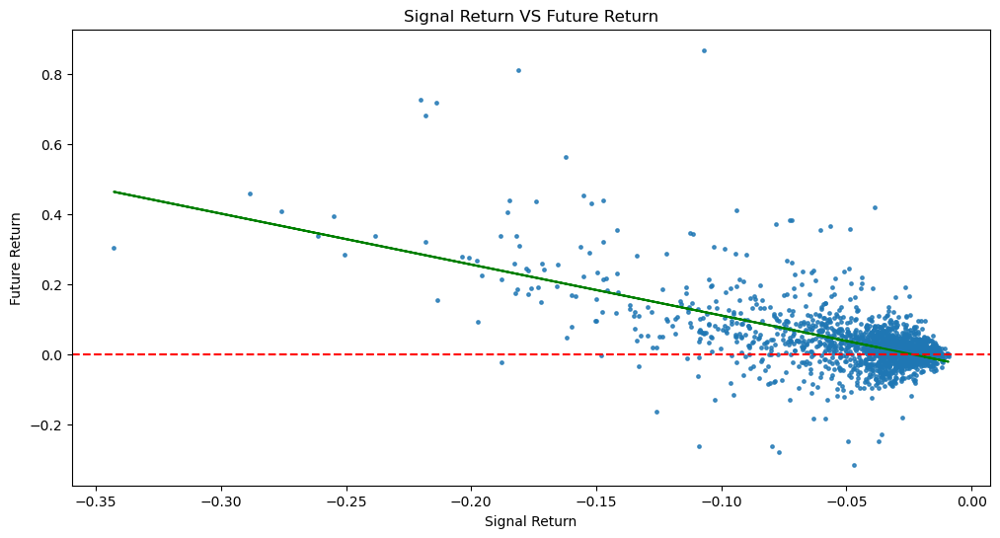

In [ ]:
plt.figure(figsize=(12,6))
plt.scatter(signal_ret_all,future_ret_all, s =6, alpha=0.8)
plt.plot(X_total, y_pred, color='g', label='Regression Line')
plt.axhline(y=0, color='red', linestyle='--')
plt.title('Signal Return VS Future Return')
plt.ylabel('Future Return')
plt.xlabel('Signal Return')
# plt.show()
# plt.savefig('regression_plot.png')

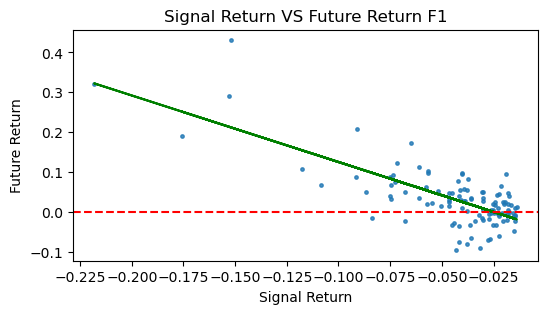

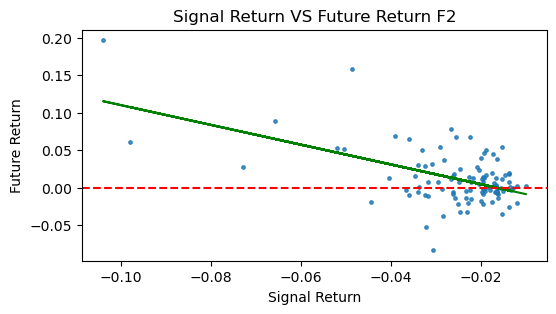

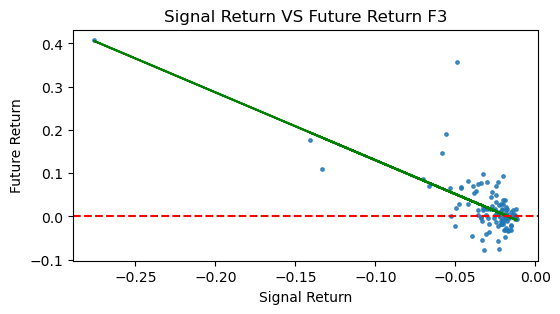

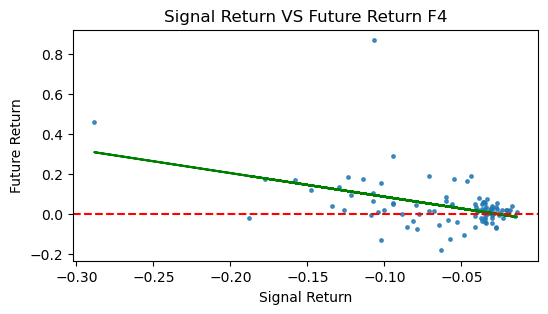

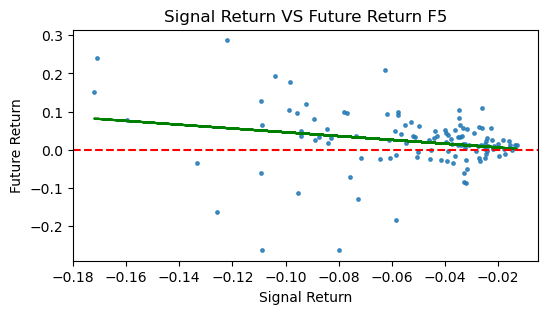

...

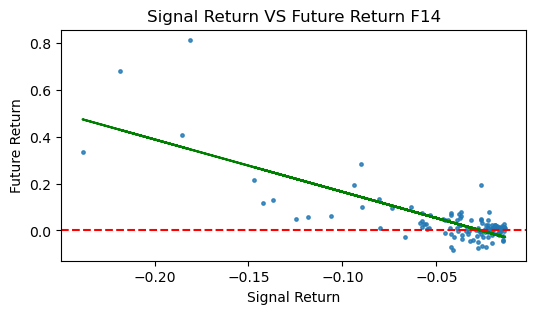

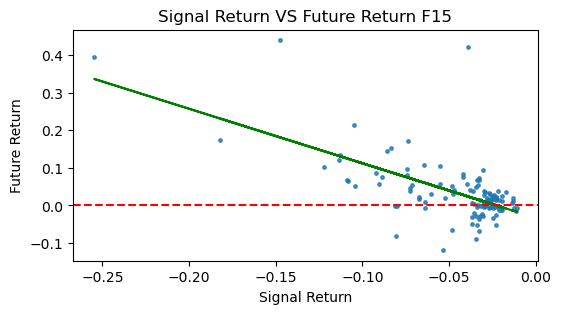

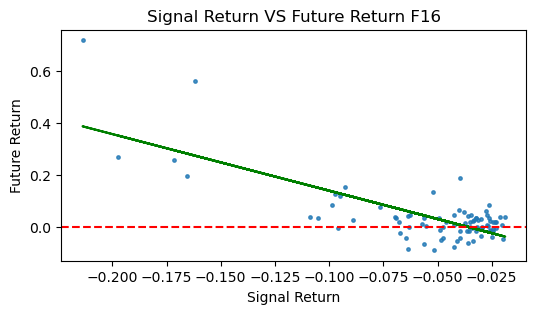

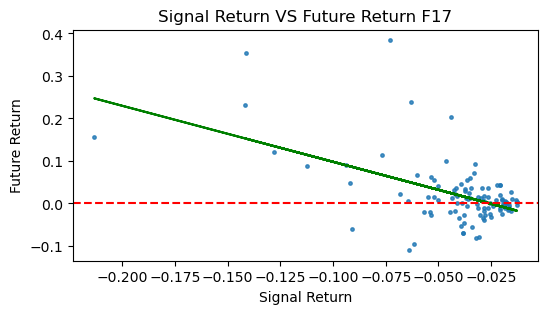

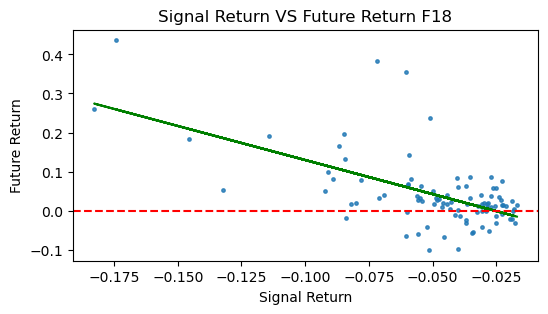

In [379]:
# Plot for each asset 
slope_list = []
intercept_list = []
r_square_list = []
for i in range(len(strategy8_2_list)):
    stra = strategy8_2_list[i]
    x = stra.data[stra.data['signal']>0]['ret'].to_list()
    y = stra.data[stra.data['trade']>0]['strategy_ret'].to_list()

    X = np.array(x).reshape(-1,1)
    model = LinearRegression()
    model.fit(X, y)
    y_pred = model.predict(X)
    slope_list.append(model.coef_[0])
    intercept_list.append(model.intercept_)
    r_square_list.append(model.score(X,y))
    
    plt.figure(figsize=(6,3))
    plt.scatter(x,y, s =6, alpha=0.8)
    plt.plot(X, y_pred, color='g', label='Regression Line')
    plt.axhline(y=0, color='red', linestyle='--')
    plt.title('Signal Return VS Future Return F'+str(i+1))
    plt.ylabel('Future Return')
    plt.xlabel('Signal Return')
    plt.show()

In [380]:
col_name = ['F'+str(i+1) for i in range(len(slope_list))]
slope_inter_df = pd.DataFrame([slope_list,intercept_list,r_square_list], columns=col_name)
slope_inter_df['Total'] = [slope, intercept, r_square]
slope_inter_df.index = ['slope', 'intercept', 'R square']
with pd.ExcelWriter('斜率和截距.xlsx') as writer:
    slope_inter_df.to_excel(writer, sheet_name='斜率和截距')

## Final Cell:  potential improvement
When MA is above 5, we dont trade.
When the asset return at signal is no less than -0.05, we dont trade. 

After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


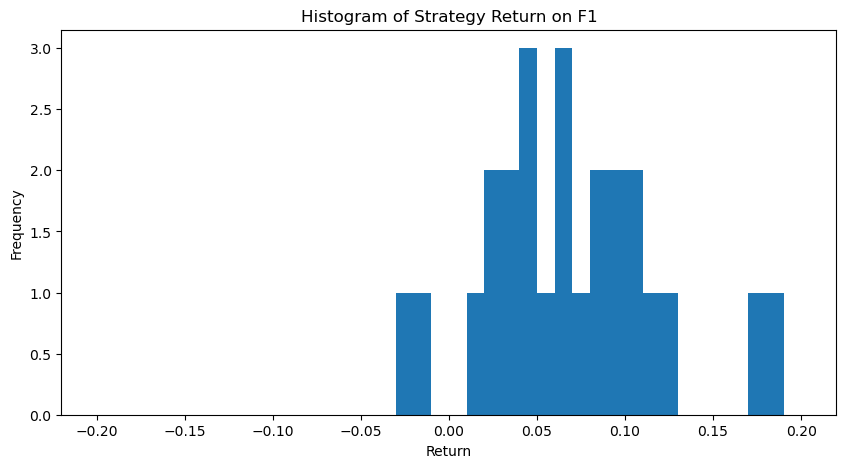

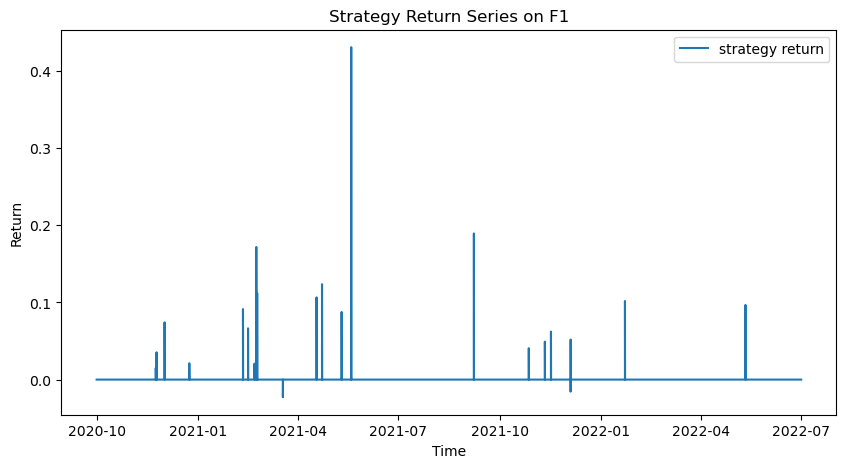

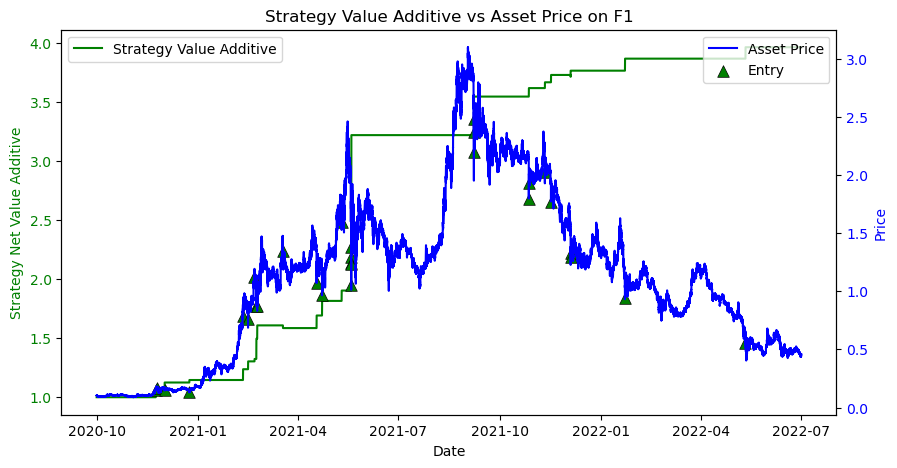

Win Prob: 93.10%
Number of Trades:  29 29
Average Win Return:   0.1112
Average Loss Return: -0.01924
P&L Ratio: 5.8
Maximum Loss of a single trade: -0.02286
Maximum Drawdown: -2.29%
Annualized Return: 117.05%
Annualized Volatility: 48.47%
Sharpe:  2.353


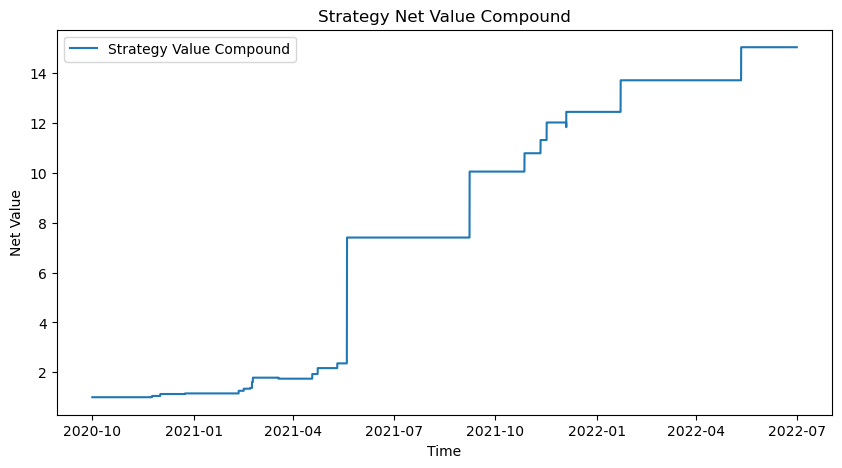

CAGR: 370.75%
Annual Return: 117.05%
Annual Volatility: 48.47%
Sharpe:  2.353


After preprocess the data has 192671 columns.
Preprocess finished
8.2 Trading signal finished


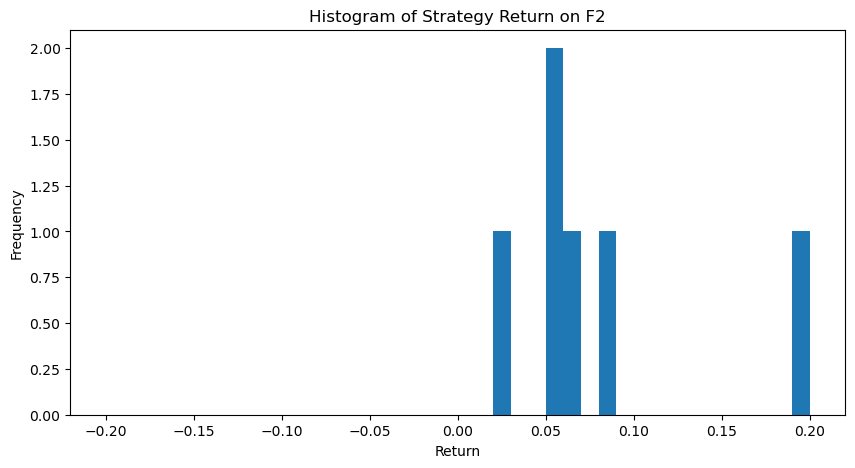

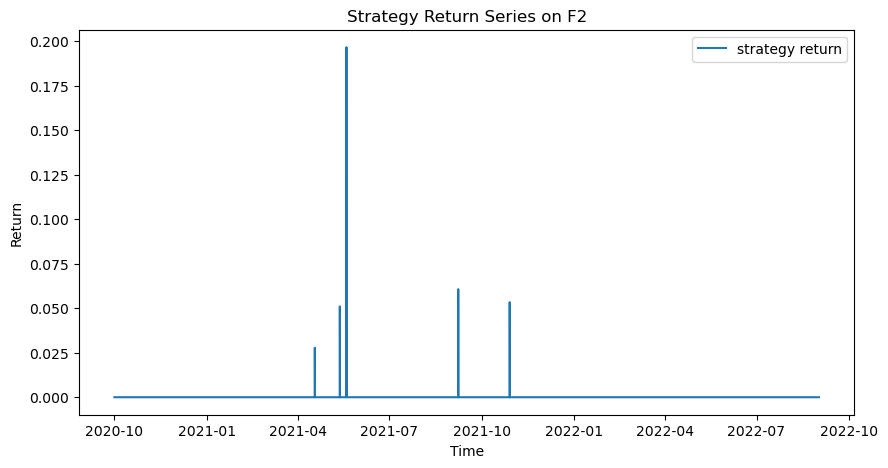

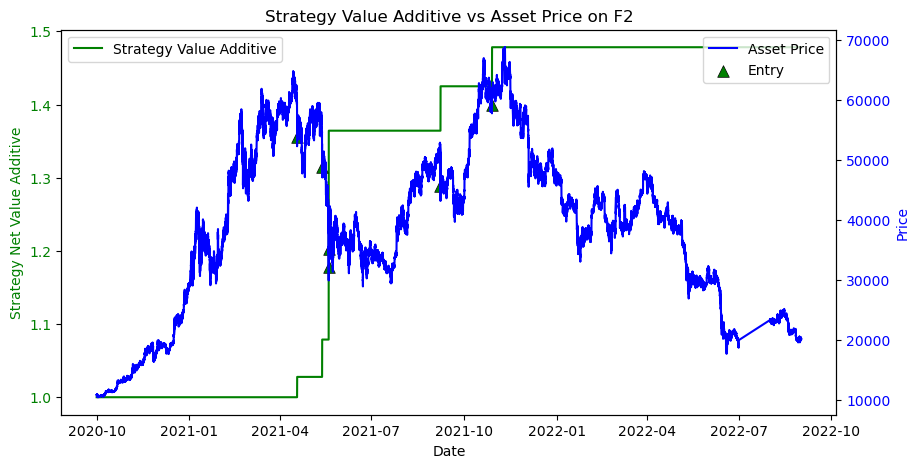

Win Prob: 100.00%
Number of Trades:  6 6
Average Win Return:   0.07972
Average Loss Return: nan
P&L Ratio: nan
Maximum Loss of a single trade: 0.0
Maximum Drawdown: 0.00%
Annualized Return: 18.02%
Annualized Volatility: 14.58%
Sharpe:  1.03


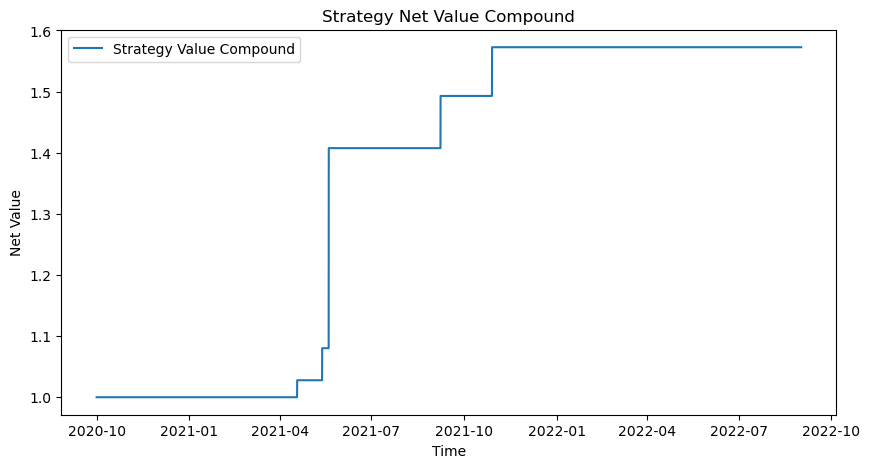

CAGR: 29.52%
Annual Return: 18.02%
Annual Volatility: 14.58%
Sharpe:  1.03


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


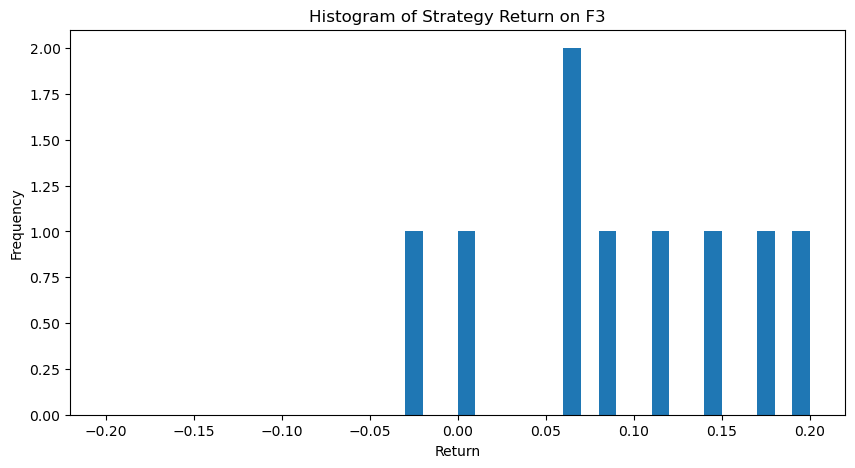

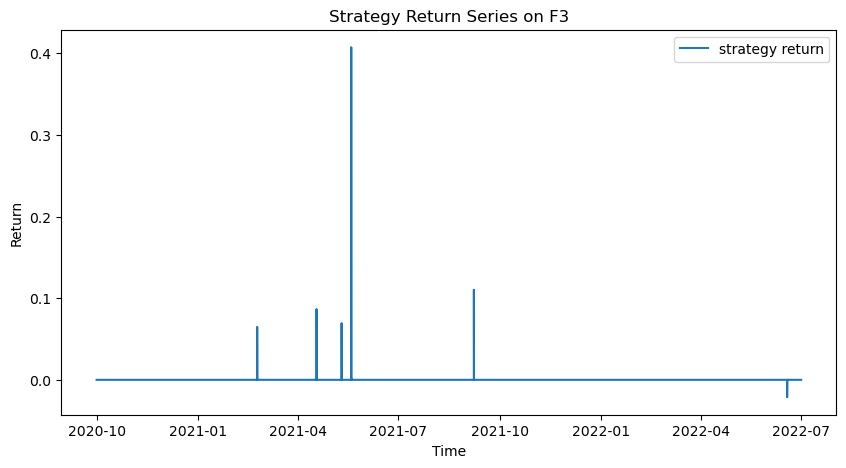

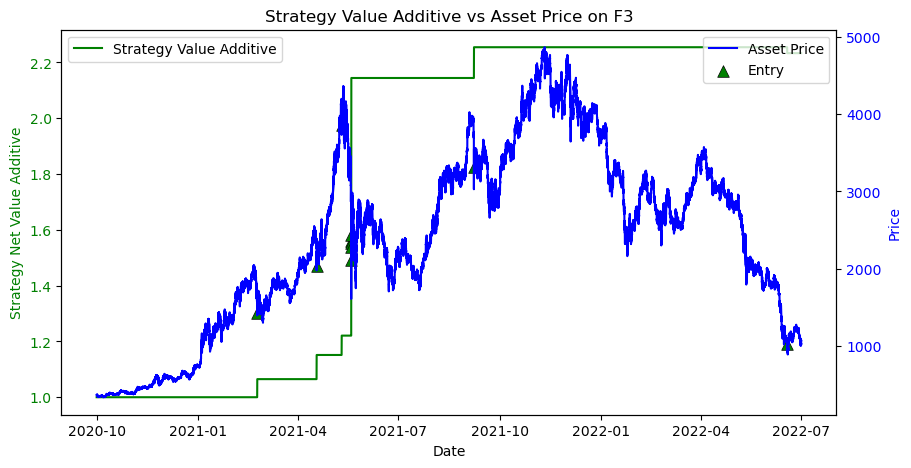

Win Prob: 90.00%
Number of Trades:  10 10
Average Win Return:   0.1394
Average Loss Return: -0.02131
P&L Ratio: 6.5
Maximum Loss of a single trade: -0.02131
Maximum Drawdown: -2.13%
Annualized Return: 48.72%
Annualized Volatility: 33.52%
Sharpe:  1.364


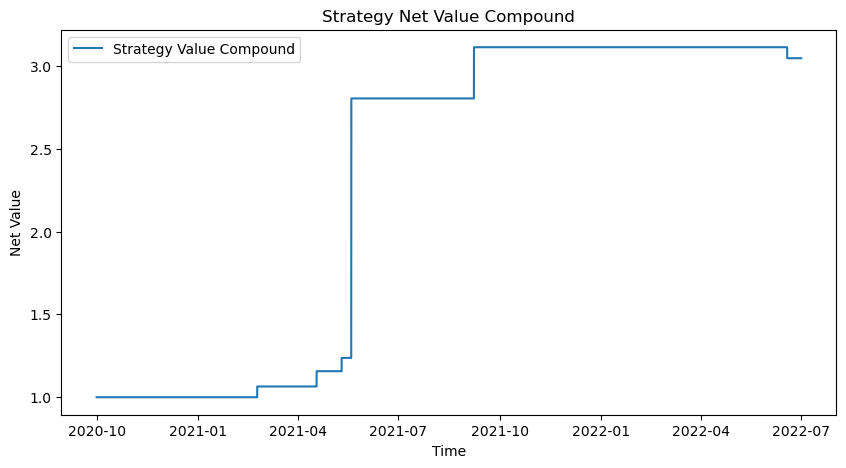

CAGR: 88.99%
Annual Return: 48.72%
Annual Volatility: 33.52%
Sharpe:  1.364


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


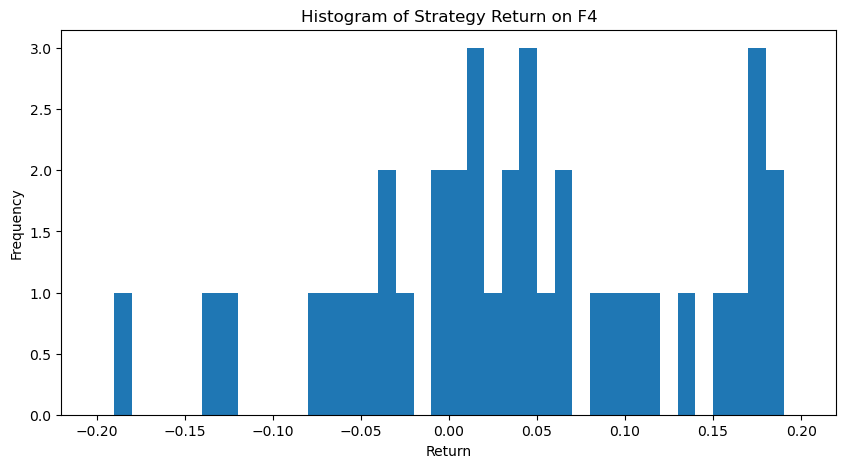

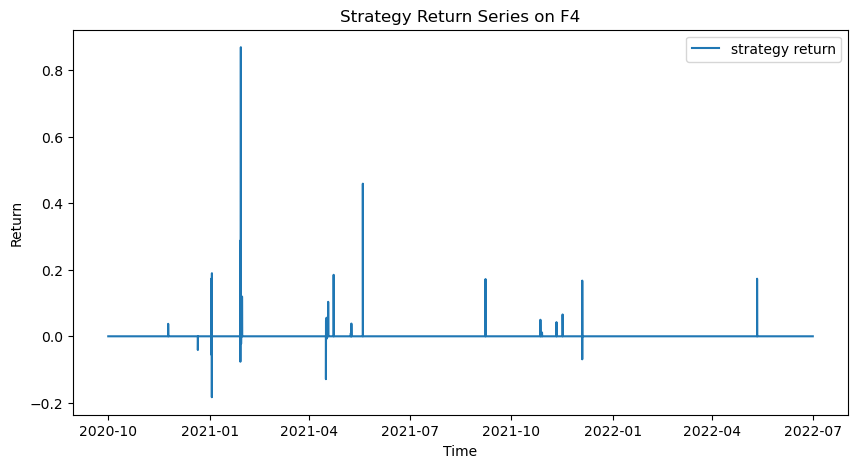

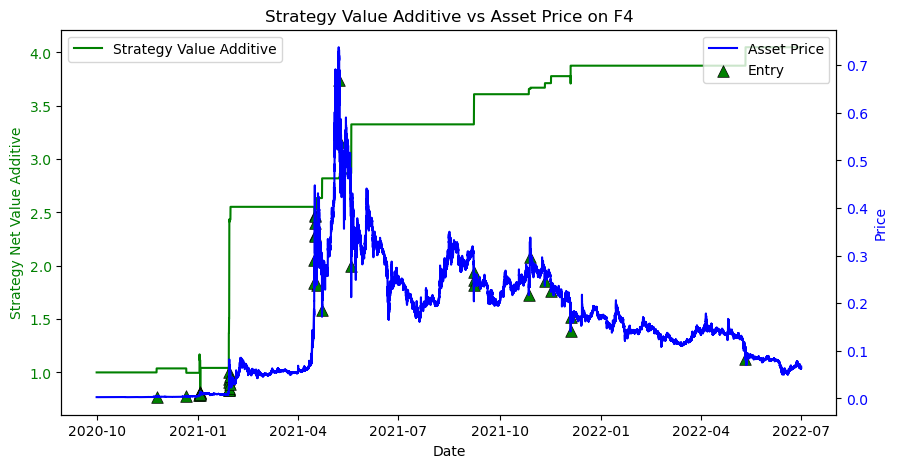

Win Prob: 70.73%
Number of Trades:  41 41
Average Win Return:   0.1322
Average Loss Return: -0.06539
P&L Ratio: 2.0
Maximum Loss of a single trade: -0.1832
Maximum Drawdown: -35.11%
Annualized Return: 120.44%
Annualized Volatility: 75.05%
Sharpe:  1.565


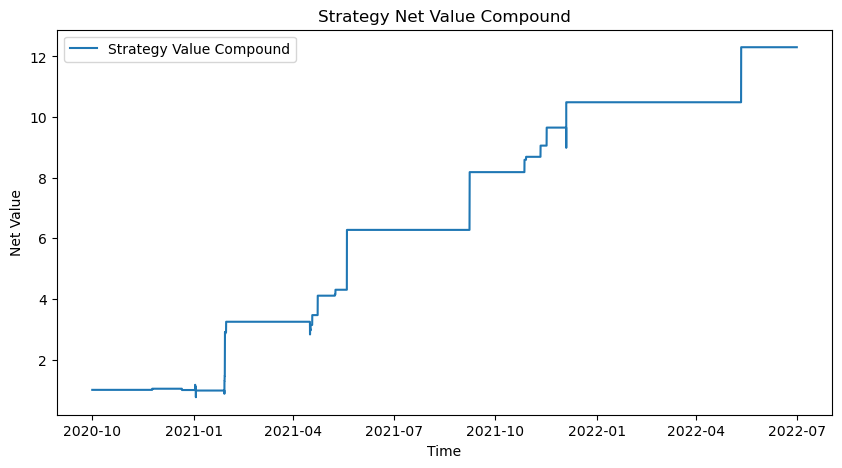

CAGR: 319.62%
Annual Return: 120.44%
Annual Volatility: 75.05%
Sharpe:  1.565


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


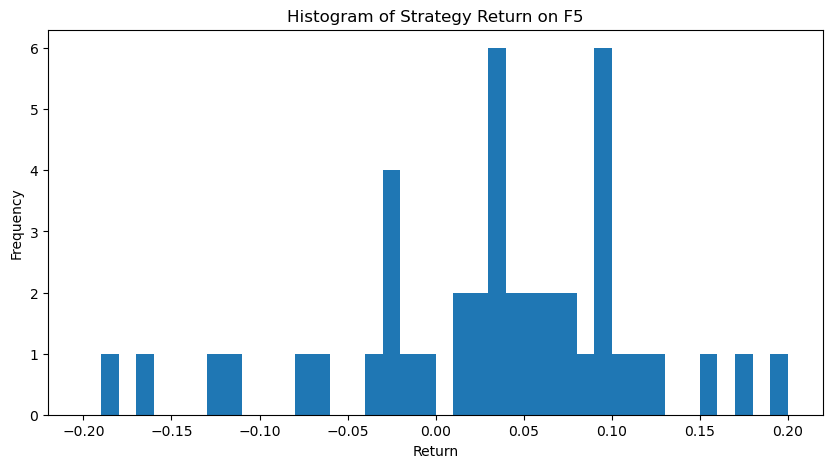

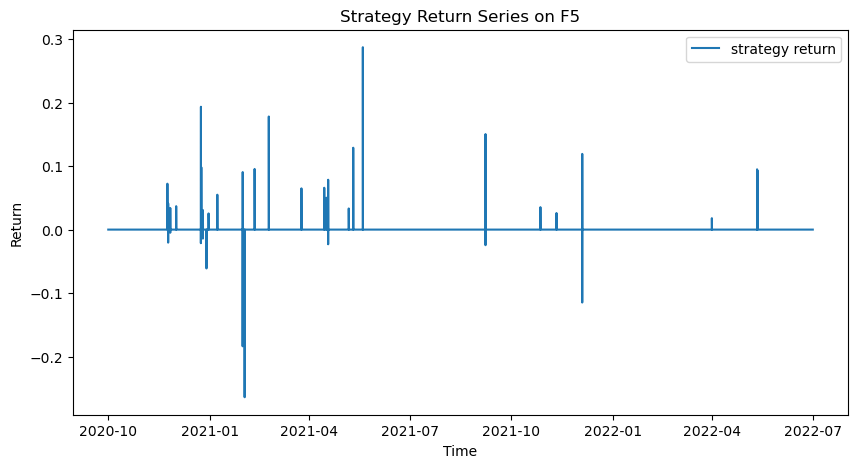

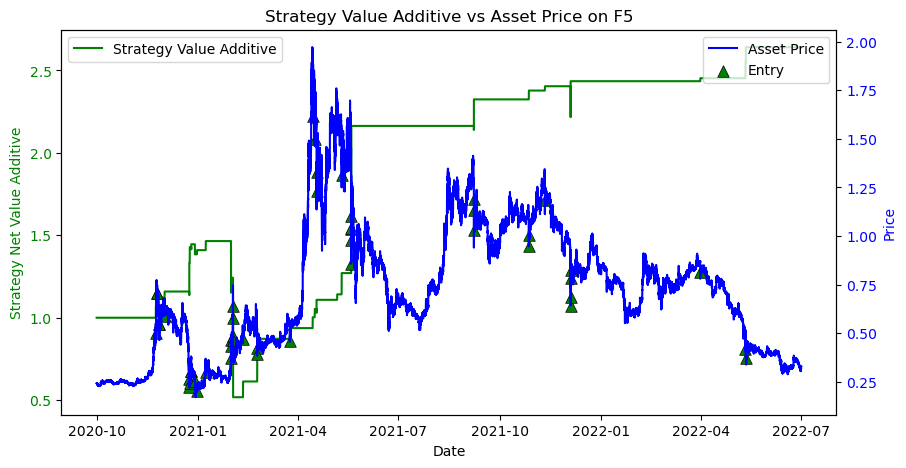

Win Prob: 69.39%
Number of Trades:  49 49
Average Win Return:   0.08928
Average Loss Return: -0.093
P&L Ratio: 0.96
Maximum Loss of a single trade: -0.264
Maximum Drawdown: -66.02%
Annualized Return: 64.81%
Annualized Volatility: 51.02%
Sharpe:  1.211


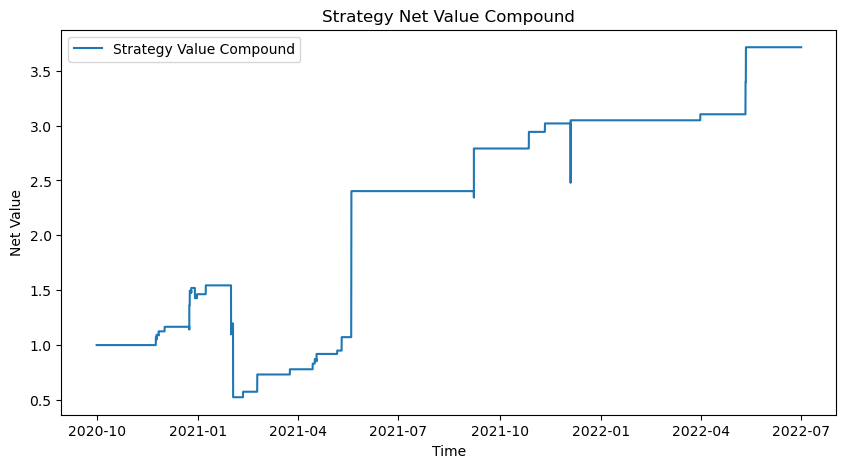

CAGR: 111.67%
Annual Return: 64.81%
Annual Volatility: 51.02%
Sharpe:  1.211


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


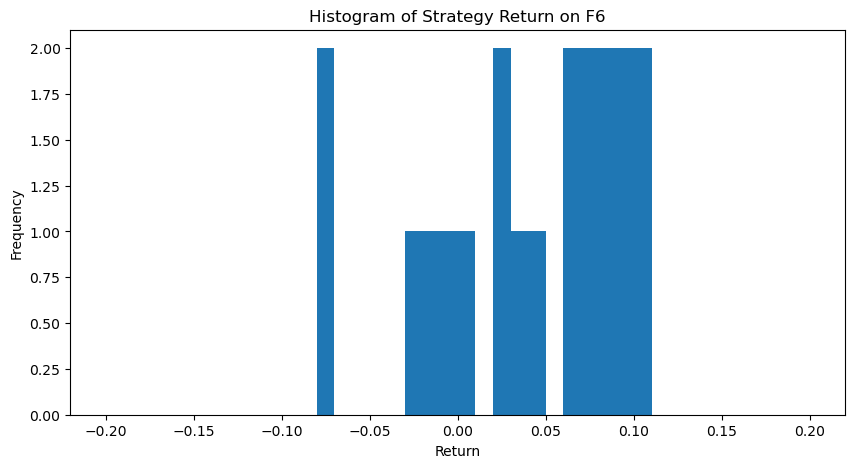

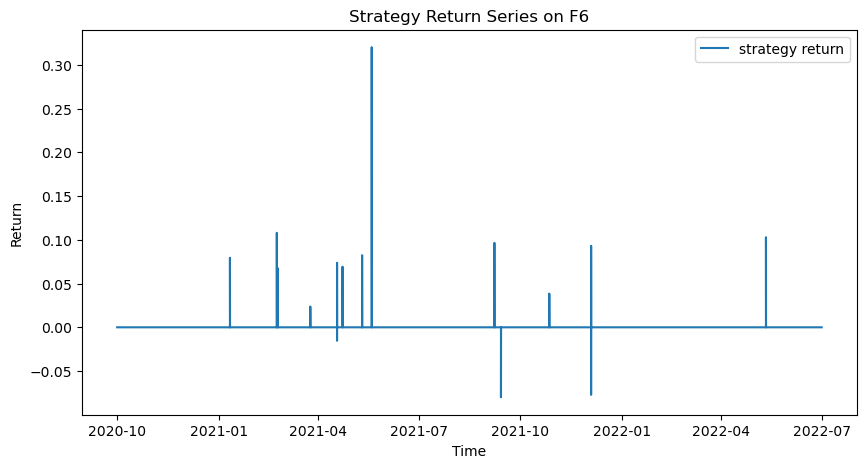

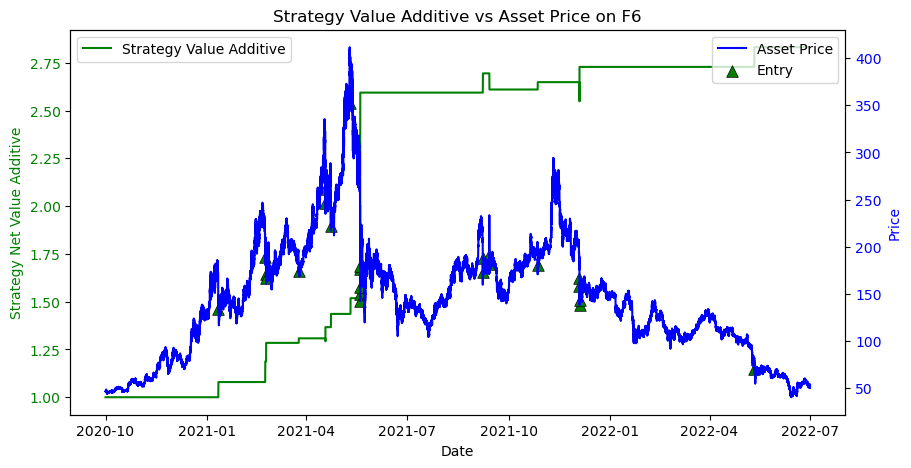

Win Prob: 79.17%
Number of Trades:  24 24
Average Win Return:   0.1069
Average Loss Return: -0.04009
P&L Ratio: 2.7
Maximum Loss of a single trade: -0.07992
Maximum Drawdown: -14.28%
Annualized Return: 72.33%
Annualized Volatility: 37.95%
Sharpe:  1.827


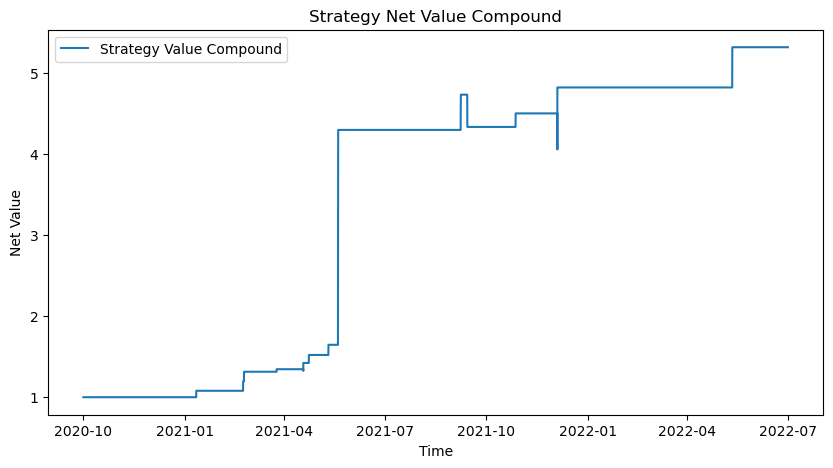

CAGR: 159.84%
Annual Return: 72.33%
Annual Volatility: 37.95%
Sharpe:  1.827


After preprocess the data has 192671 columns.
Preprocess finished
8.2 Trading signal finished


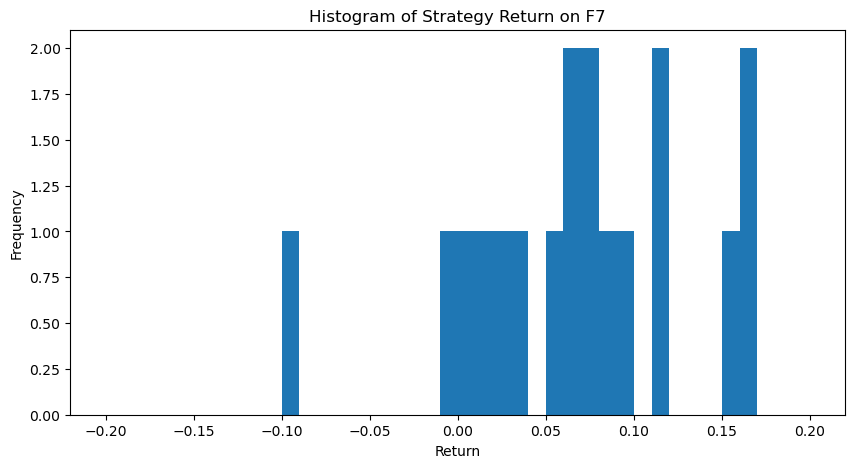

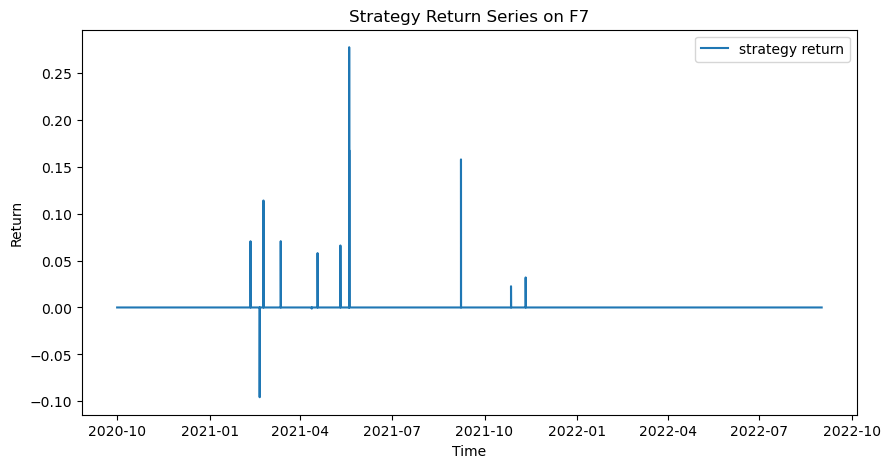

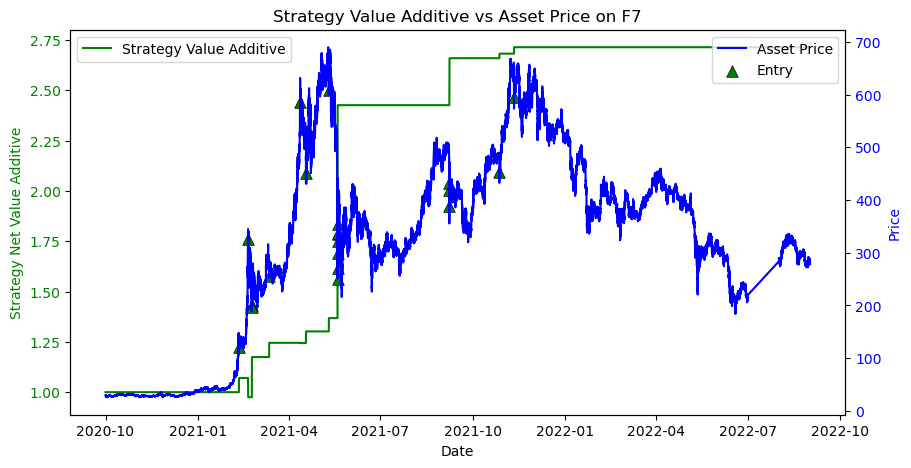

Win Prob: 90.00%
Number of Trades:  20 20
Average Win Return:   0.1006
Average Loss Return: -0.0484
P&L Ratio: 2.1
Maximum Loss of a single trade: -0.0956
Maximum Drawdown: -9.56%
Annualized Return: 64.55%
Annualized Volatility: 32.87%
Sharpe:  1.873


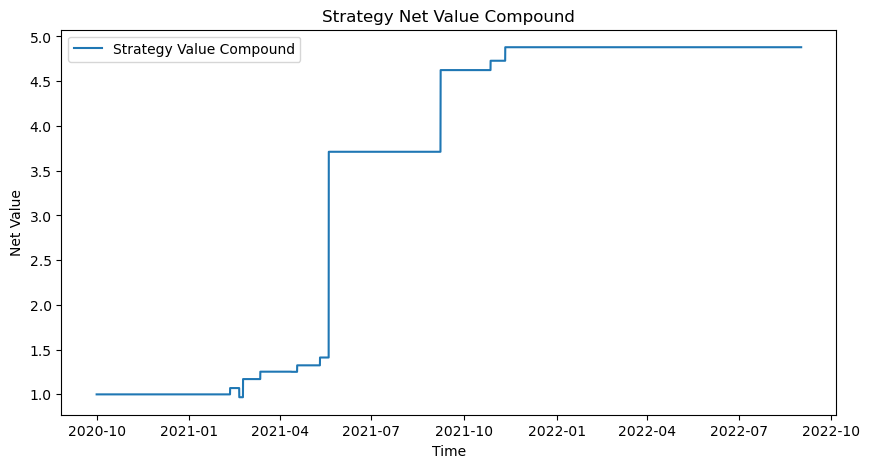

CAGR: 147.38%
Annual Return: 64.55%
Annual Volatility: 32.87%
Sharpe:  1.873


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


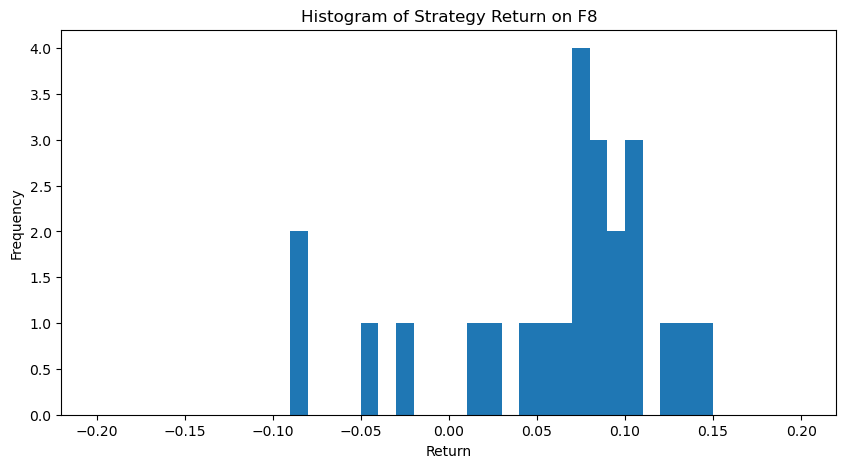

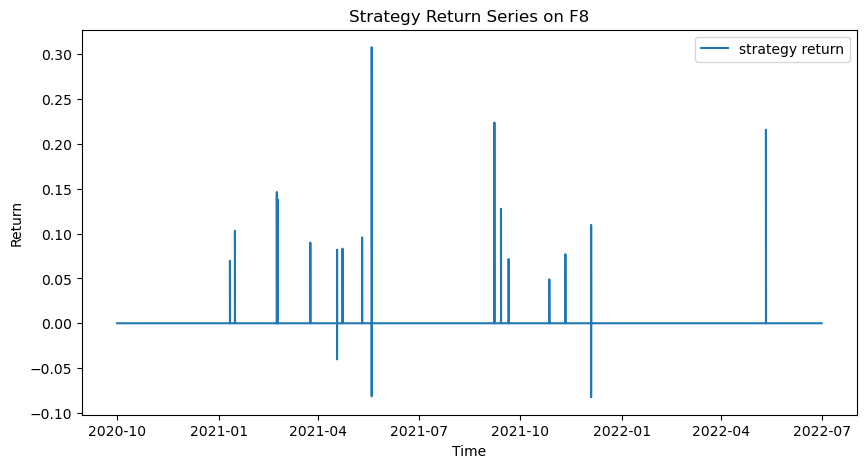

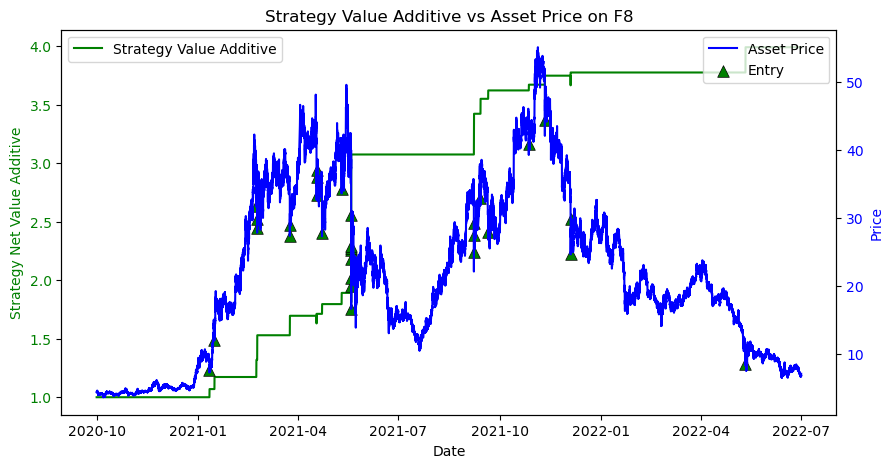

Win Prob: 86.67%
Number of Trades:  30 30
Average Win Return:   0.1238
Average Loss Return: -0.05731
P&L Ratio: 2.2
Maximum Loss of a single trade: -0.08246
Maximum Drawdown: -8.25%
Annualized Return: 118.08%
Annualized Volatility: 47.81%
Sharpe:  2.407


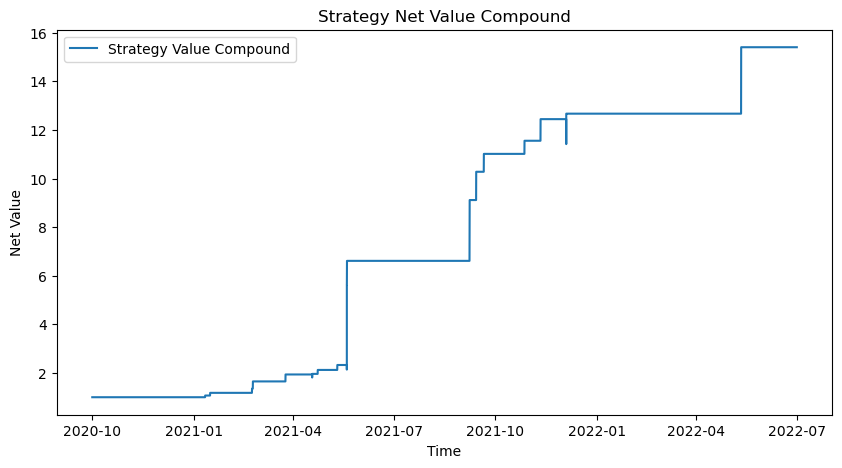

CAGR: 377.15%
Annual Return: 118.08%
Annual Volatility: 47.81%
Sharpe:  2.407


After preprocess the data has 175103 columns.
Preprocess finished
8.2 Trading signal finished


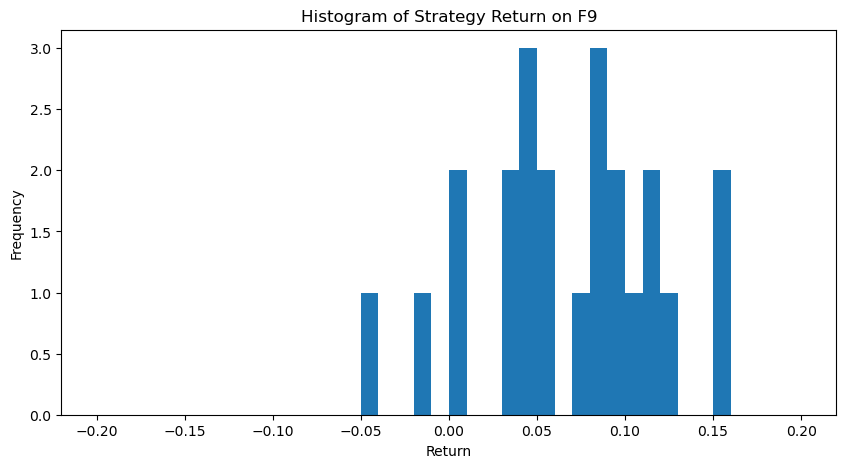

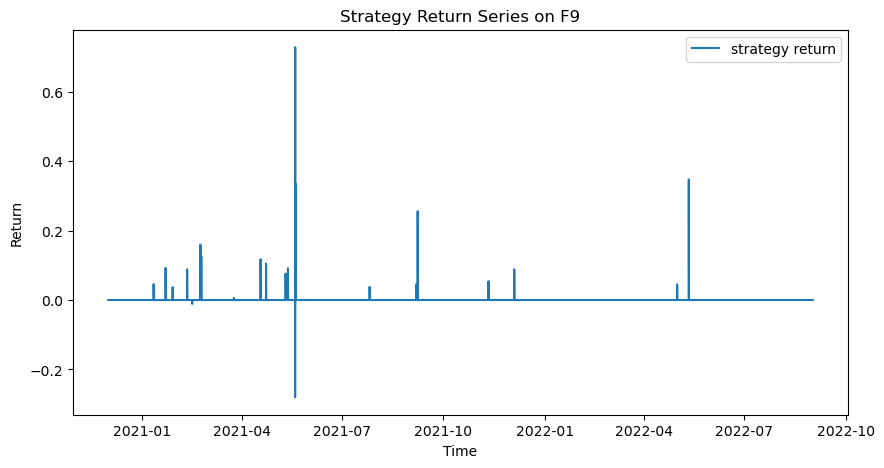

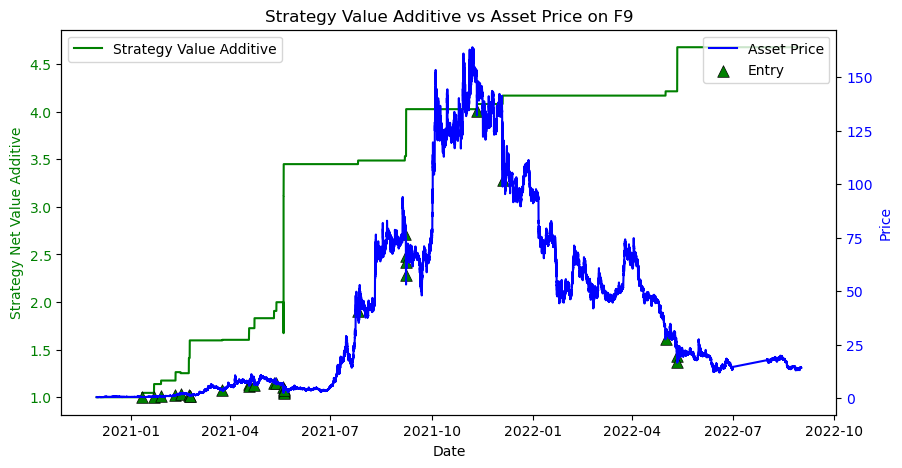

Win Prob: 90.00%
Number of Trades:  30 30
Average Win Return:   0.1486
Average Loss Return: -0.1121
P&L Ratio: 1.3
Maximum Loss of a single trade: -0.28
Maximum Drawdown: -31.26%
Annualized Return: 152.41%
Annualized Volatility: 74.17%
Sharpe:  2.014


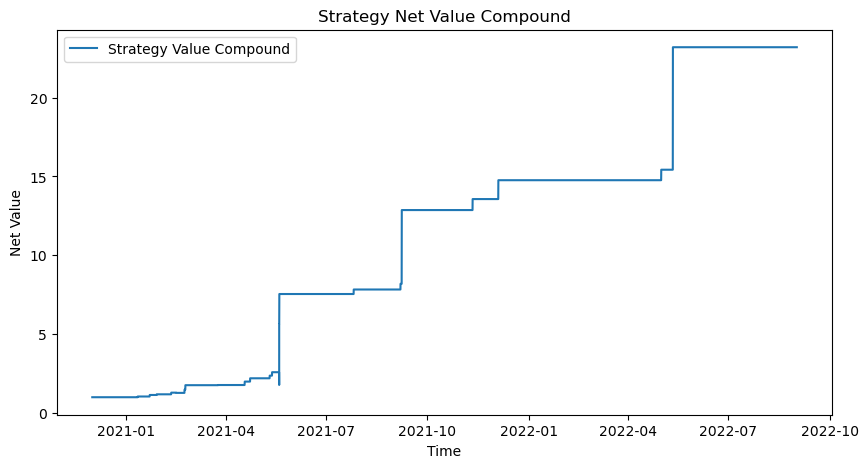

CAGR: 502.78%
Annual Return: 152.41%
Annual Volatility: 74.17%
Sharpe:  2.014


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


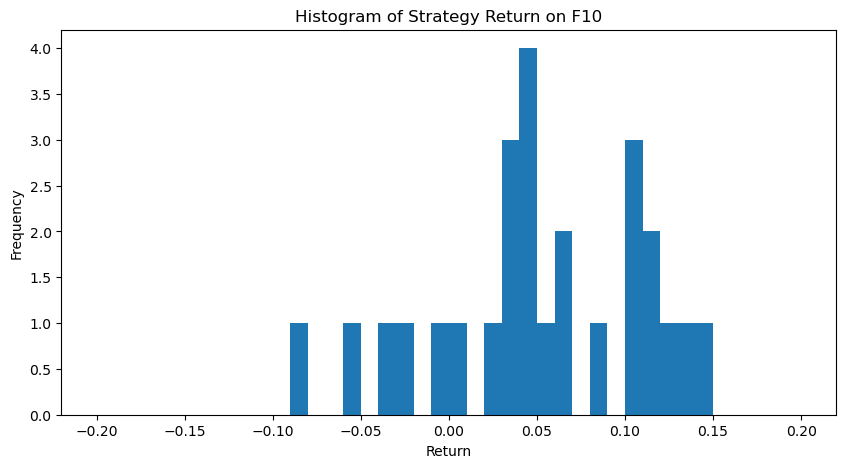

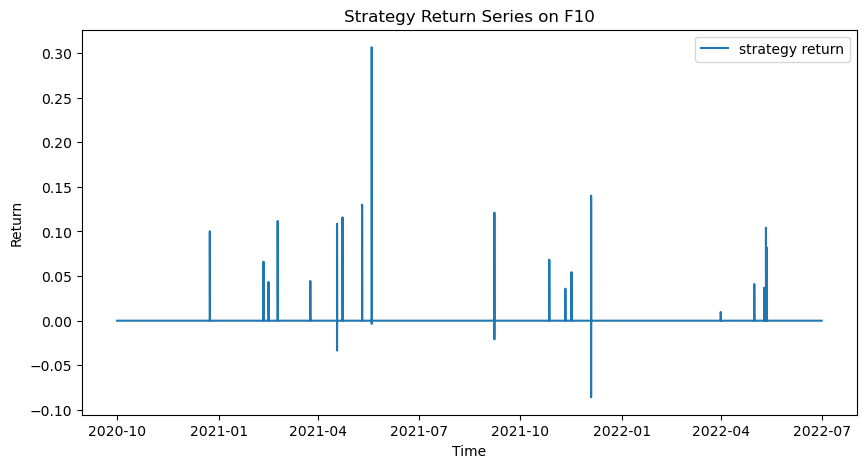

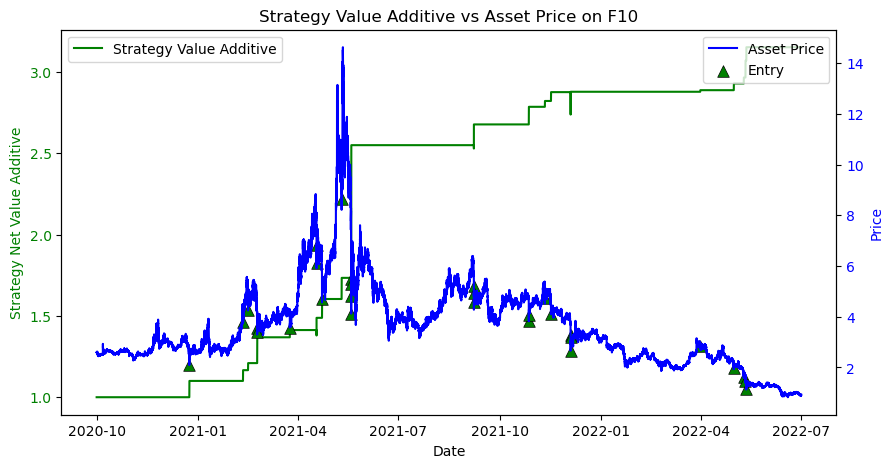

Win Prob: 82.76%
Number of Trades:  29 29
Average Win Return:   0.09785
Average Loss Return: -0.03917
P&L Ratio: 2.5
Maximum Loss of a single trade: -0.08577
Maximum Drawdown: -13.35%
Annualized Return: 85.02%
Annualized Volatility: 38.75%
Sharpe:  2.117


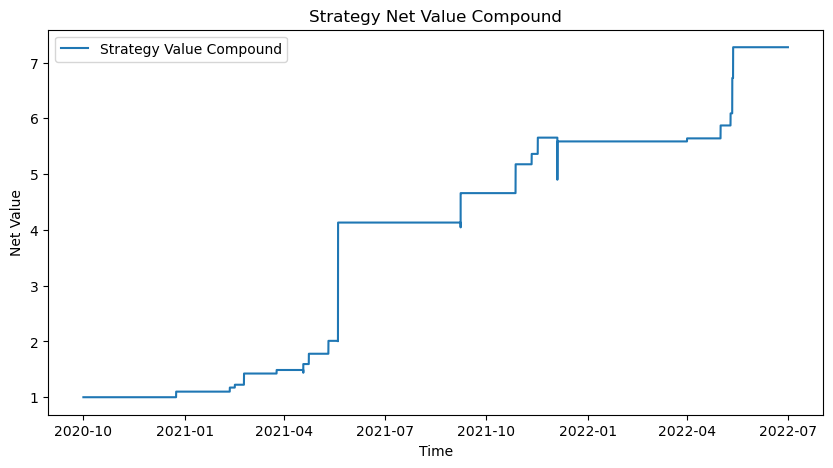

CAGR: 210.78%
Annual Return: 85.02%
Annual Volatility: 38.75%
Sharpe:  2.117


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


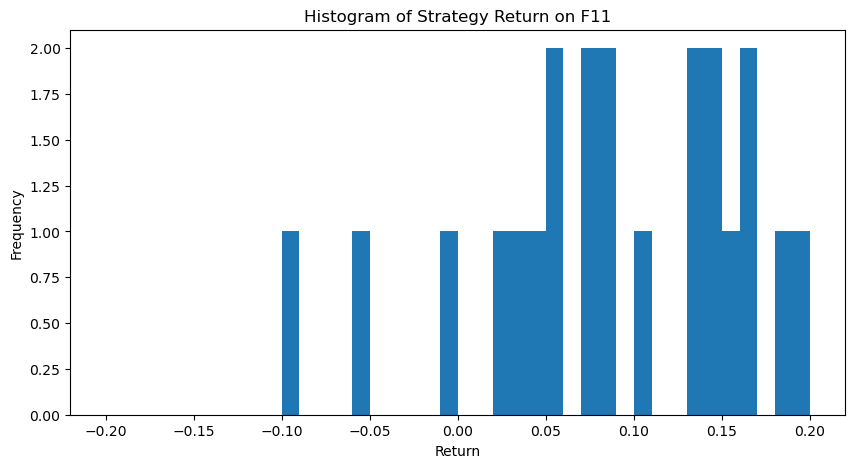

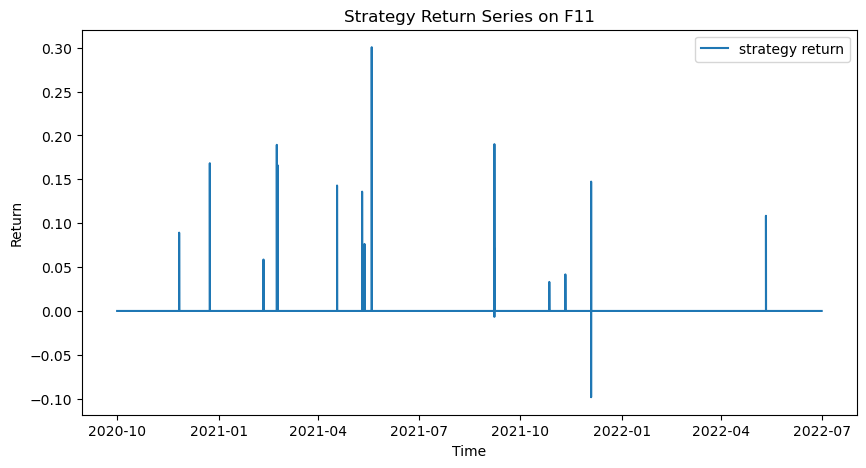

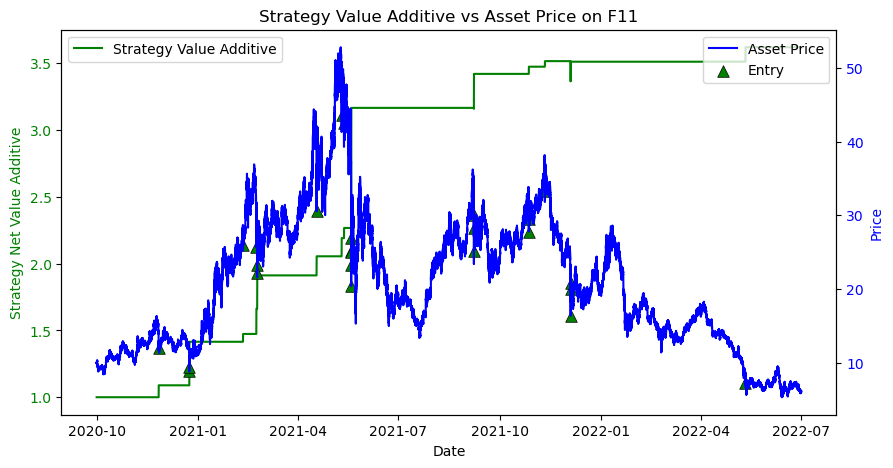

Win Prob: 88.00%
Number of Trades:  25 25
Average Win Return:   0.1263
Average Loss Return: -0.05282
P&L Ratio: 2.4
Maximum Loss of a single trade: -0.09832
Maximum Drawdown: -14.65%
Annualized Return: 103.51%
Annualized Volatility: 42.93%
Sharpe:  2.341


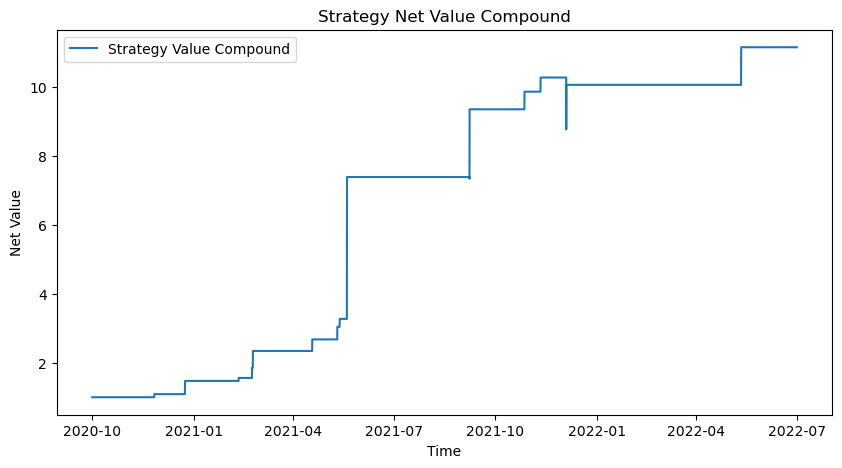

CAGR: 296.77%
Annual Return: 103.51%
Annual Volatility: 42.93%
Sharpe:  2.341


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


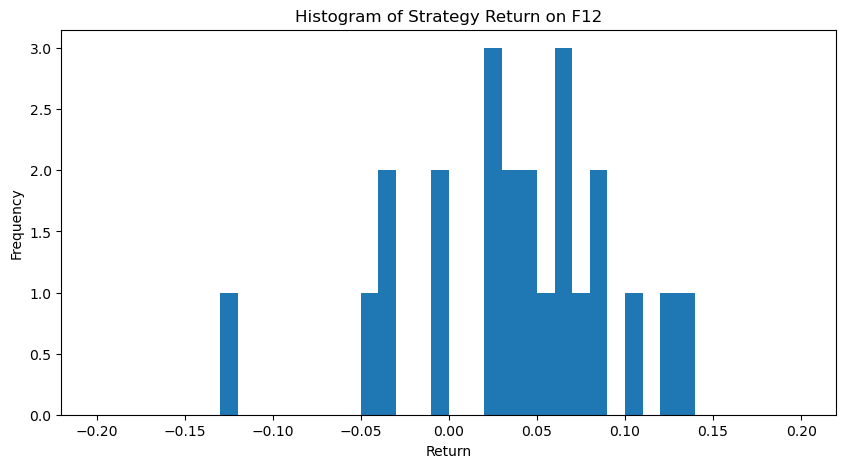

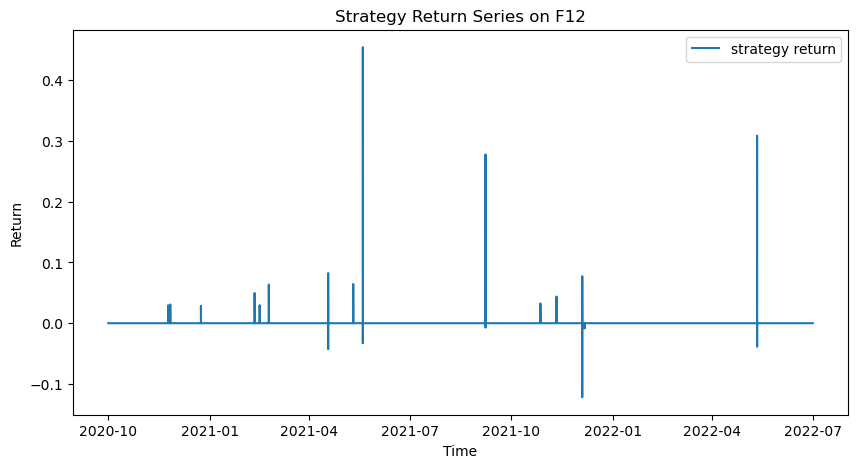

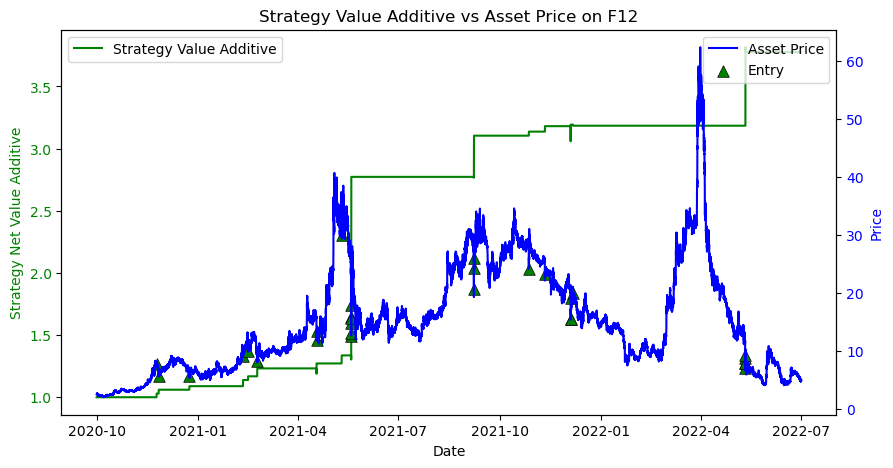

Win Prob: 79.31%
Number of Trades:  29 29
Average Win Return:   0.1317
Average Loss Return: -0.04204
P&L Ratio: 3.1
Maximum Loss of a single trade: -0.1219
Maximum Drawdown: -12.19%
Annualized Return: 109.66%
Annualized Volatility: 54.71%
Sharpe:  1.95


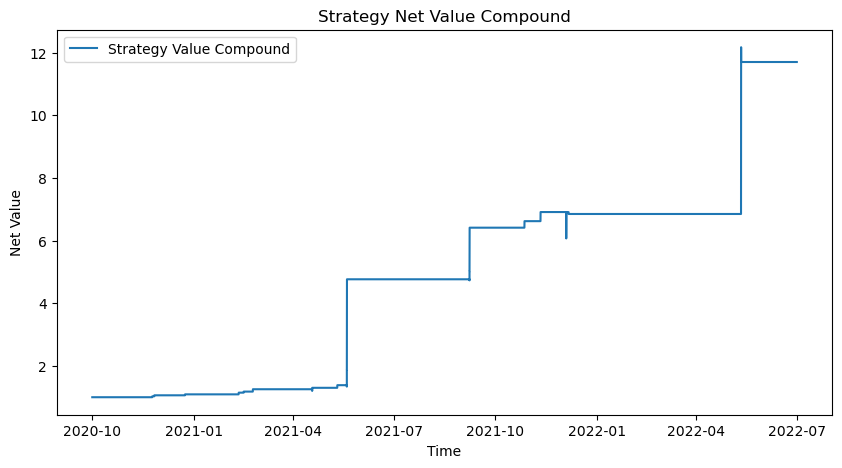

CAGR: 307.73%
Annual Return: 109.66%
Annual Volatility: 54.71%
Sharpe:  1.95


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


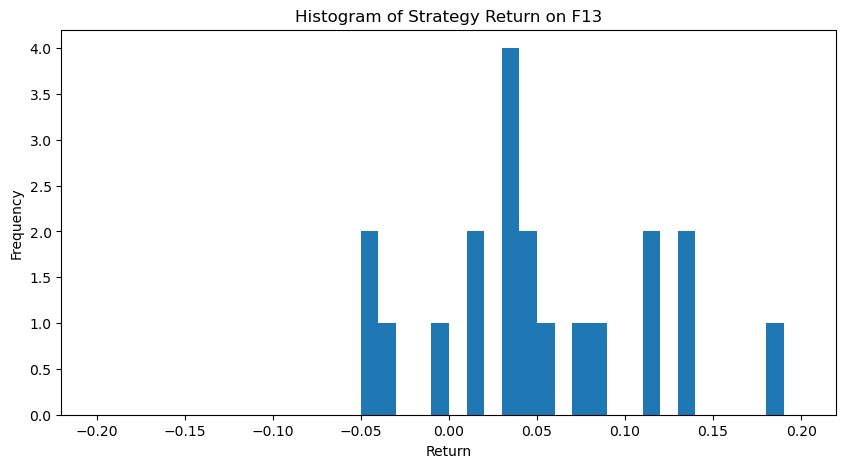

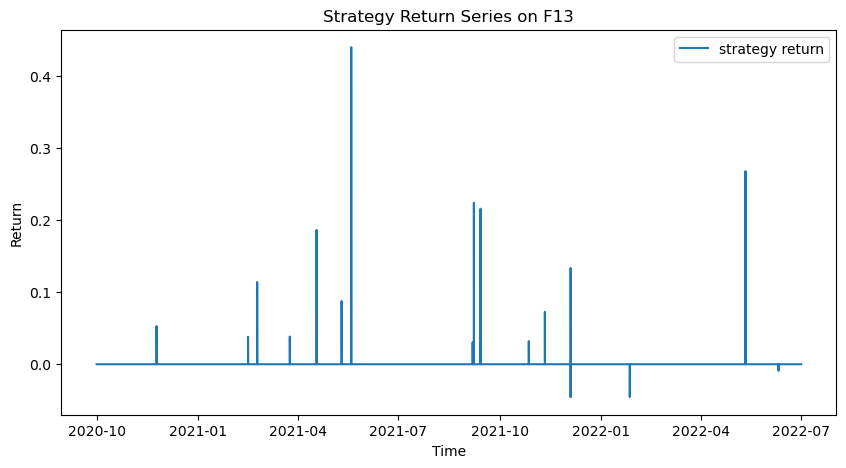

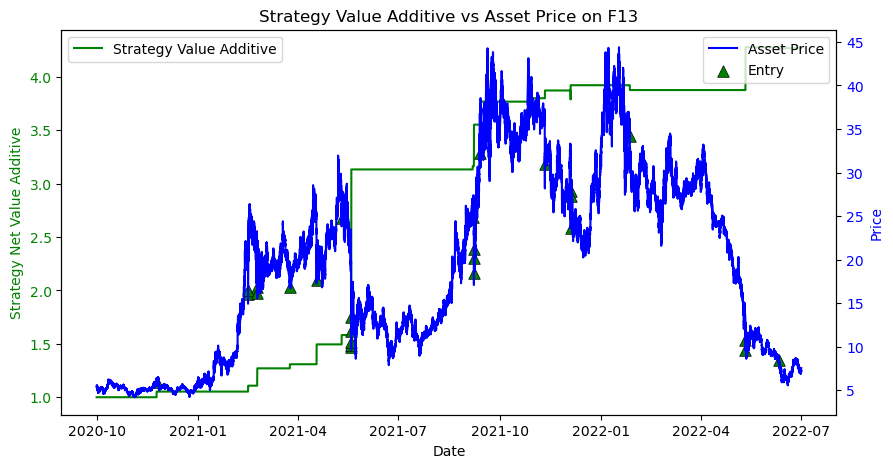

Win Prob: 85.19%
Number of Trades:  27 27
Average Win Return:   0.1482
Average Loss Return: -0.03464
P&L Ratio: 4.3
Maximum Loss of a single trade: -0.04571
Maximum Drawdown: -8.23%
Annualized Return: 129.14%
Annualized Volatility: 59.34%
Sharpe:  2.126


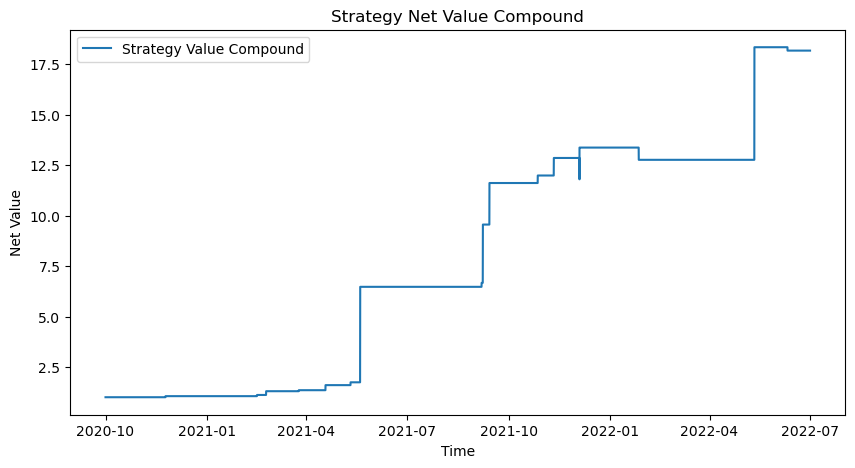

CAGR: 424.49%
Annual Return: 129.14%
Annual Volatility: 59.34%
Sharpe:  2.126


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


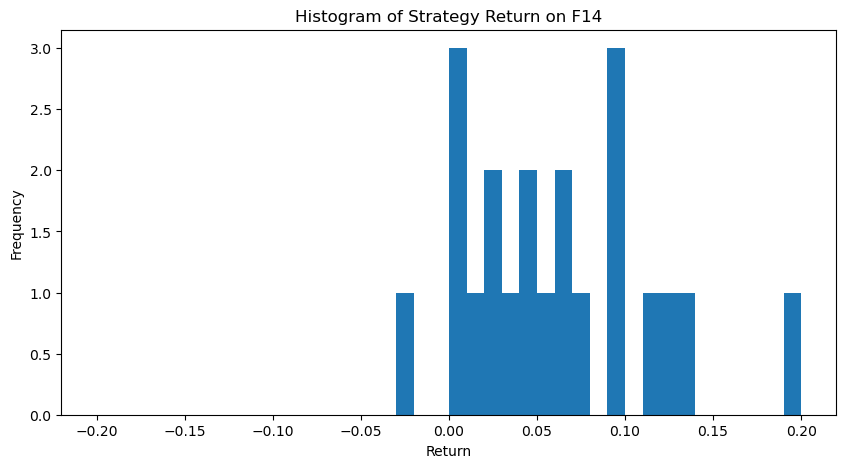

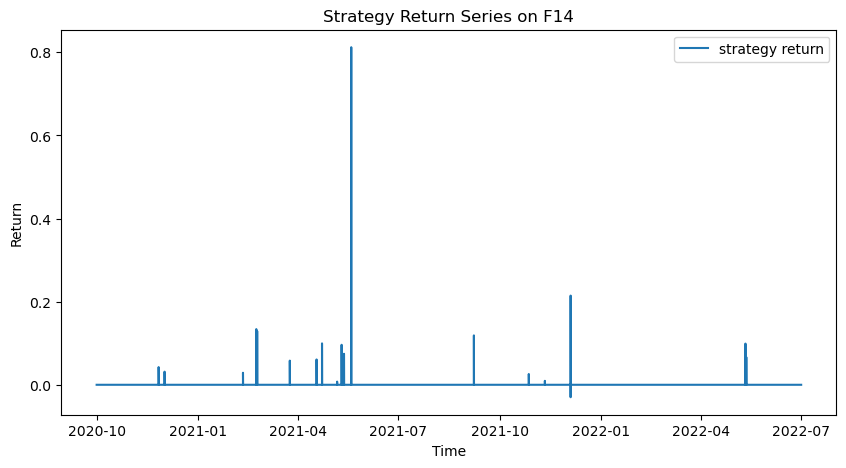

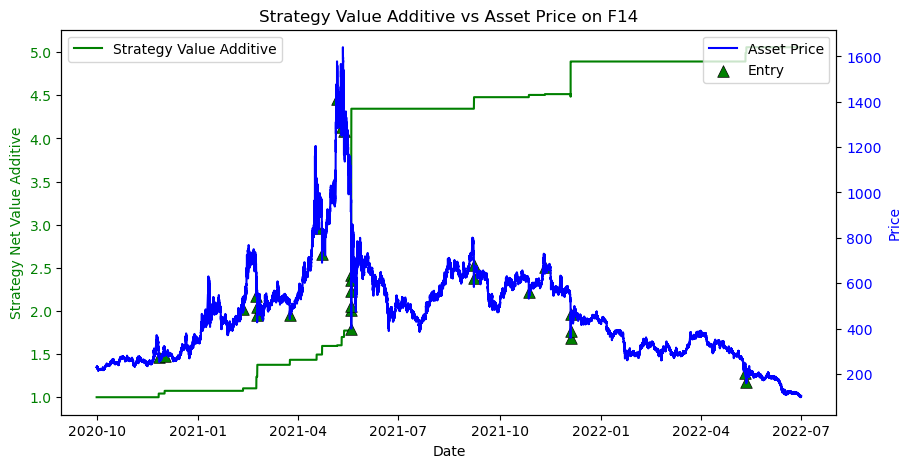

Win Prob: 96.30%
Number of Trades:  27 27
Average Win Return:   0.1572
Average Loss Return: -0.02993
P&L Ratio: 5.3
Maximum Loss of a single trade: -0.02993
Maximum Drawdown: -2.99%
Annualized Return: 160.27%
Annualized Volatility: 81.21%
Sharpe:  1.936


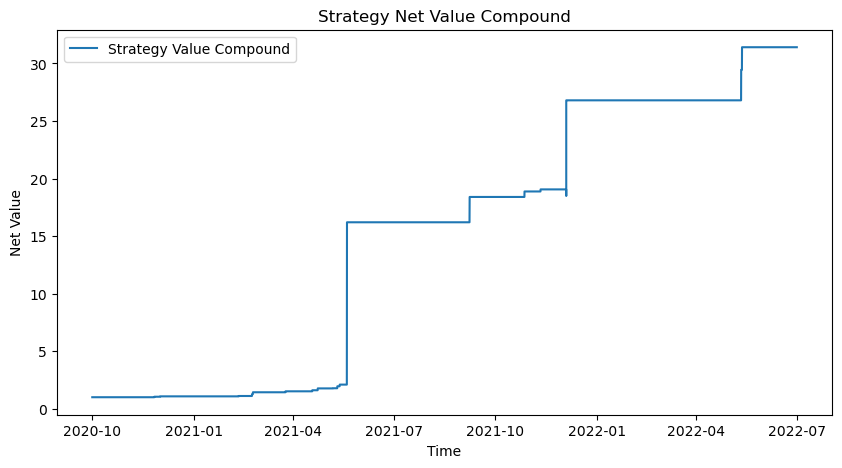

CAGR: 616.88%
Annual Return: 160.27%
Annual Volatility: 81.21%
Sharpe:  1.936


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


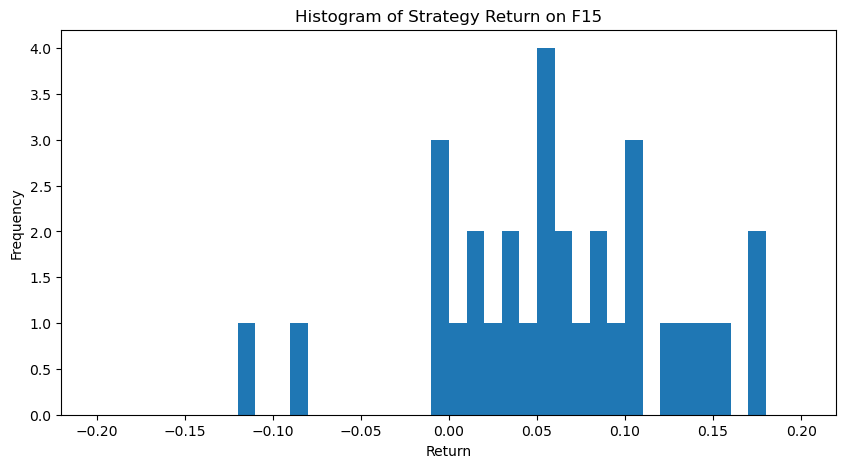

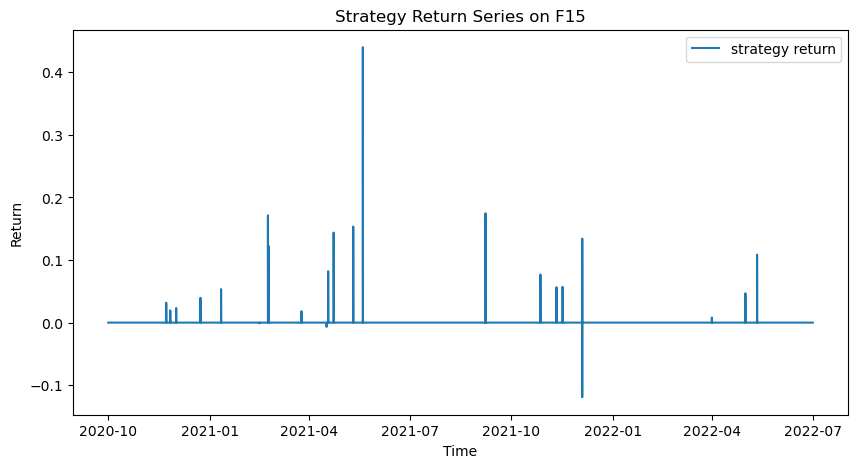

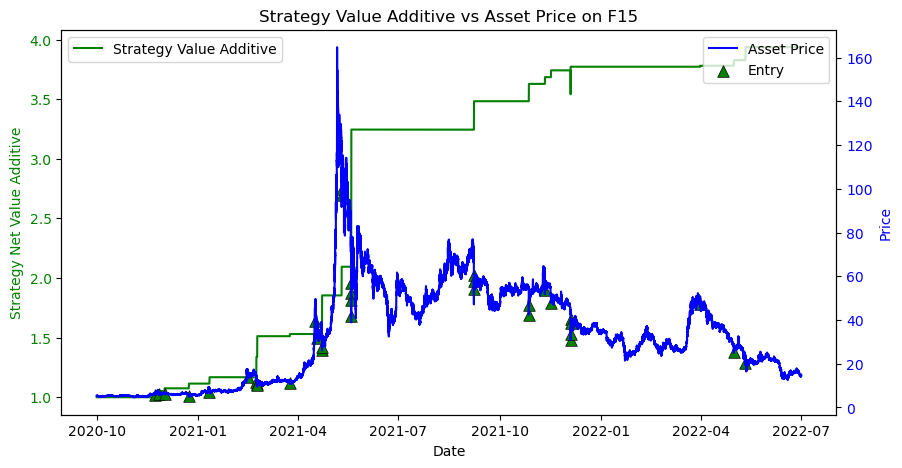

Win Prob: 85.29%
Number of Trades:  34 34
Average Win Return:   0.1084
Average Loss Return: -0.04175
P&L Ratio: 2.6
Maximum Loss of a single trade: -0.1192
Maximum Drawdown: -19.05%
Annualized Return: 115.95%
Annualized Volatility: 50.37%
Sharpe:  2.242


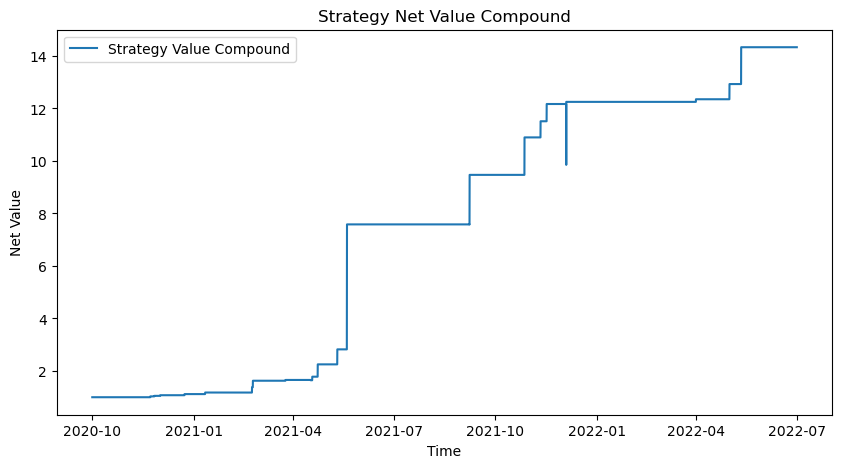

CAGR: 357.84%
Annual Return: 115.95%
Annual Volatility: 50.37%
Sharpe:  2.242


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


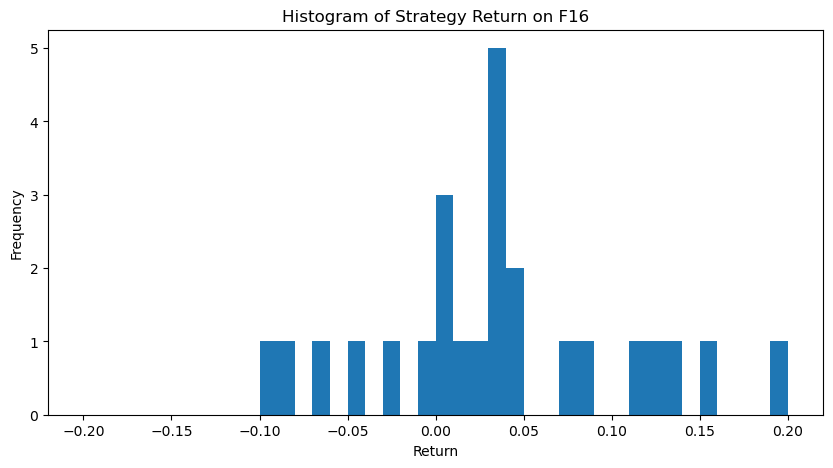

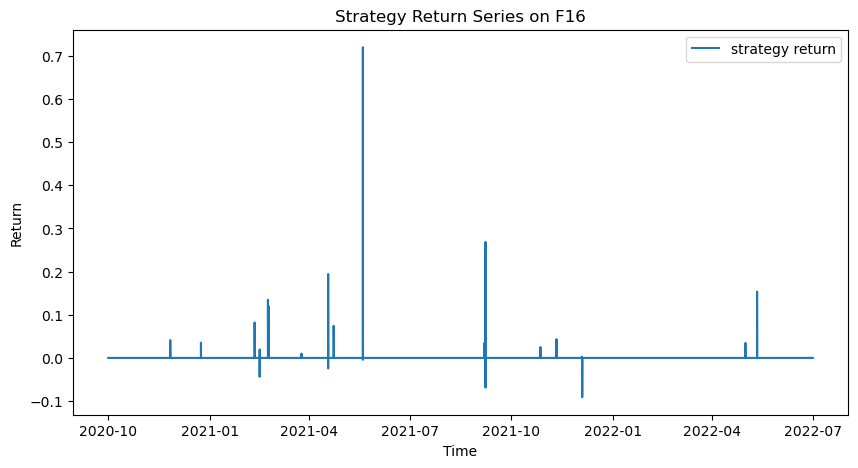

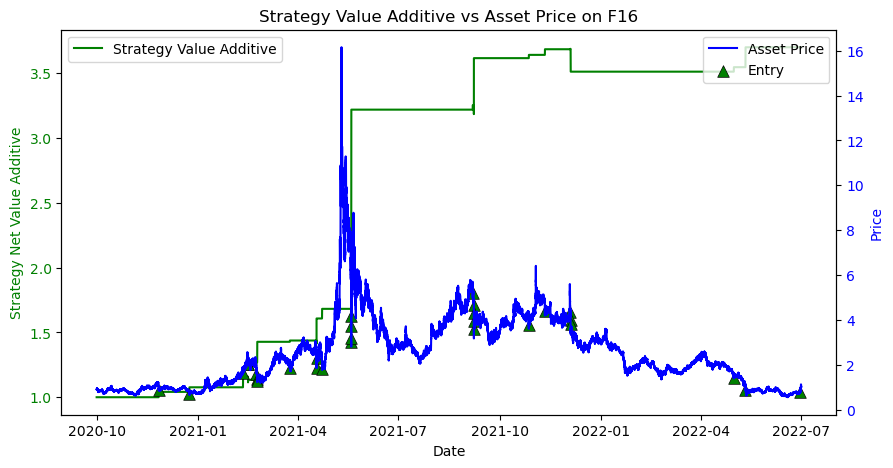

Win Prob: 79.31%
Number of Trades:  29 29
Average Win Return:   0.1312
Average Loss Return: -0.05288
P&L Ratio: 2.5
Maximum Loss of a single trade: -0.09105
Maximum Drawdown: -16.82%
Annualized Return: 106.65%
Annualized Volatility: 66.80%
Sharpe:  1.552


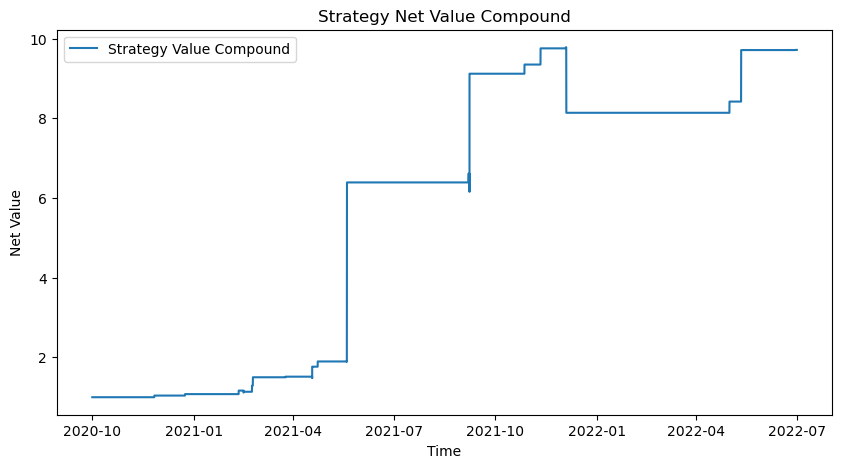

CAGR: 266.70%
Annual Return: 106.65%
Annual Volatility: 66.80%
Sharpe:  1.552


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


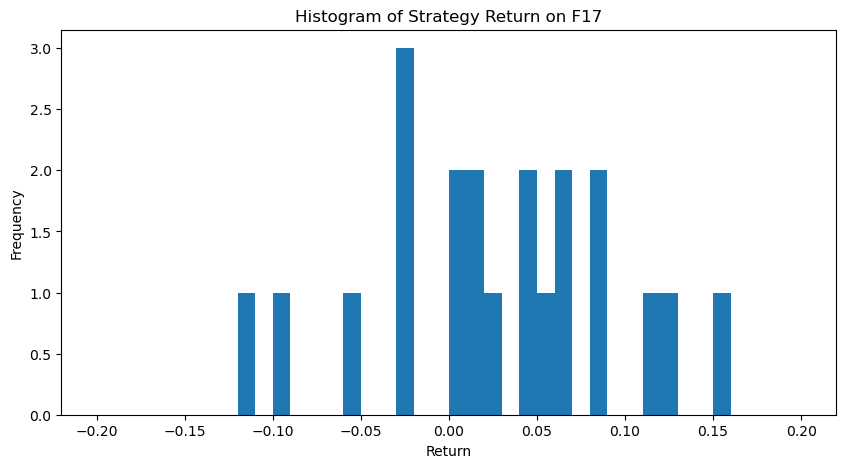

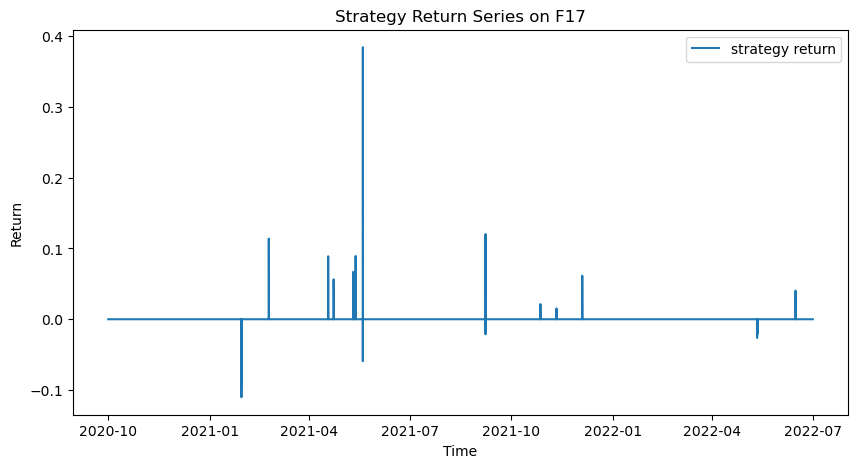

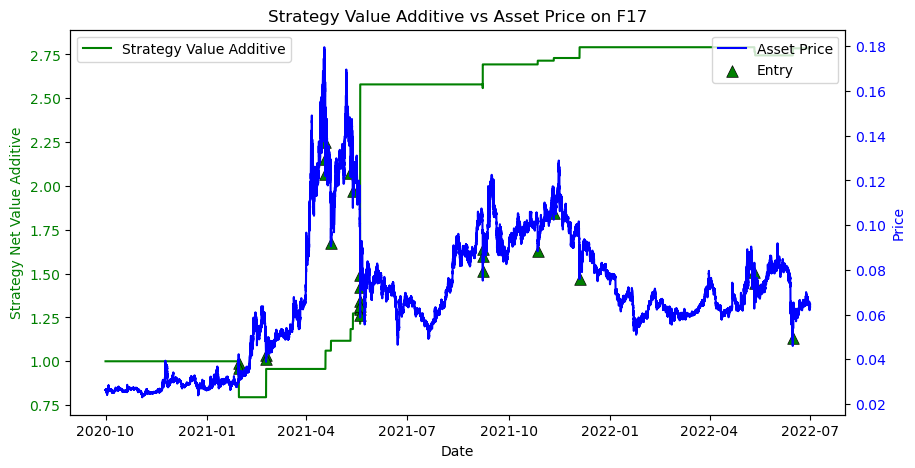

Win Prob: 76.00%
Number of Trades:  25 25
Average Win Return:   0.1114
Average Loss Return: -0.05533
P&L Ratio: 2.0
Maximum Loss of a single trade: -0.1101
Maximum Drawdown: -19.46%
Annualized Return: 70.51%
Annualized Volatility: 44.18%
Sharpe:  1.528


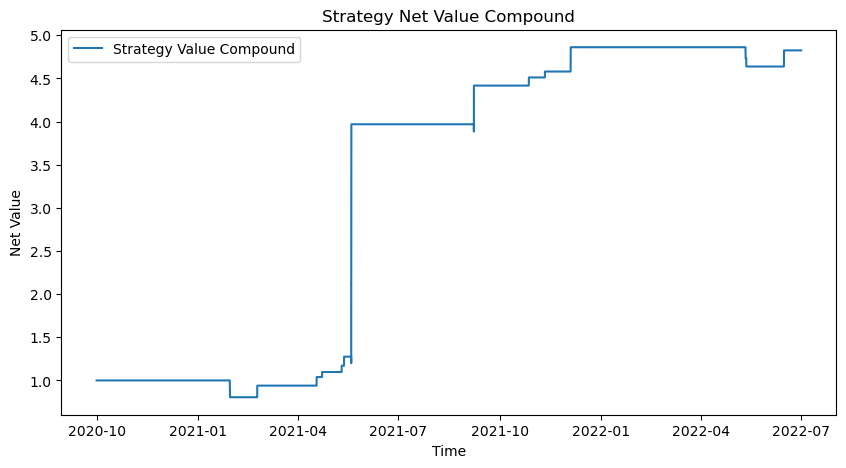

CAGR: 145.81%
Annual Return: 70.51%
Annual Volatility: 44.18%
Sharpe:  1.528


After preprocess the data has 183744 columns.
Preprocess finished
8.2 Trading signal finished


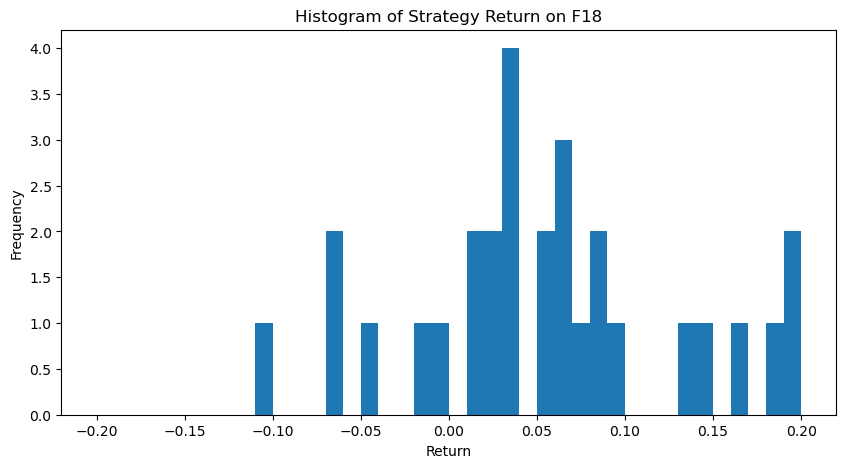

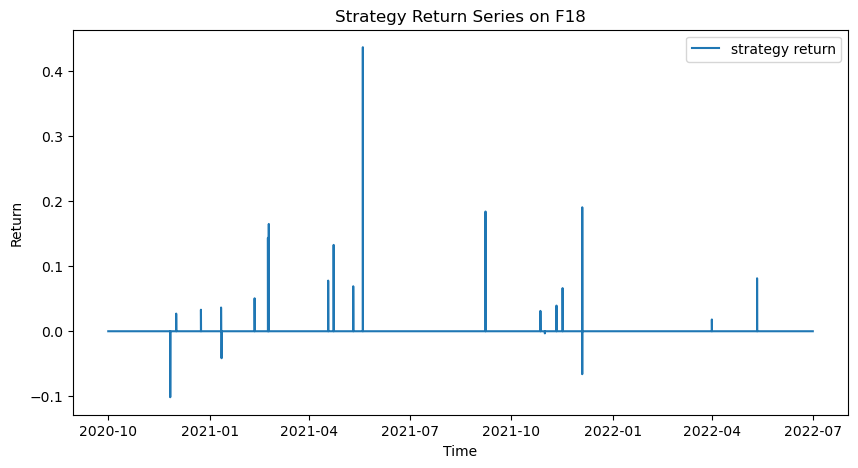

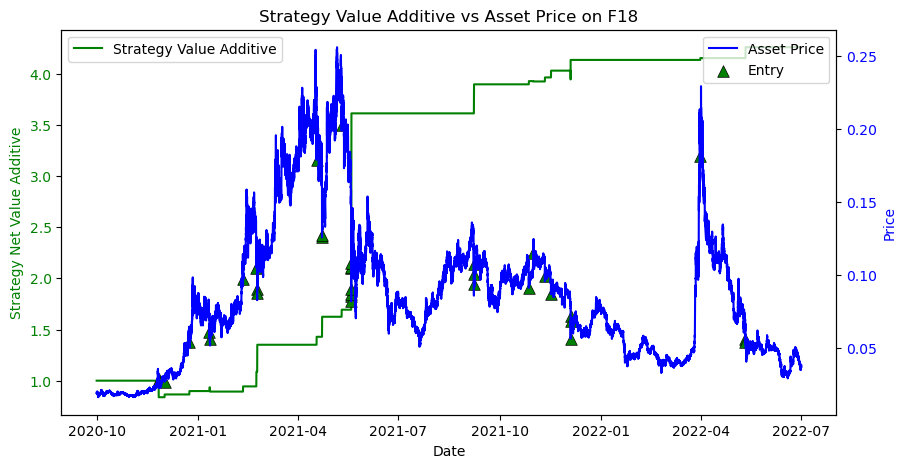

Win Prob: 82.35%
Number of Trades:  34 34
Average Win Return:   0.1268
Average Loss Return: -0.0487
P&L Ratio: 2.6
Maximum Loss of a single trade: -0.1014
Maximum Drawdown: -15.57%
Annualized Return: 128.71%
Annualized Volatility: 57.44%
Sharpe:  2.189


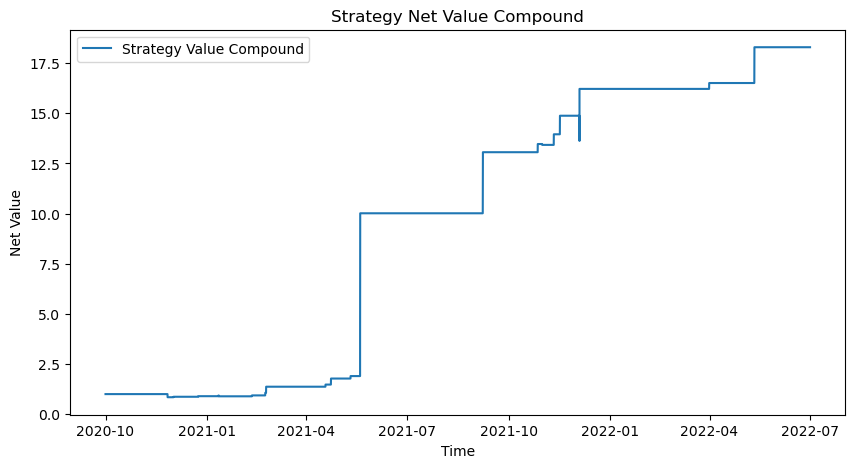

CAGR: 426.46%
Annual Return: 128.71%
Annual Volatility: 57.44%
Sharpe:  2.189




In [385]:
# strategy 8.2 use avg price as buy and sell price
strategy8_2_list = []
profit_des_8_2 = pd.DataFrame()
tbv_des_8_2 = pd.DataFrame()
tbv_tv_des_8_2 = pd.DataFrame()
tbv_pct_des_8_2 = pd.DataFrame()
ma_des_8_2 = pd.DataFrame()
for idx in range(len(data_list)):
    name = 'F'+str(idx+1)
    stra8_2 = CTAStrategy(data_list[idx],'open_time','signal','close',120,5,name)
    stra8_2.data_preprocess()
    stra8_2.find_signal_8_2_improved(10000,0.1,1)
    stra8_2.get_strategy_returns(1/1000)
    stra8_2.plot_hist_seires()
    stra8_2.plot_cumsum_profits()
    stra8_2.get_win_prob()
    profit_des = stra8_2.get_avg_win_return()
    stra8_2.get_maximum_drawdown()
    stra8_2.get_sharpe()
    stra8_2.plot_cumprod_value()
    tbv_des, tbv_tv_des, tbv_pct_des = stra8_2.taker_buy_volume_stats()
    ma_des = stra8_2.moving_average_stats()
    strategy8_2_list.append(stra8_2)
    if (profit_des_8_2.empty):
        profit_des_8_2 = profit_des
        tbv_des_8_2 = tbv_des
        tbv_tv_des_8_2 = tbv_tv_des
        tbv_pct_des_8_2 = tbv_pct_des
        ma_des_8_2 = ma_des
    else:
        profit_des_8_2 = profit_des_8_2.join(profit_des)
        tbv_des_8_2 = tbv_des_8_2.join(tbv_des)
        tbv_tv_des_8_2 =tbv_tv_des_8_2.join(tbv_tv_des)
        tbv_pct_des_8_2 = tbv_pct_des_8_2.join(tbv_pct_des)
        ma_des_8_2 = ma_des_8_2.join(ma_des)
    print('\n')

## Overall Statistics

In [388]:
# calculate average win rate, average profit loss ratio, average sharpe
win_rate2 = []
pnl_ratio2 = []
sharpe2 = []
for ele in strategy8_2_list:
    win_rate2.append(ele.win_prob)
    pnl_ratio2.append(ele.pnl_ratio)
    sharpe2.append(ele.sharpe)
print(f"Average Win Rate: {np.mean(win_rate2):.2f}")
print(f"Average P&L Ratio: {np.nanmean(pnl_ratio2):.2f}")
print(f"Average Sharpe: {np.mean(sharpe2):.2f}")

Average Win Rate: 0.85
Average P&L Ratio: 2.99
Average Sharpe: 1.87


In [387]:
pnl_ratio2

[5.7797083348266405,
 nan,
 6.541891051964643,
 2.021784066633284,
 0.9600765351575231,
 2.66716316863274,
 2.078114069086924,
 2.16036784905786,
 1.3260357656737771,
 2.4982686197718253,
 2.3915899392448727,
 3.131883693902,
 4.277442704660712,
 5.2524052448848755,
 2.597196722012132,
 2.4811801721541027,
 2.0139301191548014,
 2.60384715492775]

## below are old versions

Preprocess finished
8.2 Trading signal finished


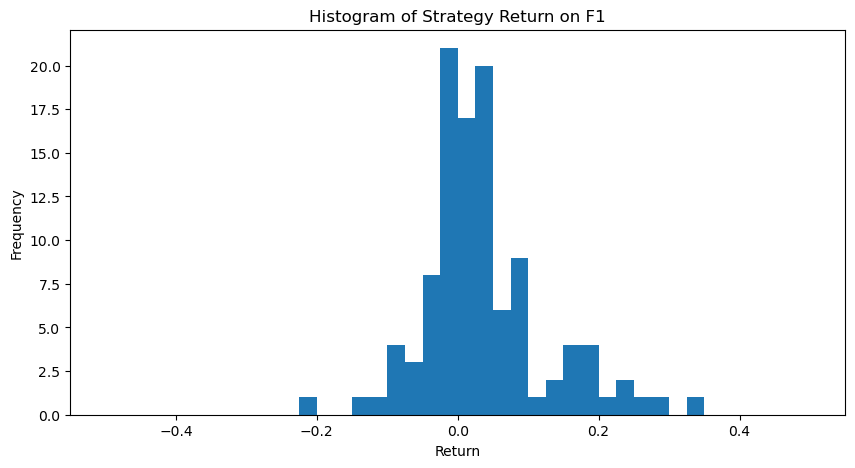

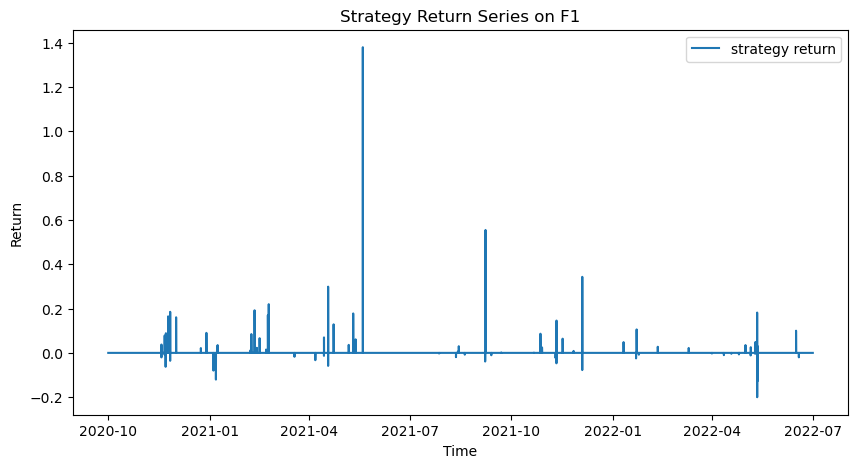

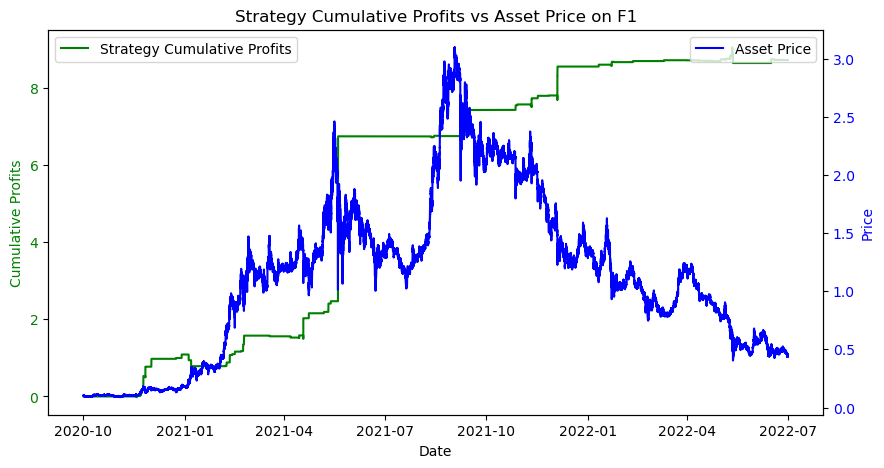

Win Prob: 65.49%
Number of Trades:  113 113
Average Win Return:   0.1382
Average Loss Return: -0.03833
P&L Ratio: 3.6
Maximum Loss of a single trade: -0.2
Maximum Drawdown: -17.56%
Annual Return: 345.06%
Annual Volatility: 153.35%
Sharpe:  2.25


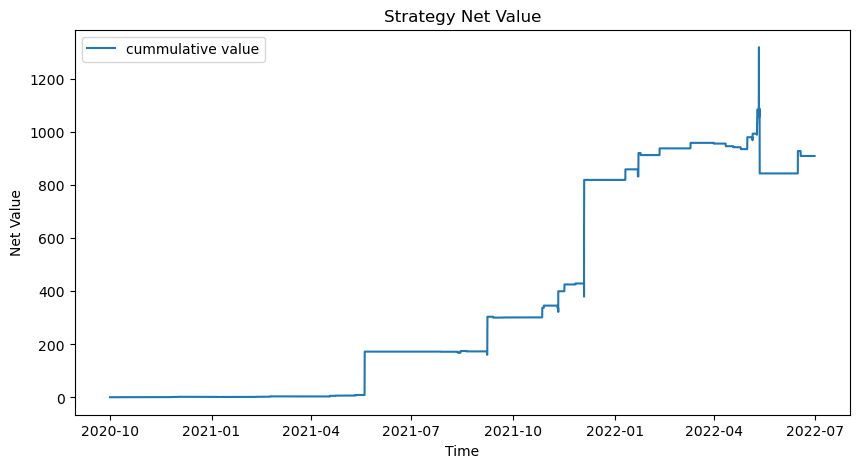

Annual Return: 4807.57%
Annual Volatility: 153.33%
Sharpe:  31.35


Preprocess finished
8.2 Trading signal finished


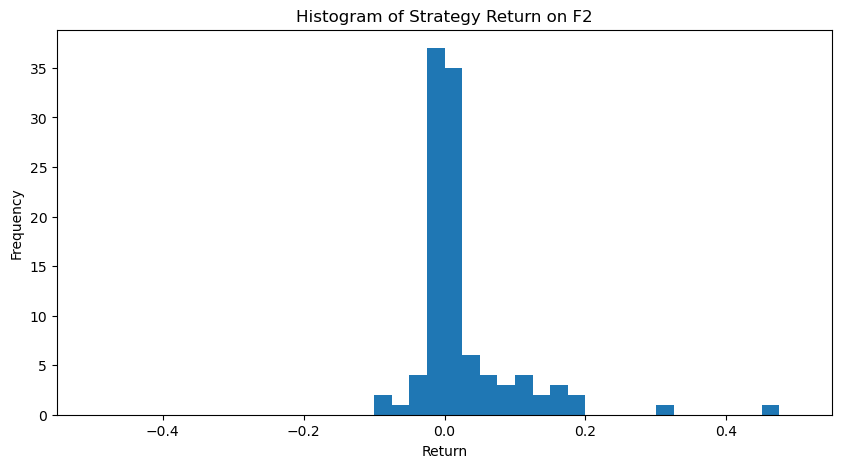

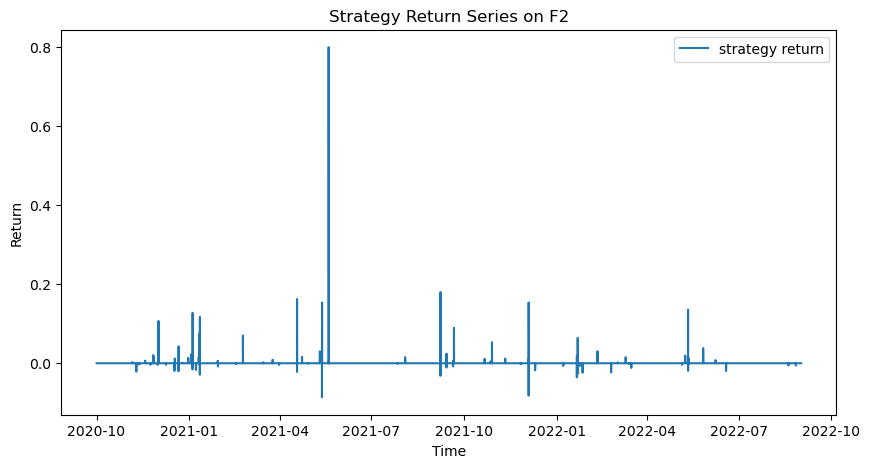

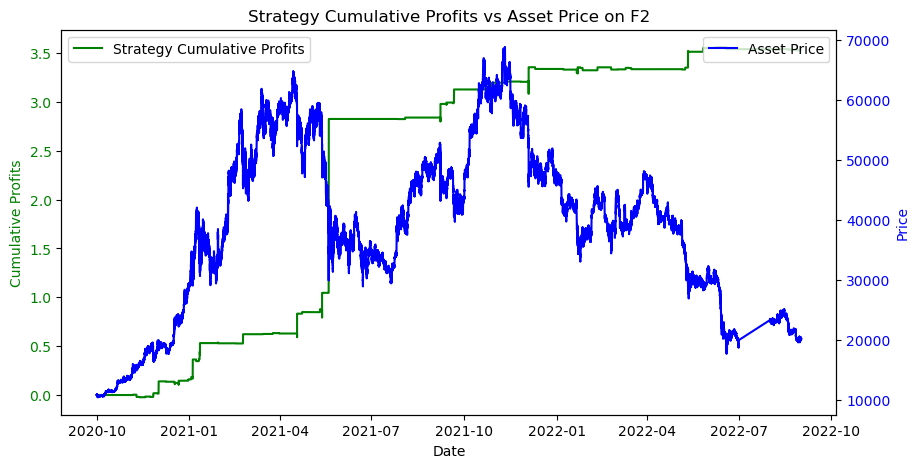

Win Prob: 58.49%
Number of Trades:  106 106
Average Win Return:   0.06817
Average Loss Return: -0.01587
P&L Ratio: 4.3
Maximum Loss of a single trade: -0.08591
Maximum Drawdown: -4.57%
Annual Return: 132.93%
Annual Volatility: 68.95%
Sharpe:  1.928


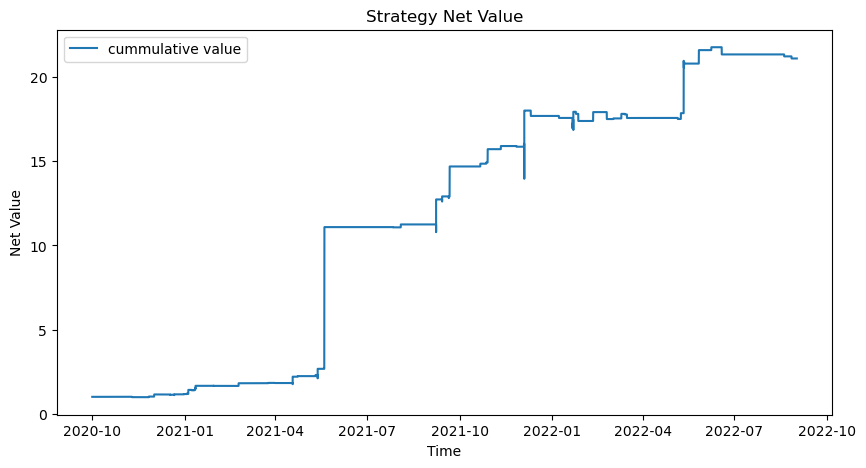

Annual Return: 471.25%
Annual Volatility: 68.94%
Sharpe:  6.836


Preprocess finished
8.2 Trading signal finished


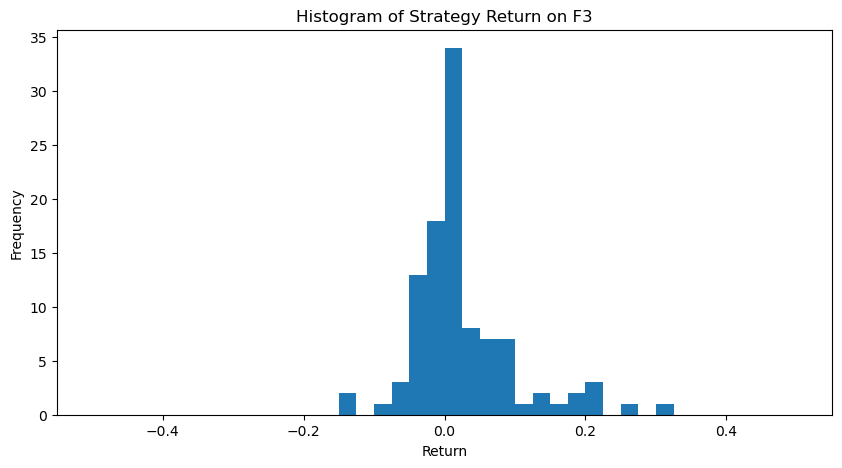

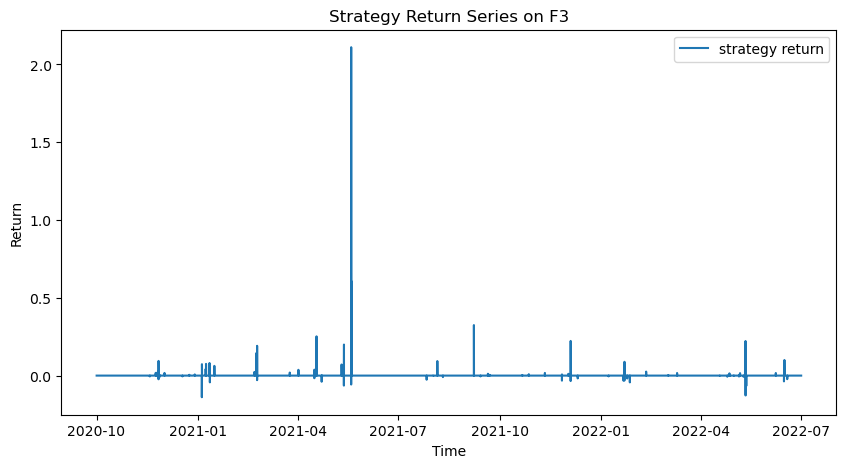

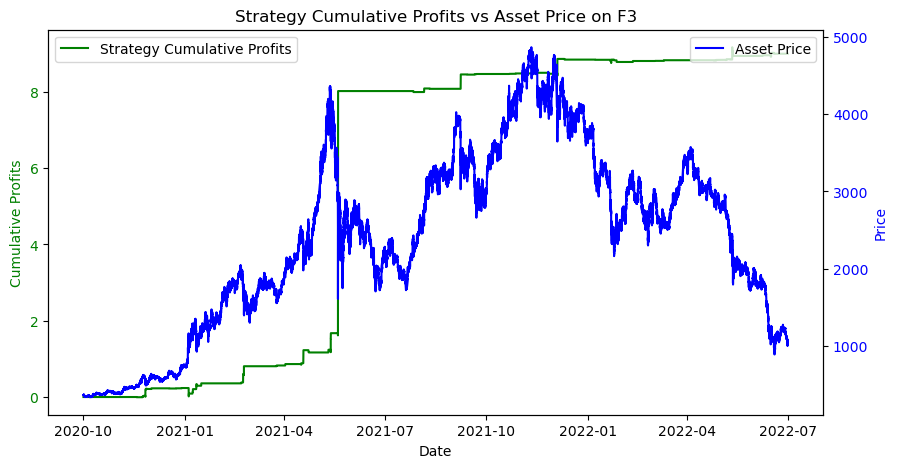

Win Prob: 66.06%
Number of Trades:  109 109
Average Win Return:   0.1413
Average Loss Return: -0.0318
P&L Ratio: 4.4
Maximum Loss of a single trade: -0.139
Maximum Drawdown: -17.78%
Annual Return: 355.44%
Annual Volatility: 199.12%
Sharpe:  1.785


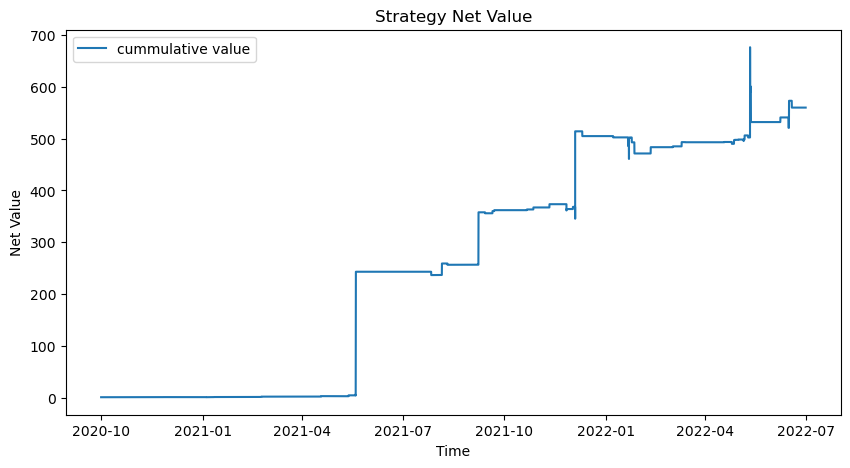

Annual Return: 3618.47%
Annual Volatility: 199.09%
Sharpe:  18.17


Preprocess finished
8.2 Trading signal finished


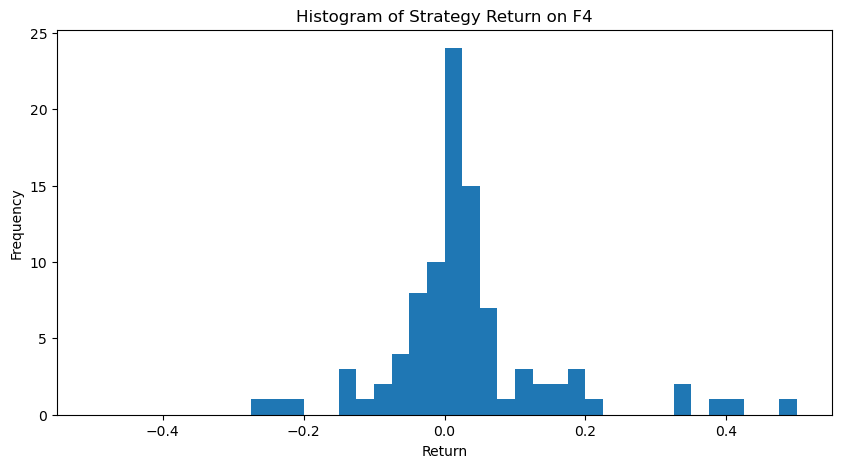

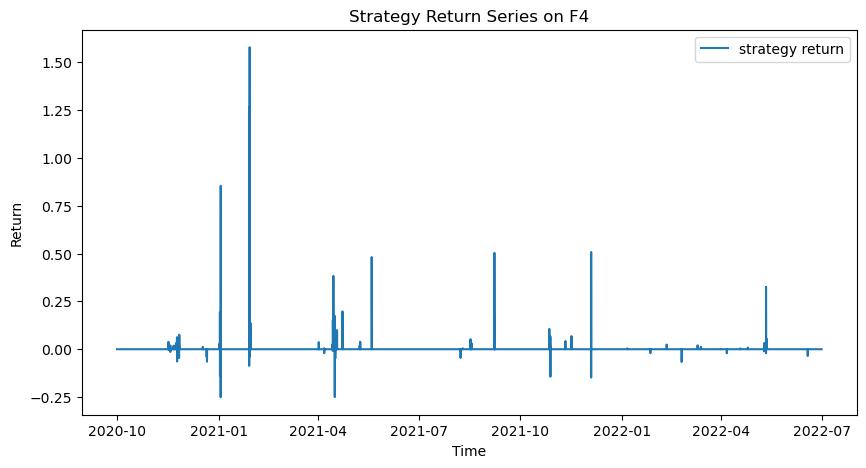

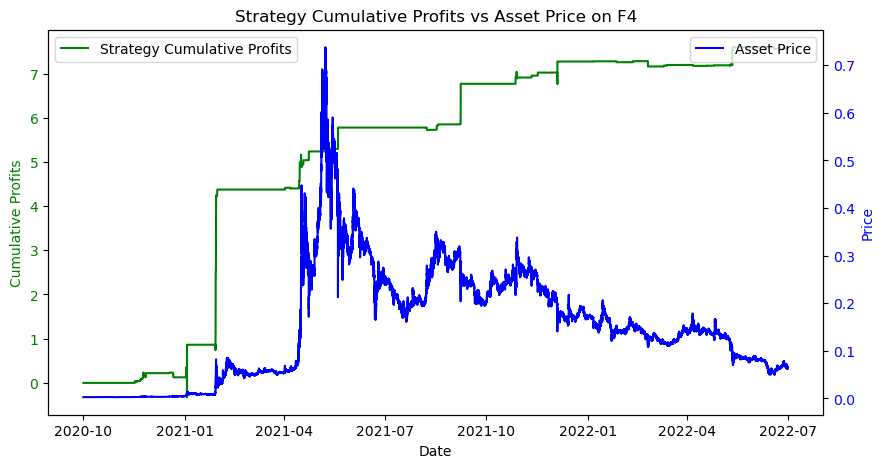

Win Prob: 68.69%
Number of Trades:  99 99
Average Win Return:   0.1424
Average Loss Return: -0.06846
P&L Ratio: 2.1
Maximum Loss of a single trade: -0.2508
Maximum Drawdown: -49.94%
Annual Return: 298.66%
Annual Volatility: 163.05%
Sharpe:  1.832


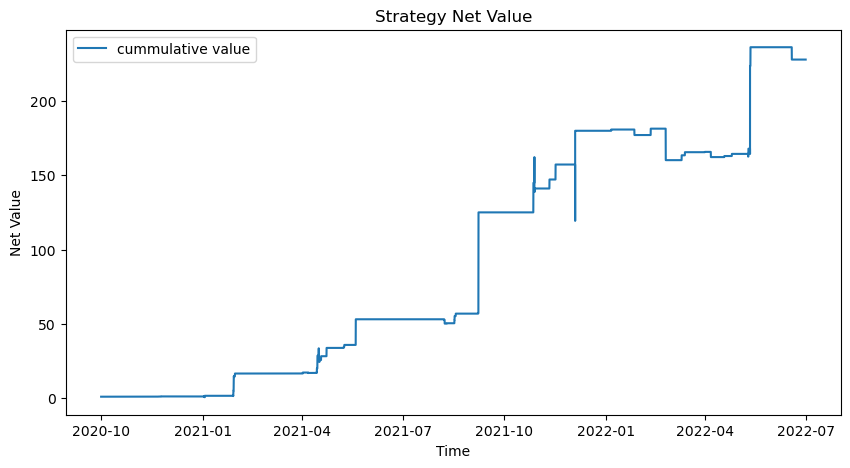

Annual Return: 2123.91%
Annual Volatility: 163.03%
Sharpe:  13.03


Preprocess finished
8.2 Trading signal finished


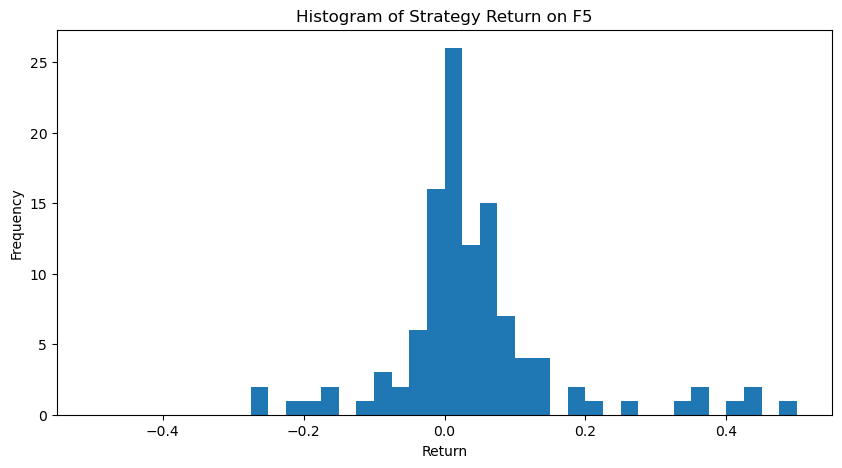

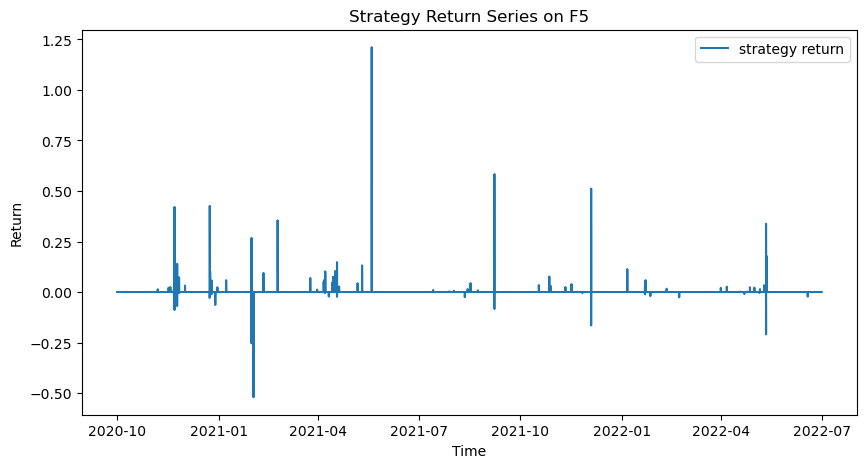

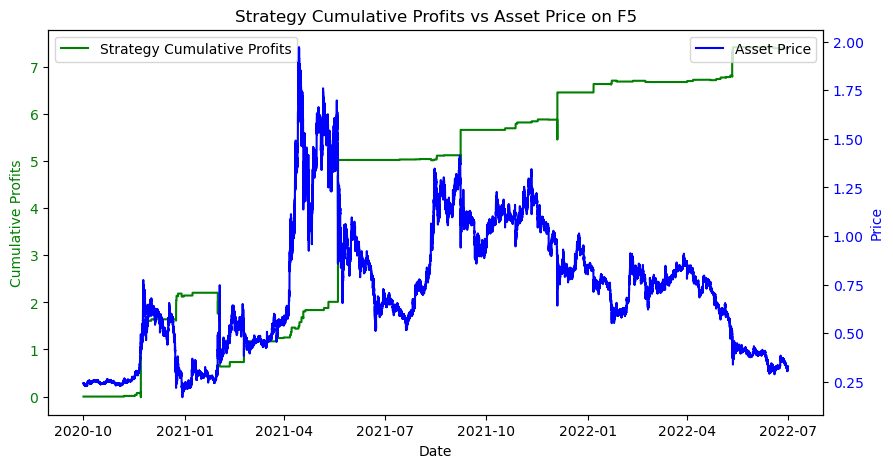

Win Prob: 70.00%
Number of Trades:  120 120
Average Win Return:   0.1259
Average Loss Return: -0.08835
P&L Ratio: 1.4
Maximum Loss of a single trade: -0.5206
Maximum Drawdown: -48.87%
Annual Return: 292.23%
Annual Volatility: 146.29%
Sharpe:  1.998


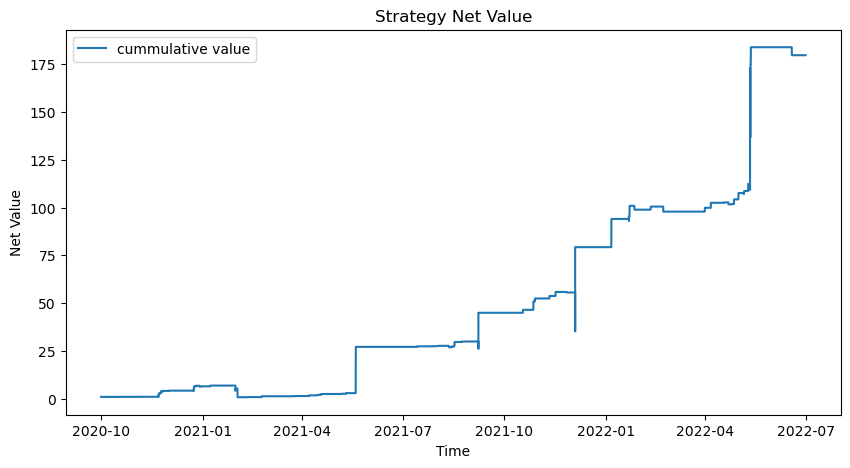

Annual Return: 1841.69%
Annual Volatility: 146.27%
Sharpe:  12.59


Preprocess finished
8.2 Trading signal finished


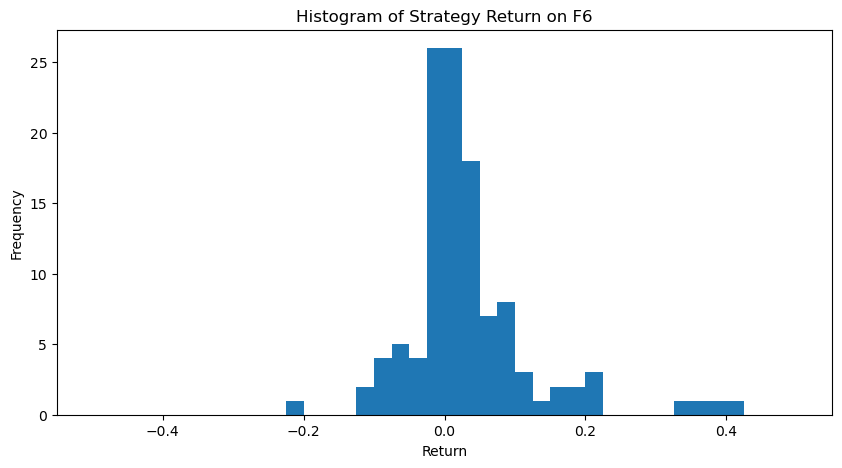

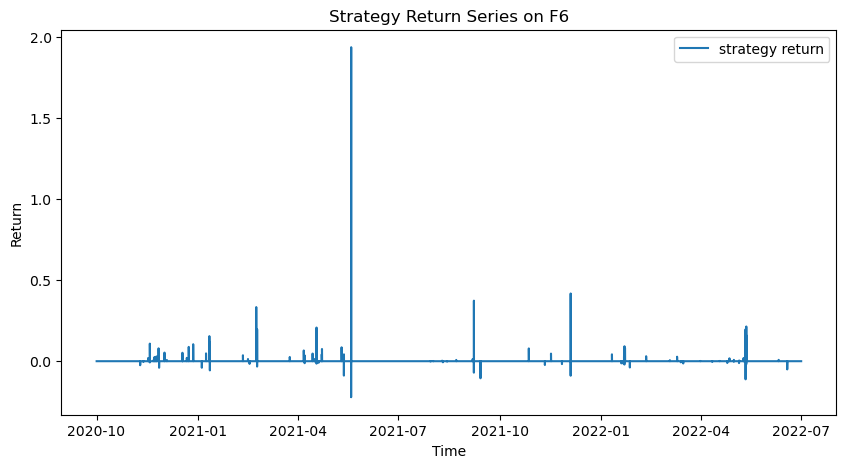

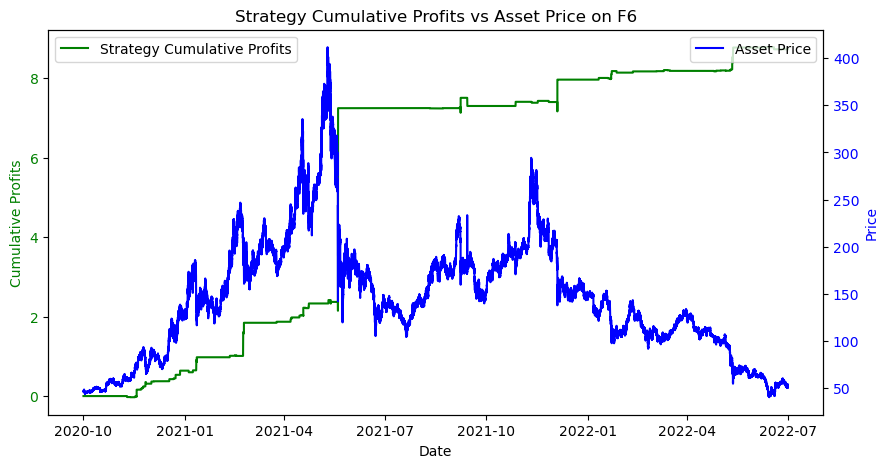

Win Prob: 65.00%
Number of Trades:  120 120
Average Win Return:   0.1316
Average Loss Return: -0.03675
P&L Ratio: 3.6
Maximum Loss of a single trade: -0.2222
Maximum Drawdown: -7.87%
Annual Return: 344.64%
Annual Volatility: 179.86%
Sharpe:  1.916


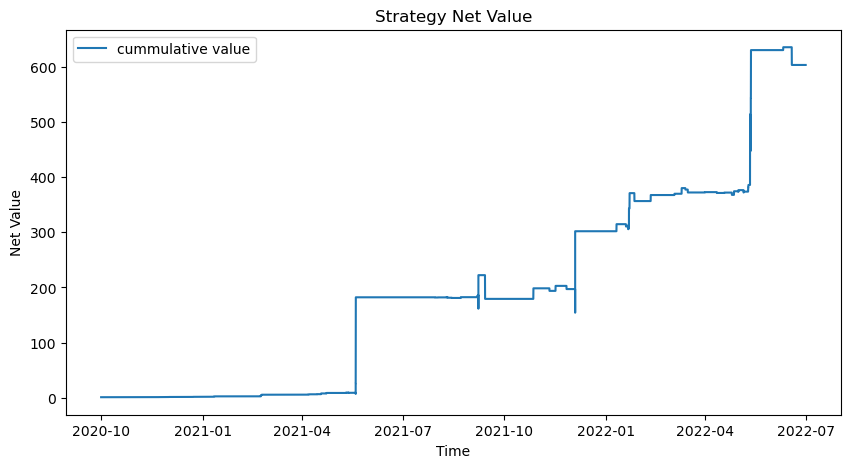

Annual Return: 3780.88%
Annual Volatility: 179.84%
Sharpe:  21.02


Preprocess finished
8.2 Trading signal finished


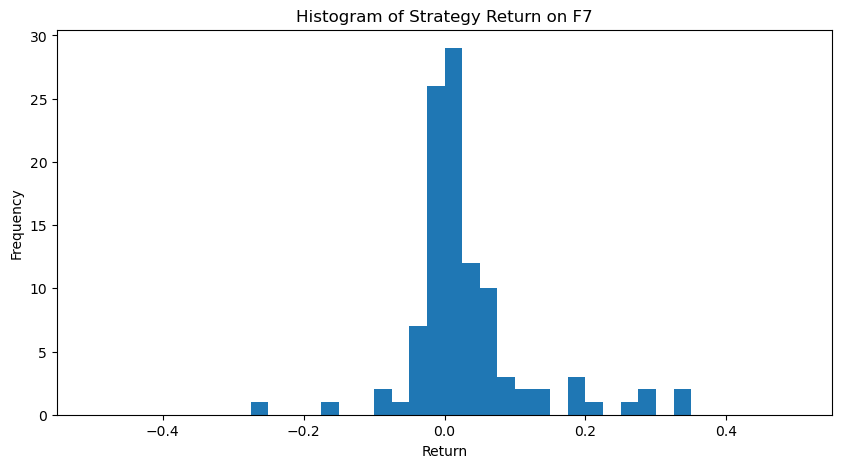

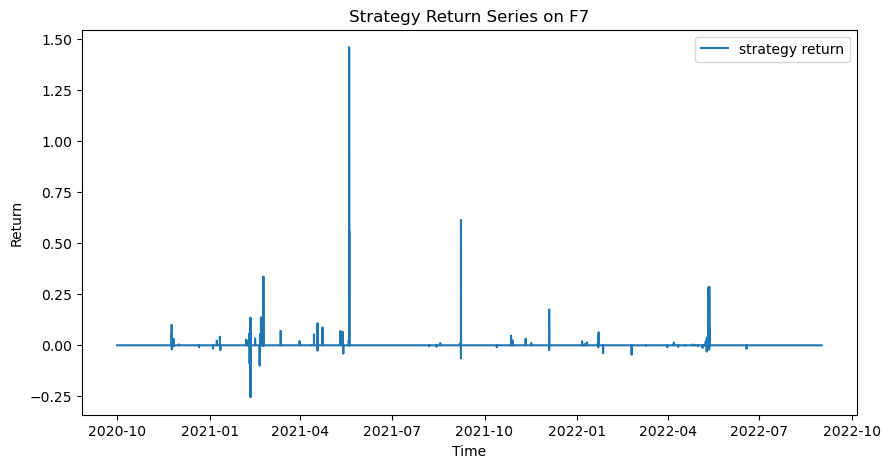

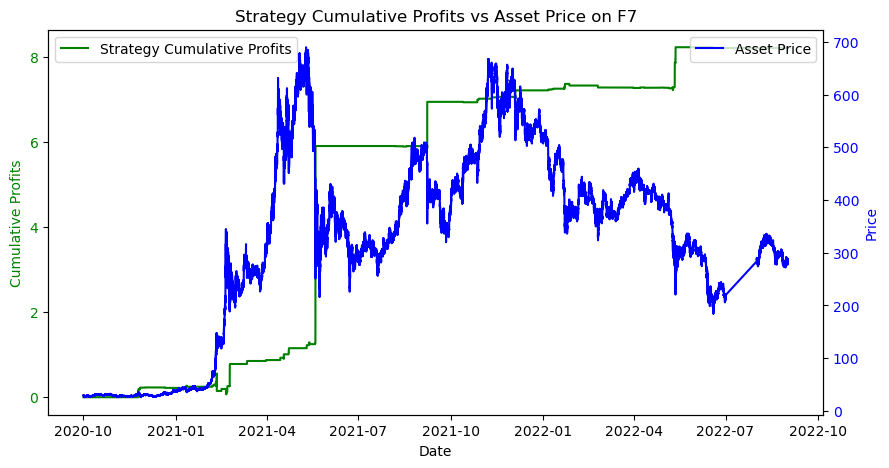

Win Prob: 65.77%
Number of Trades:  111 111
Average Win Return:   0.1279
Average Loss Return: -0.02962
P&L Ratio: 4.3
Maximum Loss of a single trade: -0.2542
Maximum Drawdown: -31.39%
Annual Return: 309.45%
Annual Volatility: 143.77%
Sharpe:  2.152


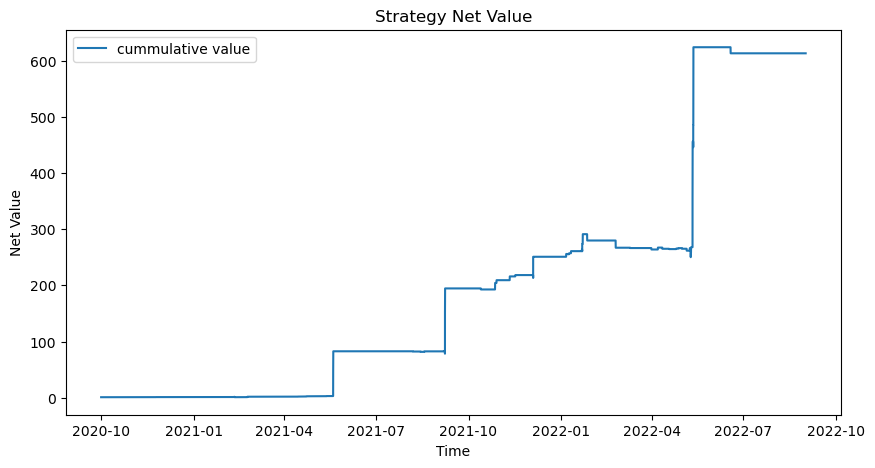

Annual Return: 3815.20%
Annual Volatility: 143.76%
Sharpe:  26.54


Preprocess finished
8.2 Trading signal finished


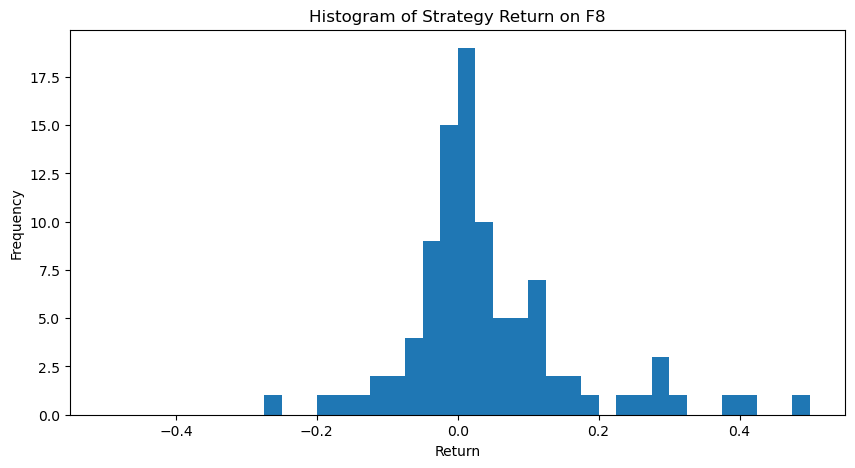

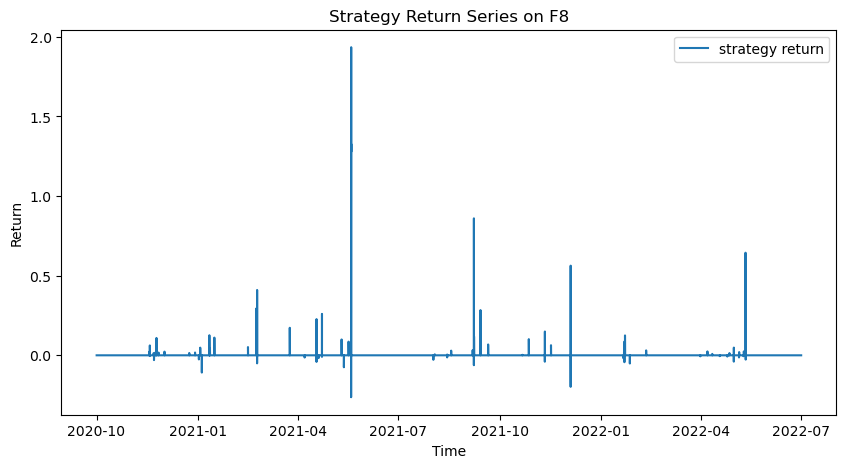

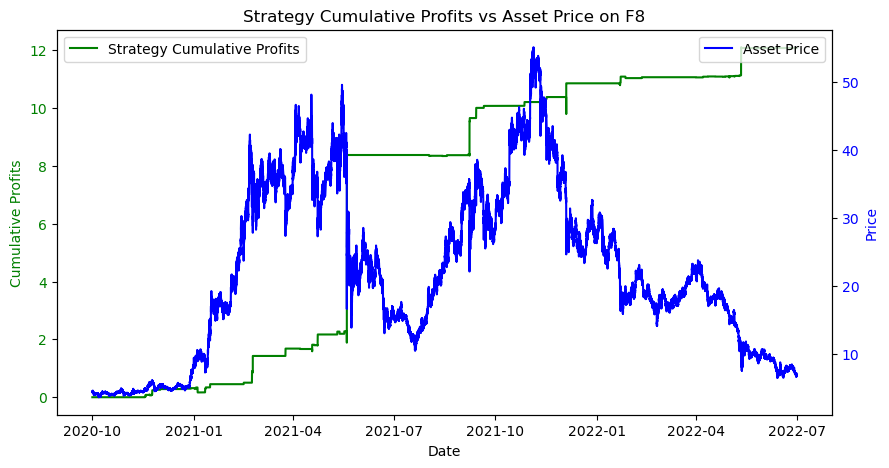

Win Prob: 65.38%
Number of Trades:  104 104
Average Win Return:   0.2048
Average Loss Return: -0.05141
P&L Ratio: 4.0
Maximum Loss of a single trade: -0.2632
Maximum Drawdown: -12.82%
Annual Return: 476.96%
Annual Volatility: 209.46%
Sharpe:  2.277


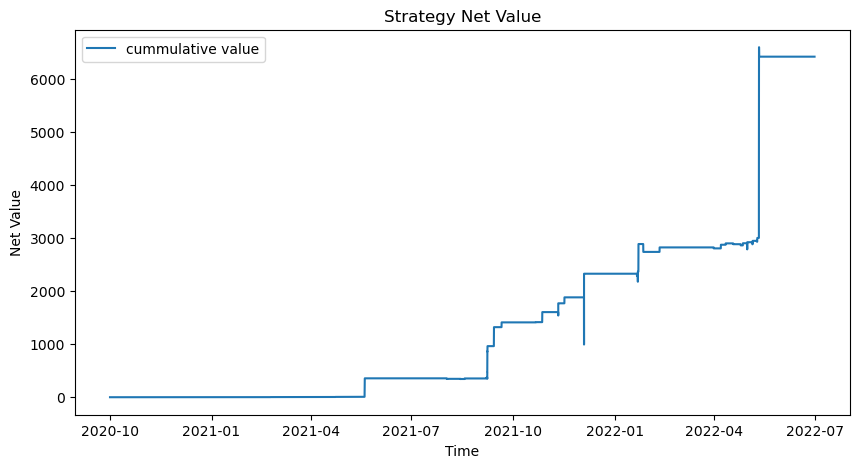

Annual Return: 14893.27%
Annual Volatility: 209.43%
Sharpe:  71.11


Preprocess finished
8.2 Trading signal finished


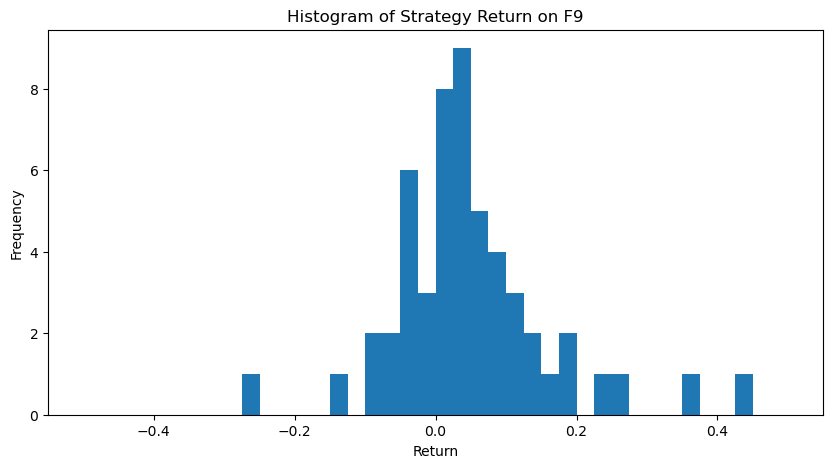

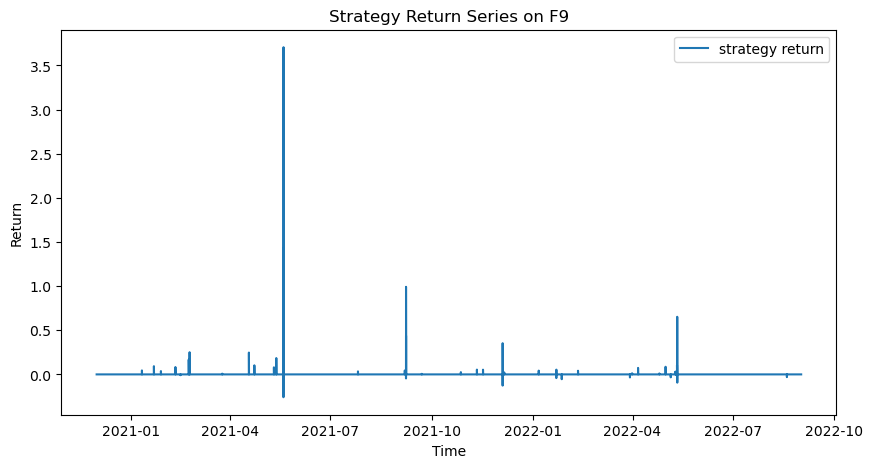

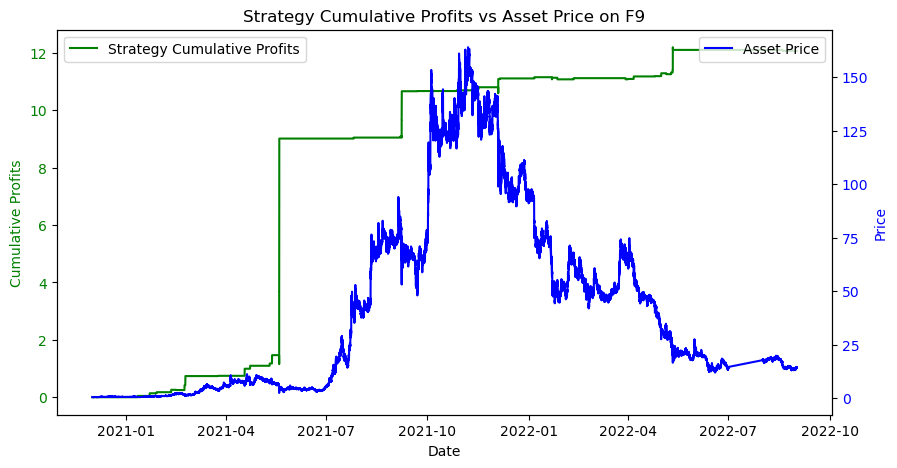

Win Prob: 74.58%
Number of Trades:  59 59
Average Win Return:   0.2948
Average Loss Return: -0.06036
P&L Ratio: 4.9
Maximum Loss of a single trade: -0.2586
Maximum Drawdown: -12.63%
Annual Return: 500.27%
Annual Volatility: 300.83%
Sharpe:  1.663


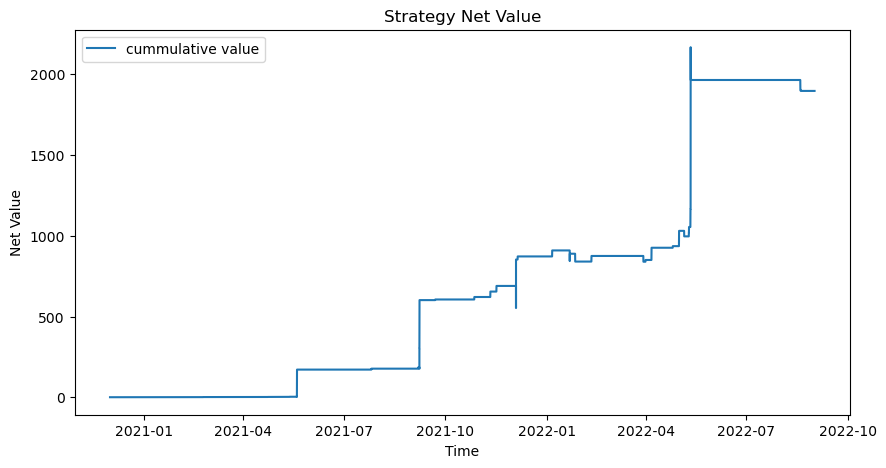

Annual Return: 7368.79%
Annual Volatility: 300.79%
Sharpe:  24.5


Preprocess finished
8.2 Trading signal finished


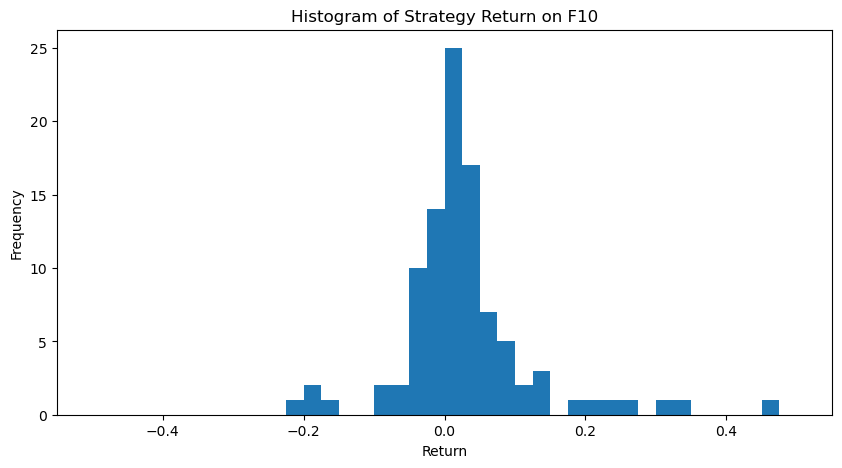

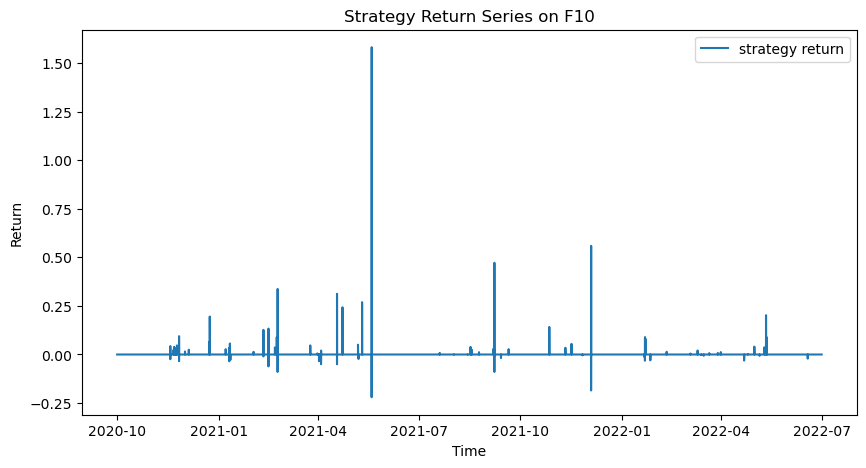

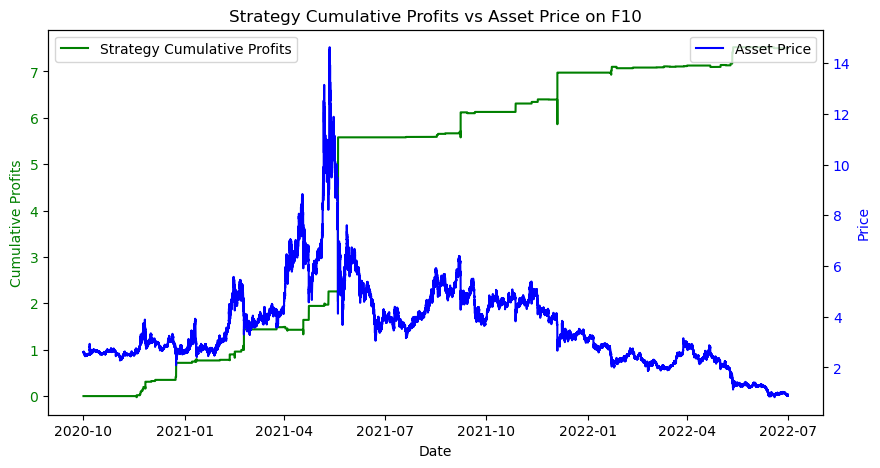

Win Prob: 68.93%
Number of Trades:  103 103
Average Win Return:   0.1276
Average Loss Return: -0.0487
P&L Ratio: 2.6
Maximum Loss of a single trade: -0.2198
Maximum Drawdown: -7.24%
Annual Return: 296.35%
Annual Volatility: 155.13%
Sharpe:  1.91


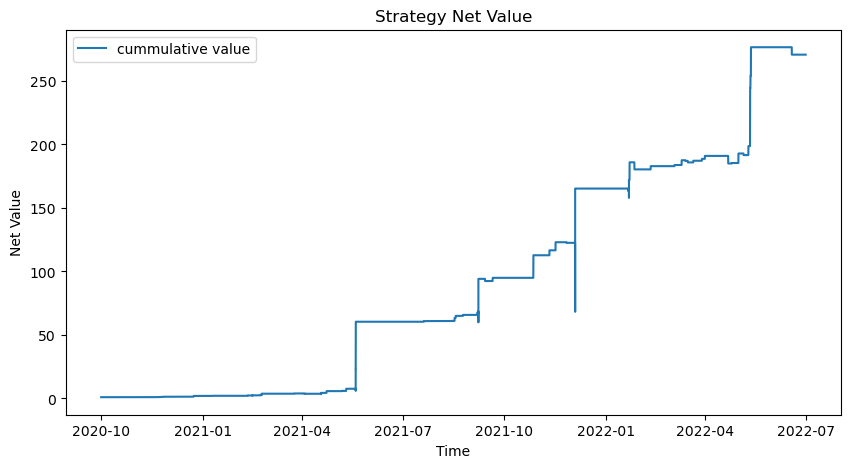

Annual Return: 2354.75%
Annual Volatility: 155.11%
Sharpe:  15.18


Preprocess finished
8.2 Trading signal finished


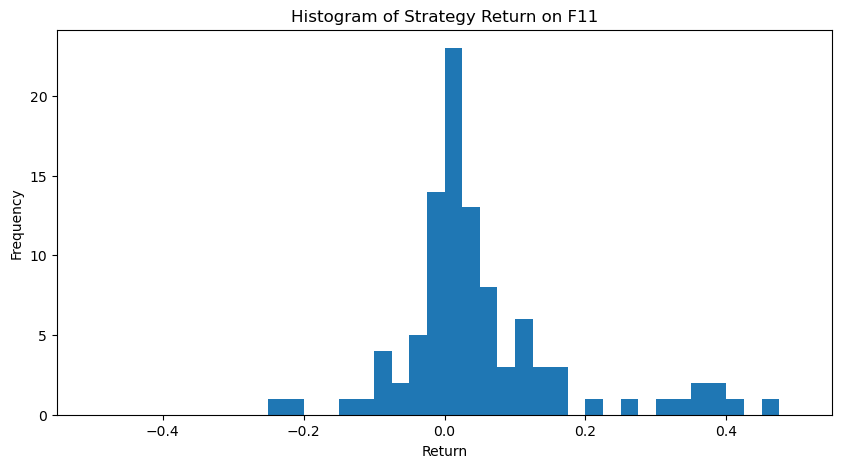

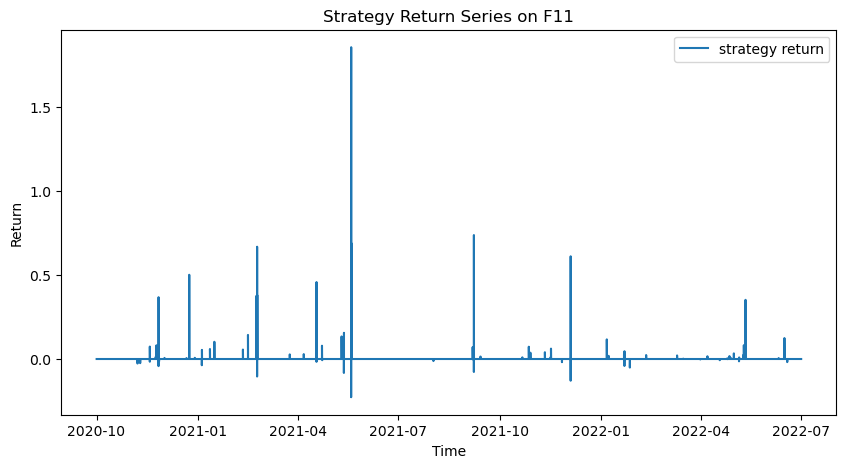

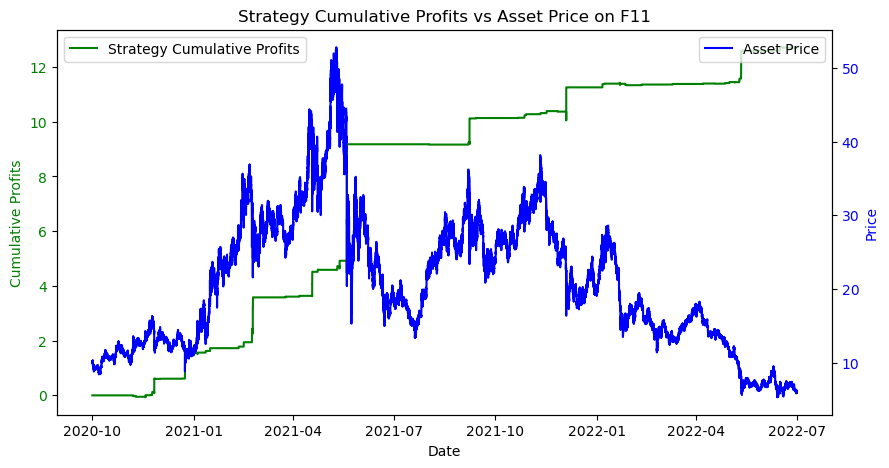

Win Prob: 72.90%
Number of Trades:  107 107
Average Win Return:   0.1821
Average Loss Return: -0.05179
P&L Ratio: 3.5
Maximum Loss of a single trade: -0.2277
Maximum Drawdown: -7.33%
Annual Return: 501.87%
Annual Volatility: 196.38%
Sharpe:  2.556


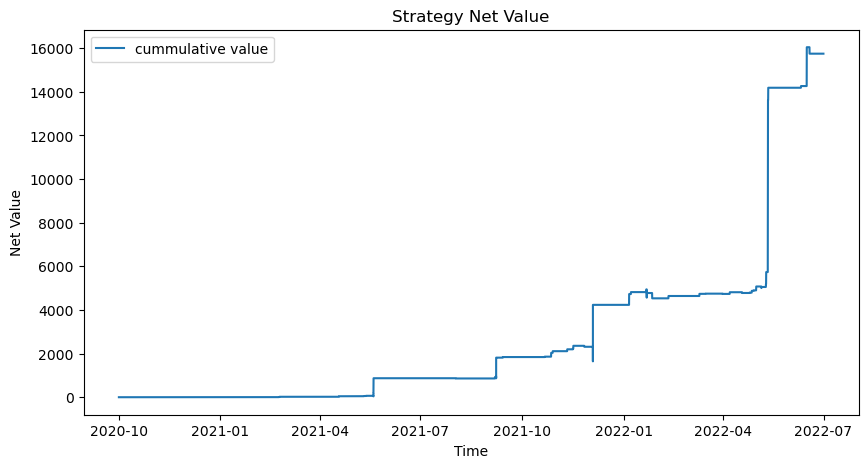

Annual Return: 24929.33%
Annual Volatility: 196.36%
Sharpe:  127.0


Preprocess finished
8.2 Trading signal finished


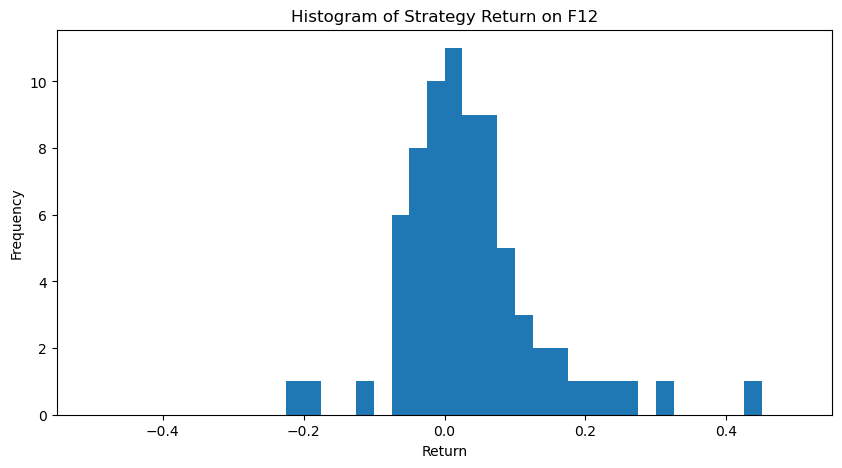

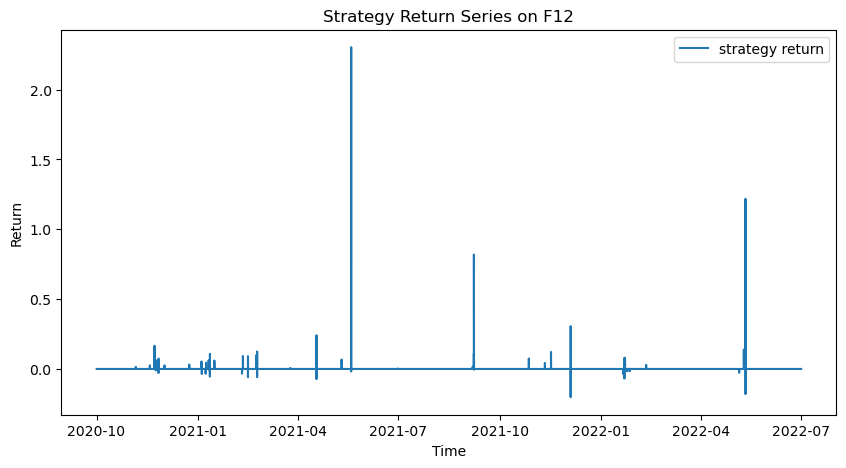

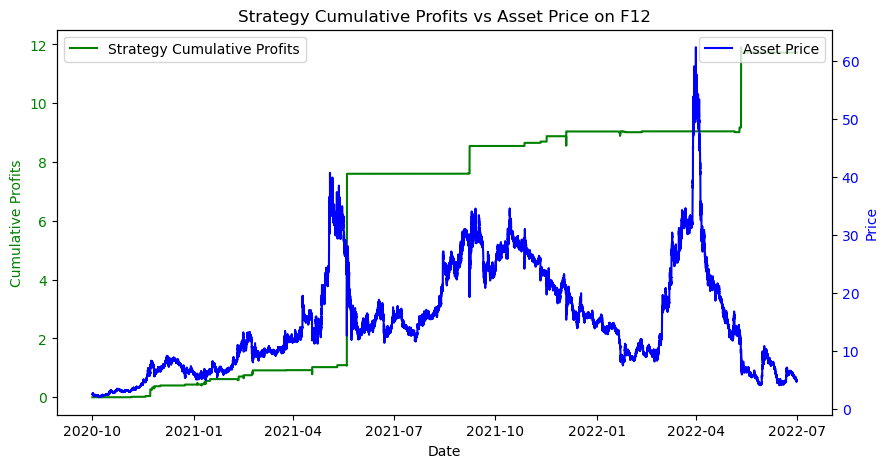

Win Prob: 66.67%
Number of Trades:  81 81
Average Win Return:   0.2401
Average Loss Return: -0.04586
P&L Ratio: 5.2
Maximum Loss of a single trade: -0.2024
Maximum Drawdown: -7.20%
Annual Return: 463.28%
Annual Volatility: 238.09%
Sharpe:  1.946


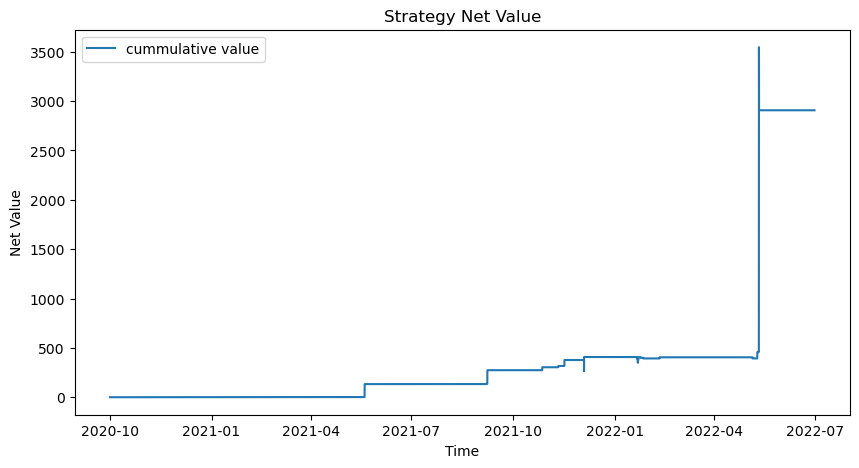

Annual Return: 9430.26%
Annual Volatility: 238.06%
Sharpe:  39.61


Preprocess finished
8.2 Trading signal finished


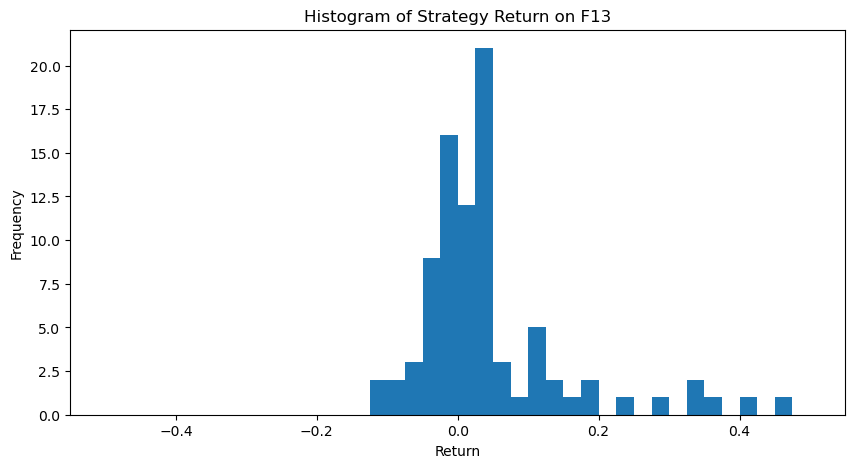

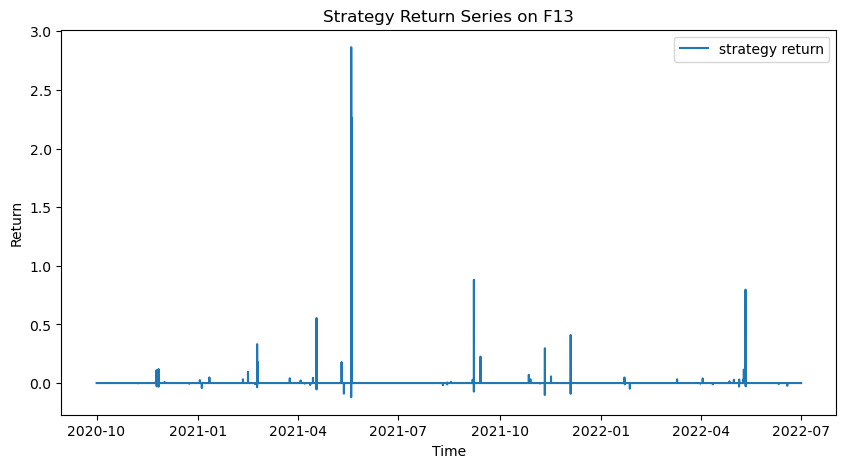

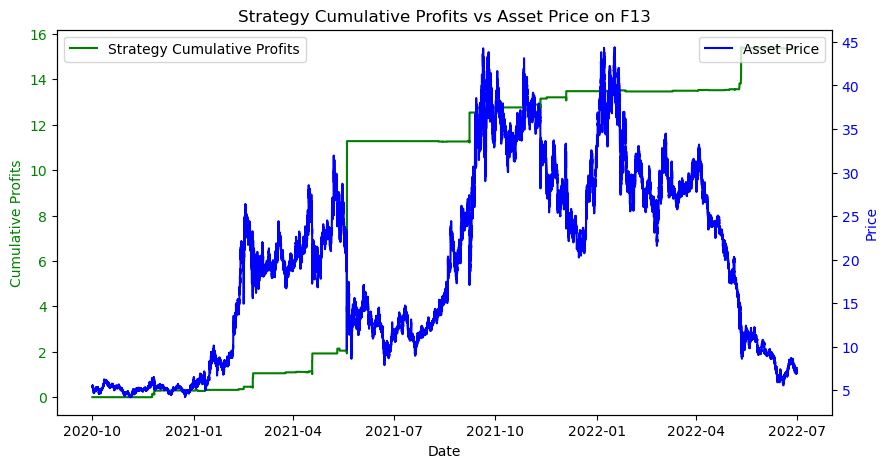

Win Prob: 65.96%
Number of Trades:  94 94
Average Win Return:   0.2652
Average Loss Return: -0.03412
P&L Ratio: 7.8
Maximum Loss of a single trade: -0.1209
Maximum Drawdown: -6.73%
Annual Return: 606.59%
Annual Volatility: 301.36%
Sharpe:  2.013


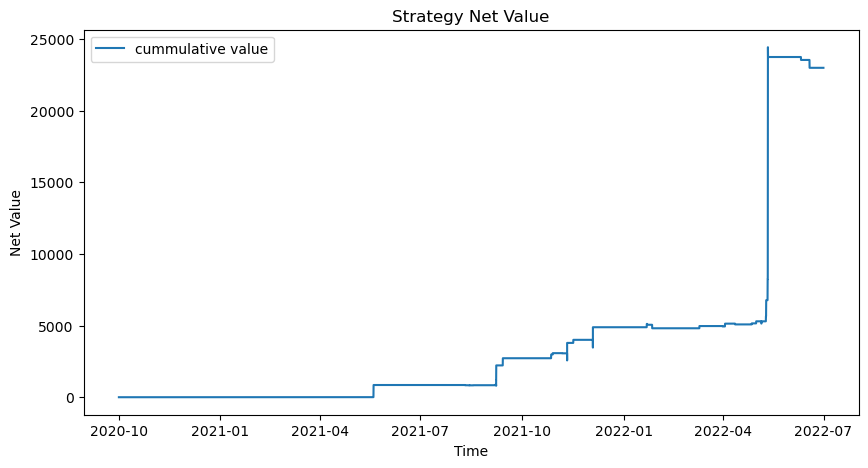

Annual Return: 30970.29%
Annual Volatility: 301.32%
Sharpe:  102.8


Preprocess finished
8.2 Trading signal finished


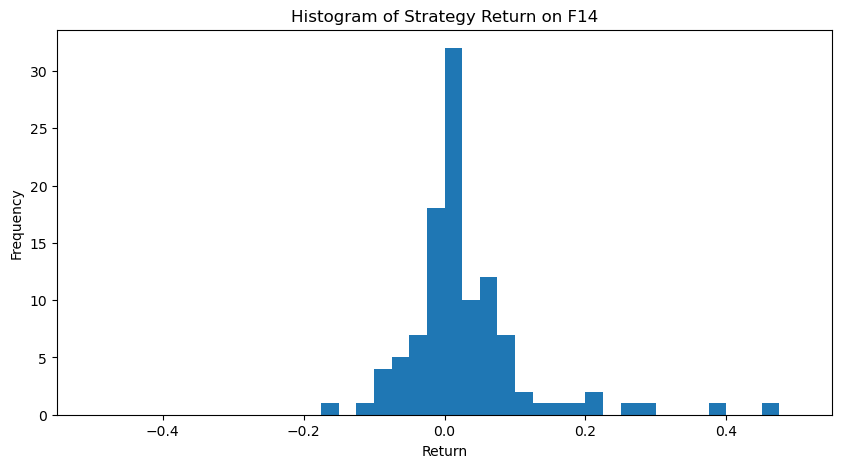

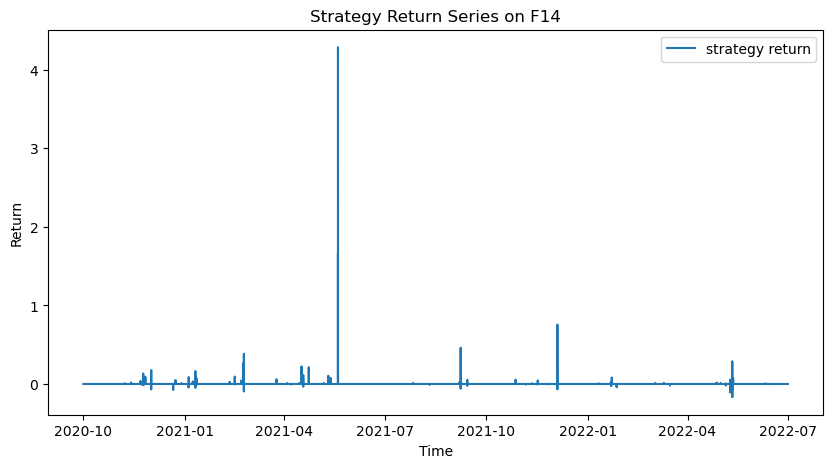

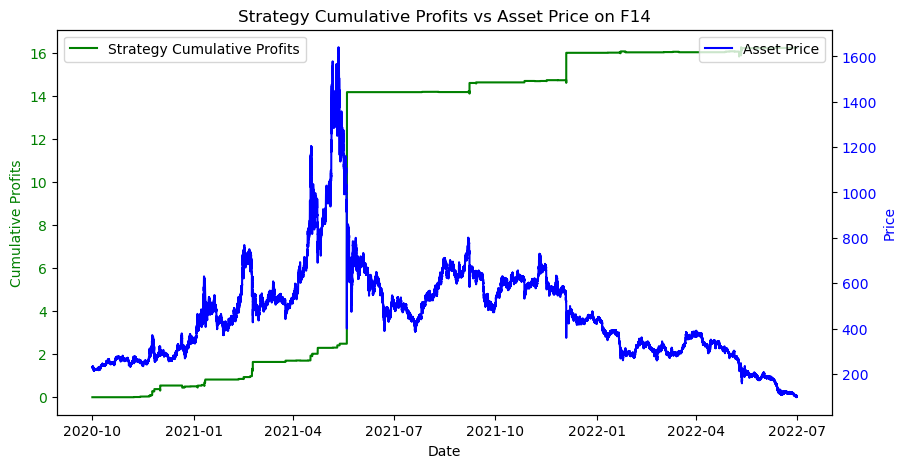

Win Prob: 68.70%
Number of Trades:  115 115
Average Win Return:   0.2228
Average Loss Return: -0.03822
P&L Ratio: 5.8
Maximum Loss of a single trade: -0.1688
Maximum Drawdown: -6.24%
Annual Return: 641.01%
Annual Volatility: 400.07%
Sharpe:  1.602


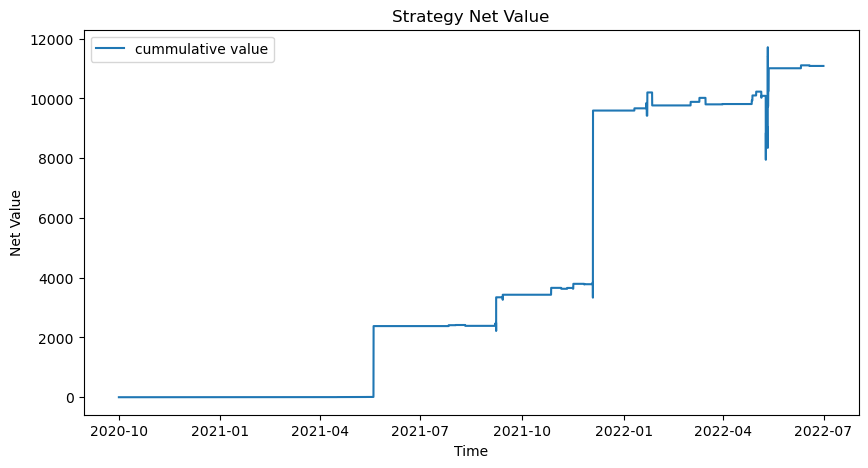

Annual Return: 20380.64%
Annual Volatility: 400.02%
Sharpe:  50.95


Preprocess finished
8.2 Trading signal finished


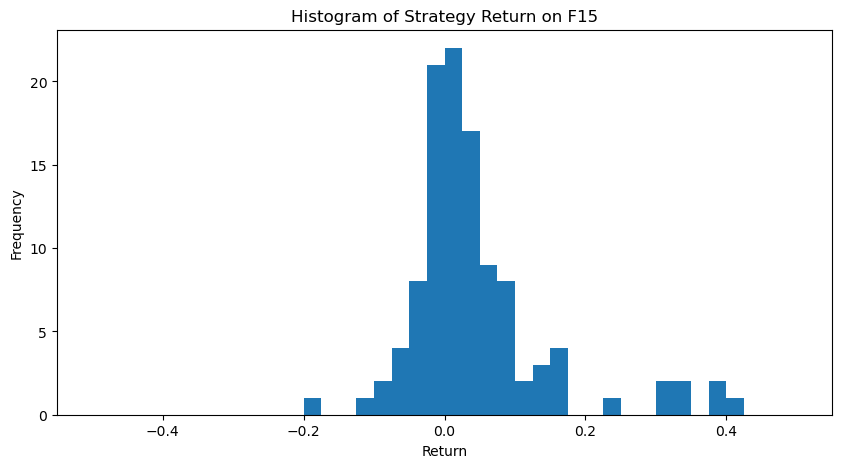

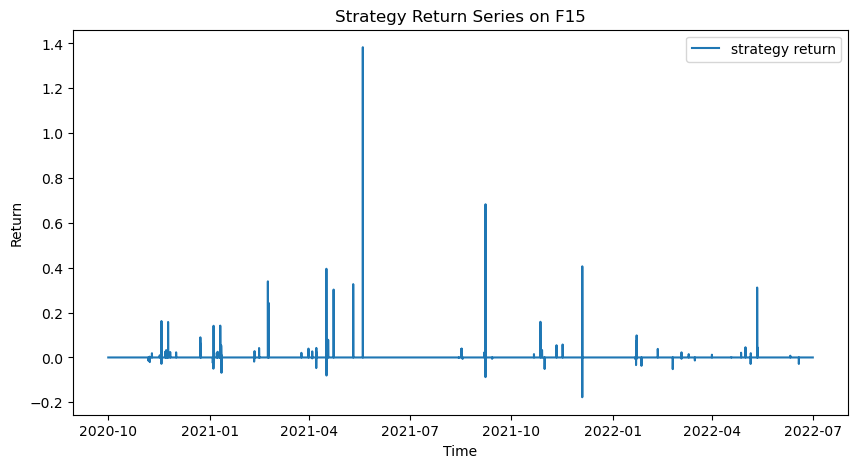

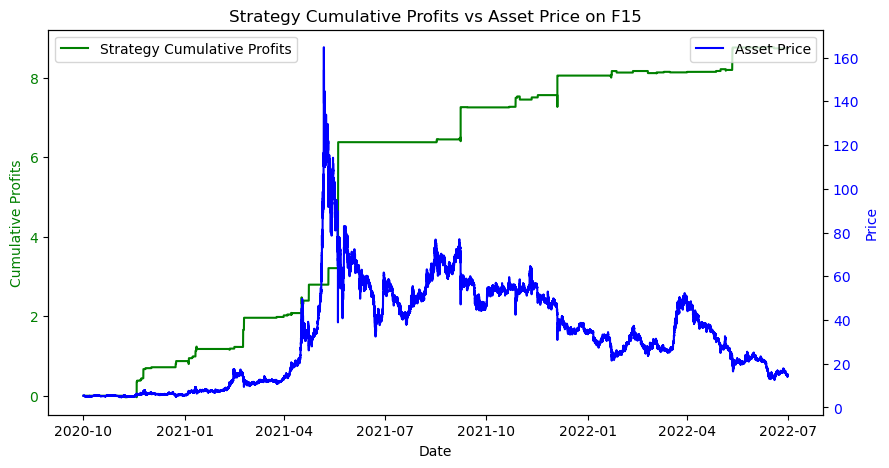

Win Prob: 67.54%
Number of Trades:  114 114
Average Win Return:   0.1285
Average Loss Return: -0.03148
P&L Ratio: 4.1
Maximum Loss of a single trade: -0.1773
Maximum Drawdown: -4.65%
Annual Return: 345.04%
Annual Volatility: 142.20%
Sharpe:  2.426


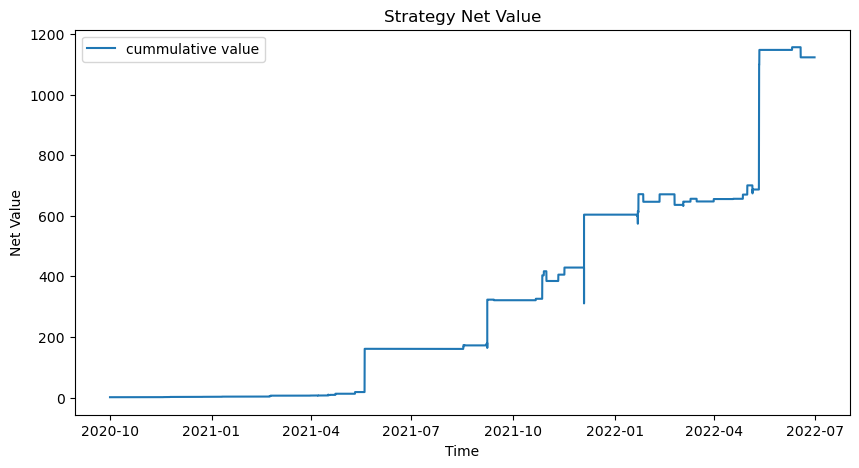

Annual Return: 5435.09%
Annual Volatility: 142.18%
Sharpe:  38.23


Preprocess finished
8.2 Trading signal finished


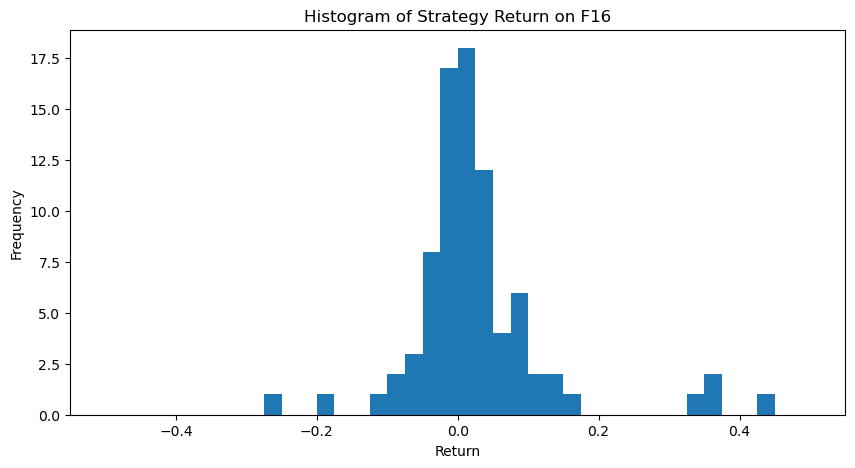

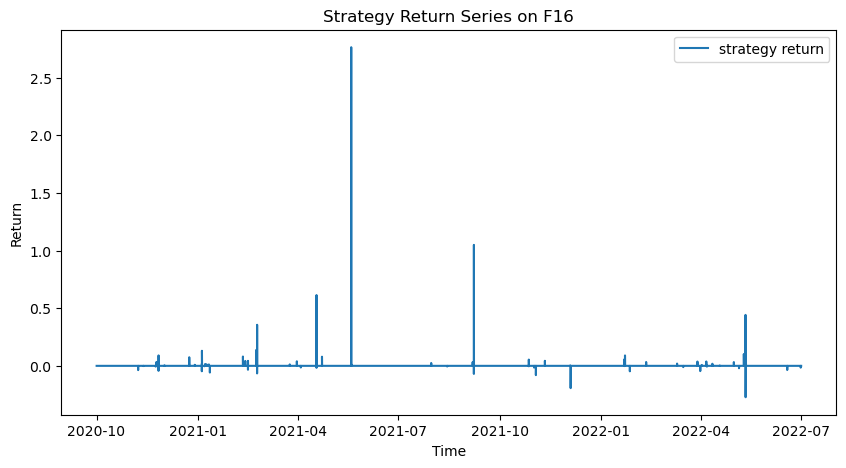

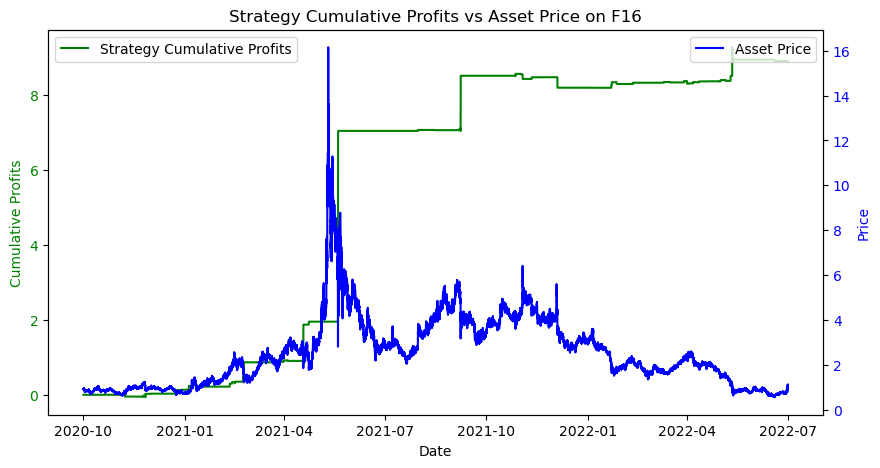

Win Prob: 62.07%
Number of Trades:  87 87
Average Win Return:   0.1914
Average Loss Return: -0.04354
P&L Ratio: 4.4
Maximum Loss of a single trade: -0.2722
Maximum Drawdown: -6.52%
Annual Return: 351.59%
Annual Volatility: 230.05%
Sharpe:  1.528


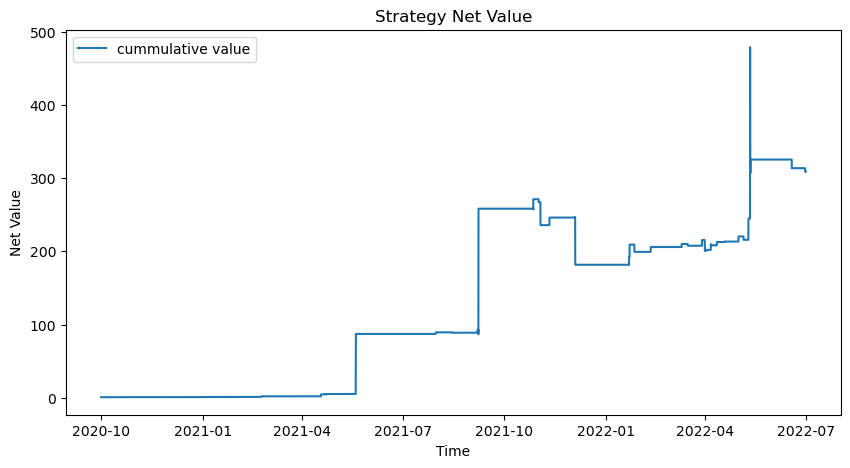

Annual Return: 2545.10%
Annual Volatility: 230.02%
Sharpe:  11.06


Preprocess finished
8.2 Trading signal finished


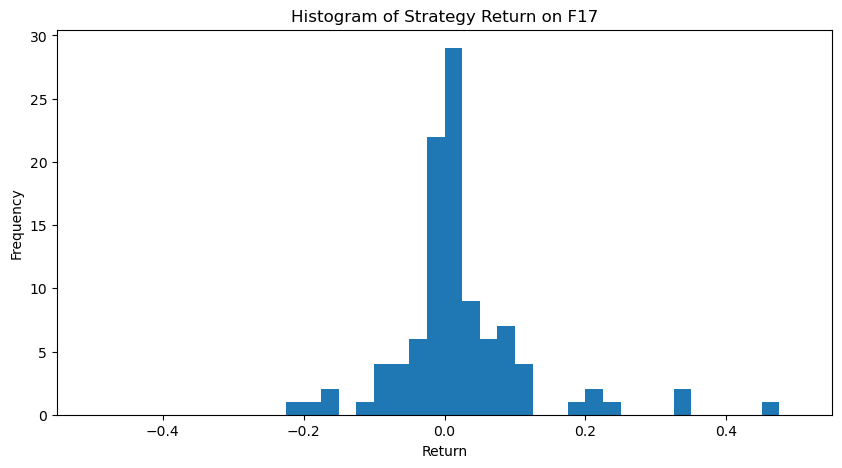

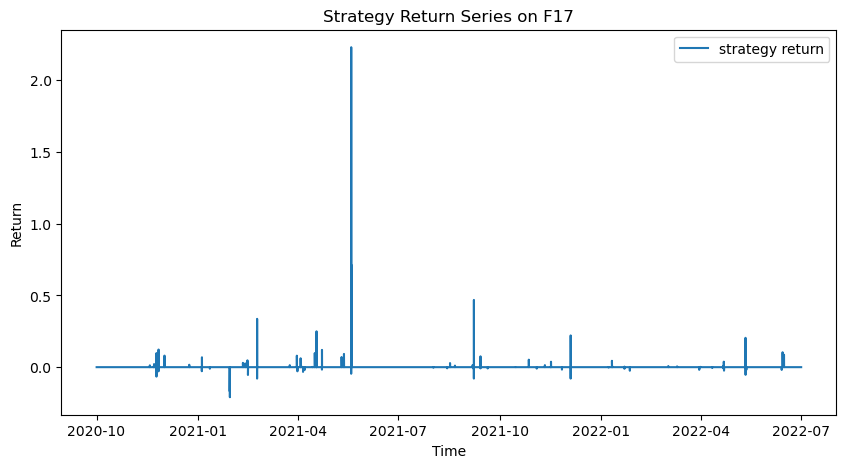

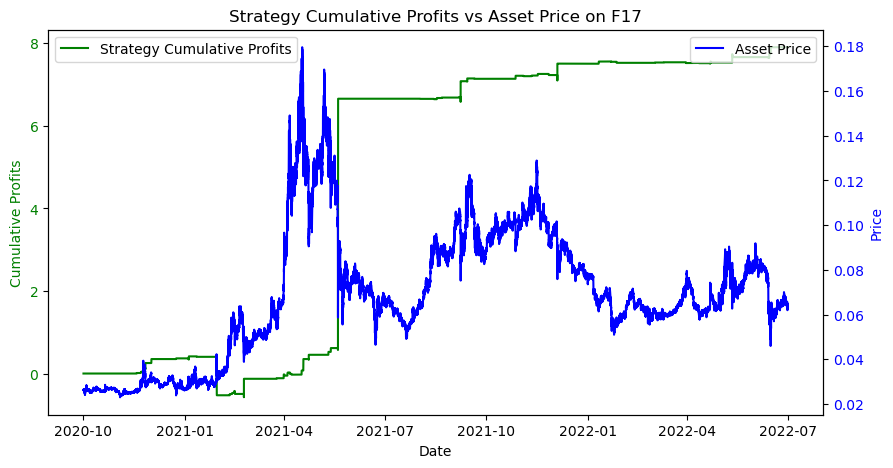

Win Prob: 61.68%
Number of Trades:  107 107
Average Win Return:   0.1484
Average Loss Return: -0.04611
P&L Ratio: 3.2
Maximum Loss of a single trade: -0.2095
Maximum Drawdown: -69.92%
Annual Return: 312.39%
Annual Volatility: 206.27%
Sharpe:  1.514


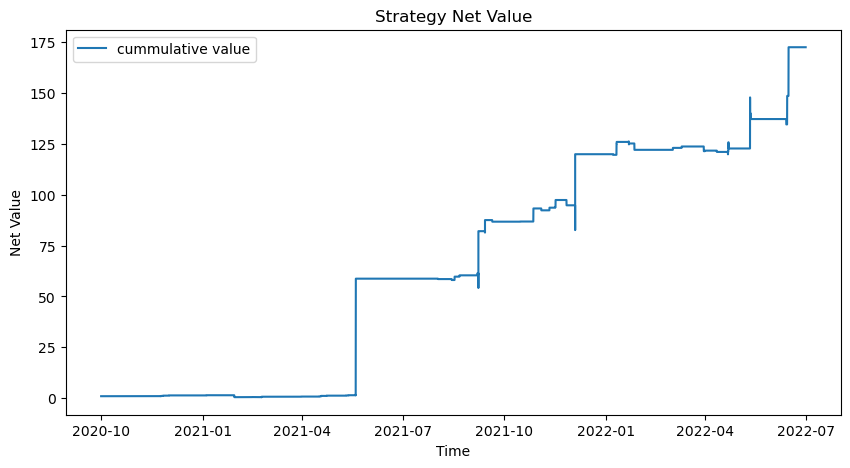

Annual Return: 1796.70%
Annual Volatility: 206.24%
Sharpe:  8.712


Preprocess finished
8.2 Trading signal finished


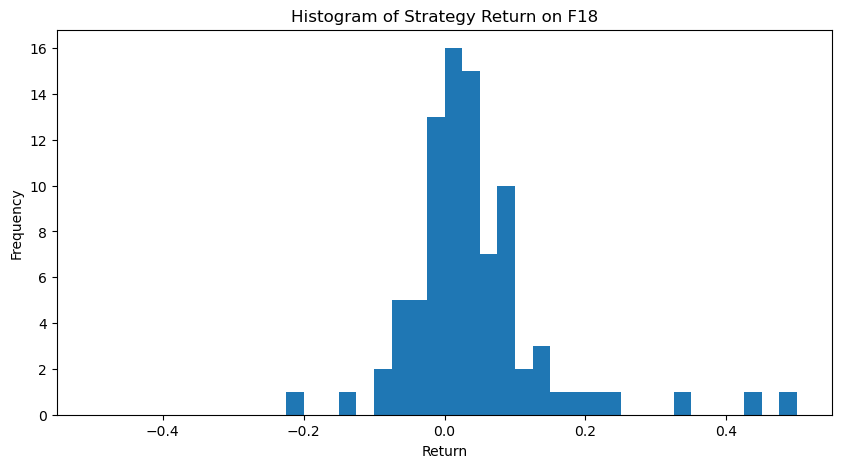

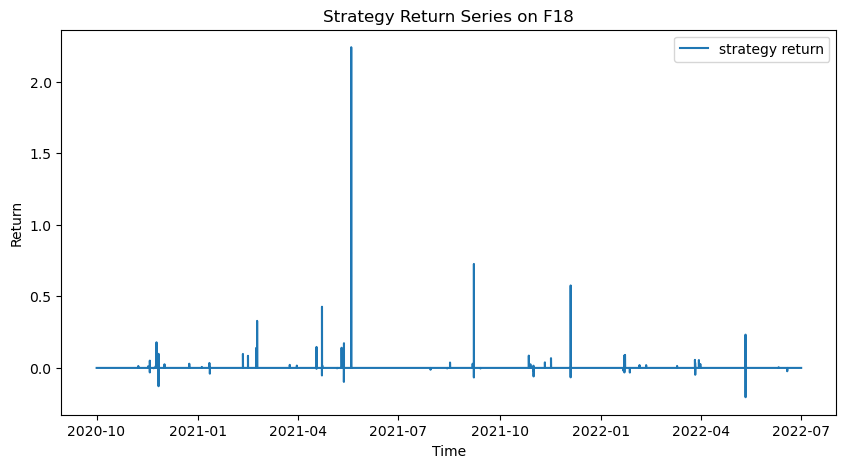

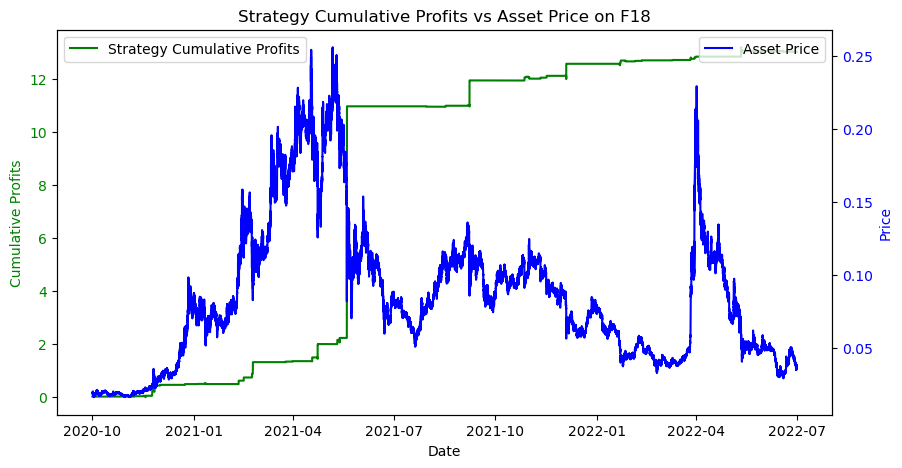

Win Prob: 71.28%
Number of Trades:  94 94
Average Win Return:   0.2115
Average Loss Return: -0.04218
P&L Ratio: 5.0
Maximum Loss of a single trade: -0.2048
Maximum Drawdown: -16.17%
Annual Return: 514.90%
Annual Volatility: 256.43%
Sharpe:  2.008


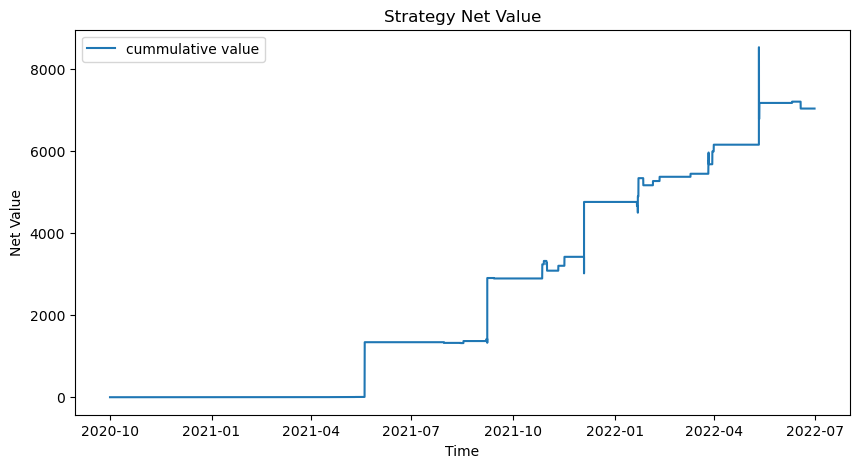

Annual Return: 15689.36%
Annual Volatility: 256.39%
Sharpe:  61.19




In [435]:
# strategy 8.2 use avg price as buy and sell price
strategy8_2_list = []
profit_des_8_2 = pd.DataFrame()
tbv_des_8_2 = pd.DataFrame()
tbv_tv_des_8_2 = pd.DataFrame()
tbv_pct_des_8_2 = pd.DataFrame()
ma_des_8_2 = pd.DataFrame()
for idx in range(len(data_list)):
    name = 'F'+str(idx+1)
    stra8_2 = CTAStrategy(data_list[idx],'open_time','signal','close',120,5,name)
    stra8_2.data_preprocess()
    stra8_2.find_signal_8_2(10000,0.1,1)
    stra8_2.get_strategy_returns(1/1000)
    stra8_2.plot_hist_seires()
    stra8_2.plot_cumsum_profits()
    stra8_2.get_win_prob()
    profit_des = stra8_2.get_avg_win_return()
    stra8_2.get_maximum_drawdown()
    stra8_2.get_sharpe()
    stra8_2.plot_cumprod_value()
    tbv_des, tbv_tv_des, tbv_pct_des = stra8_2.taker_buy_volume_stats()
    ma_des = stra8_2.moving_average_stats()
    strategy8_2_list.append(stra8_2)
    if (profit_des_8_2.empty):
        profit_des_8_2 = profit_des
        tbv_des_8_2 = tbv_des
        tbv_tv_des_8_2 = tbv_tv_des
        tbv_pct_des_8_2 = tbv_pct_des
        ma_des_8_2 = ma_des
    else:
        profit_des_8_2 = profit_des_8_2.join(profit_des)
        tbv_des_8_2 = tbv_des_8_2.join(tbv_des)
        tbv_tv_des_8_2 =tbv_tv_des_8_2.join(tbv_tv_des)
        tbv_pct_des_8_2 = tbv_pct_des_8_2.join(tbv_pct_des)
        ma_des_8_2 = ma_des_8_2.join(ma_des)
    print('\n')

# Strategy 8.3

After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


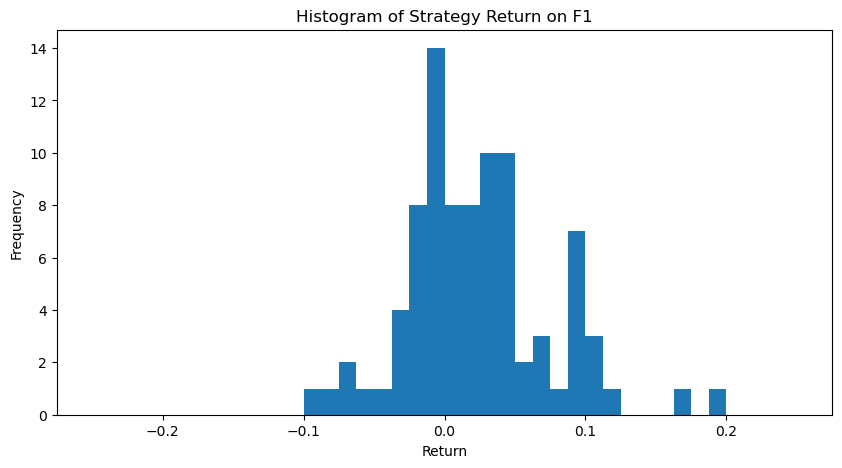

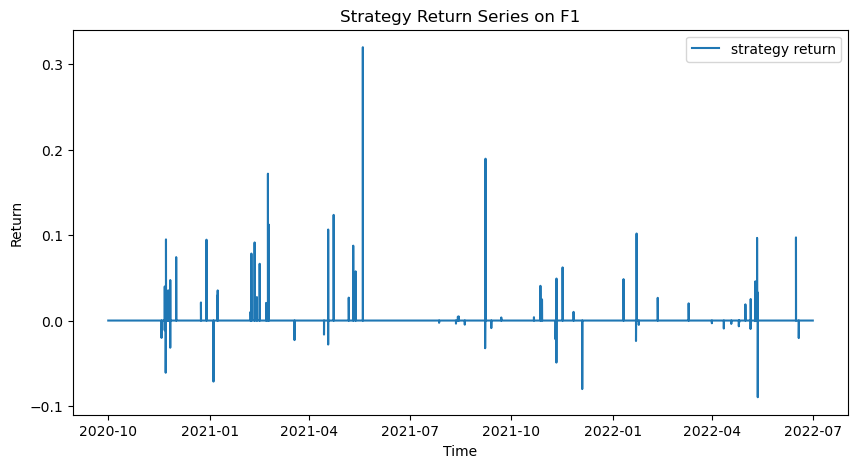

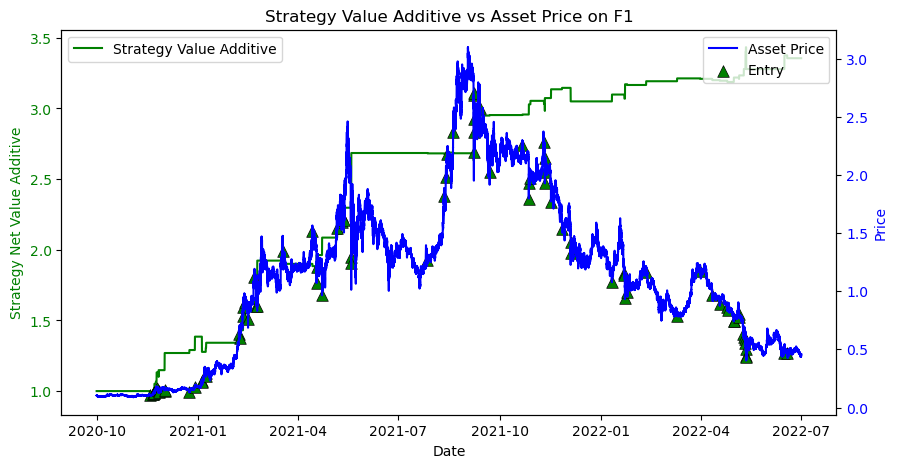

Win Prob: 63.64%
Number of Trades:  88 88
Average Win Return:   0.05603
Average Loss Return: -0.02445
P&L Ratio: 2.3
Maximum Loss of a single trade: -0.08972
Maximum Drawdown: -14.87%
Annualized Return: 93.04%
Annualized Volatility: 38.56%
Sharpe:  2.335


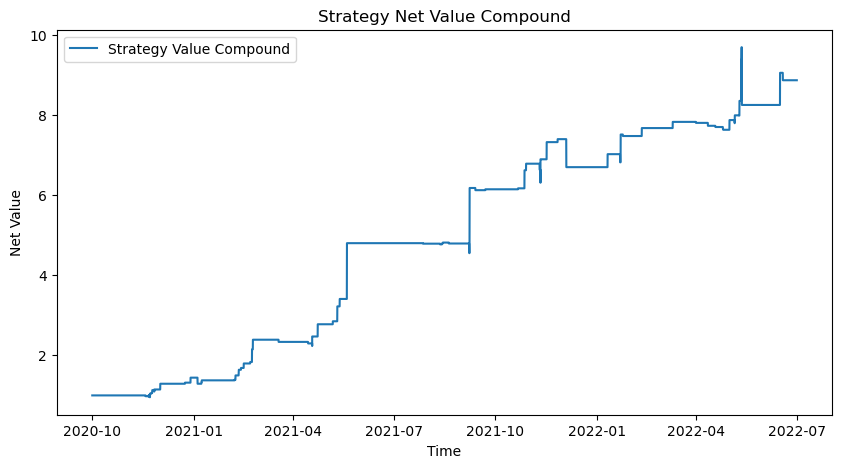

CAGR: 248.16%
Annual Return: 93.04%
Annual Volatility: 38.56%
Sharpe:  2.335


After preprocess the data has 192671 columns.
Preprocess finished
8.3 Trading signal finished


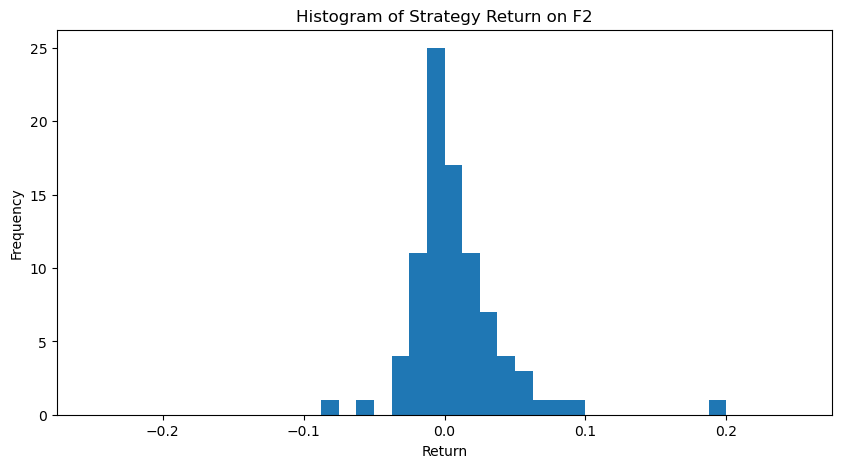

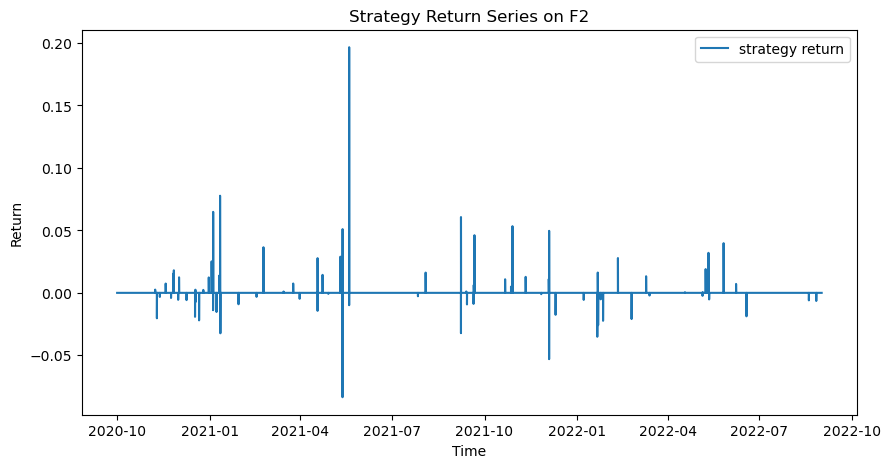

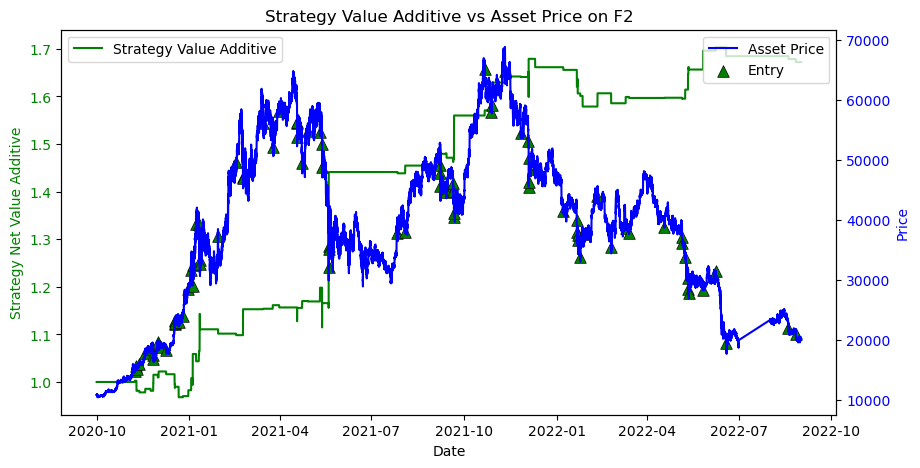

Win Prob: 52.27%
Number of Trades:  88 88
Average Win Return:   0.02727
Average Loss Return: -0.01386
P&L Ratio: 2.0
Maximum Loss of a single trade: -0.08355
Maximum Drawdown: -9.68%
Annualized Return: 25.32%
Annualized Volatility: 19.63%
Sharpe:  1.137


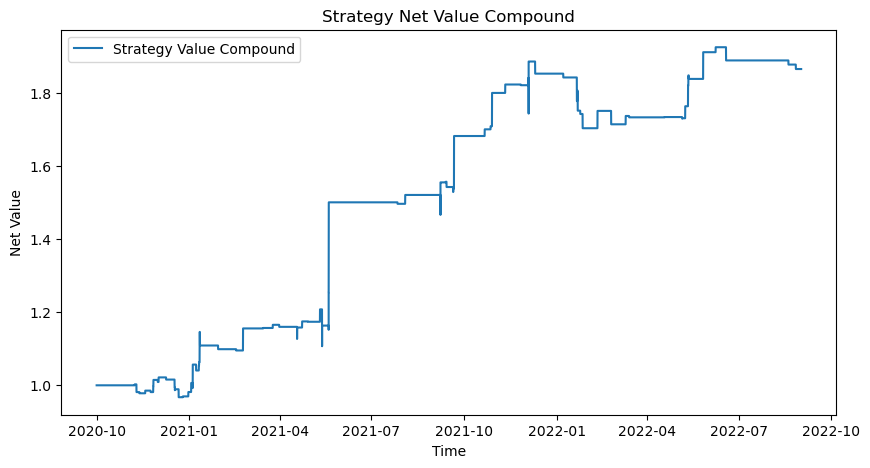

CAGR: 42.82%
Annual Return: 25.32%
Annual Volatility: 19.63%
Sharpe:  1.137


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


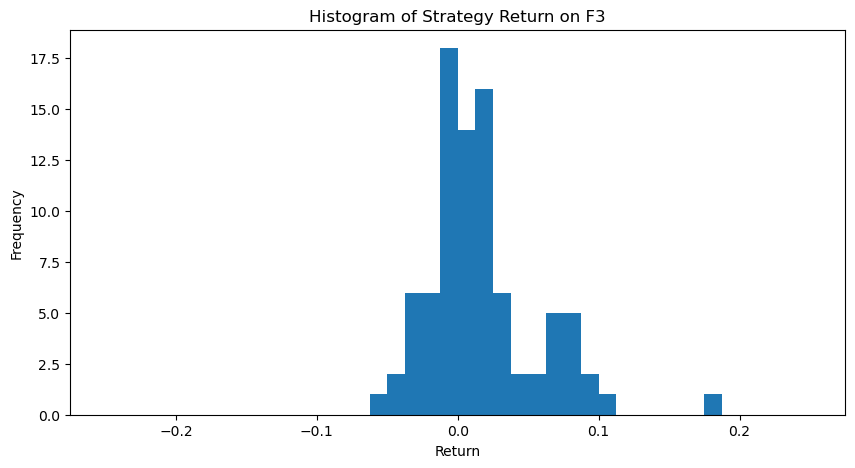

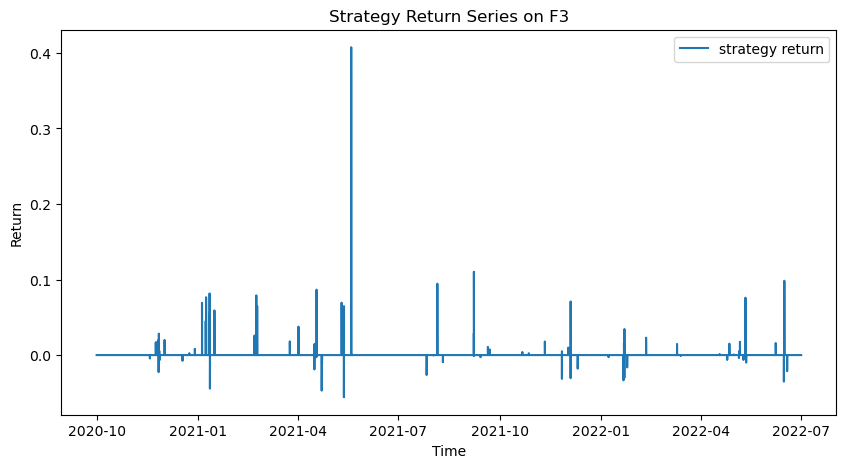

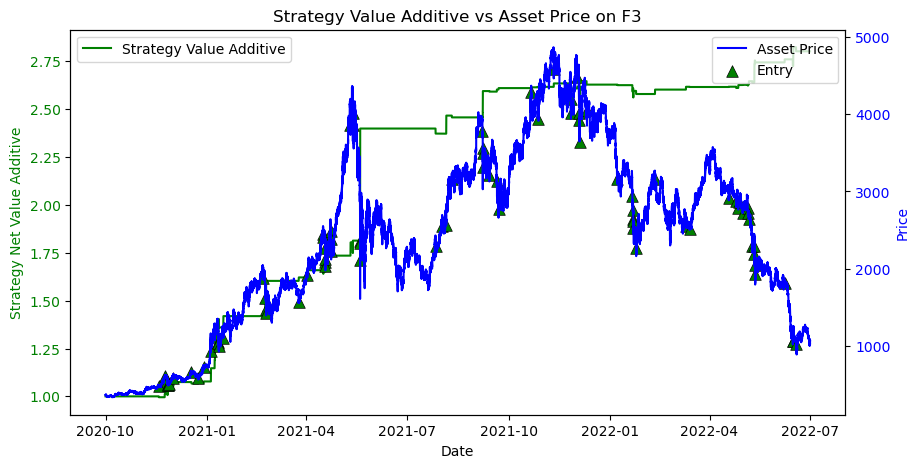

Win Prob: 62.50%
Number of Trades:  88 88
Average Win Return:   0.0426
Average Loss Return: -0.01637
P&L Ratio: 2.6
Maximum Loss of a single trade: -0.05578
Maximum Drawdown: -8.30%
Annualized Return: 71.20%
Annualized Volatility: 35.53%
Sharpe:  1.92


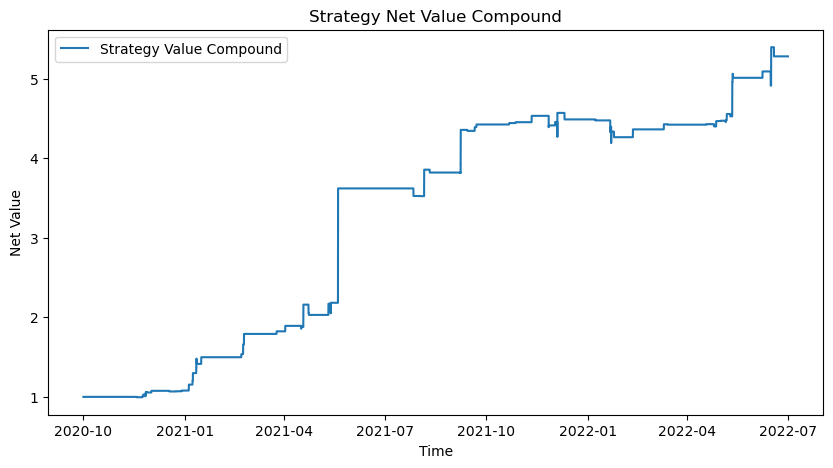

CAGR: 158.81%
Annual Return: 71.20%
Annual Volatility: 35.53%
Sharpe:  1.92


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


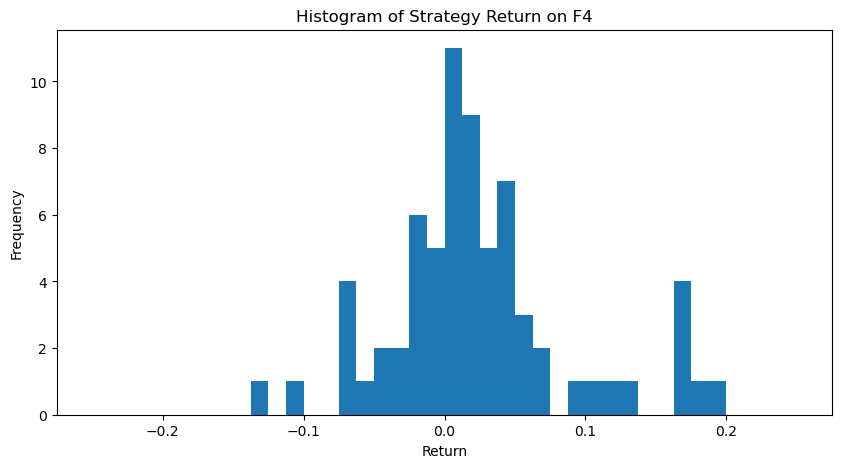

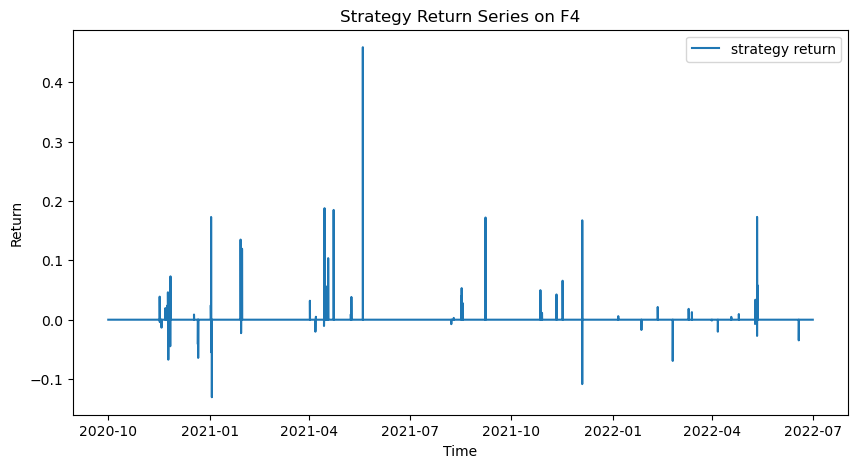

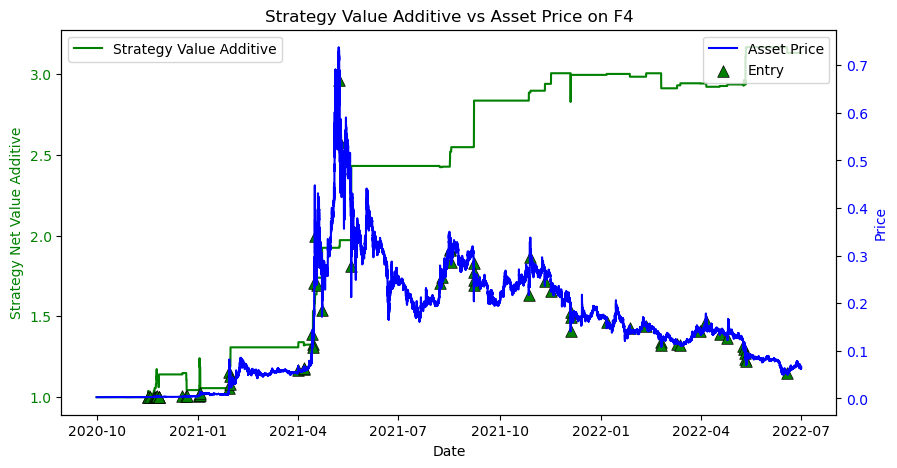

Win Prob: 68.57%
Number of Trades:  70 70
Average Win Return:   0.06229
Average Loss Return: -0.03909
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.1306
Maximum Drawdown: -17.82%
Annualized Return: 84.13%
Annualized Volatility: 46.58%
Sharpe:  1.742


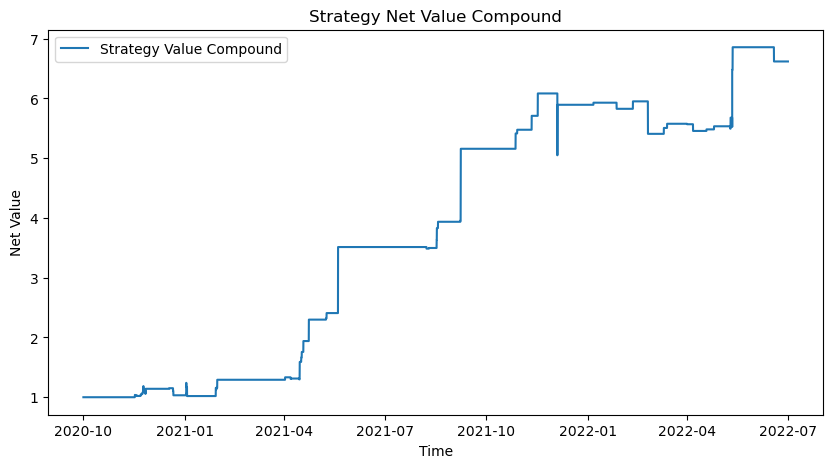

CAGR: 194.44%
Annual Return: 84.13%
Annual Volatility: 46.58%
Sharpe:  1.742


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


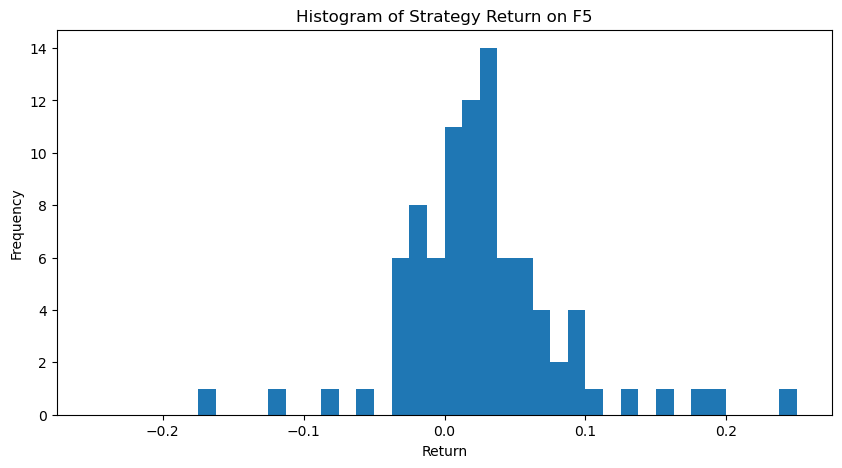

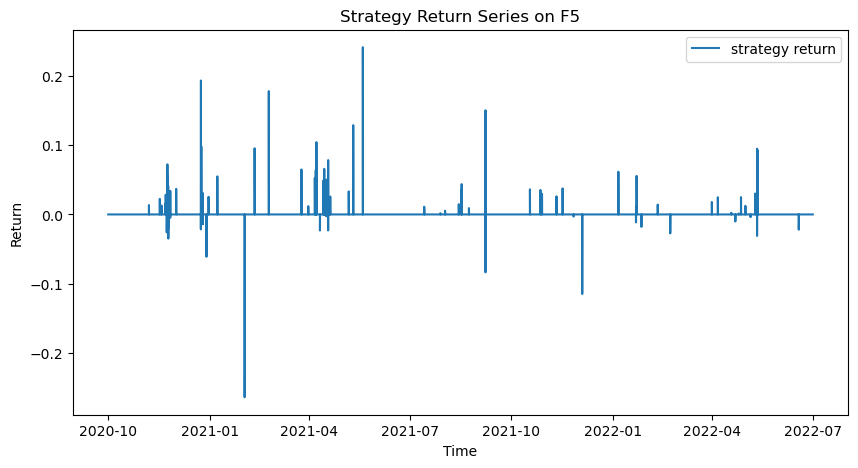

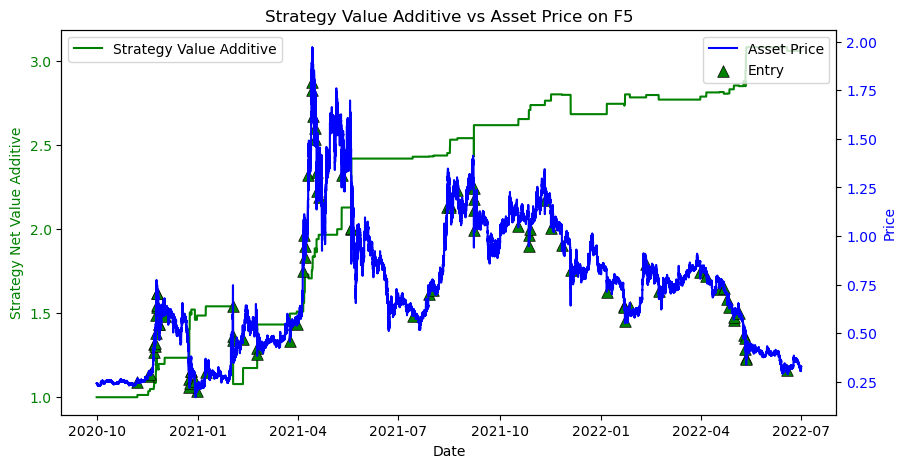

Win Prob: 72.22%
Number of Trades:  90 90
Average Win Return:   0.04822
Average Loss Return: -0.04296
P&L Ratio: 1.1
Maximum Loss of a single trade: -0.264
Maximum Drawdown: -40.59%
Annualized Return: 81.39%
Annualized Volatility: 40.89%
Sharpe:  1.917


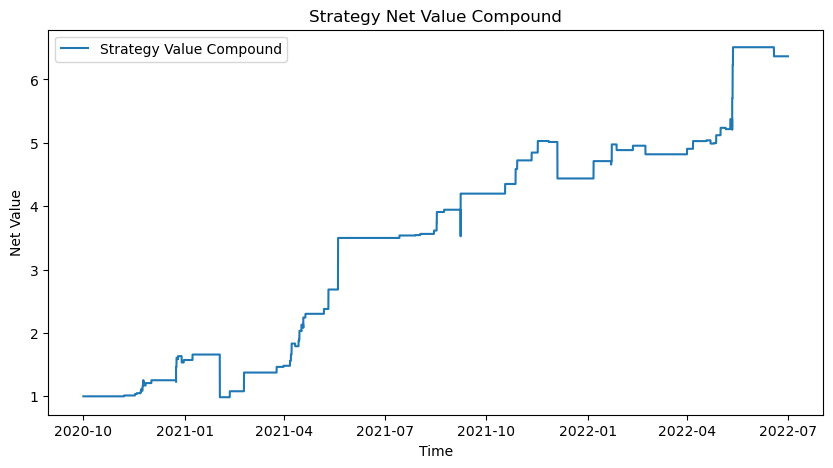

CAGR: 187.94%
Annual Return: 81.39%
Annual Volatility: 40.89%
Sharpe:  1.917


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


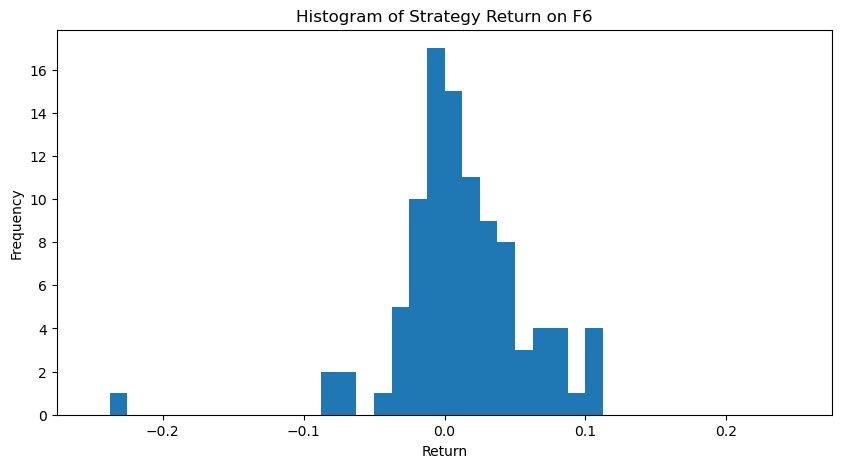

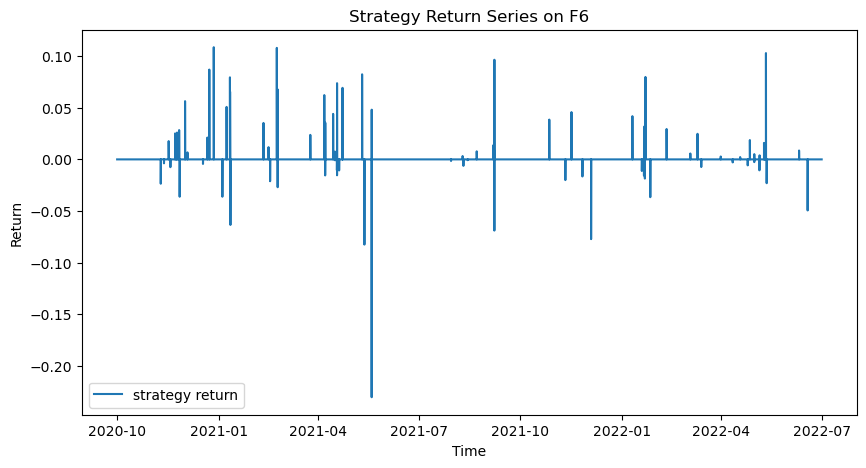

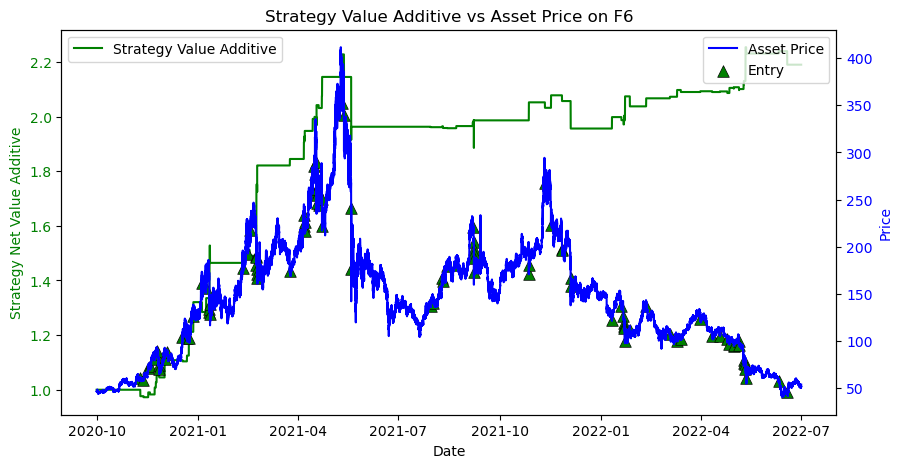

Win Prob: 60.82%
Number of Trades:  97 97
Average Win Return:   0.03762
Average Loss Return: -0.0271
P&L Ratio: 1.4
Maximum Loss of a single trade: -0.2304
Maximum Drawdown: -31.73%
Annualized Return: 46.99%
Annualized Volatility: 29.94%
Sharpe:  1.469


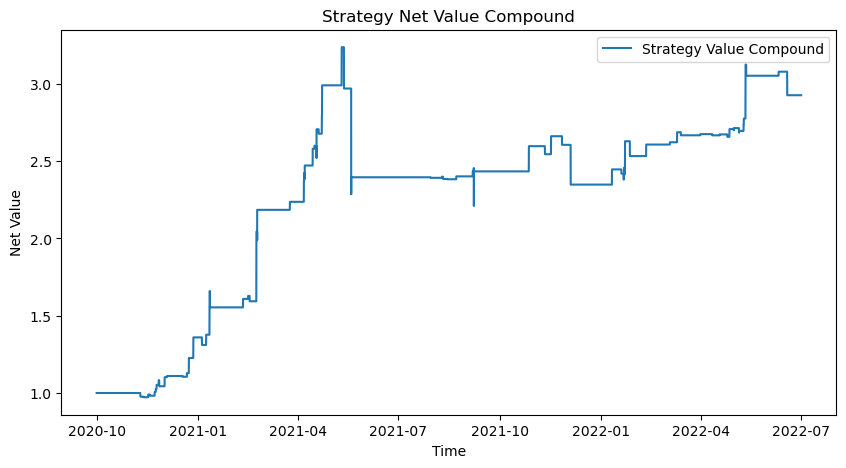

CAGR: 84.73%
Annual Return: 46.99%
Annual Volatility: 29.94%
Sharpe:  1.469


After preprocess the data has 192671 columns.
Preprocess finished
8.3 Trading signal finished


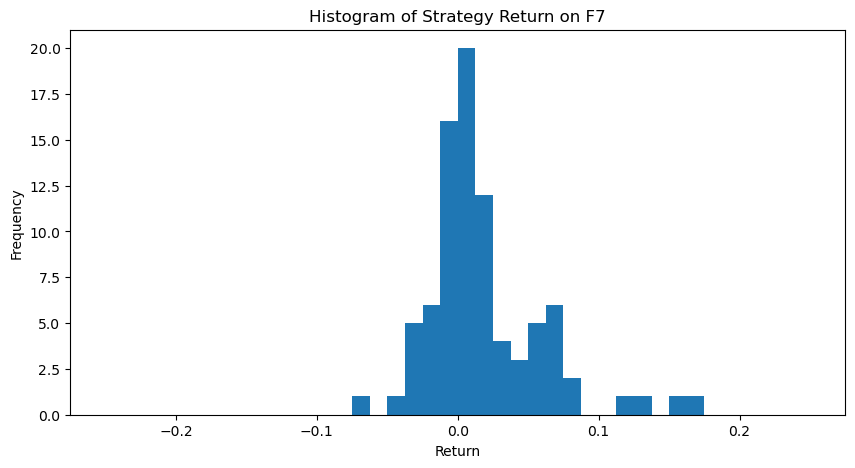

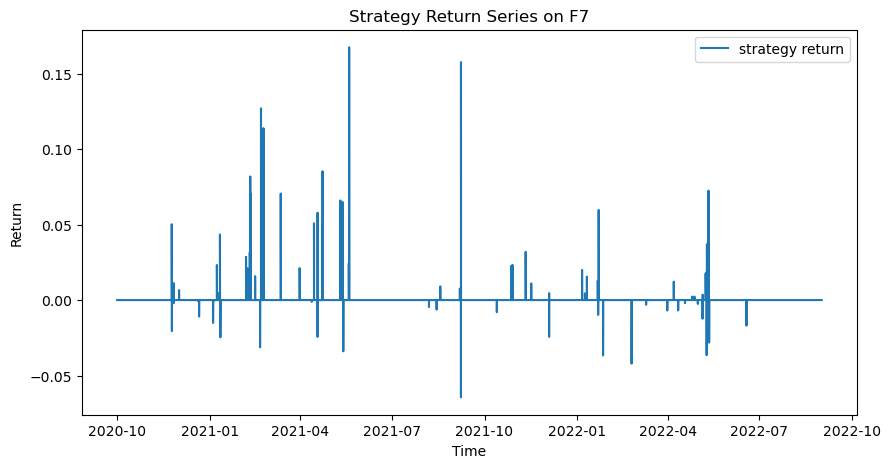

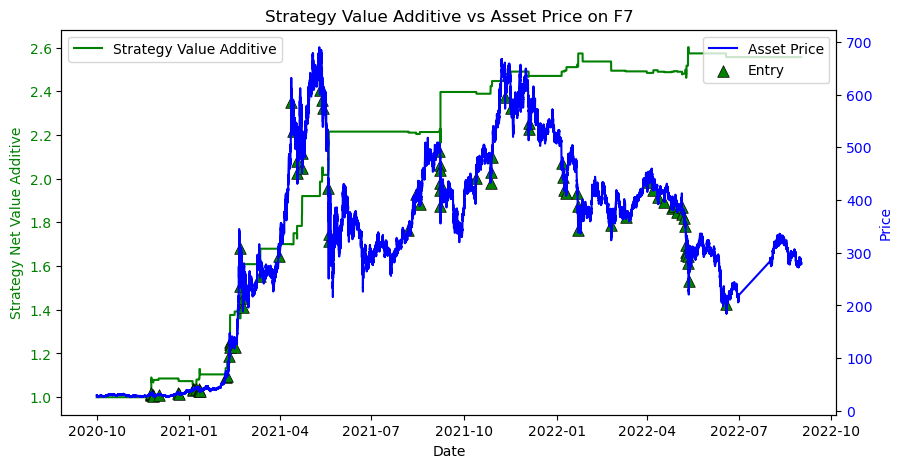

Win Prob: 65.88%
Number of Trades:  85 85
Average Win Return:   0.03634
Average Loss Return: -0.01651
P&L Ratio: 2.2
Maximum Loss of a single trade: -0.06439
Maximum Drawdown: -10.77%
Annualized Return: 58.62%
Annualized Volatility: 25.22%
Sharpe:  2.206


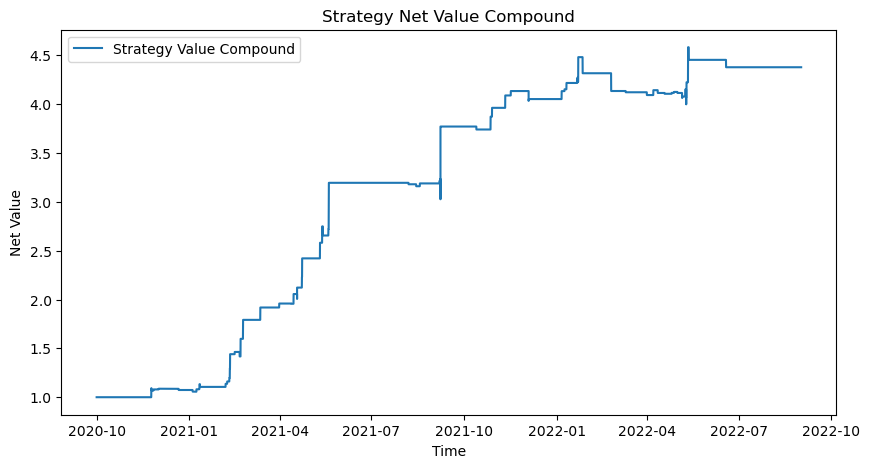

CAGR: 132.52%
Annual Return: 58.62%
Annual Volatility: 25.22%
Sharpe:  2.206


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


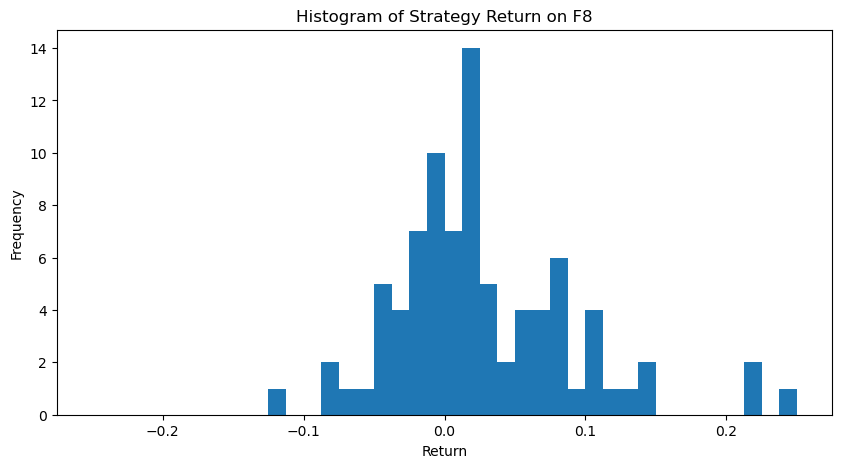

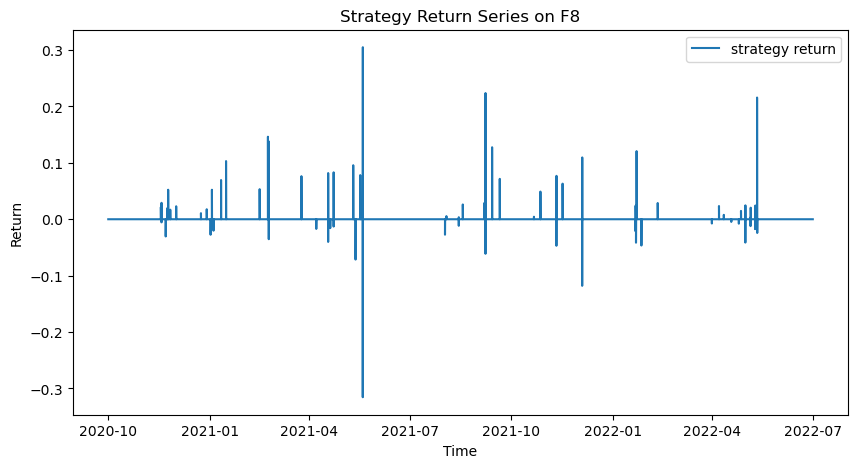

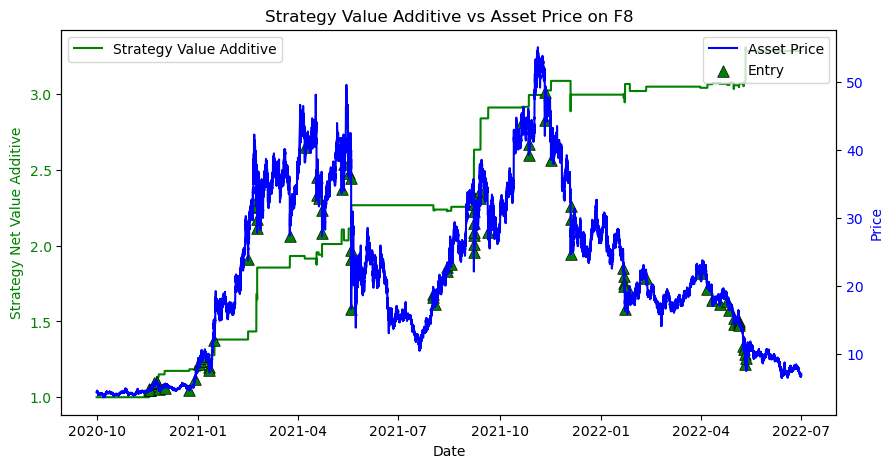

Win Prob: 63.22%
Number of Trades:  87 87
Average Win Return:   0.0647
Average Loss Return: -0.0398
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.3157
Maximum Drawdown: -37.13%
Annualized Return: 90.26%
Annualized Volatility: 49.02%
Sharpe:  1.78


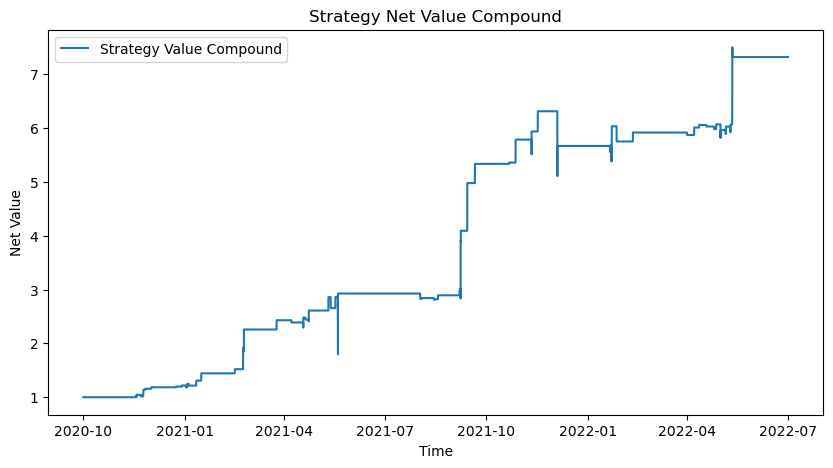

CAGR: 211.79%
Annual Return: 90.26%
Annual Volatility: 49.02%
Sharpe:  1.78


After preprocess the data has 175103 columns.
Preprocess finished
8.3 Trading signal finished


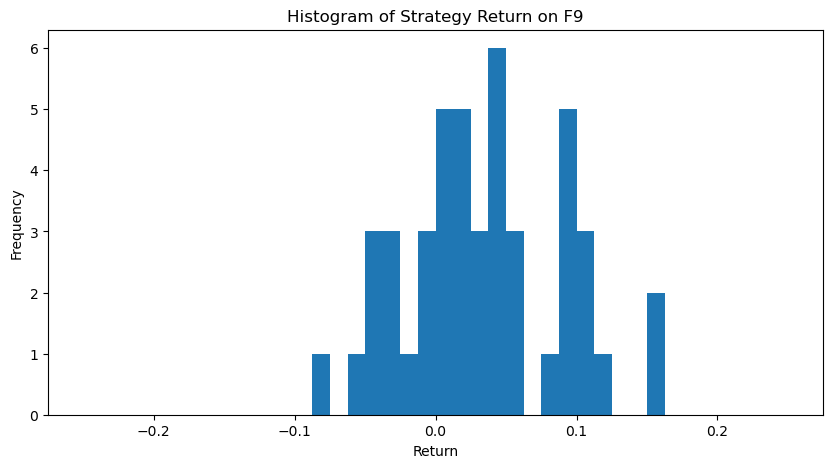

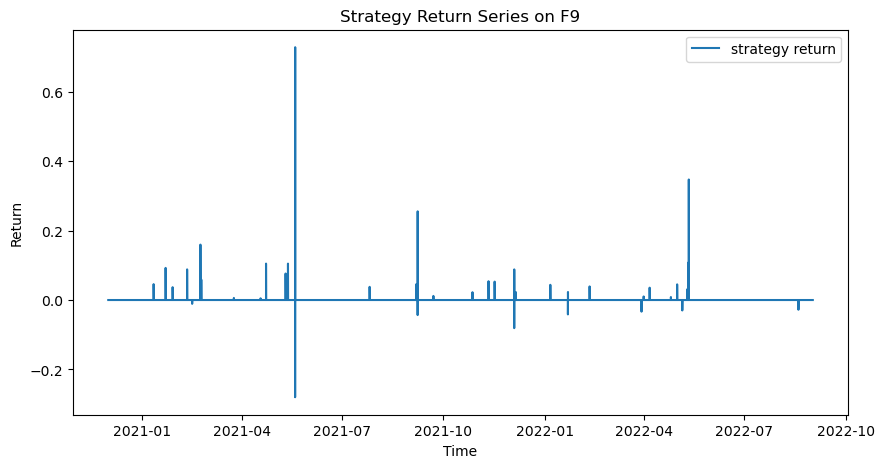

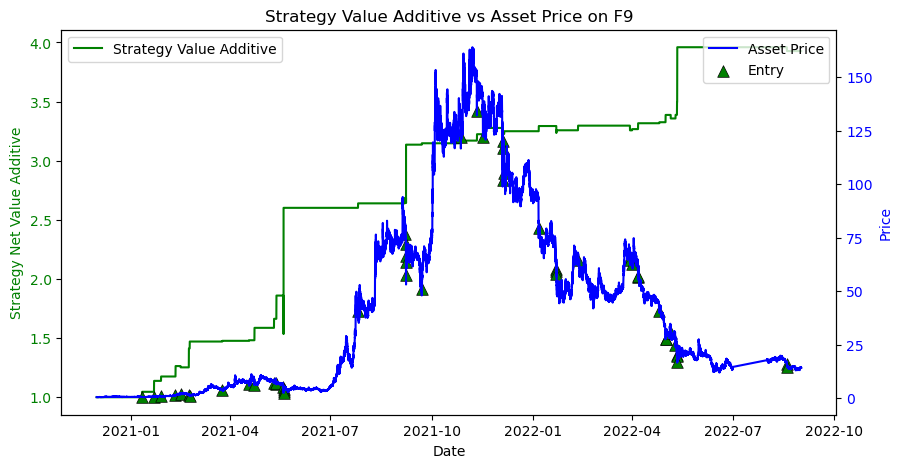

Win Prob: 74.51%
Number of Trades:  51 51
Average Win Return:   0.09491
Average Loss Return: -0.05229
P&L Ratio: 1.8
Maximum Loss of a single trade: -0.28
Maximum Drawdown: -31.26%
Annualized Return: 121.30%
Annualized Volatility: 67.39%
Sharpe:  1.755


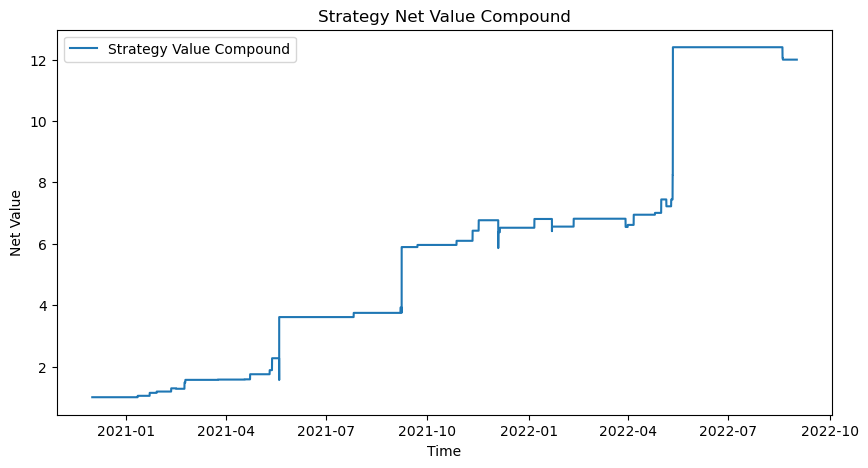

CAGR: 313.63%
Annual Return: 121.30%
Annual Volatility: 67.39%
Sharpe:  1.755


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


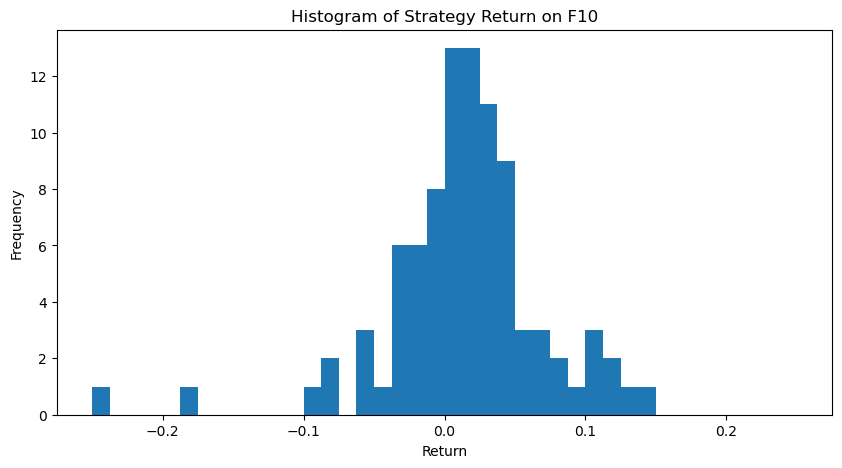

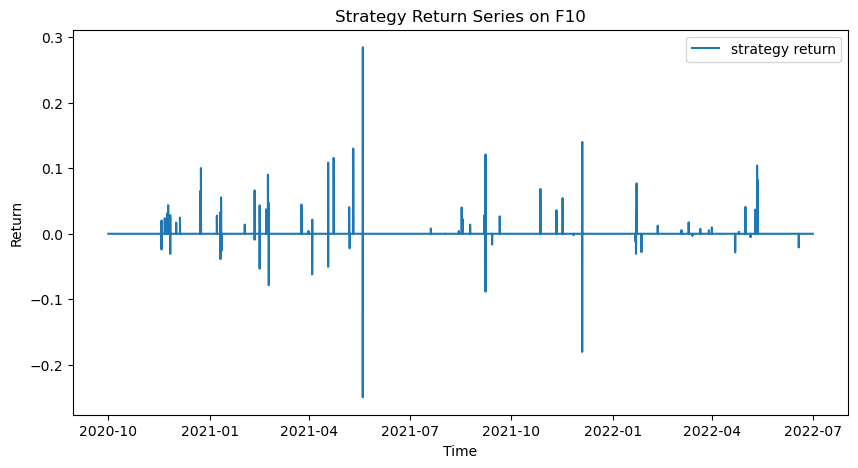

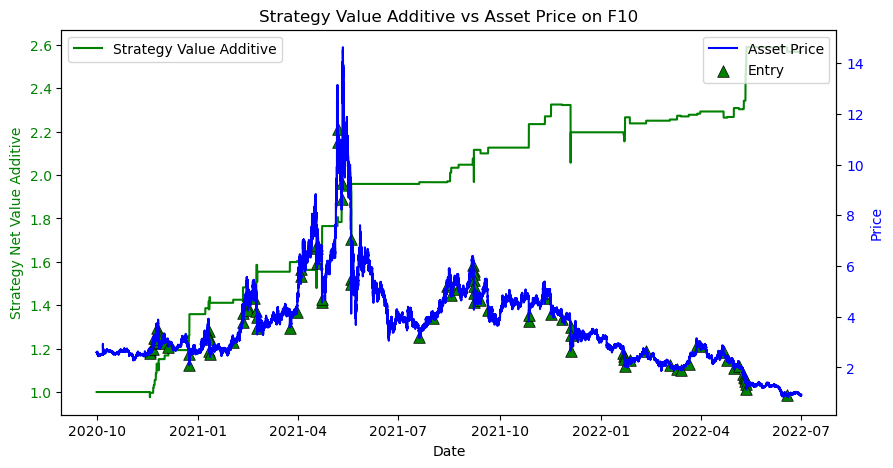

Win Prob: 68.48%
Number of Trades:  92 92
Average Win Return:   0.04438
Average Loss Return: -0.04234
P&L Ratio: 1.0
Maximum Loss of a single trade: -0.2495
Maximum Drawdown: -25.22%
Annualized Return: 61.93%
Annualized Volatility: 39.27%
Sharpe:  1.501


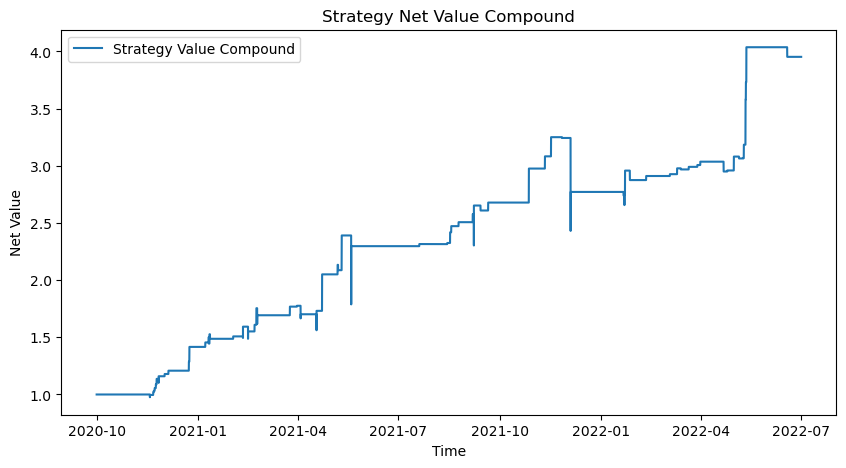

CAGR: 119.33%
Annual Return: 61.93%
Annual Volatility: 39.27%
Sharpe:  1.501


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


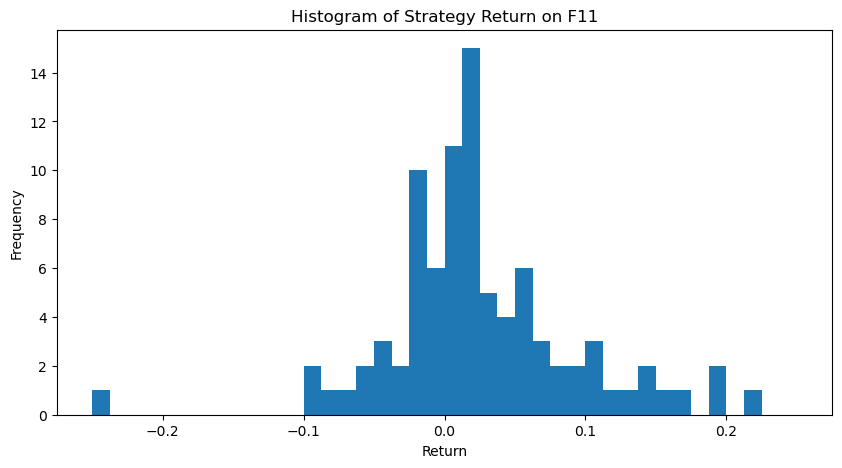

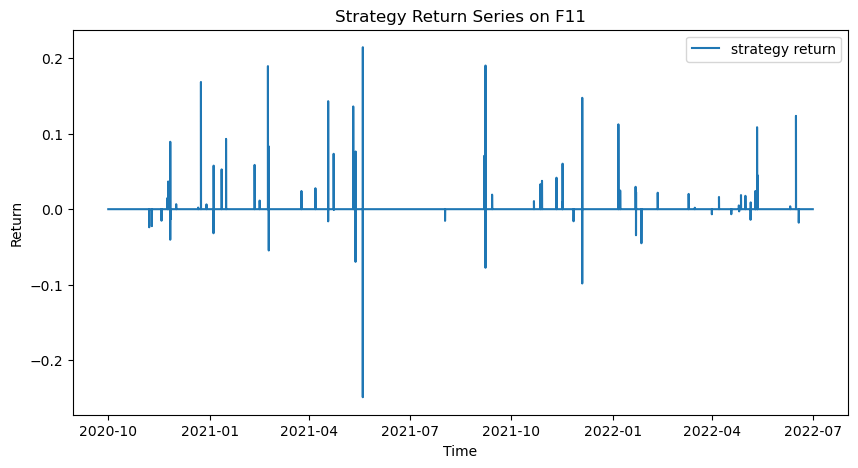

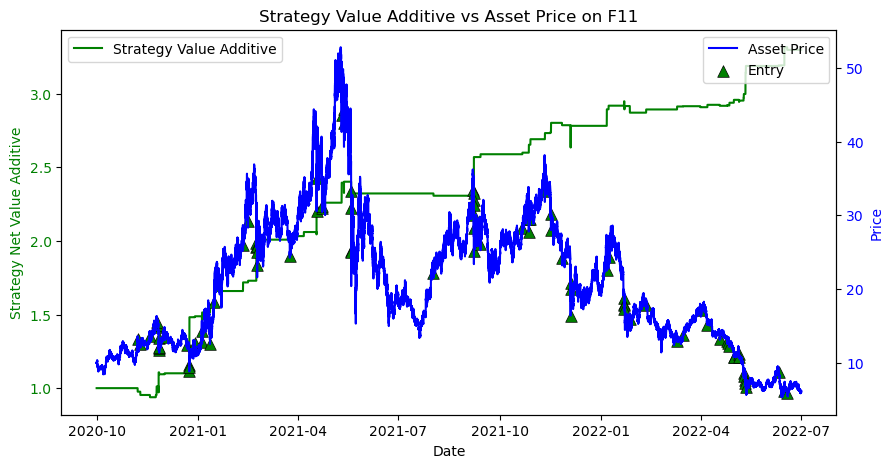

Win Prob: 68.18%
Number of Trades:  88 88
Average Win Return:   0.05671
Average Loss Return: -0.03945
P&L Ratio: 1.4
Maximum Loss of a single trade: -0.2489
Maximum Drawdown: -32.19%
Annualized Return: 90.76%
Annualized Volatility: 43.34%
Sharpe:  2.025


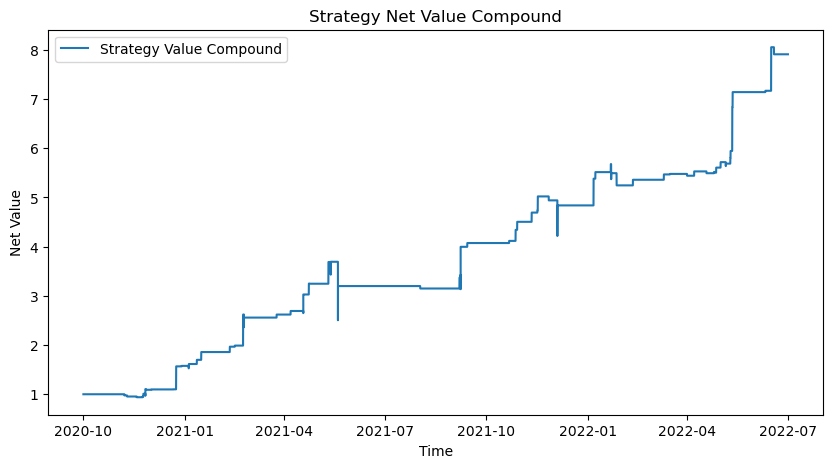

CAGR: 226.02%
Annual Return: 90.76%
Annual Volatility: 43.34%
Sharpe:  2.025


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


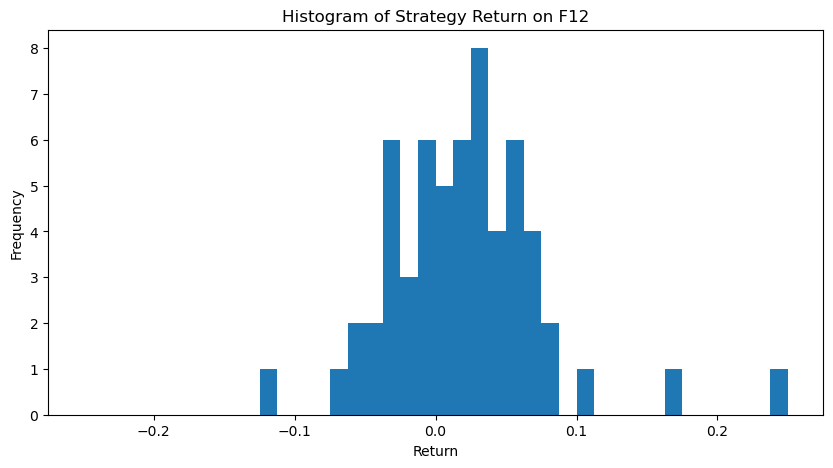

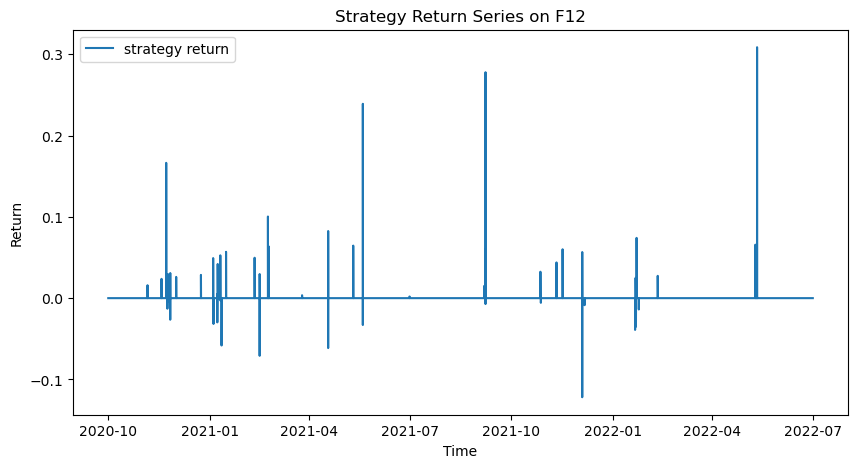

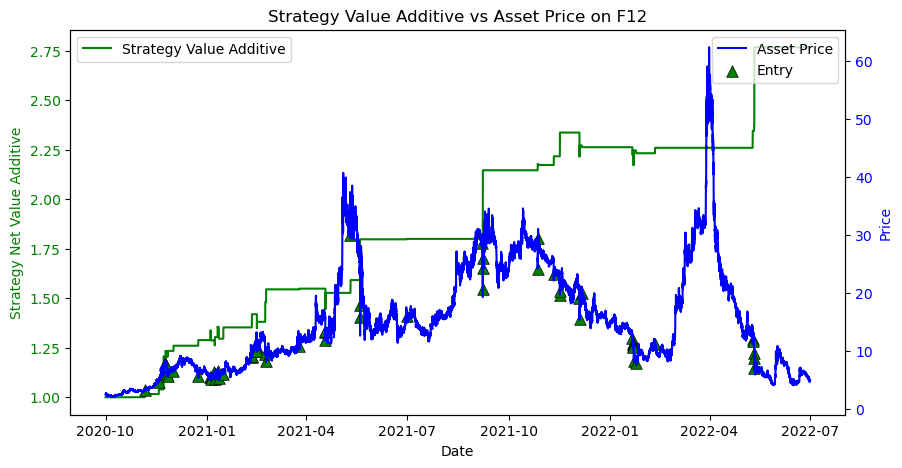

Win Prob: 65.57%
Number of Trades:  61 61
Average Win Return:   0.06088
Average Loss Return: -0.03179
P&L Ratio: 1.9
Maximum Loss of a single trade: -0.1219
Maximum Drawdown: -16.19%
Annualized Return: 69.81%
Annualized Volatility: 38.47%
Sharpe:  1.737


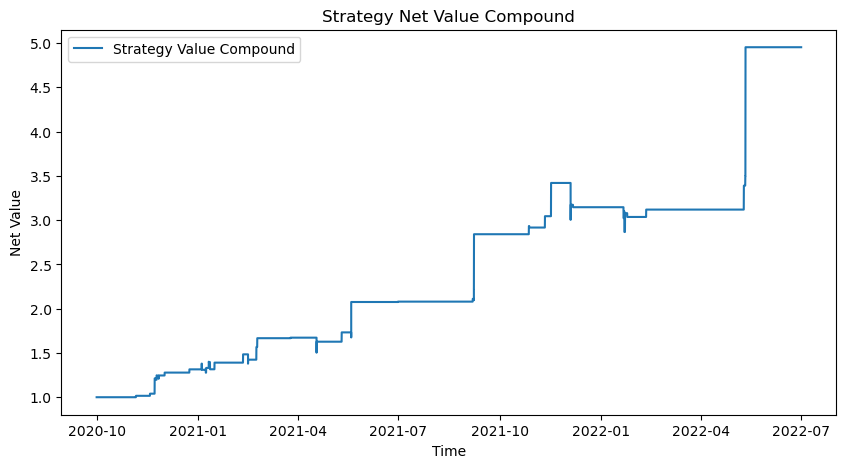

CAGR: 149.48%
Annual Return: 69.81%
Annual Volatility: 38.47%
Sharpe:  1.737


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


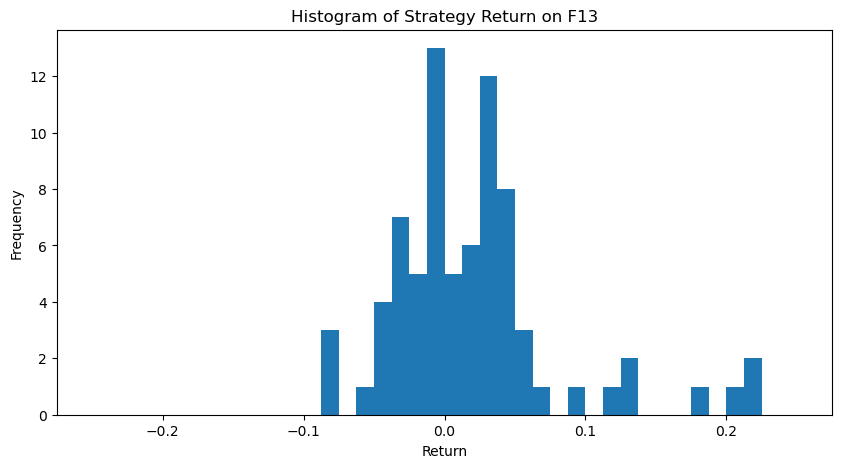

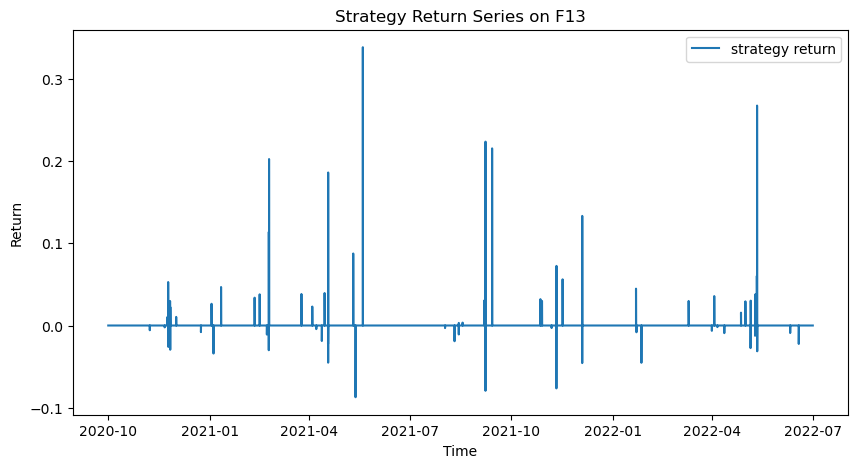

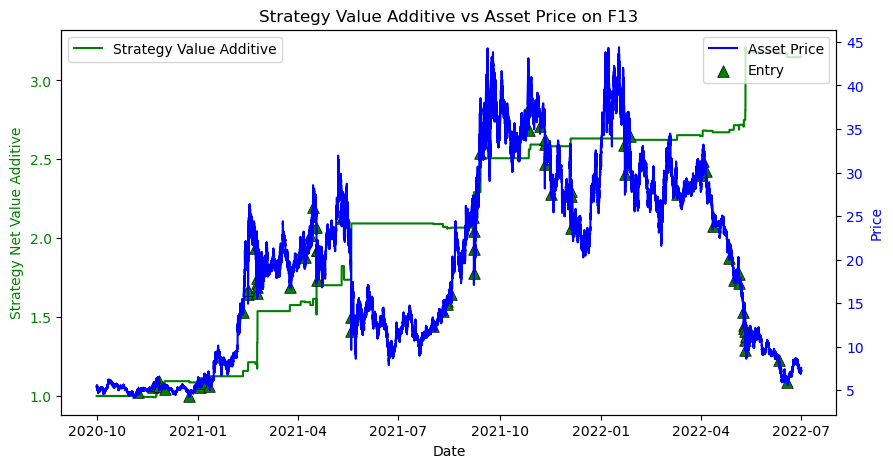

Win Prob: 57.69%
Number of Trades:  78 78
Average Win Return:   0.067
Average Loss Return: -0.02628
P&L Ratio: 2.5
Maximum Loss of a single trade: -0.08724
Maximum Drawdown: -13.45%
Annualized Return: 84.84%
Annualized Volatility: 44.38%
Sharpe:  1.844


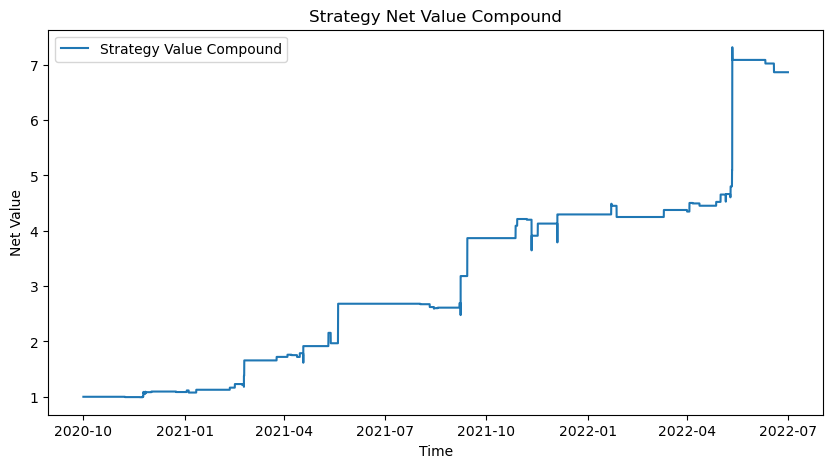

CAGR: 200.68%
Annual Return: 84.84%
Annual Volatility: 44.38%
Sharpe:  1.844


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


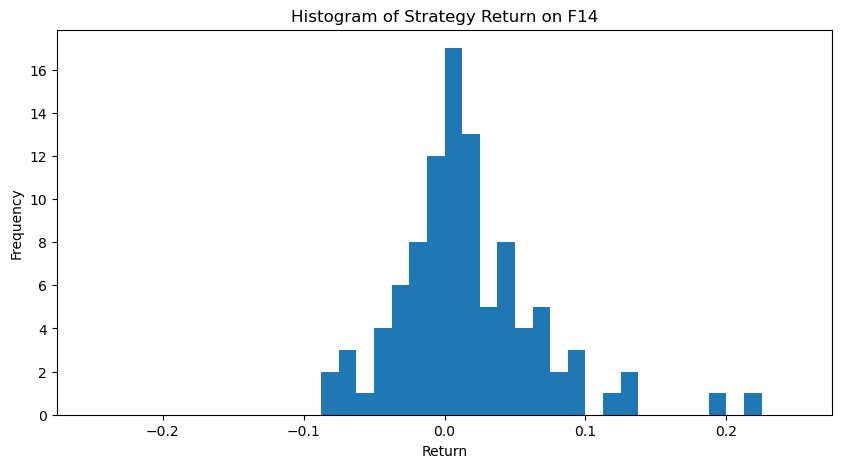

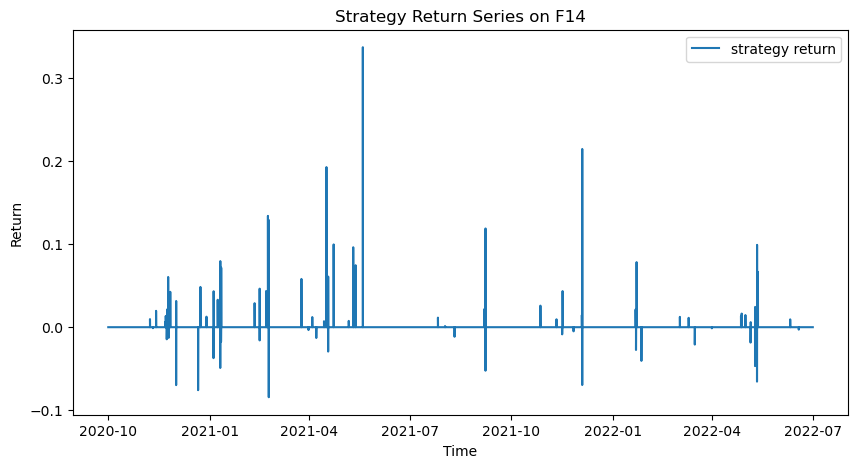

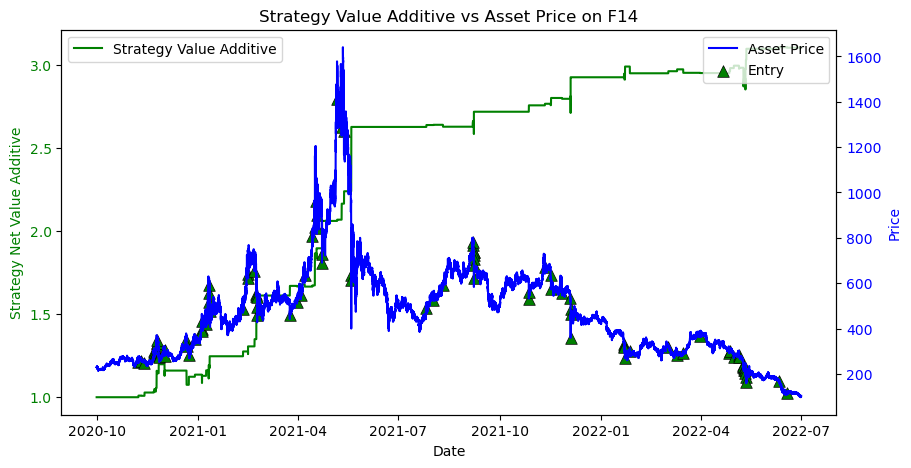

Win Prob: 63.64%
Number of Trades:  99 99
Average Win Return:   0.04853
Average Loss Return: -0.02654
P&L Ratio: 1.8
Maximum Loss of a single trade: -0.0843
Maximum Drawdown: -13.79%
Annualized Return: 83.04%
Annualized Volatility: 39.60%
Sharpe:  2.021


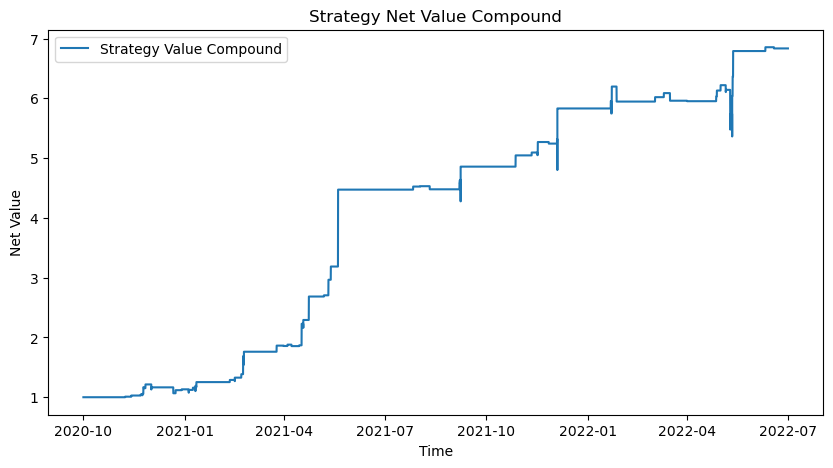

CAGR: 199.93%
Annual Return: 83.04%
Annual Volatility: 39.60%
Sharpe:  2.021


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


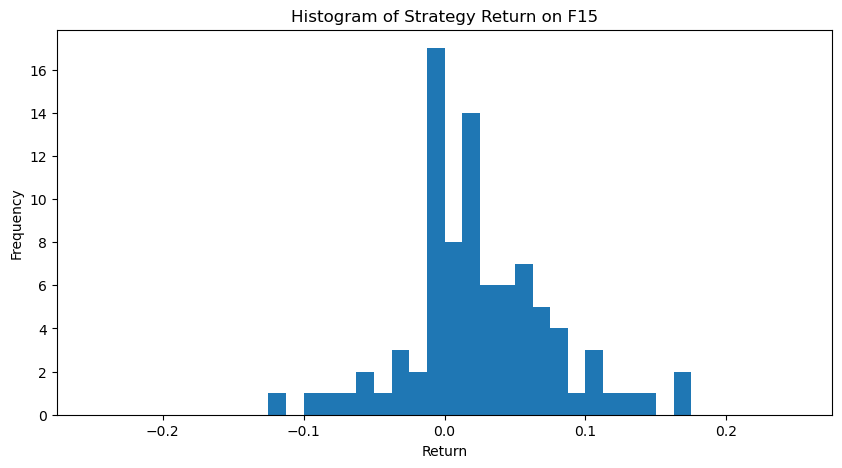

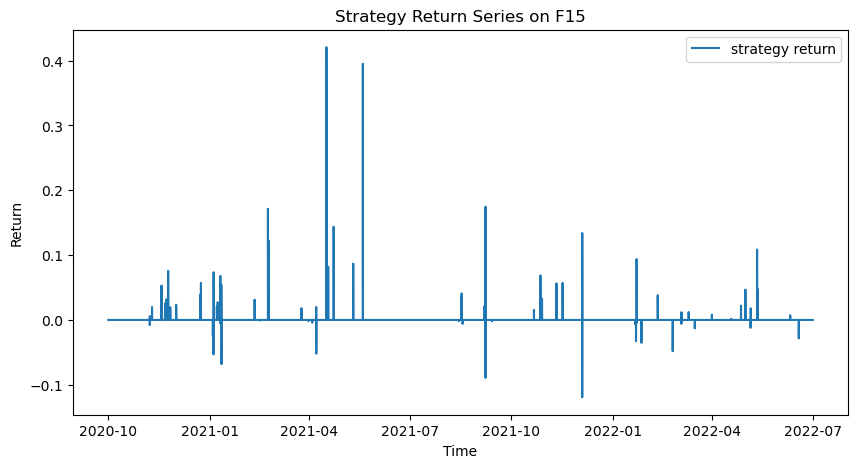

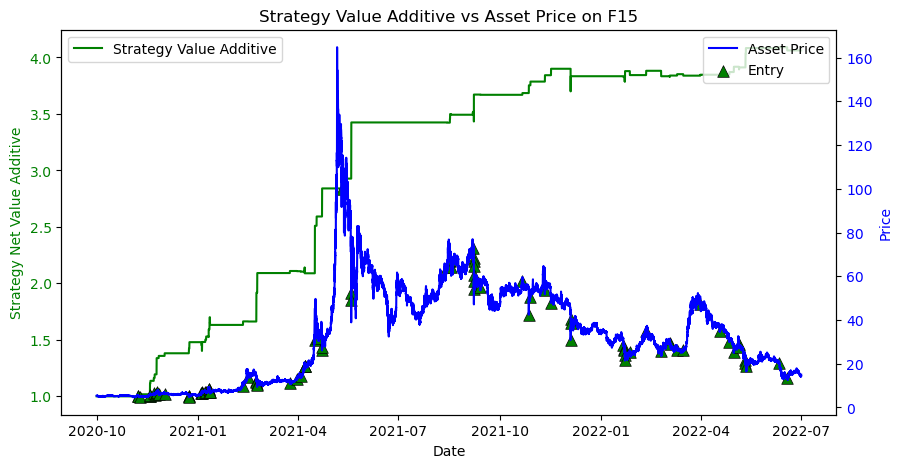

Win Prob: 67.78%
Number of Trades:  90 90
Average Win Return:   0.06212
Average Loss Return: -0.02506
P&L Ratio: 2.5
Maximum Loss of a single trade: -0.1192
Maximum Drawdown: -19.05%
Annualized Return: 120.95%
Annualized Volatility: 49.81%
Sharpe:  2.368


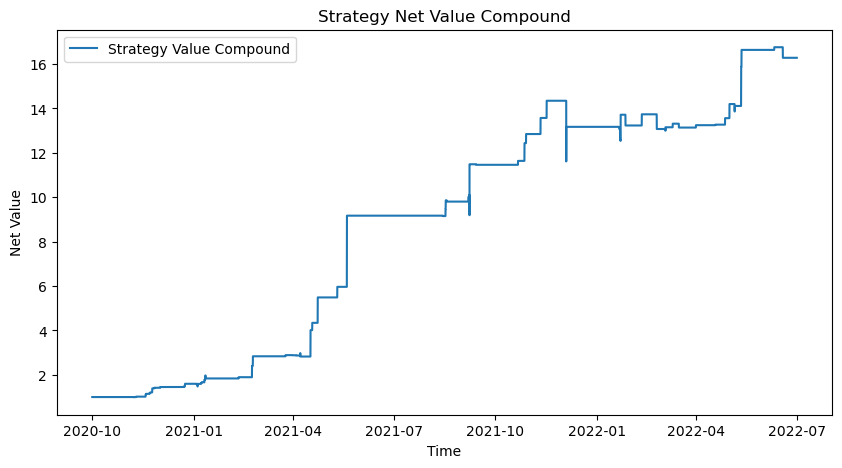

CAGR: 392.50%
Annual Return: 120.95%
Annual Volatility: 49.81%
Sharpe:  2.368


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


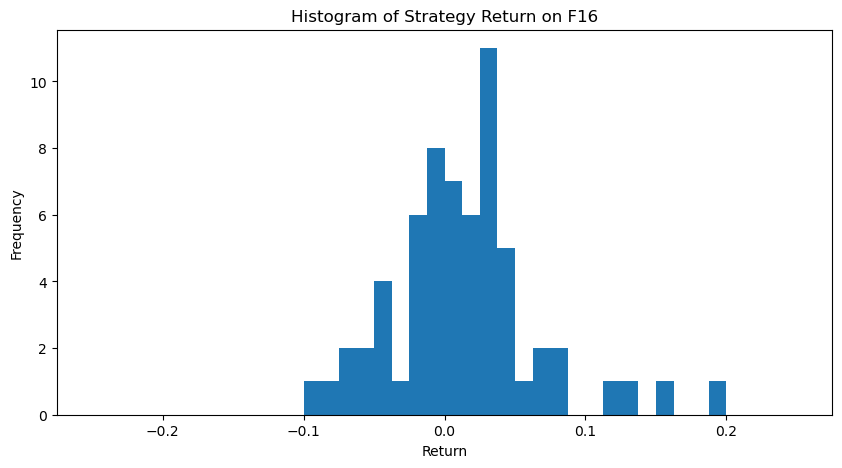

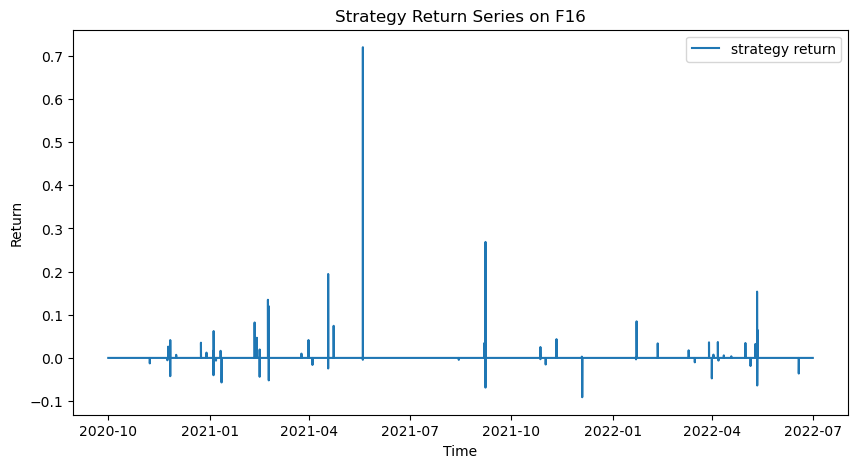

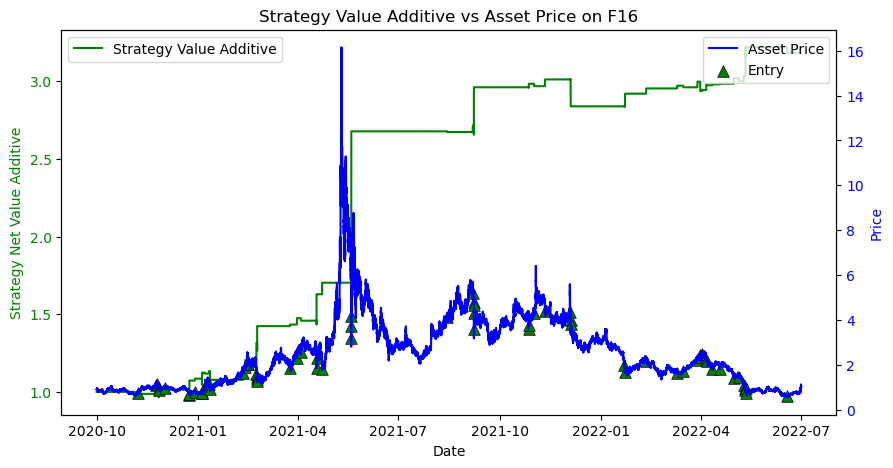

Win Prob: 62.12%
Number of Trades:  66 66
Average Win Return:   0.07203
Average Loss Return: -0.03086
P&L Ratio: 2.3
Maximum Loss of a single trade: -0.09105
Maximum Drawdown: -17.10%
Annualized Return: 86.18%
Annualized Volatility: 57.72%
Sharpe:  1.441


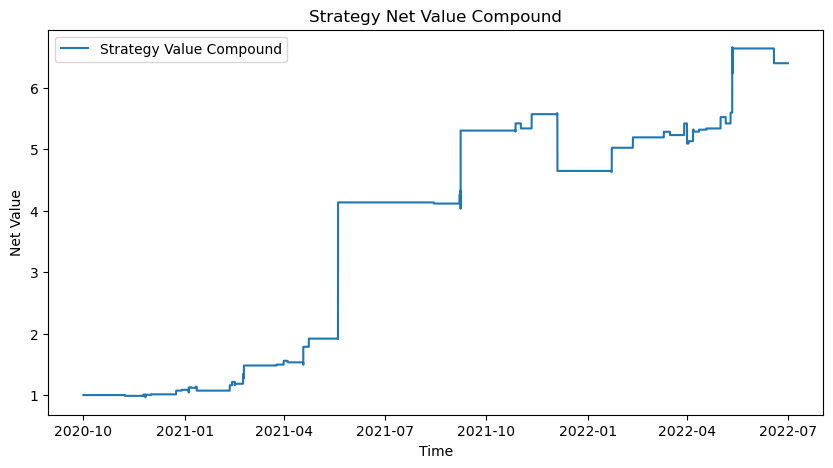

CAGR: 188.86%
Annual Return: 86.18%
Annual Volatility: 57.72%
Sharpe:  1.441


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


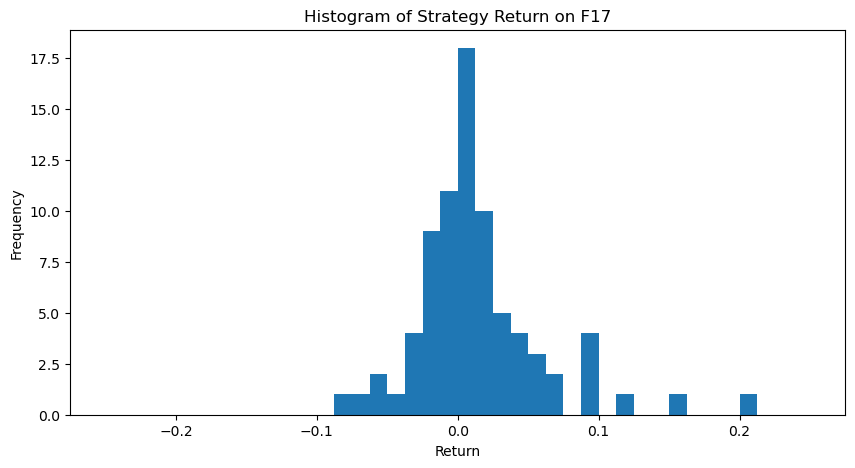

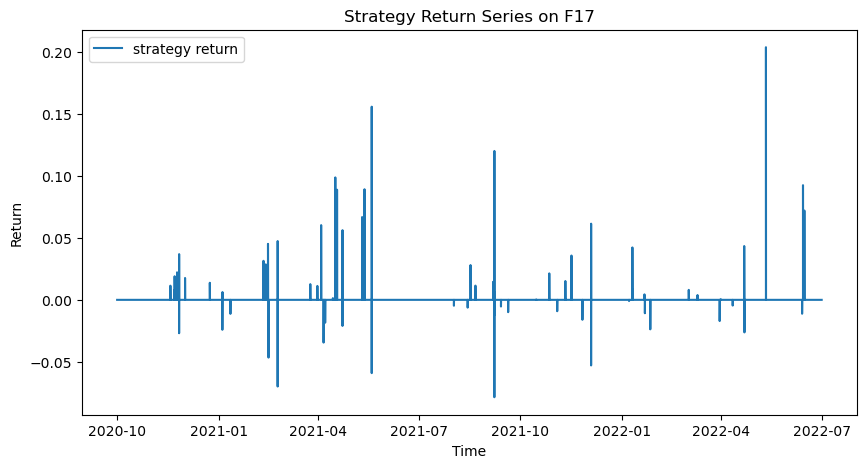

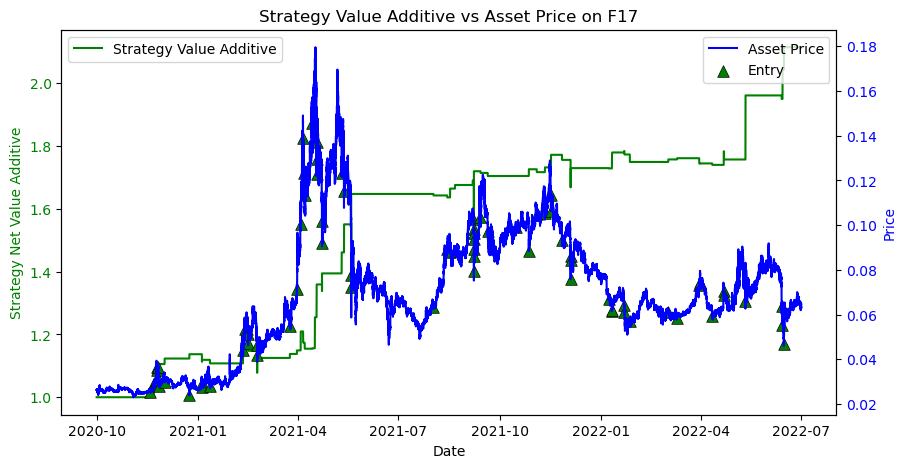

Win Prob: 62.82%
Number of Trades:  78 78
Average Win Return:   0.03662
Average Loss Return: -0.02345
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.07864
Maximum Drawdown: -13.00%
Annualized Return: 44.02%
Annualized Volatility: 26.63%
Sharpe:  1.54


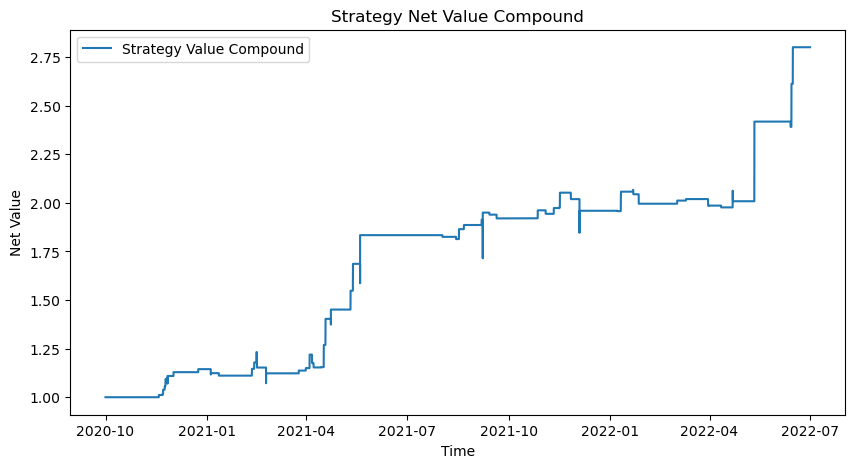

CAGR: 80.13%
Annual Return: 44.02%
Annual Volatility: 26.63%
Sharpe:  1.54


After preprocess the data has 183744 columns.
Preprocess finished
8.3 Trading signal finished


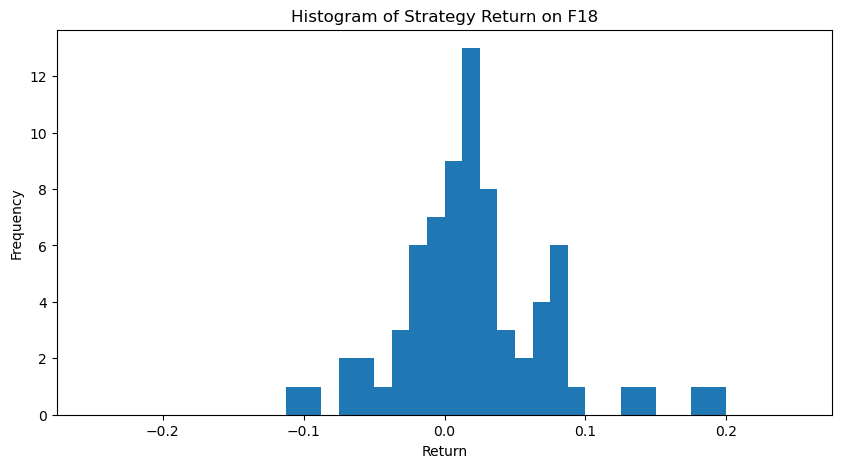

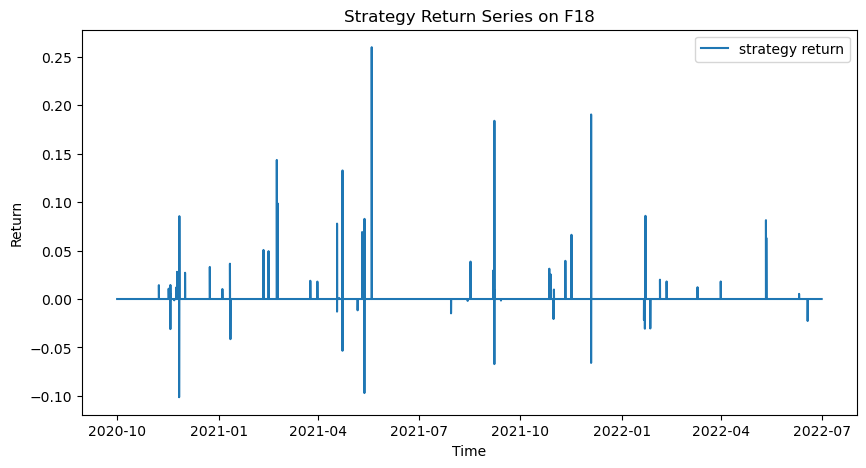

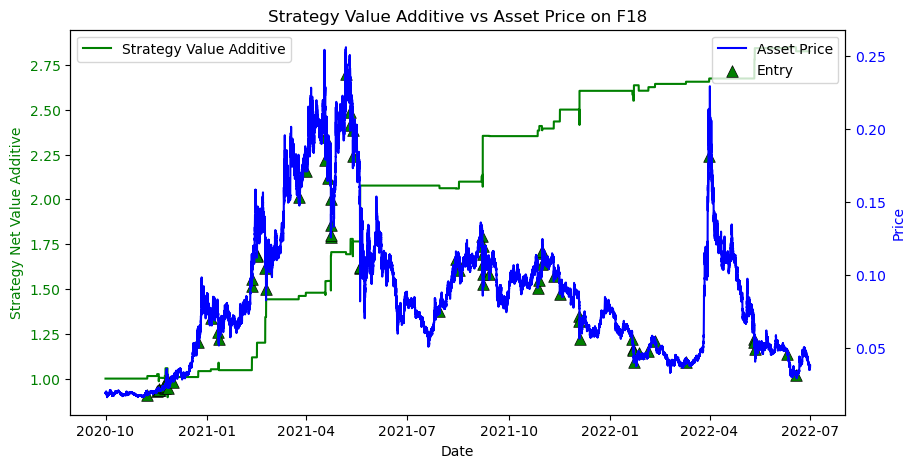

Win Prob: 68.92%
Number of Trades:  74 74
Average Win Return:   0.04998
Average Loss Return: -0.03141
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.1014
Maximum Drawdown: -15.57%
Annualized Return: 72.14%
Annualized Volatility: 34.92%
Sharpe:  1.98


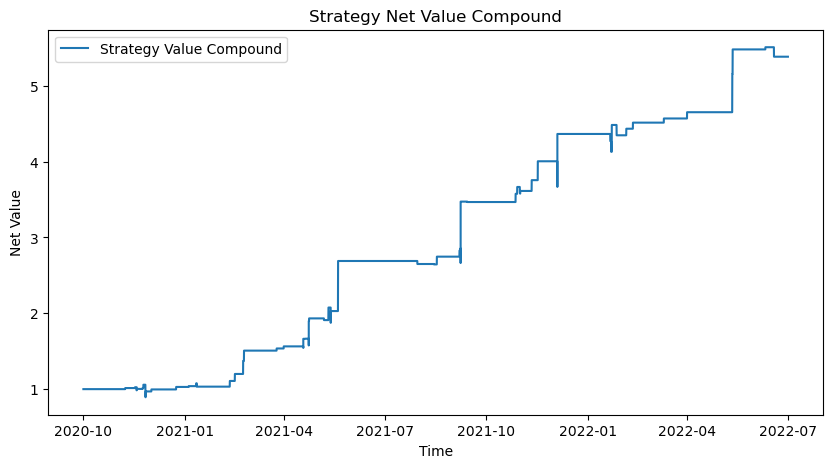

CAGR: 161.65%
Annual Return: 72.14%
Annual Volatility: 34.92%
Sharpe:  1.98




In [313]:
# strategy 8.3 use avg price as buy and sell price
strategy8_3_list = []
profit_des_8_3 = pd.DataFrame()
tbv_des_8_3 = pd.DataFrame()
tbv_tv_des_8_3 = pd.DataFrame()
tbv_pct_des_8_3 = pd.DataFrame()
ma_des_8_3 = pd.DataFrame()
for idx in range(len(data_list)):
    name = 'F'+str(idx+1)
    stra8_3 = CTAStrategy(data_list[idx],'open_time','signal','close',120,5,name)
    stra8_3.data_preprocess()
    stra8_3.find_signal_8_3(10000,0.1,1)
    stra8_3.get_strategy_returns(1/1000)
    stra8_3.plot_hist_seires(abs_range=0.25)
    stra8_3.plot_cumsum_profits()
    stra8_3.get_win_prob()
    profit_des = stra8_3.get_avg_win_return()
    stra8_3.get_maximum_drawdown()
    stra8_3.get_sharpe()
    stra8_3.plot_cumprod_value()
    tbv_des, tbv_tv_des, tbv_pct_des = stra8_3.taker_buy_volume_stats()
    ma_des = stra8_3.moving_average_stats()
    strategy8_3_list.append(stra8_3)
    if (profit_des_8_3.empty):
        profit_des_8_3 = profit_des
        tbv_des_8_3 = tbv_des
        tbv_tv_des_8_3 = tbv_tv_des
        tbv_pct_des_8_3 = tbv_pct_des
        ma_des_8_3 = ma_des
    else:
        profit_des_8_3 = profit_des_8_3.join(profit_des)
        tbv_des_8_3 = tbv_des_8_3.join(tbv_des)
        tbv_tv_des_8_3 =tbv_tv_des_8_3.join(tbv_tv_des)
        tbv_pct_des_8_3 = tbv_pct_des_8_3.join(tbv_pct_des)
        ma_des_8_3 = ma_des_8_3.join(ma_des)
    print('\n')

## Overall Statistics

In [318]:
# calculate average win rate, average profit loss ratio, average sharpe
win_rate3 = []
pnl_ratio3 = []
sharpe3 = []
for ele in strategy8_3_list:
    win_rate3.append(ele.win_prob)
    pnl_ratio3.append(ele.pnl_ratio)
    sharpe3.append(ele.sharpe)
print(f"Average Win Rate: {np.mean(win_rate3):.2f}")
print(f"Average P&L Ratio: {np.mean(pnl_ratio3):.2f}")
print(f"Average Sharpe: {np.mean(sharpe3):.2f}")

Average Win Rate: 0.65
Average P&L Ratio: 1.85
Average Sharpe: 1.82


## below are old version

Preprocess finished
8.3 Trading signal finished


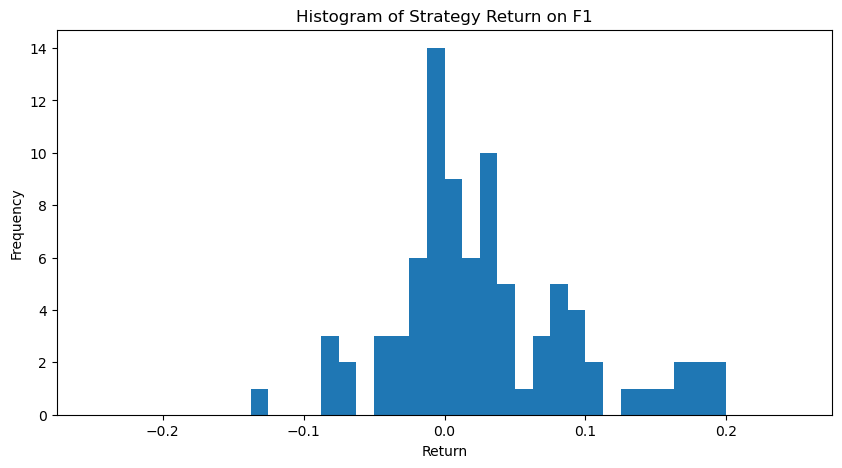

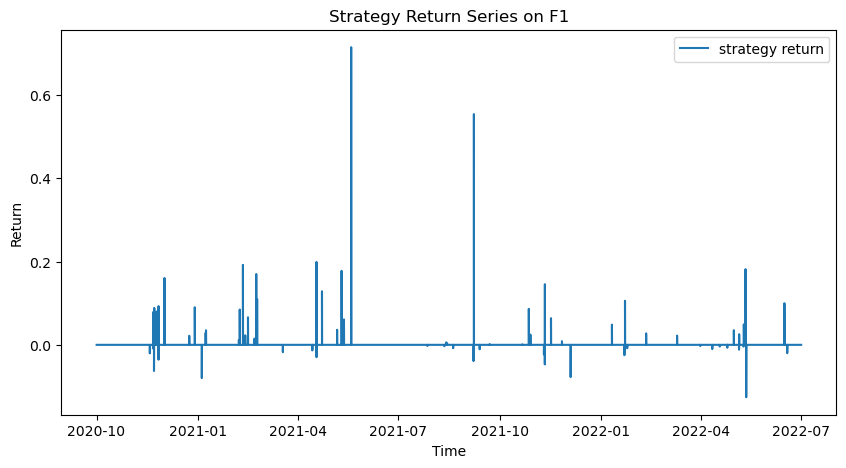

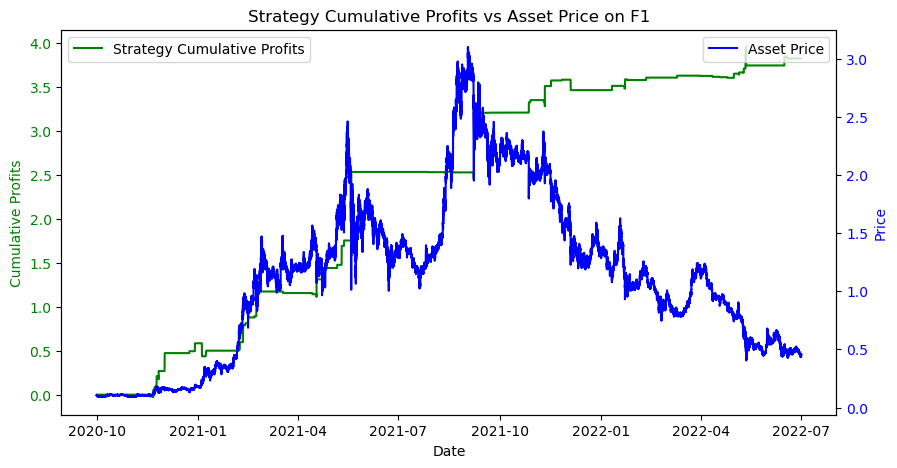

Win Prob: 63.64%
Number of Trades:  88 88
Average Win Return:   0.08492
Average Loss Return: -0.02911
P&L Ratio: 2.9
Maximum Loss of a single trade: -0.1259
Maximum Drawdown: -9.34%
Annual Return: 151.08%
Annual Volatility: 70.73%
Sharpe:  2.136


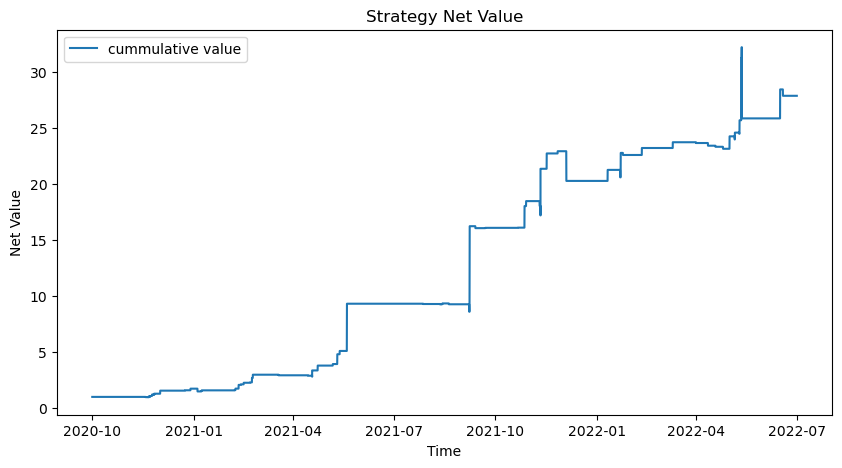

Annual Return: 569.13%
Annual Volatility: 70.72%
Sharpe:  8.048


Preprocess finished
8.3 Trading signal finished


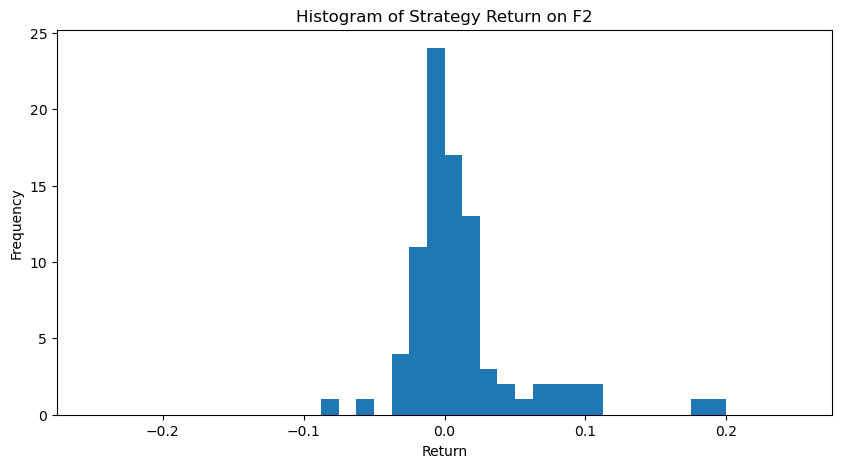

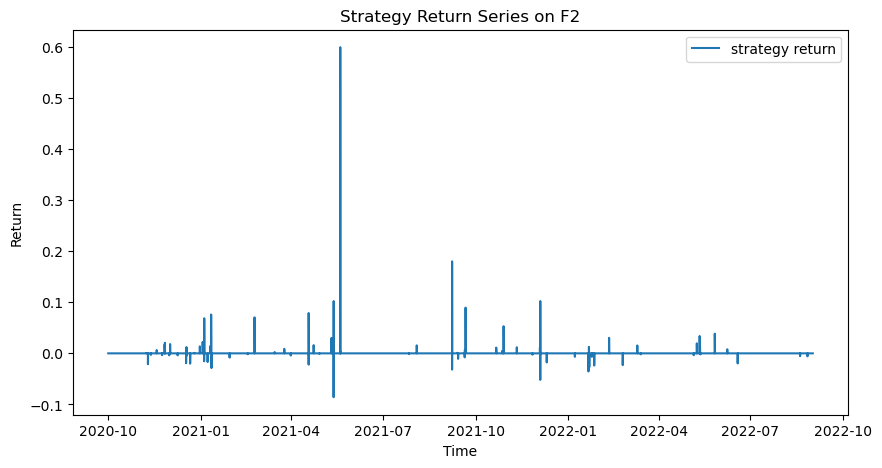

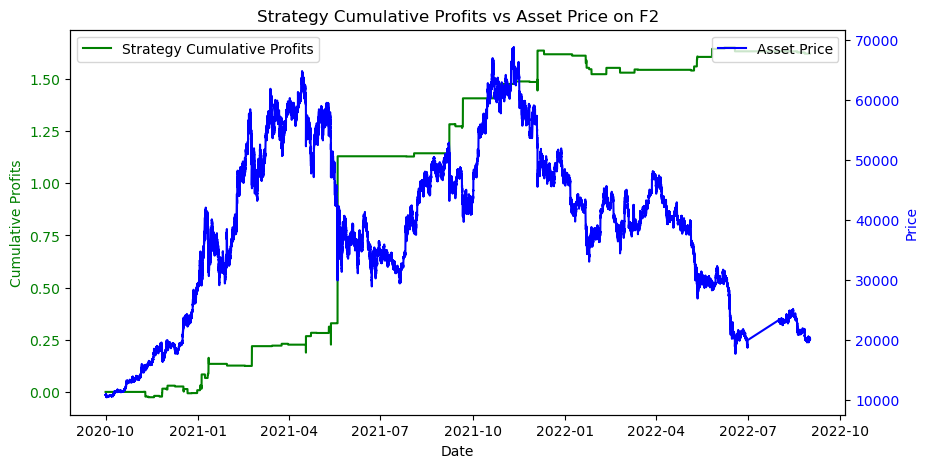

Win Prob: 53.41%
Number of Trades:  88 88
Average Win Return:   0.04693
Average Loss Return: -0.01427
P&L Ratio: 3.3
Maximum Loss of a single trade: -0.08591
Maximum Drawdown: -6.55%
Annual Return: 61.06%
Annual Volatility: 44.36%
Sharpe:  1.377


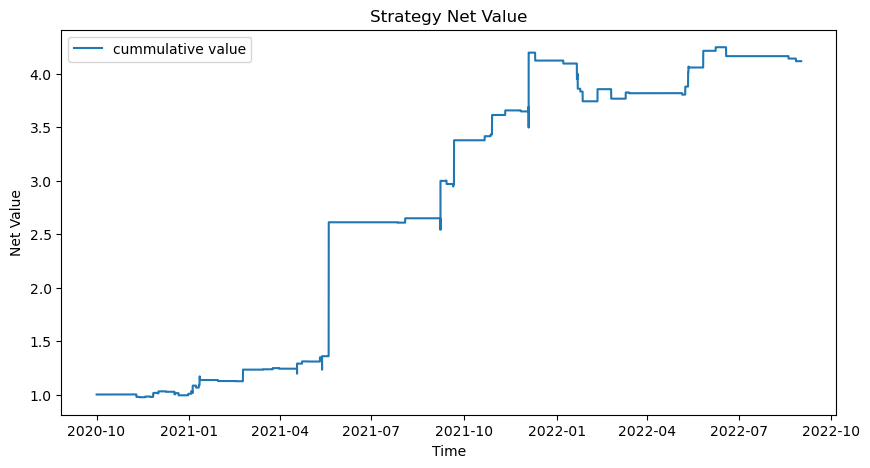

Annual Return: 124.44%
Annual Volatility: 44.35%
Sharpe:  2.806


Preprocess finished
8.3 Trading signal finished


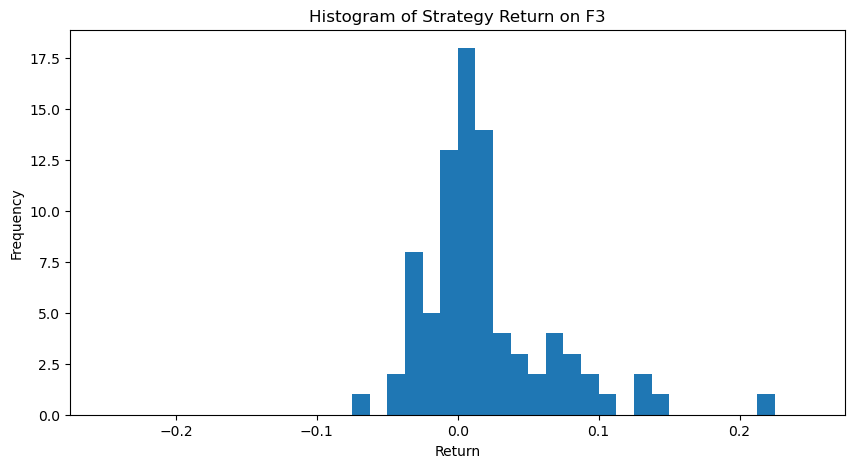

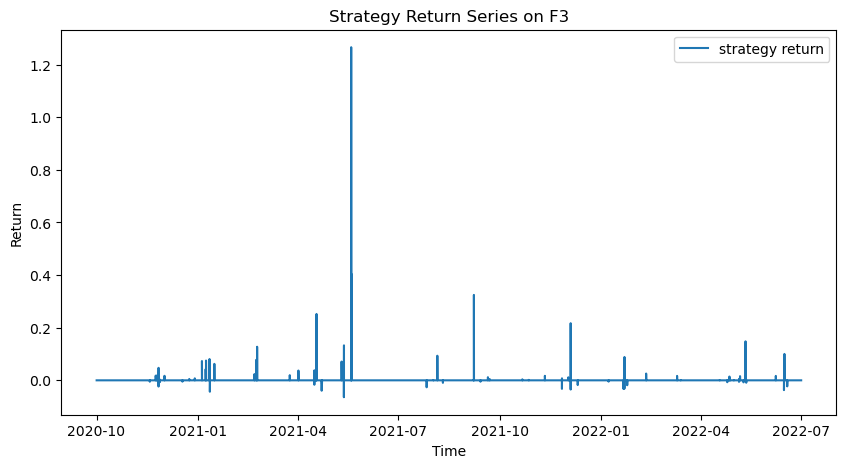

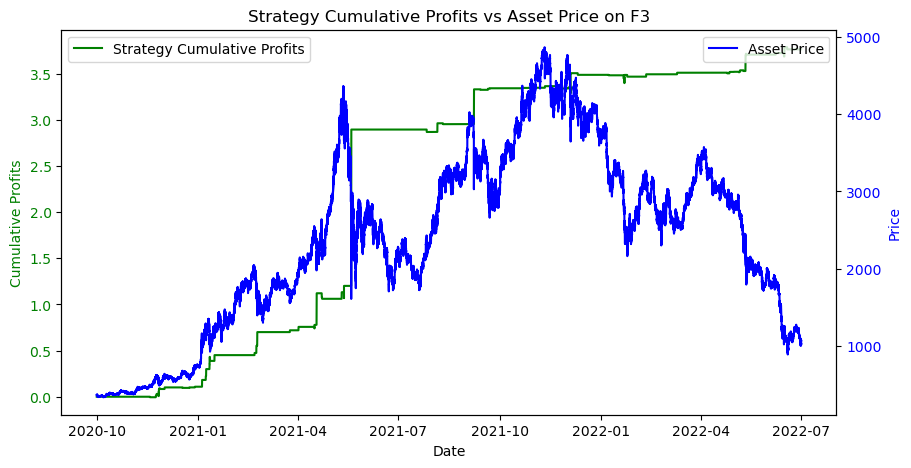

Win Prob: 67.05%
Number of Trades:  88 88
Average Win Return:   0.07381
Average Loss Return: -0.02035
P&L Ratio: 3.6
Maximum Loss of a single trade: -0.06423
Maximum Drawdown: -3.03%
Annual Return: 148.73%
Annual Volatility: 92.00%
Sharpe:  1.617


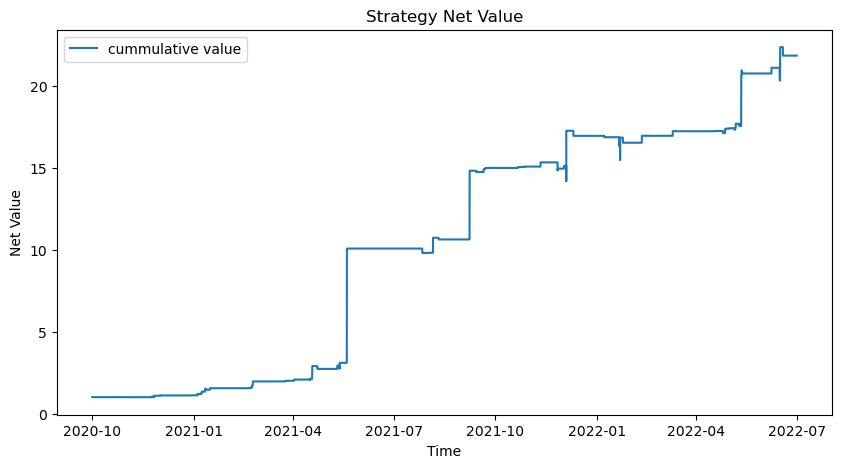

Annual Return: 482.82%
Annual Volatility: 91.99%
Sharpe:  5.249


Preprocess finished
8.3 Trading signal finished


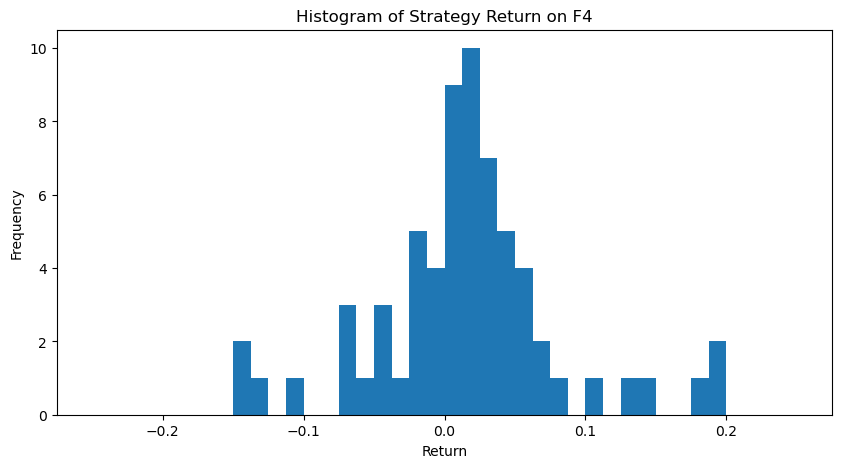

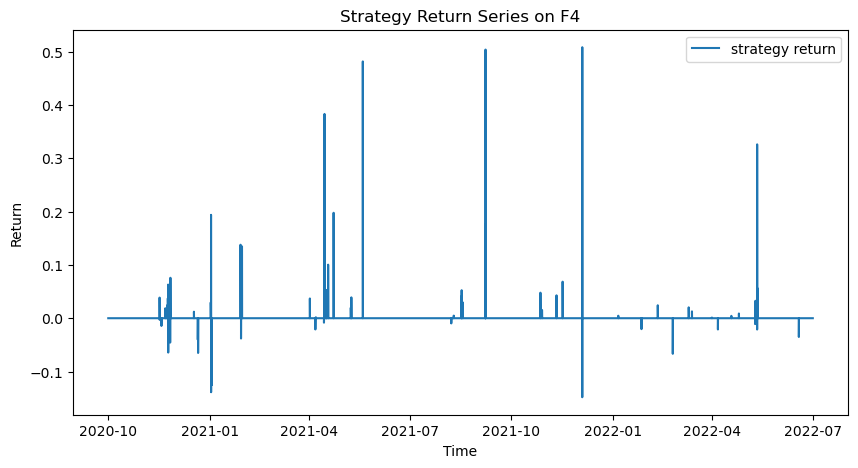

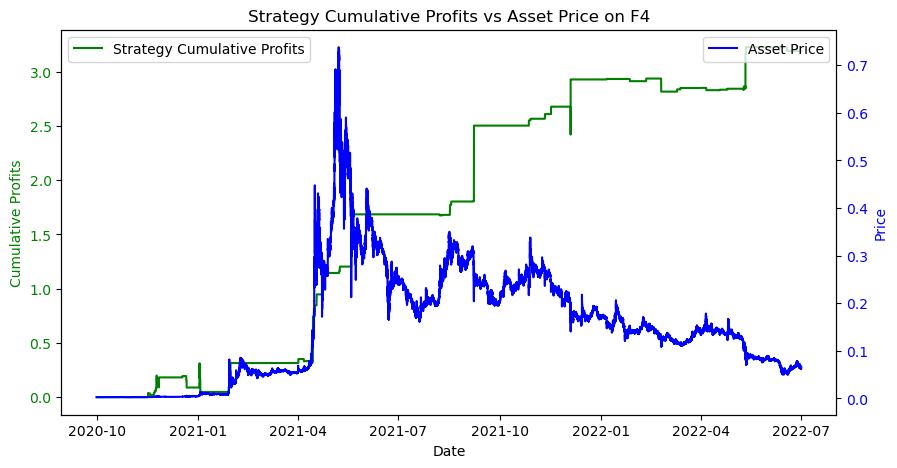

Win Prob: 70.00%
Number of Trades:  70 70
Average Win Return:   0.08677
Average Loss Return: -0.05053
P&L Ratio: 1.7
Maximum Loss of a single trade: -0.1481
Maximum Drawdown: -20.12%
Annual Return: 126.05%
Annual Volatility: 71.42%
Sharpe:  1.765


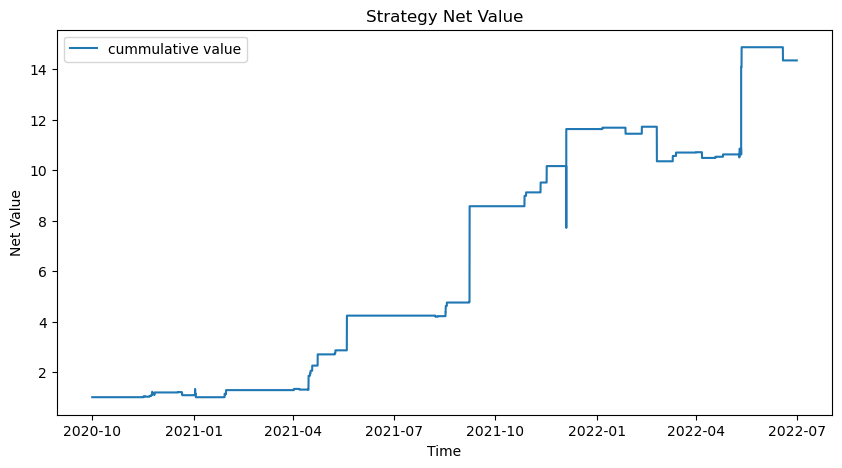

Annual Return: 358.25%
Annual Volatility: 71.41%
Sharpe:  5.017


Preprocess finished
8.3 Trading signal finished


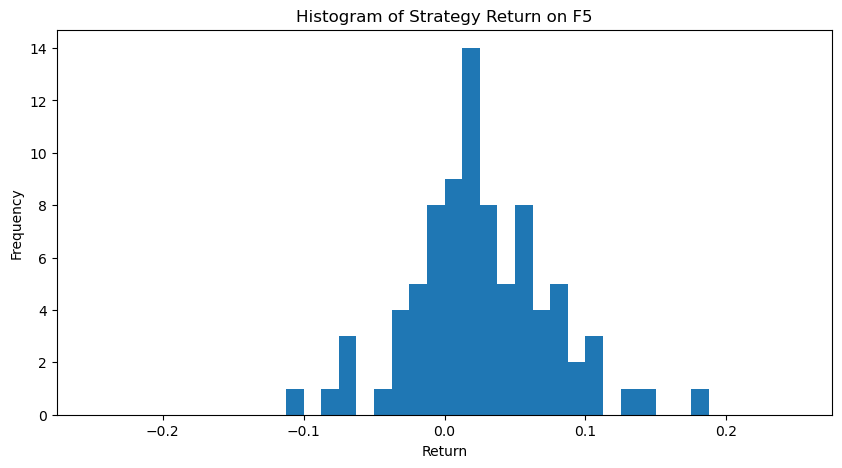

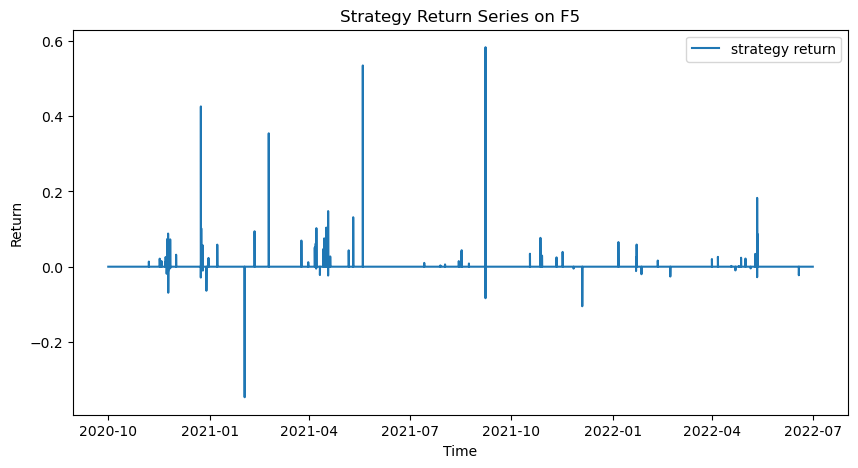

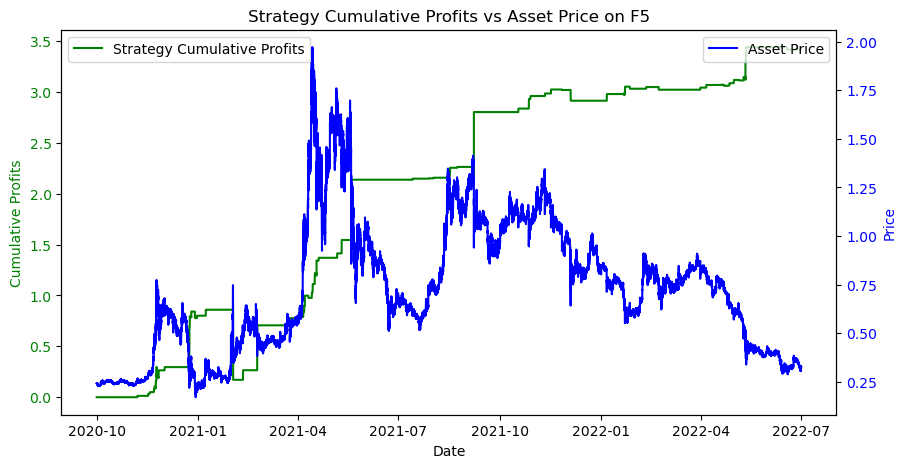

Win Prob: 72.22%
Number of Trades:  90 90
Average Win Return:   0.07322
Average Loss Return: -0.05375
P&L Ratio: 1.4
Maximum Loss of a single trade: -0.347
Maximum Drawdown: -37.01%
Annual Return: 134.94%
Annual Volatility: 74.10%
Sharpe:  1.821


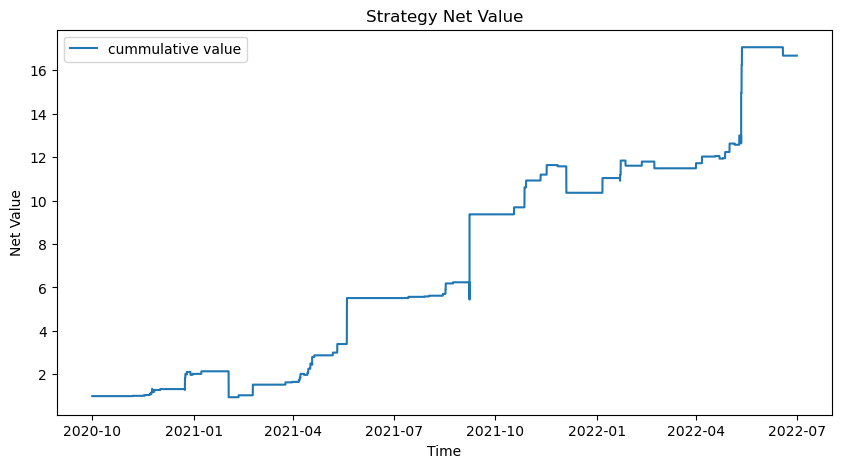

Annual Return: 399.22%
Annual Volatility: 74.09%
Sharpe:  5.388


Preprocess finished
8.3 Trading signal finished


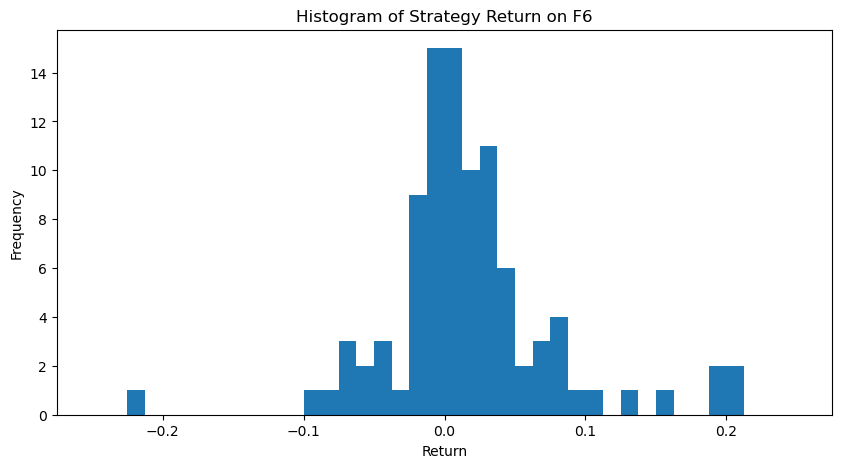

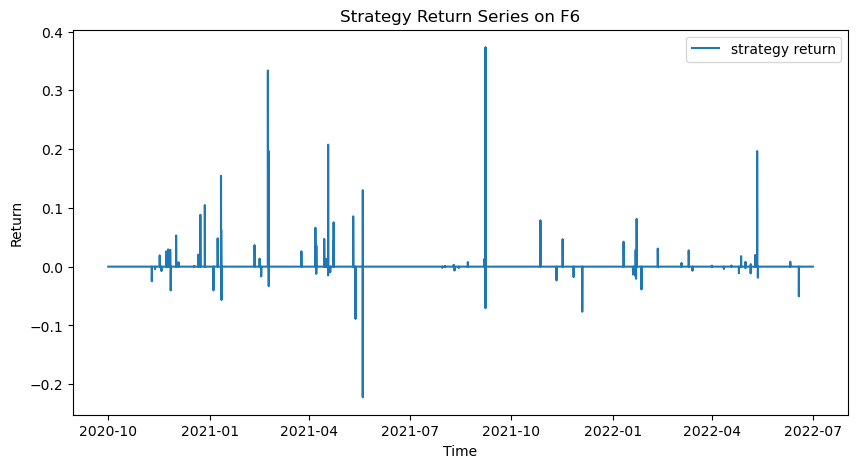

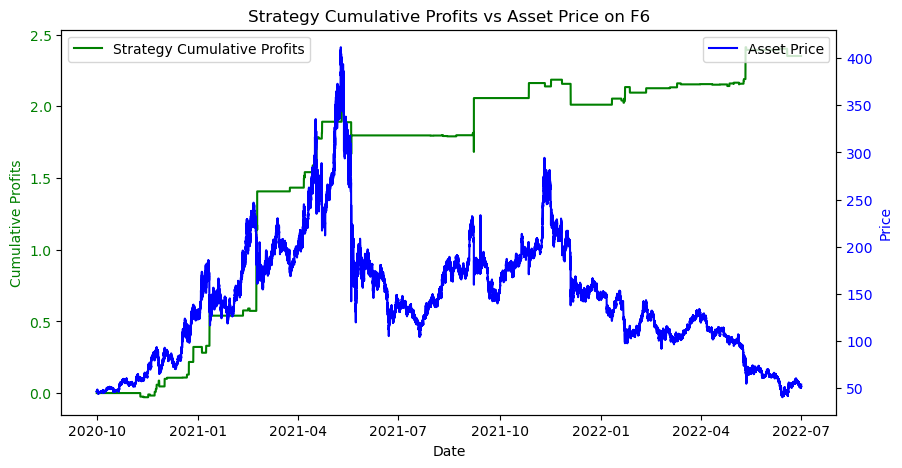

Win Prob: 62.89%
Number of Trades:  97 97
Average Win Return:   0.05696
Average Loss Return: -0.03119
P&L Ratio: 1.8
Maximum Loss of a single trade: -0.2222
Maximum Drawdown: -10.45%
Annual Return: 92.91%
Annual Volatility: 50.26%
Sharpe:  1.849


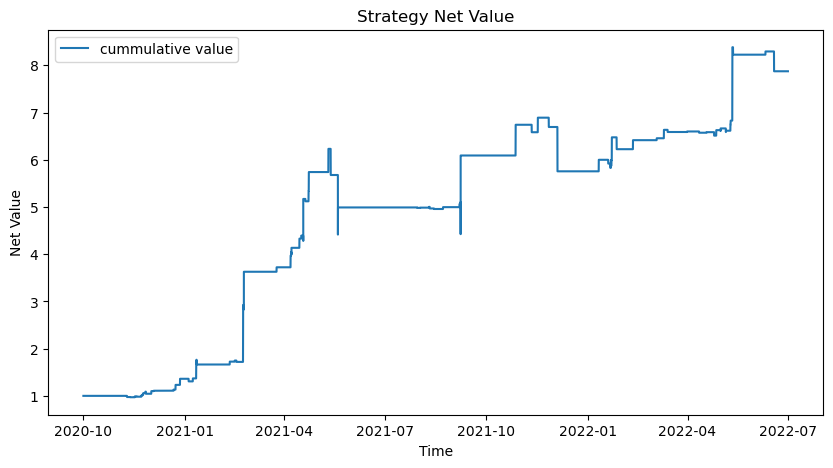

Annual Return: 225.15%
Annual Volatility: 50.25%
Sharpe:  4.481


Preprocess finished
8.3 Trading signal finished


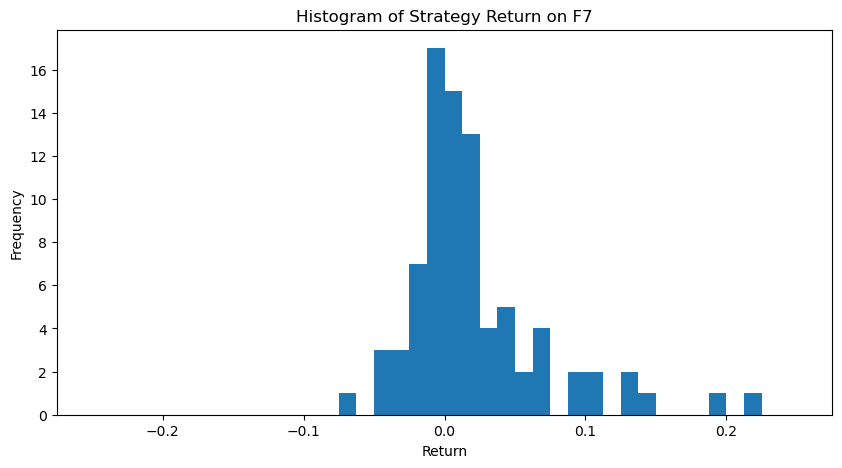

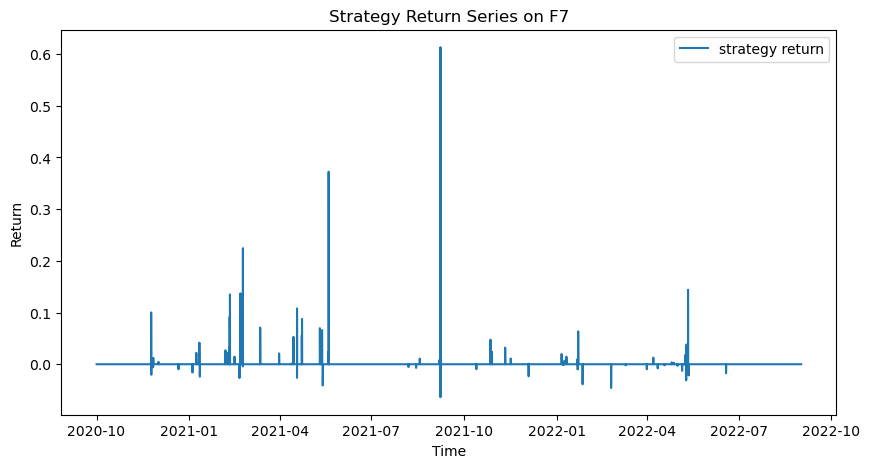

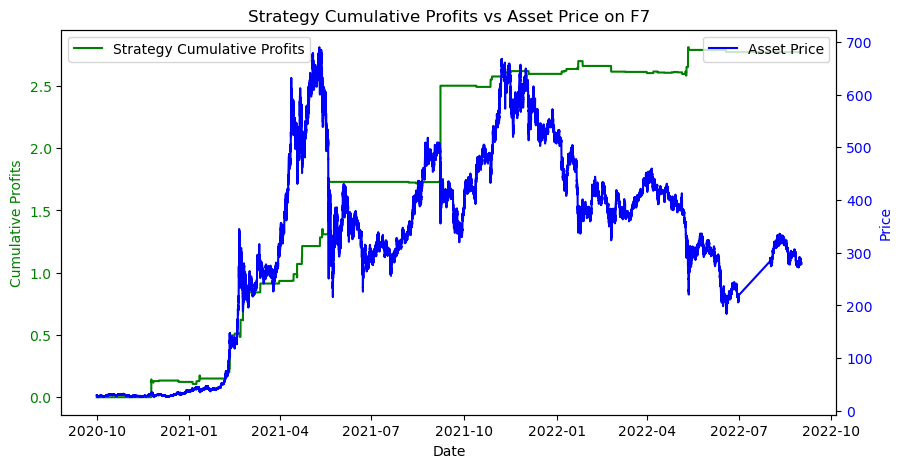

Win Prob: 63.53%
Number of Trades:  85 85
Average Win Return:   0.06039
Average Loss Return: -0.0158
P&L Ratio: 3.8
Maximum Loss of a single trade: -0.06381
Maximum Drawdown: -3.22%
Annual Return: 104.41%
Annual Volatility: 53.30%
Sharpe:  1.959


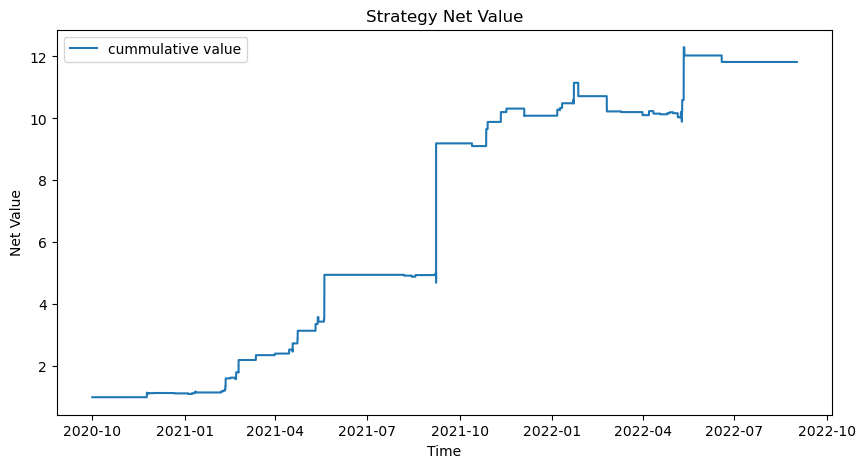

Annual Return: 310.17%
Annual Volatility: 53.29%
Sharpe:  5.82


Preprocess finished
8.3 Trading signal finished


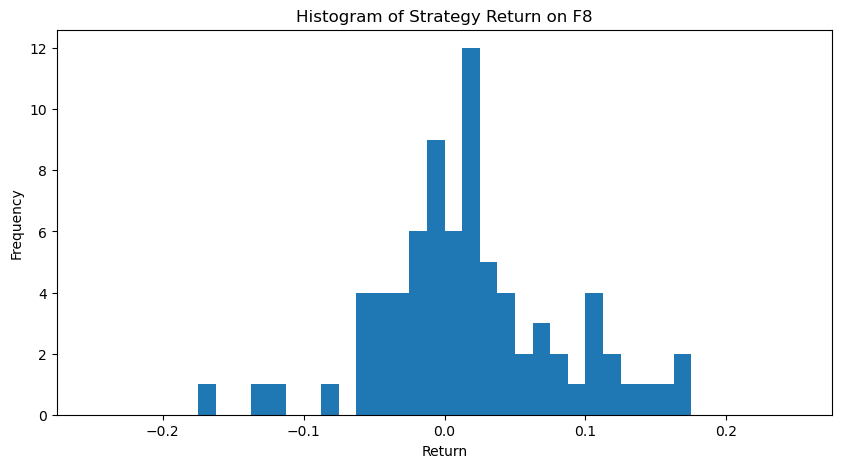

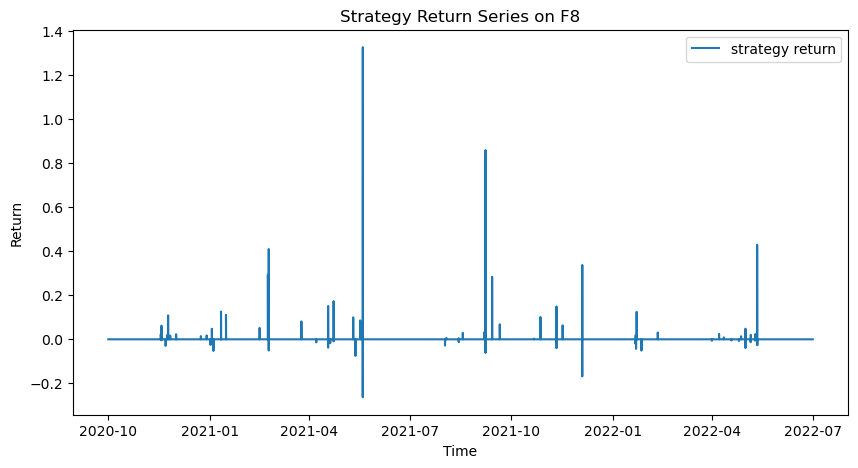

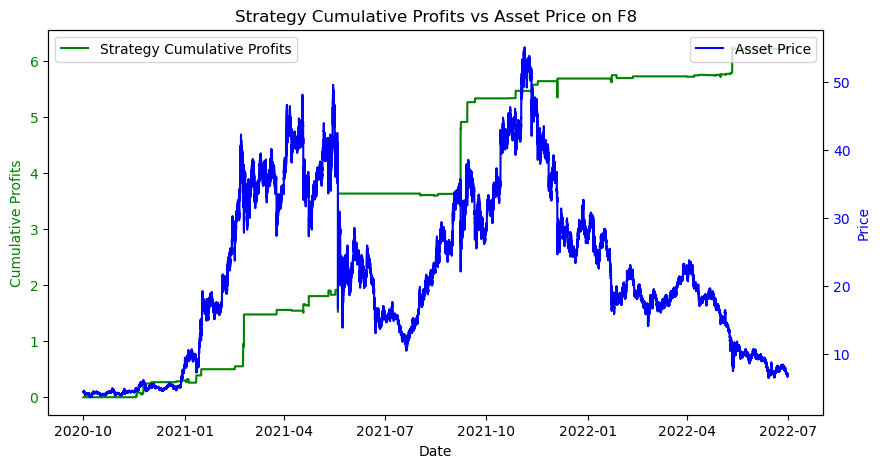

Win Prob: 63.22%
Number of Trades:  87 87
Average Win Return:   0.1385
Average Loss Return: -0.0439
P&L Ratio: 3.2
Maximum Loss of a single trade: -0.2632
Maximum Drawdown: -13.49%
Annual Return: 245.44%
Annual Volatility: 129.47%
Sharpe:  1.896


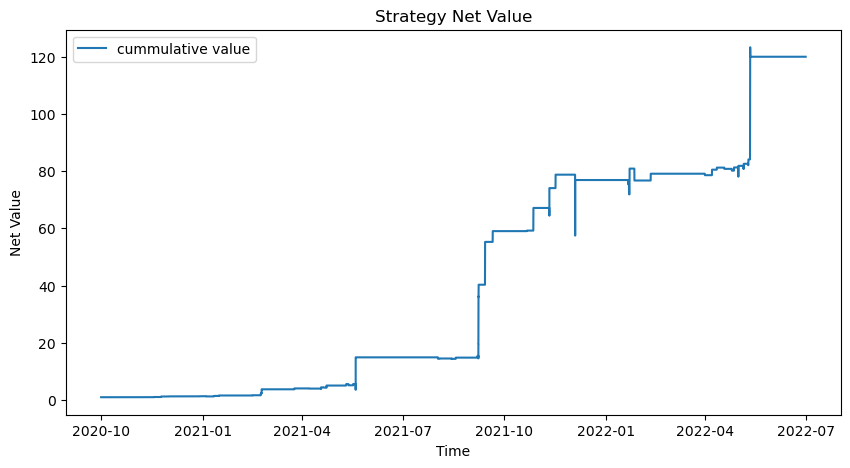

Annual Return: 1441.68%
Annual Volatility: 129.46%
Sharpe:  11.14


Preprocess finished
8.3 Trading signal finished


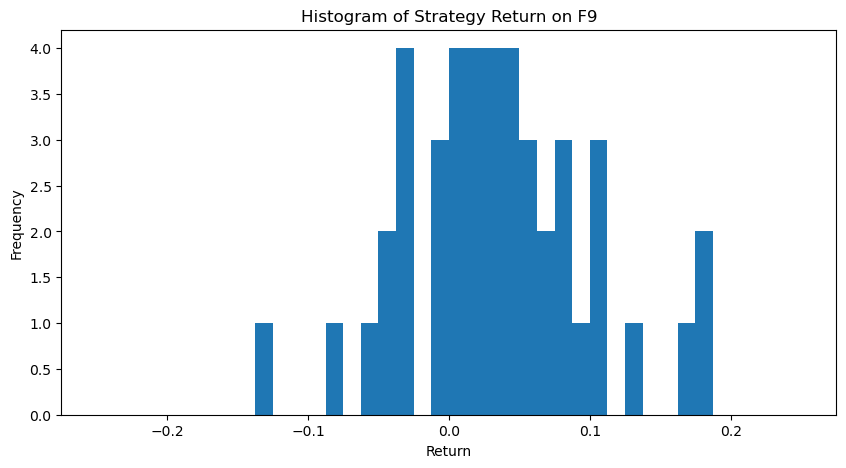

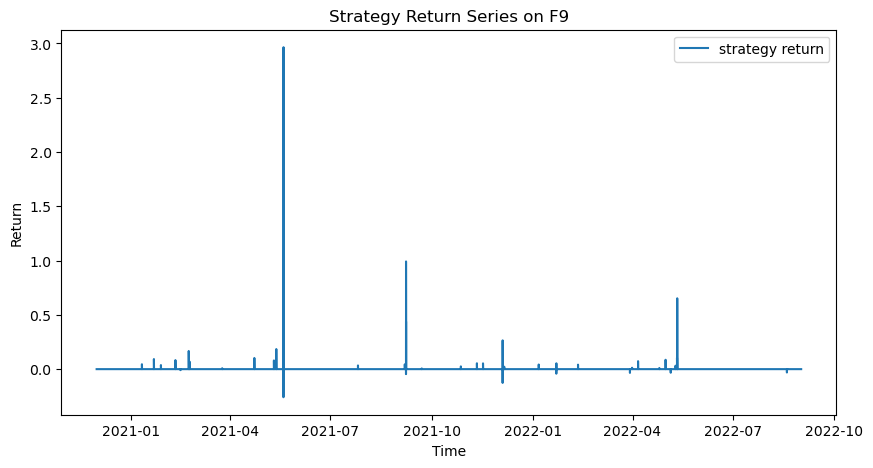

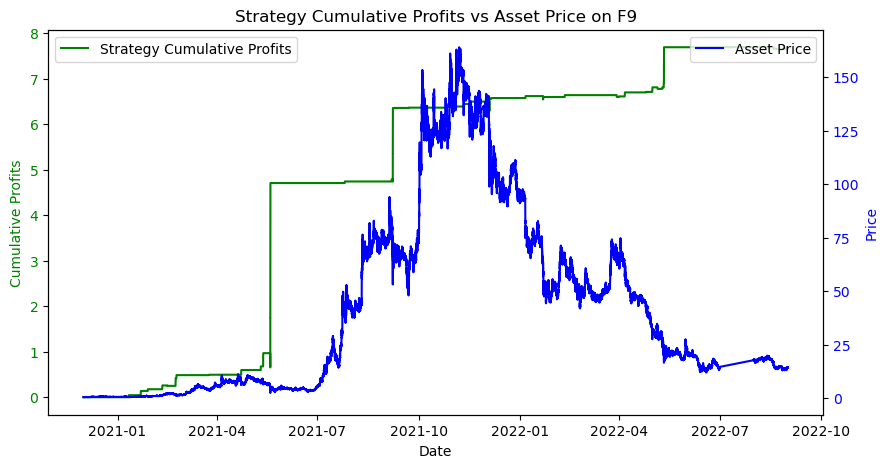

Win Prob: 74.51%
Number of Trades:  51 51
Average Win Return:   0.2213
Average Loss Return: -0.05825
P&L Ratio: 3.8
Maximum Loss of a single trade: -0.2586
Maximum Drawdown: -15.83%
Annual Return: 317.31%
Annual Volatility: 222.54%
Sharpe:  1.426


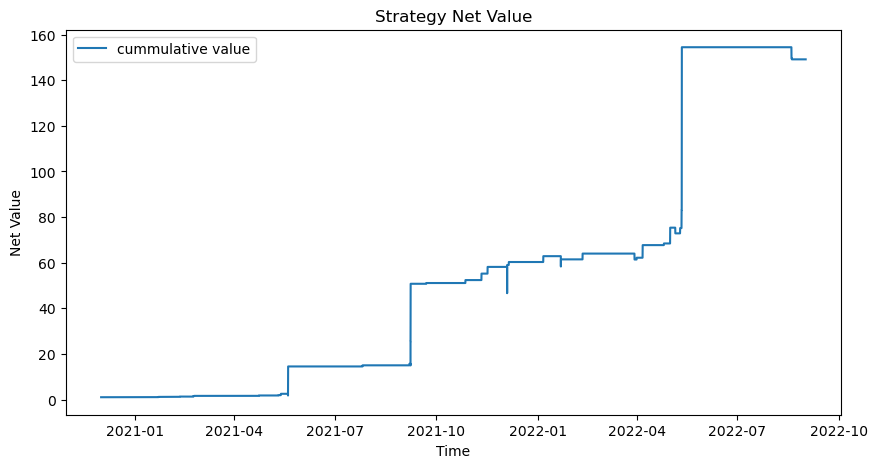

Annual Return: 1645.89%
Annual Volatility: 222.51%
Sharpe:  7.397


Preprocess finished
8.3 Trading signal finished


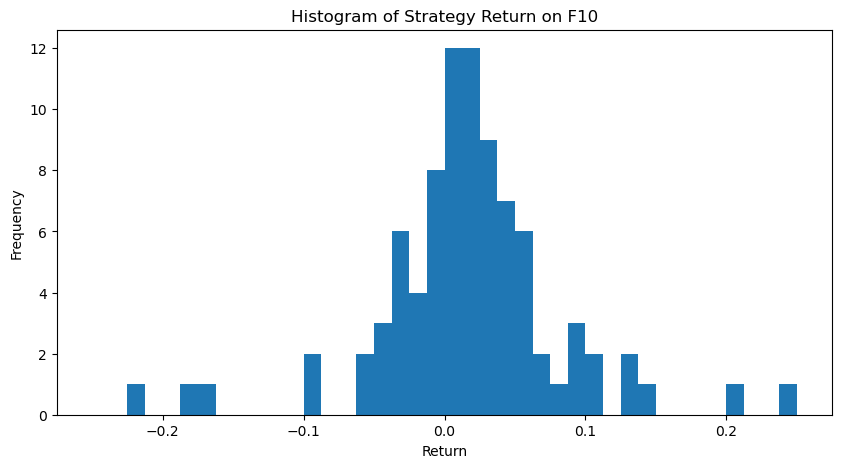

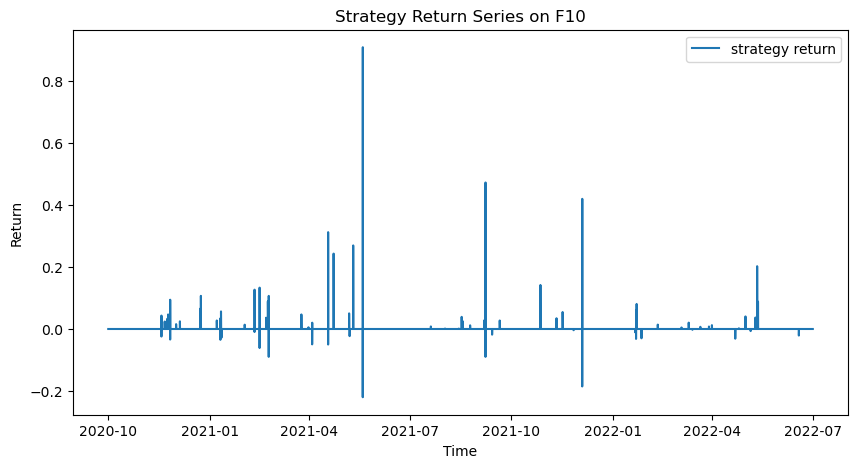

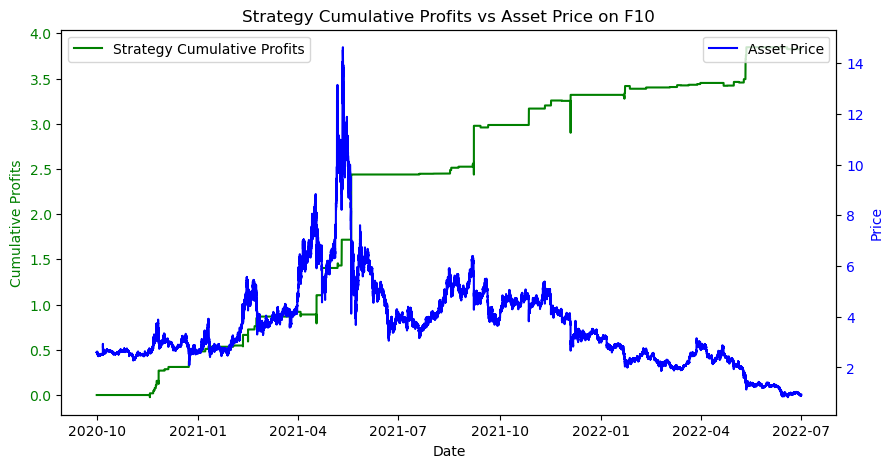

Win Prob: 69.57%
Number of Trades:  92 92
Average Win Return:   0.08065
Average Loss Return: -0.04774
P&L Ratio: 1.7
Maximum Loss of a single trade: -0.2198
Maximum Drawdown: -8.38%
Annual Return: 151.12%
Annual Volatility: 84.39%
Sharpe:  1.791


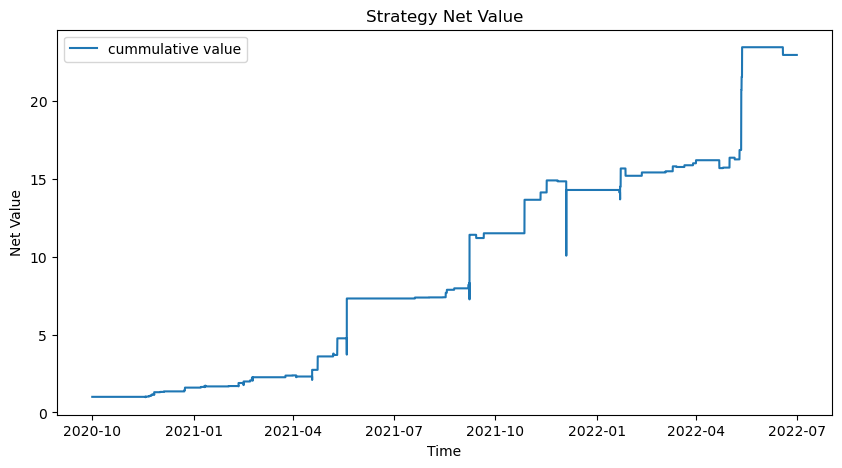

Annual Return: 499.39%
Annual Volatility: 84.38%
Sharpe:  5.918


Preprocess finished
8.3 Trading signal finished


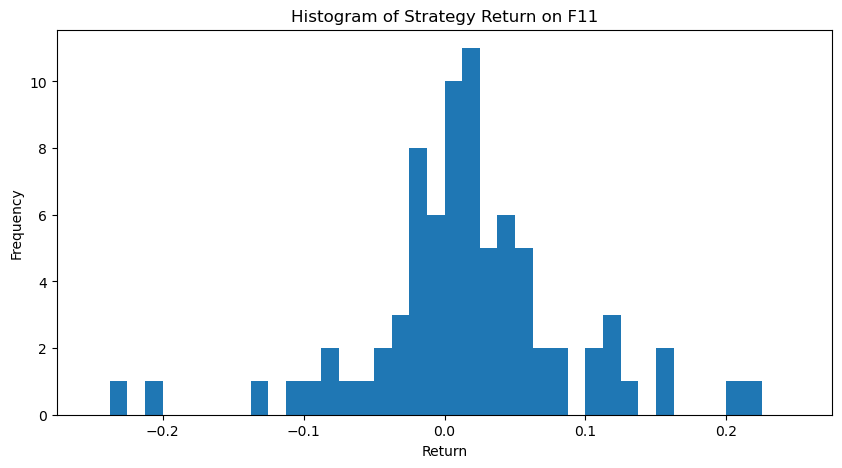

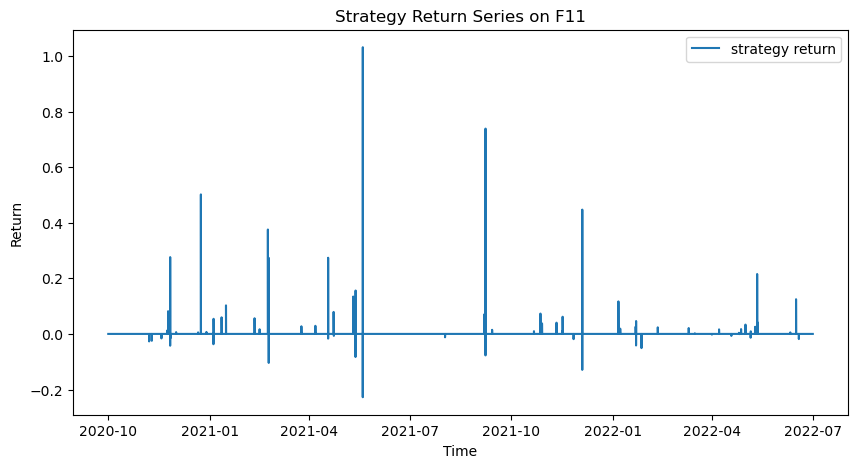

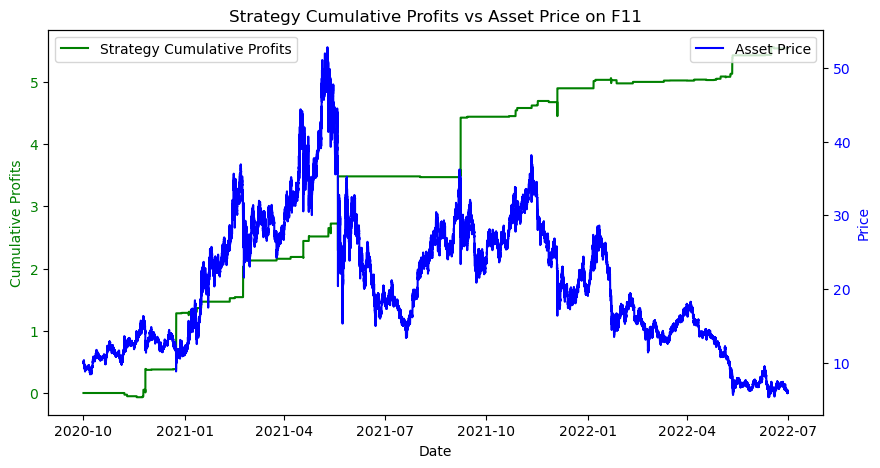

Win Prob: 68.18%
Number of Trades:  88 88
Average Win Return:   0.1157
Average Loss Return: -0.05018
P&L Ratio: 2.3
Maximum Loss of a single trade: -0.2277
Maximum Drawdown: -11.65%
Annual Return: 218.77%
Annual Volatility: 108.52%
Sharpe:  2.016


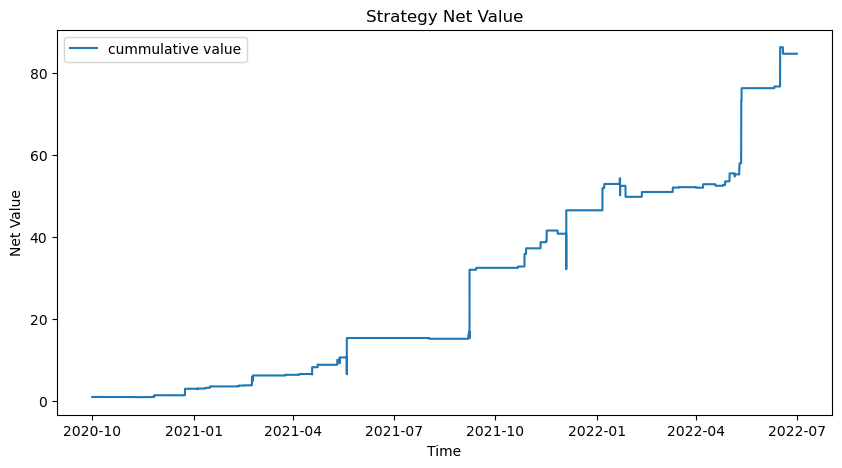

Annual Return: 1163.56%
Annual Volatility: 108.51%
Sharpe:  10.72


Preprocess finished
8.3 Trading signal finished


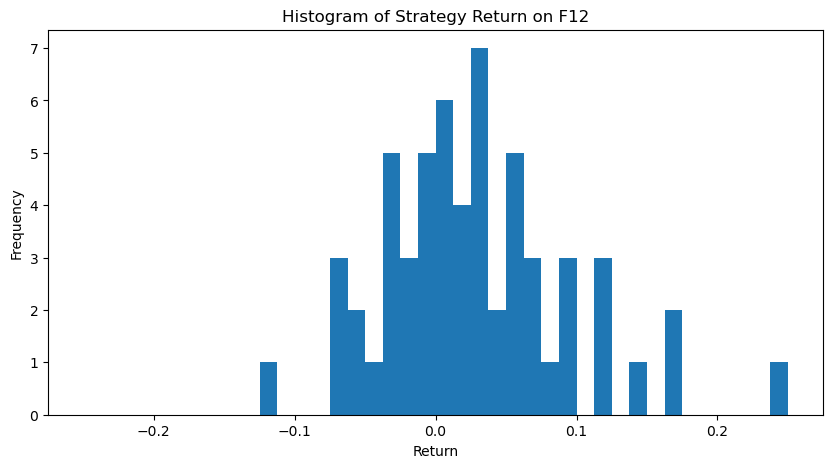

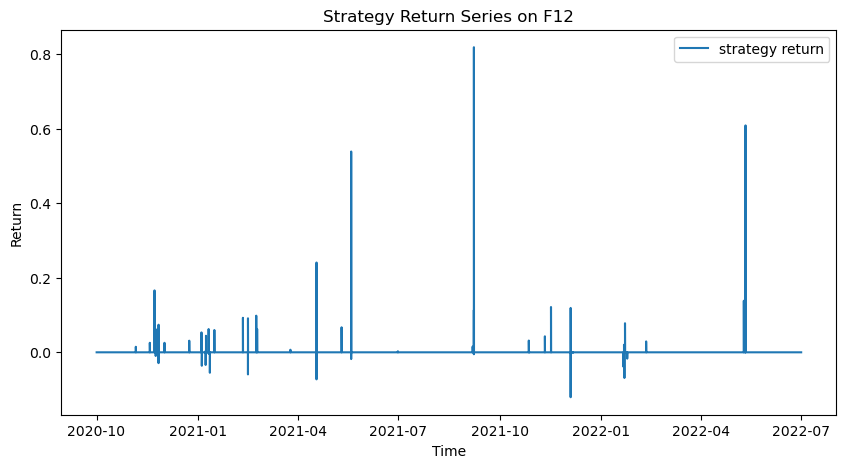

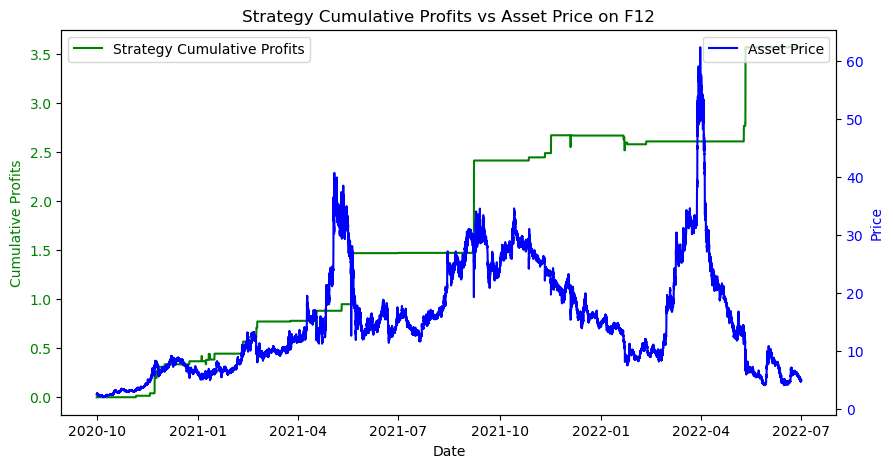

Win Prob: 67.21%
Number of Trades:  61 61
Average Win Return:   0.1047
Average Loss Return: -0.03593
P&L Ratio: 2.9
Maximum Loss of a single trade: -0.1206
Maximum Drawdown: -7.77%
Annual Return: 141.13%
Annual Volatility: 80.12%
Sharpe:  1.762


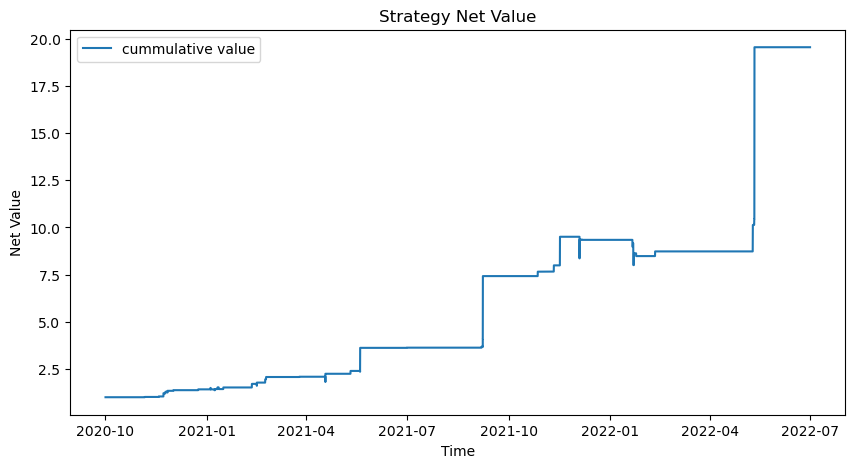

Annual Return: 446.89%
Annual Volatility: 80.11%
Sharpe:  5.579


Preprocess finished
8.3 Trading signal finished


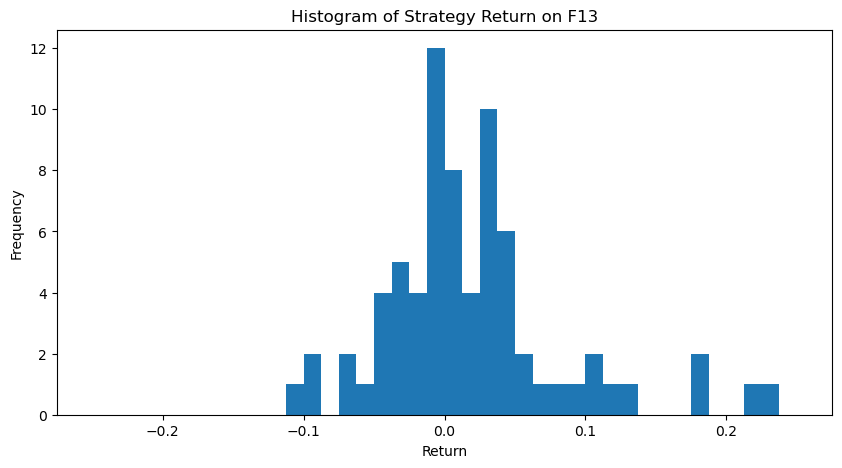

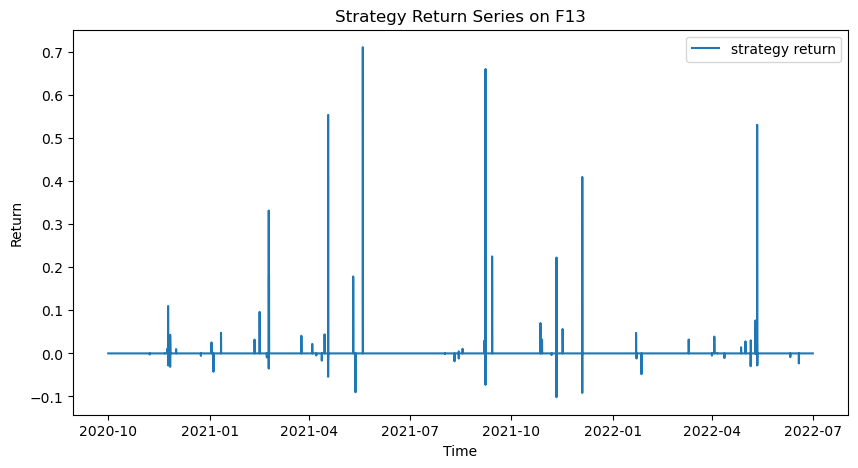

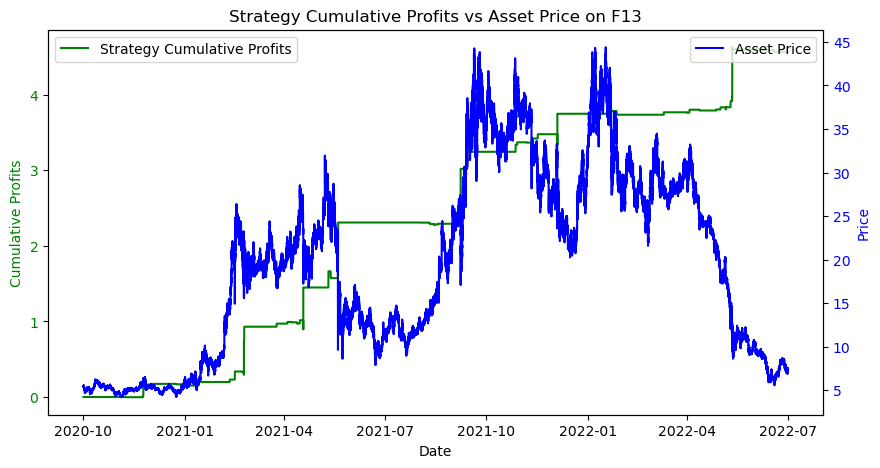

Win Prob: 60.26%
Number of Trades:  78 78
Average Win Return:   0.1178
Average Loss Return: -0.03132
P&L Ratio: 3.8
Maximum Loss of a single trade: -0.1018
Maximum Drawdown: -6.00%
Annual Return: 180.47%
Annual Volatility: 91.88%
Sharpe:  1.964


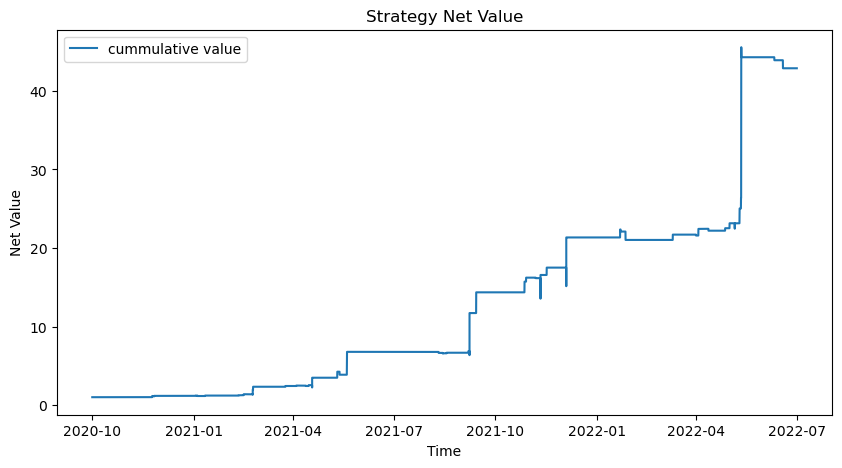

Annual Return: 756.46%
Annual Volatility: 91.87%
Sharpe:  8.234


Preprocess finished
8.3 Trading signal finished


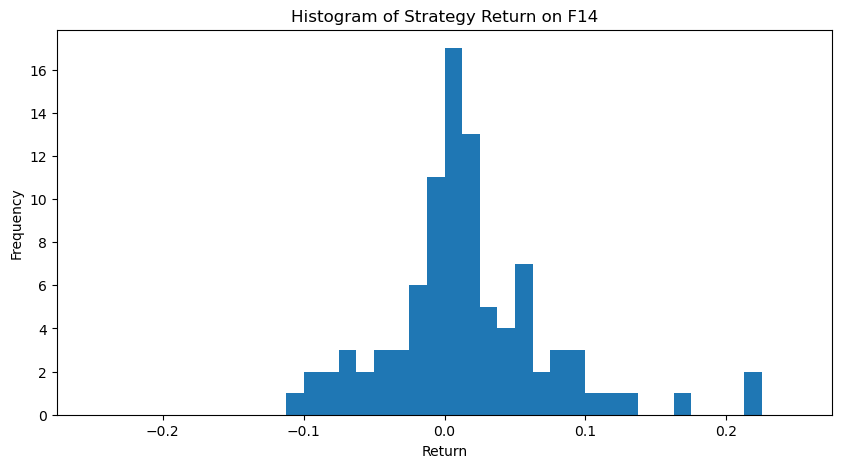

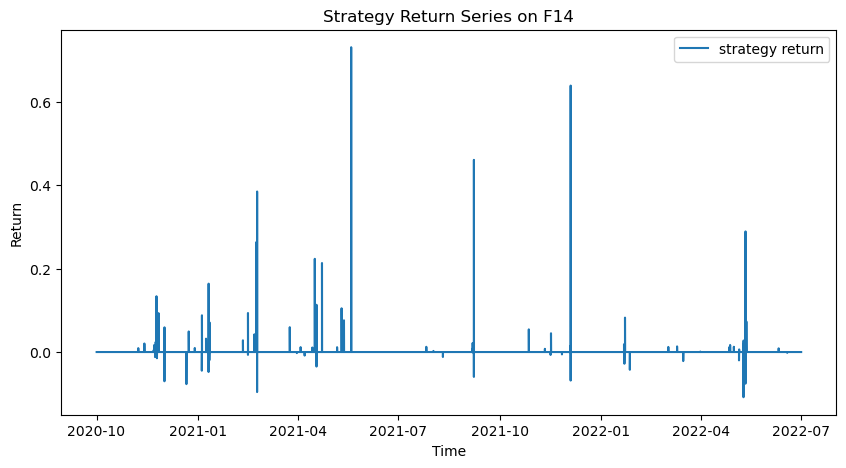

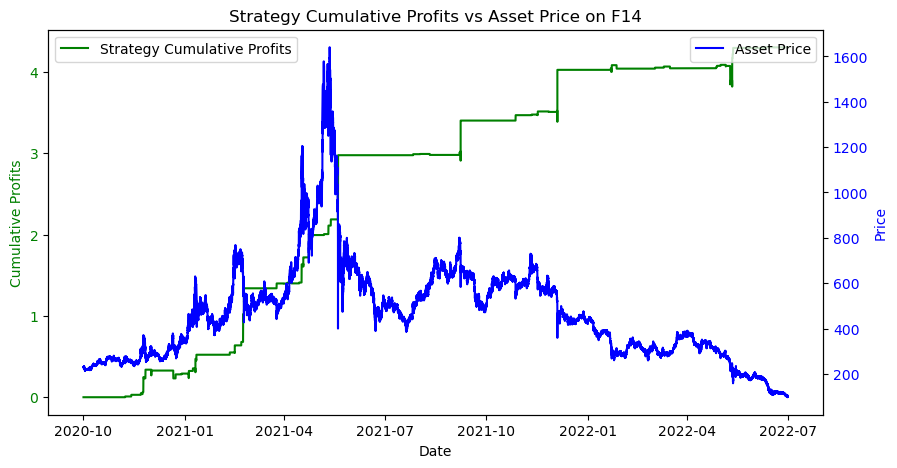

Win Prob: 66.67%
Number of Trades:  99 99
Average Win Return:   0.08298
Average Loss Return: -0.03557
P&L Ratio: 2.3
Maximum Loss of a single trade: -0.1084
Maximum Drawdown: -8.00%
Annual Return: 170.00%
Annual Volatility: 84.10%
Sharpe:  2.022


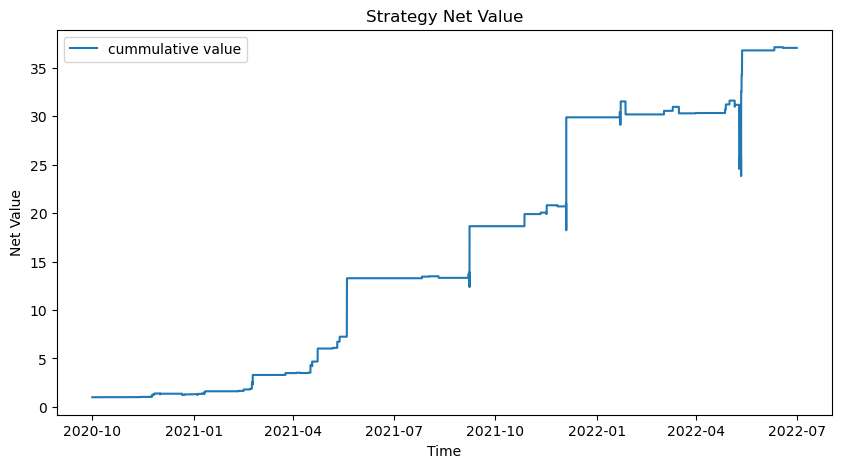

Annual Return: 687.71%
Annual Volatility: 84.08%
Sharpe:  8.179


Preprocess finished
8.3 Trading signal finished


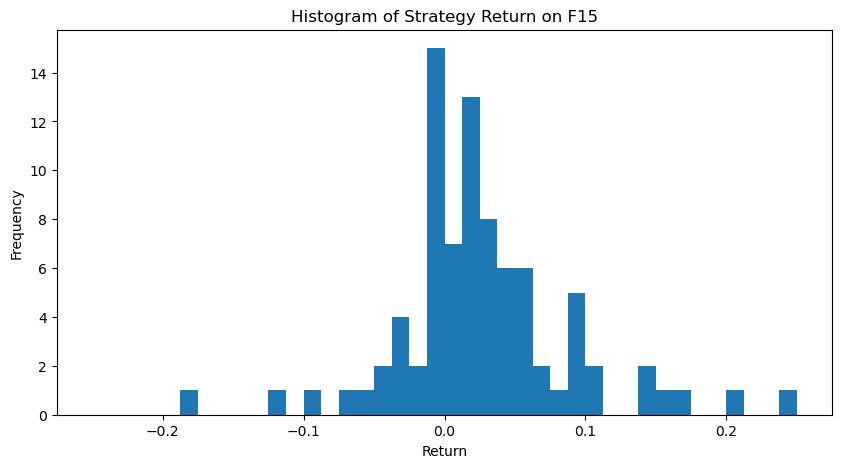

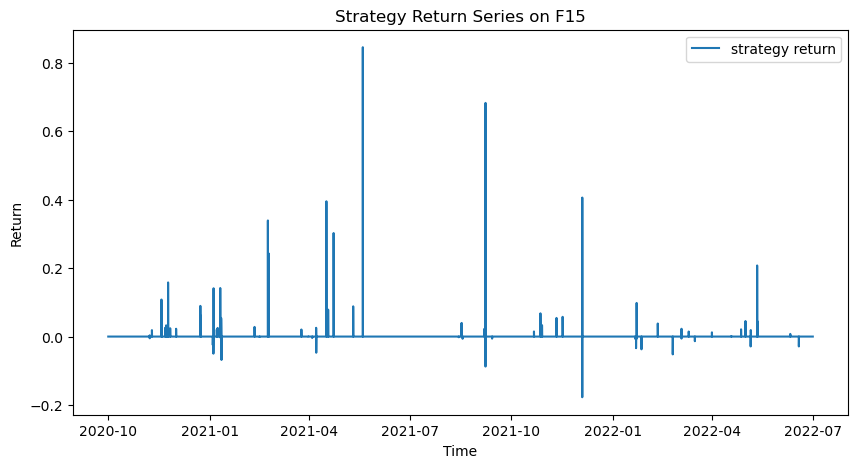

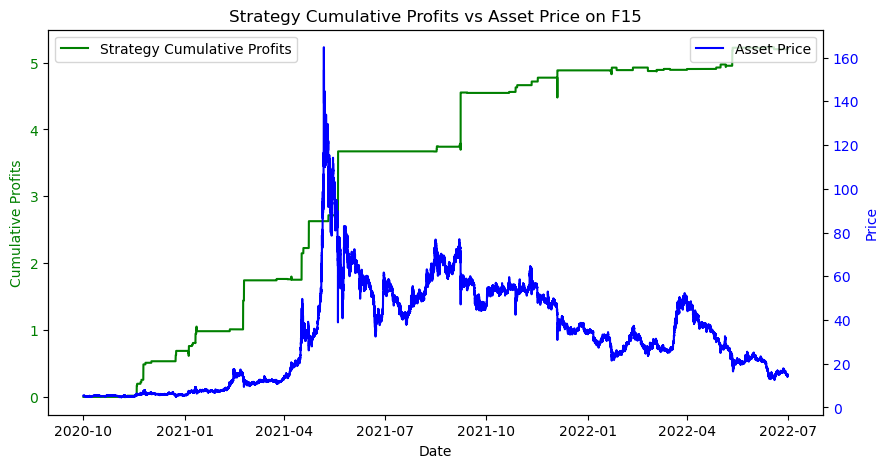

Win Prob: 68.89%
Number of Trades:  90 90
Average Win Return:   0.09749
Average Loss Return: -0.0301
P&L Ratio: 3.2
Maximum Loss of a single trade: -0.1773
Maximum Drawdown: -5.14%
Annual Return: 205.50%
Annual Volatility: 91.14%
Sharpe:  2.255


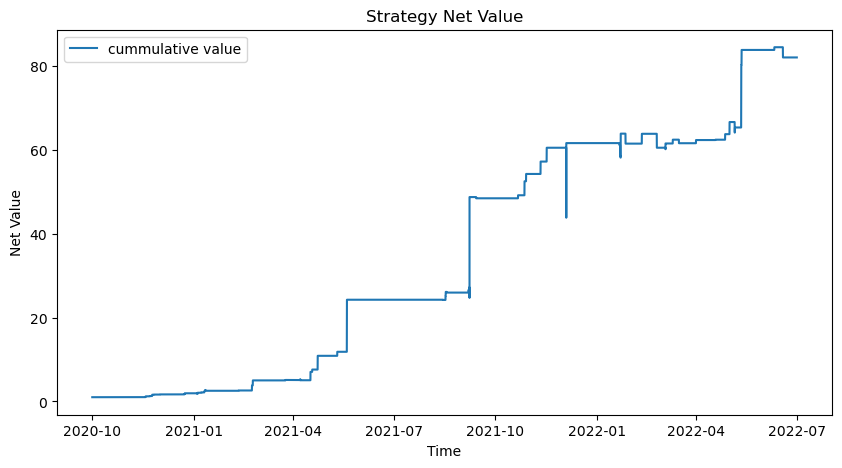

Annual Return: 1141.07%
Annual Volatility: 91.13%
Sharpe:  12.52


Preprocess finished
8.3 Trading signal finished


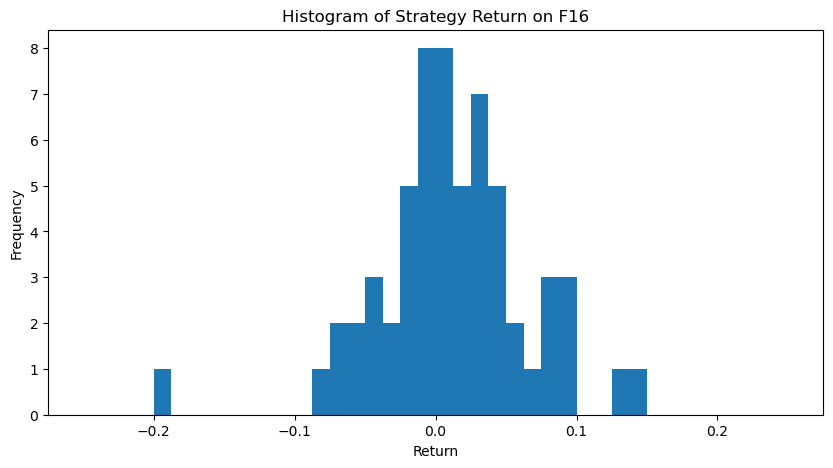

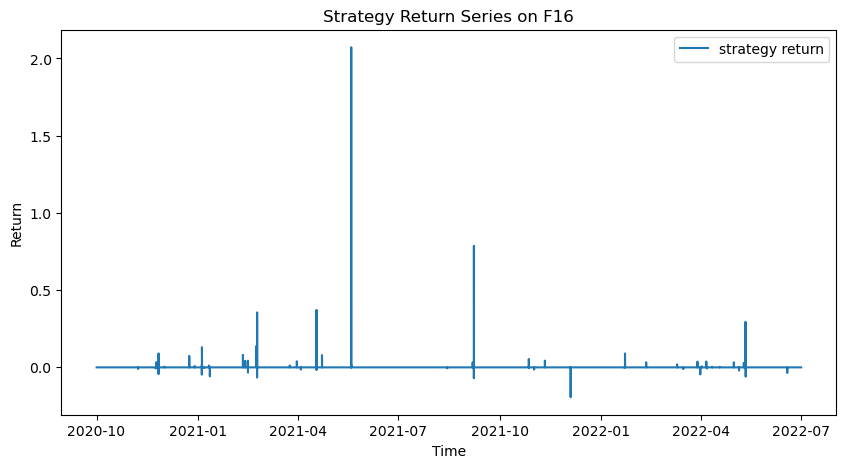

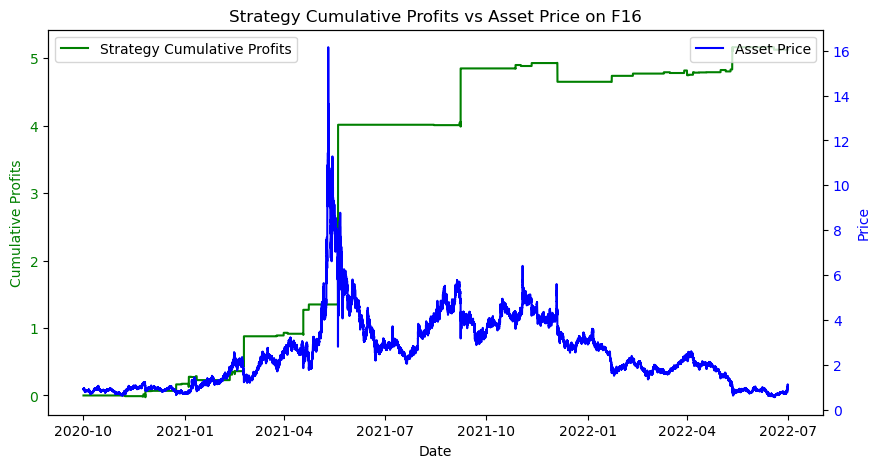

Win Prob: 63.64%
Number of Trades:  66 66
Average Win Return:   0.143
Average Loss Return: -0.03671
P&L Ratio: 3.9
Maximum Loss of a single trade: -0.1932
Maximum Drawdown: -4.77%
Annual Return: 202.57%
Annual Volatility: 151.13%
Sharpe:  1.34


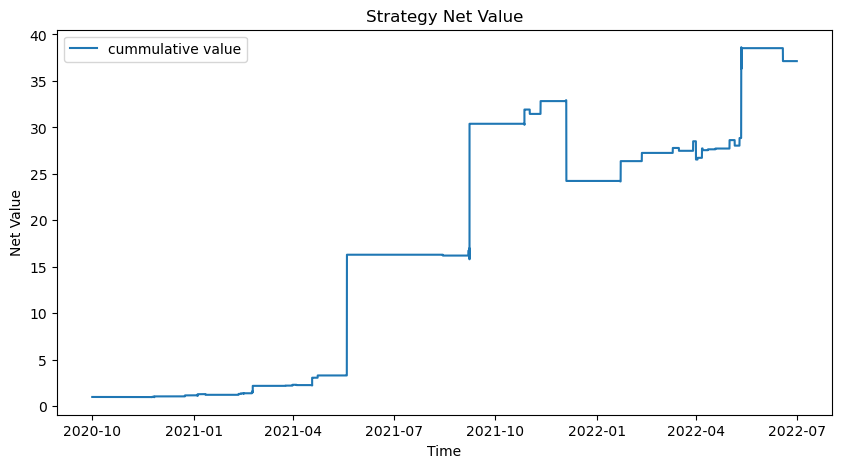

Annual Return: 688.86%
Annual Volatility: 151.11%
Sharpe:  4.559


Preprocess finished
8.3 Trading signal finished


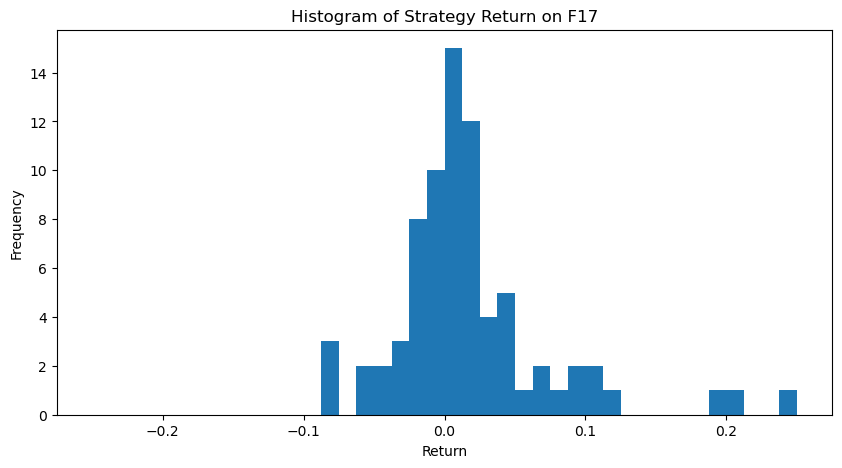

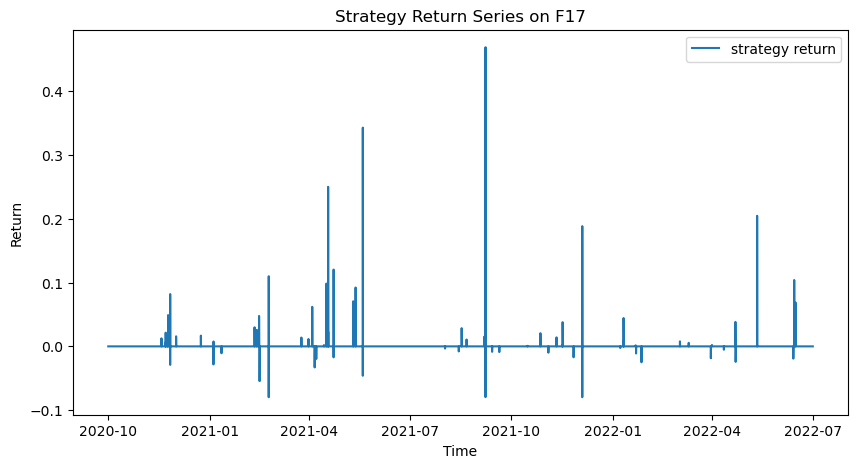

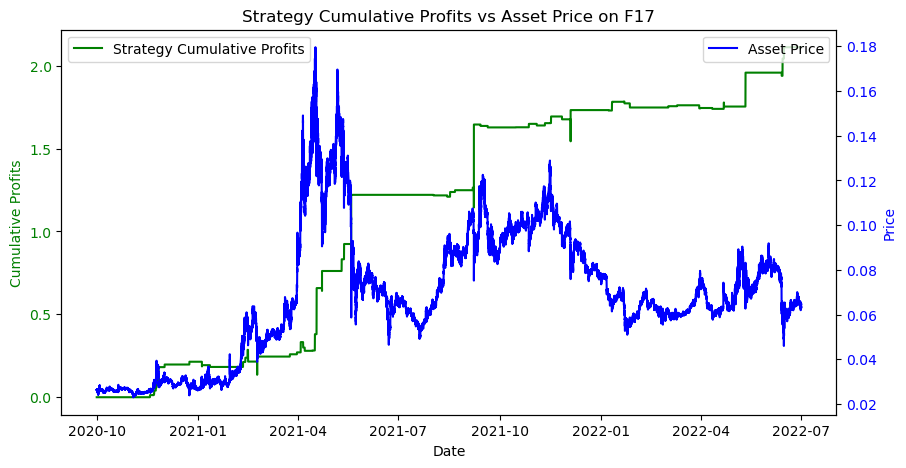

Win Prob: 64.10%
Number of Trades:  78 78
Average Win Return:   0.05746
Average Loss Return: -0.02719
P&L Ratio: 2.1
Maximum Loss of a single trade: -0.07965
Maximum Drawdown: -11.71%
Annual Return: 83.43%
Annual Volatility: 48.88%
Sharpe:  1.707


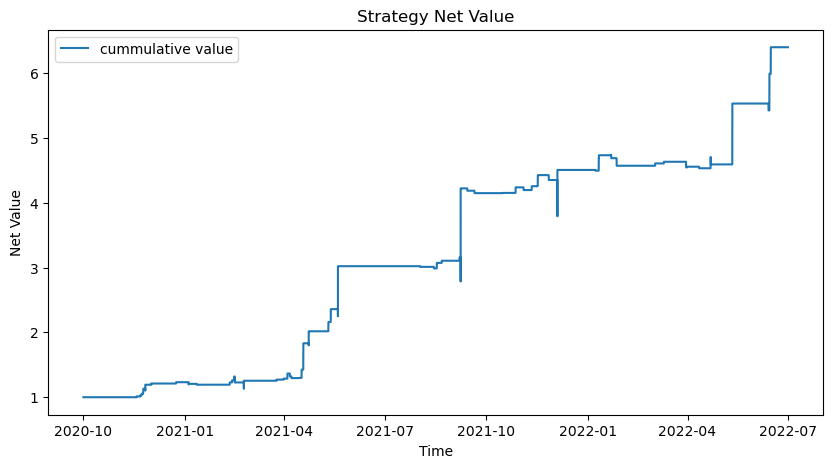

Annual Return: 188.81%
Annual Volatility: 48.88%
Sharpe:  3.863


Preprocess finished
8.3 Trading signal finished


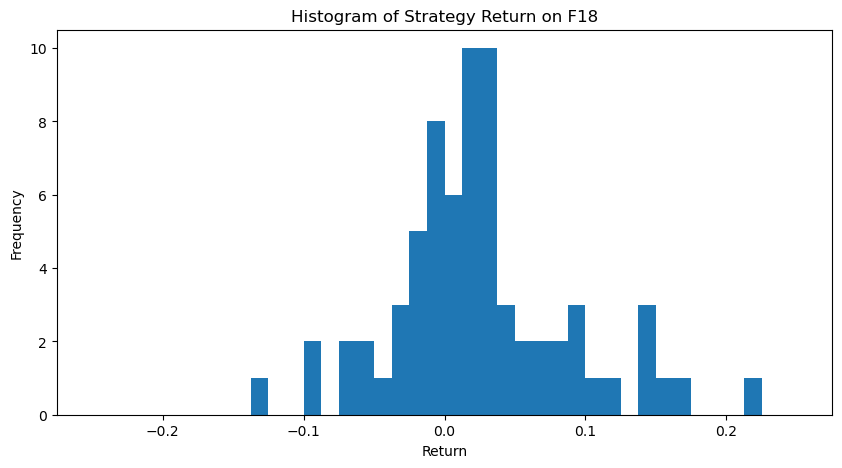

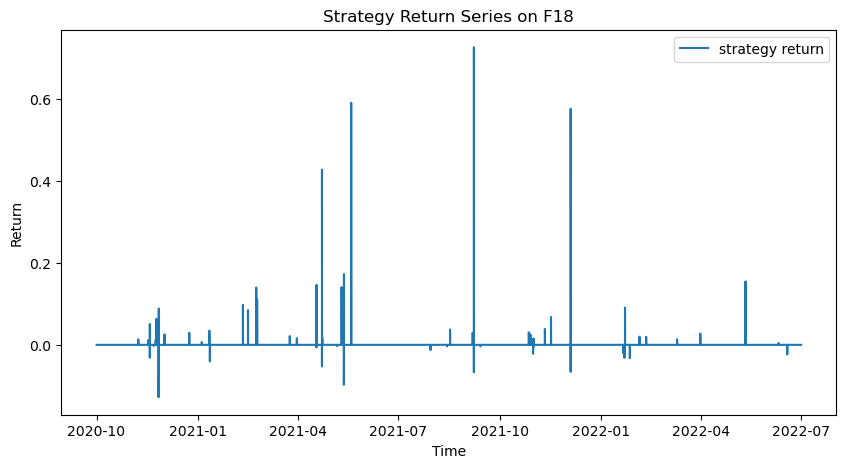

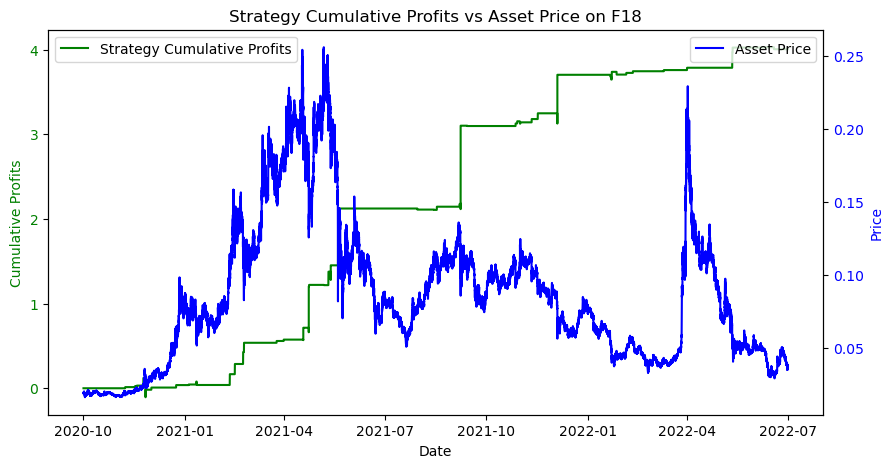

Win Prob: 67.57%
Number of Trades:  74 74
Average Win Return:   0.09666
Average Loss Return: -0.03444
P&L Ratio: 2.8
Maximum Loss of a single trade: -0.1279
Maximum Drawdown: -20.26%
Annual Return: 158.30%
Annual Volatility: 82.15%
Sharpe:  1.927


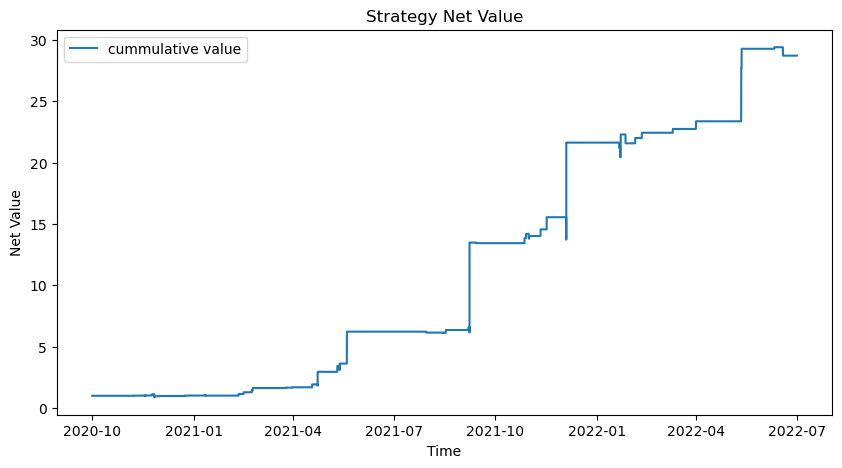

Annual Return: 581.16%
Annual Volatility: 82.13%
Sharpe:  7.076




In [437]:
# strategy 8.3 use avg_price as buy price
strategy8_3_list = []
for idx in range(len(data_list)):
    name = 'F'+str(idx+1)
    stra8_3 = CTAStrategy(data_list[idx],'open_time','signal','close',120,5,name)
    stra8_3.data_preprocess()
    stra8_3.find_signal_8_3(10000,0.1,1)
    stra8_3.get_strategy_returns(1/1000, 'avg_price')
    stra8_3.plot_hist_seires(abs_range=0.25)
    stra8_3.plot_cumsum_profits()
    stra8_3.get_win_prob()
    stra8_3.get_avg_win_return()
    stra8_3.get_maximum_drawdown()
    stra8_3.get_sharpe()
    stra8_3.plot_cumprod_value()
    strategy8_3_list.append(stra8_3)
    print('\n')

# Strategy 8.4

After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


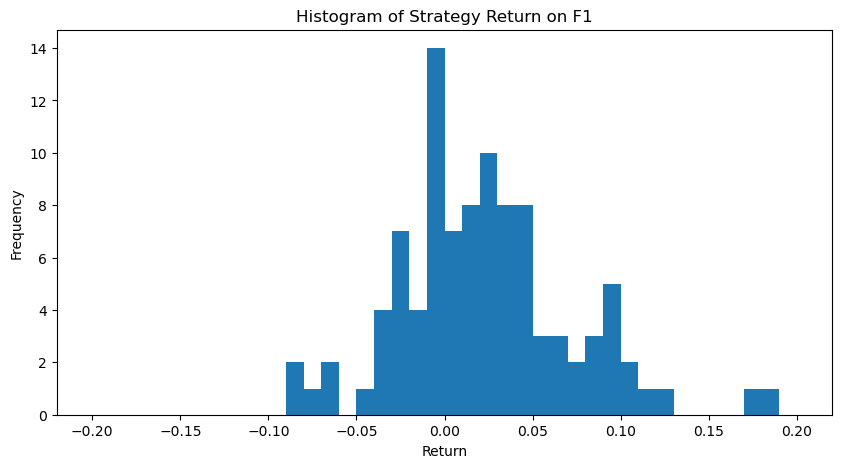

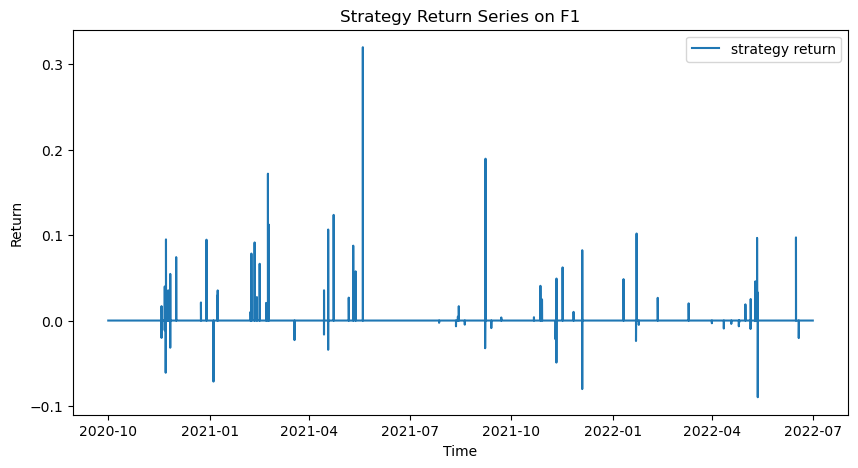

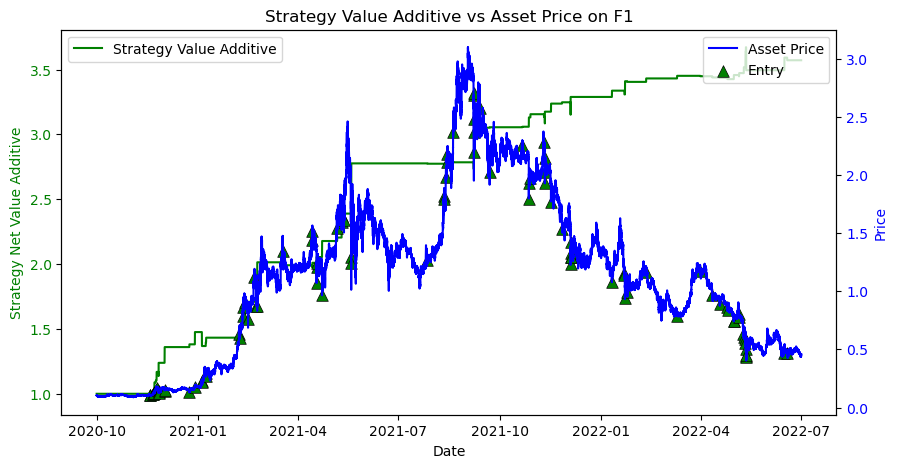

Win Prob: 64.65%
Number of Trades:  99 99
Average Win Return:   0.0534
Average Loss Return: -0.02417
P&L Ratio: 2.2
Maximum Loss of a single trade: -0.08972
Maximum Drawdown: -16.81%
Annualized Return: 101.57%
Annualized Volatility: 39.39%
Sharpe:  2.502


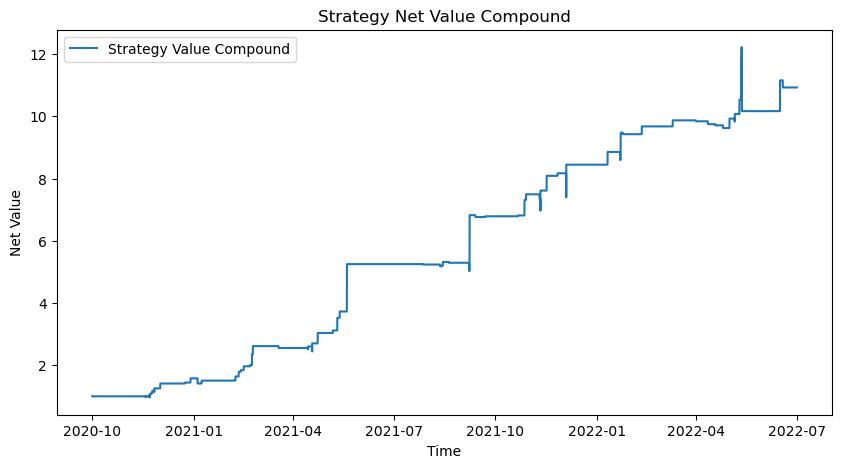

CAGR: 292.15%
Annual Return: 101.57%
Annual Volatility: 39.39%
Sharpe:  2.502


After preprocess the data has 192671 columns.
Preprocess finished
8.4 Trading signal finished


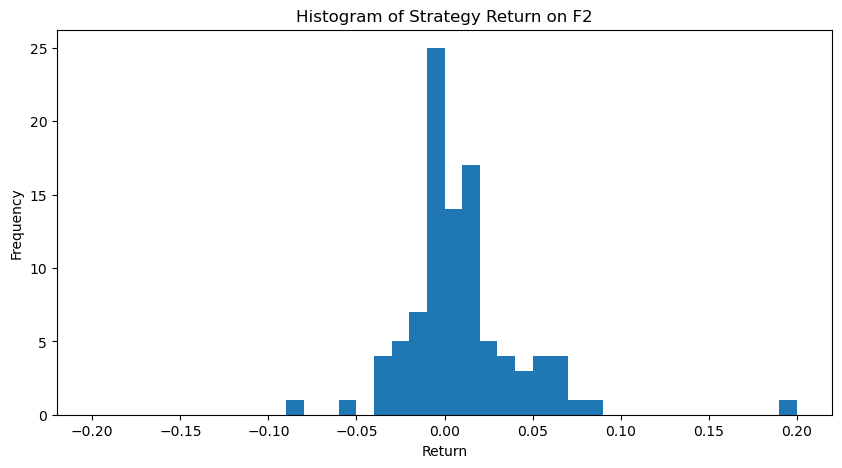

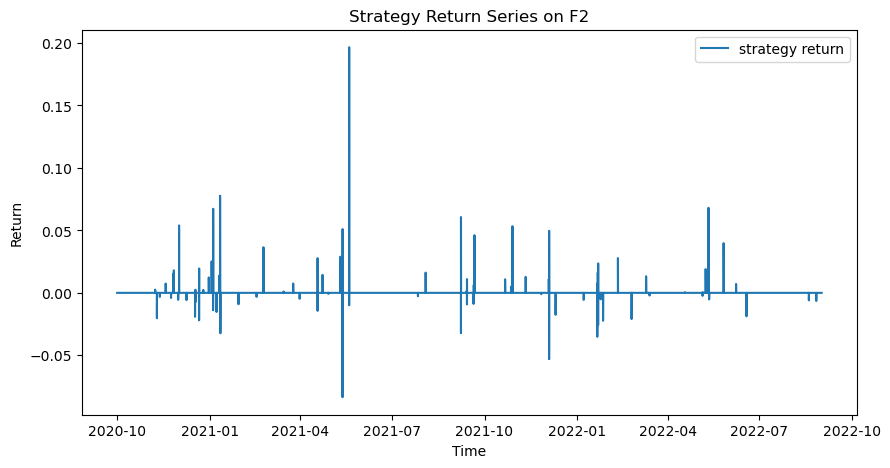

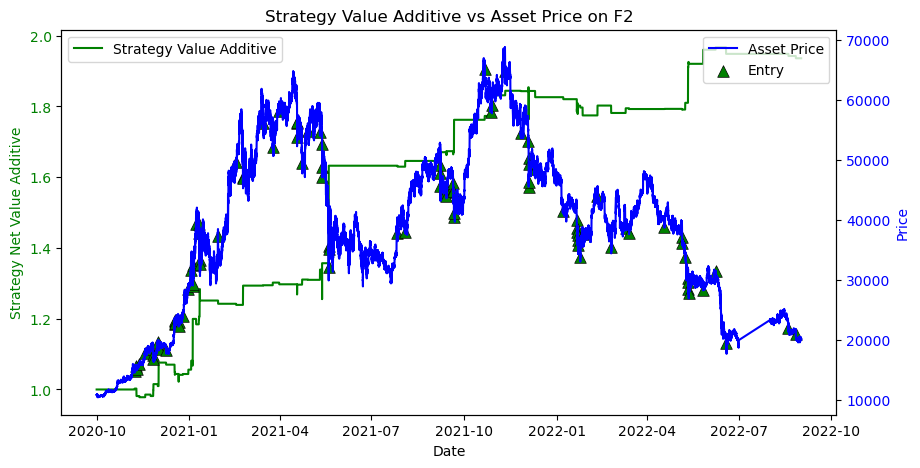

Win Prob: 55.67%
Number of Trades:  97 97
Average Win Return:   0.02881
Average Loss Return: -0.01441
P&L Ratio: 2.0
Maximum Loss of a single trade: -0.08355
Maximum Drawdown: -8.87%
Annualized Return: 35.26%
Annualized Volatility: 21.22%
Sharpe:  1.521


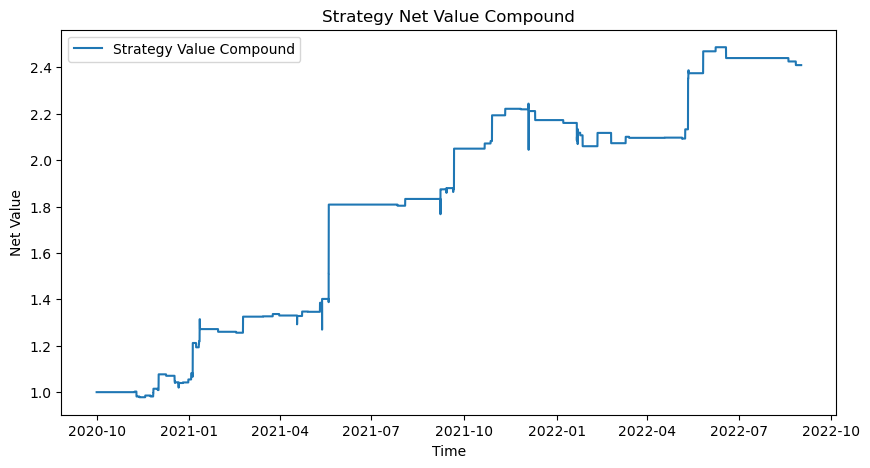

CAGR: 65.29%
Annual Return: 35.26%
Annual Volatility: 21.22%
Sharpe:  1.521


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


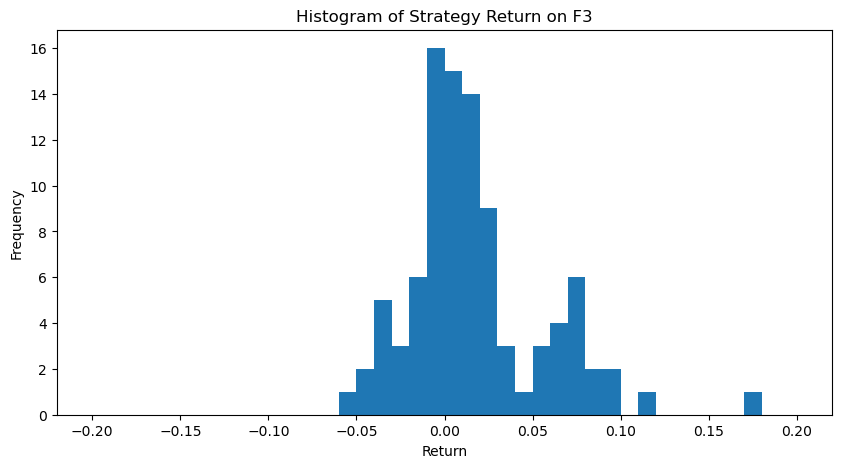

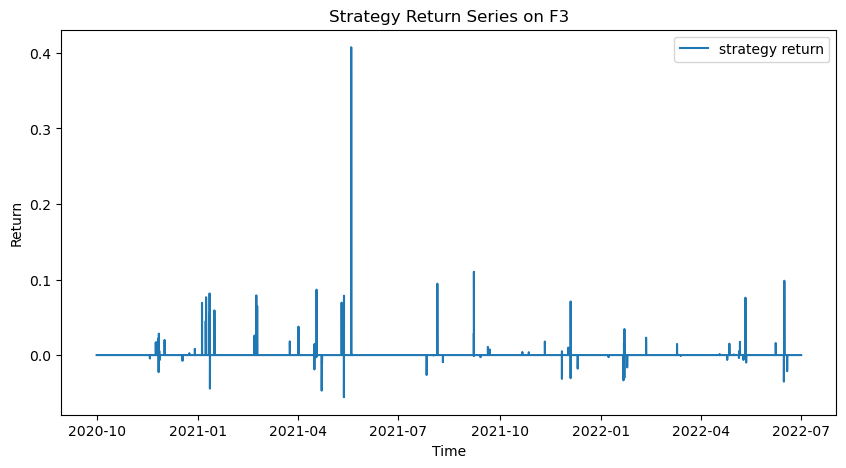

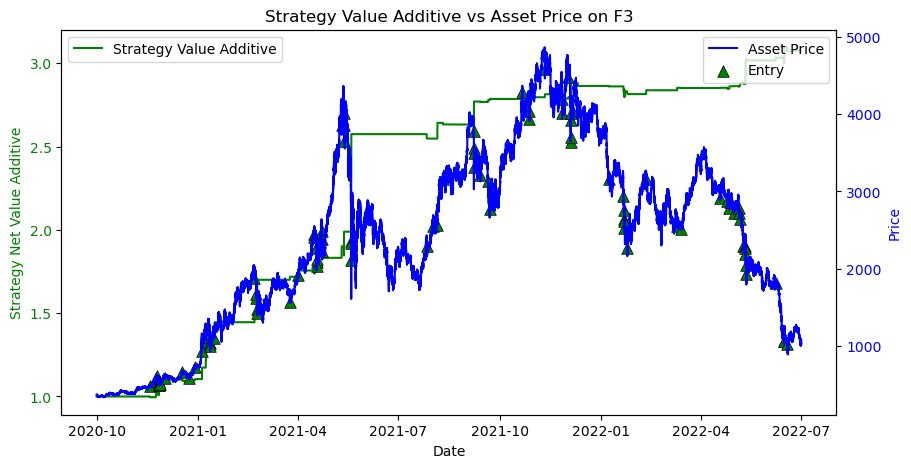

Win Prob: 65.26%
Number of Trades:  95 95
Average Win Return:   0.04219
Average Loss Return: -0.01637
P&L Ratio: 2.6
Maximum Loss of a single trade: -0.05578
Maximum Drawdown: -8.30%
Annualized Return: 81.97%
Annualized Volatility: 36.42%
Sharpe:  2.169


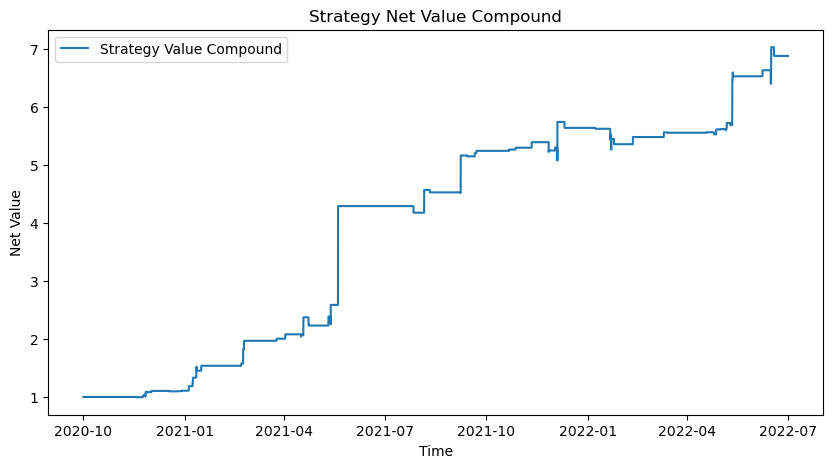

CAGR: 201.12%
Annual Return: 81.97%
Annual Volatility: 36.42%
Sharpe:  2.169


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


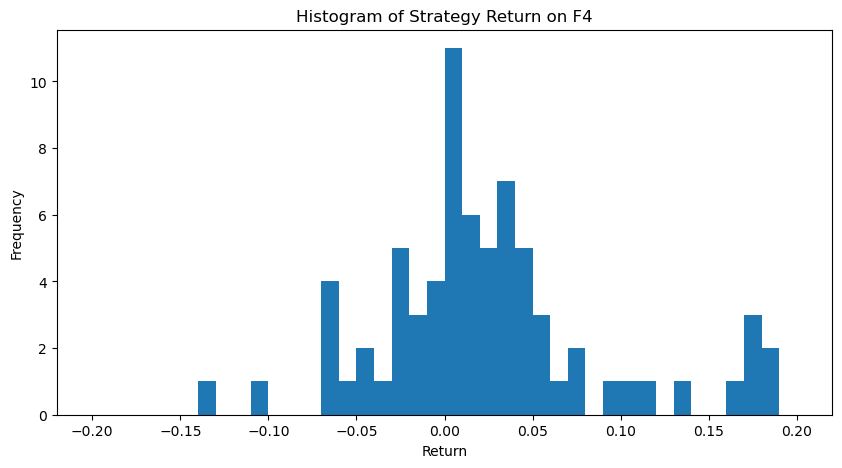

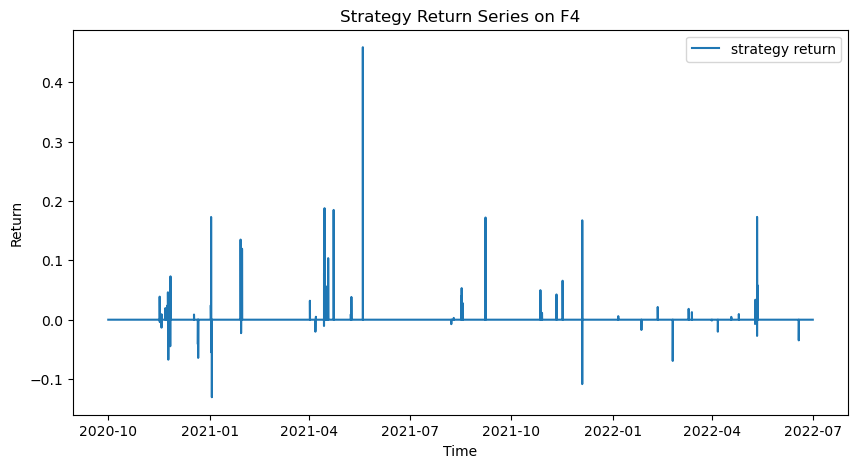

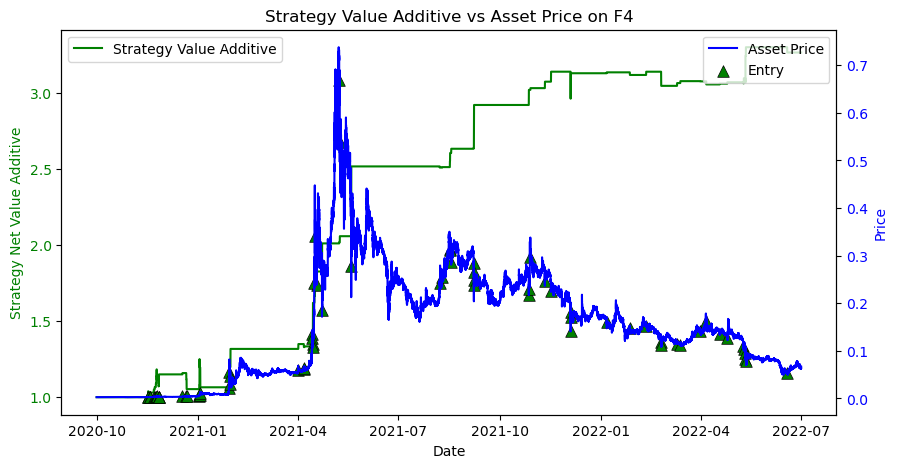

Win Prob: 69.86%
Number of Trades:  73 73
Average Win Return:   0.06131
Average Loss Return: -0.03909
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.1306
Maximum Drawdown: -17.82%
Annualized Return: 89.54%
Annualized Volatility: 46.95%
Sharpe:  1.843


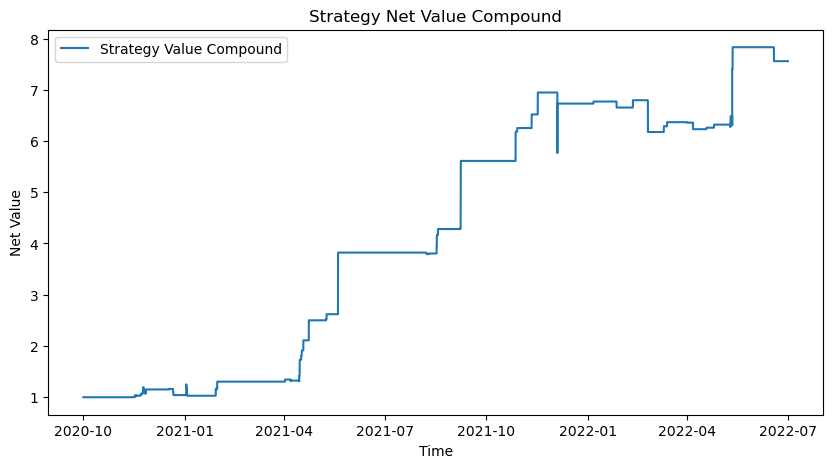

CAGR: 217.65%
Annual Return: 89.54%
Annual Volatility: 46.95%
Sharpe:  1.843


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


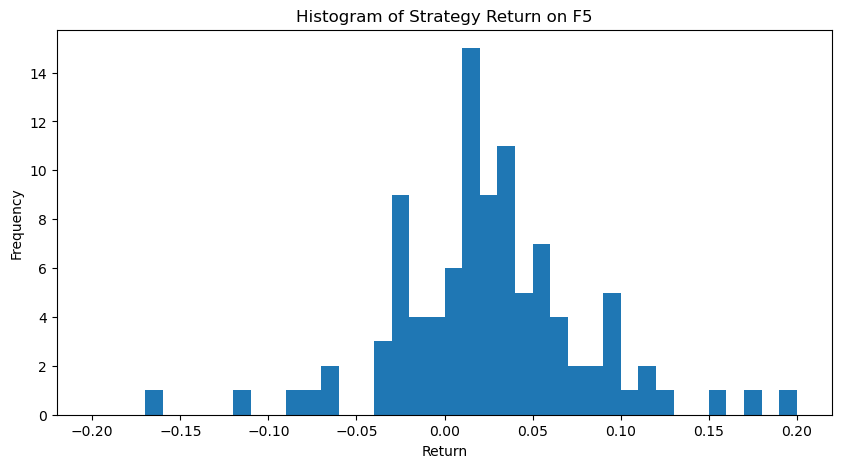

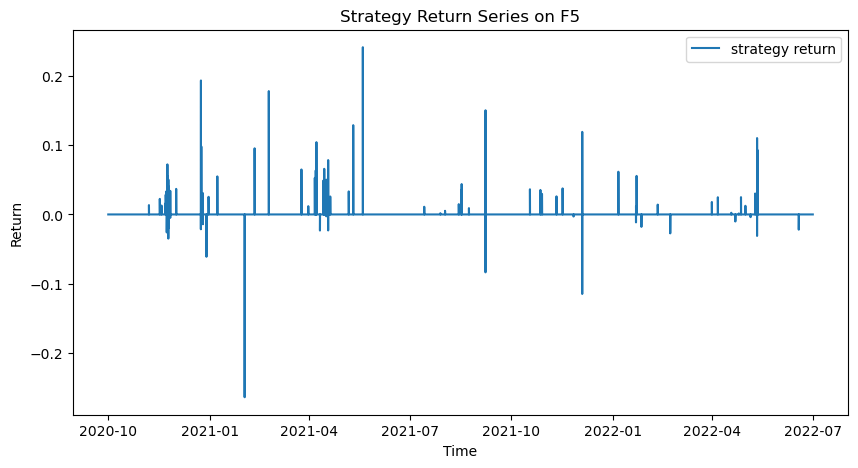

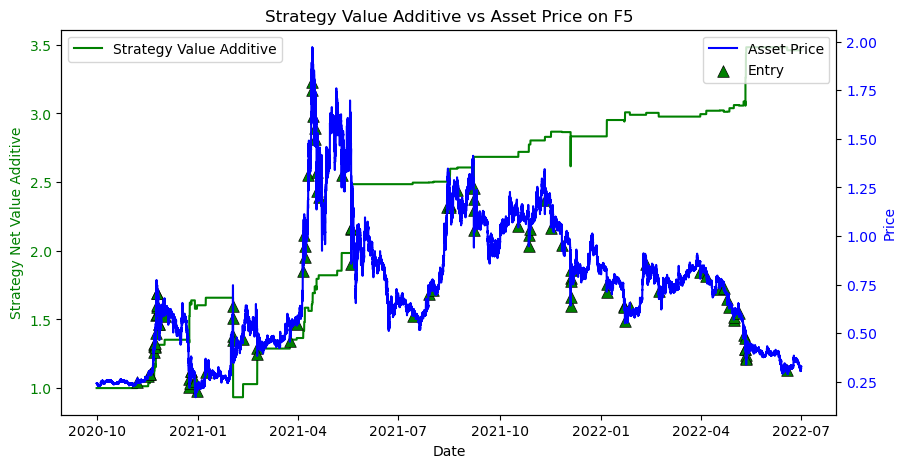

Win Prob: 72.82%
Number of Trades:  103 103
Average Win Return:   0.05242
Average Loss Return: -0.05252
P&L Ratio: 1.0
Maximum Loss of a single trade: -0.264
Maximum Drawdown: -56.16%
Annualized Return: 97.19%
Annualized Volatility: 48.52%
Sharpe:  1.941


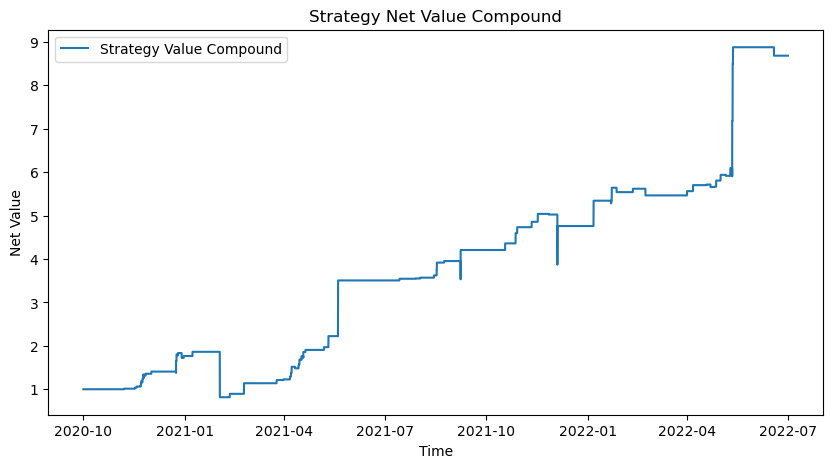

CAGR: 243.82%
Annual Return: 97.19%
Annual Volatility: 48.52%
Sharpe:  1.941


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


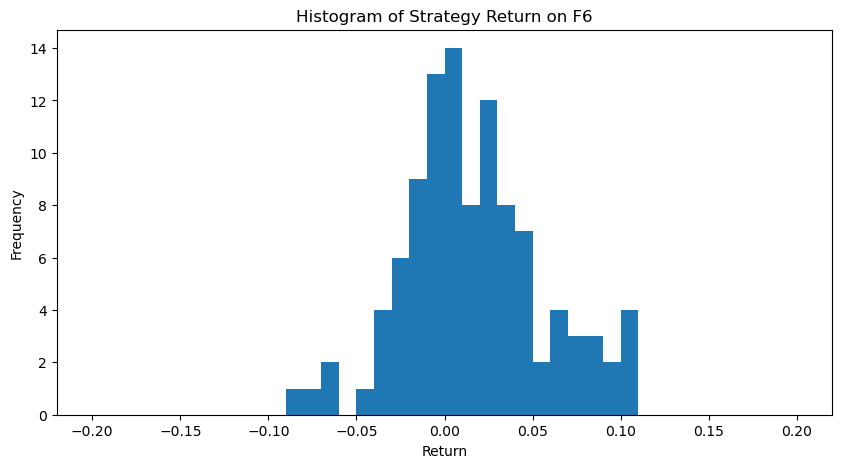

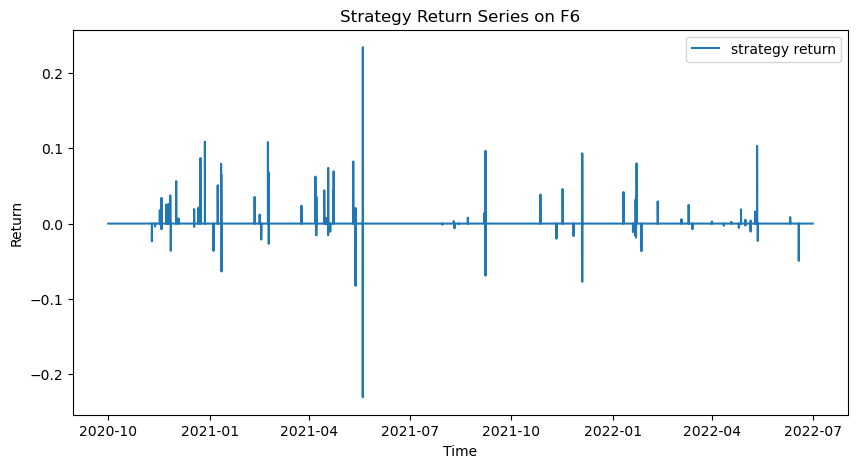

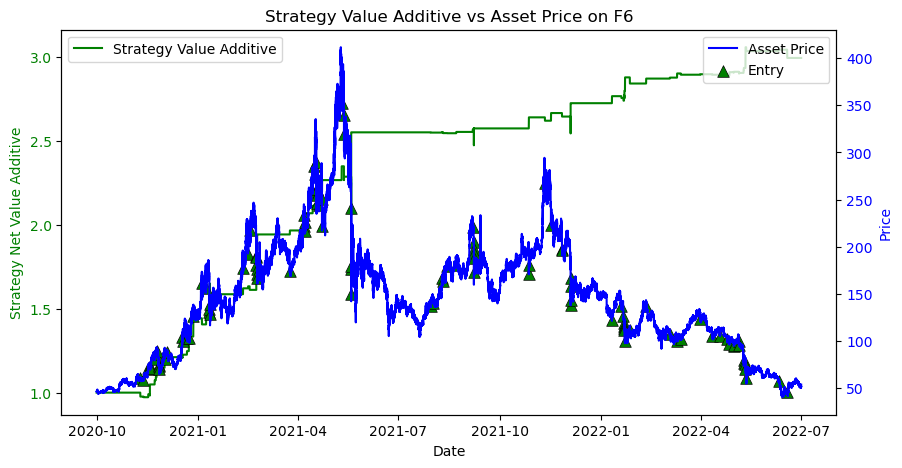

Win Prob: 64.49%
Number of Trades:  107 107
Average Win Return:   0.04385
Average Loss Return: -0.0271
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.2304
Maximum Drawdown: -27.94%
Annualized Return: 78.84%
Annualized Volatility: 37.12%
Sharpe:  2.043


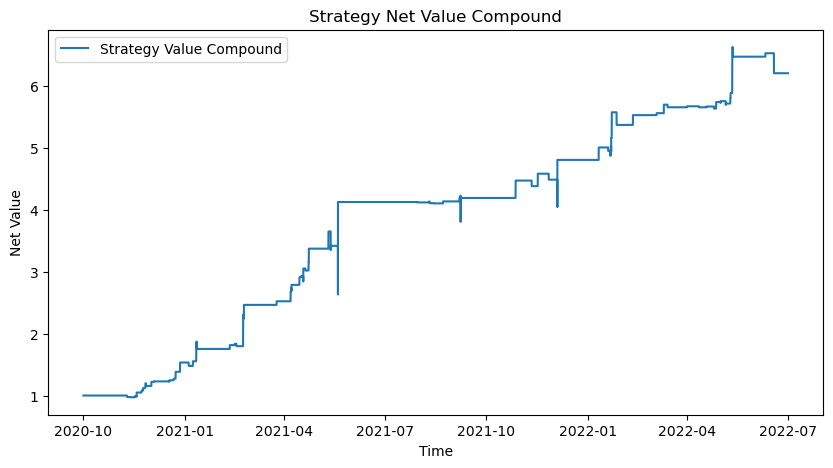

CAGR: 183.94%
Annual Return: 78.84%
Annual Volatility: 37.12%
Sharpe:  2.043


After preprocess the data has 192671 columns.
Preprocess finished
8.4 Trading signal finished


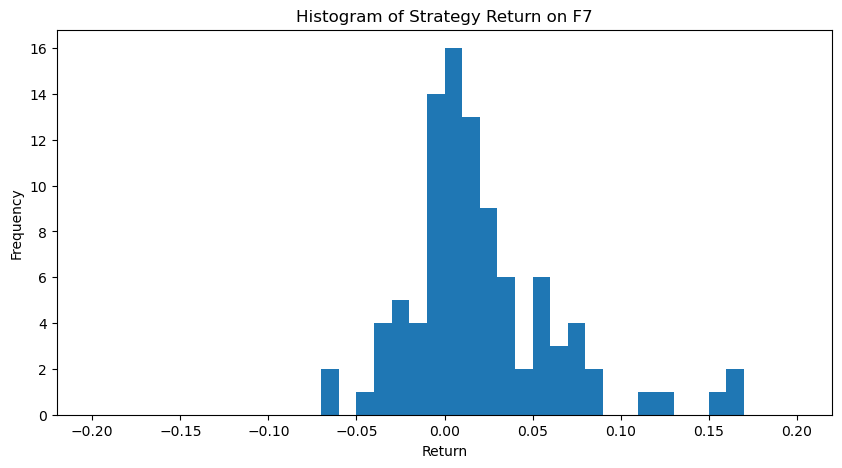

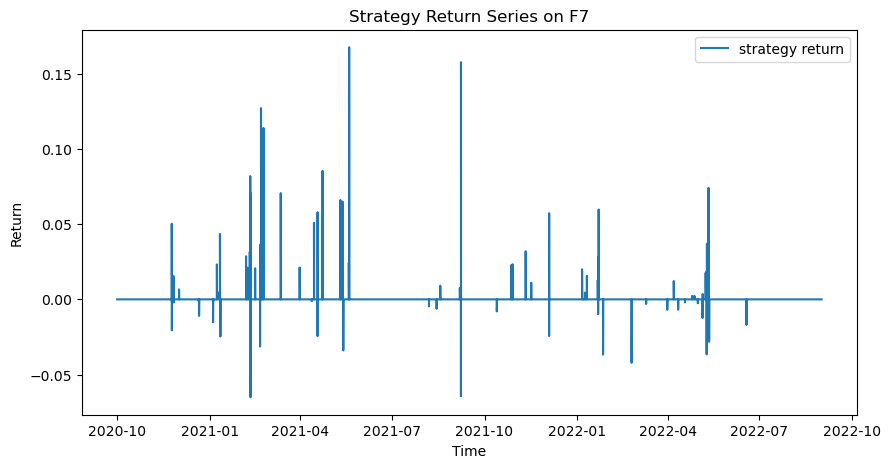

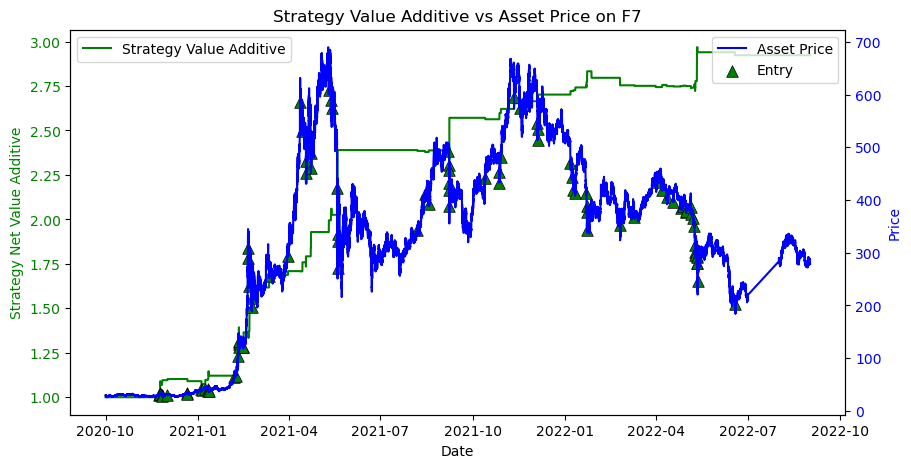

Win Prob: 68.75%
Number of Trades:  96 96
Average Win Return:   0.03738
Average Loss Return: -0.01813
P&L Ratio: 2.1
Maximum Loss of a single trade: -0.06504
Maximum Drawdown: -10.75%
Annualized Return: 72.44%
Annualized Volatility: 28.34%
Sharpe:  2.45


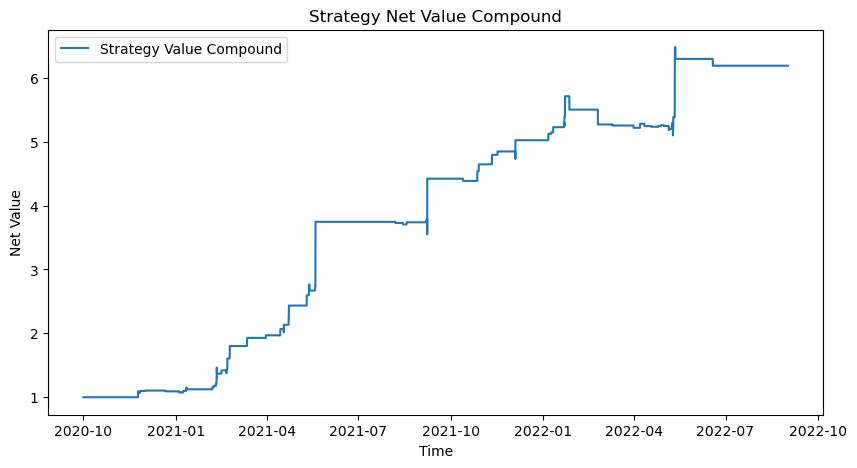

CAGR: 183.37%
Annual Return: 72.44%
Annual Volatility: 28.34%
Sharpe:  2.45


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


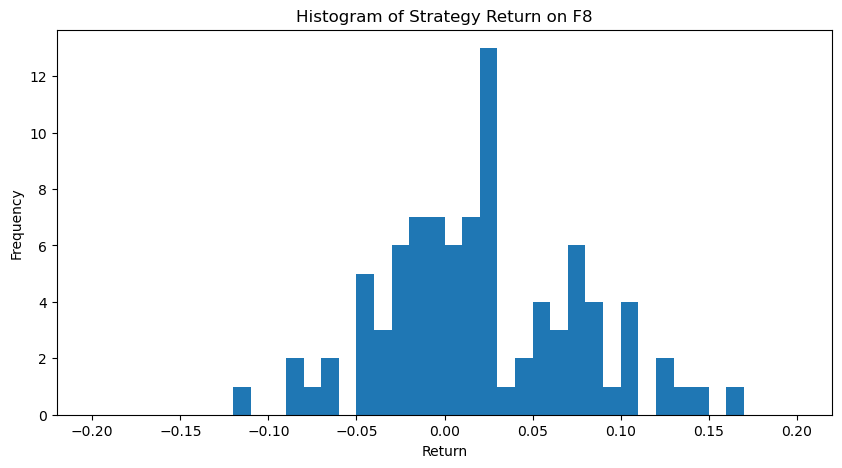

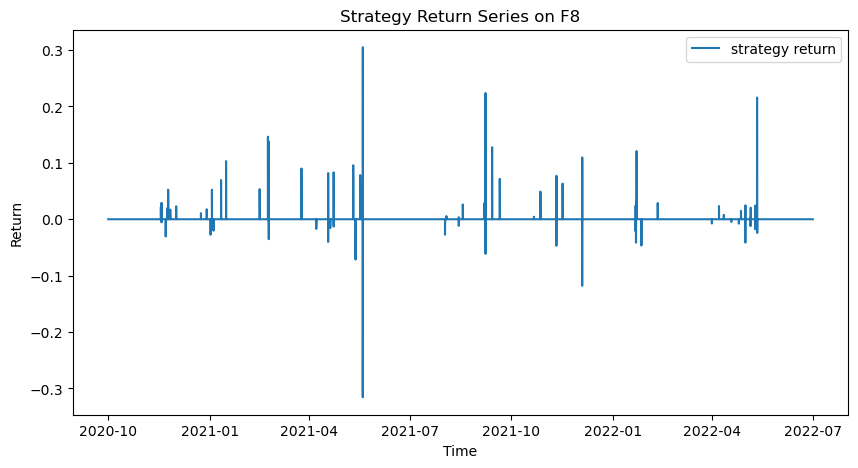

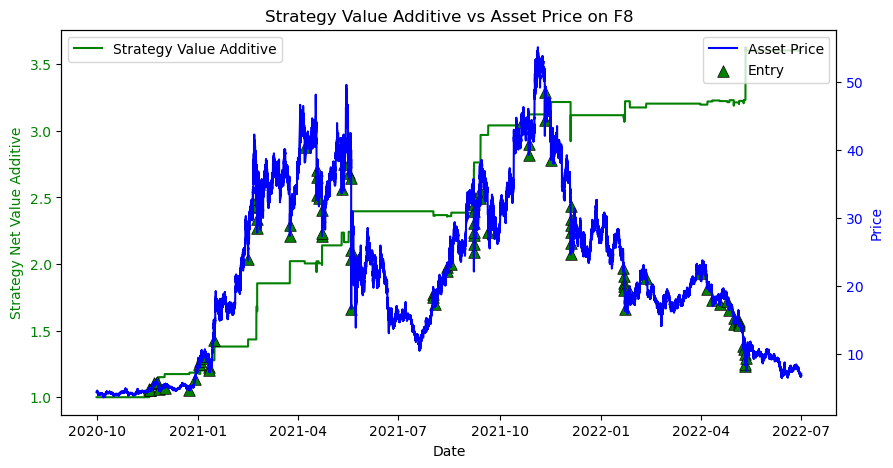

Win Prob: 63.16%
Number of Trades:  95 95
Average Win Return:   0.06661
Average Loss Return: -0.03979
P&L Ratio: 1.7
Maximum Loss of a single trade: -0.3157
Maximum Drawdown: -37.13%
Annualized Return: 102.85%
Annualized Volatility: 51.10%
Sharpe:  1.954


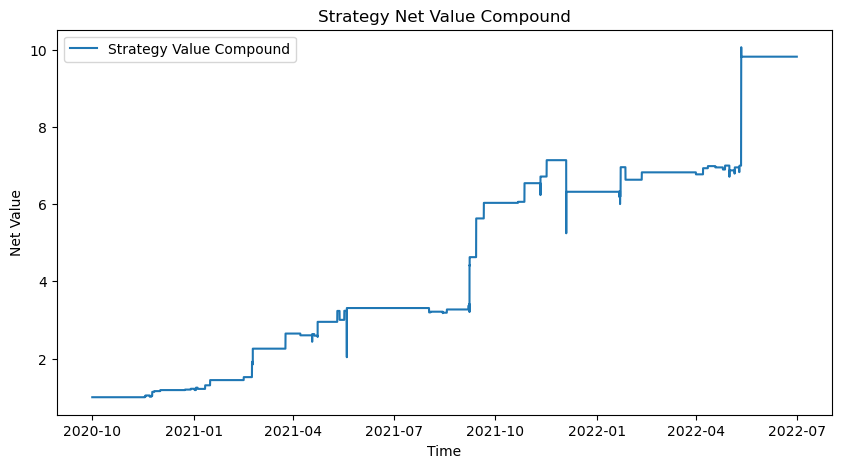

CAGR: 268.83%
Annual Return: 102.85%
Annual Volatility: 51.10%
Sharpe:  1.954


After preprocess the data has 175103 columns.
Preprocess finished
8.4 Trading signal finished


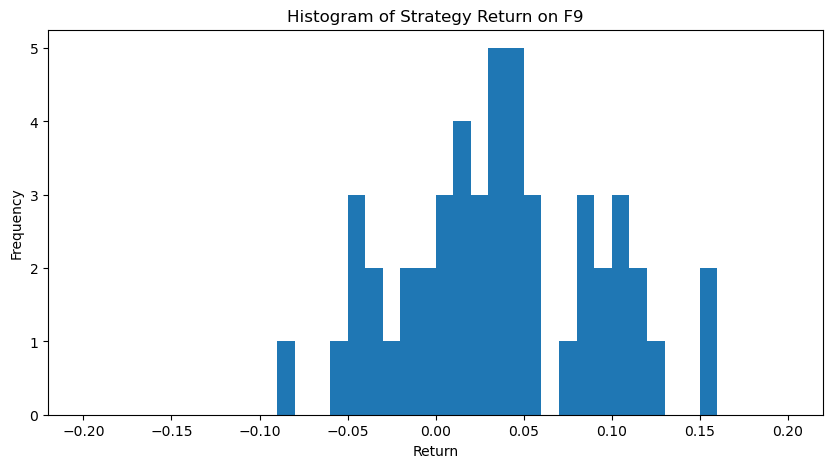

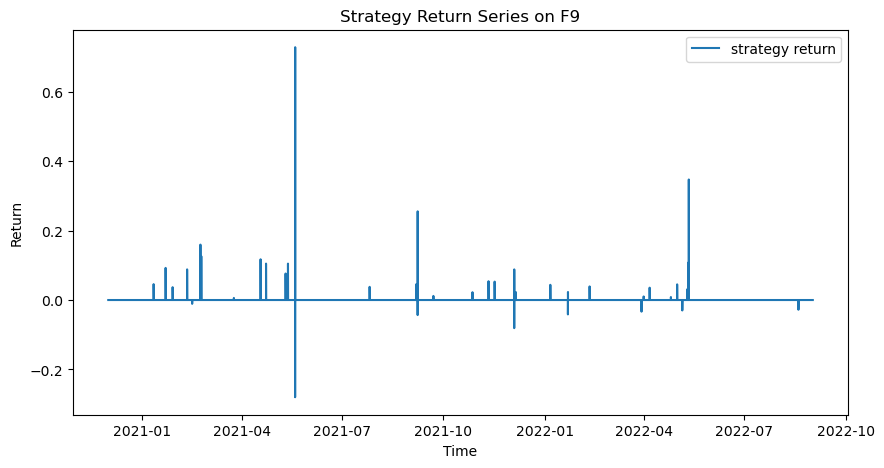

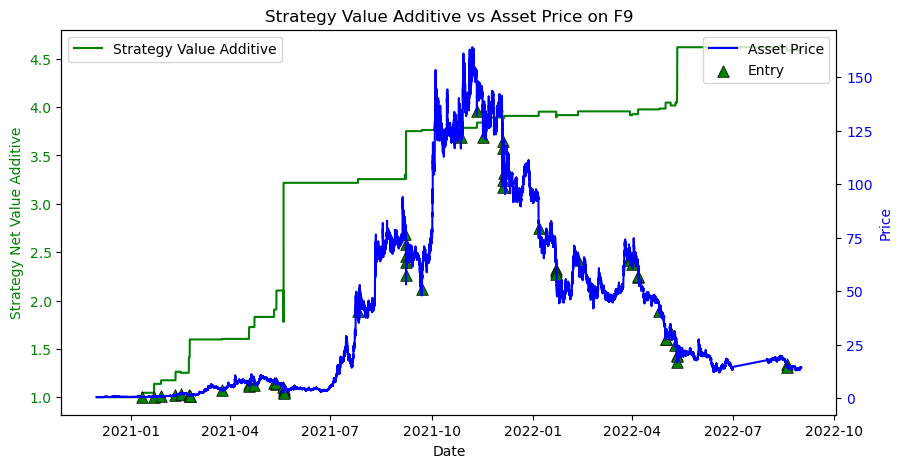

Win Prob: 76.36%
Number of Trades:  55 55
Average Win Return:   0.1016
Average Loss Return: -0.05229
P&L Ratio: 1.9
Maximum Loss of a single trade: -0.28
Maximum Drawdown: -31.26%
Annualized Return: 148.63%
Annualized Volatility: 72.43%
Sharpe:  2.011


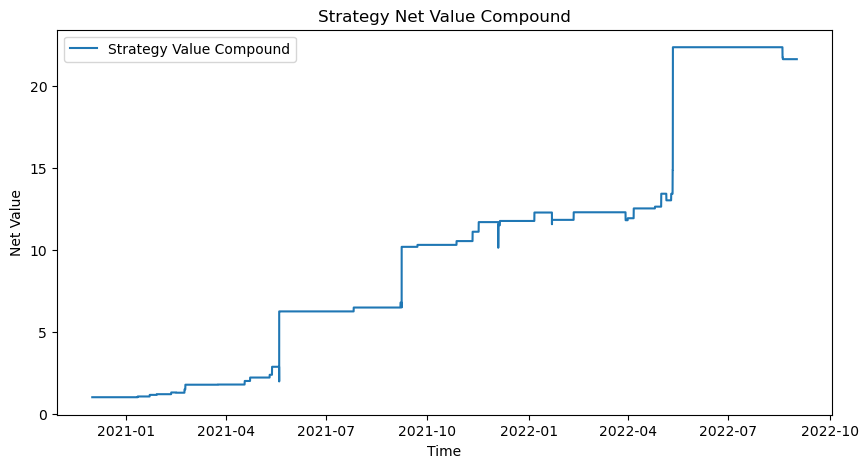

CAGR: 479.11%
Annual Return: 148.63%
Annual Volatility: 72.43%
Sharpe:  2.011


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


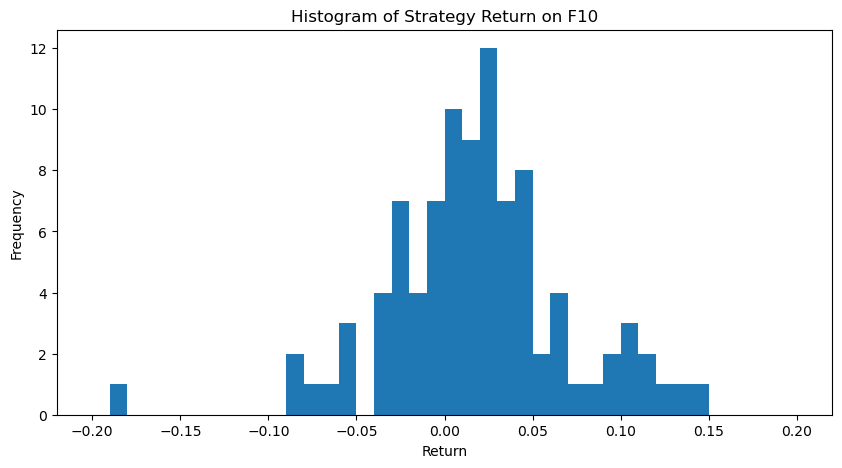

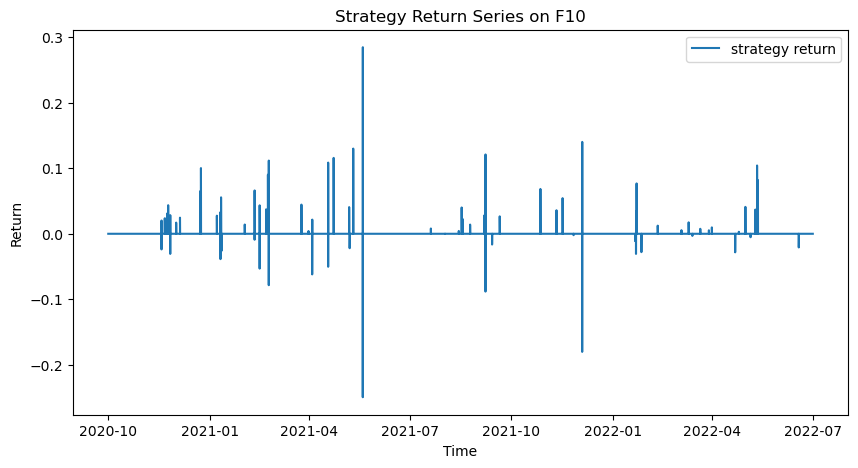

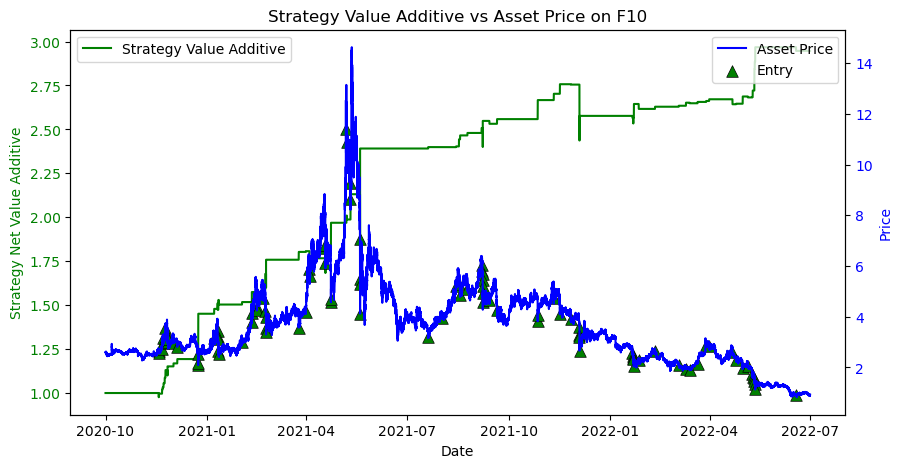

Win Prob: 68.04%
Number of Trades:  97 97
Average Win Return:   0.04891
Average Loss Return: -0.04134
P&L Ratio: 1.2
Maximum Loss of a single trade: -0.2495
Maximum Drawdown: -29.12%
Annualized Return: 76.89%
Annualized Volatility: 42.92%
Sharpe:  1.722


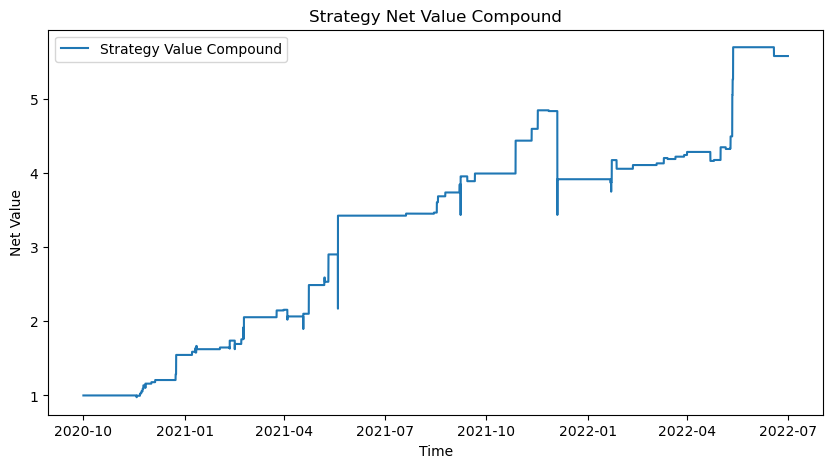

CAGR: 167.11%
Annual Return: 76.89%
Annual Volatility: 42.92%
Sharpe:  1.722


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


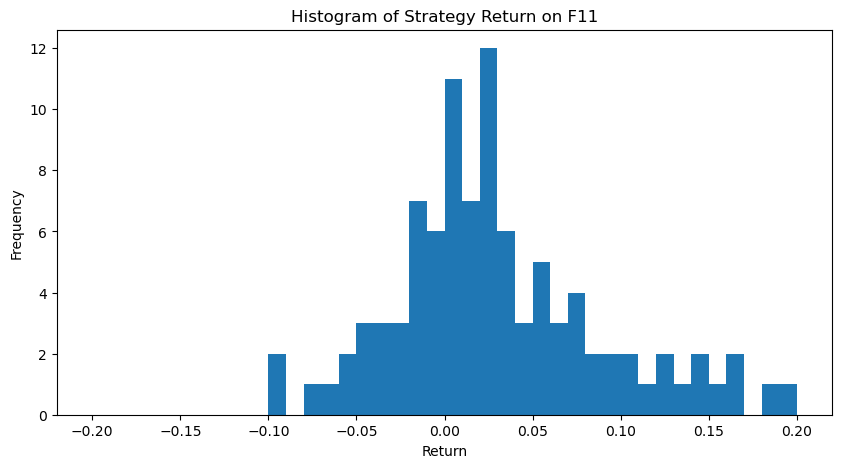

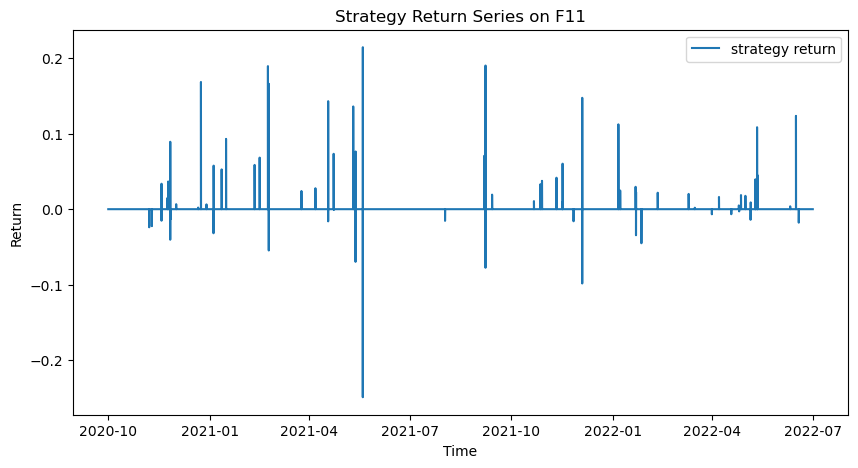

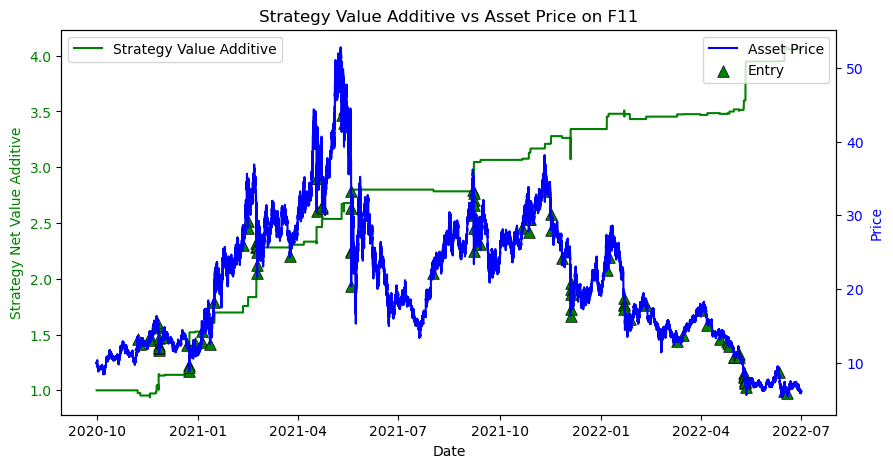

Win Prob: 70.71%
Number of Trades:  99 99
Average Win Return:   0.06004
Average Loss Return: -0.03947
P&L Ratio: 1.5
Maximum Loss of a single trade: -0.2489
Maximum Drawdown: -32.19%
Annualized Return: 120.79%
Annualized Volatility: 47.89%
Sharpe:  2.459


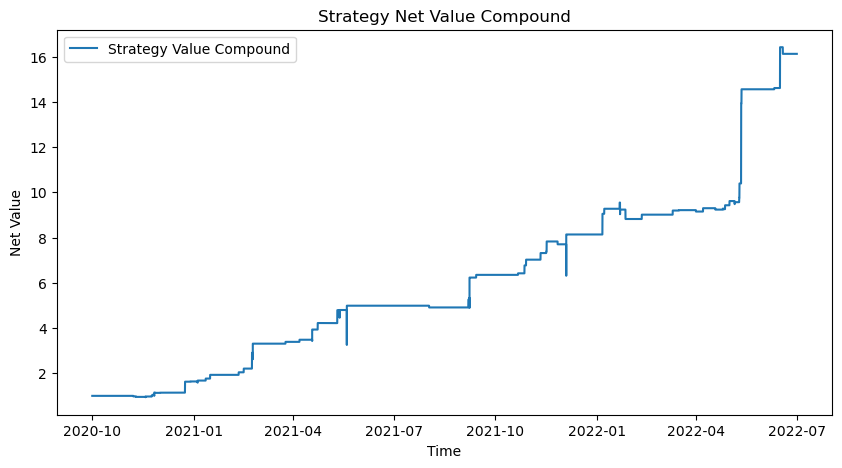

CAGR: 389.81%
Annual Return: 120.79%
Annual Volatility: 47.89%
Sharpe:  2.459


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


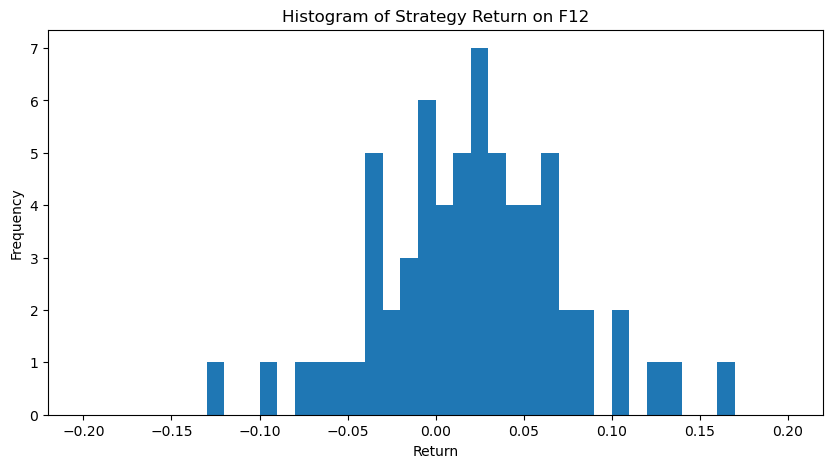

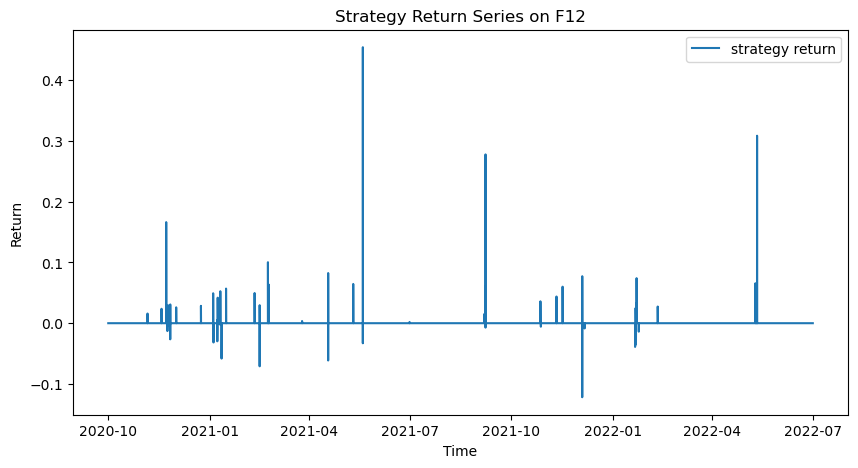

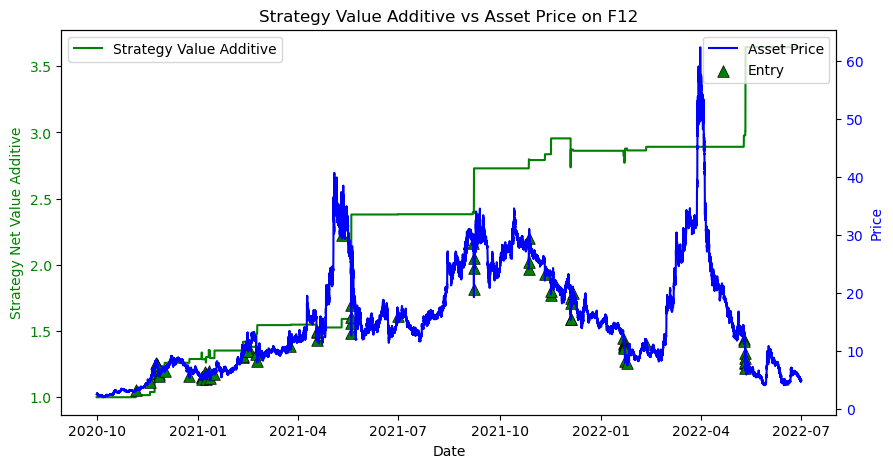

Win Prob: 68.12%
Number of Trades:  69 69
Average Win Return:   0.07252
Average Loss Return: -0.03476
P&L Ratio: 2.1
Maximum Loss of a single trade: -0.1219
Maximum Drawdown: -20.72%
Annualized Return: 104.43%
Annualized Volatility: 50.50%
Sharpe:  2.009


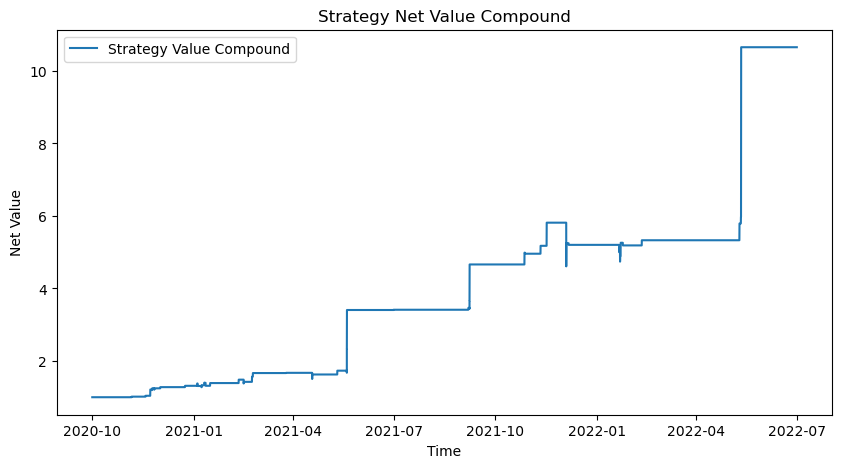

CAGR: 286.47%
Annual Return: 104.43%
Annual Volatility: 50.50%
Sharpe:  2.009


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


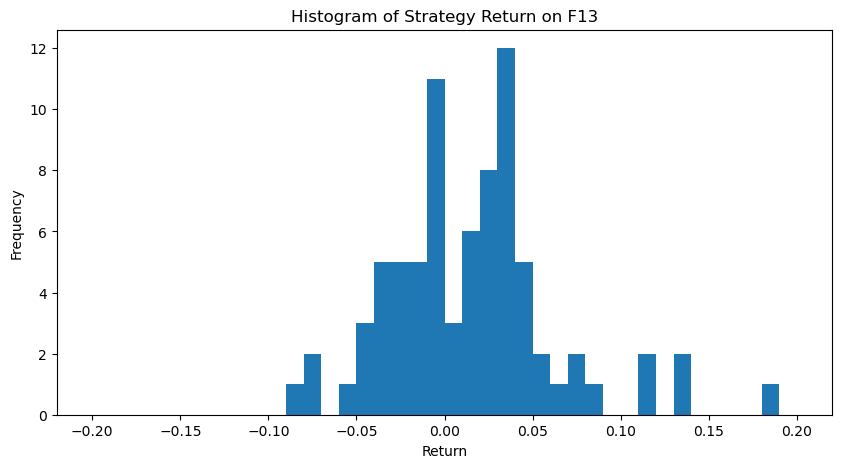

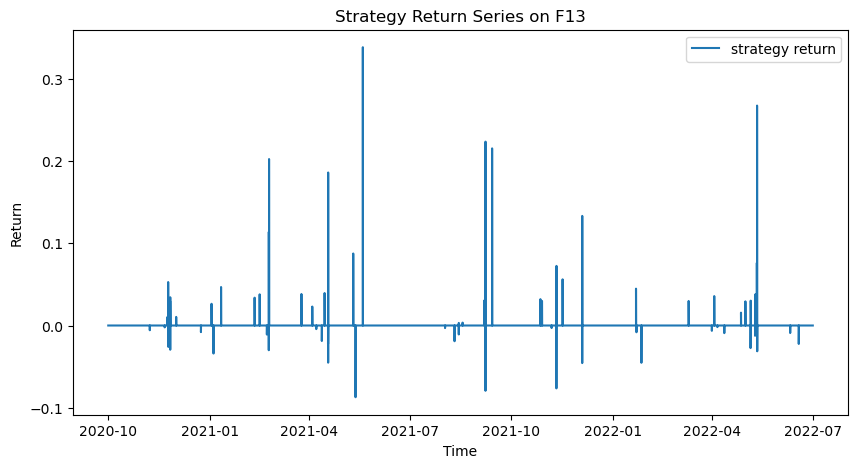

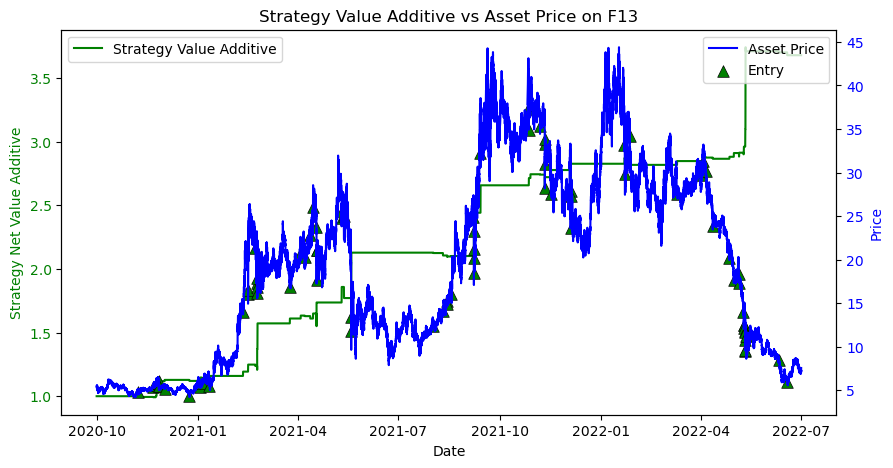

Win Prob: 60.71%
Number of Trades:  84 84
Average Win Return:   0.06954
Average Loss Return: -0.02628
P&L Ratio: 2.6
Maximum Loss of a single trade: -0.08724
Maximum Drawdown: -13.45%
Annualized Return: 105.82%
Annualized Volatility: 47.89%
Sharpe:  2.147


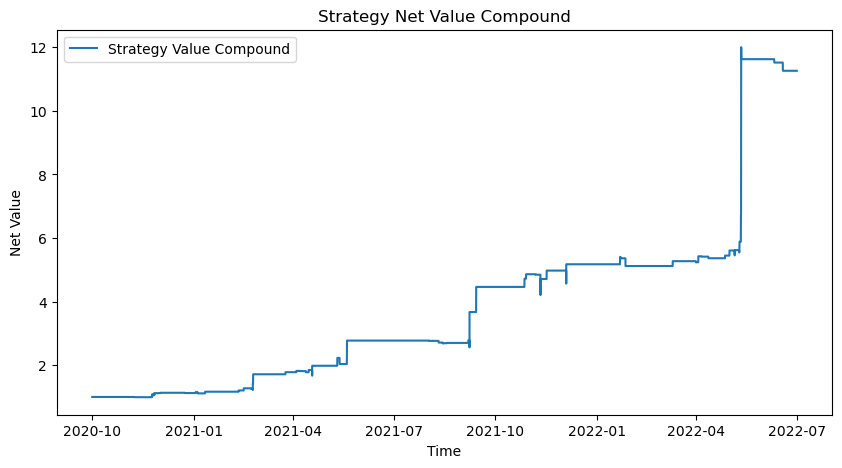

CAGR: 298.96%
Annual Return: 105.82%
Annual Volatility: 47.89%
Sharpe:  2.147


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


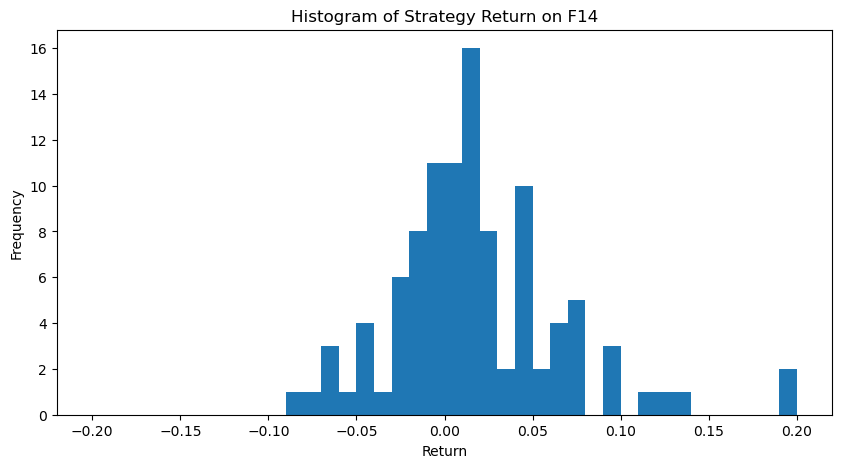

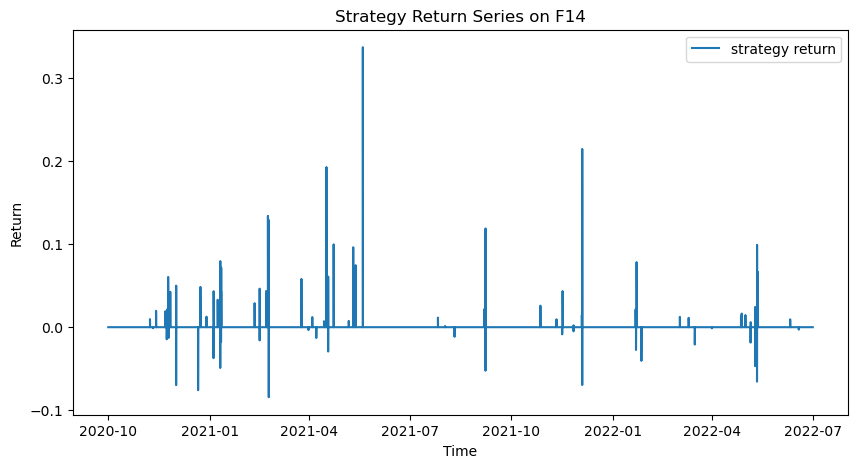

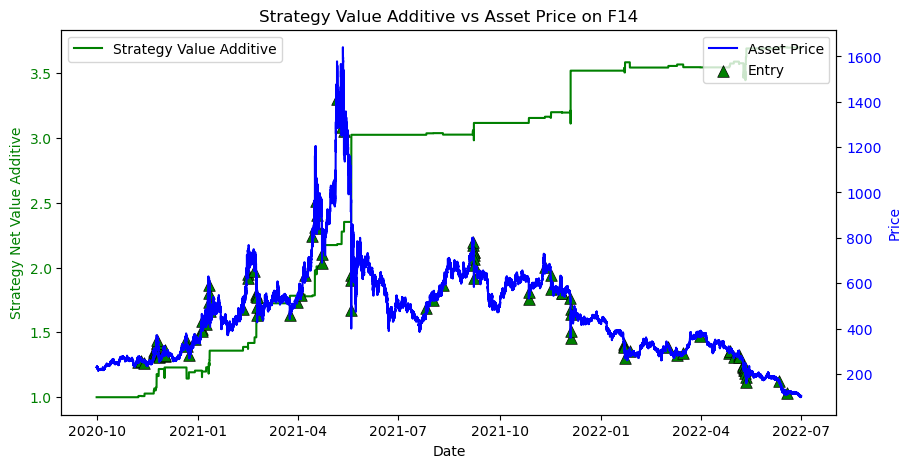

Win Prob: 65.71%
Number of Trades:  105 105
Average Win Return:   0.05291
Average Loss Return: -0.02654
P&L Ratio: 2.0
Maximum Loss of a single trade: -0.0843
Maximum Drawdown: -13.79%
Annualized Return: 106.46%
Annualized Volatility: 45.33%
Sharpe:  2.282


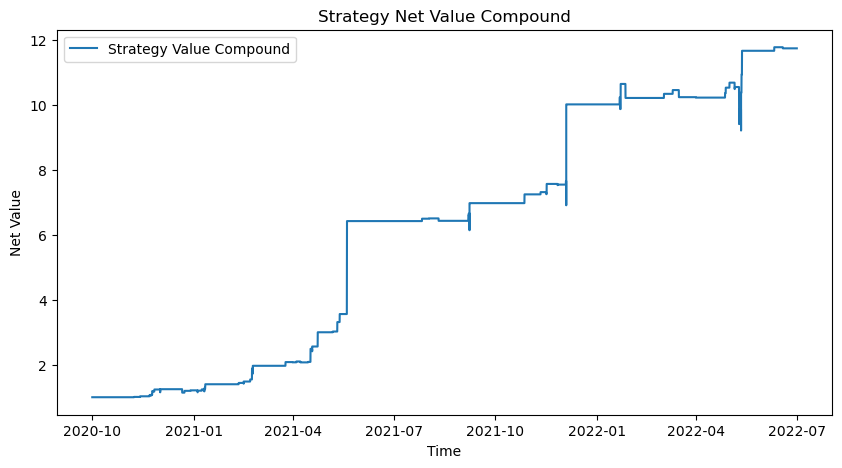

CAGR: 308.32%
Annual Return: 106.46%
Annual Volatility: 45.33%
Sharpe:  2.282


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


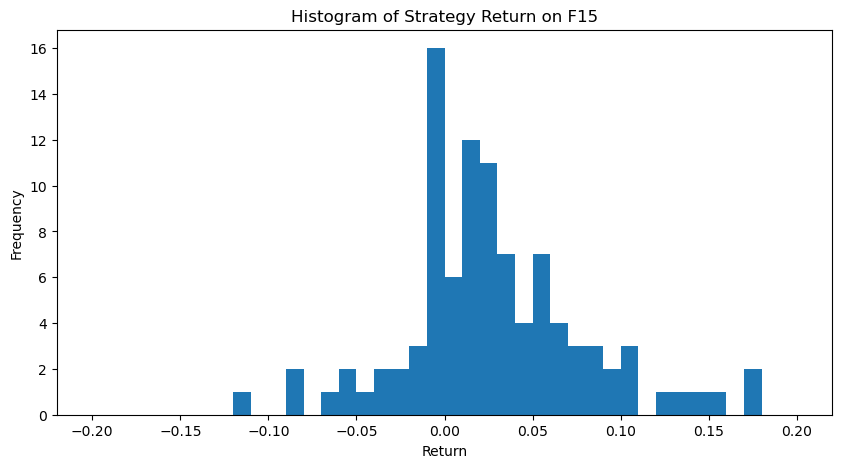

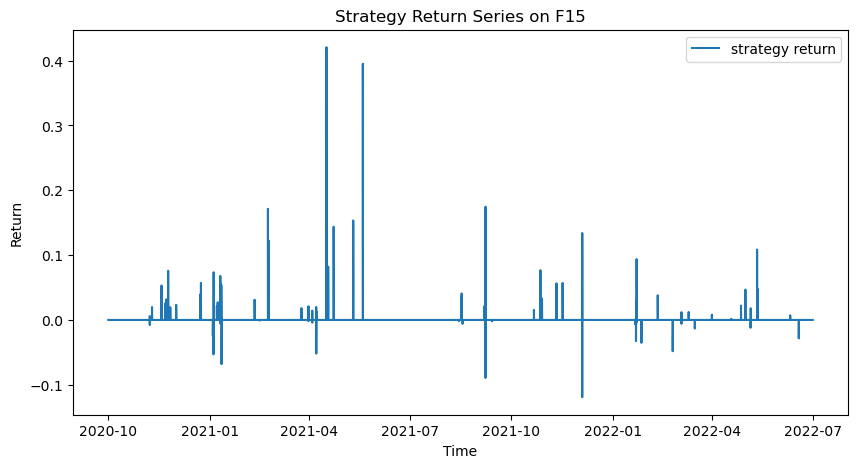

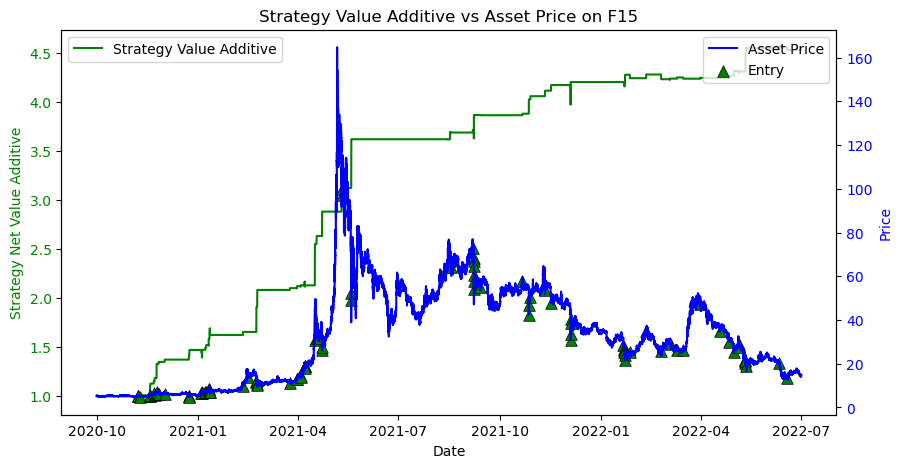

Win Prob: 70.00%
Number of Trades:  100 100
Average Win Return:   0.0609
Average Loss Return: -0.02446
P&L Ratio: 2.5
Maximum Loss of a single trade: -0.1192
Maximum Drawdown: -19.05%
Annualized Return: 139.39%
Annualized Volatility: 51.48%
Sharpe:  2.649


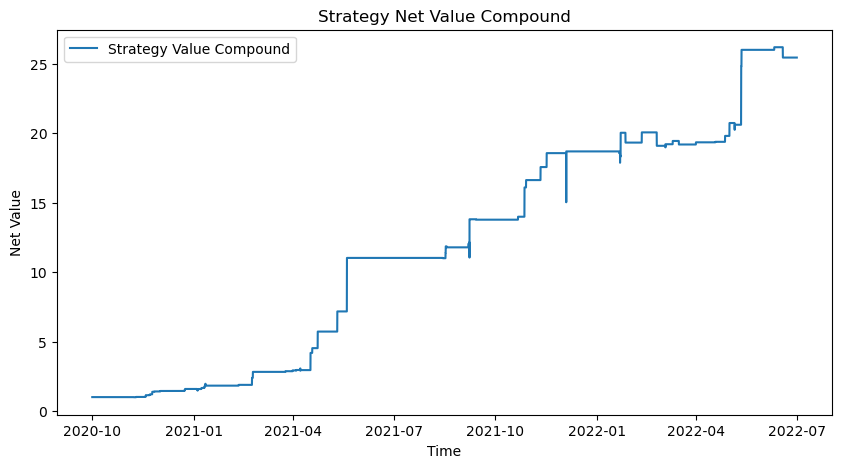

CAGR: 535.81%
Annual Return: 139.39%
Annual Volatility: 51.48%
Sharpe:  2.649


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


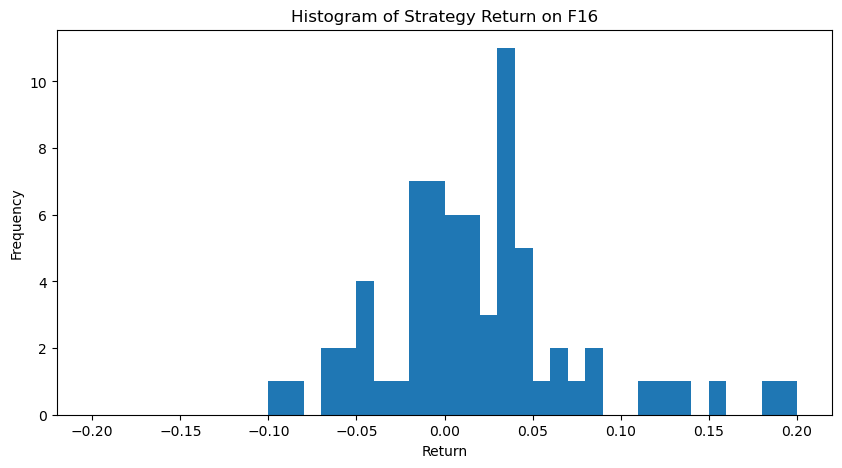

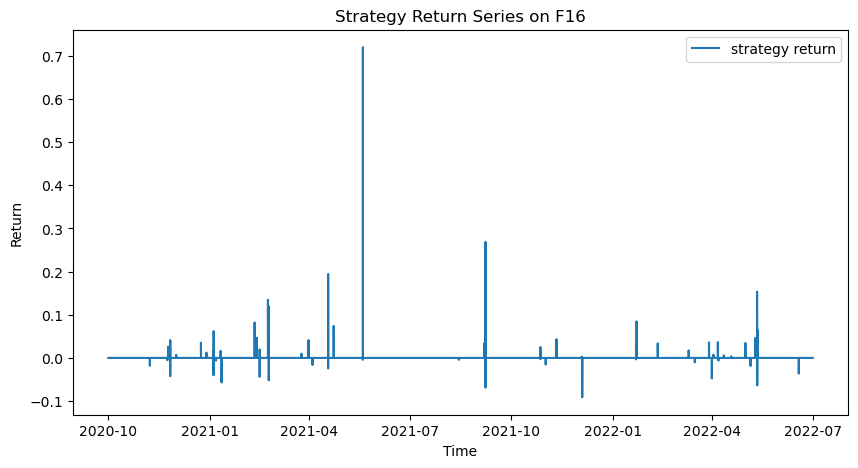

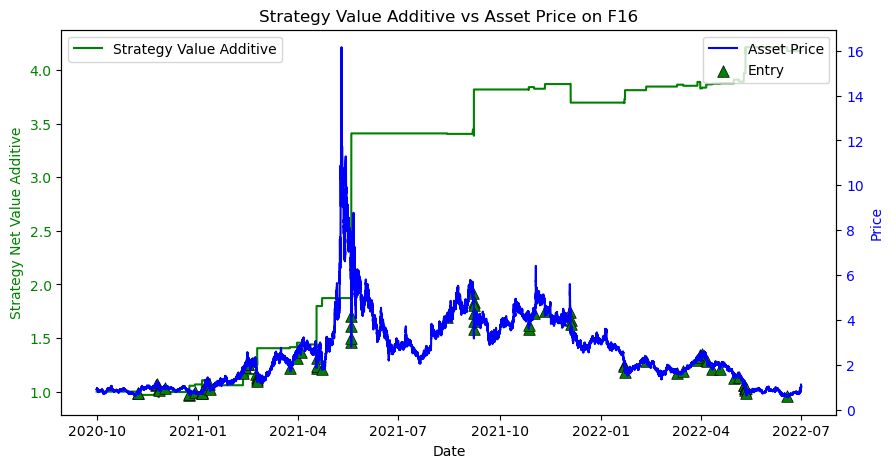

Win Prob: 64.38%
Number of Trades:  73 73
Average Win Return:   0.0844
Average Loss Return: -0.03037
P&L Ratio: 2.8
Maximum Loss of a single trade: -0.09105
Maximum Drawdown: -17.10%
Annualized Return: 125.50%
Annualized Volatility: 69.36%
Sharpe:  1.766


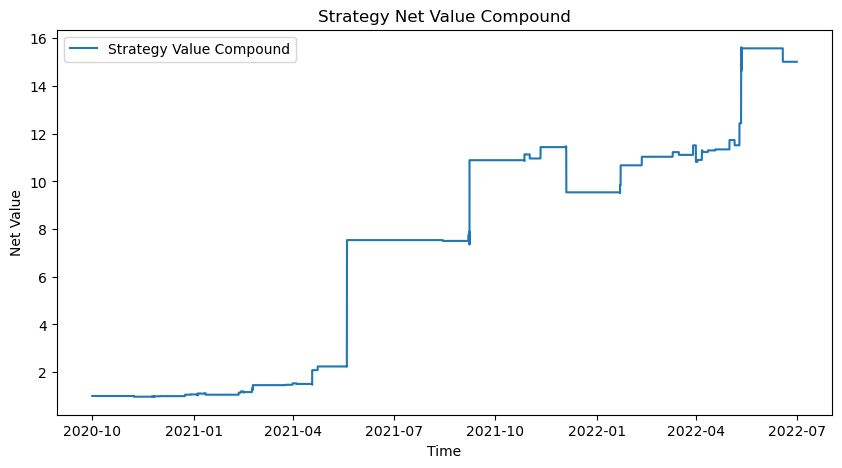

CAGR: 370.26%
Annual Return: 125.50%
Annual Volatility: 69.36%
Sharpe:  1.766


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


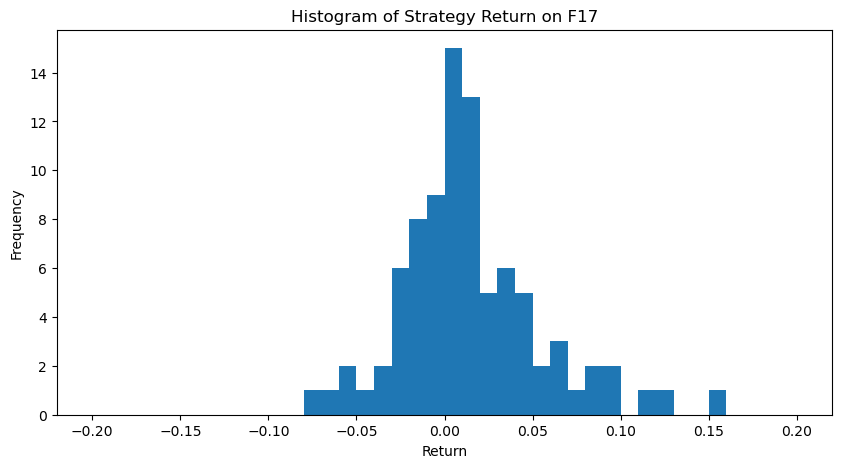

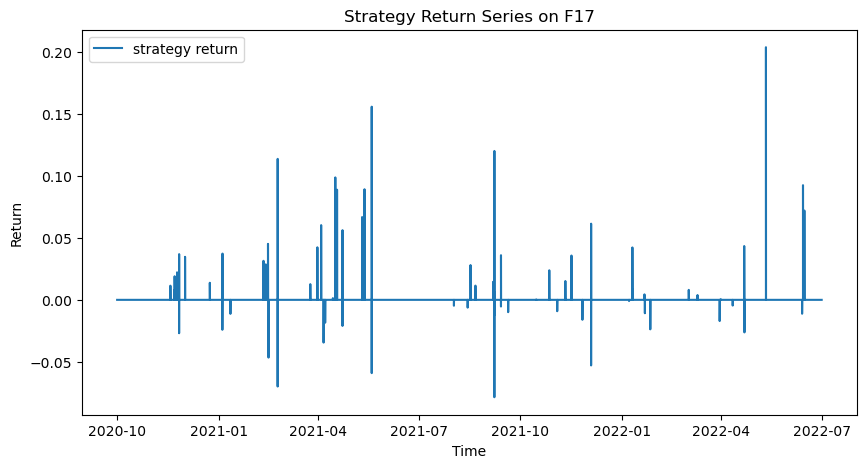

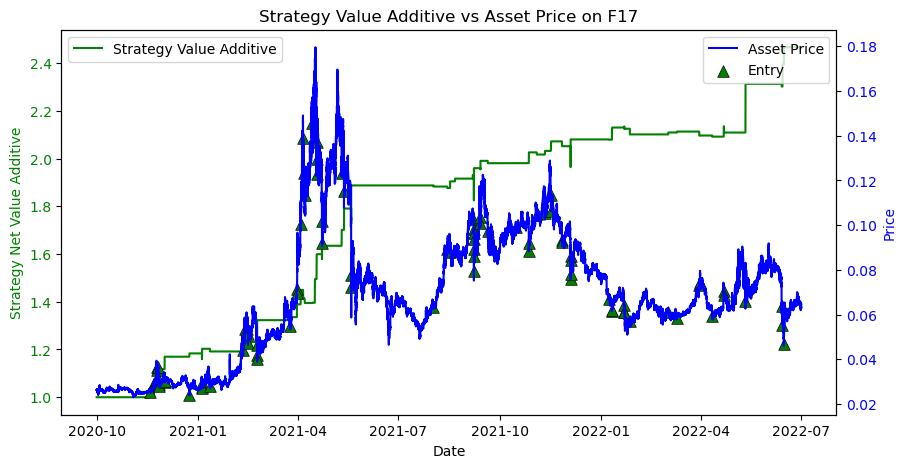

Win Prob: 65.91%
Number of Trades:  88 88
Average Win Return:   0.03708
Average Loss Return: -0.0228
P&L Ratio: 1.6
Maximum Loss of a single trade: -0.07864
Maximum Drawdown: -13.00%
Annualized Return: 57.93%
Annualized Volatility: 28.24%
Sharpe:  1.945


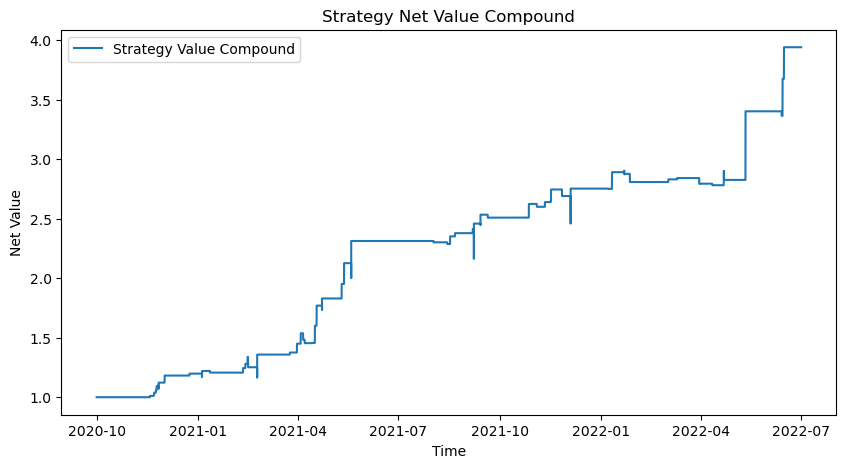

CAGR: 118.95%
Annual Return: 57.93%
Annual Volatility: 28.24%
Sharpe:  1.945


After preprocess the data has 183744 columns.
Preprocess finished
8.4 Trading signal finished


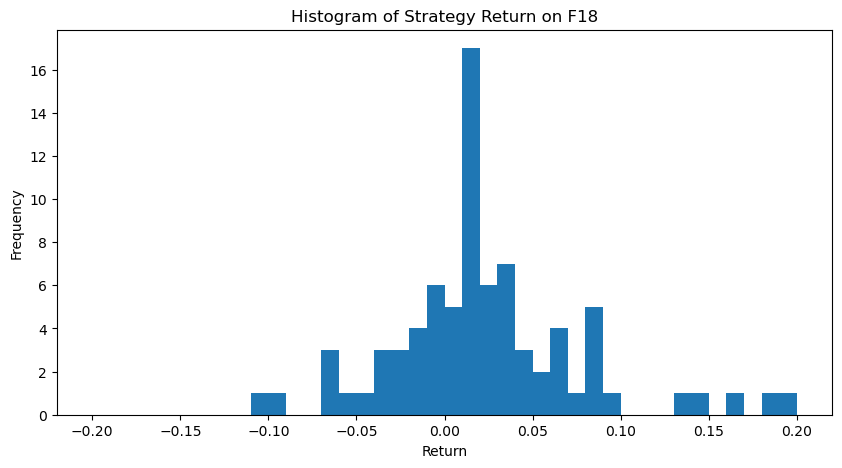

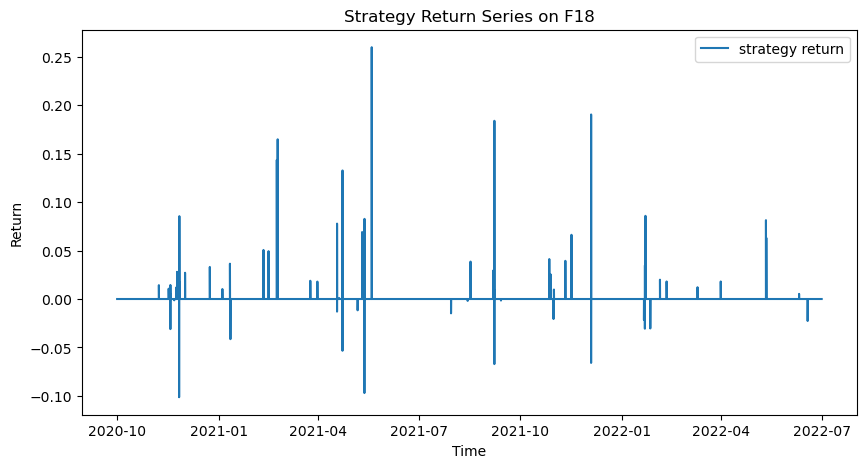

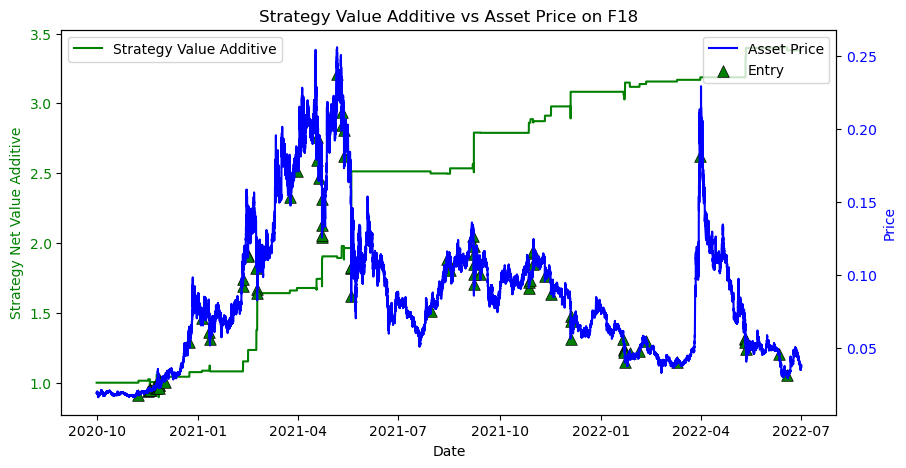

Win Prob: 71.60%
Number of Trades:  81 81
Average Win Return:   0.05348
Average Loss Return: -0.03141
P&L Ratio: 1.7
Maximum Loss of a single trade: -0.1014
Maximum Drawdown: -15.57%
Annualized Return: 93.98%
Annualized Volatility: 39.61%
Sharpe:  2.297


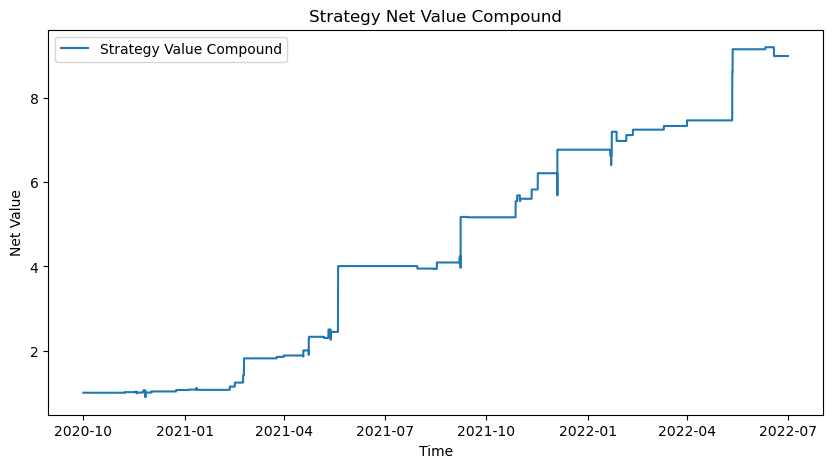

CAGR: 250.94%
Annual Return: 93.98%
Annual Volatility: 39.61%
Sharpe:  2.297




In [315]:
# strategy 8.4 use avg price as buy and sell price
strategy8_4_list = []
profit_des_8_4 = pd.DataFrame()
tbv_des_8_4 = pd.DataFrame()
tbv_tv_des_8_4 = pd.DataFrame()
tbv_pct_des_8_4 = pd.DataFrame()
ma_des_8_4 = pd.DataFrame()
for idx in range(len(data_list)):
    name = 'F'+str(idx+1)
    stra8_4 = CTAStrategy(data_list[idx],'open_time','signal','close',120,5,name)
    stra8_4.data_preprocess()
    stra8_4.find_signal_8_4(10000,0.1,1)
    stra8_4.get_strategy_returns(1/1000)
    stra8_4.plot_hist_seires(abs_range=0.2)
    stra8_4.plot_cumsum_profits()
    stra8_4.get_win_prob()
    profit_des = stra8_4.get_avg_win_return()
    stra8_4.get_maximum_drawdown()
    stra8_4.get_sharpe()
    stra8_4.plot_cumprod_value()
    tbv_des, tbv_tv_des, tbv_pct_des = stra8_4.taker_buy_volume_stats()
    ma_des = stra8_4.moving_average_stats()
    strategy8_4_list.append(stra8_4)
    if (profit_des_8_4.empty):
        profit_des_8_4 = profit_des
        tbv_des_8_4 = tbv_des
        tbv_tv_des_8_4 = tbv_tv_des
        tbv_pct_des_8_4 = tbv_pct_des
        ma_des_8_4 = ma_des
    else:
        profit_des_8_4 = profit_des_8_4.join(profit_des)
        tbv_des_8_4 = tbv_des_8_4.join(tbv_des)
        tbv_tv_des_8_4 =tbv_tv_des_8_4.join(tbv_tv_des)
        tbv_pct_des_8_4 = tbv_pct_des_8_4.join(tbv_pct_des)
        ma_des_8_4 = ma_des_8_4.join(ma_des)
    print('\n')

## Overall Statistics

In [317]:
# calculate average win rate, average profit loss ratio, average sharpe
win_rate4 = []
pnl_ratio4 = []
sharpe4 = []
for ele in strategy8_4_list:
    win_rate4.append(ele.win_prob)
    pnl_ratio4.append(ele.pnl_ratio)
    sharpe4.append(ele.sharpe)
print(f"Average Win Rate: {np.mean(win_rate4):.2f}")
print(f"Average P&L Ratio: {np.mean(pnl_ratio4):.2f}")
print(f"Average Sharpe: {np.mean(sharpe4):.2f}")

Average Win Rate: 0.67
Average P&L Ratio: 1.93
Average Sharpe: 2.10


## Below are old version

Preprocess finished
8.4 Trading signal finished


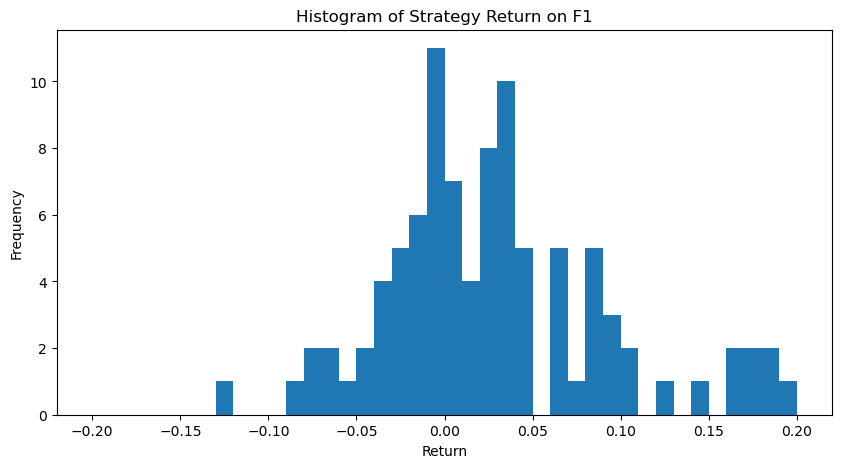

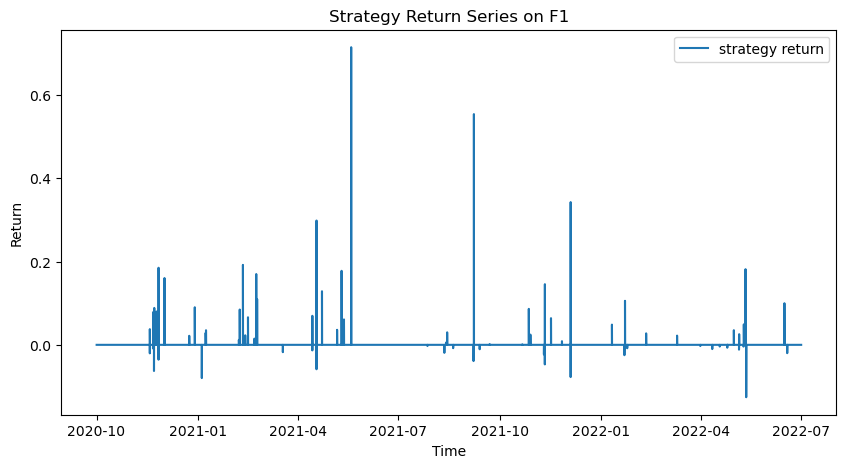

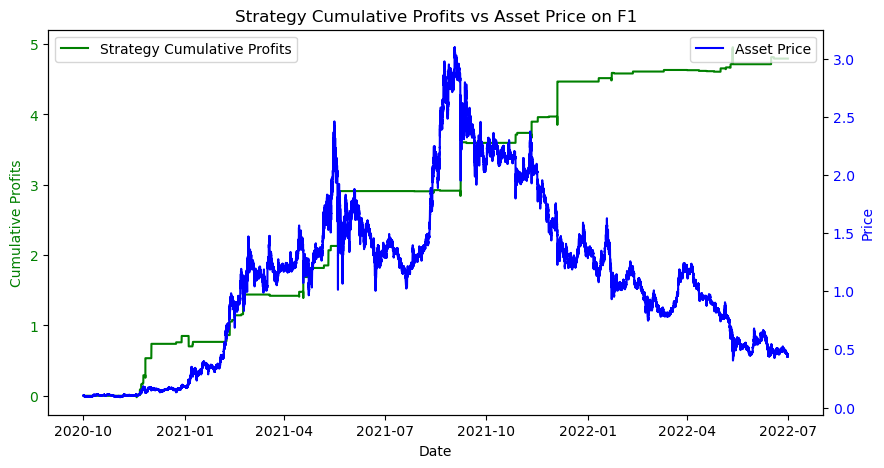

Win Prob: 64.65%
Number of Trades:  99 99
Average Win Return:   0.0912
Average Loss Return: -0.02981
P&L Ratio: 3.1
Maximum Loss of a single trade: -0.1259
Maximum Drawdown: -8.00%
Annual Return: 189.39%
Annual Volatility: 77.97%
Sharpe:  2.429


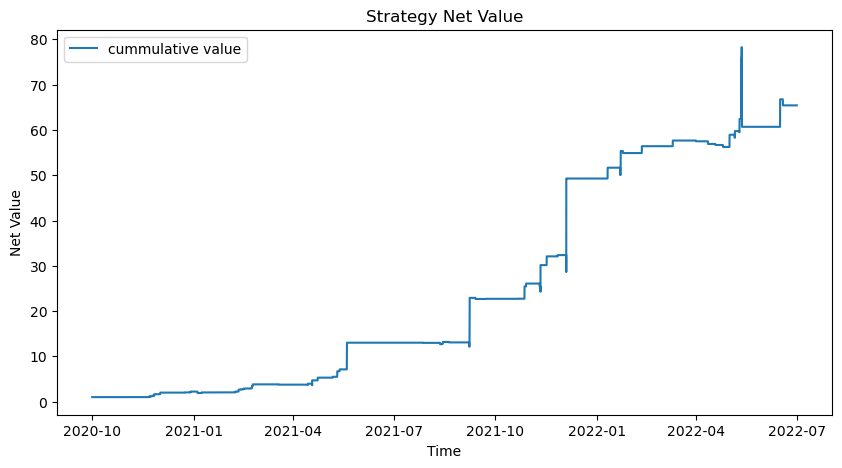

Annual Return: 990.38%
Annual Volatility: 77.96%
Sharpe:  12.7


Preprocess finished
8.4 Trading signal finished


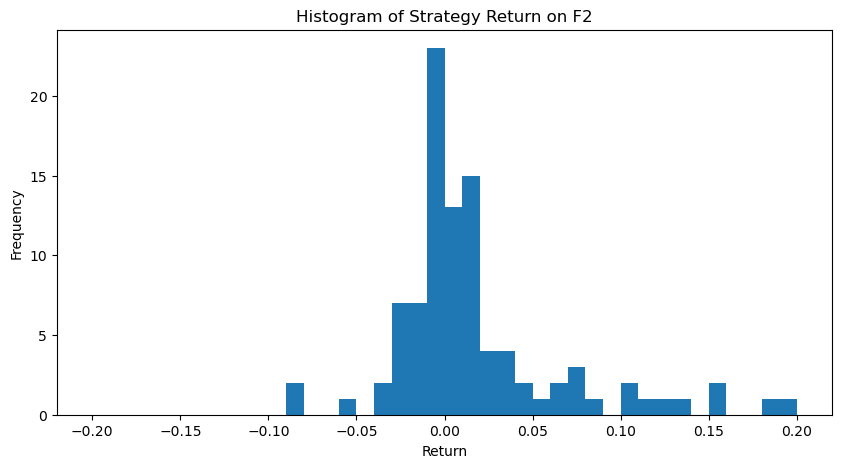

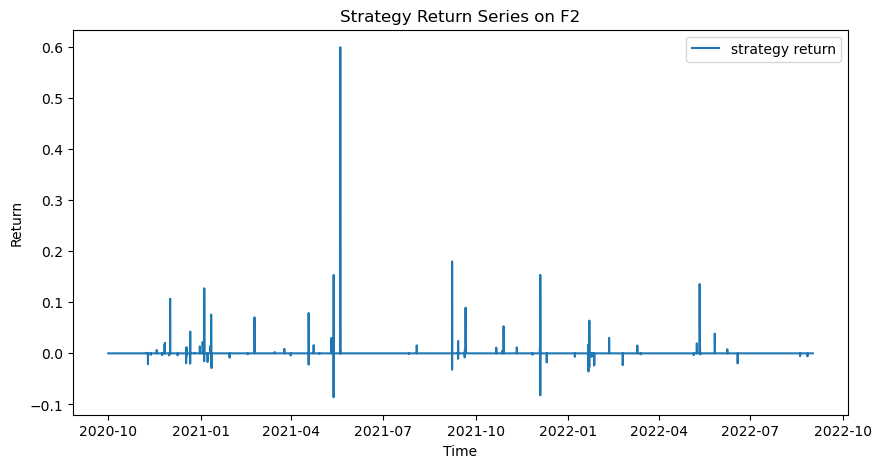

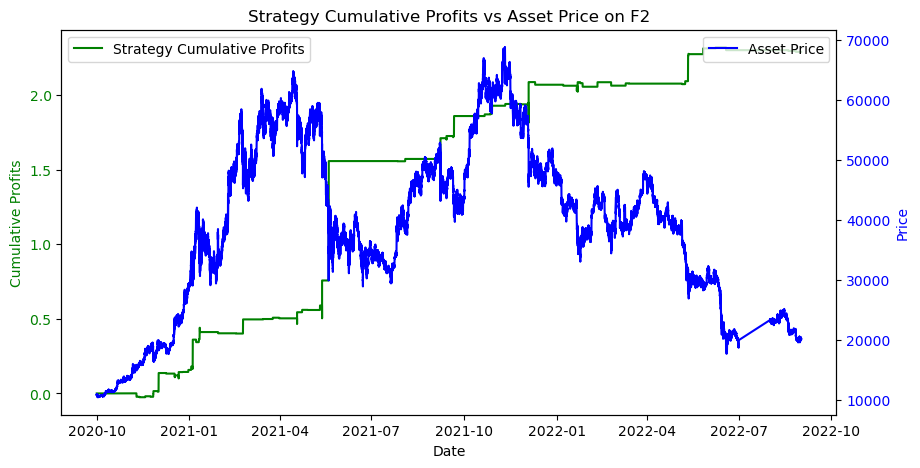

Win Prob: 56.70%
Number of Trades:  97 97
Average Win Return:   0.05376
Average Loss Return: -0.01589
P&L Ratio: 3.4
Maximum Loss of a single trade: -0.08591
Maximum Drawdown: -5.41%
Annual Return: 86.26%
Annual Volatility: 48.50%
Sharpe:  1.779


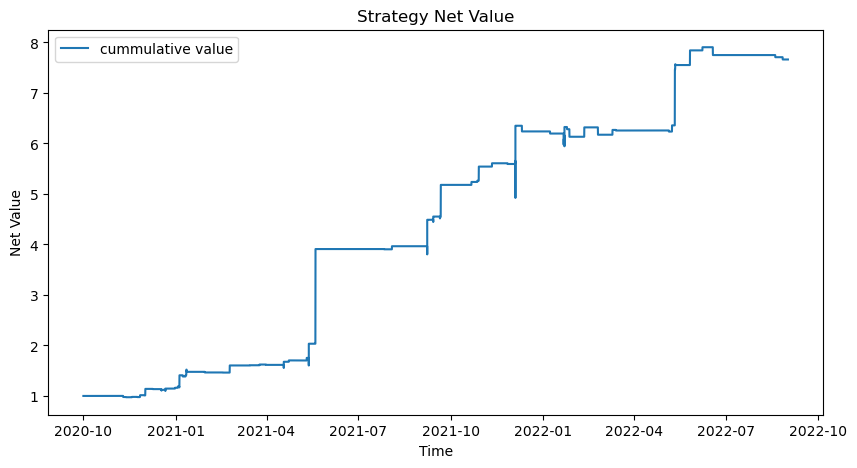

Annual Return: 220.15%
Annual Volatility: 48.49%
Sharpe:  4.54


Preprocess finished
8.4 Trading signal finished


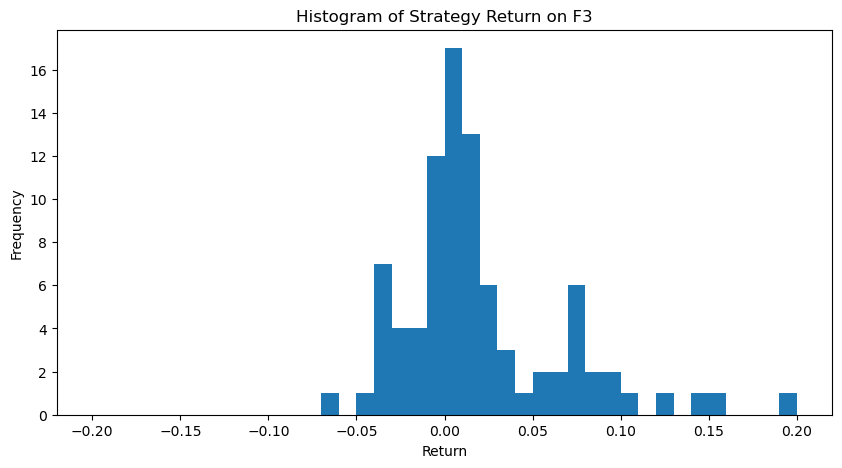

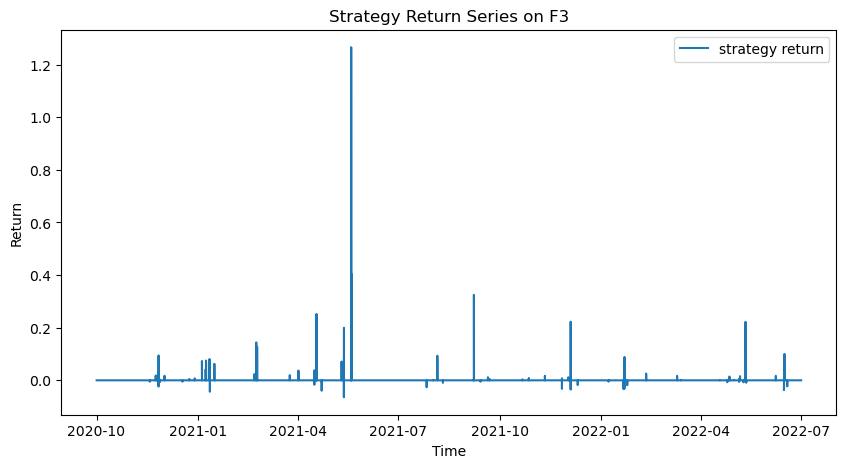

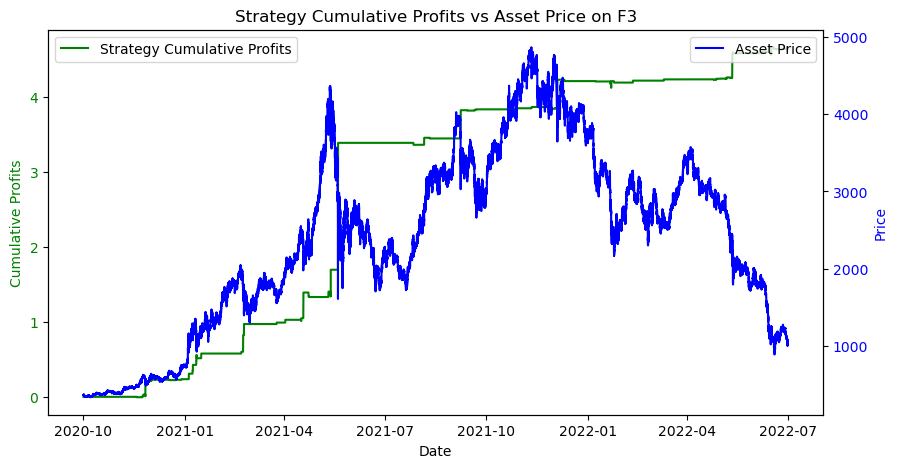

Win Prob: 69.47%
Number of Trades:  95 95
Average Win Return:   0.07932
Average Loss Return: -0.02035
P&L Ratio: 3.9
Maximum Loss of a single trade: -0.06423
Maximum Drawdown: -2.78%
Annual Return: 183.51%
Annual Volatility: 95.43%
Sharpe:  1.923


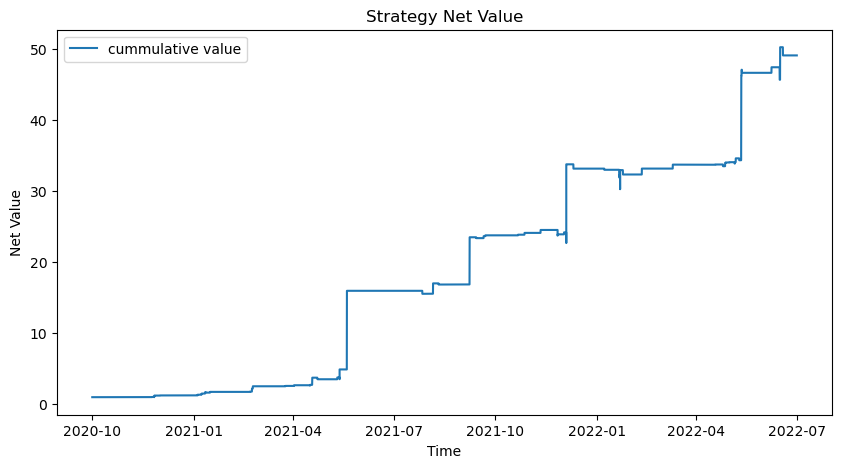

Annual Return: 824.94%
Annual Volatility: 95.42%
Sharpe:  8.645


Preprocess finished
8.4 Trading signal finished


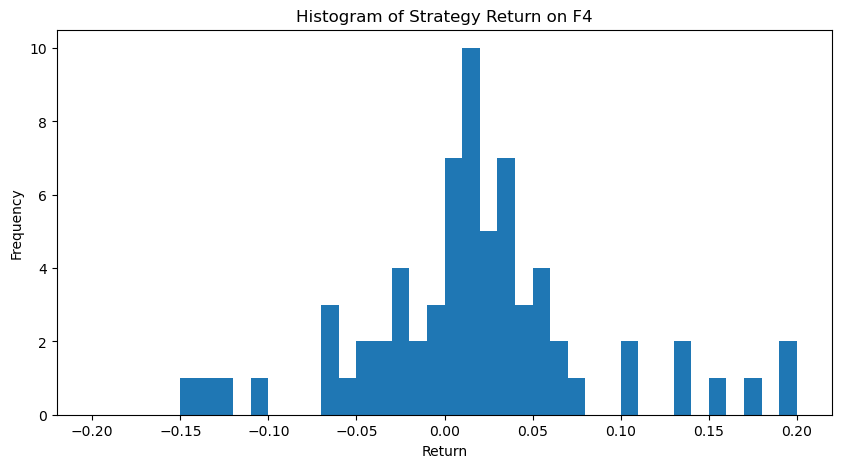

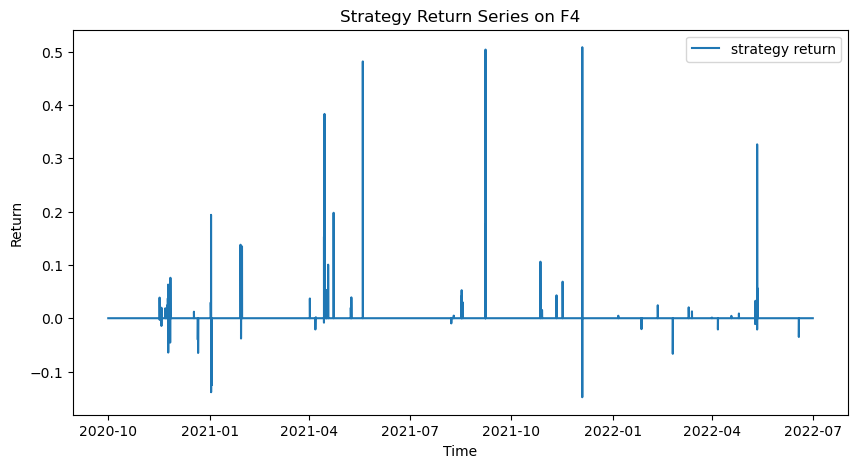

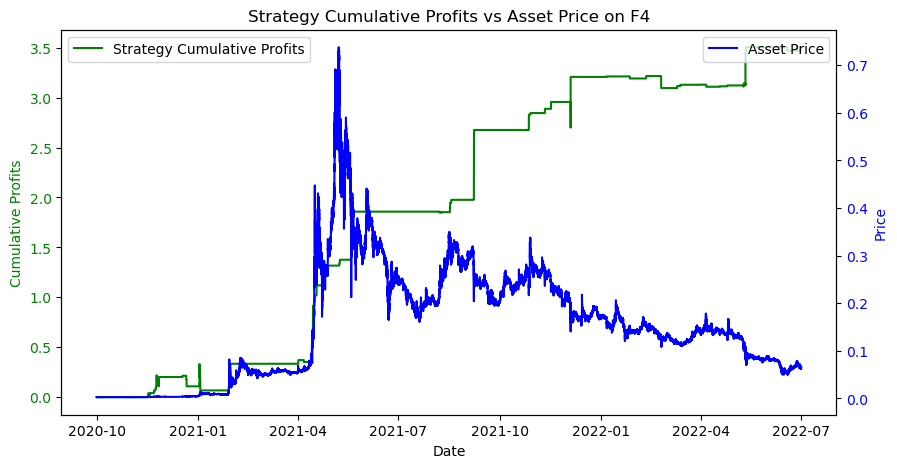

Win Prob: 71.23%
Number of Trades:  73 73
Average Win Return:   0.08712
Average Loss Return: -0.05053
P&L Ratio: 1.7
Maximum Loss of a single trade: -0.1481
Maximum Drawdown: -19.82%
Annual Return: 137.05%
Annual Volatility: 72.38%
Sharpe:  1.894


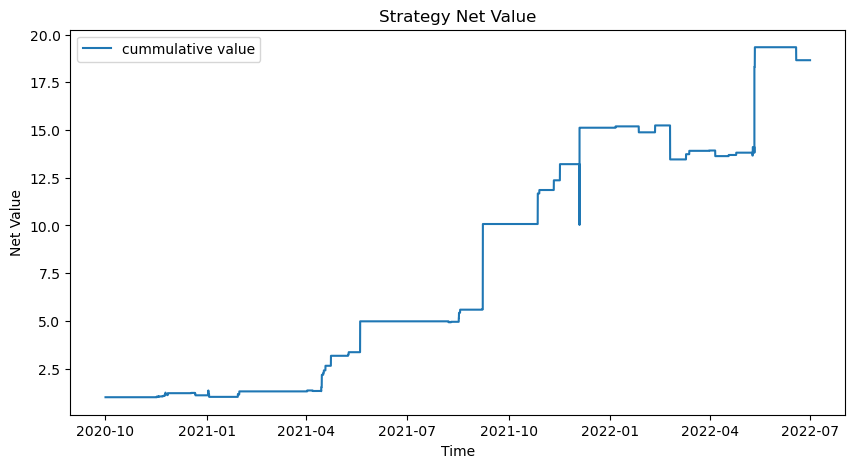

Annual Return: 432.37%
Annual Volatility: 72.37%
Sharpe:  5.975


Preprocess finished
8.4 Trading signal finished


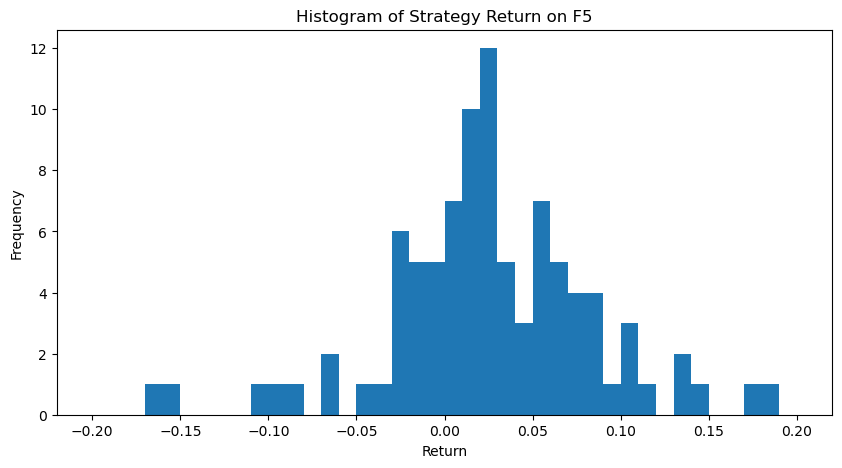

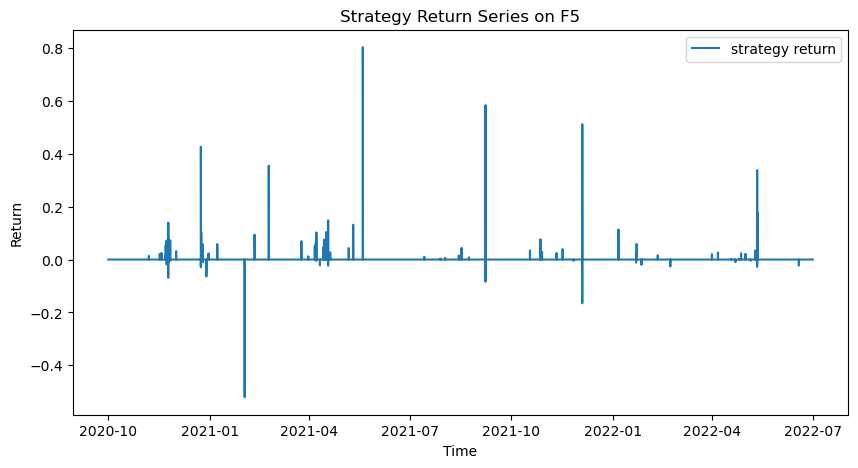

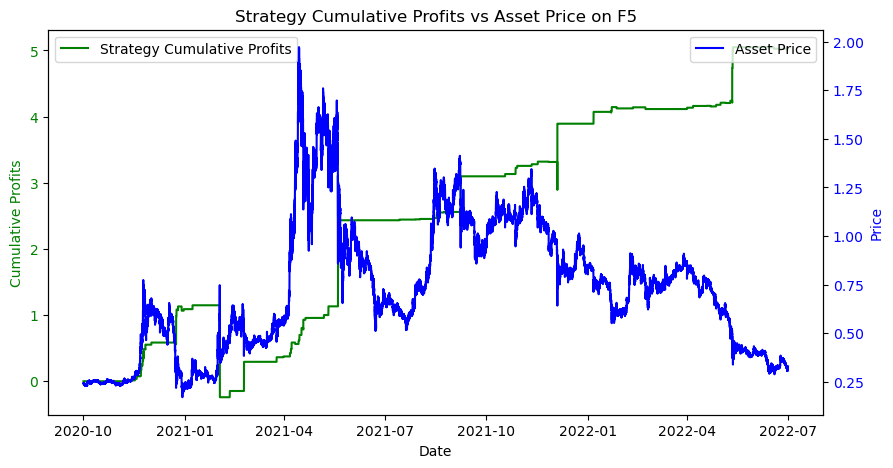

Win Prob: 72.82%
Number of Trades:  103 103
Average Win Return:   0.0985
Average Loss Return: -0.08435
P&L Ratio: 1.2
Maximum Loss of a single trade: -0.5206
Maximum Drawdown: -64.69%
Annual Return: 198.57%
Annual Volatility: 110.47%
Sharpe:  1.797


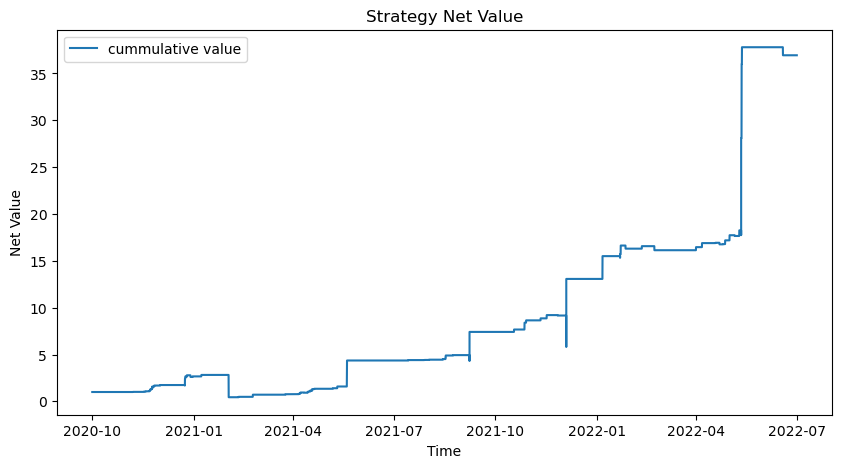

Annual Return: 686.51%
Annual Volatility: 110.46%
Sharpe:  6.215


Preprocess finished
8.4 Trading signal finished


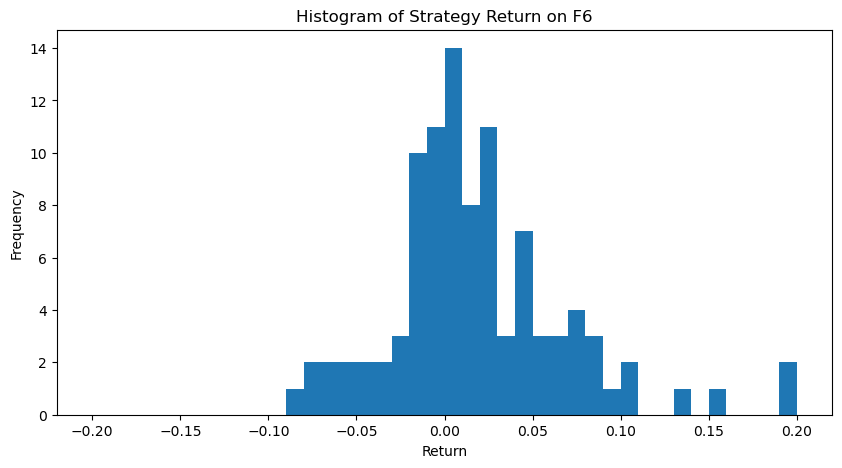

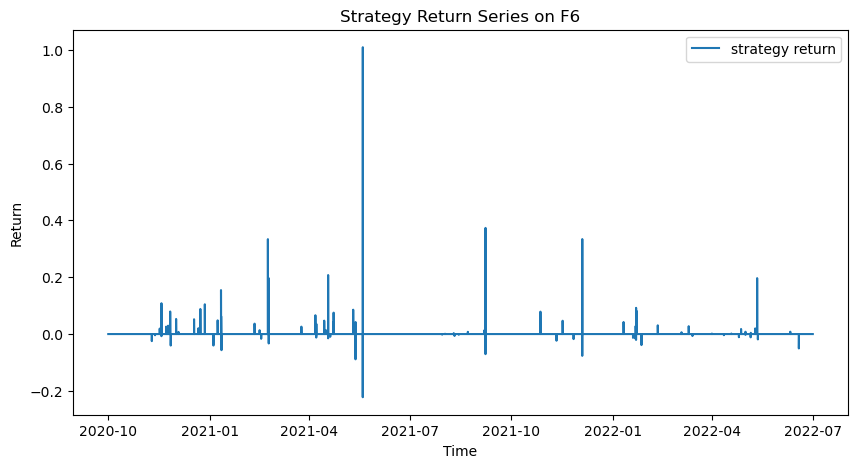

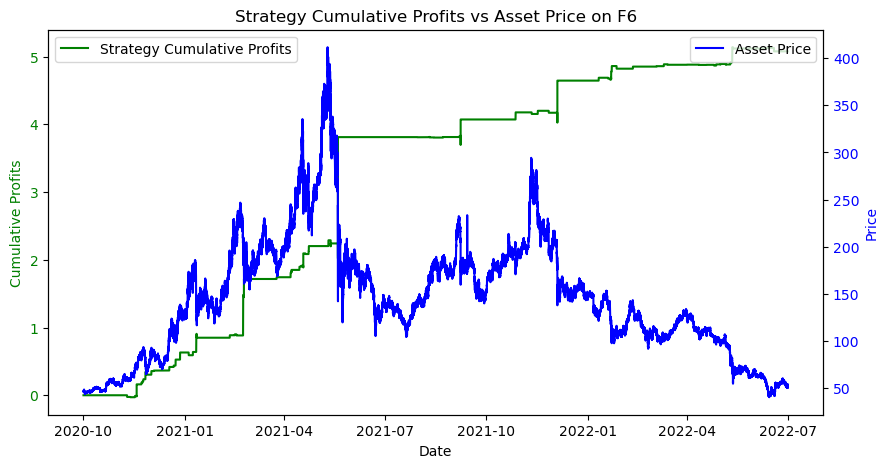

Win Prob: 66.36%
Number of Trades:  107 107
Average Win Return:   0.08732
Average Loss Return: -0.03119
P&L Ratio: 2.8
Maximum Loss of a single trade: -0.2222
Maximum Drawdown: -8.18%
Annual Return: 200.59%
Annual Volatility: 95.59%
Sharpe:  2.099


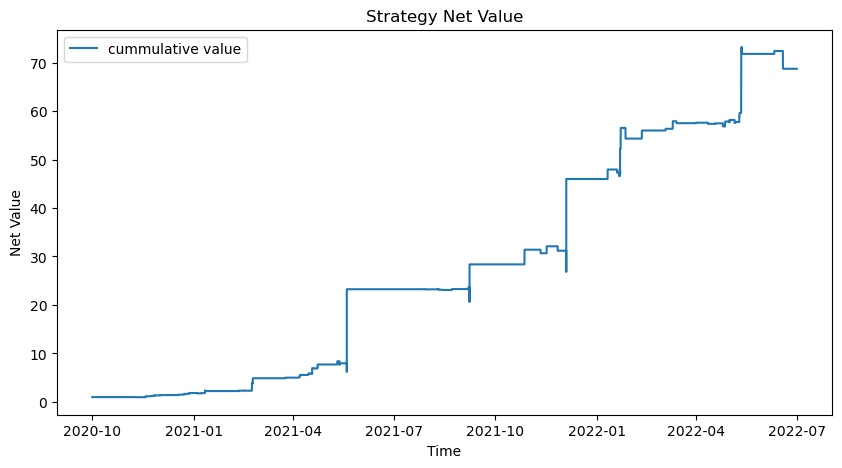

Annual Return: 1021.46%
Annual Volatility: 95.58%
Sharpe:  10.69


Preprocess finished
8.4 Trading signal finished


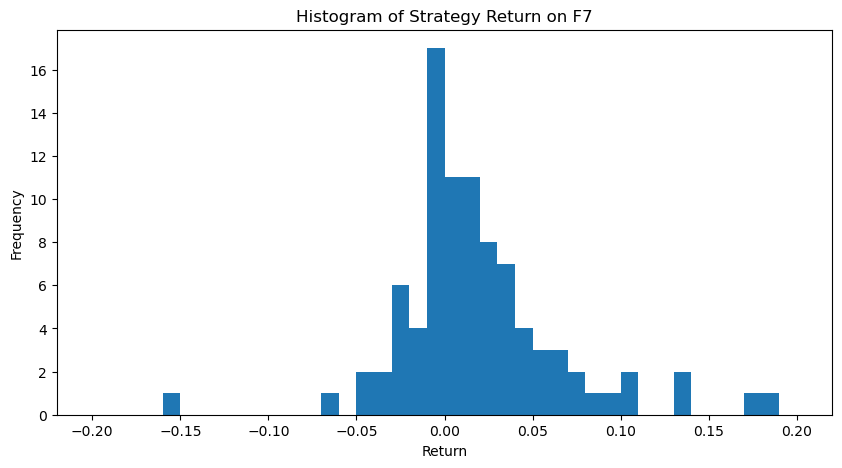

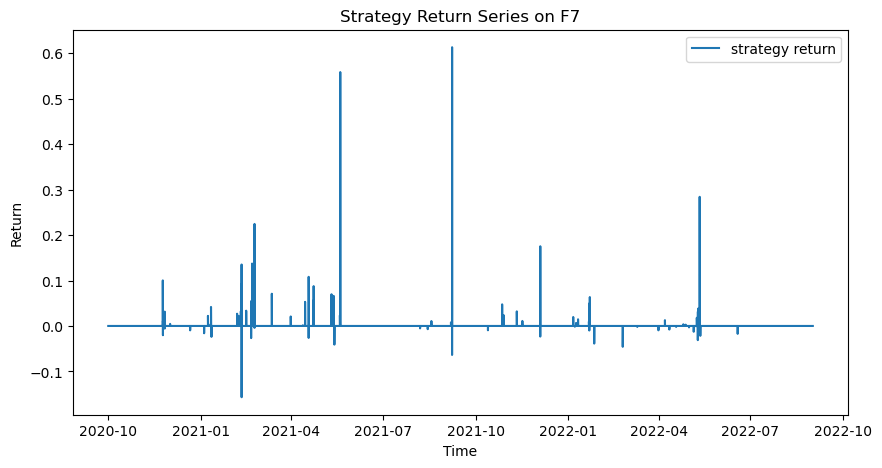

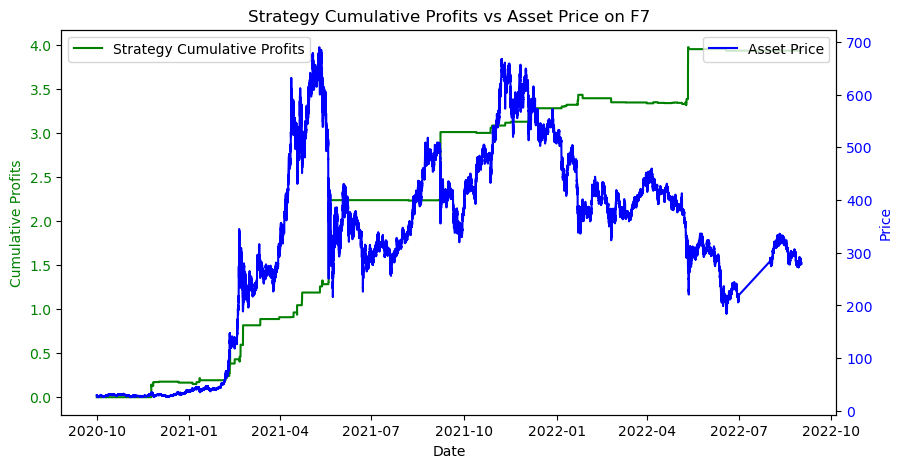

Win Prob: 65.62%
Number of Trades:  96 96
Average Win Return:   0.07269
Average Loss Return: -0.01962
P&L Ratio: 3.7
Maximum Loss of a single trade: -0.1568
Maximum Drawdown: -10.19%
Annual Return: 148.13%
Annual Volatility: 67.87%
Sharpe:  2.183


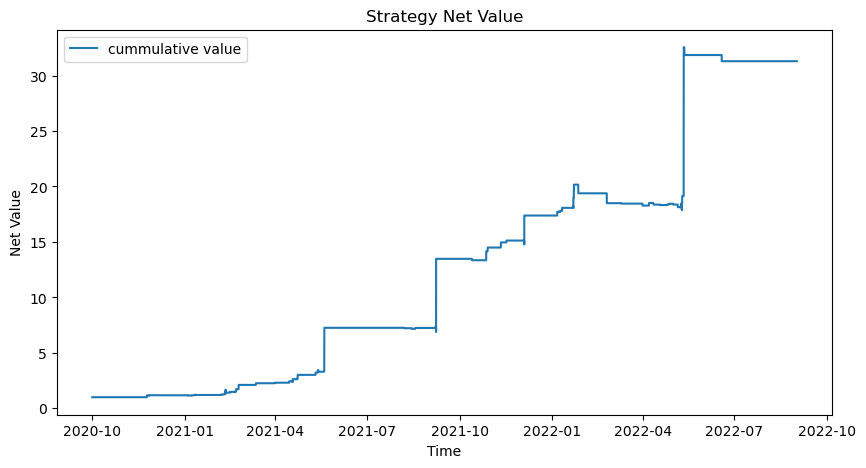

Annual Return: 615.43%
Annual Volatility: 67.86%
Sharpe:  9.069


Preprocess finished
8.4 Trading signal finished


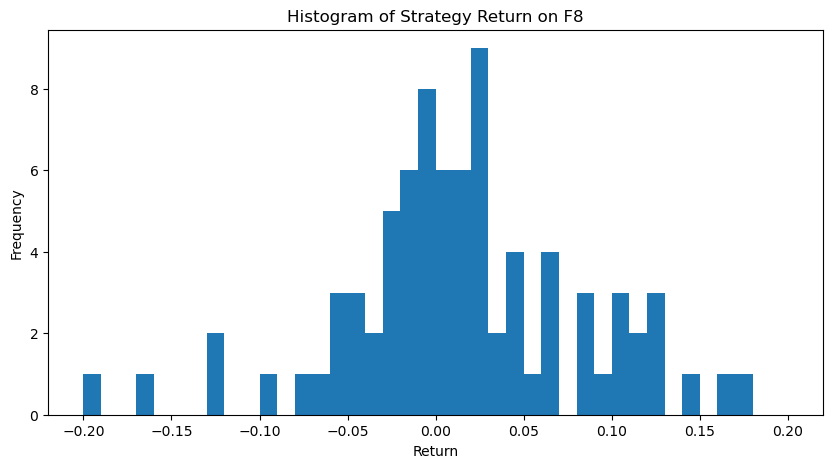

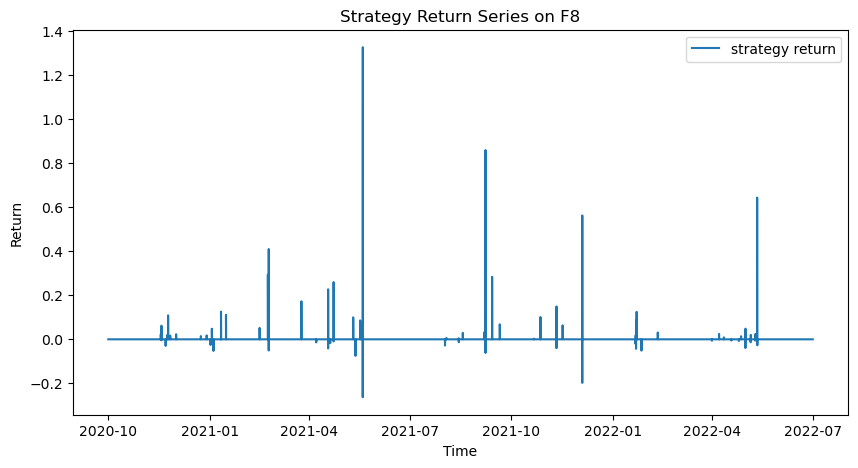

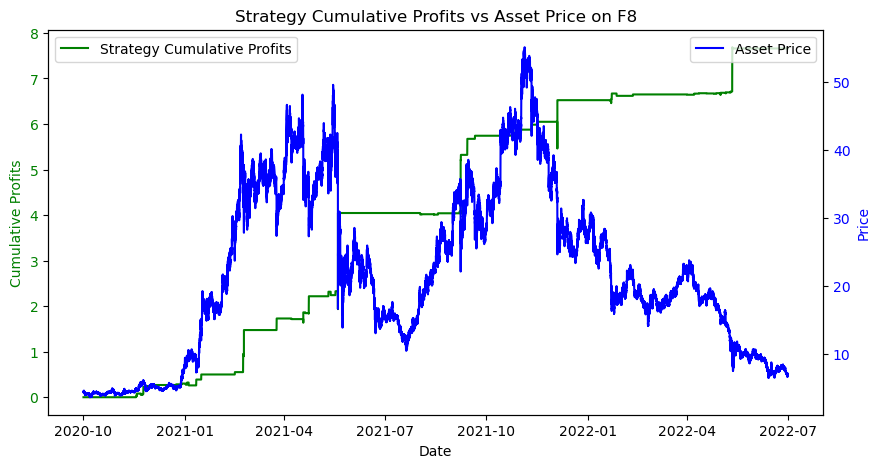

Win Prob: 63.16%
Number of Trades:  95 95
Average Win Return:   0.1567
Average Loss Return: -0.04979
P&L Ratio: 3.1
Maximum Loss of a single trade: -0.2632
Maximum Drawdown: -11.81%
Annual Return: 302.62%
Annual Volatility: 143.14%
Sharpe:  2.114


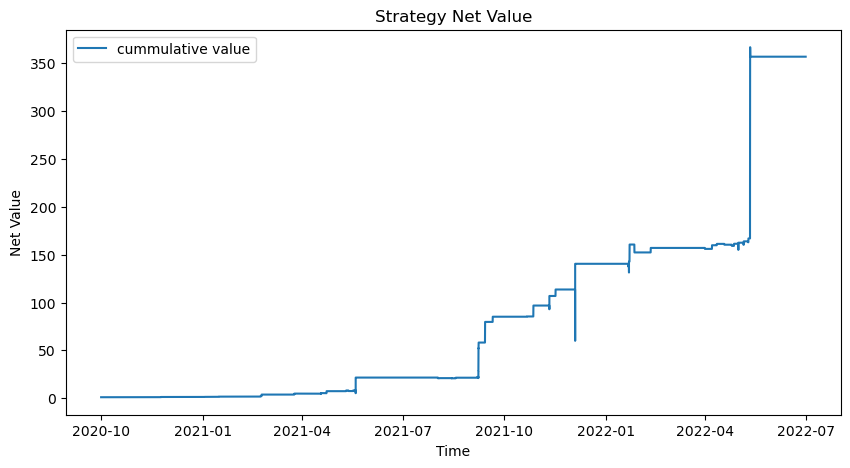

Annual Return: 2774.97%
Annual Volatility: 143.12%
Sharpe:  19.39


Preprocess finished
8.4 Trading signal finished


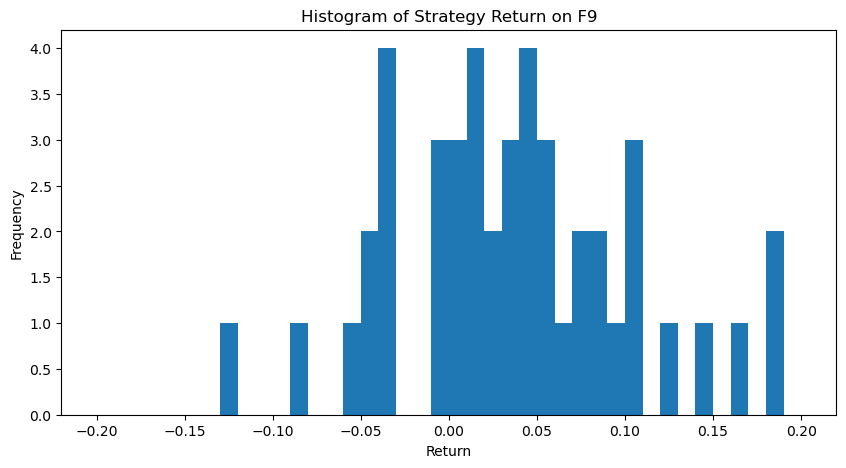

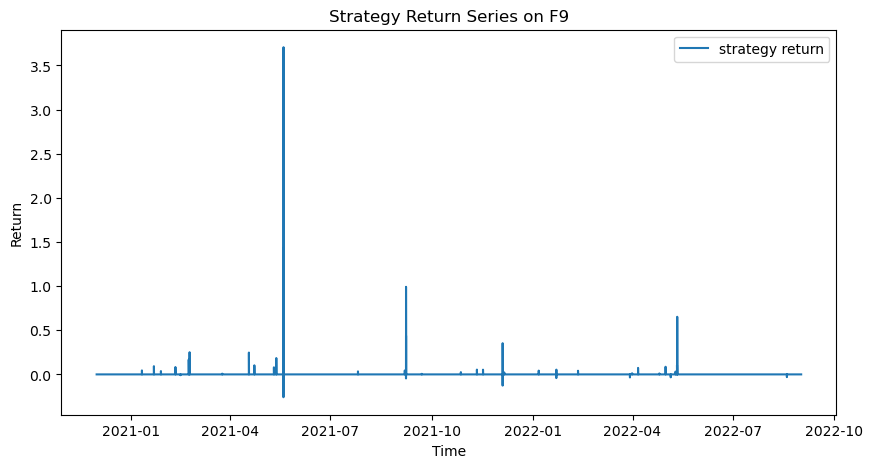

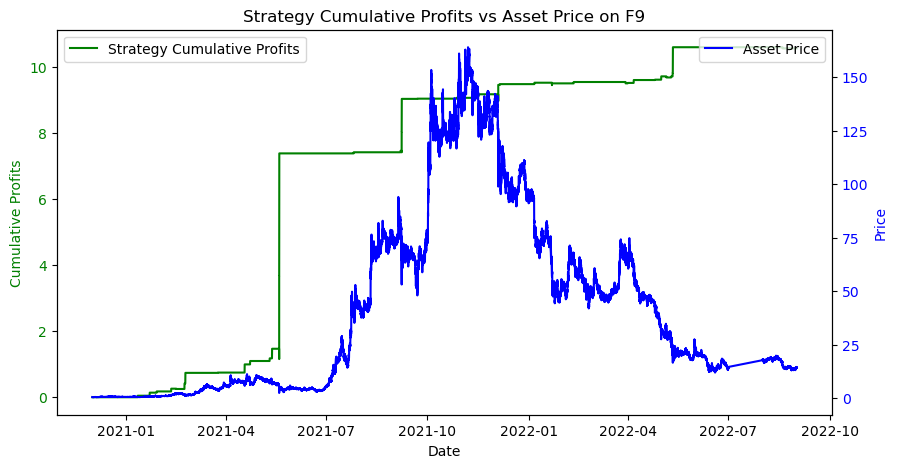

Win Prob: 76.36%
Number of Trades:  55 55
Average Win Return:   0.2693
Average Loss Return: -0.05825
P&L Ratio: 4.6
Maximum Loss of a single trade: -0.2586
Maximum Drawdown: -12.63%
Annual Return: 437.49%
Annual Volatility: 281.67%
Sharpe:  1.553


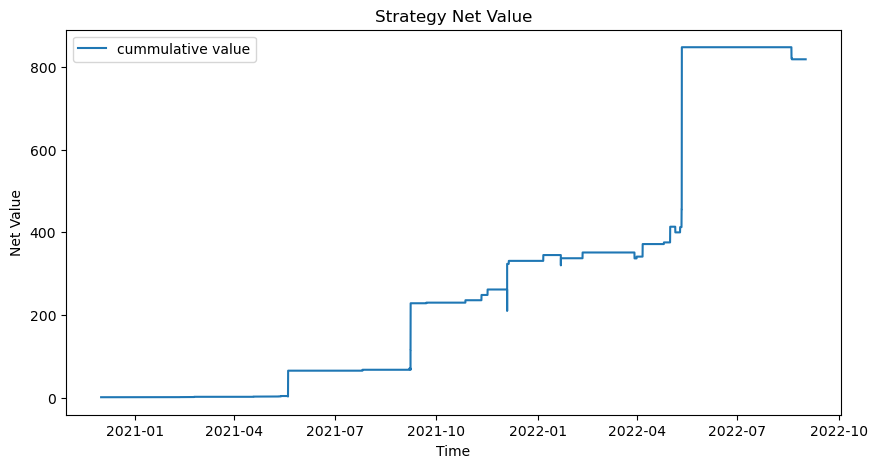

Annual Return: 4520.27%
Annual Volatility: 281.63%
Sharpe:  16.05


Preprocess finished
8.4 Trading signal finished


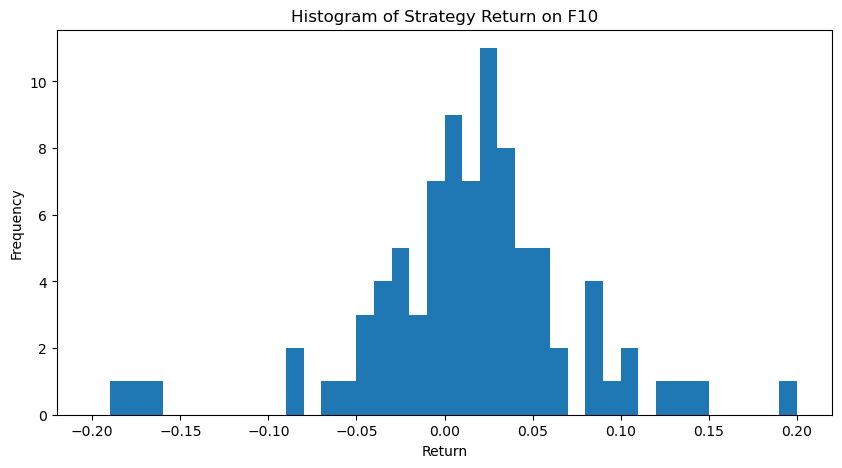

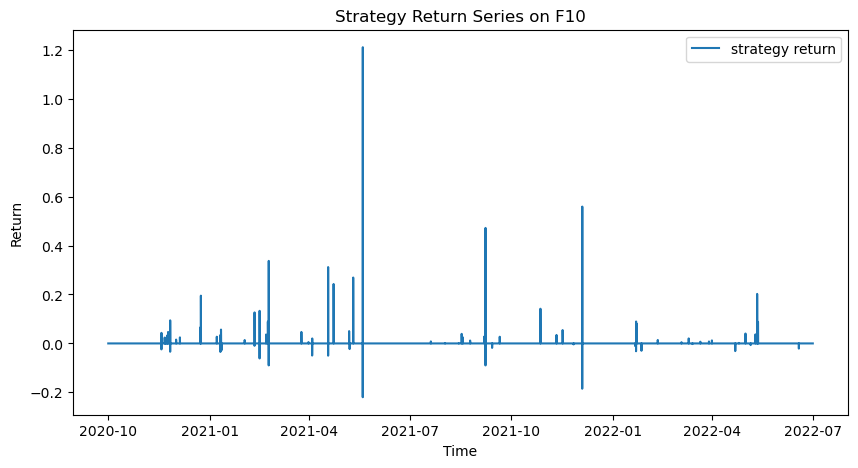

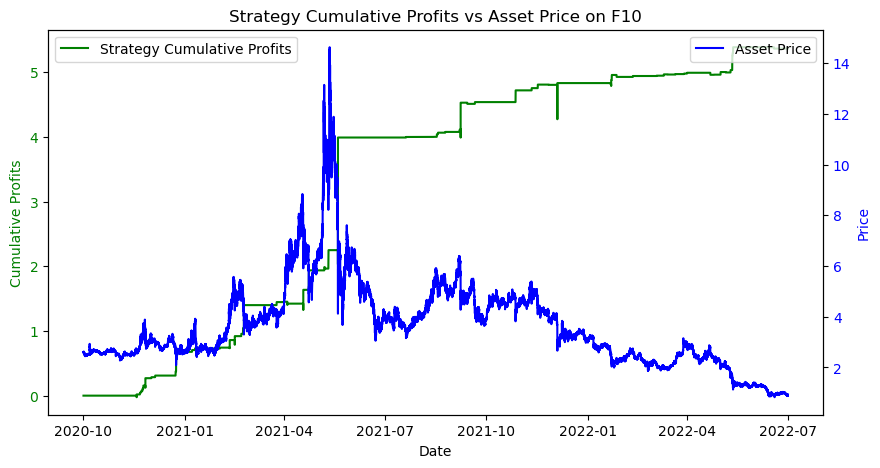

Win Prob: 69.07%
Number of Trades:  97 97
Average Win Return:   0.1027
Average Loss Return: -0.05059
P&L Ratio: 2.0
Maximum Loss of a single trade: -0.2198
Maximum Drawdown: -9.22%
Annual Return: 212.02%
Annual Volatility: 113.90%
Sharpe:  1.861


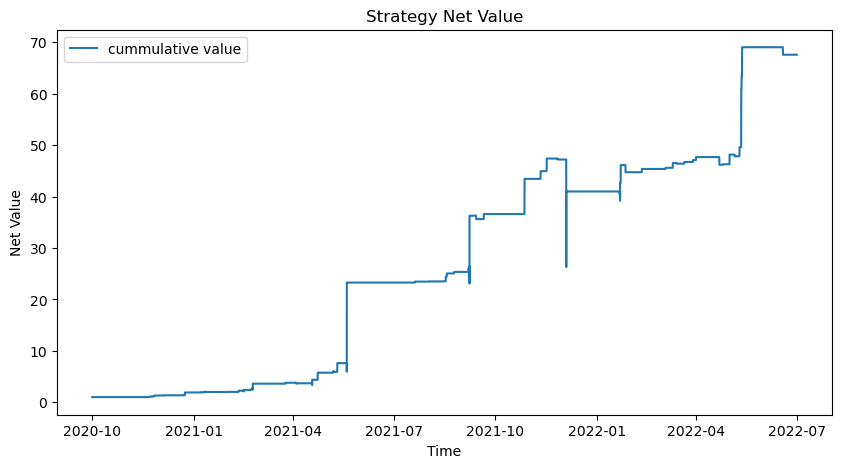

Annual Return: 1010.83%
Annual Volatility: 113.88%
Sharpe:  8.876


Preprocess finished
8.4 Trading signal finished


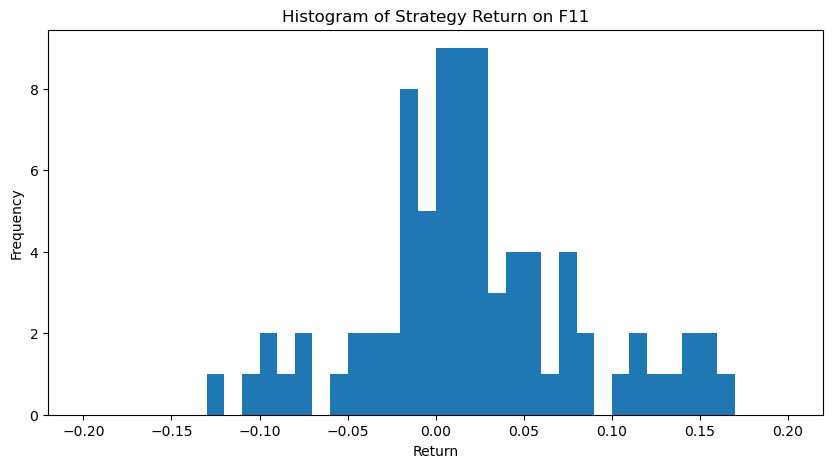

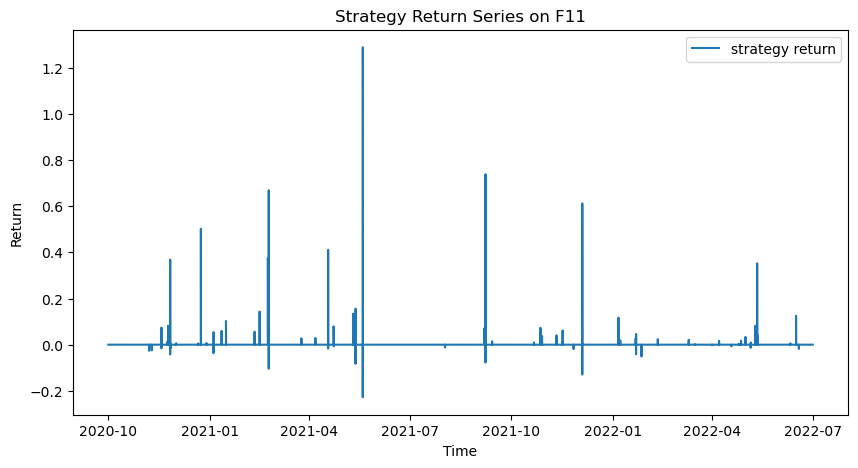

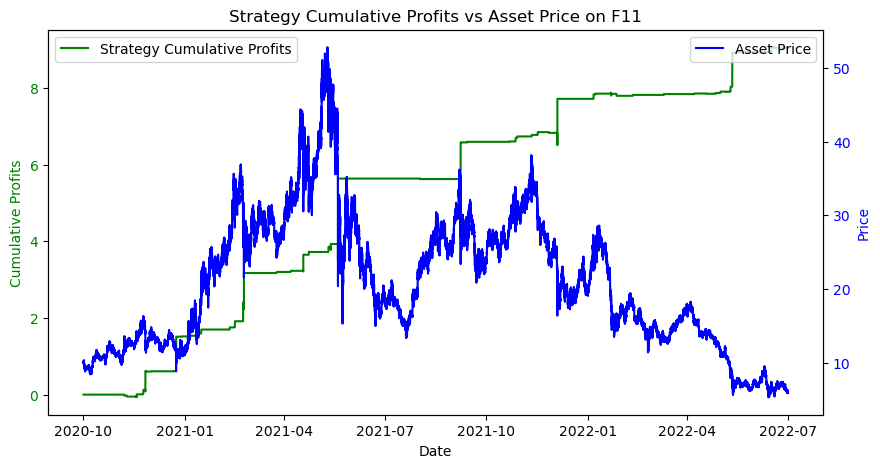

Win Prob: 70.71%
Number of Trades:  99 99
Average Win Return:   0.1506
Average Loss Return: -0.05179
P&L Ratio: 2.9
Maximum Loss of a single trade: -0.2277
Maximum Drawdown: -8.80%
Annual Return: 357.24%
Annual Volatility: 146.69%
Sharpe:  2.435


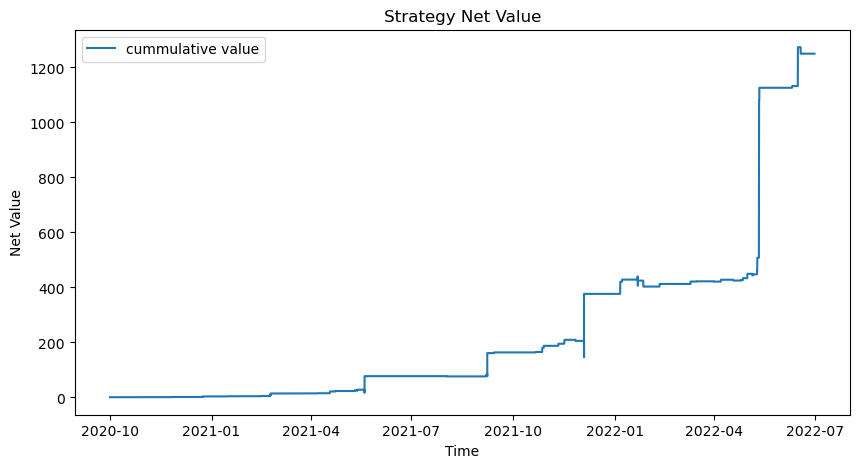

Annual Return: 5783.54%
Annual Volatility: 146.67%
Sharpe:  39.43


Preprocess finished
8.4 Trading signal finished


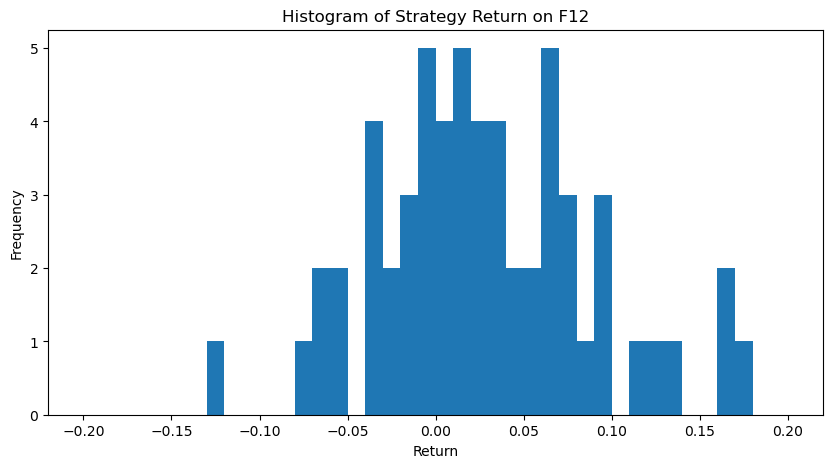

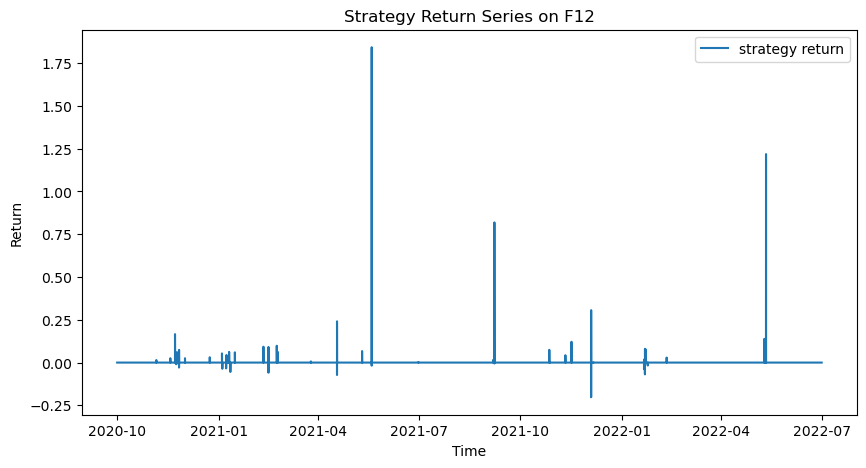

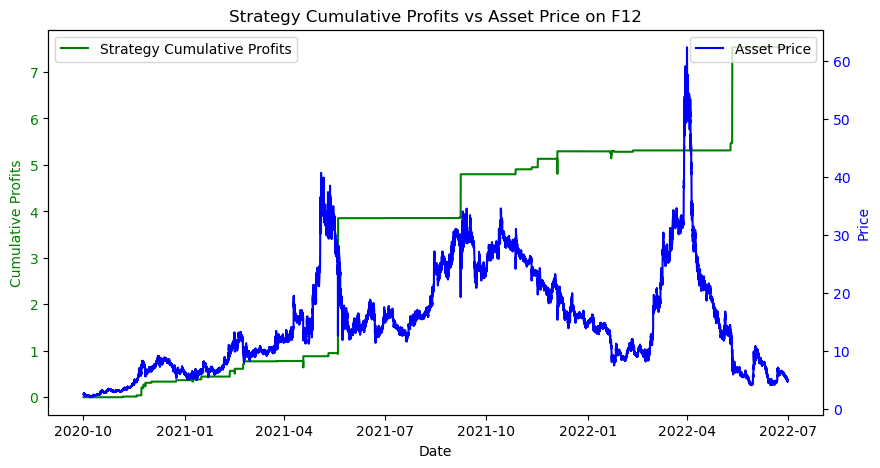

Win Prob: 69.57%
Number of Trades:  69 69
Average Win Return:   0.1761
Average Loss Return: -0.04386
P&L Ratio: 4.0
Maximum Loss of a single trade: -0.2024
Maximum Drawdown: -7.77%
Annual Return: 297.65%
Annual Volatility: 165.90%
Sharpe:  1.794


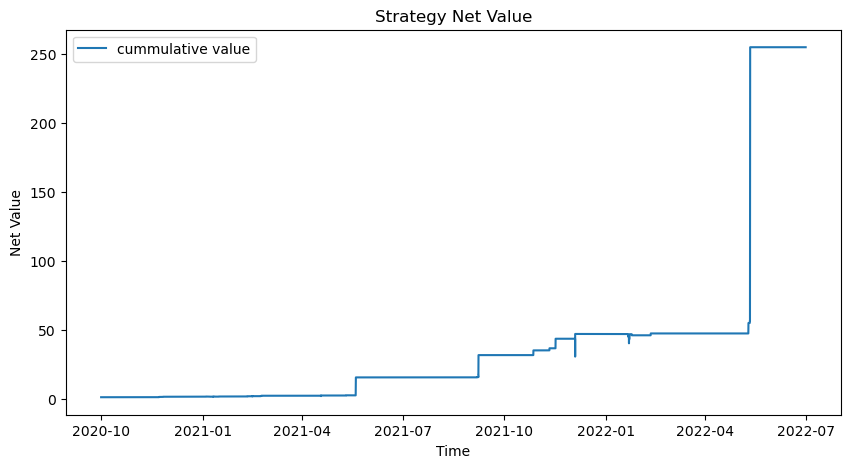

Annual Return: 2270.75%
Annual Volatility: 165.88%
Sharpe:  13.69


Preprocess finished
8.4 Trading signal finished


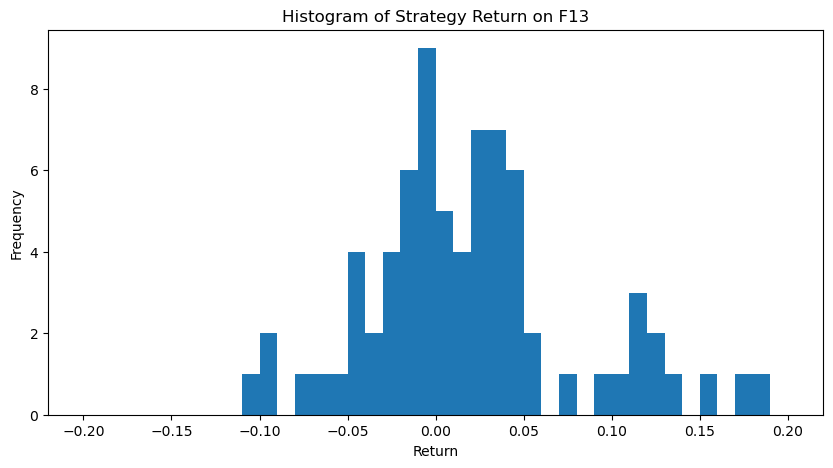

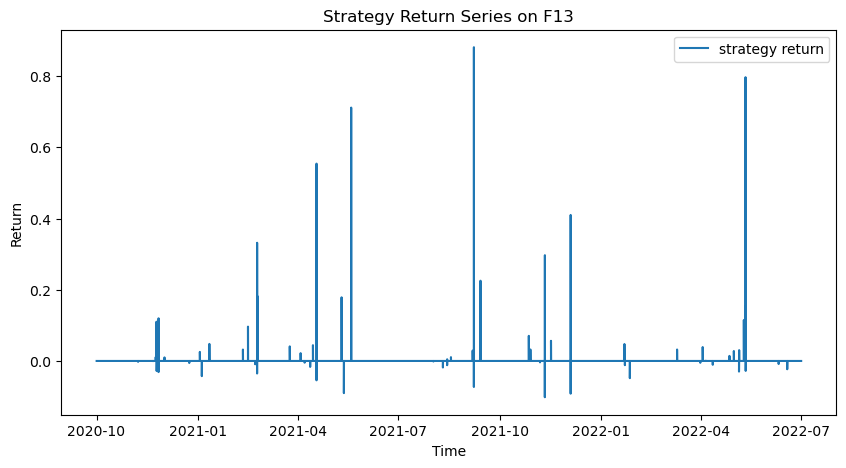

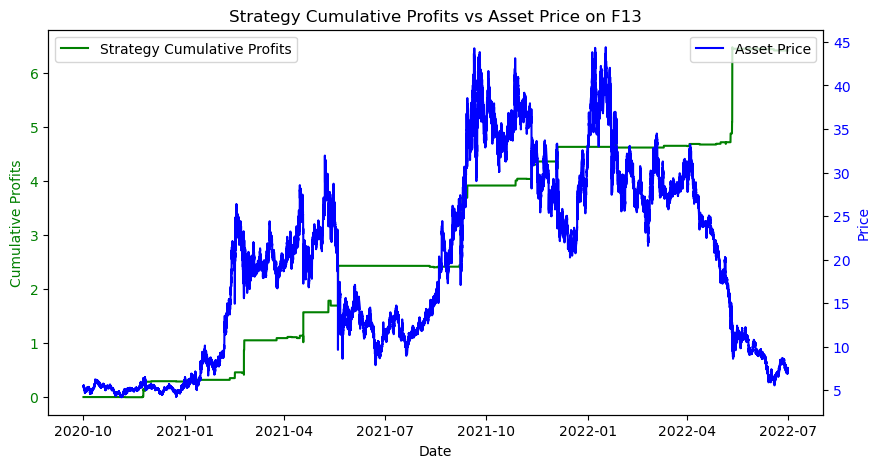

Win Prob: 63.10%
Number of Trades:  84 84
Average Win Return:   0.1393
Average Loss Return: -0.03132
P&L Ratio: 4.4
Maximum Loss of a single trade: -0.1018
Maximum Drawdown: -5.66%
Annual Return: 253.34%
Annual Volatility: 113.42%
Sharpe:  2.234


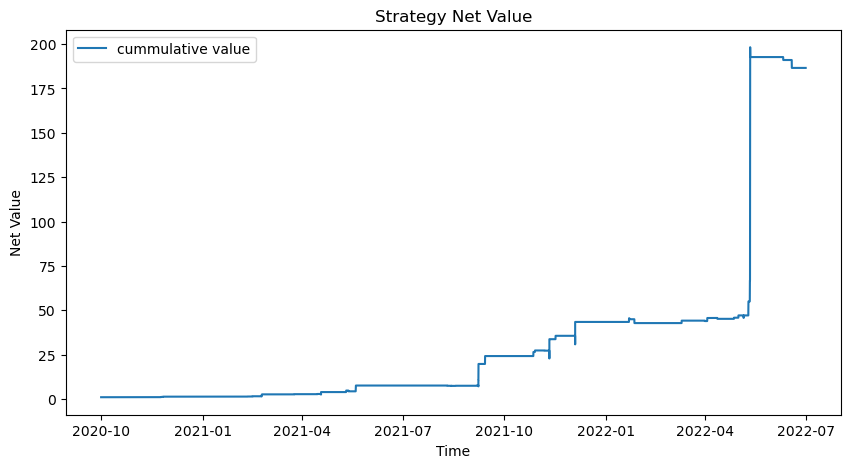

Annual Return: 1884.32%
Annual Volatility: 113.40%
Sharpe:  16.62


Preprocess finished
8.4 Trading signal finished


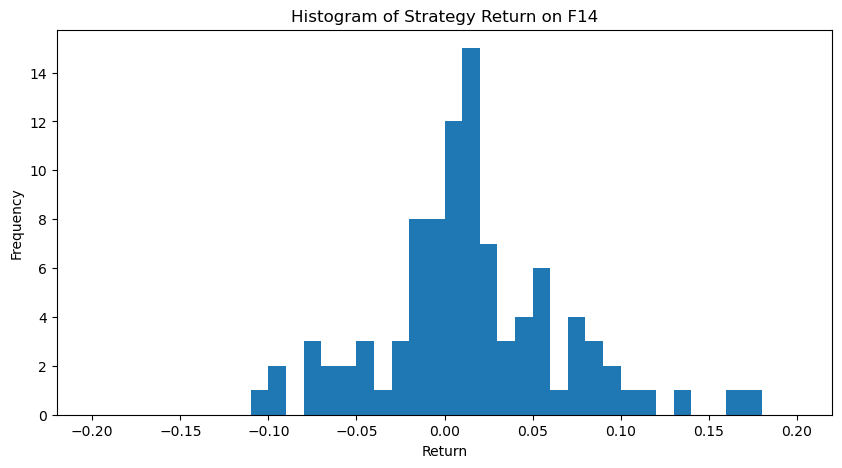

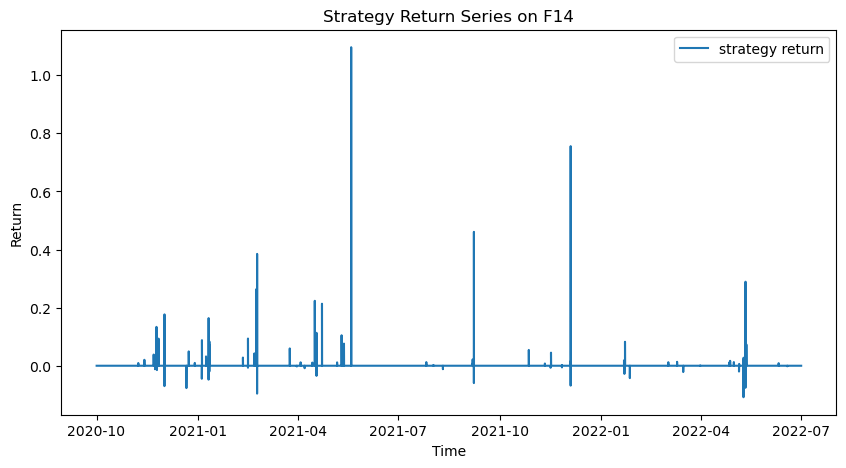

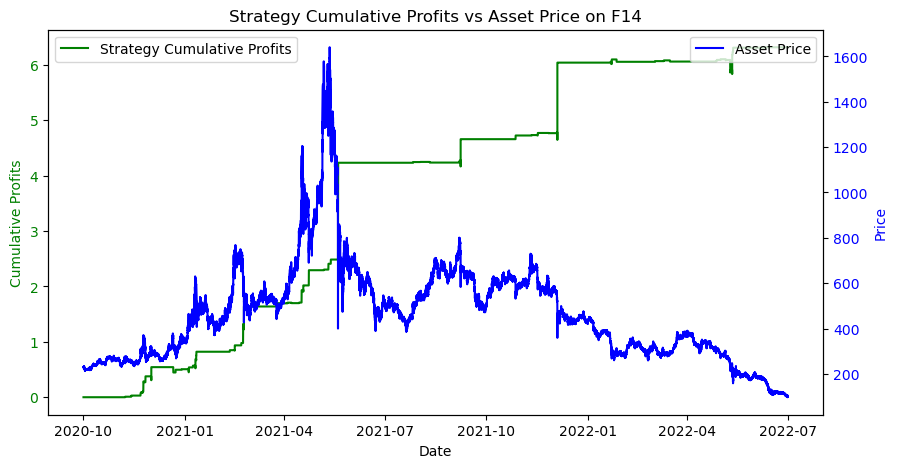

Win Prob: 68.57%
Number of Trades:  105 105
Average Win Return:   0.1041
Average Loss Return: -0.03557
P&L Ratio: 2.9
Maximum Loss of a single trade: -0.1084
Maximum Drawdown: -6.24%
Annual Return: 249.64%
Annual Volatility: 116.25%
Sharpe:  2.147


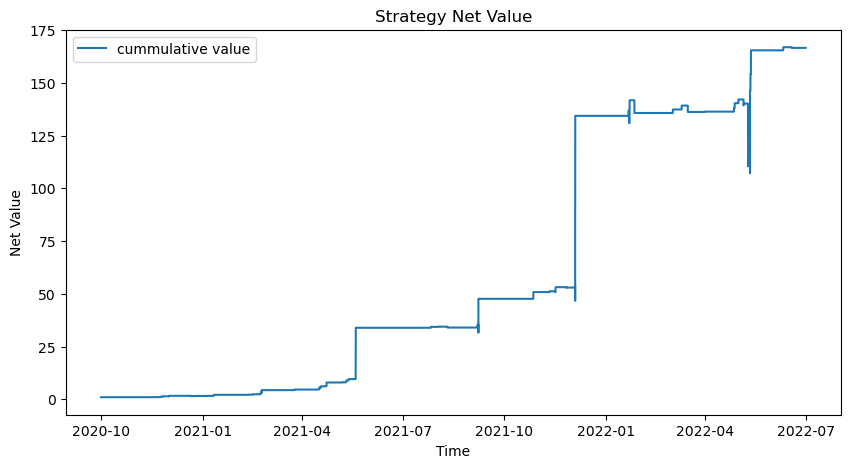

Annual Return: 1759.64%
Annual Volatility: 116.24%
Sharpe:  15.14


Preprocess finished
8.4 Trading signal finished


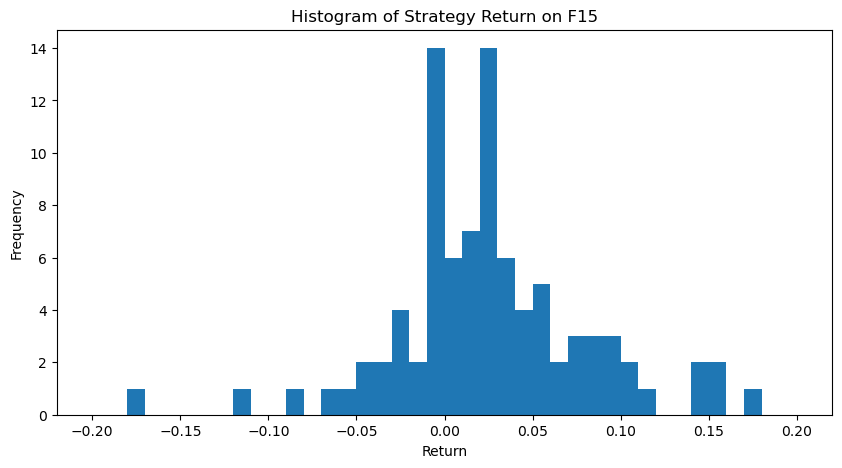

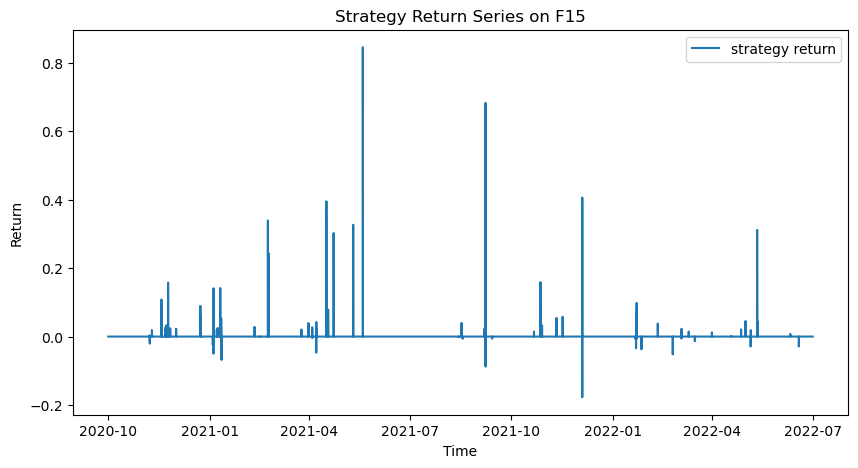

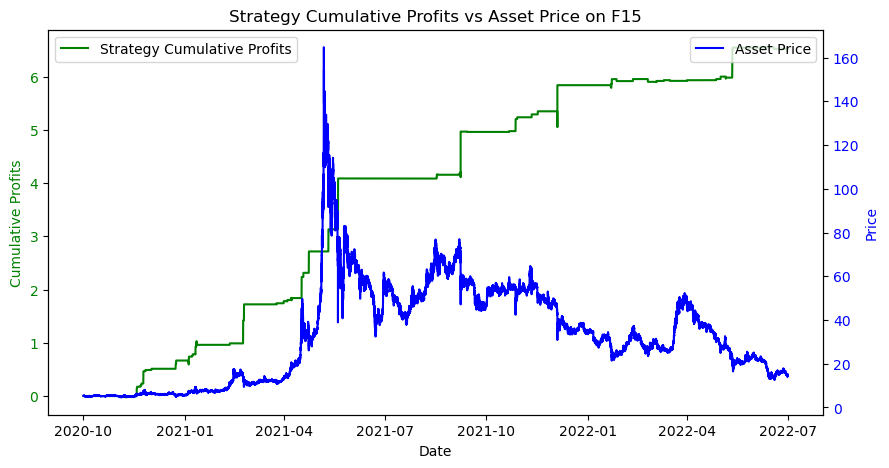

Win Prob: 71.00%
Number of Trades:  100 100
Average Win Return:   0.104
Average Loss Return: -0.02977
P&L Ratio: 3.5
Maximum Loss of a single trade: -0.1773
Maximum Drawdown: -4.68%
Annual Return: 257.76%
Annual Volatility: 98.63%
Sharpe:  2.613


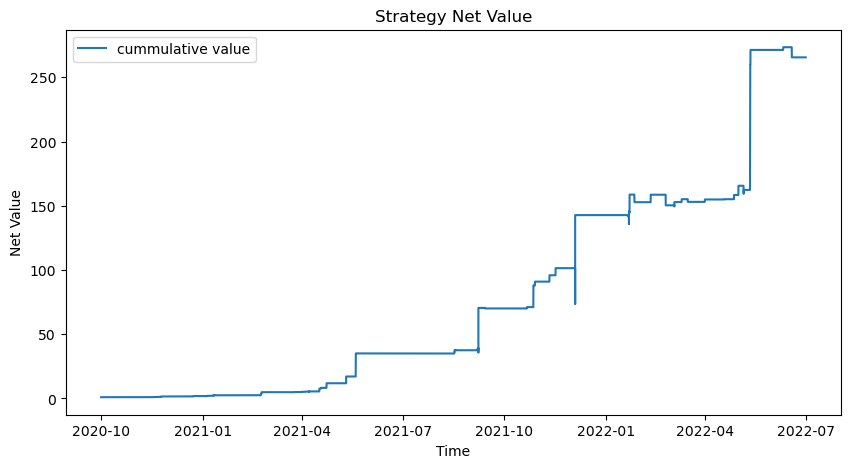

Annual Return: 2327.82%
Annual Volatility: 98.61%
Sharpe:  23.61


Preprocess finished
8.4 Trading signal finished


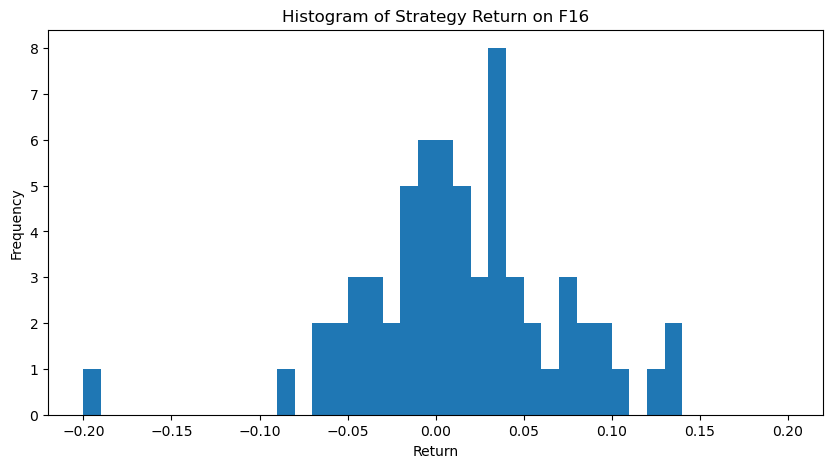

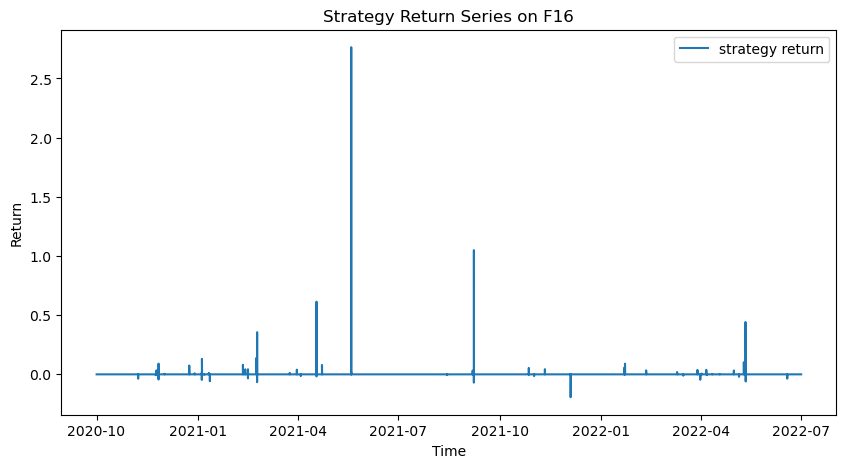

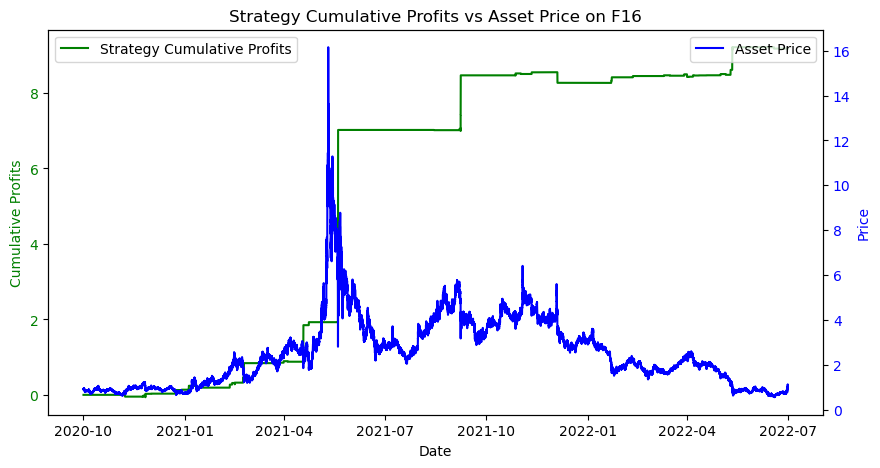

Win Prob: 65.75%
Number of Trades:  73 73
Average Win Return:   0.2103
Average Loss Return: -0.03671
P&L Ratio: 5.7
Maximum Loss of a single trade: -0.1932
Maximum Drawdown: -6.30%
Annual Return: 362.63%
Annual Volatility: 228.97%
Sharpe:  1.584


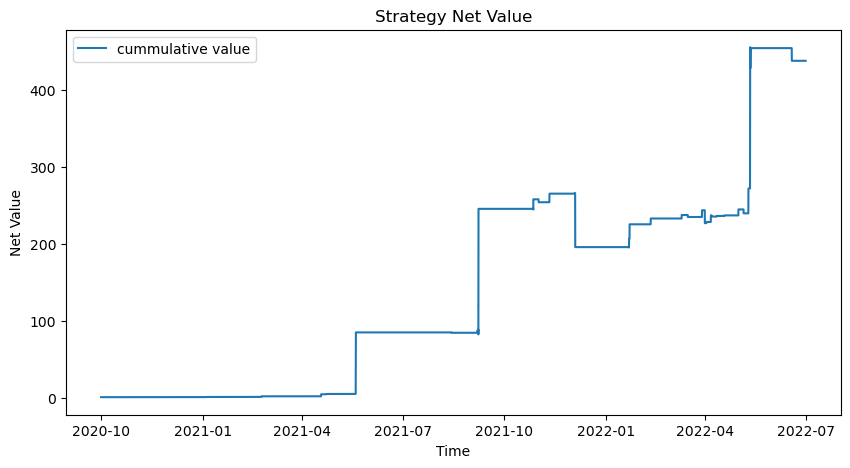

Annual Return: 3129.92%
Annual Volatility: 228.94%
Sharpe:  13.67


Preprocess finished
8.4 Trading signal finished


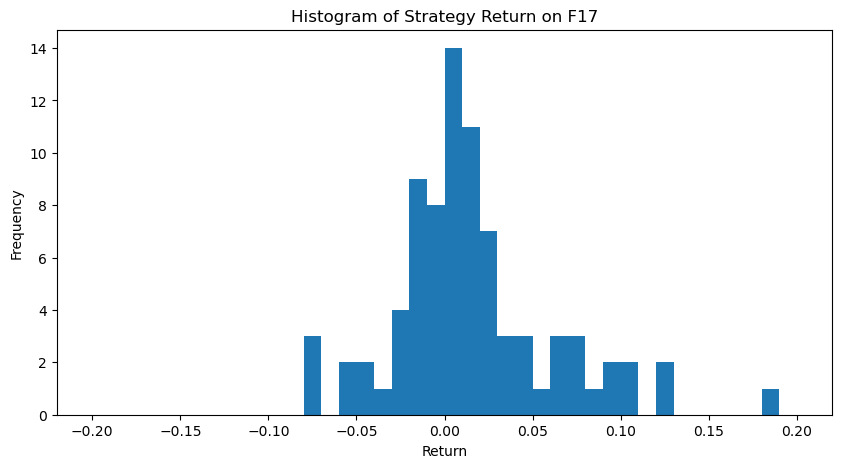

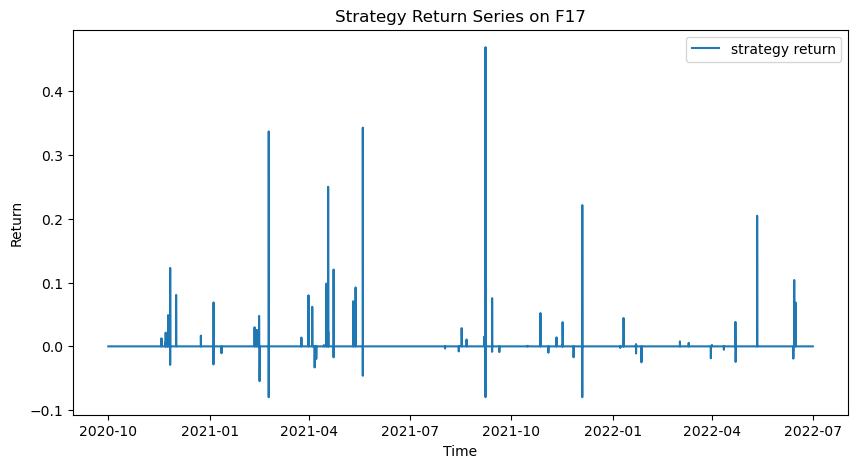

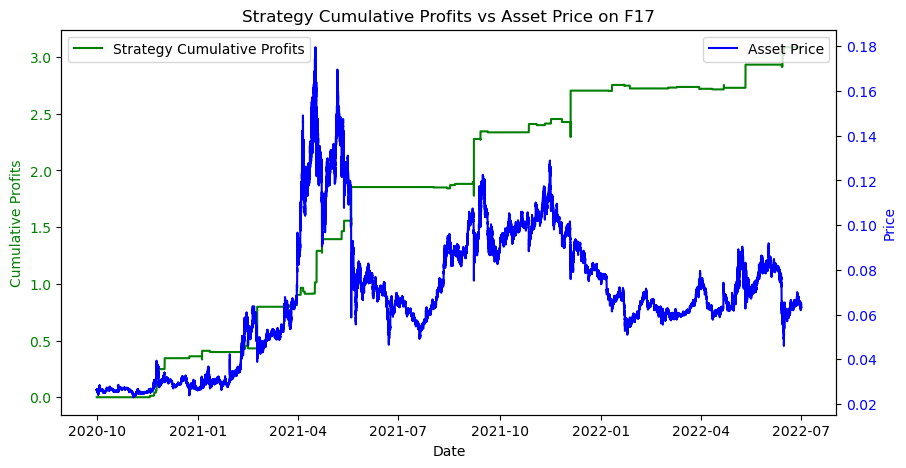

Win Prob: 67.05%
Number of Trades:  88 88
Average Win Return:   0.06539
Average Loss Return: -0.02659
P&L Ratio: 2.5
Maximum Loss of a single trade: -0.07965
Maximum Drawdown: -10.03%
Annual Return: 121.96%
Annual Volatility: 56.30%
Sharpe:  2.166


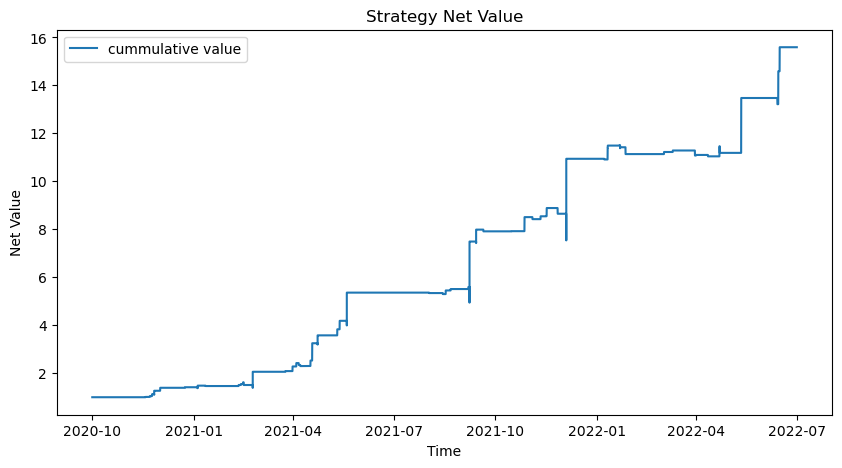

Annual Return: 380.44%
Annual Volatility: 56.29%
Sharpe:  6.758


Preprocess finished
8.4 Trading signal finished


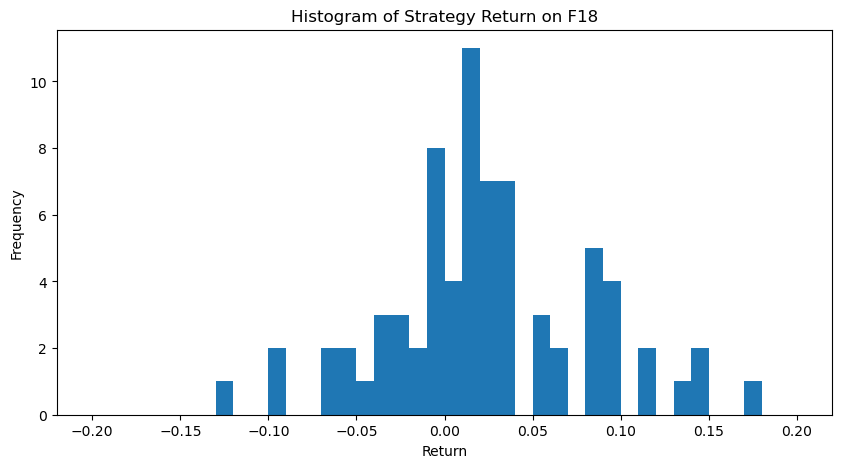

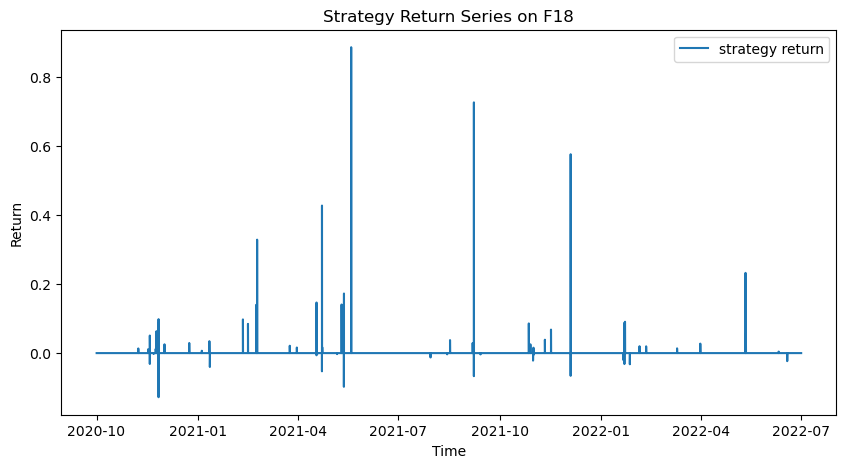

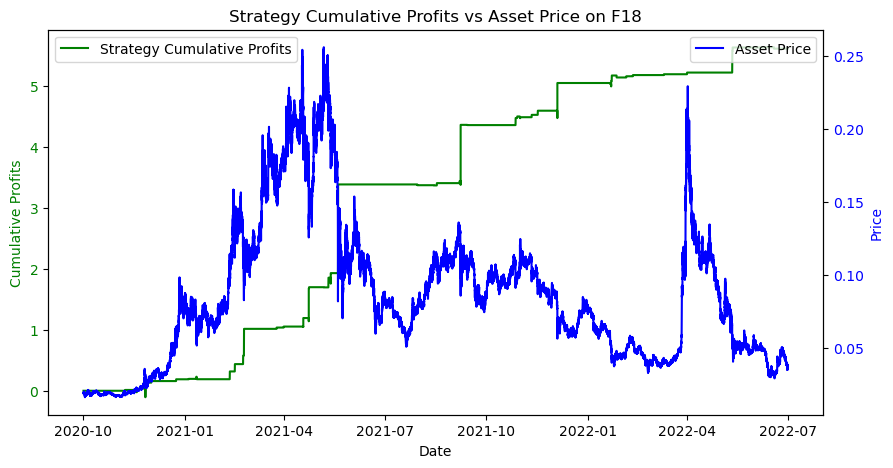

Win Prob: 70.37%
Number of Trades:  81 81
Average Win Return:   0.1131
Average Loss Return: -0.03444
P&L Ratio: 3.3
Maximum Loss of a single trade: -0.1279
Maximum Drawdown: -20.26%
Annual Return: 222.03%
Annual Volatility: 100.56%
Sharpe:  2.208


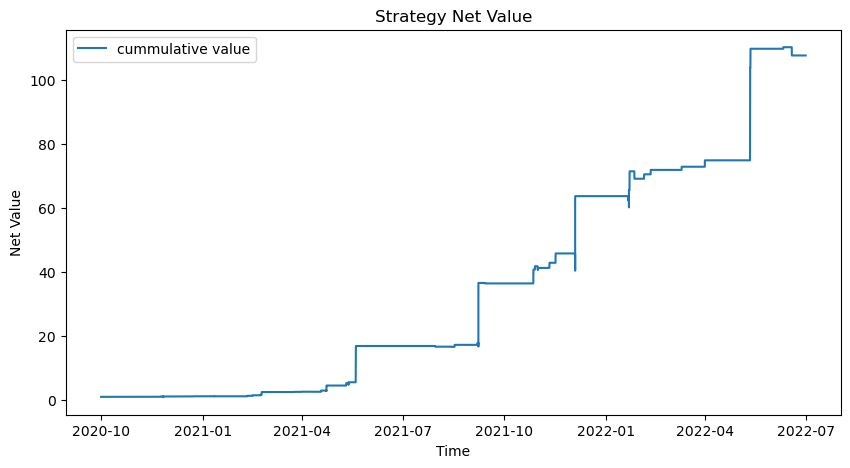

Annual Return: 1350.20%
Annual Volatility: 100.55%
Sharpe:  13.43




In [439]:
# strategy 8.4 use avg_price as buy price
strategy8_4_list = []
for idx in range(len(data_list)):
    name = 'F'+str(idx+1)
    stra8_4 = CTAStrategy(data_list[idx],'open_time','signal','close',120,5,name)
    stra8_4.data_preprocess()
    stra8_4.find_signal_8_4(10000,0.1,1)
    stra8_4.get_strategy_returns(1/1000,'avg_price')
    stra8_4.plot_hist_seires(abs_range=0.2)
    stra8_4.plot_cumsum_profits()
    stra8_4.get_win_prob()
    stra8_4.get_avg_win_return()
    stra8_4.get_maximum_drawdown()
    stra8_4.get_sharpe()
    stra8_4.plot_cumprod_value()
    strategy8_4_list.append(stra8_4)
    print('\n')

# Combine Stats

In [320]:
def combine_df(profit_list):
    # add title 
    for idx in range(len(profit_list)):
        profit_list[idx] = pd.concat([pd.DataFrame({'Value': ['Strategy '+str(idx+1)]}, index=['Strategy Name']),profit_list[idx]],axis=0)
    # combine df
    combine_df = pd.concat(profit_list,axis = 0)
    return combine_df

In [321]:
profit_list =[profit_des_8_1,profit_des_8_2, profit_des_8_3,profit_des_8_4]
profit_comb = combine_df(profit_list)


In [322]:
tbv_list = [tbv_des_8_1,tbv_des_8_2,tbv_des_8_3,tbv_des_8_4]
tbv_comb = combine_df(tbv_list)
tbv_tv_list = [tbv_tv_des_8_1,tbv_tv_des_8_2,tbv_tv_des_8_3,tbv_tv_des_8_4]
tbv_tv_comb = combine_df(tbv_tv_list)
tbv_pct_list = [tbv_pct_des_8_1,tbv_pct_des_8_2,tbv_pct_des_8_3,tbv_pct_des_8_4]
tbv_pct_comb = combine_df(tbv_pct_list)


In [323]:
ma_list = [ma_des_8_1,ma_des_8_2,ma_des_8_3,ma_des_8_4]
ma_comb = combine_df(ma_list)
ma_comb

,Value,F1_count,F1_pecentage,F2_count,F2_pecentage,F3_count,F3_pecentage,F4_count,F4_pecentage,F5_count,...,F14_count,F14_pecentage,F15_count,F15_pecentage,F16_count,F16_pecentage,F17_count,F17_pecentage,F18_count,F18_pecentage
Strategy Name,Strategy 1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
above,NaN,32.0,0.283186,22.0,0.207547,10.0,0.091743,53.0,0.535354,39.0,...,19.0,0.165217,28.0,0.245614,16.0,0.183908,31.0,0.289720,20.0,0.212766
blw0_2.3,NaN,18.0,0.159292,16.0,0.150943,29.0,0.266055,10.0,0.101010,16.0,...,21.0,0.182609,23.0,0.201754,21.0,0.241379,16.0,0.149533,21.0,0.223404
blw2.3_3.5,NaN,17.0,0.150442,25.0,0.235849,30.0,0.275229,9.0,0.090909,20.0,...,31.0,0.269565,19.0,0.166667,23.0,0.264368,19.0,0.177570,17.0,0.180851
blw3.5_4.8,NaN,26.0,0.230088,20.0,0.188679,24.0,0.220183,10.0,0.101010,17.0,...,18.0,0.156522,19.0,0.166667,14.0,0.160920,25.0,0.233645,23.0,0.244681
blw4.8,NaN,20.0,0.176991,23.0,0.216981,16.0,0.146789,17.0,0.171717,28.0,...,26.0,0.226087,25.0,0.219298,13.0,0.149425,16.0,0.149533,13.0,0.138298
Strategy Name,Strategy 2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
above,NaN,32.0,0.283186,22.0,0.207547,10.0,0.091743,53.0,0.535354,39.0,...,19.0,0.165217,28.0,0.245614,16.0,0.183908,31.0,0.289720,20.0,0.212766
blw0_2.3,NaN,18.0,0.159292,16.0,0.150943,29.0,0.266055,10.0,0.101010,16.0,...,21.0,0.182609,23.0,0.201754,21.0,0.241379,16.0,0.149533,21.0,0.223404
blw2.3_3.5,NaN,17.0,0.150442,25.0,0.235849,30.0,0.275229,9.0,0.090909,20.0,...,31.0,0.269565,19.0,0.166667,23.0,0.264368,19.0,0.177570,17.0,0.180851


In [62]:
# combine stragtey 8.2 taker buy volume/total volume
tbv_return_list = [return_df0, return_df1, return_df2]
category_list = ['0-25','25-45', '45-100']
# add title 
for idx in range(len(tbv_return_list)):
    tbv_return_list[idx] = pd.concat([pd.DataFrame({'Strategy 8': ['Strategy 2'] }, index=['tbv/tv'+category_list[idx]]),tbv_return_list[idx]],axis=0)
    tbv_return_list[idx]['sum'] = tbv_return_list[idx].loc['count', :].sum()

# combine df
tbv_combine_df = pd.concat(tbv_return_list,axis = 0)
tbv_combine_df

,Strategy 8,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,F16,F17,F18,sum
tbv/tv0-25,Strategy 2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,72.0
count,NaN,0.000000,1.000000,2.000000,0.000000,1.000000,2.000000,2.000000,5.000000,5.000000,3.000000,4.000000,6.000000,8.000000,4.000000,6.000000,8.000000,2.000000,13.000000,72.0
mean,NaN,NaN,0.028952,-0.002840,NaN,0.013471,0.008097,0.005092,0.030237,0.050141,-0.078242,-0.016163,0.023138,0.005850,0.213486,-0.007520,0.007412,0.297228,0.014308,72.0
std,NaN,NaN,NaN,0.002377,NaN,NaN,0.022124,0.002163,0.018081,0.086749,0.105997,0.058859,0.052423,0.037981,0.404818,0.061497,0.041881,0.081556,0.045528,72.0
min,NaN,NaN,0.028952,-0.004520,NaN,0.013471,-0.007548,0.003562,0.013394,-0.080972,-0.180275,-0.098322,-0.061398,-0.079431,-0.069605,-0.119166,-0.043739,0.239560,-0.067166,72.0
25%,NaN,NaN,0.028952,-0.003680,NaN,0.013471,0.000274,0.004327,0.016968,0.036959,-0.133021,-0.036016,-0.001674,-0.001443,-0.006026,-0.006956,-0.010781,0.268394,0.004714,72.0
50%,NaN,NaN,0.028952,-0.002840,NaN,0.013471,0.008097,0.005092,0.021442,0.058821,-0.085768,-0.001935,0.032397,0.014363,0.055695,-0.002211,0.004844,0.297228,0.020941,72.0
75%,NaN,NaN,0.028952,-0.001999,NaN,0.013471,0.015919,0.005857,0.047064,0.076321,-0.027225,0.017918,0.057518,0.031457,0.275208,0.013643,0.017045,0.326062,0.038612,72.0
max,NaN,NaN,0.028952,-0.001159,NaN,0.013471,0.023741,0.006622,0.052315,0.159577,0.031317,0.037537,0.082570,0.038317,0.812160,0.068080,0.082068,0.354897,0.077803,72.0
tbv/tv25-45,Strategy 2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1582.0


In [ ]:
# combine stragtey 8.2 ma
# ma_return_list = [ret_ma_df00, ret_ma_df0, ret_ma_df1, ret_ma_df2,ret_ma_df3,ret_ma_df4]
ma_return_list = [ ret_ma_df0, ret_ma_df1, ret_ma_df2,ret_ma_df3,ret_ma_df4]
category_list = ['above1', 'above0_1', 'blw0-2.3','blw2.3-3.5','blw3.5-4.8', 'blw4.8']
# add title 
for idx in range(len(ma_return_list)):
    ma_return_list[idx] = pd.concat([pd.DataFrame({'Strategy 8': ['Strategy 2'] }, index=['MA '+category_list[idx]]),ma_return_list[idx]],axis=0)
    ma_return_list[idx]['sum'] = ma_return_list[idx].loc['count', :].sum()
# combine df
ma_combine_df = pd.concat(ma_return_list,axis = 0)
ma_combine_df

,Strategy 8,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,F16,F17,F18,sum
MA above1,Strategy 2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,217.0
count,NaN,16.000000,11.000000,3.000000,46.000000,24.000000,6.000000,10.000000,3.000000,1.000000,7.000000,5.000000,9.000000,4.000000,7.000000,18.000000,12.000000,22.000000,13.000000,217.0
mean,NaN,-0.007328,-0.004734,-0.064660,0.036790,-0.015003,-0.025164,-0.002274,-0.021258,-0.051423,0.001772,-0.000934,0.007278,0.026118,0.000959,-0.010087,-0.010397,-0.018798,0.013543,217.0
std,NaN,0.051812,0.007910,0.020040,0.151401,0.080546,0.037073,0.056924,0.031068,NaN,0.026480,0.018702,0.024998,0.019197,0.027288,0.031976,0.028828,0.042065,0.039161,217.0
min,NaN,-0.096292,-0.019193,-0.078066,-0.183181,-0.263970,-0.079918,-0.095600,-0.046624,-0.051423,-0.030940,-0.023944,-0.032771,-0.002254,-0.040541,-0.065590,-0.079585,-0.110072,-0.056933,217.0
25%,NaN,-0.040167,-0.008293,-0.076179,-0.022027,-0.021925,-0.047403,-0.032710,-0.038584,-0.051423,-0.017011,-0.015247,-0.005754,0.023030,-0.014390,-0.028314,-0.018184,-0.037174,-0.003243,217.0
50%,NaN,-0.001020,-0.003273,-0.074291,0.009113,0.004743,-0.020504,-0.004758,-0.030544,-0.051423,0.001522,0.001940,0.005168,0.033619,0.006401,-0.016643,-0.005867,-0.012715,0.014928,217.0
75%,NaN,0.015276,0.000280,-0.057957,0.046292,0.029394,0.001327,0.038102,-0.008575,-0.051423,0.016116,0.010679,0.015890,0.036707,0.013190,0.014738,0.002226,0.010386,0.033187,217.0
max,NaN,0.094614,0.007583,-0.041623,0.869205,0.090590,0.017708,0.081911,0.013394,-0.051423,0.043611,0.021904,0.052664,0.039488,0.043250,0.068080,0.028807,0.043457,0.075874,217.0
MA above0_1,Strategy 2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,145.0


In [39]:
# combine stragtey 8.2 taker buy volume/total volume quantile
tbv_pct_return_list = [ret_rank_df0, ret_rank_df1, ret_rank_df2]
category_list = ['0-10','10-20', '20-100']
# add title 
for idx in range(len(tbv_pct_return_list)):
    tbv_pct_return_list[idx] = pd.concat([pd.DataFrame({'Strategy 8': ['Strategy 2'] }, index=['tbv/tv rank'+category_list[idx]]),tbv_pct_return_list[idx]],axis=0)
    tbv_pct_return_list[idx]['sum'] = tbv_pct_return_list[idx].loc['count', :].sum()
# combine df
tbv_pct_combine_df = pd.concat(tbv_pct_return_list,axis = 0)
tbv_pct_combine_df

,Strategy 8,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,F16,F17,F18,sum
tbv/tv rank0-10,Strategy 2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,452.0
count,NaN,29.000000,27.000000,19.000000,10.000000,27.000000,30.000000,29.000000,40.000000,17.000000,29.000000,31.000000,20.000000,41.000000,26.000000,15.000000,18.000000,24.000000,20.000000,452.0
mean,NaN,0.034676,-0.001839,0.035146,0.016733,0.031436,0.013796,0.014310,0.004341,0.070659,0.012874,0.024329,0.044760,0.044125,0.077126,0.019554,0.053103,0.041657,0.041316,452.0
std,NaN,0.060050,0.029934,0.099210,0.048734,0.070596,0.081879,0.035250,0.077204,0.179319,0.078082,0.054566,0.134798,0.123509,0.203211,0.056860,0.141079,0.094048,0.099182,452.0
min,NaN,-0.080172,-0.083545,-0.030588,-0.108420,-0.114859,-0.230392,-0.064391,-0.315652,-0.080972,-0.180275,-0.098322,-0.121894,-0.087241,-0.069605,-0.119166,-0.068781,-0.078638,-0.097055,452.0
25%,NaN,-0.003922,-0.012116,-0.003678,0.009158,0.001929,-0.009773,-0.002587,-0.017990,-0.004744,-0.014228,0.002587,-0.033582,-0.010997,-0.000501,0.008130,-0.005756,-0.002100,-0.002154,452.0
50%,NaN,0.026805,-0.002144,0.004079,0.022101,0.024812,0.009098,0.009092,0.013980,0.036959,0.012258,0.014828,0.020908,0.003135,0.018427,0.031254,0.004844,0.014785,0.027281,452.0
75%,NaN,0.062182,0.010946,0.020519,0.047223,0.040728,0.037721,0.028249,0.037845,0.076321,0.035907,0.052377,0.052305,0.044797,0.047933,0.048972,0.044239,0.072375,0.071285,452.0
max,NaN,0.189373,0.064831,0.407505,0.065627,0.241484,0.320168,0.112181,0.146337,0.728248,0.284760,0.189330,0.454455,0.439269,0.812160,0.086919,0.562620,0.354897,0.383526,452.0
tbv/tv rank10-20,Strategy 2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,478.0


In [150]:
# write in Excel
with pd.ExcelWriter('Strategy8_5min.xlsx') as writer:
    profit_comb.to_excel(writer, sheet_name='收益率统计')
    tbv_comb.to_excel(writer, sheet_name='主动买入分位统计')
    tbv_tv_comb.to_excel(writer, sheet_name='主动买入量占比统计')
    tbv_pct_comb.to_excel(writer, sheet_name='主动买入量占比分位统计')
    ma_comb.to_excel(writer, sheet_name='均线位置统计')

In [46]:
with pd.ExcelWriter('Strategy8_3_5min.xlsx') as writer:
    tbv_combine_df.to_excel(writer, sheet_name ='主动买入量占比收益统计')
    ma_combine_df.to_excel(writer, sheet_name ='均线位置收益统计')
    tbv_pct_combine_df.to_excel(writer, sheet_name ='主动买入量占比分位收益统计')



In [63]:
with pd.ExcelWriter('Strategy8_tbvex_5min.xlsx') as writer:
    tbv_combine_df.to_excel(writer, sheet_name ='主动买入量占比极端情况分析')
    #ma_combine_df.to_excel(writer, sheet_name ='均线位置端情况分析')


## Draft